In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB 
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
from sklearn.neural_network import MLPClassifier

**Task (1) – Domain Understanding: Classification or Regression**

**1.a)**

In [2]:
df = pd.read_csv('Raw_Males_VF_Dataset_Coursework1.csv')
df

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
0,B0011,M,47,46,187.0,152.24,154,133,178.0,52,7,0.0,XNBH,NaN,-0.76
1,B0012,M,52,54,182.0,167.36,139,111,187.0,50,3,0.0,NaN,NaN,-0.59
2,B0013,M,62,28,175.0,82.92,93,118,160.0,58,6,0.0,NaN,NaN,0.59
3,B0014,M,56,26,1.8,76.45,85,91,139.0,151,2,0.0,NaN,NaN,0.50
4,B0015,M,48,25,1.7,65.36,84,76,98.0,257,6,0.0,NaN,NaN,0.39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2859,B2870,M,69,41,184.0,130.23,125,94,123.0,44,16,0.0,NaN,NaN,14.82
2860,B2871,M,63,32,189.0,110.83,107,94,108.0,46,6,0.0,NaN,NaN,14.91
2861,B2872,M,61,35,180.0,110.32,114,89,130.0,41,5,0.0,NaN,NaN,15.19
2862,B2873,M,75,48,189.0,159.52,127,116,159.0,25,3,0.0,NaN,NaN,16.05


In [3]:
#Checking the column names
df.columns

Index(['SUBJECT_ID', 'SEX', 'AGE_years', 'BMI ', 'HEIGHT_cm', 'WEIGHT_kg',
       'WAIST_CIRCUMFERENCE_cm', 'DIASTOLIC_BLOOD_PRESSURE_mmHg',
       'SYSTOLIC_BLOOD_PRESSURE_mmHg', 'WALK_DURATION_PER_DAY_MINUTES',
       'COMPUTER_USE_TIME_PER_DAY_HOURS', 'SMOKING_STATUS ',
       'DISCONTINUED_NO_', 'CIGARETTES_CONSUMED_PER_DAY',
       'Visceral_Fat_Volume_Litres'],
      dtype='object')

In [4]:
#Removing the spaces from the dataset
df.columns = df.columns.str.replace(' ', '')
df.columns

Index(['SUBJECT_ID', 'SEX', 'AGE_years', 'BMI', 'HEIGHT_cm', 'WEIGHT_kg',
       'WAIST_CIRCUMFERENCE_cm', 'DIASTOLIC_BLOOD_PRESSURE_mmHg',
       'SYSTOLIC_BLOOD_PRESSURE_mmHg', 'WALK_DURATION_PER_DAY_MINUTES',
       'COMPUTER_USE_TIME_PER_DAY_HOURS', 'SMOKING_STATUS', 'DISCONTINUED_NO_',
       'CIGARETTES_CONSUMED_PER_DAY', 'Visceral_Fat_Volume_Litres'],
      dtype='object')

In [5]:
#Target column check
df[df["Visceral_Fat_Volume_Litres"]<0].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
0,B0011,0.0,NaN,-0.76
1,B0012,0.0,NaN,-0.59


In [6]:
#Dropping the negative ones with null values, as the visceral fat volume cannot be negative
df = df[df["Visceral_Fat_Volume_Litres"]>0]
df[df["Visceral_Fat_Volume_Litres"]<0].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres


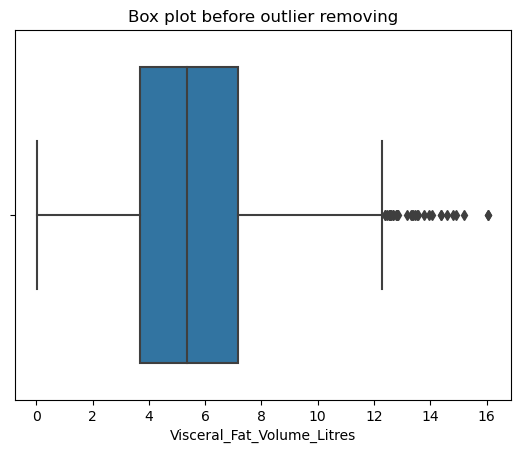

Old Shape:  (2862, 15)
New Shape:  (2821, 15)


/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_87655/891049041.py:15: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q1 = np.percentile(df['Visceral_Fat_Volume_Litres'], 25,
/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_87655/891049041.py:18: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q3 = np.percentile(df['Visceral_Fat_Volume_Litres'], 75,


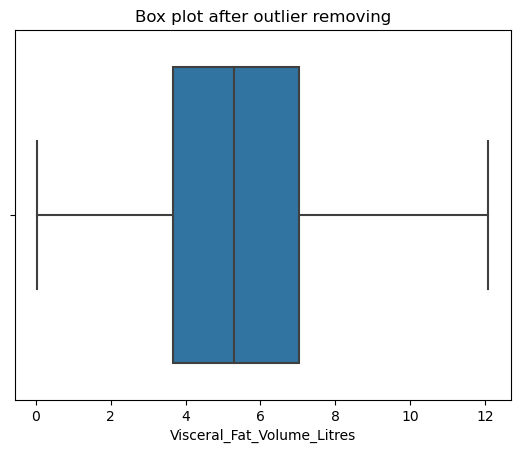

In [7]:
#Outlier check in the Visceral_Fat_Volume_Litres column
df = df.reset_index(drop=True)
sns.boxplot(x = df['Visceral_Fat_Volume_Litres'])
plt.title('Box plot before outlier removing')
plt.show()

old_shape = 0
new_shape = 1

print("Old Shape: ", df.shape)

while old_shape != new_shape:
    ''' Detection '''
    # IQR
    Q1 = np.percentile(df['Visceral_Fat_Volume_Litres'], 25, 
                       interpolation = 'midpoint') 

    Q3 = np.percentile(df['Visceral_Fat_Volume_Litres'], 75,
                       interpolation = 'midpoint') 
    IQR = Q3 - Q1 

    old_shape = df.shape
     

    # Upper bound
    df = df[df['Visceral_Fat_Volume_Litres'] < (Q3+1.5*IQR)]
    # Lower bound
    df = df[df['Visceral_Fat_Volume_Litres'] > (Q1-1.5*IQR)]

    new_shape = df.shape

print("New Shape: ", new_shape)

df = df.reset_index(drop=True)
sns.boxplot(x = df['Visceral_Fat_Volume_Litres'])
plt.title('Box plot after outlier removing')
plt.show()

In [8]:
#Checking the max value for target column
df["Visceral_Fat_Volume_Litres"].max()

12.09

In [9]:
#Setting and appliying the formula to classfiy the target column
def conditions(s):
    if (s['Visceral_Fat_Volume_Litres'] == None):
        return None
    elif (s['Visceral_Fat_Volume_Litres'] <= 3):
        return "Low Risk"
    elif (s['Visceral_Fat_Volume_Litres'] <= 6):
        return "Moderate Risk"
    else:
        return "High Risk"
df['Risk_Level'] = df.apply(conditions, axis=1)
df.head(10)

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
0,B0013,M,62,28,175.0,82.92,93,118,160.0,58,6,0.0,NaN,NaN,0.59,Low Risk
1,B0014,M,56,26,1.8,76.45,85,91,139.0,151,2,0.0,NaN,NaN,0.50,Low Risk
2,B0015,M,48,25,1.7,65.36,84,76,98.0,257,6,0.0,NaN,NaN,0.39,Low Risk
3,B0016,M,70,27,180.0,76.57,95,83,127.0,68,5,0.0,NaN,NaN,0.27,Low Risk
4,B0017,M,65,21,189.0,63.37,76,93,123.0,85,3,0.0,NaN,NaN,0.24,Low Risk
5,B0018,M,54,24,192.0,81.79,87,81,123.0,38,10,0.0,NaN,NaN,0.23,Low Risk
6,B0019,M,49,23,189.0,74.41,80,95,136.0,44,3,0.0,NaN,NaN,0.22,Low Risk
7,B0020,M,57,26,188.0,84.00,91,82,109.0,61,0,0.0,NaN,NaN,0.18,Low Risk
8,B0021,M,61,23,180.0,71.71,85,78,112.0,175,5,0.0,NaN,NaN,0.14,Low Risk
9,B0022,M,52,24,186.0,75.94,81,103,138.0,43,5,0.0,GFTY,NaN,0.07,Low Risk


In [10]:
#Checking the classification column of the target column
print("Low Risk Max: ", df[df['Risk_Level'] == "Low Risk"].Visceral_Fat_Volume_Litres.max())
print("Low Risk Min: ", df[df['Risk_Level'] == "Low Risk"].Visceral_Fat_Volume_Litres.min())
print("Moderate Risk Max: ", df[df['Risk_Level'] == "Moderate Risk"].Visceral_Fat_Volume_Litres.max())
print("Moderate Risk Min: ", df[df['Risk_Level'] == "Moderate Risk"].Visceral_Fat_Volume_Litres.min())
print("High Risk Max: ", df[df['Risk_Level'] == "High Risk"].Visceral_Fat_Volume_Litres.max())
print("High Risk Min: ", df[df['Risk_Level'] == "High Risk"].Visceral_Fat_Volume_Litres.min())

Low Risk Max:  2.99
Low Risk Min:  0.04
Moderate Risk Max:  6.0
Moderate Risk Min:  3.01
High Risk Max:  12.09
High Risk Min:  6.01


In [11]:
#Checking the null values and measurement scale types of df
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2821 entries, 0 to 2820
Data columns (total 16 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   SUBJECT_ID                       2821 non-null   object 
 1   SEX                              2821 non-null   object 
 2   AGE_years                        2821 non-null   int64  
 3   BMI                              2821 non-null   int64  
 4   HEIGHT_cm                        2821 non-null   float64
 5   WEIGHT_kg                        2821 non-null   float64
 6   WAIST_CIRCUMFERENCE_cm           2821 non-null   int64  
 7   DIASTOLIC_BLOOD_PRESSURE_mmHg    2821 non-null   int64  
 8   SYSTOLIC_BLOOD_PRESSURE_mmHg     2817 non-null   float64
 9   WALK_DURATION_PER_DAY_MINUTES    2821 non-null   int64  
 10  COMPUTER_USE_TIME_PER_DAY_HOURS  2821 non-null   int64  
 11  SMOKING_STATUS                   2819 non-null   float64
 12  DISCONTINUED_NO_    

In [12]:
#Producing the statistical description of df
df.describe()

,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
count,2821.000000,2821.000000,2821.000000,2821.000000,2821.000000,2821.000000,2817.000000,2821.000000,2821.000000,2819.000000,126.000000,2821.000000
mean,62.327189,29.151365,182.901453,90.858614,98.736264,91.545551,133.747959,81.771358,4.509039,0.040085,23.444444,5.446306
std,8.520792,3.706347,8.701322,13.011089,9.771789,10.592741,16.737795,64.301588,4.426268,0.196194,13.404212,2.467363
min,41.000000,20.000000,1.700000,55.410000,70.000000,48.000000,90.000000,1.000000,0.000000,0.000000,2.000000,0.040000
25%,57.000000,27.000000,178.000000,81.770000,92.000000,84.000000,122.000000,47.000000,2.000000,0.000000,12.000000,3.660000
50%,63.000000,29.000000,183.000000,89.520000,98.000000,91.000000,132.000000,67.000000,3.000000,0.000000,21.500000,5.300000
75%,69.000000,31.000000,188.000000,98.110000,104.000000,98.000000,144.000000,92.000000,6.000000,0.000000,34.000000,7.040000
max,190.000000,51.000000,210.000000,162.940000,153.000000,130.000000,192.000000,656.000000,69.000000,1.000000,50.000000,12.090000


In [13]:
#Checking the age column
df[df.AGE_years > 100]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
1304,B1317,M,190,32,161.0,78.56,104,82,135.0,57,3,0.0,NaN,NaN,5.09,Moderate Risk


In [14]:
#Replacing the 190 years old with null values, as it is impossible
df['AGE_years'] = df['AGE_years'].replace([190], None)
df = df[df.AGE_years < 100]
df[df.AGE_years > 100]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [15]:
#Checking the age column's range
print("Age Max: ", df.AGE_years.max())
print("Age Min: ", df.AGE_years.min())

Age Max:  80
Age Min:  41


In [16]:
#Checking the height column
df[df.HEIGHT_cm < 50]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
1,B0014,M,56,26,1.8,76.45,85,91,139.0,151,2,0.0,NaN,NaN,0.50,Low Risk
2,B0015,M,48,25,1.7,65.36,84,76,98.0,257,6,0.0,NaN,NaN,0.39,Low Risk


In [17]:
#Dropping the misentered height data by prediction
df = df[df.HEIGHT_cm > 50]
df[df.HEIGHT_cm < 50]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


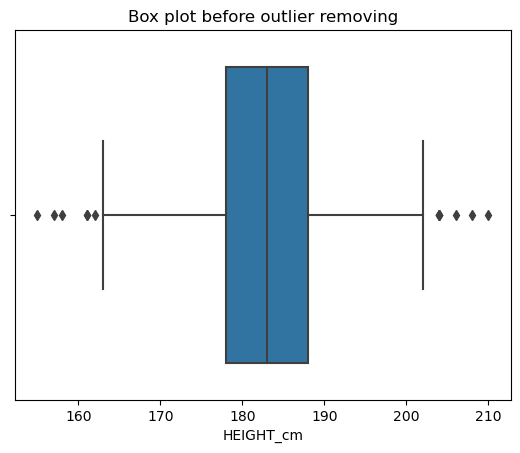

Old Shape:  (2818, 16)
New Shape:  (2804, 16)


/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_87655/2269151447.py:15: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q1 = np.percentile(df['HEIGHT_cm'], 25,
/var/folders/_k/_rt6thqx6mj63rxtq_q_l7j00000gn/T/ipykernel_87655/2269151447.py:18: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they. (Deprecated NumPy 1.22)
  Q3 = np.percentile(df['HEIGHT_cm'], 75,


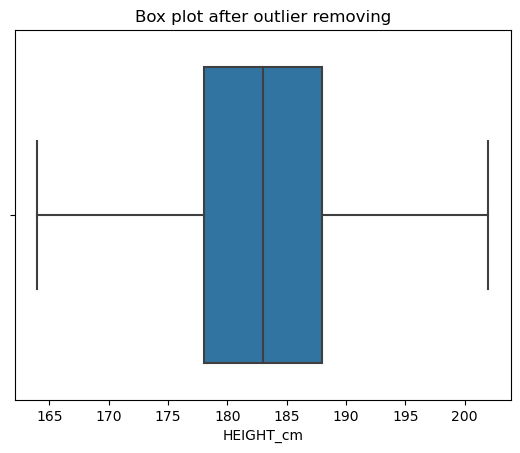

In [18]:
#Outlier check in the HEIGHT_cm column
df = df.reset_index(drop=True)
sns.boxplot(x = df['HEIGHT_cm'])
plt.title('Box plot before outlier removing')
plt.show()

old_shape = 0
new_shape = 1

print("Old Shape: ", df.shape)

while old_shape != new_shape:
    ''' Detection '''
    # IQR
    Q1 = np.percentile(df['HEIGHT_cm'], 25, 
                       interpolation = 'midpoint') 

    Q3 = np.percentile(df['HEIGHT_cm'], 75,
                       interpolation = 'midpoint') 
    IQR = Q3 - Q1 

    old_shape = df.shape
     

    # Upper bound
    df = df[df['HEIGHT_cm'] < (Q3+1.5*IQR)]
    # Lower bound
    df = df[df['HEIGHT_cm'] > (Q1-1.5*IQR)]

    new_shape = df.shape

print("New Shape: ", new_shape)

df = df.reset_index(drop=True)
sns.boxplot(x = df['HEIGHT_cm'])
plt.title('Box plot after outlier removing')
plt.show()

In [19]:
#Checking the statistics
df.describe()

,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres
count,2804.00000,2804.000000,2804.000000,2804.000000,2804.00000,2800.000000,2804.000000,2804.000000,2802.000000,126.000000,2804.000000
mean,29.14515,183.039765,90.849815,98.730742,91.56669,133.768571,81.703994,4.500000,0.040328,23.444444,5.437817
std,3.70380,7.062372,12.917661,9.745490,10.57158,16.719766,64.127327,4.423004,0.196763,13.404212,2.456753
min,20.00000,164.000000,55.410000,70.000000,48.00000,90.000000,1.000000,0.000000,0.000000,2.000000,0.040000
25%,27.00000,178.000000,81.807500,92.000000,84.00000,122.000000,47.000000,2.000000,0.000000,12.000000,3.650000
50%,29.00000,183.000000,89.525000,98.000000,91.00000,132.000000,67.000000,3.000000,0.000000,21.500000,5.290000
75%,31.00000,188.000000,98.080000,104.000000,98.00000,144.000000,92.000000,6.000000,0.000000,34.000000,7.030000
max,51.00000,202.000000,162.940000,153.000000,130.00000,192.000000,656.000000,69.000000,1.000000,50.000000,12.090000


In [20]:
#Checking the SYSTOLIC_BLOOD_PRESSURE_mmHg variable
df[df['SYSTOLIC_BLOOD_PRESSURE_mmHg'].isnull()].drop(['DIASTOLIC_BLOOD_PRESSURE_mmHg'], axis=1)

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
123,B0138,M,63,26,182.0,82.65,95,NaN,65,0,0.0,NaN,NaN,1.34,Low Risk
1078,B1095,M,62,28,185.0,91.19,97,NaN,77,4,0.0,NaN,NaN,4.57,Moderate Risk
2280,B2302,M,77,31,181.0,90.32,98,NaN,31,9,0.0,NaN,NaN,7.66,High Risk
2718,B2745,M,57,29,181.0,89.24,98,NaN,97,0,0.0,NaN,NaN,10.36,High Risk


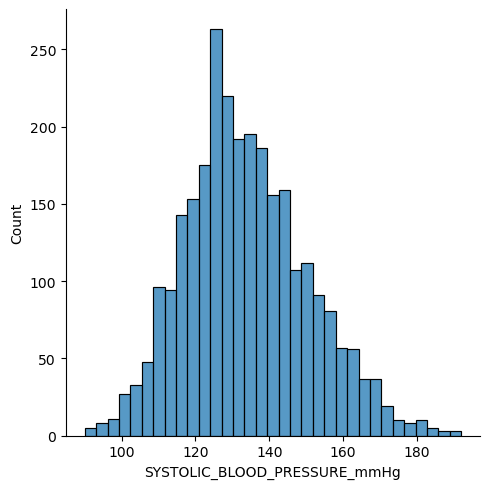

In [21]:
#Checking the distribution
sns.displot(df, x="SYSTOLIC_BLOOD_PRESSURE_mmHg")

In [22]:
#Filling the missing records with the mean for systolic blood pressure variable
df['SYSTOLIC_BLOOD_PRESSURE_mmHg'] = df['SYSTOLIC_BLOOD_PRESSURE_mmHg'].fillna(df['SYSTOLIC_BLOOD_PRESSURE_mmHg'].mean())
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2804 entries, 0 to 2803
Data columns (total 16 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   SUBJECT_ID                       2804 non-null   object 
 1   SEX                              2804 non-null   object 
 2   AGE_years                        2804 non-null   object 
 3   BMI                              2804 non-null   int64  
 4   HEIGHT_cm                        2804 non-null   float64
 5   WEIGHT_kg                        2804 non-null   float64
 6   WAIST_CIRCUMFERENCE_cm           2804 non-null   int64  
 7   DIASTOLIC_BLOOD_PRESSURE_mmHg    2804 non-null   int64  
 8   SYSTOLIC_BLOOD_PRESSURE_mmHg     2804 non-null   float64
 9   WALK_DURATION_PER_DAY_MINUTES    2804 non-null   int64  
 10  COMPUTER_USE_TIME_PER_DAY_HOURS  2804 non-null   int64  
 11  SMOKING_STATUS                   2802 non-null   float64
 12  DISCONTINUED_NO_    

In [23]:
#Checking the SYSTOLIC_BLOOD_PRESSURE_mmHg variable
df[df['SUBJECT_ID'].isin(['B0138','B1095','B2302','B2745','B2844'])].drop(['DIASTOLIC_BLOOD_PRESSURE_mmHg'], axis=1)

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
123,B0138,M,63,26,182.0,82.65,95,133.768571,65,0,0.0,NaN,NaN,1.34,Low Risk
1078,B1095,M,62,28,185.0,91.19,97,133.768571,77,4,0.0,NaN,NaN,4.57,Moderate Risk
2280,B2302,M,77,31,181.0,90.32,98,133.768571,31,9,0.0,NaN,NaN,7.66,High Risk
2718,B2745,M,57,29,181.0,89.24,98,133.768571,97,0,0.0,NaN,NaN,10.36,High Risk


In [24]:
#Checking the computer use time column
df[df.COMPUTER_USE_TIME_PER_DAY_HOURS > 24].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        ], axis=1)

,SUBJECT_ID,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
313,B0328,65,30,0.0,NaN,NaN,2.50,Low Risk
322,B0337,67,32,0.0,NaN,NaN,2.53,Low Risk
710,B0726,48,27,0.0,NaN,NaN,3.68,Moderate Risk
1120,B1137,61,30,0.0,NaN,11.0,4.69,Moderate Risk
1174,B1191,102,69,0.0,NaN,NaN,4.81,Moderate Risk
1243,B1260,86,35,0.0,NaN,NaN,4.98,Moderate Risk
1330,B1349,91,25,0.0,NaN,NaN,5.15,Moderate Risk
1578,B1598,68,46,0.0,NaN,NaN,5.76,Moderate Risk
2315,B2337,80,32,0.0,NaN,NaN,7.79,High Risk
2593,B2617,11,25,0.0,NaN,NaN,9.18,High Risk


In [25]:
#Replacing the computer use time with null
df = df[df.COMPUTER_USE_TIME_PER_DAY_HOURS <= 24]
df[df.COMPUTER_USE_TIME_PER_DAY_HOURS > 24].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        ], axis=1)


,SUBJECT_ID,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [26]:
df[df.SUBJECT_ID.isin(["B0328","B0337","B0726","B0817","B0892","B1078","B1137","B1191","B1260","B1349","B1598","B2223"
                       ,"B2337","B2617","B2625","B2631","B2819"])].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        ], axis=1)


,SUBJECT_ID,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
801,B0817,80,24,0.0,NaN,NaN,3.92,Moderate Risk
875,B0892,52,24,0.0,NaN,NaN,4.08,Moderate Risk
1061,B1078,104,24,0.0,NaN,NaN,4.54,Moderate Risk
2201,B2223,62,24,0.0,NaN,NaN,7.37,High Risk
2601,B2625,49,24,0.0,NaN,NaN,9.23,High Risk


In [27]:
#Sanity check for smoking
df[(df['CIGARETTES_CONSUMED_PER_DAY']>0) & (df['SMOKING_STATUS']!=1)].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)


,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
243,B0258,NaN,8.0,2.18,Low Risk
436,B0452,NaN,2.0,2.93,Low Risk
471,B0487,0.0,17.0,3.04,Moderate Risk
538,B0554,0.0,9.0,3.26,Moderate Risk
711,B0727,0.0,13.0,3.68,Moderate Risk
1165,B1182,0.0,12.0,4.79,Moderate Risk
1172,B1189,0.0,8.0,4.81,Moderate Risk
1179,B1196,0.0,45.0,4.82,Moderate Risk
1502,B1522,0.0,13.0,5.56,Moderate Risk
1791,B1812,0.0,5.0,6.26,High Risk


In [28]:
df[(df['CIGARETTES_CONSUMED_PER_DAY']!=0) & (df['CIGARETTES_CONSUMED_PER_DAY']!=1)].drop(['SEX','AGE_years','BMI',
                                                                                          'HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
0,B0013,0.0,NaN,0.59,Low Risk
1,B0016,0.0,NaN,0.27,Low Risk
2,B0017,0.0,NaN,0.24,Low Risk
3,B0018,0.0,NaN,0.23,Low Risk
4,B0019,0.0,NaN,0.22,Low Risk
...,...,...,...,...,...
2799,B2828,0.0,NaN,11.88,High Risk
2800,B2830,0.0,NaN,11.92,High Risk
2801,B2831,0.0,NaN,11.99,High Risk
2802,B2832,0.0,NaN,12.00,High Risk


In [29]:
#Setting and appliying the formula to fill the smoking status with 1 for cigarettes consumers
def smoker_conditions(s):
    if (s['CIGARETTES_CONSUMED_PER_DAY'] > 0):
        return 1
    else:
        return s['SMOKING_STATUS']
df['SMOKING_STATUS'] = df.apply(smoker_conditions, axis=1)

In [30]:
#Setting and appliying the formula to fill the smoke consumption with 0 for nonsmokers
def nonsmoker_conditions(s):
    if (s['SMOKING_STATUS'] == 0):
        return 0
    else:
        return s['CIGARETTES_CONSUMED_PER_DAY']
df['CIGARETTES_CONSUMED_PER_DAY'] = df.apply(nonsmoker_conditions, axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2792 entries, 0 to 2803
Data columns (total 16 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   SUBJECT_ID                       2792 non-null   object 
 1   SEX                              2792 non-null   object 
 2   AGE_years                        2792 non-null   object 
 3   BMI                              2792 non-null   int64  
 4   HEIGHT_cm                        2792 non-null   float64
 5   WEIGHT_kg                        2792 non-null   float64
 6   WAIST_CIRCUMFERENCE_cm           2792 non-null   int64  
 7   DIASTOLIC_BLOOD_PRESSURE_mmHg    2792 non-null   int64  
 8   SYSTOLIC_BLOOD_PRESSURE_mmHg     2792 non-null   float64
 9   WALK_DURATION_PER_DAY_MINUTES    2792 non-null   int64  
 10  COMPUTER_USE_TIME_PER_DAY_HOURS  2792 non-null   int64  
 11  SMOKING_STATUS                   2792 non-null   float64
 12  DISCONTINUED_NO_    

In [31]:
df[df.SUBJECT_ID.isin(['B0258','B0452','B0487','B0554','B0727','B1137','B1182','B1189','B1196','B1522','B1812','B2375','B2553'])].drop(['SEX','AGE_years','BMI','HEIGHT_cm',
                                                                         'WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)


,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
243,B0258,1.0,8.0,2.18,Low Risk
436,B0452,1.0,2.0,2.93,Low Risk
471,B0487,1.0,17.0,3.04,Moderate Risk
538,B0554,1.0,9.0,3.26,Moderate Risk
711,B0727,1.0,13.0,3.68,Moderate Risk
1165,B1182,1.0,12.0,4.79,Moderate Risk
1172,B1189,1.0,8.0,4.81,Moderate Risk
1179,B1196,1.0,45.0,4.82,Moderate Risk
1502,B1522,1.0,13.0,5.56,Moderate Risk
1791,B1812,1.0,5.0,6.26,High Risk


In [32]:
df.drop(['SEX','AGE_years','BMI','HEIGHT_cm','WEIGHT_kg','WAIST_CIRCUMFERENCE_cm',
                                                                        'DIASTOLIC_BLOOD_PRESSURE_mmHg',
                                                                        'SYSTOLIC_BLOOD_PRESSURE_mmHg',
                                                                            'WALK_DURATION_PER_DAY_MINUTES',
                                                                            'COMPUTER_USE_TIME_PER_DAY_HOURS',
                                                                            'DISCONTINUED_NO_'
                                                                        ], axis=1)

,SUBJECT_ID,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level
0,B0013,0.0,0.0,0.59,Low Risk
1,B0016,0.0,0.0,0.27,Low Risk
2,B0017,0.0,0.0,0.24,Low Risk
3,B0018,0.0,0.0,0.23,Low Risk
4,B0019,0.0,0.0,0.22,Low Risk
...,...,...,...,...,...
2799,B2828,0.0,0.0,11.88,High Risk
2800,B2830,0.0,0.0,11.92,High Risk
2801,B2831,0.0,0.0,11.99,High Risk
2802,B2832,0.0,0.0,12.00,High Risk


In [33]:
#Checking the null values a
df[(df['SMOKING_STATUS']!=1) & (df['SMOKING_STATUS']!=0)]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [34]:
#Sanity check for smoking
df[(df['SMOKING_STATUS']==0) & (df['CIGARETTES_CONSUMED_PER_DAY']>0)]

,SUBJECT_ID,SEX,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,DISCONTINUED_NO_,CIGARETTES_CONSUMED_PER_DAY,Visceral_Fat_Volume_Litres,Risk_Level


In [35]:
#duplicate check
df = df.drop_duplicates()

**Task (2) – Data Understanding: Producing Your Experimental Designing**

**2.a)**

In [36]:
#Checking the columns
df = df.drop(columns=['DISCONTINUED_NO_','Visceral_Fat_Volume_Litres','SUBJECT_ID','SEX'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2792 entries, 0 to 2803
Data columns (total 12 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   AGE_years                        2792 non-null   object 
 1   BMI                              2792 non-null   int64  
 2   HEIGHT_cm                        2792 non-null   float64
 3   WEIGHT_kg                        2792 non-null   float64
 4   WAIST_CIRCUMFERENCE_cm           2792 non-null   int64  
 5   DIASTOLIC_BLOOD_PRESSURE_mmHg    2792 non-null   int64  
 6   SYSTOLIC_BLOOD_PRESSURE_mmHg     2792 non-null   float64
 7   WALK_DURATION_PER_DAY_MINUTES    2792 non-null   int64  
 8   COMPUTER_USE_TIME_PER_DAY_HOURS  2792 non-null   int64  
 9   SMOKING_STATUS                   2792 non-null   float64
 10  CIGARETTES_CONSUMED_PER_DAY      2792 non-null   float64
 11  Risk_Level                       2792 non-null   object 
dtypes: float64(5), int64

In [37]:
df.head(10)

,AGE_years,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY,Risk_Level
0,62,28,175.0,82.92,93,118,160.0,58,6,0.0,0.0,Low Risk
1,70,27,180.0,76.57,95,83,127.0,68,5,0.0,0.0,Low Risk
2,65,21,189.0,63.37,76,93,123.0,85,3,0.0,0.0,Low Risk
3,54,24,192.0,81.79,87,81,123.0,38,10,0.0,0.0,Low Risk
4,49,23,189.0,74.41,80,95,136.0,44,3,0.0,0.0,Low Risk
5,57,26,188.0,84.00,91,82,109.0,61,0,0.0,0.0,Low Risk
6,61,23,180.0,71.71,85,78,112.0,175,5,0.0,0.0,Low Risk
7,52,24,186.0,75.94,81,103,138.0,43,5,0.0,0.0,Low Risk
8,54,27,177.0,75.32,91,102,144.0,78,0,0.0,0.0,Low Risk
9,53,24,188.0,82.55,87,78,123.0,46,2,0.0,0.0,Low Risk


In [38]:
df.describe()

,BMI,HEIGHT_cm,WEIGHT_kg,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY
count,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000,2792.000000
mean,29.146848,183.019341,90.843521,98.729226,91.580587,133.809840,81.770415,4.374284,0.044771,1.054083
std,3.706531,7.052057,12.907480,9.737421,10.561313,16.673732,64.238788,3.916171,0.206837,5.630789
min,20.000000,164.000000,55.410000,70.000000,48.000000,90.000000,1.000000,0.000000,0.000000,0.000000
25%,27.000000,178.000000,81.830000,92.000000,84.000000,122.000000,47.000000,2.000000,0.000000,0.000000
50%,29.000000,183.000000,89.525000,98.000000,91.000000,133.000000,67.000000,3.000000,0.000000,0.000000
75%,31.000000,188.000000,98.065000,104.000000,98.000000,144.000000,92.250000,6.000000,0.000000,0.000000
max,51.000000,202.000000,162.940000,153.000000,130.000000,192.000000,656.000000,24.000000,1.000000,50.000000


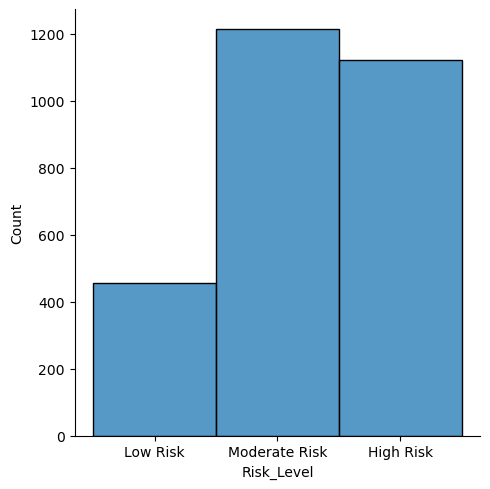

In [39]:
#Distribution of the target column's classes
import seaborn as sns
sns.displot(df, x="Risk_Level")

In [40]:
#Percentages of the target column's classes
df.Risk_Level.value_counts(normalize=True)

Moderate Risk    0.434456
High Risk        0.401862
Low Risk         0.163682
Name: Risk_Level, dtype: float64

Model

In [41]:
from patsy import dmatrices
from statsmodels.stats.outliers_influence import variance_inflation_factor

#find design matrix for regression model using 'rating' as response variable 
y, X = dmatrices('Risk_Level ~ BMI+HEIGHT_cm+WEIGHT_kg+WAIST_CIRCUMFERENCE_cm+SMOKING_STATUS+DIASTOLIC_BLOOD_PRESSURE_mmHg+SYSTOLIC_BLOOD_PRESSURE_mmHg+WALK_DURATION_PER_DAY_MINUTES+COMPUTER_USE_TIME_PER_DAY_HOURS+CIGARETTES_CONSUMED_PER_DAY', data=df, return_type='dataframe')

#create DataFrame to hold VIF values
vif_df = pd.DataFrame()
vif_df['variable'] = X.columns 

#calculate VIF for each predictor variable 
vif_df['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

#view VIF for each predictor variable 
print(vif_df)

                           variable          VIF
0                         Intercept  5095.390328
1                               BMI    17.361848
2                         HEIGHT_cm     6.843065
3                         WEIGHT_kg    23.226670
4            WAIST_CIRCUMFERENCE_cm     3.562962
5                    SMOKING_STATUS     3.981048
6     DIASTOLIC_BLOOD_PRESSURE_mmHg     1.566265
7      SYSTOLIC_BLOOD_PRESSURE_mmHg     1.549423
8     WALK_DURATION_PER_DAY_MINUTES     1.008660
9   COMPUTER_USE_TIME_PER_DAY_HOURS     1.008517
10      CIGARETTES_CONSUMED_PER_DAY     3.976672


In [42]:
from patsy import dmatrices
from statsmodels.stats.outliers_influence import variance_inflation_factor

#find design matrix for regression model using 'rating' as response variable 
y, X = dmatrices('Risk_Level ~ BMI+HEIGHT_cm+WAIST_CIRCUMFERENCE_cm+SMOKING_STATUS+DIASTOLIC_BLOOD_PRESSURE_mmHg+SYSTOLIC_BLOOD_PRESSURE_mmHg+WALK_DURATION_PER_DAY_MINUTES+COMPUTER_USE_TIME_PER_DAY_HOURS+CIGARETTES_CONSUMED_PER_DAY', data=df, return_type='dataframe')

#create DataFrame to hold VIF values
vif_df = pd.DataFrame()
vif_df['variable'] = X.columns 

#calculate VIF for each predictor variable 
vif_df['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

#view VIF for each predictor variable 
print(vif_df)

                          variable         VIF
0                        Intercept  939.566828
1                              BMI    3.066005
2                        HEIGHT_cm    1.286292
3           WAIST_CIRCUMFERENCE_cm    3.042575
4                   SMOKING_STATUS    3.980821
5    DIASTOLIC_BLOOD_PRESSURE_mmHg    1.563685
6     SYSTOLIC_BLOOD_PRESSURE_mmHg    1.548452
7    WALK_DURATION_PER_DAY_MINUTES    1.008351
8  COMPUTER_USE_TIME_PER_DAY_HOURS    1.008171
9      CIGARETTES_CONSUMED_PER_DAY    3.976631


In [43]:
#create a dataframe with all training data except the target column
X = df.drop(columns=['Risk_Level','WEIGHT_kg'])
#check that the target variable has been removed
X.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 2792 entries, 0 to 2803
Data columns (total 10 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   AGE_years                        2792 non-null   object 
 1   BMI                              2792 non-null   int64  
 2   HEIGHT_cm                        2792 non-null   float64
 3   WAIST_CIRCUMFERENCE_cm           2792 non-null   int64  
 4   DIASTOLIC_BLOOD_PRESSURE_mmHg    2792 non-null   int64  
 5   SYSTOLIC_BLOOD_PRESSURE_mmHg     2792 non-null   float64
 6   WALK_DURATION_PER_DAY_MINUTES    2792 non-null   int64  
 7   COMPUTER_USE_TIME_PER_DAY_HOURS  2792 non-null   int64  
 8   SMOKING_STATUS                   2792 non-null   float64
 9   CIGARETTES_CONSUMED_PER_DAY      2792 non-null   float64
dtypes: float64(4), int64(5), object(1)
memory usage: 304.5+ KB


In [44]:
#separate target values
y = df['Risk_Level'].values
#view target values
y[0:5]


array(['Low Risk', 'Low Risk', 'Low Risk', 'Low Risk', 'Low Risk'],
      dtype=object)

**Task (4) – Modelling: Create Predictive Classification Models**

**b)**

In [45]:
from sklearn.model_selection import train_test_split
#split dataset into train and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1, stratify=y)

In [46]:
X

,AGE_years,BMI,HEIGHT_cm,WAIST_CIRCUMFERENCE_cm,DIASTOLIC_BLOOD_PRESSURE_mmHg,SYSTOLIC_BLOOD_PRESSURE_mmHg,WALK_DURATION_PER_DAY_MINUTES,COMPUTER_USE_TIME_PER_DAY_HOURS,SMOKING_STATUS,CIGARETTES_CONSUMED_PER_DAY
0,62,28,175.0,93,118,160.0,58,6,0.0,0.0
1,70,27,180.0,95,83,127.0,68,5,0.0,0.0
2,65,21,189.0,76,93,123.0,85,3,0.0,0.0
3,54,24,192.0,87,81,123.0,38,10,0.0,0.0
4,49,23,189.0,80,95,136.0,44,3,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
2799,65,33,168.0,97,97,149.0,115,3,0.0,0.0
2800,74,36,175.0,110,82,109.0,57,11,0.0,0.0
2801,73,32,187.0,110,89,113.0,63,7,0.0,0.0
2802,66,34,176.0,104,99,154.0,3,5,0.0,0.0


In [47]:
minmax_scale = MinMaxScaler()
X_train_scaled = minmax_scale.fit_transform(X_train)
X_test_scaled = minmax_scale.transform(X_test)
X_scaled = minmax_scale.transform(X)
pd.DataFrame(X_scaled)


,0,1,2,3,4,5,6,7,8,9
0,0.538462,0.258065,0.289474,0.277108,0.853659,0.686275,0.085627,0.250000,0.0,0.0
1,0.743590,0.225806,0.421053,0.301205,0.426829,0.362745,0.100917,0.208333,0.0,0.0
2,0.615385,0.032258,0.657895,0.072289,0.548780,0.323529,0.126911,0.125000,0.0,0.0
3,0.333333,0.129032,0.736842,0.204819,0.402439,0.323529,0.055046,0.416667,0.0,0.0
4,0.205128,0.096774,0.657895,0.120482,0.573171,0.450980,0.064220,0.125000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
2787,0.615385,0.419355,0.105263,0.325301,0.597561,0.578431,0.172783,0.125000,0.0,0.0
2788,0.846154,0.516129,0.289474,0.481928,0.414634,0.186275,0.084098,0.458333,0.0,0.0
2789,0.820513,0.387097,0.605263,0.481928,0.500000,0.225490,0.093272,0.291667,0.0,0.0
2790,0.641026,0.451613,0.315789,0.409639,0.621951,0.627451,0.001529,0.208333,0.0,0.0


In [48]:
std_scale = StandardScaler()
X_train_stdscaled = std_scale.fit_transform(X_train)
X_test_stdscaled = std_scale.transform(X_test)
X_stdscaled = std_scale.transform(X)

In [49]:
pd.DataFrame(X_train_scaled).head()

,0,1,2,3,4,5,6,7,8,9
0,0.512821,0.354839,0.578947,0.433735,0.646341,0.598039,0.061162,0.166667,0.0,0.0
1,0.743590,0.322581,0.736842,0.506024,0.341463,0.568627,0.103976,0.291667,0.0,0.0
2,0.153846,0.225806,0.323684,0.240964,0.719512,0.333333,0.058104,0.125000,0.0,0.0
3,0.615385,0.258065,0.526316,0.204819,0.402439,0.196078,0.365443,0.250000,0.0,0.0
4,0.205128,0.483871,0.526316,0.590361,0.573171,0.254902,0.027523,0.208333,0.0,0.0


In [50]:
pd.DataFrame(y_train).head()

,0
0,High Risk
1,High Risk
2,Moderate Risk
3,Low Risk
4,High Risk


In [51]:
# Create KNN classifier
knn = KNeighborsClassifier()
knn.fit(X_train_scaled,y_train)
knn.score(X_test_scaled, y_test)

0.5366726296958855

In [52]:
# Create Multinomial Naive Bayes classifier
mnb = MultinomialNB()
mnb.fit(X_train_scaled, y_train)
mnb.score(X_test_scaled, y_test)

0.49731663685152055

In [53]:
# Create Gaussian Naive Bayes classifier
gnb = GaussianNB()
gnb.fit(X_train_scaled, y_train)
gnb.score(X_test_scaled, y_test)

0.6565295169946332

In [54]:
# Create Bernoulli Naive Bayes classifier
bnb = BernoulliNB()
bnb.fit(X_train_scaled, y_train)
bnb.score(X_test_scaled, y_test)

0.4329159212880143

In [55]:
# Create Decision Tree classifier
dtc = DecisionTreeClassifier()
dtc = dtc.fit(X_train_scaled,y_train)
dtc.score(X_test_scaled, y_test)

0.5080500894454383

In [57]:
# Create Decision MLP classifier
mlp = MLPClassifier()
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6654740608228981

**Task (5) – Evaluation: How good are your models**

**5.a)**

Text(63.53777777777783, 0.5, 'Actual')

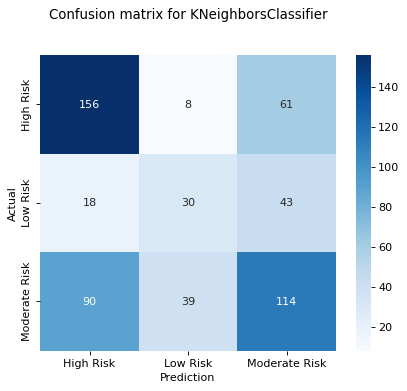

In [58]:
#Confusion matrix for KNeighborsClassifier
y_pred_knn = knn.predict(X_test_scaled)

from sklearn import metrics
knn_matrix = metrics.confusion_matrix(y_test, y_pred_knn)
plt.figure(dpi=80)
sns.heatmap(knn_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for KNeighborsClassifier', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

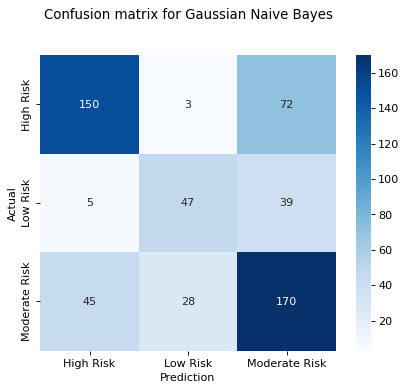

In [59]:
#Confusion matrix for Gaussian Naive Bayes
y_pred_gnb = gnb.predict(X_test_scaled)

from sklearn import metrics
gnb_matrix = metrics.confusion_matrix(y_test, y_pred_gnb)
plt.figure(dpi=80)
sns.heatmap(gnb_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Gaussian Naive Bayes', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

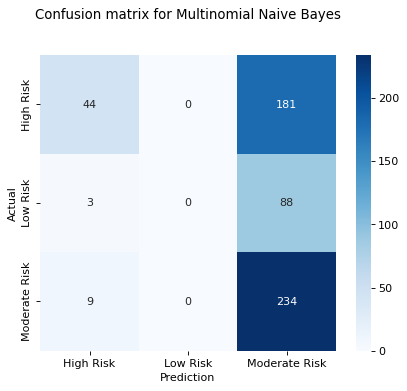

In [60]:
#Confusion matrix for Multinomial Naive Bayes
y_pred_mnb = mnb.predict(X_test_scaled)

from sklearn import metrics
gnb_matrix = metrics.confusion_matrix(y_test, y_pred_mnb)
plt.figure(dpi=80)
sns.heatmap(gnb_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Multinomial Naive Bayes', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

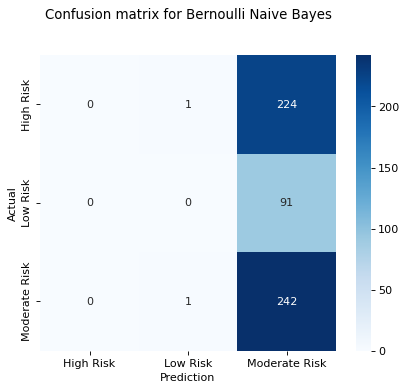

In [61]:
#Confusion matrix for Bernoulli Naive Bayes
y_pred_bnb = bnb.predict(X_test_scaled)

from sklearn import metrics
gnb_matrix = metrics.confusion_matrix(y_test, y_pred_bnb)
plt.figure(dpi=80)
sns.heatmap(gnb_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Bernoulli Naive Bayes', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

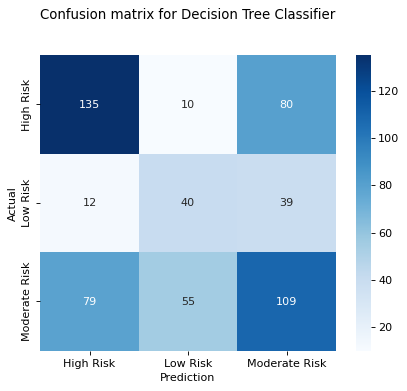

In [62]:
#Confusion matrix for Decision Tree Classifier
y_pred_dtc = dtc.predict(X_test_scaled)

from sklearn import metrics
dtc_matrix = metrics.confusion_matrix(y_test, y_pred_dtc)
plt.figure(dpi=80)
sns.heatmap(dtc_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for Decision Tree Classifier', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

Text(63.53777777777783, 0.5, 'Actual')

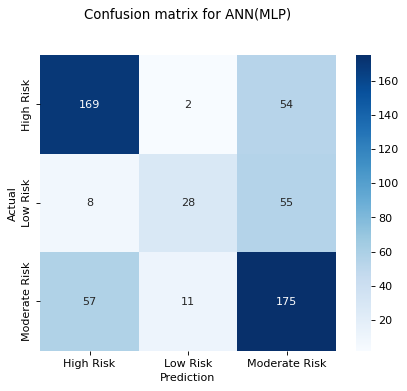

In [63]:
#Confusion matrix for ANN(MLP)
y_pred_mlp = mlp.predict(X_test_scaled)

from sklearn import metrics
dtc_matrix = metrics.confusion_matrix(y_test, y_pred_mlp)
plt.figure(dpi=80)
sns.heatmap(dtc_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for ANN(MLP)', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

**5.b)**

               precision    recall  f1-score   support

    High Risk       0.59      0.69      0.64       225
     Low Risk       0.39      0.33      0.36        91
Moderate Risk       0.52      0.47      0.49       243

     accuracy                           0.54       559
    macro avg       0.50      0.50      0.50       559
 weighted avg       0.53      0.54      0.53       559



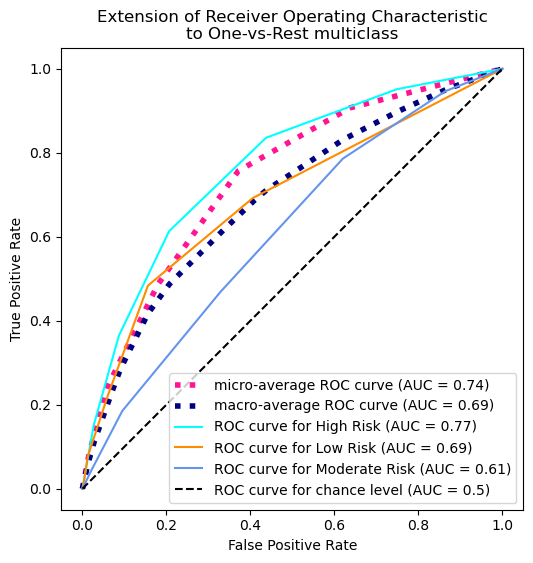

In [64]:
#KNN Scores
print(classification_report(y_test, y_pred_knn))

from sklearn.metrics import RocCurveDisplay
y_score = knn.predict_proba(X_test_scaled)

from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

from itertools import cycle
target_names = ['High Risk', 'Low Risk', 'Moderate Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.79      0.20      0.31       225
     Low Risk       0.00      0.00      0.00        91
Moderate Risk       0.47      0.96      0.63       243

     accuracy                           0.50       559
    macro avg       0.42      0.39      0.31       559
 weighted avg       0.52      0.50      0.40       559



/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

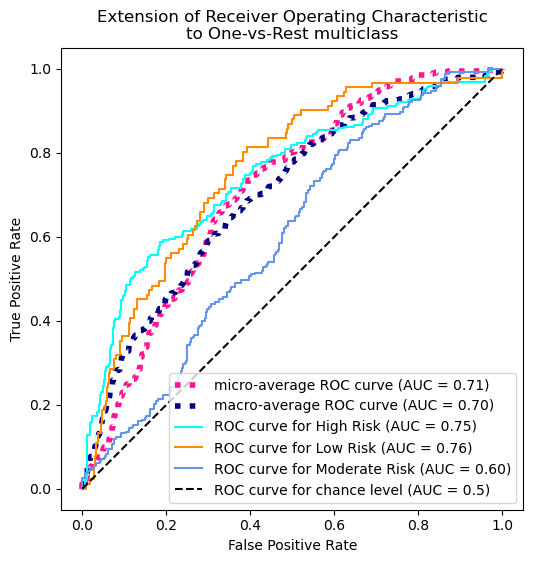

In [65]:
#MNB Scores
print(classification_report(y_test, y_pred_mnb))

from sklearn.metrics import RocCurveDisplay
y_score = mnb.predict_proba(X_test_scaled)

from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

from itertools import cycle
target_names = ['High Risk', 'Low Risk', 'Moderate Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.75      0.67      0.71       225
     Low Risk       0.60      0.52      0.56        91
Moderate Risk       0.60      0.70      0.65       243

     accuracy                           0.66       559
    macro avg       0.65      0.63      0.64       559
 weighted avg       0.66      0.66      0.66       559



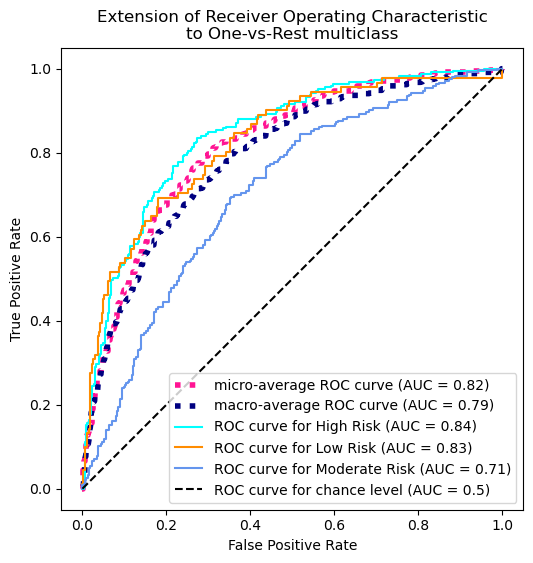

In [66]:
#GNB Scores
print(classification_report(y_test, y_pred_gnb))

from sklearn.metrics import RocCurveDisplay
y_score = gnb.predict_proba(X_test_scaled)

from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

from itertools import cycle
target_names = ['High Risk', 'Low Risk', 'Moderate Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.00      0.00      0.00       225
     Low Risk       0.00      0.00      0.00        91
Moderate Risk       0.43      1.00      0.61       243

     accuracy                           0.43       559
    macro avg       0.14      0.33      0.20       559
 weighted avg       0.19      0.43      0.26       559



/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

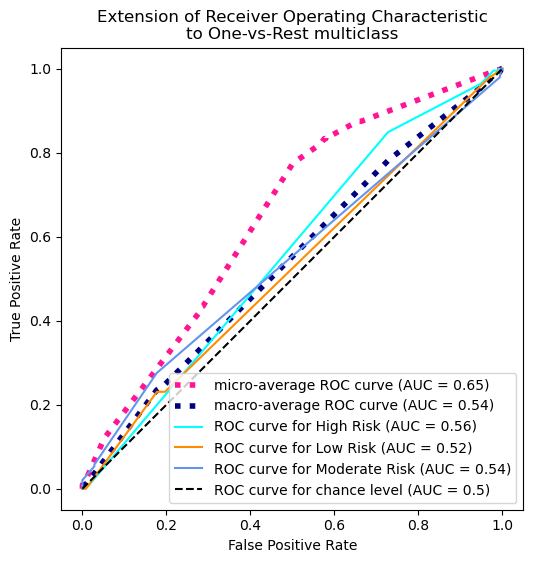

In [67]:
#BNB Scores
print(classification_report(y_test, y_pred_bnb))

from sklearn.metrics import RocCurveDisplay
y_score = bnb.predict_proba(X_test_scaled)

from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

from itertools import cycle
target_names = ['High Risk', 'Low Risk', 'Moderate Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.60      0.60      0.60       225
     Low Risk       0.38      0.44      0.41        91
Moderate Risk       0.48      0.45      0.46       243

     accuracy                           0.51       559
    macro avg       0.49      0.50      0.49       559
 weighted avg       0.51      0.51      0.51       559



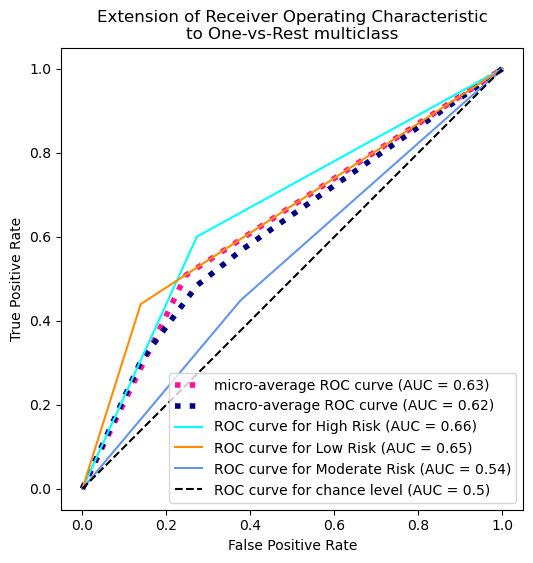

In [68]:
#DTC Scores
print(classification_report(y_test, y_pred_dtc))

from sklearn.metrics import RocCurveDisplay
y_score = dtc.predict_proba(X_test_scaled)

from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

from itertools import cycle
target_names = ['High Risk', 'Low Risk', 'Moderate Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


               precision    recall  f1-score   support

    High Risk       0.72      0.75      0.74       225
     Low Risk       0.68      0.31      0.42        91
Moderate Risk       0.62      0.72      0.66       243

     accuracy                           0.67       559
    macro avg       0.67      0.59      0.61       559
 weighted avg       0.67      0.67      0.65       559



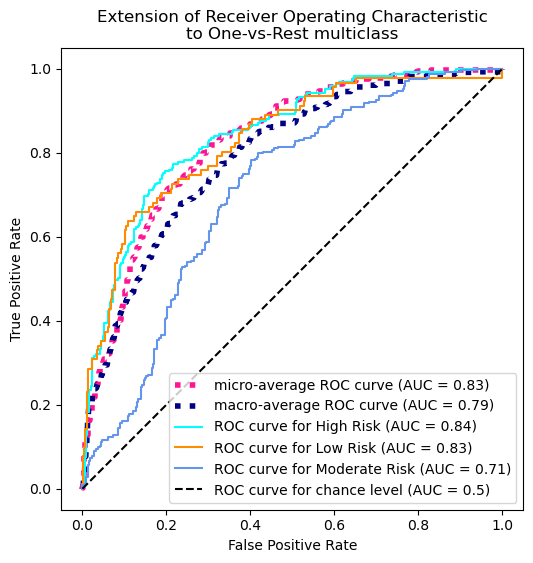

In [69]:
#MLP Scores
print(classification_report(y_test, y_pred_mlp))

from sklearn.metrics import RocCurveDisplay
y_score = mlp.predict_proba(X_test_scaled)

from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

from itertools import cycle
target_names = ['High Risk', 'Low Risk', 'Moderate Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()


**5.c)**

1/100
2/100
3/100
4/100
5/100
6/100
7/100
8/100
9/100
10/100
11/100
12/100
13/100
14/100
15/100
16/100
17/100
18/100
19/100
20/100
21/100
22/100
23/100
24/100
25/100
26/100
27/100
28/100
29/100
30/100
31/100
32/100
33/100
34/100
35/100
36/100
37/100
38/100
39/100
40/100
41/100
42/100
43/100
44/100
45/100
46/100
47/100
48/100
49/100
50/100
51/100
52/100
53/100
54/100
55/100
56/100
57/100
58/100
59/100
60/100
61/100
62/100
63/100
64/100
65/100
66/100
67/100
68/100
69/100
70/100
71/100
72/100
73/100
74/100
75/100
76/100
77/100
78/100
79/100
80/100
81/100
82/100
83/100
84/100
85/100
86/100
87/100
88/100
89/100
90/100
91/100
92/100
93/100
94/100
95/100
96/100
97/100
98/100
99/100
100/100
101/100
102/100
103/100
104/100
105/100
106/100
107/100
108/100
109/100
110/100
111/100
112/100
113/100
114/100
115/100
116/100
117/100
118/100
119/100
120/100
121/100
122/100
123/100
124/100
125/100
126/100
127/100
128/100
129/100
130/100
131/100
132/100
133/100
134/100
135/100
136/100
137/100
138/100
139/

Text(0, 0.5, 'Mean Error')

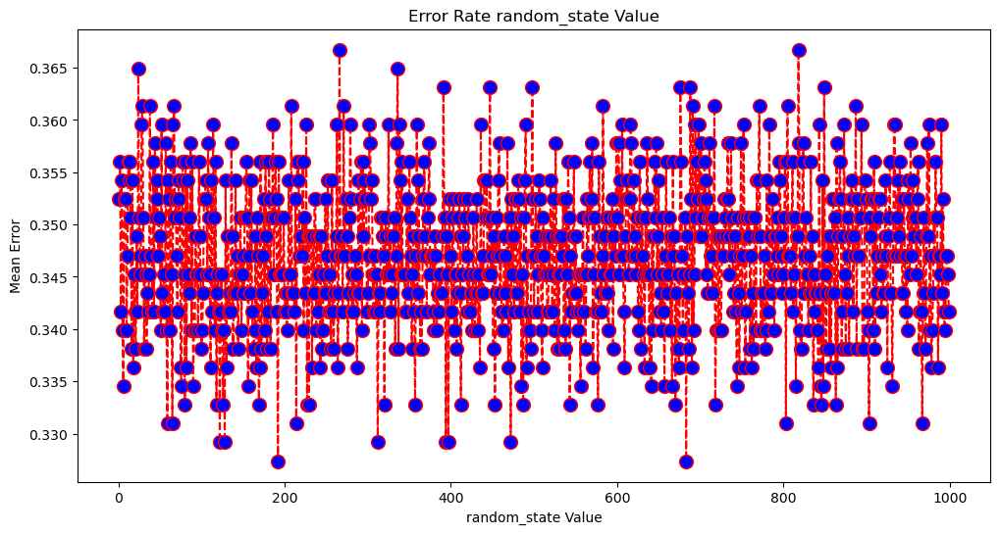

In [135]:
# Calculating error for random_state values between 1 and 1000
error = []

# Calculating error for random_state values between 1 and 1000
for i in range(1, 1000):
    print(str(i) + "/100")
    mlp_grid = MLPClassifier(random_state=i,max_iter=1000)
    mlp_grid.fit(X_train_scaled, y_train)
    pred_i = mlp_grid.predict(X_test_scaled)
    error.append(np.mean(pred_i != y_test))
plt.figure(figsize=(12, 6))
plt.plot(range(1, 1000), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate random_state Value')
plt.xlabel('random_state Value')
plt.ylabel('Mean Error')

175/100
176/100
177/100
178/100
179/100
180/100
181/100
182/100
183/100
184/100
185/100
186/100
187/100
188/100
189/100
190/100
191/100
192/100
193/100
194/100
195/100
196/100
197/100
198/100
199/100


Text(0, 0.5, 'Mean Error')

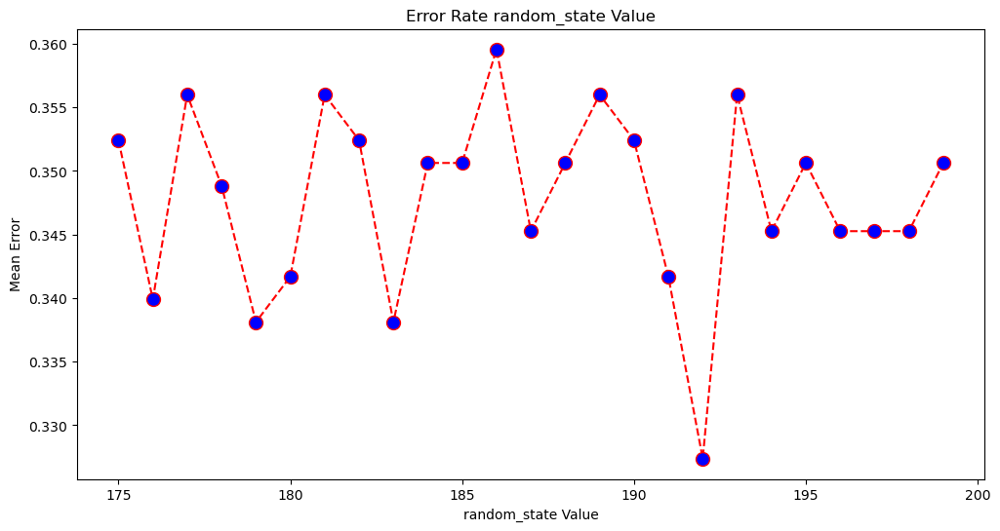

In [136]:
# Calculating error for random_state values between 1 and 1000
error = []

# Calculating error for random_state values between 1 and 1000
for i in range(175,200):
    print(str(i) + "/100")
    mlp_grid = MLPClassifier(random_state=i,max_iter=1000)
    mlp_grid.fit(X_train_scaled, y_train)
    pred_i = mlp_grid.predict(X_test_scaled)
    error.append(np.mean(pred_i != y_test))
plt.figure(figsize=(12, 6))
plt.plot(range(175,200), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate random_state Value')
plt.xlabel('random_state Value')
plt.ylabel('Mean Error')

In [138]:
# Create Decision MLP classifier
mlp = MLPClassifier(random_state=192,max_iter=1000)
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6726296958855098

1/100
2/100
3/100
4/100
5/100
6/100
7/100
8/100
9/100
10/100
11/100
12/100
13/100
14/100
15/100
16/100
17/100
18/100
19/100
20/100
21/100
22/100
23/100
24/100
25/100
26/100
27/100
28/100
29/100
30/100
31/100
32/100
33/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


34/100
35/100
36/100
37/100
38/100
39/100
40/100
41/100
42/100
43/100
44/100
45/100
46/100
47/100
48/100
49/100
50/100
51/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


52/100
53/100
54/100
55/100
56/100
57/100
58/100
59/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


60/100
61/100
62/100
63/100
64/100
65/100
66/100
67/100
68/100
69/100
70/100
71/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


72/100
73/100
74/100
75/100
76/100
77/100
78/100
79/100
80/100
81/100
82/100
83/100
84/100
85/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


86/100
87/100
88/100
89/100
90/100
91/100
92/100
93/100
94/100
95/100
96/100
97/100
98/100
99/100
100/100
101/100
102/100
103/100
104/100
105/100
106/100
107/100
108/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


109/100
110/100
111/100
112/100
113/100
114/100
115/100
116/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


117/100
118/100
119/100
120/100
121/100
122/100
123/100
124/100
125/100
126/100
127/100
128/100
129/100
130/100
131/100
132/100
133/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


134/100
135/100
136/100
137/100
138/100
139/100
140/100
141/100
142/100
143/100
144/100
145/100
146/100
147/100
148/100
149/100
150/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


151/100
152/100
153/100
154/100
155/100
156/100
157/100
158/100
159/100
160/100
161/100
162/100
163/100
164/100
165/100
166/100
167/100
168/100
169/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


170/100
171/100
172/100
173/100
174/100
175/100
176/100
177/100
178/100
179/100
180/100
181/100
182/100
183/100
184/100
185/100
186/100
187/100
188/100
189/100
190/100
191/100
192/100
193/100
194/100
195/100
196/100
197/100
198/100
199/100
200/100
201/100
202/100
203/100
204/100
205/100
206/100
207/100
208/100
209/100
210/100
211/100
212/100
213/100
214/100
215/100
216/100
217/100
218/100
219/100
220/100
221/100
222/100
223/100
224/100
225/100
226/100
227/100
228/100
229/100
230/100
231/100
232/100
233/100
234/100
235/100
236/100
237/100
238/100
239/100
240/100
241/100
242/100
243/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


244/100
245/100
246/100
247/100
248/100
249/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


250/100
251/100
252/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


253/100
254/100
255/100
256/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


257/100
258/100
259/100
260/100
261/100
262/100
263/100
264/100
265/100
266/100
267/100
268/100
269/100
270/100
271/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


272/100
273/100
274/100
275/100
276/100
277/100
278/100
279/100
280/100
281/100
282/100
283/100
284/100
285/100
286/100
287/100
288/100
289/100
290/100
291/100
292/100
293/100
294/100
295/100
296/100
297/100
298/100
299/100
300/100
301/100
302/100
303/100
304/100
305/100
306/100
307/100
308/100
309/100
310/100
311/100
312/100
313/100
314/100
315/100
316/100
317/100
318/100
319/100
320/100
321/100
322/100
323/100
324/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


325/100
326/100
327/100
328/100
329/100
330/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


331/100
332/100
333/100
334/100
335/100
336/100
337/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


338/100
339/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


340/100
341/100
342/100
343/100
344/100
345/100
346/100
347/100
348/100
349/100
350/100
351/100
352/100
353/100
354/100
355/100
356/100
357/100
358/100
359/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


360/100
361/100
362/100
363/100
364/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


365/100
366/100
367/100
368/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


369/100
370/100
371/100
372/100
373/100
374/100
375/100
376/100
377/100
378/100
379/100
380/100
381/100
382/100
383/100
384/100
385/100
386/100
387/100
388/100
389/100
390/100
391/100
392/100
393/100
394/100
395/100
396/100
397/100
398/100
399/100
400/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


401/100
402/100
403/100
404/100
405/100
406/100
407/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


408/100
409/100
410/100
411/100
412/100
413/100
414/100
415/100
416/100
417/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


418/100
419/100
420/100
421/100
422/100
423/100
424/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


425/100
426/100
427/100
428/100
429/100
430/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


431/100
432/100
433/100
434/100
435/100
436/100
437/100
438/100
439/100
440/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


441/100
442/100
443/100
444/100
445/100
446/100
447/100
448/100
449/100
450/100
451/100
452/100
453/100
454/100
455/100
456/100
457/100
458/100
459/100
460/100
461/100
462/100
463/100
464/100
465/100
466/100
467/100
468/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


469/100
470/100
471/100
472/100
473/100
474/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


475/100
476/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


477/100
478/100
479/100
480/100
481/100
482/100
483/100
484/100
485/100
486/100
487/100
488/100
489/100
490/100
491/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


492/100
493/100
494/100
495/100
496/100
497/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


498/100
499/100
500/100
501/100
502/100
503/100
504/100
505/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


506/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


507/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


508/100
509/100
510/100
511/100
512/100
513/100
514/100
515/100
516/100
517/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


518/100
519/100
520/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


521/100
522/100
523/100
524/100
525/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


526/100
527/100
528/100
529/100
530/100
531/100
532/100
533/100
534/100
535/100
536/100
537/100
538/100
539/100
540/100
541/100
542/100
543/100
544/100
545/100
546/100
547/100
548/100
549/100
550/100
551/100
552/100
553/100
554/100
555/100
556/100
557/100
558/100
559/100
560/100
561/100
562/100
563/100
564/100
565/100
566/100
567/100
568/100
569/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


570/100
571/100
572/100
573/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


574/100
575/100
576/100
577/100
578/100
579/100
580/100
581/100
582/100
583/100
584/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


585/100
586/100
587/100
588/100
589/100
590/100
591/100
592/100
593/100
594/100
595/100
596/100
597/100
598/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


599/100
600/100
601/100
602/100
603/100
604/100
605/100
606/100
607/100
608/100
609/100
610/100
611/100
612/100
613/100
614/100
615/100
616/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


617/100
618/100
619/100
620/100
621/100
622/100
623/100
624/100
625/100
626/100
627/100
628/100
629/100
630/100
631/100
632/100
633/100
634/100
635/100
636/100
637/100
638/100
639/100
640/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


641/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


642/100
643/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


644/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


645/100
646/100
647/100
648/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


649/100
650/100
651/100
652/100
653/100
654/100
655/100
656/100
657/100
658/100
659/100
660/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


661/100
662/100
663/100
664/100
665/100
666/100
667/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


668/100
669/100
670/100
671/100
672/100
673/100
674/100
675/100
676/100
677/100
678/100
679/100
680/100
681/100
682/100
683/100
684/100
685/100
686/100
687/100
688/100
689/100
690/100
691/100
692/100
693/100
694/100
695/100
696/100
697/100
698/100
699/100
700/100
701/100
702/100
703/100
704/100
705/100
706/100
707/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


708/100
709/100
710/100
711/100
712/100
713/100
714/100
715/100
716/100
717/100
718/100
719/100
720/100
721/100
722/100
723/100
724/100
725/100
726/100
727/100
728/100
729/100
730/100
731/100
732/100
733/100
734/100
735/100
736/100
737/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


738/100
739/100
740/100
741/100
742/100
743/100
744/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


745/100
746/100
747/100
748/100
749/100
750/100
751/100
752/100
753/100
754/100
755/100
756/100
757/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


758/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


759/100
760/100
761/100
762/100
763/100
764/100
765/100
766/100
767/100
768/100
769/100
770/100
771/100
772/100
773/100
774/100
775/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


776/100
777/100
778/100
779/100
780/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


781/100
782/100
783/100
784/100
785/100
786/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


787/100
788/100
789/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


790/100
791/100
792/100
793/100
794/100
795/100
796/100
797/100
798/100
799/100
800/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


801/100
802/100
803/100
804/100
805/100
806/100
807/100
808/100
809/100
810/100
811/100
812/100
813/100
814/100
815/100
816/100
817/100
818/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


819/100
820/100
821/100
822/100
823/100
824/100
825/100
826/100
827/100
828/100
829/100
830/100
831/100
832/100
833/100
834/100
835/100
836/100
837/100
838/100
839/100
840/100
841/100
842/100
843/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


844/100
845/100
846/100
847/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


848/100
849/100
850/100
851/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


852/100
853/100
854/100
855/100
856/100
857/100
858/100
859/100
860/100
861/100
862/100
863/100
864/100
865/100
866/100
867/100
868/100
869/100
870/100
871/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


872/100
873/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


874/100
875/100
876/100
877/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


878/100
879/100
880/100
881/100
882/100
883/100
884/100
885/100
886/100
887/100
888/100
889/100
890/100
891/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


892/100
893/100
894/100
895/100
896/100
897/100
898/100
899/100
900/100
901/100
902/100
903/100
904/100
905/100
906/100
907/100
908/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


909/100
910/100
911/100
912/100
913/100
914/100
915/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


916/100
917/100
918/100
919/100
920/100
921/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


922/100
923/100
924/100
925/100
926/100
927/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


928/100
929/100
930/100
931/100
932/100
933/100
934/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


935/100
936/100
937/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


938/100
939/100
940/100
941/100
942/100
943/100
944/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


945/100
946/100
947/100
948/100
949/100
950/100
951/100
952/100
953/100
954/100
955/100
956/100
957/100
958/100
959/100
960/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


961/100
962/100
963/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


964/100
965/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


966/100
967/100
968/100
969/100
970/100
971/100
972/100
973/100
974/100
975/100
976/100
977/100
978/100
979/100
980/100
981/100
982/100
983/100
984/100
985/100
986/100
987/100
988/100
989/100
990/100
991/100
992/100
993/100
994/100
995/100
996/100
997/100
998/100
999/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Text(0, 0.5, 'Mean Error')

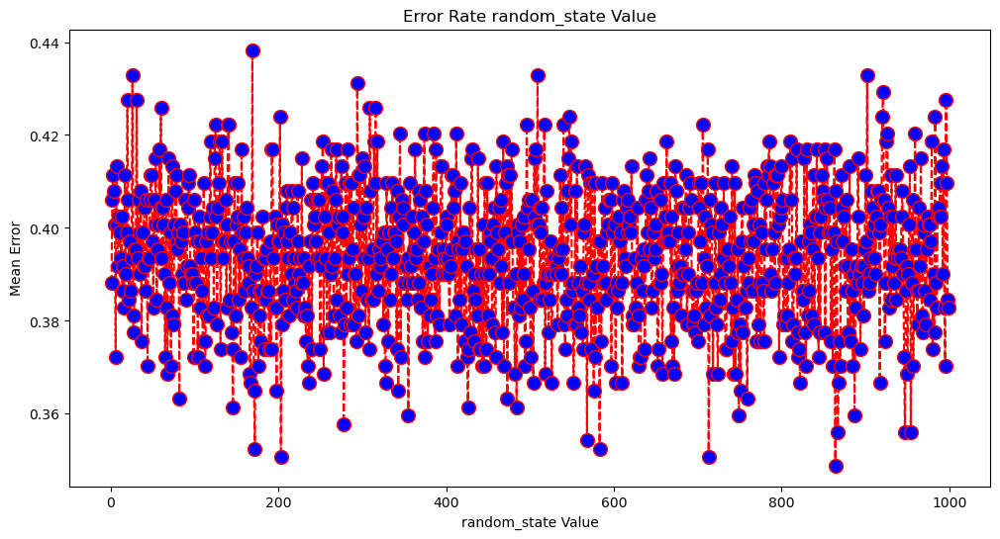

In [147]:
# Calculating error for random_state values between 1 and 1000
error = []

# Calculating error for random_state values between 1 and 1000
for i in range(1, 1000):
    print(str(i) + "/100")
    mlp_grid = MLPClassifier(random_state=i,max_iter=1000)
    mlp_grid.fit(X_train_stdscaled, y_train)
    pred_i = mlp_grid.predict(X_test_stdscaled)
    error.append(np.mean(pred_i != y_test))
plt.figure(figsize=(12, 6))
plt.plot(range(1, 1000), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate random_state Value')
plt.xlabel('random_state Value')
plt.ylabel('Mean Error')

850/100
851/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


852/100
853/100
854/100
855/100
856/100
857/100
858/100
859/100
860/100
861/100
862/100
863/100
864/100
865/100
866/100
867/100
868/100
869/100
870/100
871/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


872/100
873/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


874/100
875/100
876/100
877/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


878/100
879/100
880/100
881/100
882/100
883/100
884/100
885/100
886/100
887/100
888/100
889/100
890/100
891/100


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


892/100
893/100
894/100
895/100
896/100
897/100
898/100
899/100


Text(0, 0.5, 'Mean Error')

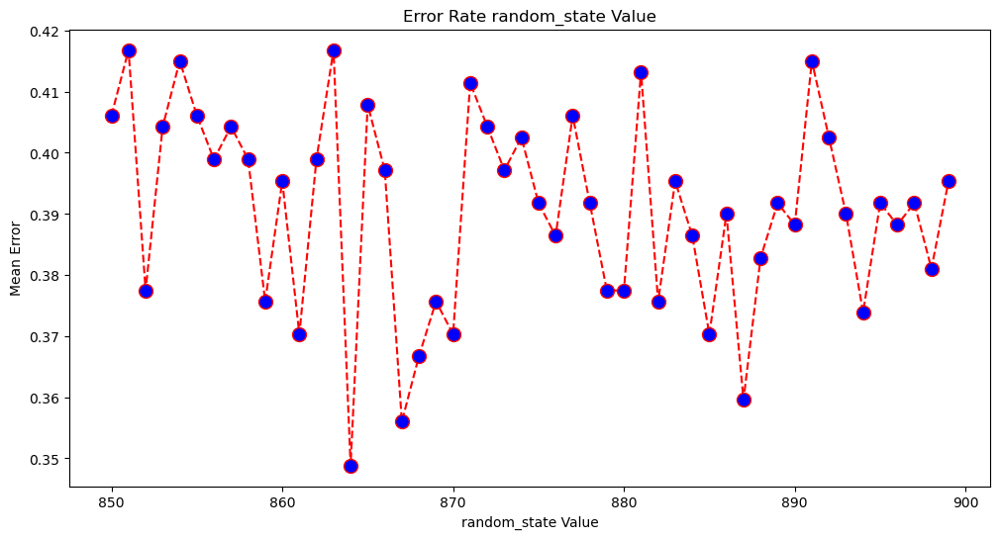

In [148]:
# Calculating error for random_state values between 1 and 1000
error = []

# Calculating error for random_state values between 1 and 1000
for i in range(850,900):
    print(str(i) + "/100")
    mlp_grid = MLPClassifier(random_state=i,max_iter=1000)
    mlp_grid.fit(X_train_stdscaled, y_train)
    pred_i = mlp_grid.predict(X_test_stdscaled)
    error.append(np.mean(pred_i != y_test))
plt.figure(figsize=(12, 6))
plt.plot(range(850,900), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate random_state Value')
plt.xlabel('random_state Value')
plt.ylabel('Mean Error')

In [149]:
# Create Decision MLP classifier
mlp = MLPClassifier(random_state=864,max_iter=1000)
mlp = mlp.fit(X_train_stdscaled,y_train)
mlp.score(X_test_stdscaled, y_test)

0.6511627906976745

In [150]:
mlp_grid = MLPClassifier(random_state=192,max_iter=1000)

params = {'activation': ['relu', 'tanh', 'logistic', 'identity'],
          'hidden_layer_sizes': [(100,), (50,100,), (50,75,100,)],
          'solver': ['adam', 'sgd', 'lbfgs'],
          'learning_rate' : ['constant', 'adaptive', 'invscaling'],
         }

mlp_grid = GridSearchCV(mlp_grid, param_grid=params, cv=10, scoring='accuracy')

mlp_grid.fit(X_train_scaled, y_train)

print('Best Score:', mlp_grid.best_score_, 'Best Parameters:', mlp_grid.best_params_)

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarni

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:536: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Best Score: 0.6179612427930813 Best Parameters: {'activation': 'relu', 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'solver': 'adam'}


In [70]:
# Create Decision MLP classifier
mlp = MLPClassifier(random_state=192,max_iter=1000, activation="relu", hidden_layer_sizes=(100,), learning_rate="constant", solver= 'adam')
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6726296958855098

In [71]:
mlp_grid = MLPClassifier(random_state=192,max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                         learning_rate="constant", solver= 'adam')

params = {'alpha': [0.00001, 0.0001, 0.001],
          'batch_size': [100, 200, 300, 'auto'],
          'shuffle': [True, False],
          'tol': [1e-4, 2e-4,0.0001],
          'early_stopping': [True, False],
         }

mlp_grid = GridSearchCV(mlp_grid, param_grid=params, cv=10, scoring='accuracy')

mlp_grid.fit(X_train_scaled, y_train)

print('Best Score:', mlp_grid.best_score_, 'Best Parameters:', mlp_grid.best_params_)

Best Score: 0.6179612427930813 Best Parameters: {'alpha': 0.0001, 'batch_size': 200, 'early_stopping': False, 'shuffle': True, 'tol': 0.0001}


In [74]:
# Create Decision MLP classifier
mlp = MLPClassifier(random_state=192, max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                         learning_rate="constant", solver= 'adam', alpha=0.0001, batch_size=200,
                         early_stopping=False, shuffle= True, tol= 0.0001)
mlp = mlp.fit(X_train_scaled,y_train)
mlp.score(X_test_scaled, y_test)

0.6726296958855098

In [75]:
mlp_grid = MLPClassifier(random_state=192,max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                         learning_rate="constant", solver= 'adam', alpha=0.0001, batch_size=200,
                         early_stopping=False, shuffle= True, tol= 0.0001)

params = {'warm_start': [True, False],
          'verbose': [True, False],
          'beta_1': [0, 0.9, 0.99],
          'beta_2': [0.99, 0.999, 0.9999],
          'epsilon': [1e-8, 2e-8],
          'n_iter_no_change': [1, 10, 100],
         }

mlp_grid = GridSearchCV(mlp_grid, param_grid=params, cv=10, scoring='accuracy')

mlp_grid.fit(X_train_scaled, y_train)

print('Best Score:', mlp_grid.best_score_, 'Best Parameters:', mlp_grid.best_params_)

Iteration 1, loss = 1.09186447
Iteration 2, loss = 1.03198834
Iteration 3, loss = 1.01135559
Iteration 4, loss = 1.00275130
Iteration 5, loss = 0.99376781
Iteration 6, loss = 0.98796469
Iteration 7, loss = 0.98165935
Iteration 8, loss = 0.97582607
Iteration 9, loss = 0.96955860
Iteration 10, loss = 0.96449502
Iteration 11, loss = 0.95898411
Iteration 12, loss = 0.95263823
Iteration 13, loss = 0.94713042
Iteration 14, loss = 0.94437562
Iteration 15, loss = 0.93789812
Iteration 16, loss = 0.93295321
Iteration 17, loss = 0.92558382
Iteration 18, loss = 0.92125534
Iteration 19, loss = 0.91547355
Iteration 20, loss = 0.91166423
Iteration 21, loss = 0.90540156
Iteration 22, loss = 0.90654393
Iteration 23, loss = 0.89888464
Iteration 24, loss = 0.89417568
Iteration 25, loss = 0.89171321
Iteration 26, loss = 0.88598225
Iteration 27, loss = 0.88188892
Iteration 28, loss = 0.87833280
Iteration 29, loss = 0.87668712
Iteration 30, loss = 0.87155730
Iteration 31, loss = 0.87040916
Iteration 32, los

Iteration 34, loss = 0.84915344
Iteration 35, loss = 0.84648116
Iteration 36, loss = 0.84693137
Iteration 37, loss = 0.85004913
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08846489
Iteration 2, loss = 1.02896831
Iteration 3, loss = 1.01283159
Iteration 4, loss = 1.00479781
Iteration 5, loss = 0.99643131
Iteration 6, loss = 0.99035578
Iteration 7, loss = 0.98448930
Iteration 8, loss = 0.97873964
Iteration 9, loss = 0.97240485
Iteration 10, loss = 0.96513595
Iteration 11, loss = 0.95846349
Iteration 12, loss = 0.95028685
Iteration 13, loss = 0.94448776
Iteration 14, loss = 0.93700613
Iteration 15, loss = 0.93023824
Iteration 16, loss = 0.92534646
Iteration 17, loss = 0.91958717
Iteration 18, loss = 0.91285496
Iteration 19, loss = 0.90813910
Iteration 20, loss = 0.90333620
Iteration 21, loss = 0.89758541
Iteration 22, loss = 0.89391898
Iteration 23, loss = 0.89026861
Iteration 24, loss = 0.88554308
Iteration 25, loss = 0.8

Iteration 10, loss = 0.95709849
Iteration 11, loss = 0.95158160
Iteration 12, loss = 0.94573091
Iteration 13, loss = 0.93905959
Iteration 14, loss = 0.93408854
Iteration 15, loss = 0.92846204
Iteration 16, loss = 0.92262981
Iteration 17, loss = 0.91635981
Iteration 18, loss = 0.91007765
Iteration 19, loss = 0.90503923
Iteration 20, loss = 0.89958047
Iteration 21, loss = 0.89566378
Iteration 22, loss = 0.89302494
Iteration 23, loss = 0.88791738
Iteration 24, loss = 0.88262631
Iteration 25, loss = 0.87898007
Iteration 26, loss = 0.87523710
Iteration 27, loss = 0.87055275
Iteration 28, loss = 0.86775987
Iteration 29, loss = 0.86609597
Iteration 30, loss = 0.86152627
Iteration 31, loss = 0.86369101
Iteration 32, loss = 0.85874583
Iteration 33, loss = 0.85545531
Iteration 34, loss = 0.85421570
Iteration 35, loss = 0.85152875
Iteration 36, loss = 0.85137265
Iteration 37, loss = 0.84724364
Iteration 38, loss = 0.84520857
Iteration 39, loss = 0.84376763
Iteration 40, loss = 0.84387025
Iteratio

Iteration 37, loss = 0.84846909
Iteration 38, loss = 0.84187640
Iteration 39, loss = 0.83791619
Iteration 40, loss = 0.83629914
Iteration 41, loss = 0.83434846
Iteration 42, loss = 0.83503610
Iteration 43, loss = 0.83575637
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08811085
Iteration 2, loss = 1.02655655
Iteration 3, loss = 1.00979787
Iteration 4, loss = 0.99986005
Iteration 5, loss = 0.99015051
Iteration 6, loss = 0.98199599
Iteration 7, loss = 0.97619695
Iteration 8, loss = 0.96986390
Iteration 9, loss = 0.96251609
Iteration 10, loss = 0.95442481
Iteration 11, loss = 0.94839543
Iteration 12, loss = 0.94147975
Iteration 13, loss = 0.93592675
Iteration 14, loss = 0.93049681
Iteration 15, loss = 0.92076272
Iteration 16, loss = 0.91671342
Iteration 17, loss = 0.91136610
Iteration 18, loss = 0.90457217
Iteration 19, loss = 0.90000225
Iteration 20, loss = 0.89400958
Iteration 21, loss = 0.88765903
Iteration 22, loss = 0.8

Iteration 123, loss = 0.80133745
Iteration 124, loss = 0.80147469
Iteration 125, loss = 0.80031377
Iteration 126, loss = 0.80094012
Iteration 127, loss = 0.79964019
Iteration 128, loss = 0.79990524
Iteration 129, loss = 0.80033201
Iteration 130, loss = 0.80196212
Iteration 131, loss = 0.79949051
Iteration 132, loss = 0.79977481
Iteration 133, loss = 0.80116248
Iteration 134, loss = 0.80008779
Iteration 135, loss = 0.80013273
Iteration 136, loss = 0.80256637
Iteration 137, loss = 0.80071685
Iteration 138, loss = 0.80219079
Iteration 139, loss = 0.79835061
Iteration 140, loss = 0.79894491
Iteration 141, loss = 0.80441101
Iteration 142, loss = 0.80106602
Iteration 143, loss = 0.80009198
Iteration 144, loss = 0.79835277
Iteration 145, loss = 0.79708445
Iteration 146, loss = 0.79806811
Iteration 147, loss = 0.80028284
Iteration 148, loss = 0.80033868
Iteration 149, loss = 0.79683050
Iteration 150, loss = 0.80019262
Iteration 151, loss = 0.79653735
Iteration 152, loss = 0.79809993
Iteration 

Iteration 125, loss = 0.79943667
Iteration 126, loss = 0.80312646
Iteration 127, loss = 0.79846156
Iteration 128, loss = 0.79994974
Iteration 129, loss = 0.80098311
Iteration 130, loss = 0.79916741
Iteration 131, loss = 0.79770471
Iteration 132, loss = 0.79794952
Iteration 133, loss = 0.79773820
Iteration 134, loss = 0.79853048
Iteration 135, loss = 0.79698438
Iteration 136, loss = 0.79820690
Iteration 137, loss = 0.80038862
Iteration 138, loss = 0.79864254
Iteration 139, loss = 0.79816106
Iteration 140, loss = 0.79925435
Iteration 141, loss = 0.79852742
Iteration 142, loss = 0.79636613
Iteration 143, loss = 0.79596847
Iteration 144, loss = 0.79812237
Iteration 145, loss = 0.79870738
Iteration 146, loss = 0.79848630
Iteration 147, loss = 0.79789135
Iteration 148, loss = 0.79736141
Iteration 149, loss = 0.79635244
Iteration 150, loss = 0.80024725
Iteration 151, loss = 0.79755404
Iteration 152, loss = 0.79829522
Iteration 153, loss = 0.79727233
Iteration 154, loss = 0.79574602
Iteration 

Iteration 249, loss = 0.79801764
Iteration 250, loss = 0.79647673
Iteration 251, loss = 0.80086032
Iteration 252, loss = 0.79696285
Iteration 253, loss = 0.79582338
Iteration 254, loss = 0.79733429
Iteration 255, loss = 0.79617239
Iteration 256, loss = 0.79914269
Iteration 257, loss = 0.79967403
Iteration 258, loss = 0.79961562
Iteration 259, loss = 0.79807093
Iteration 260, loss = 0.79838057
Iteration 261, loss = 0.79866375
Iteration 262, loss = 0.79710327
Iteration 263, loss = 0.79578813
Iteration 264, loss = 0.79689375
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08713208
Iteration 2, loss = 1.02777315
Iteration 3, loss = 1.01072868
Iteration 4, loss = 1.00228641
Iteration 5, loss = 0.99178596
Iteration 6, loss = 0.98396152
Iteration 7, loss = 0.97691151
Iteration 8, loss = 0.97061492
Iteration 9, loss = 0.96390617
Iteration 10, loss = 0.95721332
Iteration 11, loss = 0.95203650
Iteration 12, loss = 0.94528852
Iterati

Iteration 97, loss = 0.81568108
Iteration 98, loss = 0.81576839
Iteration 99, loss = 0.82076289
Iteration 100, loss = 0.81691008
Iteration 101, loss = 0.82215608
Iteration 102, loss = 0.81578834
Iteration 103, loss = 0.81587874
Iteration 104, loss = 0.81684954
Iteration 105, loss = 0.81661088
Iteration 106, loss = 0.81663037
Iteration 107, loss = 0.81477748
Iteration 108, loss = 0.81445749
Iteration 109, loss = 0.81786171
Iteration 110, loss = 0.81346430
Iteration 111, loss = 0.81459793
Iteration 112, loss = 0.81433119
Iteration 113, loss = 0.81497653
Iteration 114, loss = 0.81615063
Iteration 115, loss = 0.81766178
Iteration 116, loss = 0.81760379
Iteration 117, loss = 0.81389132
Iteration 118, loss = 0.81701407
Iteration 119, loss = 0.81740689
Iteration 120, loss = 0.81712340
Iteration 121, loss = 0.81261271
Iteration 122, loss = 0.81406233
Iteration 123, loss = 0.81266948
Iteration 124, loss = 0.81296053
Iteration 125, loss = 0.81295625
Iteration 126, loss = 0.81931744
Iteration 127

Iteration 87, loss = 0.80880445
Iteration 88, loss = 0.80776810
Iteration 89, loss = 0.80867042
Iteration 90, loss = 0.80775771
Iteration 91, loss = 0.80696790
Iteration 92, loss = 0.80662785
Iteration 93, loss = 0.80785400
Iteration 94, loss = 0.80641043
Iteration 95, loss = 0.80591033
Iteration 96, loss = 0.80622036
Iteration 97, loss = 0.80525432
Iteration 98, loss = 0.80558227
Iteration 99, loss = 0.81299973
Iteration 100, loss = 0.80552018
Iteration 101, loss = 0.81003179
Iteration 102, loss = 0.80474318
Iteration 103, loss = 0.80586744
Iteration 104, loss = 0.80745253
Iteration 105, loss = 0.80513793
Iteration 106, loss = 0.80474432
Iteration 107, loss = 0.80876979
Iteration 108, loss = 0.80450735
Iteration 109, loss = 0.80487648
Iteration 110, loss = 0.80467812
Iteration 111, loss = 0.80413748
Iteration 112, loss = 0.80389368
Iteration 113, loss = 0.80482641
Iteration 114, loss = 0.80740955
Iteration 115, loss = 0.80668782
Iteration 116, loss = 0.80571851
Iteration 117, loss = 0

Iteration 62, loss = 0.82689582
Iteration 63, loss = 0.82576234
Iteration 64, loss = 0.82800139
Iteration 65, loss = 0.82506733
Iteration 66, loss = 0.82434153
Iteration 67, loss = 0.82385816
Iteration 68, loss = 0.82425169
Iteration 69, loss = 0.82454305
Iteration 70, loss = 0.82445632
Iteration 71, loss = 0.82188914
Iteration 72, loss = 0.82326578
Iteration 73, loss = 0.82073512
Iteration 74, loss = 0.82559457
Iteration 75, loss = 0.82243261
Iteration 76, loss = 0.81994071
Iteration 77, loss = 0.82159197
Iteration 78, loss = 0.82345515
Iteration 79, loss = 0.82166956
Iteration 80, loss = 0.81951040
Iteration 81, loss = 0.82369835
Iteration 82, loss = 0.81975325
Iteration 83, loss = 0.81966754
Iteration 84, loss = 0.82073292
Iteration 85, loss = 0.82264938
Iteration 86, loss = 0.81910164
Iteration 87, loss = 0.82170584
Iteration 88, loss = 0.81874256
Iteration 89, loss = 0.81967082
Iteration 90, loss = 0.81849768
Iteration 91, loss = 0.81848402
Iteration 92, loss = 0.81689911
Iteratio

Iteration 83, loss = 0.81479441
Iteration 84, loss = 0.81909767
Iteration 85, loss = 0.81632013
Iteration 86, loss = 0.81474822
Iteration 87, loss = 0.81521180
Iteration 88, loss = 0.81464811
Iteration 89, loss = 0.81545426
Iteration 90, loss = 0.81267826
Iteration 91, loss = 0.81314680
Iteration 92, loss = 0.81324689
Iteration 93, loss = 0.81245144
Iteration 94, loss = 0.81416126
Iteration 95, loss = 0.81215407
Iteration 96, loss = 0.81210019
Iteration 97, loss = 0.81375287
Iteration 98, loss = 0.81375074
Iteration 99, loss = 0.81133205
Iteration 100, loss = 0.81230288
Iteration 101, loss = 0.81347844
Iteration 102, loss = 0.81246703
Iteration 103, loss = 0.81113417
Iteration 104, loss = 0.81160455
Iteration 105, loss = 0.81109572
Iteration 106, loss = 0.81410026
Iteration 107, loss = 0.81078632
Iteration 108, loss = 0.81120732
Iteration 109, loss = 0.81064565
Iteration 110, loss = 0.80927059
Iteration 111, loss = 0.81224844
Iteration 112, loss = 0.81088194
Iteration 113, loss = 0.811

Iteration 80, loss = 0.81623086
Iteration 81, loss = 0.81616137
Iteration 82, loss = 0.81791658
Iteration 83, loss = 0.81451263
Iteration 84, loss = 0.81360414
Iteration 85, loss = 0.81592873
Iteration 86, loss = 0.81657762
Iteration 87, loss = 0.81348507
Iteration 88, loss = 0.81343473
Iteration 89, loss = 0.81465929
Iteration 90, loss = 0.81286412
Iteration 91, loss = 0.81348973
Iteration 92, loss = 0.81296708
Iteration 93, loss = 0.81158776
Iteration 94, loss = 0.81220294
Iteration 95, loss = 0.81141145
Iteration 96, loss = 0.81192319
Iteration 97, loss = 0.81527184
Iteration 98, loss = 0.81247664
Iteration 99, loss = 0.81035588
Iteration 100, loss = 0.81118871
Iteration 101, loss = 0.81555041
Iteration 102, loss = 0.81053327
Iteration 103, loss = 0.81223236
Iteration 104, loss = 0.81651712
Iteration 105, loss = 0.80993043
Iteration 106, loss = 0.81158695
Iteration 107, loss = 0.80946609
Iteration 108, loss = 0.80913747
Iteration 109, loss = 0.81220411
Iteration 110, loss = 0.811014

Iteration 118, loss = 0.80496877
Iteration 119, loss = 0.80931887
Iteration 120, loss = 0.80590047
Iteration 121, loss = 0.80409004
Iteration 122, loss = 0.80289593
Iteration 123, loss = 0.80307189
Iteration 124, loss = 0.80199250
Iteration 125, loss = 0.80238122
Iteration 126, loss = 0.80938355
Iteration 127, loss = 0.80210262
Iteration 128, loss = 0.80467995
Iteration 129, loss = 0.80332130
Iteration 130, loss = 0.80200788
Iteration 131, loss = 0.80290884
Iteration 132, loss = 0.80150073
Iteration 133, loss = 0.80139142
Iteration 134, loss = 0.80290031
Iteration 135, loss = 0.80211028
Iteration 136, loss = 0.80212084
Iteration 137, loss = 0.80320095
Iteration 138, loss = 0.80438087
Iteration 139, loss = 0.80238089
Iteration 140, loss = 0.80471398
Iteration 141, loss = 0.80440776
Iteration 142, loss = 0.80085248
Iteration 143, loss = 0.80110666
Iteration 144, loss = 0.80219022
Iteration 145, loss = 0.80029911
Iteration 146, loss = 0.80048845
Iteration 147, loss = 0.80464193
Iteration 

Iteration 79, loss = 0.80715880
Iteration 80, loss = 0.81214188
Iteration 81, loss = 0.80744256
Iteration 82, loss = 0.80732873
Iteration 83, loss = 0.80680657
Iteration 84, loss = 0.80659426
Iteration 85, loss = 0.81117103
Iteration 86, loss = 0.80552385
Iteration 87, loss = 0.80598088
Iteration 88, loss = 0.80437753
Iteration 89, loss = 0.80580487
Iteration 90, loss = 0.80552466
Iteration 91, loss = 0.80493429
Iteration 92, loss = 0.80407167
Iteration 93, loss = 0.80437419
Iteration 94, loss = 0.80402290
Iteration 95, loss = 0.80412989
Iteration 96, loss = 0.80321229
Iteration 97, loss = 0.80221809
Iteration 98, loss = 0.80263418
Iteration 99, loss = 0.80903641
Iteration 100, loss = 0.80400049
Iteration 101, loss = 0.81040678
Iteration 102, loss = 0.80388958
Iteration 103, loss = 0.80299880
Iteration 104, loss = 0.80361369
Iteration 105, loss = 0.80297933
Iteration 106, loss = 0.80218918
Iteration 107, loss = 0.80163542
Iteration 108, loss = 0.80209033
Iteration 109, loss = 0.8058713

Iteration 30, loss = 0.85636083
Iteration 31, loss = 0.85376908
Iteration 32, loss = 0.84969273
Iteration 33, loss = 0.84659675
Iteration 34, loss = 0.84540126
Iteration 35, loss = 0.84193059
Iteration 36, loss = 0.83910804
Iteration 37, loss = 0.84586637
Iteration 38, loss = 0.83889195
Iteration 39, loss = 0.83480854
Iteration 40, loss = 0.83273403
Iteration 41, loss = 0.83151198
Iteration 42, loss = 0.83240293
Iteration 43, loss = 0.83172369
Iteration 44, loss = 0.82830244
Iteration 45, loss = 0.82763056
Iteration 46, loss = 0.82473540
Iteration 47, loss = 0.82370806
Iteration 48, loss = 0.82303973
Iteration 49, loss = 0.82165058
Iteration 50, loss = 0.82426295
Iteration 51, loss = 0.82518819
Iteration 52, loss = 0.82076154
Iteration 53, loss = 0.82013899
Iteration 54, loss = 0.81982106
Iteration 55, loss = 0.81808918
Iteration 56, loss = 0.81664138
Iteration 57, loss = 0.81893226
Iteration 58, loss = 0.81628979
Iteration 59, loss = 0.81587745
Iteration 60, loss = 0.81300399
Iteratio

Iteration 186, loss = 0.80897738
Iteration 187, loss = 0.81496572
Iteration 188, loss = 0.80858780
Iteration 189, loss = 0.80863469
Iteration 190, loss = 0.80815068
Iteration 191, loss = 0.80754975
Iteration 192, loss = 0.80884187
Iteration 193, loss = 0.80681035
Iteration 194, loss = 0.80799520
Iteration 195, loss = 0.81408499
Iteration 196, loss = 0.80856062
Iteration 197, loss = 0.80761636
Iteration 198, loss = 0.80549209
Iteration 199, loss = 0.80706069
Iteration 200, loss = 0.80816548
Iteration 201, loss = 0.80700049
Iteration 202, loss = 0.80891341
Iteration 203, loss = 0.80696471
Iteration 204, loss = 0.80938122
Iteration 205, loss = 0.80818649
Iteration 206, loss = 0.81362278
Iteration 207, loss = 0.80870079
Iteration 208, loss = 0.80579446
Iteration 209, loss = 0.80777906
Iteration 210, loss = 0.80670145
Iteration 211, loss = 0.80635756
Iteration 212, loss = 0.80750771
Iteration 213, loss = 0.80735583
Iteration 214, loss = 0.81320958
Iteration 215, loss = 0.80819208
Iteration 

Iteration 491, loss = 0.79490039
Iteration 492, loss = 0.79370333
Iteration 493, loss = 0.79543011
Iteration 494, loss = 0.79522595
Iteration 495, loss = 0.79572788
Iteration 496, loss = 0.79705363
Iteration 497, loss = 0.79240358
Iteration 498, loss = 0.79689126
Iteration 499, loss = 0.79340842
Iteration 500, loss = 0.79420940
Iteration 501, loss = 0.79247827
Iteration 502, loss = 0.79557419
Iteration 503, loss = 0.79210508
Iteration 504, loss = 0.79210084
Iteration 505, loss = 0.79306043
Iteration 506, loss = 0.79181907
Iteration 507, loss = 0.79393898
Iteration 508, loss = 0.79389789
Iteration 509, loss = 0.79277864
Iteration 510, loss = 0.79281061
Iteration 511, loss = 0.79267327
Iteration 512, loss = 0.79257902
Iteration 513, loss = 0.79721736
Iteration 514, loss = 0.79260559
Iteration 515, loss = 0.79197858
Iteration 516, loss = 0.79464575
Iteration 517, loss = 0.79409029
Iteration 518, loss = 0.79325419
Iteration 519, loss = 0.79153363
Iteration 520, loss = 0.79230579
Iteration 

Iteration 793, loss = 0.78226721
Iteration 794, loss = 0.78237943
Iteration 795, loss = 0.78405226
Iteration 796, loss = 0.78110720
Iteration 797, loss = 0.78172548
Iteration 798, loss = 0.78217409
Iteration 799, loss = 0.78468251
Iteration 800, loss = 0.78238517
Iteration 801, loss = 0.78498122
Iteration 802, loss = 0.78110782
Iteration 803, loss = 0.78064576
Iteration 804, loss = 0.78226485
Iteration 805, loss = 0.78230786
Iteration 806, loss = 0.78305058
Iteration 807, loss = 0.78337048
Iteration 808, loss = 0.78222929
Iteration 809, loss = 0.78339990
Iteration 810, loss = 0.78297894
Iteration 811, loss = 0.78275054
Iteration 812, loss = 0.78367950
Iteration 813, loss = 0.78000105
Iteration 814, loss = 0.78167370
Iteration 815, loss = 0.78045405
Iteration 816, loss = 0.78100332
Iteration 817, loss = 0.78275300
Iteration 818, loss = 0.78368302
Iteration 819, loss = 0.78066539
Iteration 820, loss = 0.78294681
Iteration 821, loss = 0.78053375
Iteration 822, loss = 0.78142033
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.85355023
Iteration 33, loss = 0.85172053
Iteration 34, loss = 0.84869731
Iteration 35, loss = 0.84511997
Iteration 36, loss = 0.84503456
Iteration 37, loss = 0.84040069
Iteration 38, loss = 0.83979181
Iteration 39, loss = 0.83683947
Iteration 40, loss = 0.83812641
Iteration 41, loss = 0.83647666
Iteration 42, loss = 0.83253737
Iteration 43, loss = 0.83241636
Iteration 44, loss = 0.82994071
Iteration 45, loss = 0.82987372
Iteration 46, loss = 0.82634337
Iteration 47, loss = 0.82645726
Iteration 48, loss = 0.82578239
Iteration 49, loss = 0.82436734
Iteration 50, loss = 0.82249010
Iteration 51, loss = 0.82694396
Iteration 52, loss = 0.82127204
Iteration 53, loss = 0.81928211
Iteration 54, loss = 0.82004529
Iteration 55, loss = 0.81908720
Iteration 56, loss = 0.81894689
Iteration 57, loss = 0.81753091
Iteration 58, loss = 0.81588208
Iteration 59, loss = 0.81668321
Iteration 60, loss = 0.81421003
Iteration 61, loss = 0.81334966
Iteration 62, loss = 0.81388462
Iteratio

Iteration 341, loss = 0.78559385
Iteration 342, loss = 0.78645439
Iteration 343, loss = 0.78554791
Iteration 344, loss = 0.78738832
Iteration 345, loss = 0.79156759
Iteration 346, loss = 0.78674250
Iteration 347, loss = 0.78620165
Iteration 348, loss = 0.78723308
Iteration 349, loss = 0.78570690
Iteration 350, loss = 0.78436338
Iteration 351, loss = 0.78717979
Iteration 352, loss = 0.78990966
Iteration 353, loss = 0.78538046
Iteration 354, loss = 0.78863497
Iteration 355, loss = 0.78790635
Iteration 356, loss = 0.78611836
Iteration 357, loss = 0.78583899
Iteration 358, loss = 0.78610025
Iteration 359, loss = 0.78862414
Iteration 360, loss = 0.78643588
Iteration 361, loss = 0.78730893
Iteration 362, loss = 0.78404341
Iteration 363, loss = 0.78518806
Iteration 364, loss = 0.78563390
Iteration 365, loss = 0.78591666
Iteration 366, loss = 0.78749091
Iteration 367, loss = 0.78526349
Iteration 368, loss = 0.78690430
Iteration 369, loss = 0.78689680
Iteration 370, loss = 0.78467573
Iteration 

Iteration 644, loss = 0.77905690
Iteration 645, loss = 0.77384211
Iteration 646, loss = 0.77579038
Iteration 647, loss = 0.77704968
Iteration 648, loss = 0.77301196
Iteration 649, loss = 0.77494264
Iteration 650, loss = 0.77326682
Iteration 651, loss = 0.77257247
Iteration 652, loss = 0.77359236
Iteration 653, loss = 0.77214299
Iteration 654, loss = 0.77608245
Iteration 655, loss = 0.77264981
Iteration 656, loss = 0.77272526
Iteration 657, loss = 0.77324487
Iteration 658, loss = 0.77321863
Iteration 659, loss = 0.77571915
Iteration 660, loss = 0.77175259
Iteration 661, loss = 0.77367446
Iteration 662, loss = 0.77218848
Iteration 663, loss = 0.77163621
Iteration 664, loss = 0.77379365
Iteration 665, loss = 0.77592470
Iteration 666, loss = 0.77241121
Iteration 667, loss = 0.77466221
Iteration 668, loss = 0.77309190
Iteration 669, loss = 0.77233461
Iteration 670, loss = 0.77420624
Iteration 671, loss = 0.77596406
Iteration 672, loss = 0.77280378
Iteration 673, loss = 0.77234912
Iteration 

Iteration 942, loss = 0.76293018
Iteration 943, loss = 0.76453852
Iteration 944, loss = 0.76297685
Iteration 945, loss = 0.76275033
Iteration 946, loss = 0.76680727
Iteration 947, loss = 0.76309562
Iteration 948, loss = 0.76373603
Iteration 949, loss = 0.76479376
Iteration 950, loss = 0.76444721
Iteration 951, loss = 0.76760934
Iteration 952, loss = 0.76394311
Iteration 953, loss = 0.76353866
Iteration 954, loss = 0.76468726
Iteration 955, loss = 0.76257173
Iteration 956, loss = 0.76300931
Iteration 957, loss = 0.76465076
Iteration 958, loss = 0.76717870
Iteration 959, loss = 0.76366263
Iteration 960, loss = 0.76217646
Iteration 961, loss = 0.76367577
Iteration 962, loss = 0.76609587
Iteration 963, loss = 0.76913606
Iteration 964, loss = 0.76189799
Iteration 965, loss = 0.76293031
Iteration 966, loss = 0.76350992
Iteration 967, loss = 0.76574663
Iteration 968, loss = 0.76201011
Iteration 969, loss = 0.76290461
Iteration 970, loss = 0.76535480
Iteration 971, loss = 0.76406600
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.09103411
Iteration 2, loss = 1.02930856
Iteration 3, loss = 1.01057528
Iteration 4, loss = 1.00172460
Iteration 5, loss = 0.99148529
Iteration 6, loss = 0.98278998
Iteration 7, loss = 0.97534520
Iteration 8, loss = 0.97004443
Iteration 9, loss = 0.96294824
Iteration 10, loss = 0.95709849
Iteration 11, loss = 0.95158160
Iteration 12, loss = 0.94573091
Iteration 13, loss = 0.93905959
Iteration 14, loss = 0.93408854
Iteration 15, loss = 0.92846204
Iteration 16, loss = 0.92262981
Iteration 17, loss = 0.91635981
Iteration 18, loss = 0.91007765
Iteration 19, loss = 0.90503923
Iteration 20, loss = 0.89958047
Iteration 21, loss = 0.89566378
Iteration 22, loss = 0.89302494
Iteration 23, loss = 0.88791738
Iteration 24, loss = 0.88262631
Iteration 25, loss = 0.87898007
Iteration 26, loss = 0.87523710
Iteration 27, loss = 0.87055275
Iteration 28, loss = 0.86775987
Iteration 29, loss = 0.86609597
Iteration 30, loss = 0.86152627
Iteration 31, loss = 0.86369101
Iteration 32, los

Iteration 309, loss = 0.79672452
Iteration 310, loss = 0.79790296
Iteration 311, loss = 0.79675437
Iteration 312, loss = 0.79800095
Iteration 313, loss = 0.79702545
Iteration 314, loss = 0.79809128
Iteration 315, loss = 0.79753694
Iteration 316, loss = 0.79862956
Iteration 317, loss = 0.79940057
Iteration 318, loss = 0.79721968
Iteration 319, loss = 0.79702372
Iteration 320, loss = 0.79610017
Iteration 321, loss = 0.79906736
Iteration 322, loss = 0.79579807
Iteration 323, loss = 0.79813228
Iteration 324, loss = 0.79812560
Iteration 325, loss = 0.79789560
Iteration 326, loss = 0.79835680
Iteration 327, loss = 0.79783244
Iteration 328, loss = 0.80157400
Iteration 329, loss = 0.79678775
Iteration 330, loss = 0.80126393
Iteration 331, loss = 0.79792694
Iteration 332, loss = 0.79697517
Iteration 333, loss = 0.79861697
Iteration 334, loss = 0.79764034
Iteration 335, loss = 0.79574336
Iteration 336, loss = 0.79667169
Iteration 337, loss = 0.80064328
Iteration 338, loss = 0.79669363
Iteration 

Iteration 614, loss = 0.78669017
Iteration 615, loss = 0.78567461
Iteration 616, loss = 0.78875424
Iteration 617, loss = 0.78742881
Iteration 618, loss = 0.78762005
Iteration 619, loss = 0.79055994
Iteration 620, loss = 0.78801737
Iteration 621, loss = 0.78540573
Iteration 622, loss = 0.78590113
Iteration 623, loss = 0.78729009
Iteration 624, loss = 0.78706181
Iteration 625, loss = 0.78715094
Iteration 626, loss = 0.78566964
Iteration 627, loss = 0.78550595
Iteration 628, loss = 0.79082952
Iteration 629, loss = 0.78425506
Iteration 630, loss = 0.78651469
Iteration 631, loss = 0.78531960
Iteration 632, loss = 0.78451633
Iteration 633, loss = 0.78513077
Iteration 634, loss = 0.78539428
Iteration 635, loss = 0.78500057
Iteration 636, loss = 0.78532461
Iteration 637, loss = 0.78484090
Iteration 638, loss = 0.78574188
Iteration 639, loss = 0.78451477
Iteration 640, loss = 0.78592225
Iteration 641, loss = 0.78508760
Iteration 642, loss = 0.78509912
Iteration 643, loss = 0.78619989
Iteration 

Iteration 914, loss = 0.77719194
Iteration 915, loss = 0.77892844
Iteration 916, loss = 0.77610652
Iteration 917, loss = 0.77668718
Iteration 918, loss = 0.77676515
Iteration 919, loss = 0.78051683
Iteration 920, loss = 0.77609093
Iteration 921, loss = 0.77591925
Iteration 922, loss = 0.77651067
Iteration 923, loss = 0.78173268
Iteration 924, loss = 0.77695141
Iteration 925, loss = 0.77585527
Iteration 926, loss = 0.77567515
Iteration 927, loss = 0.77650466
Iteration 928, loss = 0.77564437
Iteration 929, loss = 0.78392186
Iteration 930, loss = 0.77724345
Iteration 931, loss = 0.77493587
Iteration 932, loss = 0.77479013
Iteration 933, loss = 0.78224774
Iteration 934, loss = 0.77546429
Iteration 935, loss = 0.77611517
Iteration 936, loss = 0.77538458
Iteration 937, loss = 0.77731395
Iteration 938, loss = 0.77620557
Iteration 939, loss = 0.77793050
Iteration 940, loss = 0.77863514
Iteration 941, loss = 0.77463155
Iteration 942, loss = 0.77503681
Iteration 943, loss = 0.77662933
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.84880259
Iteration 35, loss = 0.84650908
Iteration 36, loss = 0.84540946
Iteration 37, loss = 0.84862684
Iteration 38, loss = 0.84116562
Iteration 39, loss = 0.83754767
Iteration 40, loss = 0.83673761
Iteration 41, loss = 0.83986609
Iteration 42, loss = 0.83571845
Iteration 43, loss = 0.83447187
Iteration 44, loss = 0.83057867
Iteration 45, loss = 0.82964626
Iteration 46, loss = 0.82860901
Iteration 47, loss = 0.82728345
Iteration 48, loss = 0.82585798
Iteration 49, loss = 0.83253231
Iteration 50, loss = 0.82429150
Iteration 51, loss = 0.82275839
Iteration 52, loss = 0.82231122
Iteration 53, loss = 0.82249941
Iteration 54, loss = 0.82039711
Iteration 55, loss = 0.82062019
Iteration 56, loss = 0.82076854
Iteration 57, loss = 0.81906747
Iteration 58, loss = 0.81985422
Iteration 59, loss = 0.81662267
Iteration 60, loss = 0.81661187
Iteration 61, loss = 0.81578737
Iteration 62, loss = 0.81630842
Iteration 63, loss = 0.81378739
Iteration 64, loss = 0.81320548
Iteratio

Iteration 336, loss = 0.78758188
Iteration 337, loss = 0.78694961
Iteration 338, loss = 0.78942375
Iteration 339, loss = 0.78733734
Iteration 340, loss = 0.78663564
Iteration 341, loss = 0.78529561
Iteration 342, loss = 0.78859617
Iteration 343, loss = 0.79313327
Iteration 344, loss = 0.78643213
Iteration 345, loss = 0.78697619
Iteration 346, loss = 0.78639612
Iteration 347, loss = 0.78586871
Iteration 348, loss = 0.78611736
Iteration 349, loss = 0.78766999
Iteration 350, loss = 0.78729971
Iteration 351, loss = 0.78527577
Iteration 352, loss = 0.78542617
Iteration 353, loss = 0.78507398
Iteration 354, loss = 0.78845720
Iteration 355, loss = 0.78536940
Iteration 356, loss = 0.78697830
Iteration 357, loss = 0.78563740
Iteration 358, loss = 0.78457404
Iteration 359, loss = 0.78574350
Iteration 360, loss = 0.78766759
Iteration 361, loss = 0.78698196
Iteration 362, loss = 0.78494677
Iteration 363, loss = 0.78945159
Iteration 364, loss = 0.78474708
Iteration 365, loss = 0.78798401
Iteration 

Iteration 634, loss = 0.77650822
Iteration 635, loss = 0.77733317
Iteration 636, loss = 0.77591605
Iteration 637, loss = 0.77749637
Iteration 638, loss = 0.78211779
Iteration 639, loss = 0.77499601
Iteration 640, loss = 0.77623127
Iteration 641, loss = 0.77587388
Iteration 642, loss = 0.77370583
Iteration 643, loss = 0.78124070
Iteration 644, loss = 0.78395810
Iteration 645, loss = 0.77662710
Iteration 646, loss = 0.77500948
Iteration 647, loss = 0.77560810
Iteration 648, loss = 0.77496494
Iteration 649, loss = 0.77441254
Iteration 650, loss = 0.77459371
Iteration 651, loss = 0.78002413
Iteration 652, loss = 0.77686789
Iteration 653, loss = 0.77393868
Iteration 654, loss = 0.77684942
Iteration 655, loss = 0.77428023
Iteration 656, loss = 0.77494073
Iteration 657, loss = 0.77522350
Iteration 658, loss = 0.77393126
Iteration 659, loss = 0.77968666
Iteration 660, loss = 0.77569351
Iteration 661, loss = 0.77929027
Iteration 662, loss = 0.77502856
Iteration 663, loss = 0.77480988
Iteration 

Iteration 938, loss = 0.76660923
Iteration 939, loss = 0.76746304
Iteration 940, loss = 0.76675151
Iteration 941, loss = 0.76519859
Iteration 942, loss = 0.76525976
Iteration 943, loss = 0.76580349
Iteration 944, loss = 0.76920012
Iteration 945, loss = 0.76591789
Iteration 946, loss = 0.76712065
Iteration 947, loss = 0.76545175
Iteration 948, loss = 0.76515226
Iteration 949, loss = 0.76439125
Iteration 950, loss = 0.76806890
Iteration 951, loss = 0.76520799
Iteration 952, loss = 0.76572560
Iteration 953, loss = 0.76678474
Iteration 954, loss = 0.76487616
Iteration 955, loss = 0.76531316
Iteration 956, loss = 0.76942953
Iteration 957, loss = 0.76496049
Iteration 958, loss = 0.76650582
Iteration 959, loss = 0.76538233
Iteration 960, loss = 0.76532704
Iteration 961, loss = 0.77027739
Iteration 962, loss = 0.76721066
Iteration 963, loss = 0.76498120
Iteration 964, loss = 0.76433606
Iteration 965, loss = 0.76762909
Iteration 966, loss = 0.76495232
Iteration 967, loss = 0.76381412
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.82901482
Iteration 57, loss = 0.82712366
Iteration 58, loss = 0.82724055
Iteration 59, loss = 0.82577572
Iteration 60, loss = 0.82491164
Iteration 61, loss = 0.82443331
Iteration 62, loss = 0.82398151
Iteration 63, loss = 0.82215360
Iteration 64, loss = 0.82232450
Iteration 65, loss = 0.82182909
Iteration 66, loss = 0.82142514
Iteration 67, loss = 0.82094377
Iteration 68, loss = 0.81903021
Iteration 69, loss = 0.82386007
Iteration 70, loss = 0.81948318
Iteration 71, loss = 0.81896275
Iteration 72, loss = 0.82053373
Iteration 73, loss = 0.81934542
Iteration 74, loss = 0.81940405
Iteration 75, loss = 0.81985788
Iteration 76, loss = 0.81865864
Iteration 77, loss = 0.81601769
Iteration 78, loss = 0.81600774
Iteration 79, loss = 0.81635378
Iteration 80, loss = 0.81623086
Iteration 81, loss = 0.81616137
Iteration 82, loss = 0.81791658
Iteration 83, loss = 0.81451263
Iteration 84, loss = 0.81360414
Iteration 85, loss = 0.81592873
Iteration 86, loss = 0.81657762
Iteratio

Iteration 359, loss = 0.79132724
Iteration 360, loss = 0.79309534
Iteration 361, loss = 0.79081066
Iteration 362, loss = 0.78991515
Iteration 363, loss = 0.79294572
Iteration 364, loss = 0.78986873
Iteration 365, loss = 0.79080508
Iteration 366, loss = 0.79163601
Iteration 367, loss = 0.79100126
Iteration 368, loss = 0.78968833
Iteration 369, loss = 0.78998957
Iteration 370, loss = 0.78985993
Iteration 371, loss = 0.79009538
Iteration 372, loss = 0.79109654
Iteration 373, loss = 0.79534770
Iteration 374, loss = 0.78913056
Iteration 375, loss = 0.79133200
Iteration 376, loss = 0.78957026
Iteration 377, loss = 0.79184662
Iteration 378, loss = 0.78895610
Iteration 379, loss = 0.78924937
Iteration 380, loss = 0.79037640
Iteration 381, loss = 0.79042096
Iteration 382, loss = 0.79000702
Iteration 383, loss = 0.78900430
Iteration 384, loss = 0.79147547
Iteration 385, loss = 0.78980573
Iteration 386, loss = 0.78899290
Iteration 387, loss = 0.79158057
Iteration 388, loss = 0.79022539
Iteration 

Iteration 657, loss = 0.77791113
Iteration 658, loss = 0.77842992
Iteration 659, loss = 0.77742751
Iteration 660, loss = 0.77803767
Iteration 661, loss = 0.78275266
Iteration 662, loss = 0.77987981
Iteration 663, loss = 0.77732324
Iteration 664, loss = 0.78082570
Iteration 665, loss = 0.78050564
Iteration 666, loss = 0.77791970
Iteration 667, loss = 0.77618569
Iteration 668, loss = 0.77762599
Iteration 669, loss = 0.77701897
Iteration 670, loss = 0.77624848
Iteration 671, loss = 0.77830279
Iteration 672, loss = 0.77796443
Iteration 673, loss = 0.77870802
Iteration 674, loss = 0.77886720
Iteration 675, loss = 0.77838847
Iteration 676, loss = 0.77732657
Iteration 677, loss = 0.77862362
Iteration 678, loss = 0.77719442
Iteration 679, loss = 0.77850226
Iteration 680, loss = 0.77661900
Iteration 681, loss = 0.78055774
Iteration 682, loss = 0.77600506
Iteration 683, loss = 0.77979560
Iteration 684, loss = 0.77747374
Iteration 685, loss = 0.77663006
Iteration 686, loss = 0.78018780
Iteration 

Iteration 951, loss = 0.76749720
Iteration 952, loss = 0.76745965
Iteration 953, loss = 0.76975349
Iteration 954, loss = 0.76651126
Iteration 955, loss = 0.77359044
Iteration 956, loss = 0.77224375
Iteration 957, loss = 0.76749484
Iteration 958, loss = 0.76928308
Iteration 959, loss = 0.76798503
Iteration 960, loss = 0.77549848
Iteration 961, loss = 0.77120295
Iteration 962, loss = 0.76893677
Iteration 963, loss = 0.76764888
Iteration 964, loss = 0.76632564
Iteration 965, loss = 0.76867086
Iteration 966, loss = 0.76712601
Iteration 967, loss = 0.76639251
Iteration 968, loss = 0.76701252
Iteration 969, loss = 0.76721408
Iteration 970, loss = 0.76891569
Iteration 971, loss = 0.76967989
Iteration 972, loss = 0.76704368
Iteration 973, loss = 0.76884114
Iteration 974, loss = 0.76724744
Iteration 975, loss = 0.77023281
Iteration 976, loss = 0.76745757
Iteration 977, loss = 0.76732208
Iteration 978, loss = 0.76659302
Iteration 979, loss = 0.76632661
Iteration 980, loss = 0.77025336
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.96390617
Iteration 10, loss = 0.95721332
Iteration 11, loss = 0.95203650
Iteration 12, loss = 0.94528852
Iteration 13, loss = 0.94178308
Iteration 14, loss = 0.93293248
Iteration 15, loss = 0.92882383
Iteration 16, loss = 0.92241577
Iteration 17, loss = 0.91732407
Iteration 18, loss = 0.91044723
Iteration 19, loss = 0.90468666
Iteration 20, loss = 0.89945365
Iteration 21, loss = 0.89421014
Iteration 22, loss = 0.88921518
Iteration 23, loss = 0.88650242
Iteration 24, loss = 0.88097121
Iteration 25, loss = 0.87842335
Iteration 26, loss = 0.87362839
Iteration 27, loss = 0.86827726
Iteration 28, loss = 0.86738776
Iteration 29, loss = 0.86362109
Iteration 30, loss = 0.85861958
Iteration 31, loss = 0.85834463
Iteration 32, loss = 0.85537067
Iteration 33, loss = 0.85266478
Iteration 34, loss = 0.84915344
Iteration 35, loss = 0.84648116
Iteration 36, loss = 0.84693137
Iteration 37, loss = 0.85004913
Iteration 38, loss = 0.84230455
Iteration 39, loss = 0.83995081
Iteration

Iteration 312, loss = 0.79888528
Iteration 313, loss = 0.78991284
Iteration 314, loss = 0.78983134
Iteration 315, loss = 0.79060009
Iteration 316, loss = 0.78917866
Iteration 317, loss = 0.79104557
Iteration 318, loss = 0.79014314
Iteration 319, loss = 0.79095744
Iteration 320, loss = 0.79079740
Iteration 321, loss = 0.79118066
Iteration 322, loss = 0.79027686
Iteration 323, loss = 0.79165278
Iteration 324, loss = 0.79325026
Iteration 325, loss = 0.78976282
Iteration 326, loss = 0.79110679
Iteration 327, loss = 0.79215846
Iteration 328, loss = 0.79120498
Iteration 329, loss = 0.78989117
Iteration 330, loss = 0.79316136
Iteration 331, loss = 0.79117620
Iteration 332, loss = 0.78874254
Iteration 333, loss = 0.79146037
Iteration 334, loss = 0.79240842
Iteration 335, loss = 0.78947425
Iteration 336, loss = 0.79081157
Iteration 337, loss = 0.79001540
Iteration 338, loss = 0.79052935
Iteration 339, loss = 0.78994676
Iteration 340, loss = 0.78876759
Iteration 341, loss = 0.78890676
Iteration 

Iteration 610, loss = 0.77890180
Iteration 611, loss = 0.77825861
Iteration 612, loss = 0.78071003
Iteration 613, loss = 0.77726895
Iteration 614, loss = 0.77803023
Iteration 615, loss = 0.77785413
Iteration 616, loss = 0.78403995
Iteration 617, loss = 0.77824316
Iteration 618, loss = 0.77980398
Iteration 619, loss = 0.77830371
Iteration 620, loss = 0.77813545
Iteration 621, loss = 0.78007340
Iteration 622, loss = 0.77781814
Iteration 623, loss = 0.77910765
Iteration 624, loss = 0.77845307
Iteration 625, loss = 0.77777325
Iteration 626, loss = 0.77965429
Iteration 627, loss = 0.77902690
Iteration 628, loss = 0.78034752
Iteration 629, loss = 0.77887400
Iteration 630, loss = 0.77722588
Iteration 631, loss = 0.77806753
Iteration 632, loss = 0.77813851
Iteration 633, loss = 0.77739455
Iteration 634, loss = 0.77876806
Iteration 635, loss = 0.78045656
Iteration 636, loss = 0.77769628
Iteration 637, loss = 0.78009760
Iteration 638, loss = 0.78534366
Iteration 639, loss = 0.77871577
Iteration 

Iteration 910, loss = 0.76801820
Iteration 911, loss = 0.76732233
Iteration 912, loss = 0.77663906
Iteration 913, loss = 0.76906612
Iteration 914, loss = 0.76776019
Iteration 915, loss = 0.76736628
Iteration 916, loss = 0.76735244
Iteration 917, loss = 0.76755833
Iteration 918, loss = 0.76770830
Iteration 919, loss = 0.76986210
Iteration 920, loss = 0.76720568
Iteration 921, loss = 0.76813618
Iteration 922, loss = 0.76718404
Iteration 923, loss = 0.76696471
Iteration 924, loss = 0.76675715
Iteration 925, loss = 0.76830886
Iteration 926, loss = 0.76832321
Iteration 927, loss = 0.76948913
Iteration 928, loss = 0.76746424
Iteration 929, loss = 0.76903470
Iteration 930, loss = 0.76763076
Iteration 931, loss = 0.76735041
Iteration 932, loss = 0.76756395
Iteration 933, loss = 0.76736765
Iteration 934, loss = 0.77083130
Iteration 935, loss = 0.76686779
Iteration 936, loss = 0.76776803
Iteration 937, loss = 0.77046116
Iteration 938, loss = 0.76744524
Iteration 939, loss = 0.76846843
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.86623991
Iteration 31, loss = 0.86497163
Iteration 32, loss = 0.86205203
Iteration 33, loss = 0.85920605
Iteration 34, loss = 0.85589435
Iteration 35, loss = 0.85393508
Iteration 36, loss = 0.85258513
Iteration 37, loss = 0.85663757
Iteration 38, loss = 0.85109713
Iteration 39, loss = 0.84782824
Iteration 40, loss = 0.84592684
Iteration 41, loss = 0.84985116
Iteration 42, loss = 0.84706267
Iteration 43, loss = 0.84379862
Iteration 44, loss = 0.84032003
Iteration 45, loss = 0.83986102
Iteration 46, loss = 0.83979156
Iteration 47, loss = 0.83637799
Iteration 48, loss = 0.83619222
Iteration 49, loss = 0.83761461
Iteration 50, loss = 0.83520497
Iteration 51, loss = 0.83456523
Iteration 52, loss = 0.83368624
Iteration 53, loss = 0.83262608
Iteration 54, loss = 0.83168099
Iteration 55, loss = 0.83230668
Iteration 56, loss = 0.83102749
Iteration 57, loss = 0.82905864
Iteration 58, loss = 0.83011802
Iteration 59, loss = 0.82806121
Iteration 60, loss = 0.82725866
Iteratio

Iteration 336, loss = 0.80054594
Iteration 337, loss = 0.79931979
Iteration 338, loss = 0.79873281
Iteration 339, loss = 0.80022805
Iteration 340, loss = 0.79914636
Iteration 341, loss = 0.80000113
Iteration 342, loss = 0.80088240
Iteration 343, loss = 0.80474141
Iteration 344, loss = 0.80128394
Iteration 345, loss = 0.79892517
Iteration 346, loss = 0.80052018
Iteration 347, loss = 0.79918135
Iteration 348, loss = 0.79889117
Iteration 349, loss = 0.79992920
Iteration 350, loss = 0.80178156
Iteration 351, loss = 0.80092023
Iteration 352, loss = 0.79866639
Iteration 353, loss = 0.79870375
Iteration 354, loss = 0.79901198
Iteration 355, loss = 0.79885694
Iteration 356, loss = 0.79903521
Iteration 357, loss = 0.79859720
Iteration 358, loss = 0.79934676
Iteration 359, loss = 0.80055778
Iteration 360, loss = 0.79924000
Iteration 361, loss = 0.79863048
Iteration 362, loss = 0.79837603
Iteration 363, loss = 0.79869097
Iteration 364, loss = 0.79732558
Iteration 365, loss = 0.79859646
Iteration 

Iteration 638, loss = 0.80071465
Iteration 639, loss = 0.78771418
Iteration 640, loss = 0.78785901
Iteration 641, loss = 0.78852053
Iteration 642, loss = 0.78772859
Iteration 643, loss = 0.79076292
Iteration 644, loss = 0.79340213
Iteration 645, loss = 0.79203210
Iteration 646, loss = 0.78846589
Iteration 647, loss = 0.78642215
Iteration 648, loss = 0.78677406
Iteration 649, loss = 0.78773113
Iteration 650, loss = 0.78689709
Iteration 651, loss = 0.78721167
Iteration 652, loss = 0.78665085
Iteration 653, loss = 0.78656038
Iteration 654, loss = 0.78909917
Iteration 655, loss = 0.78644371
Iteration 656, loss = 0.78660328
Iteration 657, loss = 0.78717108
Iteration 658, loss = 0.78639794
Iteration 659, loss = 0.78726333
Iteration 660, loss = 0.78659557
Iteration 661, loss = 0.79134941
Iteration 662, loss = 0.78924233
Iteration 663, loss = 0.78590068
Iteration 664, loss = 0.79201995
Iteration 665, loss = 0.78819415
Iteration 666, loss = 0.78716461
Iteration 667, loss = 0.78820467
Iteration 

Iteration 930, loss = 0.77863013
Iteration 931, loss = 0.77981084
Iteration 932, loss = 0.77776194
Iteration 933, loss = 0.77739646
Iteration 934, loss = 0.78046348
Iteration 935, loss = 0.77711849
Iteration 936, loss = 0.77730501
Iteration 937, loss = 0.77755185
Iteration 938, loss = 0.77739096
Iteration 939, loss = 0.77753840
Iteration 940, loss = 0.78015648
Iteration 941, loss = 0.77649524
Iteration 942, loss = 0.77699544
Iteration 943, loss = 0.77699053
Iteration 944, loss = 0.77812379
Iteration 945, loss = 0.77724669
Iteration 946, loss = 0.77736687
Iteration 947, loss = 0.77683720
Iteration 948, loss = 0.77719157
Iteration 949, loss = 0.77973920
Iteration 950, loss = 0.77717565
Iteration 951, loss = 0.77562532
Iteration 952, loss = 0.77661970
Iteration 953, loss = 0.78149862
Iteration 954, loss = 0.77626247
Iteration 955, loss = 0.78220069
Iteration 956, loss = 0.77694327
Iteration 957, loss = 0.77598093
Iteration 958, loss = 0.77997427
Iteration 959, loss = 0.77952460
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.82291770
Iteration 50, loss = 0.82141213
Iteration 51, loss = 0.82236244
Iteration 52, loss = 0.82070882
Iteration 53, loss = 0.81953233
Iteration 54, loss = 0.81917088
Iteration 55, loss = 0.81934441
Iteration 56, loss = 0.81733373
Iteration 57, loss = 0.81852518
Iteration 58, loss = 0.81780252
Iteration 59, loss = 0.81582834
Iteration 60, loss = 0.81430900
Iteration 61, loss = 0.81547447
Iteration 62, loss = 0.81592502
Iteration 63, loss = 0.81271149
Iteration 64, loss = 0.81194086
Iteration 65, loss = 0.81260478
Iteration 66, loss = 0.81267989
Iteration 67, loss = 0.81271413
Iteration 68, loss = 0.81025848
Iteration 69, loss = 0.81175556
Iteration 70, loss = 0.80974421
Iteration 71, loss = 0.80949341
Iteration 72, loss = 0.81076396
Iteration 73, loss = 0.81150674
Iteration 74, loss = 0.81230402
Iteration 75, loss = 0.80813768
Iteration 76, loss = 0.80945148
Iteration 77, loss = 0.80741729
Iteration 78, loss = 0.80684277
Iteration 79, loss = 0.80715880
Iteratio

Iteration 353, loss = 0.78644362
Iteration 354, loss = 0.78718402
Iteration 355, loss = 0.78836090
Iteration 356, loss = 0.78815104
Iteration 357, loss = 0.78659151
Iteration 358, loss = 0.78621881
Iteration 359, loss = 0.78938350
Iteration 360, loss = 0.78728965
Iteration 361, loss = 0.78701785
Iteration 362, loss = 0.78686640
Iteration 363, loss = 0.78651824
Iteration 364, loss = 0.78872318
Iteration 365, loss = 0.78746098
Iteration 366, loss = 0.78768609
Iteration 367, loss = 0.78688634
Iteration 368, loss = 0.78652095
Iteration 369, loss = 0.78616332
Iteration 370, loss = 0.78845521
Iteration 371, loss = 0.78656226
Iteration 372, loss = 0.78558369
Iteration 373, loss = 0.78935259
Iteration 374, loss = 0.78493985
Iteration 375, loss = 0.78748183
Iteration 376, loss = 0.78591267
Iteration 377, loss = 0.78630212
Iteration 378, loss = 0.78712583
Iteration 379, loss = 0.78699592
Iteration 380, loss = 0.78831061
Iteration 381, loss = 0.78627590
Iteration 382, loss = 0.78753598
Iteration 

Iteration 658, loss = 0.77371929
Iteration 659, loss = 0.77369871
Iteration 660, loss = 0.77200625
Iteration 661, loss = 0.77602876
Iteration 662, loss = 0.77300088
Iteration 663, loss = 0.77354582
Iteration 664, loss = 0.78051218
Iteration 665, loss = 0.77429869
Iteration 666, loss = 0.77416641
Iteration 667, loss = 0.77389106
Iteration 668, loss = 0.77313322
Iteration 669, loss = 0.77345983
Iteration 670, loss = 0.77443447
Iteration 671, loss = 0.77387747
Iteration 672, loss = 0.77360126
Iteration 673, loss = 0.77354113
Iteration 674, loss = 0.77831978
Iteration 675, loss = 0.77694833
Iteration 676, loss = 0.77612559
Iteration 677, loss = 0.77288542
Iteration 678, loss = 0.77319988
Iteration 679, loss = 0.77297535
Iteration 680, loss = 0.77279423
Iteration 681, loss = 0.77253534
Iteration 682, loss = 0.77342193
Iteration 683, loss = 0.77800131
Iteration 684, loss = 0.77253556
Iteration 685, loss = 0.77224062
Iteration 686, loss = 0.77475398
Iteration 687, loss = 0.77192383
Iteration 

Iteration 957, loss = 0.76145611
Iteration 958, loss = 0.76594621
Iteration 959, loss = 0.76669621
Iteration 960, loss = 0.76613078
Iteration 961, loss = 0.76429882
Iteration 962, loss = 0.76483834
Iteration 963, loss = 0.76263992
Iteration 964, loss = 0.76293765
Iteration 965, loss = 0.76215335
Iteration 966, loss = 0.76364756
Iteration 967, loss = 0.76155935
Iteration 968, loss = 0.76154814
Iteration 969, loss = 0.76354905
Iteration 970, loss = 0.76239369
Iteration 971, loss = 0.76395767
Iteration 972, loss = 0.76555726
Iteration 973, loss = 0.76446912
Iteration 974, loss = 0.76282012
Iteration 975, loss = 0.76876914
Iteration 976, loss = 0.76511330
Iteration 977, loss = 0.76225262
Iteration 978, loss = 0.76089395
Iteration 979, loss = 0.76238463
Iteration 980, loss = 0.76143215
Iteration 981, loss = 0.76348536
Iteration 982, loss = 0.76329008
Iteration 983, loss = 0.76145983
Iteration 984, loss = 0.76695240
Iteration 985, loss = 0.76241301
Iteration 986, loss = 0.76186660
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.94553397
Iteration 14, loss = 0.93705715
Iteration 15, loss = 0.92744033
Iteration 16, loss = 0.92208400
Iteration 17, loss = 0.91576623
Iteration 18, loss = 0.90862250
Iteration 19, loss = 0.90337495
Iteration 20, loss = 0.89624606
Iteration 21, loss = 0.89035164
Iteration 22, loss = 0.88576645
Iteration 23, loss = 0.88184454
Iteration 24, loss = 0.87796667
Iteration 25, loss = 0.87431900
Iteration 26, loss = 0.87075776
Iteration 27, loss = 0.86780929
Iteration 28, loss = 0.86346108
Iteration 29, loss = 0.86098577
Iteration 30, loss = 0.85691830
Iteration 31, loss = 0.85716936
Iteration 32, loss = 0.85271261
Iteration 33, loss = 0.84950792
Iteration 34, loss = 0.84614705
Iteration 35, loss = 0.84442382
Iteration 36, loss = 0.84211101
Iteration 37, loss = 0.84846909
Iteration 38, loss = 0.84187640
Iteration 39, loss = 0.83791619
Iteration 40, loss = 0.83629914
Iteration 41, loss = 0.83434846
Iteration 42, loss = 0.83503610
Iteration 43, loss = 0.83575637
Iteratio

Iteration 310, loss = 0.79337433
Iteration 311, loss = 0.79413209
Iteration 312, loss = 0.79728213
Iteration 313, loss = 0.79034566
Iteration 314, loss = 0.79262348
Iteration 315, loss = 0.78969385
Iteration 316, loss = 0.79313623
Iteration 317, loss = 0.79192744
Iteration 318, loss = 0.79086449
Iteration 319, loss = 0.79186645
Iteration 320, loss = 0.79118506
Iteration 321, loss = 0.79185143
Iteration 322, loss = 0.79029126
Iteration 323, loss = 0.79240841
Iteration 324, loss = 0.79102089
Iteration 325, loss = 0.79082903
Iteration 326, loss = 0.79182672
Iteration 327, loss = 0.79203771
Iteration 328, loss = 0.79206482
Iteration 329, loss = 0.78979388
Iteration 330, loss = 0.79180294
Iteration 331, loss = 0.79420423
Iteration 332, loss = 0.78973396
Iteration 333, loss = 0.79015139
Iteration 334, loss = 0.79536611
Iteration 335, loss = 0.79052341
Iteration 336, loss = 0.79159105
Iteration 337, loss = 0.79022917
Iteration 338, loss = 0.79145469
Iteration 339, loss = 0.79148043
Iteration 

Iteration 605, loss = 0.78084083
Iteration 606, loss = 0.78028021
Iteration 607, loss = 0.78076152
Iteration 608, loss = 0.78025684
Iteration 609, loss = 0.78130417
Iteration 610, loss = 0.77951353
Iteration 611, loss = 0.77909107
Iteration 612, loss = 0.77848749
Iteration 613, loss = 0.77846026
Iteration 614, loss = 0.78352255
Iteration 615, loss = 0.77815016
Iteration 616, loss = 0.77973176
Iteration 617, loss = 0.77905895
Iteration 618, loss = 0.77871896
Iteration 619, loss = 0.77870871
Iteration 620, loss = 0.77840504
Iteration 621, loss = 0.77879462
Iteration 622, loss = 0.77911415
Iteration 623, loss = 0.77938972
Iteration 624, loss = 0.77942406
Iteration 625, loss = 0.77857469
Iteration 626, loss = 0.77904033
Iteration 627, loss = 0.78069388
Iteration 628, loss = 0.78469565
Iteration 629, loss = 0.78052817
Iteration 630, loss = 0.77923534
Iteration 631, loss = 0.77906365
Iteration 632, loss = 0.78009706
Iteration 633, loss = 0.77791755
Iteration 634, loss = 0.77860449
Iteration 

Iteration 901, loss = 0.77179802
Iteration 902, loss = 0.77141822
Iteration 903, loss = 0.77153381
Iteration 904, loss = 0.77076637
Iteration 905, loss = 0.78117582
Iteration 906, loss = 0.77347383
Iteration 907, loss = 0.77021422
Iteration 908, loss = 0.77045495
Iteration 909, loss = 0.77126650
Iteration 910, loss = 0.77064079
Iteration 911, loss = 0.77127559
Iteration 912, loss = 0.77601350
Iteration 913, loss = 0.77101710
Iteration 914, loss = 0.77082584
Iteration 915, loss = 0.77074948
Iteration 916, loss = 0.77008093
Iteration 917, loss = 0.77165809
Iteration 918, loss = 0.77105283
Iteration 919, loss = 0.77083891
Iteration 920, loss = 0.77341927
Iteration 921, loss = 0.76980918
Iteration 922, loss = 0.77026911
Iteration 923, loss = 0.77123226
Iteration 924, loss = 0.77221117
Iteration 925, loss = 0.77523994
Iteration 926, loss = 0.77087102
Iteration 927, loss = 0.77147206
Iteration 928, loss = 0.77326855
Iteration 929, loss = 0.77824944
Iteration 930, loss = 0.77156770
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.89400958
Iteration 21, loss = 0.88765903
Iteration 22, loss = 0.88365877
Iteration 23, loss = 0.88087823
Iteration 24, loss = 0.87578100
Iteration 25, loss = 0.87241264
Iteration 26, loss = 0.86894232
Iteration 27, loss = 0.86475259
Iteration 28, loss = 0.86113111
Iteration 29, loss = 0.85907774
Iteration 30, loss = 0.85636083
Iteration 31, loss = 0.85376908
Iteration 32, loss = 0.84969273
Iteration 33, loss = 0.84659675
Iteration 34, loss = 0.84540126
Iteration 35, loss = 0.84193059
Iteration 36, loss = 0.83910804
Iteration 37, loss = 0.84586637
Iteration 38, loss = 0.83889195
Iteration 39, loss = 0.83480854
Iteration 40, loss = 0.83273403
Iteration 41, loss = 0.83151198
Iteration 42, loss = 0.83240293
Iteration 43, loss = 0.83172369
Iteration 44, loss = 0.82830244
Iteration 45, loss = 0.82763056
Iteration 46, loss = 0.82473540
Iteration 47, loss = 0.82370806
Iteration 48, loss = 0.82303973
Iteration 49, loss = 0.82165058
Iteration 50, loss = 0.82426295
Iteratio

Iteration 319, loss = 0.78675698
Iteration 320, loss = 0.78691305
Iteration 321, loss = 0.78565386
Iteration 322, loss = 0.78583136
Iteration 323, loss = 0.78672222
Iteration 324, loss = 0.78601583
Iteration 325, loss = 0.78586206
Iteration 326, loss = 0.78791401
Iteration 327, loss = 0.78805518
Iteration 328, loss = 0.78720380
Iteration 329, loss = 0.78506816
Iteration 330, loss = 0.78846616
Iteration 331, loss = 0.78621958
Iteration 332, loss = 0.78525819
Iteration 333, loss = 0.78659542
Iteration 334, loss = 0.79001025
Iteration 335, loss = 0.78569262
Iteration 336, loss = 0.78693545
Iteration 337, loss = 0.78446336
Iteration 338, loss = 0.78555785
Iteration 339, loss = 0.78823810
Iteration 340, loss = 0.78551054
Iteration 341, loss = 0.78506387
Iteration 342, loss = 0.78565511
Iteration 343, loss = 0.78511357
Iteration 344, loss = 0.79093556
Iteration 345, loss = 0.78421648
Iteration 346, loss = 0.78524130
Iteration 347, loss = 0.78603080
Iteration 348, loss = 0.78484547
Iteration 

Iteration 618, loss = 0.77528398
Iteration 619, loss = 0.77363150
Iteration 620, loss = 0.77359120
Iteration 621, loss = 0.77356555
Iteration 622, loss = 0.77365694
Iteration 623, loss = 0.77577356
Iteration 624, loss = 0.77419197
Iteration 625, loss = 0.77353653
Iteration 626, loss = 0.77319471
Iteration 627, loss = 0.77417899
Iteration 628, loss = 0.77672633
Iteration 629, loss = 0.77718127
Iteration 630, loss = 0.77574451
Iteration 631, loss = 0.77423388
Iteration 632, loss = 0.77493386
Iteration 633, loss = 0.77480862
Iteration 634, loss = 0.77370977
Iteration 635, loss = 0.77402195
Iteration 636, loss = 0.77640999
Iteration 637, loss = 0.77431972
Iteration 638, loss = 0.77632139
Iteration 639, loss = 0.77283178
Iteration 640, loss = 0.77475731
Iteration 641, loss = 0.77383075
Iteration 642, loss = 0.77612419
Iteration 643, loss = 0.77310943
Iteration 644, loss = 0.77499991
Iteration 645, loss = 0.77686933
Iteration 646, loss = 0.77491437
Iteration 647, loss = 0.77193032
Iteration 

Iteration 922, loss = 0.76597539
Iteration 923, loss = 0.76580958
Iteration 924, loss = 0.76652846
Iteration 925, loss = 0.77125247
Iteration 926, loss = 0.76625831
Iteration 927, loss = 0.76731769
Iteration 928, loss = 0.76767864
Iteration 929, loss = 0.77272058
Iteration 930, loss = 0.76580162
Iteration 931, loss = 0.76804399
Iteration 932, loss = 0.76720380
Iteration 933, loss = 0.76495114
Iteration 934, loss = 0.76575816
Iteration 935, loss = 0.76619282
Iteration 936, loss = 0.76811998
Iteration 937, loss = 0.76474101
Iteration 938, loss = 0.76481751
Iteration 939, loss = 0.76525865
Iteration 940, loss = 0.76915946
Iteration 941, loss = 0.76499352
Iteration 942, loss = 0.76659168
Iteration 943, loss = 0.76715658
Iteration 944, loss = 0.76604344
Iteration 945, loss = 0.76663710
Iteration 946, loss = 0.76549708
Iteration 947, loss = 0.76508435
Iteration 948, loss = 0.76395828
Iteration 949, loss = 0.76827397
Iteration 950, loss = 0.76514472
Iteration 951, loss = 0.76422098
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.84675780
Iteration 43, loss = 0.84598802
Iteration 44, loss = 0.84329780
Iteration 45, loss = 0.84297011
Iteration 46, loss = 0.84019616
Iteration 47, loss = 0.83794552
Iteration 48, loss = 0.83979720
Iteration 49, loss = 0.83784627
Iteration 50, loss = 0.83582158
Iteration 51, loss = 0.83769669
Iteration 52, loss = 0.83383080
Iteration 53, loss = 0.83402996
Iteration 54, loss = 0.83235861
Iteration 55, loss = 0.83174897
Iteration 56, loss = 0.83178444
Iteration 57, loss = 0.83031217
Iteration 58, loss = 0.82899241
Iteration 59, loss = 0.83021939
Iteration 60, loss = 0.82748485
Iteration 61, loss = 0.82693643
Iteration 62, loss = 0.82689582
Iteration 63, loss = 0.82576234
Iteration 64, loss = 0.82800139
Iteration 65, loss = 0.82506733
Iteration 66, loss = 0.82434153
Iteration 67, loss = 0.82385816
Iteration 68, loss = 0.82425169
Iteration 69, loss = 0.82454305
Iteration 70, loss = 0.82445632
Iteration 71, loss = 0.82188914
Iteration 72, loss = 0.82326578
Iteratio

Iteration 345, loss = 0.80465965
Iteration 346, loss = 0.80031251
Iteration 347, loss = 0.79951818
Iteration 348, loss = 0.79924659
Iteration 349, loss = 0.79951021
Iteration 350, loss = 0.79829711
Iteration 351, loss = 0.80125273
Iteration 352, loss = 0.80470841
Iteration 353, loss = 0.79877812
Iteration 354, loss = 0.80023920
Iteration 355, loss = 0.80292356
Iteration 356, loss = 0.79999515
Iteration 357, loss = 0.80060462
Iteration 358, loss = 0.79971492
Iteration 359, loss = 0.80001207
Iteration 360, loss = 0.79931835
Iteration 361, loss = 0.80320712
Iteration 362, loss = 0.79790676
Iteration 363, loss = 0.79807008
Iteration 364, loss = 0.79805839
Iteration 365, loss = 0.80096421
Iteration 366, loss = 0.80049693
Iteration 367, loss = 0.79866402
Iteration 368, loss = 0.79999116
Iteration 369, loss = 0.80126237
Iteration 370, loss = 0.79840547
Iteration 371, loss = 0.80188770
Iteration 372, loss = 0.79832224
Iteration 373, loss = 0.80091822
Iteration 374, loss = 0.79730994
Iteration 

Iteration 643, loss = 0.78859521
Iteration 644, loss = 0.78997409
Iteration 645, loss = 0.78886020
Iteration 646, loss = 0.78885472
Iteration 647, loss = 0.79090048
Iteration 648, loss = 0.78624725
Iteration 649, loss = 0.78765291
Iteration 650, loss = 0.78669639
Iteration 651, loss = 0.78822834
Iteration 652, loss = 0.78841970
Iteration 653, loss = 0.78606934
Iteration 654, loss = 0.79026540
Iteration 655, loss = 0.78852643
Iteration 656, loss = 0.78677919
Iteration 657, loss = 0.78730521
Iteration 658, loss = 0.78674290
Iteration 659, loss = 0.79036995
Iteration 660, loss = 0.78578976
Iteration 661, loss = 0.78747926
Iteration 662, loss = 0.78657745
Iteration 663, loss = 0.78569354
Iteration 664, loss = 0.78762164
Iteration 665, loss = 0.78929863
Iteration 666, loss = 0.78563696
Iteration 667, loss = 0.78850271
Iteration 668, loss = 0.78555469
Iteration 669, loss = 0.78653665
Iteration 670, loss = 0.78996449
Iteration 671, loss = 0.78981313
Iteration 672, loss = 0.78797673
Iteration 

Iteration 942, loss = 0.77804557
Iteration 943, loss = 0.77758935
Iteration 944, loss = 0.77721251
Iteration 945, loss = 0.77694318
Iteration 946, loss = 0.78074164
Iteration 947, loss = 0.77724070
Iteration 948, loss = 0.77956048
Iteration 949, loss = 0.77706741
Iteration 950, loss = 0.77687098
Iteration 951, loss = 0.77852962
Iteration 952, loss = 0.78123606
Iteration 953, loss = 0.77805362
Iteration 954, loss = 0.78038826
Iteration 955, loss = 0.77758737
Iteration 956, loss = 0.77714587
Iteration 957, loss = 0.77836917
Iteration 958, loss = 0.77879142
Iteration 959, loss = 0.77753393
Iteration 960, loss = 0.77674842
Iteration 961, loss = 0.77768042
Iteration 962, loss = 0.77868380
Iteration 963, loss = 0.77997568
Iteration 964, loss = 0.77621744
Iteration 965, loss = 0.78068778
Iteration 966, loss = 0.77727537
Iteration 967, loss = 0.78019484
Iteration 968, loss = 0.77607743
Iteration 969, loss = 0.77590465
Iteration 970, loss = 0.78051278
Iteration 971, loss = 0.77723996
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.09113576
Iteration 2, loss = 1.03153732
Iteration 3, loss = 1.01080811
Iteration 4, loss = 1.00242468
Iteration 5, loss = 0.99134910
Iteration 6, loss = 0.98212808
Iteration 7, loss = 0.97367104
Iteration 8, loss = 0.96588573
Iteration 9, loss = 0.95845722
Iteration 10, loss = 0.95348892
Iteration 11, loss = 0.94919967
Iteration 12, loss = 0.94217332
Iteration 13, loss = 0.93640608
Iteration 14, loss = 0.93131923
Iteration 15, loss = 0.92595163
Iteration 16, loss = 0.92095567
Iteration 17, loss = 0.91539114
Iteration 18, loss = 0.90889565
Iteration 19, loss = 0.90389319
Iteration 20, loss = 0.89930809
Iteration 21, loss = 0.89462705
Iteration 22, loss = 0.89060599
Iteration 23, loss = 0.88474053
Iteration 24, loss = 0.88176925
Iteration 25, loss = 0.87655472
Iteration 26, loss = 0.87128536
Iteration 27, loss = 0.86638531
Iteration 28, loss = 0.86422054
Iteration 29, loss = 0.86076283
Iteration 30, loss = 0.85725714
Iteration 31, loss = 0.85590901
Iteration 32, los

Iteration 310, loss = 0.78742200
Iteration 311, loss = 0.78705124
Iteration 312, loss = 0.78781186
Iteration 313, loss = 0.78812191
Iteration 314, loss = 0.78832063
Iteration 315, loss = 0.78697777
Iteration 316, loss = 0.78817791
Iteration 317, loss = 0.78814761
Iteration 318, loss = 0.78694642
Iteration 319, loss = 0.78815246
Iteration 320, loss = 0.78571594
Iteration 321, loss = 0.78922863
Iteration 322, loss = 0.78644696
Iteration 323, loss = 0.78794152
Iteration 324, loss = 0.78783400
Iteration 325, loss = 0.78673926
Iteration 326, loss = 0.78616398
Iteration 327, loss = 0.78855281
Iteration 328, loss = 0.79183275
Iteration 329, loss = 0.78662618
Iteration 330, loss = 0.78742333
Iteration 331, loss = 0.78563398
Iteration 332, loss = 0.79047984
Iteration 333, loss = 0.78833139
Iteration 334, loss = 0.78797096
Iteration 335, loss = 0.78570311
Iteration 336, loss = 0.78641919
Iteration 337, loss = 0.78797913
Iteration 338, loss = 0.78626453
Iteration 339, loss = 0.78666010
Iteration 

Iteration 613, loss = 0.77692506
Iteration 614, loss = 0.77657020
Iteration 615, loss = 0.77386382
Iteration 616, loss = 0.77731088
Iteration 617, loss = 0.77538312
Iteration 618, loss = 0.77643113
Iteration 619, loss = 0.77920148
Iteration 620, loss = 0.77771807
Iteration 621, loss = 0.77360805
Iteration 622, loss = 0.77499475
Iteration 623, loss = 0.77598711
Iteration 624, loss = 0.77515506
Iteration 625, loss = 0.77483997
Iteration 626, loss = 0.77572525
Iteration 627, loss = 0.77328076
Iteration 628, loss = 0.77863534
Iteration 629, loss = 0.77379771
Iteration 630, loss = 0.77593406
Iteration 631, loss = 0.77327738
Iteration 632, loss = 0.77376395
Iteration 633, loss = 0.77561683
Iteration 634, loss = 0.77328542
Iteration 635, loss = 0.77287096
Iteration 636, loss = 0.77248907
Iteration 637, loss = 0.77234822
Iteration 638, loss = 0.77468736
Iteration 639, loss = 0.77379502
Iteration 640, loss = 0.77369102
Iteration 641, loss = 0.77255920
Iteration 642, loss = 0.77365414
Iteration 

Iteration 913, loss = 0.76367785
Iteration 914, loss = 0.76481842
Iteration 915, loss = 0.76749318
Iteration 916, loss = 0.76417640
Iteration 917, loss = 0.76456726
Iteration 918, loss = 0.76548109
Iteration 919, loss = 0.76412171
Iteration 920, loss = 0.76416314
Iteration 921, loss = 0.76546878
Iteration 922, loss = 0.76443194
Iteration 923, loss = 0.76826930
Iteration 924, loss = 0.76364725
Iteration 925, loss = 0.76345521
Iteration 926, loss = 0.76459704
Iteration 927, loss = 0.76359876
Iteration 928, loss = 0.76426252
Iteration 929, loss = 0.76624846
Iteration 930, loss = 0.76795717
Iteration 931, loss = 0.76279302
Iteration 932, loss = 0.76296684
Iteration 933, loss = 0.76985114
Iteration 934, loss = 0.76399942
Iteration 935, loss = 0.76381835
Iteration 936, loss = 0.76460461
Iteration 937, loss = 0.76473600
Iteration 938, loss = 0.76380103
Iteration 939, loss = 0.76585669
Iteration 940, loss = 0.76370789
Iteration 941, loss = 0.76213367
Iteration 942, loss = 0.76293018
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85545531
Iteration 34, loss = 0.85421570
Iteration 35, loss = 0.85152875
Iteration 36, loss = 0.85137265
Iteration 37, loss = 0.84724364
Iteration 38, loss = 0.84520857
Iteration 39, loss = 0.84376763
Iteration 40, loss = 0.84387025
Iteration 41, loss = 0.84246196
Iteration 42, loss = 0.84051007
Iteration 43, loss = 0.83955289
Iteration 44, loss = 0.83739470
Iteration 45, loss = 0.83757796
Iteration 46, loss = 0.83400756
Iteration 47, loss = 0.83363014
Iteration 48, loss = 0.83307630
Iteration 49, loss = 0.83206115
Iteration 50, loss = 0.83179151
Iteration 51, loss = 0.83196824
Iteration 52, loss = 0.82807331
Iteration 53, loss = 0.82701640
Iteration 54, loss = 0.82688049
Iteration 55, loss = 0.82608782
Iteration 56, loss = 0.82864275
Iteration 57, loss = 0.82665318
Iteration 58, loss = 0.82413625
Iteration 59, loss = 0.82457169
Iteration 60, loss = 0.82207356
Iteration 61, loss = 0.82121877
Iteration 62, loss = 0.82340631
Iteration 63, loss = 0.82104541
Iteratio

Iteration 340, loss = 0.79558615
Iteration 341, loss = 0.79780051
Iteration 342, loss = 0.79608798
Iteration 343, loss = 0.79688046
Iteration 344, loss = 0.79616869
Iteration 345, loss = 0.80000175
Iteration 346, loss = 0.79759706
Iteration 347, loss = 0.79710098
Iteration 348, loss = 0.79654624
Iteration 349, loss = 0.79583599
Iteration 350, loss = 0.79607767
Iteration 351, loss = 0.79650579
Iteration 352, loss = 0.80027769
Iteration 353, loss = 0.79563930
Iteration 354, loss = 0.79741134
Iteration 355, loss = 0.79819072
Iteration 356, loss = 0.79731026
Iteration 357, loss = 0.79712026
Iteration 358, loss = 0.79572495
Iteration 359, loss = 0.79779501
Iteration 360, loss = 0.79641706
Iteration 361, loss = 0.79691632
Iteration 362, loss = 0.79488827
Iteration 363, loss = 0.79475101
Iteration 364, loss = 0.79637887
Iteration 365, loss = 0.79582076
Iteration 366, loss = 0.79723883
Iteration 367, loss = 0.79597678
Iteration 368, loss = 0.79618436
Iteration 369, loss = 0.79813366
Iteration 

Iteration 643, loss = 0.78619989
Iteration 644, loss = 0.79674723
Iteration 645, loss = 0.78456924
Iteration 646, loss = 0.78576020
Iteration 647, loss = 0.78992832
Iteration 648, loss = 0.78466526
Iteration 649, loss = 0.78682818
Iteration 650, loss = 0.78575458
Iteration 651, loss = 0.78410211
Iteration 652, loss = 0.78409889
Iteration 653, loss = 0.78430401
Iteration 654, loss = 0.78666284
Iteration 655, loss = 0.78319886
Iteration 656, loss = 0.78448649
Iteration 657, loss = 0.78395931
Iteration 658, loss = 0.78545675
Iteration 659, loss = 0.78743858
Iteration 660, loss = 0.78297974
Iteration 661, loss = 0.78601049
Iteration 662, loss = 0.78404250
Iteration 663, loss = 0.78499370
Iteration 664, loss = 0.78458767
Iteration 665, loss = 0.78618170
Iteration 666, loss = 0.78415452
Iteration 667, loss = 0.78569153
Iteration 668, loss = 0.78936657
Iteration 669, loss = 0.78541226
Iteration 670, loss = 0.78368065
Iteration 671, loss = 0.78660397
Iteration 672, loss = 0.78451326
Iteration 

Iteration 937, loss = 0.77731395
Iteration 938, loss = 0.77620557
Iteration 939, loss = 0.77793050
Iteration 940, loss = 0.77863514
Iteration 941, loss = 0.77463155
Iteration 942, loss = 0.77503681
Iteration 943, loss = 0.77662933
Iteration 944, loss = 0.77523932
Iteration 945, loss = 0.77501710
Iteration 946, loss = 0.77846102
Iteration 947, loss = 0.77599111
Iteration 948, loss = 0.77580432
Iteration 949, loss = 0.77807416
Iteration 950, loss = 0.77679740
Iteration 951, loss = 0.77670794
Iteration 952, loss = 0.77772219
Iteration 953, loss = 0.77428997
Iteration 954, loss = 0.77813242
Iteration 955, loss = 0.77465466
Iteration 956, loss = 0.77488394
Iteration 957, loss = 0.77637495
Iteration 958, loss = 0.78008029
Iteration 959, loss = 0.77414263
Iteration 960, loss = 0.77524252
Iteration 961, loss = 0.77579021
Iteration 962, loss = 0.77818043
Iteration 963, loss = 0.77346980
Iteration 964, loss = 0.77391769
Iteration 965, loss = 0.77471530
Iteration 966, loss = 0.77545028
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.81985422
Iteration 59, loss = 0.81662267
Iteration 60, loss = 0.81661187
Iteration 61, loss = 0.81578737
Iteration 62, loss = 0.81630842
Iteration 63, loss = 0.81378739
Iteration 64, loss = 0.81320548
Iteration 65, loss = 0.81488675
Iteration 66, loss = 0.81099605
Iteration 67, loss = 0.81180559
Iteration 68, loss = 0.81117668
Iteration 69, loss = 0.81323732
Iteration 70, loss = 0.81059968
Iteration 71, loss = 0.81211898
Iteration 72, loss = 0.81517990
Iteration 73, loss = 0.81342375
Iteration 74, loss = 0.81057384
Iteration 75, loss = 0.80932069
Iteration 76, loss = 0.81080669
Iteration 77, loss = 0.80780169
Iteration 78, loss = 0.80756570
Iteration 79, loss = 0.80766647
Iteration 80, loss = 0.80731979
Iteration 81, loss = 0.81015475
Iteration 82, loss = 0.81002234
Iteration 83, loss = 0.80627008
Iteration 84, loss = 0.80522027
Iteration 85, loss = 0.80746129
Iteration 86, loss = 0.80781951
Iteration 87, loss = 0.80526936
Iteration 88, loss = 0.80488145
Iteratio

Iteration 364, loss = 0.78474708
Iteration 365, loss = 0.78798401
Iteration 366, loss = 0.78637361
Iteration 367, loss = 0.78631600
Iteration 368, loss = 0.78402371
Iteration 369, loss = 0.78412419
Iteration 370, loss = 0.78479875
Iteration 371, loss = 0.78488897
Iteration 372, loss = 0.78645345
Iteration 373, loss = 0.78938476
Iteration 374, loss = 0.78371429
Iteration 375, loss = 0.78590259
Iteration 376, loss = 0.78472727
Iteration 377, loss = 0.78623606
Iteration 378, loss = 0.78383439
Iteration 379, loss = 0.78473738
Iteration 380, loss = 0.78606789
Iteration 381, loss = 0.78550707
Iteration 382, loss = 0.78559750
Iteration 383, loss = 0.78322929
Iteration 384, loss = 0.78509581
Iteration 385, loss = 0.78377134
Iteration 386, loss = 0.78391809
Iteration 387, loss = 0.78659361
Iteration 388, loss = 0.78551163
Iteration 389, loss = 0.78527545
Iteration 390, loss = 0.78772568
Iteration 391, loss = 0.78380528
Iteration 392, loss = 0.78292334
Iteration 393, loss = 0.78426387
Iteration 

Iteration 669, loss = 0.77379675
Iteration 670, loss = 0.77438916
Iteration 671, loss = 0.77470911
Iteration 672, loss = 0.77911951
Iteration 673, loss = 0.77541578
Iteration 674, loss = 0.77454797
Iteration 675, loss = 0.77531245
Iteration 676, loss = 0.77534720
Iteration 677, loss = 0.77708997
Iteration 678, loss = 0.77523119
Iteration 679, loss = 0.77563072
Iteration 680, loss = 0.77340346
Iteration 681, loss = 0.77802340
Iteration 682, loss = 0.77349670
Iteration 683, loss = 0.77743123
Iteration 684, loss = 0.77501759
Iteration 685, loss = 0.77427066
Iteration 686, loss = 0.77419448
Iteration 687, loss = 0.77499931
Iteration 688, loss = 0.77358402
Iteration 689, loss = 0.77652548
Iteration 690, loss = 0.77357420
Iteration 691, loss = 0.77344509
Iteration 692, loss = 0.77407638
Iteration 693, loss = 0.77527589
Iteration 694, loss = 0.77398078
Iteration 695, loss = 0.77386922
Iteration 696, loss = 0.77490743
Iteration 697, loss = 0.77505913
Iteration 698, loss = 0.77454933
Iteration 

Iteration 973, loss = 0.76616364
Iteration 974, loss = 0.76442366
Iteration 975, loss = 0.76801851
Iteration 976, loss = 0.76501209
Iteration 977, loss = 0.76528200
Iteration 978, loss = 0.76399139
Iteration 979, loss = 0.76435555
Iteration 980, loss = 0.76641651
Iteration 981, loss = 0.76478902
Iteration 982, loss = 0.76826771
Iteration 983, loss = 0.76496516
Iteration 984, loss = 0.76984680
Iteration 985, loss = 0.76360371
Iteration 986, loss = 0.76523473
Iteration 987, loss = 0.76325506
Iteration 988, loss = 0.76379222
Iteration 989, loss = 0.76310258
Iteration 990, loss = 0.76440231
Iteration 991, loss = 0.76854040
Iteration 992, loss = 0.76399433
Iteration 993, loss = 0.76917508
Iteration 994, loss = 0.76607197
Iteration 995, loss = 0.76310998
Iteration 996, loss = 0.76822829
Iteration 997, loss = 0.76498393
Iteration 998, loss = 0.76494525
Iteration 999, loss = 0.76426426
Iteration 1000, loss = 0.76381840
Iteration 1, loss = 1.08935267
Iteration 2, loss = 1.02932592
Iteration 3, 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.86219220
Iteration 34, loss = 0.85975270
Iteration 35, loss = 0.85634558
Iteration 36, loss = 0.85915782
Iteration 37, loss = 0.85819567
Iteration 38, loss = 0.85094472
Iteration 39, loss = 0.84848921
Iteration 40, loss = 0.84878475
Iteration 41, loss = 0.84920494
Iteration 42, loss = 0.84538859
Iteration 43, loss = 0.84737895
Iteration 44, loss = 0.84090495
Iteration 45, loss = 0.83988896
Iteration 46, loss = 0.83790606
Iteration 47, loss = 0.83683615
Iteration 48, loss = 0.83539924
Iteration 49, loss = 0.83956745
Iteration 50, loss = 0.83392723
Iteration 51, loss = 0.83236912
Iteration 52, loss = 0.83212352
Iteration 53, loss = 0.83120770
Iteration 54, loss = 0.82952987
Iteration 55, loss = 0.82908681
Iteration 56, loss = 0.82901482
Iteration 57, loss = 0.82712366
Iteration 58, loss = 0.82724055
Iteration 59, loss = 0.82577572
Iteration 60, loss = 0.82491164
Iteration 61, loss = 0.82443331
Iteration 62, loss = 0.82398151
Iteration 63, loss = 0.82215360
Iteratio

Iteration 340, loss = 0.79178313
Iteration 341, loss = 0.79109413
Iteration 342, loss = 0.79375793
Iteration 343, loss = 0.79555013
Iteration 344, loss = 0.79113870
Iteration 345, loss = 0.79245657
Iteration 346, loss = 0.79189299
Iteration 347, loss = 0.79156593
Iteration 348, loss = 0.79162343
Iteration 349, loss = 0.79251807
Iteration 350, loss = 0.79254490
Iteration 351, loss = 0.79138646
Iteration 352, loss = 0.79074321
Iteration 353, loss = 0.79071078
Iteration 354, loss = 0.79237511
Iteration 355, loss = 0.79041387
Iteration 356, loss = 0.79347937
Iteration 357, loss = 0.79117477
Iteration 358, loss = 0.79033090
Iteration 359, loss = 0.79132724
Iteration 360, loss = 0.79309534
Iteration 361, loss = 0.79081066
Iteration 362, loss = 0.78991515
Iteration 363, loss = 0.79294572
Iteration 364, loss = 0.78986873
Iteration 365, loss = 0.79080508
Iteration 366, loss = 0.79163601
Iteration 367, loss = 0.79100126
Iteration 368, loss = 0.78968833
Iteration 369, loss = 0.78998957
Iteration 

Iteration 645, loss = 0.77960385
Iteration 646, loss = 0.77805887
Iteration 647, loss = 0.77801373
Iteration 648, loss = 0.77904177
Iteration 649, loss = 0.77789736
Iteration 650, loss = 0.77772610
Iteration 651, loss = 0.78263073
Iteration 652, loss = 0.78027892
Iteration 653, loss = 0.77791504
Iteration 654, loss = 0.78000138
Iteration 655, loss = 0.77698087
Iteration 656, loss = 0.77794366
Iteration 657, loss = 0.77791113
Iteration 658, loss = 0.77842992
Iteration 659, loss = 0.77742751
Iteration 660, loss = 0.77803767
Iteration 661, loss = 0.78275266
Iteration 662, loss = 0.77987981
Iteration 663, loss = 0.77732324
Iteration 664, loss = 0.78082570
Iteration 665, loss = 0.78050564
Iteration 666, loss = 0.77791970
Iteration 667, loss = 0.77618569
Iteration 668, loss = 0.77762599
Iteration 669, loss = 0.77701897
Iteration 670, loss = 0.77624848
Iteration 671, loss = 0.77830279
Iteration 672, loss = 0.77796443
Iteration 673, loss = 0.77870802
Iteration 674, loss = 0.77886720
Iteration 

Iteration 947, loss = 0.76850018
Iteration 948, loss = 0.76820408
Iteration 949, loss = 0.76775470
Iteration 950, loss = 0.77020019
Iteration 951, loss = 0.76749720
Iteration 952, loss = 0.76745965
Iteration 953, loss = 0.76975349
Iteration 954, loss = 0.76651126
Iteration 955, loss = 0.77359044
Iteration 956, loss = 0.77224375
Iteration 957, loss = 0.76749484
Iteration 958, loss = 0.76928308
Iteration 959, loss = 0.76798503
Iteration 960, loss = 0.77549848
Iteration 961, loss = 0.77120295
Iteration 962, loss = 0.76893677
Iteration 963, loss = 0.76764888
Iteration 964, loss = 0.76632564
Iteration 965, loss = 0.76867086
Iteration 966, loss = 0.76712601
Iteration 967, loss = 0.76639251
Iteration 968, loss = 0.76701252
Iteration 969, loss = 0.76721408
Iteration 970, loss = 0.76891569
Iteration 971, loss = 0.76967989
Iteration 972, loss = 0.76704368
Iteration 973, loss = 0.76884114
Iteration 974, loss = 0.76724744
Iteration 975, loss = 0.77023281
Iteration 976, loss = 0.76745757
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 0.98396152
Iteration 7, loss = 0.97691151
Iteration 8, loss = 0.97061492
Iteration 9, loss = 0.96390617
Iteration 10, loss = 0.95721332
Iteration 11, loss = 0.95203650
Iteration 12, loss = 0.94528852
Iteration 13, loss = 0.94178308
Iteration 14, loss = 0.93293248
Iteration 15, loss = 0.92882383
Iteration 16, loss = 0.92241577
Iteration 17, loss = 0.91732407
Iteration 18, loss = 0.91044723
Iteration 19, loss = 0.90468666
Iteration 20, loss = 0.89945365
Iteration 21, loss = 0.89421014
Iteration 22, loss = 0.88921518
Iteration 23, loss = 0.88650242
Iteration 24, loss = 0.88097121
Iteration 25, loss = 0.87842335
Iteration 26, loss = 0.87362839
Iteration 27, loss = 0.86827726
Iteration 28, loss = 0.86738776
Iteration 29, loss = 0.86362109
Iteration 30, loss = 0.85861958
Iteration 31, loss = 0.85834463
Iteration 32, loss = 0.85537067
Iteration 33, loss = 0.85266478
Iteration 34, loss = 0.84915344
Iteration 35, loss = 0.84648116
Iteration 36, loss = 0.84693137
Iteration 37

Iteration 314, loss = 0.78983134
Iteration 315, loss = 0.79060009
Iteration 316, loss = 0.78917866
Iteration 317, loss = 0.79104557
Iteration 318, loss = 0.79014314
Iteration 319, loss = 0.79095744
Iteration 320, loss = 0.79079740
Iteration 321, loss = 0.79118066
Iteration 322, loss = 0.79027686
Iteration 323, loss = 0.79165278
Iteration 324, loss = 0.79325026
Iteration 325, loss = 0.78976282
Iteration 326, loss = 0.79110679
Iteration 327, loss = 0.79215846
Iteration 328, loss = 0.79120498
Iteration 329, loss = 0.78989117
Iteration 330, loss = 0.79316136
Iteration 331, loss = 0.79117620
Iteration 332, loss = 0.78874254
Iteration 333, loss = 0.79146037
Iteration 334, loss = 0.79240842
Iteration 335, loss = 0.78947425
Iteration 336, loss = 0.79081157
Iteration 337, loss = 0.79001540
Iteration 338, loss = 0.79052935
Iteration 339, loss = 0.78994676
Iteration 340, loss = 0.78876759
Iteration 341, loss = 0.78890676
Iteration 342, loss = 0.79198592
Iteration 343, loss = 0.79435755
Iteration 

Iteration 619, loss = 0.77830371
Iteration 620, loss = 0.77813545
Iteration 621, loss = 0.78007340
Iteration 622, loss = 0.77781814
Iteration 623, loss = 0.77910765
Iteration 624, loss = 0.77845307
Iteration 625, loss = 0.77777325
Iteration 626, loss = 0.77965429
Iteration 627, loss = 0.77902690
Iteration 628, loss = 0.78034752
Iteration 629, loss = 0.77887400
Iteration 630, loss = 0.77722588
Iteration 631, loss = 0.77806753
Iteration 632, loss = 0.77813851
Iteration 633, loss = 0.77739455
Iteration 634, loss = 0.77876806
Iteration 635, loss = 0.78045656
Iteration 636, loss = 0.77769628
Iteration 637, loss = 0.78009760
Iteration 638, loss = 0.78534366
Iteration 639, loss = 0.77871577
Iteration 640, loss = 0.77831340
Iteration 641, loss = 0.77747241
Iteration 642, loss = 0.77671515
Iteration 643, loss = 0.78164962
Iteration 644, loss = 0.78376502
Iteration 645, loss = 0.77928007
Iteration 646, loss = 0.77729496
Iteration 647, loss = 0.77679669
Iteration 648, loss = 0.77745707
Iteration 

Iteration 921, loss = 0.76813618
Iteration 922, loss = 0.76718404
Iteration 923, loss = 0.76696471
Iteration 924, loss = 0.76675715
Iteration 925, loss = 0.76830886
Iteration 926, loss = 0.76832321
Iteration 927, loss = 0.76948913
Iteration 928, loss = 0.76746424
Iteration 929, loss = 0.76903470
Iteration 930, loss = 0.76763076
Iteration 931, loss = 0.76735041
Iteration 932, loss = 0.76756395
Iteration 933, loss = 0.76736765
Iteration 934, loss = 0.77083130
Iteration 935, loss = 0.76686779
Iteration 936, loss = 0.76776803
Iteration 937, loss = 0.77046116
Iteration 938, loss = 0.76744524
Iteration 939, loss = 0.76846843
Iteration 940, loss = 0.76920073
Iteration 941, loss = 0.76650207
Iteration 942, loss = 0.76652077
Iteration 943, loss = 0.76605554
Iteration 944, loss = 0.76858190
Iteration 945, loss = 0.76647122
Iteration 946, loss = 0.76526541
Iteration 947, loss = 0.76619574
Iteration 948, loss = 0.76558662
Iteration 949, loss = 0.76917525
Iteration 950, loss = 0.76722889
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84985116
Iteration 42, loss = 0.84706267
Iteration 43, loss = 0.84379862
Iteration 44, loss = 0.84032003
Iteration 45, loss = 0.83986102
Iteration 46, loss = 0.83979156
Iteration 47, loss = 0.83637799
Iteration 48, loss = 0.83619222
Iteration 49, loss = 0.83761461
Iteration 50, loss = 0.83520497
Iteration 51, loss = 0.83456523
Iteration 52, loss = 0.83368624
Iteration 53, loss = 0.83262608
Iteration 54, loss = 0.83168099
Iteration 55, loss = 0.83230668
Iteration 56, loss = 0.83102749
Iteration 57, loss = 0.82905864
Iteration 58, loss = 0.83011802
Iteration 59, loss = 0.82806121
Iteration 60, loss = 0.82725866
Iteration 61, loss = 0.82767693
Iteration 62, loss = 0.83041454
Iteration 63, loss = 0.82561475
Iteration 64, loss = 0.82521035
Iteration 65, loss = 0.82705104
Iteration 66, loss = 0.82605978
Iteration 67, loss = 0.82810424
Iteration 68, loss = 0.82367992
Iteration 69, loss = 0.82518748
Iteration 70, loss = 0.82244916
Iteration 71, loss = 0.82336379
Iteratio

Iteration 349, loss = 0.79992920
Iteration 350, loss = 0.80178156
Iteration 351, loss = 0.80092023
Iteration 352, loss = 0.79866639
Iteration 353, loss = 0.79870375
Iteration 354, loss = 0.79901198
Iteration 355, loss = 0.79885694
Iteration 356, loss = 0.79903521
Iteration 357, loss = 0.79859720
Iteration 358, loss = 0.79934676
Iteration 359, loss = 0.80055778
Iteration 360, loss = 0.79924000
Iteration 361, loss = 0.79863048
Iteration 362, loss = 0.79837603
Iteration 363, loss = 0.79869097
Iteration 364, loss = 0.79732558
Iteration 365, loss = 0.79859646
Iteration 366, loss = 0.79876622
Iteration 367, loss = 0.79927719
Iteration 368, loss = 0.79973617
Iteration 369, loss = 0.79796619
Iteration 370, loss = 0.79680354
Iteration 371, loss = 0.79923369
Iteration 372, loss = 0.79760444
Iteration 373, loss = 0.80396724
Iteration 374, loss = 0.79659946
Iteration 375, loss = 0.79837274
Iteration 376, loss = 0.79706333
Iteration 377, loss = 0.80106552
Iteration 378, loss = 0.79868538
Iteration 

Iteration 654, loss = 0.78909917
Iteration 655, loss = 0.78644371
Iteration 656, loss = 0.78660328
Iteration 657, loss = 0.78717108
Iteration 658, loss = 0.78639794
Iteration 659, loss = 0.78726333
Iteration 660, loss = 0.78659557
Iteration 661, loss = 0.79134941
Iteration 662, loss = 0.78924233
Iteration 663, loss = 0.78590068
Iteration 664, loss = 0.79201995
Iteration 665, loss = 0.78819415
Iteration 666, loss = 0.78716461
Iteration 667, loss = 0.78820467
Iteration 668, loss = 0.78612679
Iteration 669, loss = 0.78621827
Iteration 670, loss = 0.78719661
Iteration 671, loss = 0.78835407
Iteration 672, loss = 0.78713722
Iteration 673, loss = 0.78639184
Iteration 674, loss = 0.78841540
Iteration 675, loss = 0.78777317
Iteration 676, loss = 0.78573032
Iteration 677, loss = 0.78887342
Iteration 678, loss = 0.78677241
Iteration 679, loss = 0.78717737
Iteration 680, loss = 0.78589319
Iteration 681, loss = 0.78642519
Iteration 682, loss = 0.78683216
Iteration 683, loss = 0.79084689
Iteration 

Iteration 956, loss = 0.77694327
Iteration 957, loss = 0.77598093
Iteration 958, loss = 0.77997427
Iteration 959, loss = 0.77952460
Iteration 960, loss = 0.78152468
Iteration 961, loss = 0.77711717
Iteration 962, loss = 0.77727507
Iteration 963, loss = 0.77568087
Iteration 964, loss = 0.77496764
Iteration 965, loss = 0.77577267
Iteration 966, loss = 0.77669706
Iteration 967, loss = 0.77515865
Iteration 968, loss = 0.77591868
Iteration 969, loss = 0.77572048
Iteration 970, loss = 0.77703265
Iteration 971, loss = 0.77981148
Iteration 972, loss = 0.77812165
Iteration 973, loss = 0.77613652
Iteration 974, loss = 0.77538991
Iteration 975, loss = 0.78330604
Iteration 976, loss = 0.77895951
Iteration 977, loss = 0.77692159
Iteration 978, loss = 0.77456586
Iteration 979, loss = 0.77684724
Iteration 980, loss = 0.77861761
Iteration 981, loss = 0.77769841
Iteration 982, loss = 0.77751185
Iteration 983, loss = 0.77455597
Iteration 984, loss = 0.78059680
Iteration 985, loss = 0.77661110
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.92717724
Iteration 16, loss = 0.91955318
Iteration 17, loss = 0.91419942
Iteration 18, loss = 0.90625702
Iteration 19, loss = 0.90179878
Iteration 20, loss = 0.89535190
Iteration 21, loss = 0.89002715
Iteration 22, loss = 0.88596615
Iteration 23, loss = 0.88217867
Iteration 24, loss = 0.87757283
Iteration 25, loss = 0.87500588
Iteration 26, loss = 0.86891220
Iteration 27, loss = 0.86583450
Iteration 28, loss = 0.86294567
Iteration 29, loss = 0.86169206
Iteration 30, loss = 0.85635373
Iteration 31, loss = 0.85394167
Iteration 32, loss = 0.85183641
Iteration 33, loss = 0.84802290
Iteration 34, loss = 0.84478073
Iteration 35, loss = 0.84305909
Iteration 36, loss = 0.84085001
Iteration 37, loss = 0.84503568
Iteration 38, loss = 0.83999370
Iteration 39, loss = 0.83574288
Iteration 40, loss = 0.83391536
Iteration 41, loss = 0.83371926
Iteration 42, loss = 0.83643320
Iteration 43, loss = 0.83427897
Iteration 44, loss = 0.82784238
Iteration 45, loss = 0.82830253
Iteratio

Iteration 322, loss = 0.78821589
Iteration 323, loss = 0.79005612
Iteration 324, loss = 0.78818854
Iteration 325, loss = 0.78910028
Iteration 326, loss = 0.78919679
Iteration 327, loss = 0.79067770
Iteration 328, loss = 0.78955999
Iteration 329, loss = 0.78816582
Iteration 330, loss = 0.79080716
Iteration 331, loss = 0.78929497
Iteration 332, loss = 0.78668803
Iteration 333, loss = 0.78795712
Iteration 334, loss = 0.79218453
Iteration 335, loss = 0.78808886
Iteration 336, loss = 0.78935964
Iteration 337, loss = 0.78854647
Iteration 338, loss = 0.78874115
Iteration 339, loss = 0.78786077
Iteration 340, loss = 0.78823629
Iteration 341, loss = 0.78745606
Iteration 342, loss = 0.78844641
Iteration 343, loss = 0.78765278
Iteration 344, loss = 0.79192213
Iteration 345, loss = 0.78708339
Iteration 346, loss = 0.78869131
Iteration 347, loss = 0.78751251
Iteration 348, loss = 0.78773866
Iteration 349, loss = 0.78757966
Iteration 350, loss = 0.78838179
Iteration 351, loss = 0.78950112
Iteration 

Iteration 617, loss = 0.77548393
Iteration 618, loss = 0.77557153
Iteration 619, loss = 0.77535768
Iteration 620, loss = 0.77492578
Iteration 621, loss = 0.77671235
Iteration 622, loss = 0.77658835
Iteration 623, loss = 0.77562553
Iteration 624, loss = 0.77589700
Iteration 625, loss = 0.77401037
Iteration 626, loss = 0.77585267
Iteration 627, loss = 0.77496892
Iteration 628, loss = 0.77935056
Iteration 629, loss = 0.77919209
Iteration 630, loss = 0.77447112
Iteration 631, loss = 0.77461678
Iteration 632, loss = 0.77711491
Iteration 633, loss = 0.77483330
Iteration 634, loss = 0.77471751
Iteration 635, loss = 0.77894457
Iteration 636, loss = 0.77406088
Iteration 637, loss = 0.77728500
Iteration 638, loss = 0.78657093
Iteration 639, loss = 0.77482174
Iteration 640, loss = 0.77512112
Iteration 641, loss = 0.77608522
Iteration 642, loss = 0.77490767
Iteration 643, loss = 0.77822012
Iteration 644, loss = 0.78052284
Iteration 645, loss = 0.77586835
Iteration 646, loss = 0.77336959
Iteration 

Iteration 916, loss = 0.76414359
Iteration 917, loss = 0.76406404
Iteration 918, loss = 0.76420547
Iteration 919, loss = 0.76481266
Iteration 920, loss = 0.76625448
Iteration 921, loss = 0.76308972
Iteration 922, loss = 0.76399825
Iteration 923, loss = 0.76434438
Iteration 924, loss = 0.76548808
Iteration 925, loss = 0.76703604
Iteration 926, loss = 0.76413773
Iteration 927, loss = 0.76508747
Iteration 928, loss = 0.76768089
Iteration 929, loss = 0.76655333
Iteration 930, loss = 0.76484402
Iteration 931, loss = 0.76539671
Iteration 932, loss = 0.76390443
Iteration 933, loss = 0.76355234
Iteration 934, loss = 0.76598169
Iteration 935, loss = 0.76419490
Iteration 936, loss = 0.76468838
Iteration 937, loss = 0.76330235
Iteration 938, loss = 0.76335139
Iteration 939, loss = 0.76346836
Iteration 940, loss = 0.76825846
Iteration 941, loss = 0.76236297
Iteration 942, loss = 0.76275530
Iteration 943, loss = 0.76360129
Iteration 944, loss = 0.76441112
Iteration 945, loss = 0.76323204
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.84211101
Iteration 37, loss = 0.84846909
Iteration 38, loss = 0.84187640
Iteration 39, loss = 0.83791619
Iteration 40, loss = 0.83629914
Iteration 41, loss = 0.83434846
Iteration 42, loss = 0.83503610
Iteration 43, loss = 0.83575637
Iteration 44, loss = 0.83087259
Iteration 45, loss = 0.83017499
Iteration 46, loss = 0.82872930
Iteration 47, loss = 0.82683520
Iteration 48, loss = 0.83102217
Iteration 49, loss = 0.82598461
Iteration 50, loss = 0.82609729
Iteration 51, loss = 0.82617155
Iteration 52, loss = 0.82443552
Iteration 53, loss = 0.82289631
Iteration 54, loss = 0.82250589
Iteration 55, loss = 0.82227715
Iteration 56, loss = 0.82030137
Iteration 57, loss = 0.82194180
Iteration 58, loss = 0.82031186
Iteration 59, loss = 0.81723415
Iteration 60, loss = 0.81747727
Iteration 61, loss = 0.81810837
Iteration 62, loss = 0.81963418
Iteration 63, loss = 0.81565800
Iteration 64, loss = 0.81468843
Iteration 65, loss = 0.81588314
Iteration 66, loss = 0.81567533
Iteratio

Iteration 344, loss = 0.79464294
Iteration 345, loss = 0.78888347
Iteration 346, loss = 0.78992835
Iteration 347, loss = 0.78997133
Iteration 348, loss = 0.79064709
Iteration 349, loss = 0.78921584
Iteration 350, loss = 0.78933071
Iteration 351, loss = 0.79585485
Iteration 352, loss = 0.78941486
Iteration 353, loss = 0.78934888
Iteration 354, loss = 0.78990179
Iteration 355, loss = 0.79127189
Iteration 356, loss = 0.79044144
Iteration 357, loss = 0.78878739
Iteration 358, loss = 0.78994147
Iteration 359, loss = 0.79069046
Iteration 360, loss = 0.78876080
Iteration 361, loss = 0.79042681
Iteration 362, loss = 0.79055976
Iteration 363, loss = 0.78949019
Iteration 364, loss = 0.79046369
Iteration 365, loss = 0.79169856
Iteration 366, loss = 0.78953922
Iteration 367, loss = 0.78877665
Iteration 368, loss = 0.78847049
Iteration 369, loss = 0.78907698
Iteration 370, loss = 0.79011077
Iteration 371, loss = 0.79054747
Iteration 372, loss = 0.78834865
Iteration 373, loss = 0.78931045
Iteration 

Iteration 649, loss = 0.78043464
Iteration 650, loss = 0.77799348
Iteration 651, loss = 0.77966398
Iteration 652, loss = 0.77670616
Iteration 653, loss = 0.77681356
Iteration 654, loss = 0.78005409
Iteration 655, loss = 0.77787337
Iteration 656, loss = 0.77787294
Iteration 657, loss = 0.77782983
Iteration 658, loss = 0.77881350
Iteration 659, loss = 0.77767072
Iteration 660, loss = 0.77564622
Iteration 661, loss = 0.77988434
Iteration 662, loss = 0.77869918
Iteration 663, loss = 0.77798284
Iteration 664, loss = 0.78360201
Iteration 665, loss = 0.77790713
Iteration 666, loss = 0.77774160
Iteration 667, loss = 0.77871369
Iteration 668, loss = 0.77753636
Iteration 669, loss = 0.77715025
Iteration 670, loss = 0.77877212
Iteration 671, loss = 0.77814218
Iteration 672, loss = 0.77759602
Iteration 673, loss = 0.77677054
Iteration 674, loss = 0.78157225
Iteration 675, loss = 0.78142476
Iteration 676, loss = 0.77941020
Iteration 677, loss = 0.77773628
Iteration 678, loss = 0.77925401
Iteration 

Iteration 949, loss = 0.77402180
Iteration 950, loss = 0.77026075
Iteration 951, loss = 0.76917110
Iteration 952, loss = 0.76875188
Iteration 953, loss = 0.77519518
Iteration 954, loss = 0.76959281
Iteration 955, loss = 0.77790738
Iteration 956, loss = 0.77102449
Iteration 957, loss = 0.76885363
Iteration 958, loss = 0.77429119
Iteration 959, loss = 0.77269621
Iteration 960, loss = 0.77001077
Iteration 961, loss = 0.77343283
Iteration 962, loss = 0.77310617
Iteration 963, loss = 0.77033175
Iteration 964, loss = 0.76990060
Iteration 965, loss = 0.76973657
Iteration 966, loss = 0.76995450
Iteration 967, loss = 0.76820858
Iteration 968, loss = 0.76938946
Iteration 969, loss = 0.77022819
Iteration 970, loss = 0.76891816
Iteration 971, loss = 0.76930826
Iteration 972, loss = 0.77069286
Iteration 973, loss = 0.77078333
Iteration 974, loss = 0.76875316
Iteration 975, loss = 0.77295632
Iteration 976, loss = 0.77327115
Iteration 977, loss = 0.77004781
Iteration 978, loss = 0.76766534
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.96986390
Iteration 9, loss = 0.96251609
Iteration 10, loss = 0.95442481
Iteration 11, loss = 0.94839543
Iteration 12, loss = 0.94147975
Iteration 13, loss = 0.93592675
Iteration 14, loss = 0.93049681
Iteration 15, loss = 0.92076272
Iteration 16, loss = 0.91671342
Iteration 17, loss = 0.91136610
Iteration 18, loss = 0.90457217
Iteration 19, loss = 0.90000225
Iteration 20, loss = 0.89400958
Iteration 21, loss = 0.88765903
Iteration 22, loss = 0.88365877
Iteration 23, loss = 0.88087823
Iteration 24, loss = 0.87578100
Iteration 25, loss = 0.87241264
Iteration 26, loss = 0.86894232
Iteration 27, loss = 0.86475259
Iteration 28, loss = 0.86113111
Iteration 29, loss = 0.85907774
Iteration 30, loss = 0.85636083
Iteration 31, loss = 0.85376908
Iteration 32, loss = 0.84969273
Iteration 33, loss = 0.84659675
Iteration 34, loss = 0.84540126
Iteration 35, loss = 0.84193059
Iteration 36, loss = 0.83910804
Iteration 37, loss = 0.84586637
Iteration 38, loss = 0.83889195
Iteration 

Iteration 315, loss = 0.78507552
Iteration 316, loss = 0.78849791
Iteration 317, loss = 0.78793045
Iteration 318, loss = 0.78555754
Iteration 319, loss = 0.78675698
Iteration 320, loss = 0.78691305
Iteration 321, loss = 0.78565386
Iteration 322, loss = 0.78583136
Iteration 323, loss = 0.78672222
Iteration 324, loss = 0.78601583
Iteration 325, loss = 0.78586206
Iteration 326, loss = 0.78791401
Iteration 327, loss = 0.78805518
Iteration 328, loss = 0.78720380
Iteration 329, loss = 0.78506816
Iteration 330, loss = 0.78846616
Iteration 331, loss = 0.78621958
Iteration 332, loss = 0.78525819
Iteration 333, loss = 0.78659542
Iteration 334, loss = 0.79001025
Iteration 335, loss = 0.78569262
Iteration 336, loss = 0.78693545
Iteration 337, loss = 0.78446336
Iteration 338, loss = 0.78555785
Iteration 339, loss = 0.78823810
Iteration 340, loss = 0.78551054
Iteration 341, loss = 0.78506387
Iteration 342, loss = 0.78565511
Iteration 343, loss = 0.78511357
Iteration 344, loss = 0.79093556
Iteration 

Iteration 620, loss = 0.77359120
Iteration 621, loss = 0.77356555
Iteration 622, loss = 0.77365694
Iteration 623, loss = 0.77577356
Iteration 624, loss = 0.77419197
Iteration 625, loss = 0.77353653
Iteration 626, loss = 0.77319471
Iteration 627, loss = 0.77417899
Iteration 628, loss = 0.77672633
Iteration 629, loss = 0.77718127
Iteration 630, loss = 0.77574451
Iteration 631, loss = 0.77423388
Iteration 632, loss = 0.77493386
Iteration 633, loss = 0.77480862
Iteration 634, loss = 0.77370977
Iteration 635, loss = 0.77402195
Iteration 636, loss = 0.77640999
Iteration 637, loss = 0.77431972
Iteration 638, loss = 0.77632139
Iteration 639, loss = 0.77283178
Iteration 640, loss = 0.77475731
Iteration 641, loss = 0.77383075
Iteration 642, loss = 0.77612419
Iteration 643, loss = 0.77310943
Iteration 644, loss = 0.77499991
Iteration 645, loss = 0.77686933
Iteration 646, loss = 0.77491437
Iteration 647, loss = 0.77193032
Iteration 648, loss = 0.77322613
Iteration 649, loss = 0.77624535
Iteration 

Iteration 925, loss = 0.77125247
Iteration 926, loss = 0.76625831
Iteration 927, loss = 0.76731769
Iteration 928, loss = 0.76767864
Iteration 929, loss = 0.77272058
Iteration 930, loss = 0.76580162
Iteration 931, loss = 0.76804399
Iteration 932, loss = 0.76720380
Iteration 933, loss = 0.76495114
Iteration 934, loss = 0.76575816
Iteration 935, loss = 0.76619282
Iteration 936, loss = 0.76811998
Iteration 937, loss = 0.76474101
Iteration 938, loss = 0.76481751
Iteration 939, loss = 0.76525865
Iteration 940, loss = 0.76915946
Iteration 941, loss = 0.76499352
Iteration 942, loss = 0.76659168
Iteration 943, loss = 0.76715658
Iteration 944, loss = 0.76604344
Iteration 945, loss = 0.76663710
Iteration 946, loss = 0.76549708
Iteration 947, loss = 0.76508435
Iteration 948, loss = 0.76395828
Iteration 949, loss = 0.76827397
Iteration 950, loss = 0.76514472
Iteration 951, loss = 0.76422098
Iteration 952, loss = 0.76340058
Iteration 953, loss = 0.76905595
Iteration 954, loss = 0.76436320
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.09186464
Iteration 2, loss = 1.03198948
Iteration 3, loss = 1.01135651
Iteration 4, loss = 1.00276033
Iteration 5, loss = 0.99381017
Iteration 6, loss = 0.98797754
Iteration 7, loss = 0.98163391
Iteration 8, loss = 0.97574247
Iteration 9, loss = 0.96935991
Iteration 10, loss = 0.96422520
Iteration 11, loss = 0.95863061
Iteration 12, loss = 0.95220254
Iteration 13, loss = 0.94668789
Iteration 14, loss = 0.94391046
Iteration 15, loss = 0.93753166
Iteration 16, loss = 0.93274704
Iteration 17, loss = 0.92572348
Iteration 18, loss = 0.92150060
Iteration 19, loss = 0.91610448
Iteration 20, loss = 0.91209944
Iteration 21, loss = 0.90574942
Iteration 22, loss = 0.90688100
Iteration 23, loss = 0.89909564
Iteration 24, loss = 0.89400039
Iteration 25, loss = 0.89139723
Iteration 26, loss = 0.88626424
Iteration 27, loss = 0.88220158
Iteration 28, loss = 0.87867392
Iteration 29, loss = 0.87705972
Iteration 30, loss = 0.87196990
Iteration 31, loss = 0.87080861
Iteration 32, los

Iteration 25, loss = 0.87890122
Iteration 26, loss = 0.87462684
Iteration 27, loss = 0.86949865
Iteration 28, loss = 0.86854597
Iteration 29, loss = 0.86477126
Iteration 30, loss = 0.85975587
Iteration 31, loss = 0.85936022
Iteration 32, loss = 0.85636962
Iteration 33, loss = 0.85356511
Iteration 34, loss = 0.85005606
Iteration 35, loss = 0.84732682
Iteration 36, loss = 0.84764400
Iteration 37, loss = 0.85081318
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08846509
Iteration 2, loss = 1.02896678
Iteration 3, loss = 1.01282963
Iteration 4, loss = 1.00478831
Iteration 5, loss = 0.99641065
Iteration 6, loss = 0.99032445
Iteration 7, loss = 0.98445722
Iteration 8, loss = 0.97870098
Iteration 9, loss = 0.97240464
Iteration 10, loss = 0.96517595
Iteration 11, loss = 0.95847807
Iteration 12, loss = 0.95031671
Iteration 13, loss = 0.94455090
Iteration 14, loss = 0.93739601
Iteration 15, loss = 0.93066506
Iteration 16, loss = 0.9

Iteration 40, loss = 0.83805608
Iteration 41, loss = 0.83636724
Iteration 42, loss = 0.83242003
Iteration 43, loss = 0.83234494
Iteration 44, loss = 0.82983597
Iteration 45, loss = 0.82976620
Iteration 46, loss = 0.82624802
Iteration 47, loss = 0.82633309
Iteration 48, loss = 0.82567387
Iteration 49, loss = 0.82424831
Iteration 50, loss = 0.82236289
Iteration 51, loss = 0.82680495
Iteration 52, loss = 0.82117807
Iteration 53, loss = 0.81917865
Iteration 54, loss = 0.81992843
Iteration 55, loss = 0.81897165
Iteration 56, loss = 0.81886410
Iteration 57, loss = 0.81744614
Iteration 58, loss = 0.81578890
Iteration 59, loss = 0.81658821
Iteration 60, loss = 0.81412124
Iteration 61, loss = 0.81327333
Iteration 62, loss = 0.81382613
Iteration 63, loss = 0.81394480
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.09103480
Iteration 2, loss = 1.02931548
Iteration 3, loss = 1.01057550
Iteration 4, loss = 1.00157680
Iteration 5, loss =

Iteration 42, loss = 0.83648602
Iteration 43, loss = 0.83432649
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08598450
Iteration 2, loss = 1.02697977
Iteration 3, loss = 1.01013147
Iteration 4, loss = 1.00111690
Iteration 5, loss = 0.99361657
Iteration 6, loss = 0.98715011
Iteration 7, loss = 0.98128028
Iteration 8, loss = 0.97578127
Iteration 9, loss = 0.96982953
Iteration 10, loss = 0.96194494
Iteration 11, loss = 0.95577751
Iteration 12, loss = 0.95041862
Iteration 13, loss = 0.94560658
Iteration 14, loss = 0.93735576
Iteration 15, loss = 0.92787780
Iteration 16, loss = 0.92275459
Iteration 17, loss = 0.91649671
Iteration 18, loss = 0.90956325
Iteration 19, loss = 0.90440048
Iteration 20, loss = 0.89754467
Iteration 21, loss = 0.89102234
Iteration 22, loss = 0.88632974
Iteration 23, loss = 0.88236429
Iteration 24, loss = 0.87844612
Iteration 25, loss = 0.87474024
Iteration 26, loss = 0.87115863
Iteration 27, loss = 0.8

Iteration 65, loss = 0.81492021
Iteration 66, loss = 0.81340786
Iteration 67, loss = 0.81076068
Iteration 68, loss = 0.80995494
Iteration 69, loss = 0.81240545
Iteration 70, loss = 0.81177246
Iteration 71, loss = 0.80931084
Iteration 72, loss = 0.80934543
Iteration 73, loss = 0.80911540
Iteration 74, loss = 0.80817093
Iteration 75, loss = 0.80712313
Iteration 76, loss = 0.80742818
Iteration 77, loss = 0.80903463
Iteration 78, loss = 0.81426102
Iteration 79, loss = 0.80834610
Iteration 80, loss = 0.80669151
Iteration 81, loss = 0.81396790
Iteration 82, loss = 0.80658504
Iteration 83, loss = 0.80780644
Iteration 84, loss = 0.81028046
Iteration 85, loss = 0.80806161
Iteration 86, loss = 0.80618789
Iteration 87, loss = 0.80553943
Iteration 88, loss = 0.80566864
Iteration 89, loss = 0.80929427
Iteration 90, loss = 0.80433352
Iteration 91, loss = 0.80578837
Iteration 92, loss = 0.80399862
Iteration 93, loss = 0.80435685
Iteration 94, loss = 0.80429601
Iteration 95, loss = 0.80410524
Iteratio

Iteration 31, loss = 0.85685823
Iteration 32, loss = 0.85457005
Iteration 33, loss = 0.85210993
Iteration 34, loss = 0.84926217
Iteration 35, loss = 0.84694088
Iteration 36, loss = 0.84582088
Iteration 37, loss = 0.84897863
Iteration 38, loss = 0.84155836
Iteration 39, loss = 0.83791919
Iteration 40, loss = 0.83708381
Iteration 41, loss = 0.84018309
Iteration 42, loss = 0.83604793
Iteration 43, loss = 0.83478900
Iteration 44, loss = 0.83088093
Iteration 45, loss = 0.82994237
Iteration 46, loss = 0.82888649
Iteration 47, loss = 0.82754176
Iteration 48, loss = 0.82612864
Iteration 49, loss = 0.83276741
Iteration 50, loss = 0.82453588
Iteration 51, loss = 0.82298327
Iteration 52, loss = 0.82252760
Iteration 53, loss = 0.82273429
Iteration 54, loss = 0.82059509
Iteration 55, loss = 0.82082858
Iteration 56, loss = 0.82095370
Iteration 57, loss = 0.81927298
Iteration 58, loss = 0.82004476
Iteration 59, loss = 0.81680334
Iteration 60, loss = 0.81679366
Iteration 61, loss = 0.81597282
Iteratio

Iteration 158, loss = 0.80610825
Iteration 159, loss = 0.80439612
Iteration 160, loss = 0.80310154
Iteration 161, loss = 0.80315313
Iteration 162, loss = 0.80317624
Iteration 163, loss = 0.80360806
Iteration 164, loss = 0.80528080
Iteration 165, loss = 0.80376774
Iteration 166, loss = 0.80410543
Iteration 167, loss = 0.80833727
Iteration 168, loss = 0.80260280
Iteration 169, loss = 0.80495241
Iteration 170, loss = 0.80410451
Iteration 171, loss = 0.80309125
Iteration 172, loss = 0.80408027
Iteration 173, loss = 0.80293355
Iteration 174, loss = 0.80358503
Iteration 175, loss = 0.80203121
Iteration 176, loss = 0.80732458
Iteration 177, loss = 0.80472848
Iteration 178, loss = 0.80234259
Iteration 179, loss = 0.80389828
Iteration 180, loss = 0.80220789
Iteration 181, loss = 0.80465222
Iteration 182, loss = 0.80227415
Iteration 183, loss = 0.80100786
Iteration 184, loss = 0.80202872
Iteration 185, loss = 0.80243890
Iteration 186, loss = 0.80201527
Iteration 187, loss = 0.80233945
Iteration 

Iteration 70, loss = 0.82243093
Iteration 71, loss = 0.82336681
Iteration 72, loss = 0.82489715
Iteration 73, loss = 0.82350793
Iteration 74, loss = 0.82592752
Iteration 75, loss = 0.82276345
Iteration 76, loss = 0.82293708
Iteration 77, loss = 0.82148074
Iteration 78, loss = 0.82016859
Iteration 79, loss = 0.81972175
Iteration 80, loss = 0.82371795
Iteration 81, loss = 0.82160119
Iteration 82, loss = 0.82107166
Iteration 83, loss = 0.81999547
Iteration 84, loss = 0.82012221
Iteration 85, loss = 0.82200528
Iteration 86, loss = 0.82032636
Iteration 87, loss = 0.81920957
Iteration 88, loss = 0.81820067
Iteration 89, loss = 0.81938299
Iteration 90, loss = 0.81837115
Iteration 91, loss = 0.81826714
Iteration 92, loss = 0.81718629
Iteration 93, loss = 0.81787013
Iteration 94, loss = 0.81805890
Iteration 95, loss = 0.81784064
Iteration 96, loss = 0.81630626
Iteration 97, loss = 0.81575615
Iteration 98, loss = 0.81587584
Iteration 99, loss = 0.82079323
Iteration 100, loss = 0.81699121
Iterati

Iteration 55, loss = 0.82212303
Iteration 56, loss = 0.82009516
Iteration 57, loss = 0.82181965
Iteration 58, loss = 0.82021377
Iteration 59, loss = 0.81722935
Iteration 60, loss = 0.81747252
Iteration 61, loss = 0.81809801
Iteration 62, loss = 0.81972990
Iteration 63, loss = 0.81571120
Iteration 64, loss = 0.81471078
Iteration 65, loss = 0.81583820
Iteration 66, loss = 0.81566542
Iteration 67, loss = 0.81570072
Iteration 68, loss = 0.81319128
Iteration 69, loss = 0.81220427
Iteration 70, loss = 0.81355457
Iteration 71, loss = 0.81312755
Iteration 72, loss = 0.81319796
Iteration 73, loss = 0.81234729
Iteration 74, loss = 0.81412482
Iteration 75, loss = 0.81353197
Iteration 76, loss = 0.81148264
Iteration 77, loss = 0.80922754
Iteration 78, loss = 0.81042861
Iteration 79, loss = 0.80957337
Iteration 80, loss = 0.81099762
Iteration 81, loss = 0.80934212
Iteration 82, loss = 0.81020419
Iteration 83, loss = 0.81026523
Iteration 84, loss = 0.80838205
Iteration 85, loss = 0.81273598
Iteratio

Iteration 34, loss = 0.86383535
Iteration 35, loss = 0.86030785
Iteration 36, loss = 0.85978565
Iteration 37, loss = 0.85457681
Iteration 38, loss = 0.85420193
Iteration 39, loss = 0.85128983
Iteration 40, loss = 0.85186728
Iteration 41, loss = 0.84898662
Iteration 42, loss = 0.84692942
Iteration 43, loss = 0.84611885
Iteration 44, loss = 0.84340449
Iteration 45, loss = 0.84302002
Iteration 46, loss = 0.84021078
Iteration 47, loss = 0.83795111
Iteration 48, loss = 0.83980626
Iteration 49, loss = 0.83784272
Iteration 50, loss = 0.83576482
Iteration 51, loss = 0.83766768
Iteration 52, loss = 0.83371681
Iteration 53, loss = 0.83393354
Iteration 54, loss = 0.83223759
Iteration 55, loss = 0.83163134
Iteration 56, loss = 0.83166567
Iteration 57, loss = 0.83014658
Iteration 58, loss = 0.82886856
Iteration 59, loss = 0.83009716
Iteration 60, loss = 0.82736198
Iteration 61, loss = 0.82677610
Iteration 62, loss = 0.82678073
Iteration 63, loss = 0.82563122
Iteration 64, loss = 0.82787233
Iteratio

Iteration 56, loss = 0.82877288
Iteration 57, loss = 0.82674963
Iteration 58, loss = 0.82425108
Iteration 59, loss = 0.82464795
Iteration 60, loss = 0.82217505
Iteration 61, loss = 0.82133826
Iteration 62, loss = 0.82346772
Iteration 63, loss = 0.82111056
Iteration 64, loss = 0.82239995
Iteration 65, loss = 0.82218174
Iteration 66, loss = 0.82038042
Iteration 67, loss = 0.82048946
Iteration 68, loss = 0.81849366
Iteration 69, loss = 0.81931499
Iteration 70, loss = 0.82182777
Iteration 71, loss = 0.81764478
Iteration 72, loss = 0.81917162
Iteration 73, loss = 0.81867709
Iteration 74, loss = 0.81750777
Iteration 75, loss = 0.81581248
Iteration 76, loss = 0.81539206
Iteration 77, loss = 0.81729053
Iteration 78, loss = 0.82359465
Iteration 79, loss = 0.81671682
Iteration 80, loss = 0.81571069
Iteration 81, loss = 0.81928212
Iteration 82, loss = 0.81477608
Iteration 83, loss = 0.81470623
Iteration 84, loss = 0.81891791
Iteration 85, loss = 0.81617502
Iteration 86, loss = 0.81467947
Iteratio

Iteration 26, loss = 0.88698729
Iteration 27, loss = 0.87955739
Iteration 28, loss = 0.87760212
Iteration 29, loss = 0.87347009
Iteration 30, loss = 0.86959414
Iteration 31, loss = 0.86919159
Iteration 32, loss = 0.86481379
Iteration 33, loss = 0.86223011
Iteration 34, loss = 0.85977496
Iteration 35, loss = 0.85635690
Iteration 36, loss = 0.85919905
Iteration 37, loss = 0.85822443
Iteration 38, loss = 0.85098859
Iteration 39, loss = 0.84851771
Iteration 40, loss = 0.84878953
Iteration 41, loss = 0.84923096
Iteration 42, loss = 0.84534134
Iteration 43, loss = 0.84737216
Iteration 44, loss = 0.84089520
Iteration 45, loss = 0.83989112
Iteration 46, loss = 0.83792088
Iteration 47, loss = 0.83685017
Iteration 48, loss = 0.83541533
Iteration 49, loss = 0.83962198
Iteration 50, loss = 0.83391886
Iteration 51, loss = 0.83237156
Iteration 52, loss = 0.83214314
Iteration 53, loss = 0.83122253
Iteration 54, loss = 0.82955788
Iteration 55, loss = 0.82910640
Iteration 56, loss = 0.82906927
Iteratio

Iteration 62, loss = 0.82049968
Iteration 63, loss = 0.81673349
Iteration 64, loss = 0.81648277
Iteration 65, loss = 0.81603829
Iteration 66, loss = 0.81714312
Iteration 67, loss = 0.81949738
Iteration 68, loss = 0.81417140
Iteration 69, loss = 0.81725644
Iteration 70, loss = 0.81310093
Iteration 71, loss = 0.81398499
Iteration 72, loss = 0.81504507
Iteration 73, loss = 0.81378739
Iteration 74, loss = 0.81339818
Iteration 75, loss = 0.81430140
Iteration 76, loss = 0.81359578
Iteration 77, loss = 0.81180396
Iteration 78, loss = 0.81049744
Iteration 79, loss = 0.81046081
Iteration 80, loss = 0.81329292
Iteration 81, loss = 0.81091099
Iteration 82, loss = 0.81226061
Iteration 83, loss = 0.80961796
Iteration 84, loss = 0.81020232
Iteration 85, loss = 0.81123853
Iteration 86, loss = 0.80963808
Iteration 87, loss = 0.80848015
Iteration 88, loss = 0.80857753
Iteration 89, loss = 0.80955659
Iteration 90, loss = 0.80743466
Iteration 91, loss = 0.80849376
Iteration 92, loss = 0.80771384
Iteratio

Iteration 104, loss = 0.80363212
Iteration 105, loss = 0.80296251
Iteration 106, loss = 0.80217919
Iteration 107, loss = 0.80163401
Iteration 108, loss = 0.80208259
Iteration 109, loss = 0.80586651
Iteration 110, loss = 0.80223141
Iteration 111, loss = 0.80258612
Iteration 112, loss = 0.80178751
Iteration 113, loss = 0.80222562
Iteration 114, loss = 0.80251672
Iteration 115, loss = 0.80557101
Iteration 116, loss = 0.80423621
Iteration 117, loss = 0.80153083
Iteration 118, loss = 0.80010780
Iteration 119, loss = 0.80226205
Iteration 120, loss = 0.80464790
Iteration 121, loss = 0.80080695
Iteration 122, loss = 0.80126384
Iteration 123, loss = 0.80114079
Iteration 124, loss = 0.80041222
Iteration 125, loss = 0.80041034
Iteration 126, loss = 0.80516520
Iteration 127, loss = 0.79970212
Iteration 128, loss = 0.80257474
Iteration 129, loss = 0.79967017
Iteration 130, loss = 0.79980368
Iteration 131, loss = 0.79950680
Iteration 132, loss = 0.79945836
Iteration 133, loss = 0.80243129
Iteration 

Iteration 51, loss = 0.82511946
Iteration 52, loss = 0.82058745
Iteration 53, loss = 0.81997153
Iteration 54, loss = 0.81963422
Iteration 55, loss = 0.81792437
Iteration 56, loss = 0.81644750
Iteration 57, loss = 0.81871984
Iteration 58, loss = 0.81610286
Iteration 59, loss = 0.81558411
Iteration 60, loss = 0.81280043
Iteration 61, loss = 0.81376485
Iteration 62, loss = 0.81731320
Iteration 63, loss = 0.81235849
Iteration 64, loss = 0.81091327
Iteration 65, loss = 0.81182640
Iteration 66, loss = 0.81136473
Iteration 67, loss = 0.81158788
Iteration 68, loss = 0.80960417
Iteration 69, loss = 0.80906610
Iteration 70, loss = 0.80853540
Iteration 71, loss = 0.80973624
Iteration 72, loss = 0.81136249
Iteration 73, loss = 0.80970594
Iteration 74, loss = 0.81106289
Iteration 75, loss = 0.81045386
Iteration 76, loss = 0.80713760
Iteration 77, loss = 0.80591597
Iteration 78, loss = 0.80639084
Iteration 79, loss = 0.80575793
Iteration 80, loss = 0.80614031
Iteration 81, loss = 0.80595322
Iteratio

Iteration 187, loss = 0.81508740
Iteration 188, loss = 0.80869549
Iteration 189, loss = 0.80872355
Iteration 190, loss = 0.80824287
Iteration 191, loss = 0.80774241
Iteration 192, loss = 0.80906903
Iteration 193, loss = 0.80697678
Iteration 194, loss = 0.80806182
Iteration 195, loss = 0.81419833
Iteration 196, loss = 0.80866179
Iteration 197, loss = 0.80769961
Iteration 198, loss = 0.80558990
Iteration 199, loss = 0.80719554
Iteration 200, loss = 0.80833433
Iteration 201, loss = 0.80715285
Iteration 202, loss = 0.80892151
Iteration 203, loss = 0.80701950
Iteration 204, loss = 0.80960509
Iteration 205, loss = 0.80832359
Iteration 206, loss = 0.81379130
Iteration 207, loss = 0.80887228
Iteration 208, loss = 0.80601627
Iteration 209, loss = 0.80794562
Iteration 210, loss = 0.80689700
Iteration 211, loss = 0.80642899
Iteration 212, loss = 0.80760189
Iteration 213, loss = 0.80746170
Iteration 214, loss = 0.81334077
Iteration 215, loss = 0.80832270
Iteration 216, loss = 0.80572525
Iteration 

Iteration 493, loss = 0.79569292
Iteration 494, loss = 0.79554608
Iteration 495, loss = 0.79597908
Iteration 496, loss = 0.79750270
Iteration 497, loss = 0.79285978
Iteration 498, loss = 0.79749663
Iteration 499, loss = 0.79378540
Iteration 500, loss = 0.79486015
Iteration 501, loss = 0.79310865
Iteration 502, loss = 0.79609649
Iteration 503, loss = 0.79252640
Iteration 504, loss = 0.79258043
Iteration 505, loss = 0.79344872
Iteration 506, loss = 0.79233361
Iteration 507, loss = 0.79455277
Iteration 508, loss = 0.79456557
Iteration 509, loss = 0.79327729
Iteration 510, loss = 0.79332706
Iteration 511, loss = 0.79310557
Iteration 512, loss = 0.79309567
Iteration 513, loss = 0.79747444
Iteration 514, loss = 0.79296899
Iteration 515, loss = 0.79246368
Iteration 516, loss = 0.79515048
Iteration 517, loss = 0.79484459
Iteration 518, loss = 0.79390447
Iteration 519, loss = 0.79197954
Iteration 520, loss = 0.79259174
Iteration 521, loss = 0.79308883
Iteration 522, loss = 0.79395599
Iteration 

Iteration 795, loss = 0.78541881
Iteration 796, loss = 0.78217440
Iteration 797, loss = 0.78284405
Iteration 798, loss = 0.78337387
Iteration 799, loss = 0.78600355
Iteration 800, loss = 0.78354918
Iteration 801, loss = 0.78595751
Iteration 802, loss = 0.78223806
Iteration 803, loss = 0.78180677
Iteration 804, loss = 0.78340825
Iteration 805, loss = 0.78335916
Iteration 806, loss = 0.78389552
Iteration 807, loss = 0.78479555
Iteration 808, loss = 0.78326605
Iteration 809, loss = 0.78470009
Iteration 810, loss = 0.78417156
Iteration 811, loss = 0.78384721
Iteration 812, loss = 0.78522802
Iteration 813, loss = 0.78119346
Iteration 814, loss = 0.78293098
Iteration 815, loss = 0.78135889
Iteration 816, loss = 0.78229125
Iteration 817, loss = 0.78373044
Iteration 818, loss = 0.78466706
Iteration 819, loss = 0.78152865
Iteration 820, loss = 0.78396674
Iteration 821, loss = 0.78149663
Iteration 822, loss = 0.78221075
Iteration 823, loss = 0.78166943
Iteration 824, loss = 0.78453433
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.84859832
Iteration 35, loss = 0.84500660
Iteration 36, loss = 0.84494390
Iteration 37, loss = 0.84028386
Iteration 38, loss = 0.83970447
Iteration 39, loss = 0.83674772
Iteration 40, loss = 0.83805608
Iteration 41, loss = 0.83636724
Iteration 42, loss = 0.83242003
Iteration 43, loss = 0.83234494
Iteration 44, loss = 0.82983597
Iteration 45, loss = 0.82976620
Iteration 46, loss = 0.82624802
Iteration 47, loss = 0.82633309
Iteration 48, loss = 0.82567387
Iteration 49, loss = 0.82424831
Iteration 50, loss = 0.82236289
Iteration 51, loss = 0.82680495
Iteration 52, loss = 0.82117807
Iteration 53, loss = 0.81917865
Iteration 54, loss = 0.81992843
Iteration 55, loss = 0.81897165
Iteration 56, loss = 0.81886410
Iteration 57, loss = 0.81744614
Iteration 58, loss = 0.81578890
Iteration 59, loss = 0.81658821
Iteration 60, loss = 0.81412124
Iteration 61, loss = 0.81327333
Iteration 62, loss = 0.81382613
Iteration 63, loss = 0.81394480
Iteration 64, loss = 0.81358281
Iteratio

Iteration 344, loss = 0.78696800
Iteration 345, loss = 0.79115798
Iteration 346, loss = 0.78637510
Iteration 347, loss = 0.78584953
Iteration 348, loss = 0.78689596
Iteration 349, loss = 0.78530190
Iteration 350, loss = 0.78403752
Iteration 351, loss = 0.78695793
Iteration 352, loss = 0.78972362
Iteration 353, loss = 0.78499336
Iteration 354, loss = 0.78833114
Iteration 355, loss = 0.78747572
Iteration 356, loss = 0.78578409
Iteration 357, loss = 0.78548870
Iteration 358, loss = 0.78577634
Iteration 359, loss = 0.78824922
Iteration 360, loss = 0.78592356
Iteration 361, loss = 0.78680764
Iteration 362, loss = 0.78363803
Iteration 363, loss = 0.78483228
Iteration 364, loss = 0.78526622
Iteration 365, loss = 0.78526757
Iteration 366, loss = 0.78713830
Iteration 367, loss = 0.78487344
Iteration 368, loss = 0.78654959
Iteration 369, loss = 0.78659505
Iteration 370, loss = 0.78433591
Iteration 371, loss = 0.78792535
Iteration 372, loss = 0.78438458
Iteration 373, loss = 0.78493831
Iteration 

Iteration 649, loss = 0.77432638
Iteration 650, loss = 0.77256231
Iteration 651, loss = 0.77201540
Iteration 652, loss = 0.77301873
Iteration 653, loss = 0.77179293
Iteration 654, loss = 0.77560517
Iteration 655, loss = 0.77218982
Iteration 656, loss = 0.77215337
Iteration 657, loss = 0.77273102
Iteration 658, loss = 0.77271651
Iteration 659, loss = 0.77520703
Iteration 660, loss = 0.77119373
Iteration 661, loss = 0.77316860
Iteration 662, loss = 0.77158006
Iteration 663, loss = 0.77124223
Iteration 664, loss = 0.77319607
Iteration 665, loss = 0.77545160
Iteration 666, loss = 0.77180537
Iteration 667, loss = 0.77425654
Iteration 668, loss = 0.77271394
Iteration 669, loss = 0.77180380
Iteration 670, loss = 0.77375090
Iteration 671, loss = 0.77547346
Iteration 672, loss = 0.77214776
Iteration 673, loss = 0.77187902
Iteration 674, loss = 0.77259293
Iteration 675, loss = 0.77228115
Iteration 676, loss = 0.77515920
Iteration 677, loss = 0.77158385
Iteration 678, loss = 0.77295428
Iteration 

Iteration 949, loss = 0.76448180
Iteration 950, loss = 0.76400443
Iteration 951, loss = 0.76747974
Iteration 952, loss = 0.76351421
Iteration 953, loss = 0.76345272
Iteration 954, loss = 0.76450219
Iteration 955, loss = 0.76228324
Iteration 956, loss = 0.76258076
Iteration 957, loss = 0.76415906
Iteration 958, loss = 0.76631195
Iteration 959, loss = 0.76315272
Iteration 960, loss = 0.76166247
Iteration 961, loss = 0.76335099
Iteration 962, loss = 0.76591244
Iteration 963, loss = 0.76919061
Iteration 964, loss = 0.76143082
Iteration 965, loss = 0.76252846
Iteration 966, loss = 0.76347003
Iteration 967, loss = 0.76520682
Iteration 968, loss = 0.76181359
Iteration 969, loss = 0.76265281
Iteration 970, loss = 0.76474027
Iteration 971, loss = 0.76350171
Iteration 972, loss = 0.76082632
Iteration 973, loss = 0.76396048
Iteration 974, loss = 0.76106015
Iteration 975, loss = 0.76234868
Iteration 976, loss = 0.76253935
Iteration 977, loss = 0.76297090
Iteration 978, loss = 0.76168488
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.96993706
Iteration 9, loss = 0.96271629
Iteration 10, loss = 0.95676342
Iteration 11, loss = 0.95113198
Iteration 12, loss = 0.94540661
Iteration 13, loss = 0.93875074
Iteration 14, loss = 0.93380325
Iteration 15, loss = 0.92744584
Iteration 16, loss = 0.92163221
Iteration 17, loss = 0.91599833
Iteration 18, loss = 0.90987688
Iteration 19, loss = 0.90520822
Iteration 20, loss = 0.89967005
Iteration 21, loss = 0.89574031
Iteration 22, loss = 0.89313502
Iteration 23, loss = 0.88806788
Iteration 24, loss = 0.88280851
Iteration 25, loss = 0.87917623
Iteration 26, loss = 0.87546232
Iteration 27, loss = 0.87081240
Iteration 28, loss = 0.86800579
Iteration 29, loss = 0.86636332
Iteration 30, loss = 0.86181770
Iteration 31, loss = 0.86393784
Iteration 32, loss = 0.85906210
Iteration 33, loss = 0.85574613
Iteration 34, loss = 0.85449049
Iteration 35, loss = 0.85182105
Iteration 36, loss = 0.85166827
Iteration 37, loss = 0.84753847
Iteration 38, loss = 0.84552152
Iteration 

Iteration 317, loss = 0.79883010
Iteration 318, loss = 0.79680775
Iteration 319, loss = 0.79651512
Iteration 320, loss = 0.79567061
Iteration 321, loss = 0.79857703
Iteration 322, loss = 0.79530802
Iteration 323, loss = 0.79771616
Iteration 324, loss = 0.79765133
Iteration 325, loss = 0.79741933
Iteration 326, loss = 0.79786252
Iteration 327, loss = 0.79730658
Iteration 328, loss = 0.80107884
Iteration 329, loss = 0.79636921
Iteration 330, loss = 0.80106687
Iteration 331, loss = 0.79728068
Iteration 332, loss = 0.79655830
Iteration 333, loss = 0.79814789
Iteration 334, loss = 0.79715875
Iteration 335, loss = 0.79530195
Iteration 336, loss = 0.79615734
Iteration 337, loss = 0.80015439
Iteration 338, loss = 0.79631438
Iteration 339, loss = 0.79540879
Iteration 340, loss = 0.79511960
Iteration 341, loss = 0.79739563
Iteration 342, loss = 0.79563155
Iteration 343, loss = 0.79638443
Iteration 344, loss = 0.79562474
Iteration 345, loss = 0.79950455
Iteration 346, loss = 0.79716692
Iteration 

Iteration 613, loss = 0.78842790
Iteration 614, loss = 0.78582374
Iteration 615, loss = 0.78489049
Iteration 616, loss = 0.78790437
Iteration 617, loss = 0.78654675
Iteration 618, loss = 0.78711356
Iteration 619, loss = 0.78968095
Iteration 620, loss = 0.78743243
Iteration 621, loss = 0.78465345
Iteration 622, loss = 0.78511959
Iteration 623, loss = 0.78620765
Iteration 624, loss = 0.78609788
Iteration 625, loss = 0.78640711
Iteration 626, loss = 0.78485663
Iteration 627, loss = 0.78491321
Iteration 628, loss = 0.79007914
Iteration 629, loss = 0.78343279
Iteration 630, loss = 0.78573130
Iteration 631, loss = 0.78437250
Iteration 632, loss = 0.78368264
Iteration 633, loss = 0.78431694
Iteration 634, loss = 0.78465662
Iteration 635, loss = 0.78413552
Iteration 636, loss = 0.78472710
Iteration 637, loss = 0.78410197
Iteration 638, loss = 0.78490510
Iteration 639, loss = 0.78361710
Iteration 640, loss = 0.78517476
Iteration 641, loss = 0.78424203
Iteration 642, loss = 0.78418564
Iteration 

Iteration 914, loss = 0.77538097
Iteration 915, loss = 0.77702252
Iteration 916, loss = 0.77432911
Iteration 917, loss = 0.77459466
Iteration 918, loss = 0.77488993
Iteration 919, loss = 0.77847829
Iteration 920, loss = 0.77391116
Iteration 921, loss = 0.77371434
Iteration 922, loss = 0.77437836
Iteration 923, loss = 0.77969996
Iteration 924, loss = 0.77506682
Iteration 925, loss = 0.77393977
Iteration 926, loss = 0.77402023
Iteration 927, loss = 0.77458420
Iteration 928, loss = 0.77360041
Iteration 929, loss = 0.78159078
Iteration 930, loss = 0.77530135
Iteration 931, loss = 0.77283655
Iteration 932, loss = 0.77279425
Iteration 933, loss = 0.78045760
Iteration 934, loss = 0.77324354
Iteration 935, loss = 0.77394881
Iteration 936, loss = 0.77311491
Iteration 937, loss = 0.77484061
Iteration 938, loss = 0.77383744
Iteration 939, loss = 0.77602925
Iteration 940, loss = 0.77627940
Iteration 941, loss = 0.77239574
Iteration 942, loss = 0.77288208
Iteration 943, loss = 0.77465845
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.84926217
Iteration 35, loss = 0.84694088
Iteration 36, loss = 0.84582088
Iteration 37, loss = 0.84897863
Iteration 38, loss = 0.84155836
Iteration 39, loss = 0.83791919
Iteration 40, loss = 0.83708381
Iteration 41, loss = 0.84018309
Iteration 42, loss = 0.83604793
Iteration 43, loss = 0.83478900
Iteration 44, loss = 0.83088093
Iteration 45, loss = 0.82994237
Iteration 46, loss = 0.82888649
Iteration 47, loss = 0.82754176
Iteration 48, loss = 0.82612864
Iteration 49, loss = 0.83276741
Iteration 50, loss = 0.82453588
Iteration 51, loss = 0.82298327
Iteration 52, loss = 0.82252760
Iteration 53, loss = 0.82273429
Iteration 54, loss = 0.82059509
Iteration 55, loss = 0.82082858
Iteration 56, loss = 0.82095370
Iteration 57, loss = 0.81927298
Iteration 58, loss = 0.82004476
Iteration 59, loss = 0.81680334
Iteration 60, loss = 0.81679366
Iteration 61, loss = 0.81597282
Iteration 62, loss = 0.81648377
Iteration 63, loss = 0.81393735
Iteration 64, loss = 0.81334951
Iteratio

Iteration 342, loss = 0.78865589
Iteration 343, loss = 0.79324476
Iteration 344, loss = 0.78654267
Iteration 345, loss = 0.78696175
Iteration 346, loss = 0.78640412
Iteration 347, loss = 0.78590777
Iteration 348, loss = 0.78623126
Iteration 349, loss = 0.78762407
Iteration 350, loss = 0.78734612
Iteration 351, loss = 0.78543496
Iteration 352, loss = 0.78558157
Iteration 353, loss = 0.78518795
Iteration 354, loss = 0.78854127
Iteration 355, loss = 0.78550880
Iteration 356, loss = 0.78717131
Iteration 357, loss = 0.78581418
Iteration 358, loss = 0.78466945
Iteration 359, loss = 0.78589725
Iteration 360, loss = 0.78769605
Iteration 361, loss = 0.78700289
Iteration 362, loss = 0.78500943
Iteration 363, loss = 0.78950141
Iteration 364, loss = 0.78486321
Iteration 365, loss = 0.78799938
Iteration 366, loss = 0.78644737
Iteration 367, loss = 0.78646716
Iteration 368, loss = 0.78411421
Iteration 369, loss = 0.78432741
Iteration 370, loss = 0.78490868
Iteration 371, loss = 0.78497851
Iteration 

Iteration 645, loss = 0.77663870
Iteration 646, loss = 0.77503219
Iteration 647, loss = 0.77549316
Iteration 648, loss = 0.77480340
Iteration 649, loss = 0.77433661
Iteration 650, loss = 0.77432470
Iteration 651, loss = 0.77968240
Iteration 652, loss = 0.77672932
Iteration 653, loss = 0.77383914
Iteration 654, loss = 0.77673240
Iteration 655, loss = 0.77411002
Iteration 656, loss = 0.77475416
Iteration 657, loss = 0.77500064
Iteration 658, loss = 0.77378331
Iteration 659, loss = 0.77960021
Iteration 660, loss = 0.77556254
Iteration 661, loss = 0.77928206
Iteration 662, loss = 0.77492018
Iteration 663, loss = 0.77462451
Iteration 664, loss = 0.77690259
Iteration 665, loss = 0.77625948
Iteration 666, loss = 0.77476770
Iteration 667, loss = 0.77334052
Iteration 668, loss = 0.77464696
Iteration 669, loss = 0.77364387
Iteration 670, loss = 0.77424621
Iteration 671, loss = 0.77458250
Iteration 672, loss = 0.77899576
Iteration 673, loss = 0.77541527
Iteration 674, loss = 0.77450342
Iteration 

Iteration 946, loss = 0.76723504
Iteration 947, loss = 0.76571504
Iteration 948, loss = 0.76522134
Iteration 949, loss = 0.76440523
Iteration 950, loss = 0.76799696
Iteration 951, loss = 0.76543937
Iteration 952, loss = 0.76573088
Iteration 953, loss = 0.76695189
Iteration 954, loss = 0.76500342
Iteration 955, loss = 0.76527281
Iteration 956, loss = 0.76955445
Iteration 957, loss = 0.76512307
Iteration 958, loss = 0.76645349
Iteration 959, loss = 0.76536176
Iteration 960, loss = 0.76546810
Iteration 961, loss = 0.77042286
Iteration 962, loss = 0.76749079
Iteration 963, loss = 0.76506242
Iteration 964, loss = 0.76415848
Iteration 965, loss = 0.76759170
Iteration 966, loss = 0.76508538
Iteration 967, loss = 0.76376451
Iteration 968, loss = 0.76561760
Iteration 969, loss = 0.76576989
Iteration 970, loss = 0.76955181
Iteration 971, loss = 0.77086931
Iteration 972, loss = 0.76691922
Iteration 973, loss = 0.76642665
Iteration 974, loss = 0.76466444
Iteration 975, loss = 0.76812969
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 0.99618457
Iteration 6, loss = 0.98952938
Iteration 7, loss = 0.98351427
Iteration 8, loss = 0.97763233
Iteration 9, loss = 0.97118356
Iteration 10, loss = 0.96517938
Iteration 11, loss = 0.95986141
Iteration 12, loss = 0.95278082
Iteration 13, loss = 0.94975561
Iteration 14, loss = 0.94131905
Iteration 15, loss = 0.93708002
Iteration 16, loss = 0.93009417
Iteration 17, loss = 0.92643484
Iteration 18, loss = 0.91936601
Iteration 19, loss = 0.91584899
Iteration 20, loss = 0.91051196
Iteration 21, loss = 0.90520884
Iteration 22, loss = 0.90007386
Iteration 23, loss = 0.89609512
Iteration 24, loss = 0.89121603
Iteration 25, loss = 0.88881073
Iteration 26, loss = 0.88698729
Iteration 27, loss = 0.87955739
Iteration 28, loss = 0.87760212
Iteration 29, loss = 0.87347009
Iteration 30, loss = 0.86959414
Iteration 31, loss = 0.86919159
Iteration 32, loss = 0.86481379
Iteration 33, loss = 0.86223011
Iteration 34, loss = 0.85977496
Iteration 35, loss = 0.85635690
Iteration 36,

Iteration 312, loss = 0.79783733
Iteration 313, loss = 0.79445303
Iteration 314, loss = 0.79280949
Iteration 315, loss = 0.79221247
Iteration 316, loss = 0.79145229
Iteration 317, loss = 0.79387781
Iteration 318, loss = 0.79217778
Iteration 319, loss = 0.79269423
Iteration 320, loss = 0.79217882
Iteration 321, loss = 0.79285655
Iteration 322, loss = 0.79224723
Iteration 323, loss = 0.79436489
Iteration 324, loss = 0.79620122
Iteration 325, loss = 0.79234881
Iteration 326, loss = 0.79190427
Iteration 327, loss = 0.79603814
Iteration 328, loss = 0.79328720
Iteration 329, loss = 0.79129679
Iteration 330, loss = 0.79130813
Iteration 331, loss = 0.79319669
Iteration 332, loss = 0.79086295
Iteration 333, loss = 0.79741068
Iteration 334, loss = 0.79413902
Iteration 335, loss = 0.79261080
Iteration 336, loss = 0.79239270
Iteration 337, loss = 0.79199641
Iteration 338, loss = 0.79203595
Iteration 339, loss = 0.79096644
Iteration 340, loss = 0.79148392
Iteration 341, loss = 0.79076539
Iteration 

Iteration 617, loss = 0.78054293
Iteration 618, loss = 0.78070197
Iteration 619, loss = 0.77896485
Iteration 620, loss = 0.77871523
Iteration 621, loss = 0.78037343
Iteration 622, loss = 0.77798733
Iteration 623, loss = 0.77905328
Iteration 624, loss = 0.77974781
Iteration 625, loss = 0.77857299
Iteration 626, loss = 0.77946627
Iteration 627, loss = 0.78066948
Iteration 628, loss = 0.78077770
Iteration 629, loss = 0.78131494
Iteration 630, loss = 0.77849822
Iteration 631, loss = 0.77998619
Iteration 632, loss = 0.77874058
Iteration 633, loss = 0.77794243
Iteration 634, loss = 0.77920840
Iteration 635, loss = 0.78041909
Iteration 636, loss = 0.77820281
Iteration 637, loss = 0.78096486
Iteration 638, loss = 0.78407881
Iteration 639, loss = 0.77786316
Iteration 640, loss = 0.77881429
Iteration 641, loss = 0.77824117
Iteration 642, loss = 0.77809423
Iteration 643, loss = 0.78310391
Iteration 644, loss = 0.78570472
Iteration 645, loss = 0.77928941
Iteration 646, loss = 0.77787318
Iteration 

Iteration 919, loss = 0.77110855
Iteration 920, loss = 0.77060363
Iteration 921, loss = 0.76955130
Iteration 922, loss = 0.76814777
Iteration 923, loss = 0.76951210
Iteration 924, loss = 0.76950183
Iteration 925, loss = 0.76940995
Iteration 926, loss = 0.77031174
Iteration 927, loss = 0.76886825
Iteration 928, loss = 0.76772113
Iteration 929, loss = 0.77113120
Iteration 930, loss = 0.76840872
Iteration 931, loss = 0.77008255
Iteration 932, loss = 0.76867318
Iteration 933, loss = 0.76727575
Iteration 934, loss = 0.77083058
Iteration 935, loss = 0.76813999
Iteration 936, loss = 0.76793393
Iteration 937, loss = 0.77006826
Iteration 938, loss = 0.76829529
Iteration 939, loss = 0.77009805
Iteration 940, loss = 0.76954228
Iteration 941, loss = 0.76960627
Iteration 942, loss = 0.76805648
Iteration 943, loss = 0.76850426
Iteration 944, loss = 0.77283851
Iteration 945, loss = 0.76880498
Iteration 946, loss = 0.76859366
Iteration 947, loss = 0.76814223
Iteration 948, loss = 0.76784965
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.84061337
Iteration 40, loss = 0.83909475
Iteration 41, loss = 0.84068293
Iteration 42, loss = 0.83860594
Iteration 43, loss = 0.83987471
Iteration 44, loss = 0.83360699
Iteration 45, loss = 0.83253578
Iteration 46, loss = 0.83071505
Iteration 47, loss = 0.82914432
Iteration 48, loss = 0.82842304
Iteration 49, loss = 0.83324222
Iteration 50, loss = 0.82779790
Iteration 51, loss = 0.82613698
Iteration 52, loss = 0.82516821
Iteration 53, loss = 0.82482864
Iteration 54, loss = 0.82287768
Iteration 55, loss = 0.82304474
Iteration 56, loss = 0.82349793
Iteration 57, loss = 0.82069890
Iteration 58, loss = 0.82145622
Iteration 59, loss = 0.81923237
Iteration 60, loss = 0.81850306
Iteration 61, loss = 0.81884017
Iteration 62, loss = 0.82049968
Iteration 63, loss = 0.81673349
Iteration 64, loss = 0.81648277
Iteration 65, loss = 0.81603829
Iteration 66, loss = 0.81714312
Iteration 67, loss = 0.81949738
Iteration 68, loss = 0.81417140
Iteration 69, loss = 0.81725644
Iteratio

Iteration 347, loss = 0.78942653
Iteration 348, loss = 0.78854407
Iteration 349, loss = 0.78910567
Iteration 350, loss = 0.79074087
Iteration 351, loss = 0.79048742
Iteration 352, loss = 0.78888635
Iteration 353, loss = 0.78841203
Iteration 354, loss = 0.78944176
Iteration 355, loss = 0.78799915
Iteration 356, loss = 0.79082705
Iteration 357, loss = 0.79039348
Iteration 358, loss = 0.78841725
Iteration 359, loss = 0.79101828
Iteration 360, loss = 0.78983272
Iteration 361, loss = 0.78851698
Iteration 362, loss = 0.78765230
Iteration 363, loss = 0.78859838
Iteration 364, loss = 0.78782763
Iteration 365, loss = 0.78862122
Iteration 366, loss = 0.78951725
Iteration 367, loss = 0.78886604
Iteration 368, loss = 0.78980268
Iteration 369, loss = 0.78786294
Iteration 370, loss = 0.78707842
Iteration 371, loss = 0.78796470
Iteration 372, loss = 0.78807694
Iteration 373, loss = 0.79413840
Iteration 374, loss = 0.78692499
Iteration 375, loss = 0.78913383
Iteration 376, loss = 0.78715108
Iteration 

Iteration 652, loss = 0.77612644
Iteration 653, loss = 0.77488453
Iteration 654, loss = 0.77760775
Iteration 655, loss = 0.77534603
Iteration 656, loss = 0.77517463
Iteration 657, loss = 0.77633739
Iteration 658, loss = 0.77554390
Iteration 659, loss = 0.77548646
Iteration 660, loss = 0.77564900
Iteration 661, loss = 0.77982709
Iteration 662, loss = 0.77765397
Iteration 663, loss = 0.77575357
Iteration 664, loss = 0.78015846
Iteration 665, loss = 0.77871882
Iteration 666, loss = 0.77708465
Iteration 667, loss = 0.77475184
Iteration 668, loss = 0.77682630
Iteration 669, loss = 0.77522872
Iteration 670, loss = 0.77524994
Iteration 671, loss = 0.77860813
Iteration 672, loss = 0.77501858
Iteration 673, loss = 0.77559379
Iteration 674, loss = 0.77618786
Iteration 675, loss = 0.77522152
Iteration 676, loss = 0.77467298
Iteration 677, loss = 0.77729866
Iteration 678, loss = 0.77536871
Iteration 679, loss = 0.77608936
Iteration 680, loss = 0.77419007
Iteration 681, loss = 0.77820847
Iteration 

Iteration 952, loss = 0.76495031
Iteration 953, loss = 0.76696874
Iteration 954, loss = 0.76343976
Iteration 955, loss = 0.77171891
Iteration 956, loss = 0.76544752
Iteration 957, loss = 0.76444146
Iteration 958, loss = 0.76713773
Iteration 959, loss = 0.76454641
Iteration 960, loss = 0.77148645
Iteration 961, loss = 0.76671956
Iteration 962, loss = 0.76589273
Iteration 963, loss = 0.76404464
Iteration 964, loss = 0.76352526
Iteration 965, loss = 0.76598365
Iteration 966, loss = 0.76398560
Iteration 967, loss = 0.76343908
Iteration 968, loss = 0.76395209
Iteration 969, loss = 0.76355253
Iteration 970, loss = 0.76578492
Iteration 971, loss = 0.76807079
Iteration 972, loss = 0.76515247
Iteration 973, loss = 0.76612115
Iteration 974, loss = 0.76323275
Iteration 975, loss = 0.77009356
Iteration 976, loss = 0.76523077
Iteration 977, loss = 0.76402943
Iteration 978, loss = 0.76291283
Iteration 979, loss = 0.76425183
Iteration 980, loss = 0.76572308
Iteration 981, loss = 0.76557412
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.95847807
Iteration 12, loss = 0.95031671
Iteration 13, loss = 0.94455090
Iteration 14, loss = 0.93739601
Iteration 15, loss = 0.93066506
Iteration 16, loss = 0.92544934
Iteration 17, loss = 0.91949457
Iteration 18, loss = 0.91271503
Iteration 19, loss = 0.90781913
Iteration 20, loss = 0.90276643
Iteration 21, loss = 0.89691176
Iteration 22, loss = 0.89325248
Iteration 23, loss = 0.88977814
Iteration 24, loss = 0.88501358
Iteration 25, loss = 0.88448957
Iteration 26, loss = 0.87780564
Iteration 27, loss = 0.87460307
Iteration 28, loss = 0.87408603
Iteration 29, loss = 0.86940135
Iteration 30, loss = 0.86592292
Iteration 31, loss = 0.86470209
Iteration 32, loss = 0.86180069
Iteration 33, loss = 0.85895634
Iteration 34, loss = 0.85565294
Iteration 35, loss = 0.85371605
Iteration 36, loss = 0.85234830
Iteration 37, loss = 0.85648024
Iteration 38, loss = 0.85086337
Iteration 39, loss = 0.84762665
Iteration 40, loss = 0.84571600
Iteration 41, loss = 0.84958950
Iteratio

Iteration 321, loss = 0.80235965
Iteration 322, loss = 0.80041960
Iteration 323, loss = 0.80201289
Iteration 324, loss = 0.80022888
Iteration 325, loss = 0.80118977
Iteration 326, loss = 0.80220741
Iteration 327, loss = 0.80303822
Iteration 328, loss = 0.80255797
Iteration 329, loss = 0.79946067
Iteration 330, loss = 0.80626308
Iteration 331, loss = 0.80003791
Iteration 332, loss = 0.79925970
Iteration 333, loss = 0.80036268
Iteration 334, loss = 0.80373221
Iteration 335, loss = 0.79902457
Iteration 336, loss = 0.80096562
Iteration 337, loss = 0.79979068
Iteration 338, loss = 0.79920299
Iteration 339, loss = 0.80061660
Iteration 340, loss = 0.79964423
Iteration 341, loss = 0.80042187
Iteration 342, loss = 0.80135559
Iteration 343, loss = 0.80526314
Iteration 344, loss = 0.80175862
Iteration 345, loss = 0.79938601
Iteration 346, loss = 0.80113087
Iteration 347, loss = 0.79967637
Iteration 348, loss = 0.79938893
Iteration 349, loss = 0.80044284
Iteration 350, loss = 0.80235635
Iteration 

Iteration 627, loss = 0.78892249
Iteration 628, loss = 0.79360601
Iteration 629, loss = 0.79457806
Iteration 630, loss = 0.78702546
Iteration 631, loss = 0.78760984
Iteration 632, loss = 0.78953789
Iteration 633, loss = 0.78772503
Iteration 634, loss = 0.78875241
Iteration 635, loss = 0.79236922
Iteration 636, loss = 0.78762659
Iteration 637, loss = 0.79030106
Iteration 638, loss = 0.80113904
Iteration 639, loss = 0.78810160
Iteration 640, loss = 0.78821674
Iteration 641, loss = 0.78892941
Iteration 642, loss = 0.78813788
Iteration 643, loss = 0.79107722
Iteration 644, loss = 0.79385513
Iteration 645, loss = 0.79251056
Iteration 646, loss = 0.78882940
Iteration 647, loss = 0.78677906
Iteration 648, loss = 0.78723117
Iteration 649, loss = 0.78810651
Iteration 650, loss = 0.78728789
Iteration 651, loss = 0.78743487
Iteration 652, loss = 0.78690593
Iteration 653, loss = 0.78683154
Iteration 654, loss = 0.78954399
Iteration 655, loss = 0.78683189
Iteration 656, loss = 0.78698925
Iteration 

Iteration 929, loss = 0.78163202
Iteration 930, loss = 0.77956157
Iteration 931, loss = 0.78067597
Iteration 932, loss = 0.77878259
Iteration 933, loss = 0.77835111
Iteration 934, loss = 0.78178596
Iteration 935, loss = 0.77826268
Iteration 936, loss = 0.77839067
Iteration 937, loss = 0.77862832
Iteration 938, loss = 0.77845219
Iteration 939, loss = 0.77855969
Iteration 940, loss = 0.78129855
Iteration 941, loss = 0.77754811
Iteration 942, loss = 0.77821250
Iteration 943, loss = 0.77814464
Iteration 944, loss = 0.77924681
Iteration 945, loss = 0.77846116
Iteration 946, loss = 0.77851503
Iteration 947, loss = 0.77790537
Iteration 948, loss = 0.77829397
Iteration 949, loss = 0.78108143
Iteration 950, loss = 0.77837304
Iteration 951, loss = 0.77673982
Iteration 952, loss = 0.77774314
Iteration 953, loss = 0.78268121
Iteration 954, loss = 0.77730513
Iteration 955, loss = 0.78315942
Iteration 956, loss = 0.77805407
Iteration 957, loss = 0.77715341
Iteration 958, loss = 0.78106003
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.82290893
Iteration 50, loss = 0.82139586
Iteration 51, loss = 0.82235537
Iteration 52, loss = 0.82066839
Iteration 53, loss = 0.81947179
Iteration 54, loss = 0.81913936
Iteration 55, loss = 0.81932792
Iteration 56, loss = 0.81733201
Iteration 57, loss = 0.81851765
Iteration 58, loss = 0.81782950
Iteration 59, loss = 0.81581036
Iteration 60, loss = 0.81433895
Iteration 61, loss = 0.81549350
Iteration 62, loss = 0.81591698
Iteration 63, loss = 0.81274579
Iteration 64, loss = 0.81197595
Iteration 65, loss = 0.81261855
Iteration 66, loss = 0.81271134
Iteration 67, loss = 0.81273999
Iteration 68, loss = 0.81027221
Iteration 69, loss = 0.81176413
Iteration 70, loss = 0.80976722
Iteration 71, loss = 0.80951363
Iteration 72, loss = 0.81077417
Iteration 73, loss = 0.81156687
Iteration 74, loss = 0.81230396
Iteration 75, loss = 0.80816287
Iteration 76, loss = 0.80948532
Iteration 77, loss = 0.80743051
Iteration 78, loss = 0.80683816
Iteration 79, loss = 0.80714027
Iteratio

Iteration 350, loss = 0.78845769
Iteration 351, loss = 0.78968217
Iteration 352, loss = 0.78740517
Iteration 353, loss = 0.78660564
Iteration 354, loss = 0.78743710
Iteration 355, loss = 0.78857629
Iteration 356, loss = 0.78827214
Iteration 357, loss = 0.78669747
Iteration 358, loss = 0.78643235
Iteration 359, loss = 0.78958303
Iteration 360, loss = 0.78740654
Iteration 361, loss = 0.78722816
Iteration 362, loss = 0.78706697
Iteration 363, loss = 0.78666866
Iteration 364, loss = 0.78886616
Iteration 365, loss = 0.78764065
Iteration 366, loss = 0.78791193
Iteration 367, loss = 0.78723960
Iteration 368, loss = 0.78670060
Iteration 369, loss = 0.78643229
Iteration 370, loss = 0.78871322
Iteration 371, loss = 0.78680693
Iteration 372, loss = 0.78580661
Iteration 373, loss = 0.78958300
Iteration 374, loss = 0.78513491
Iteration 375, loss = 0.78780156
Iteration 376, loss = 0.78626051
Iteration 377, loss = 0.78670572
Iteration 378, loss = 0.78741037
Iteration 379, loss = 0.78730896
Iteration 

Iteration 654, loss = 0.77714924
Iteration 655, loss = 0.77489376
Iteration 656, loss = 0.77470932
Iteration 657, loss = 0.77510003
Iteration 658, loss = 0.77504365
Iteration 659, loss = 0.77509777
Iteration 660, loss = 0.77337105
Iteration 661, loss = 0.77739579
Iteration 662, loss = 0.77447870
Iteration 663, loss = 0.77482501
Iteration 664, loss = 0.78175251
Iteration 665, loss = 0.77575959
Iteration 666, loss = 0.77583477
Iteration 667, loss = 0.77537870
Iteration 668, loss = 0.77454545
Iteration 669, loss = 0.77470927
Iteration 670, loss = 0.77567647
Iteration 671, loss = 0.77532806
Iteration 672, loss = 0.77504025
Iteration 673, loss = 0.77490524
Iteration 674, loss = 0.77957812
Iteration 675, loss = 0.77834609
Iteration 676, loss = 0.77725916
Iteration 677, loss = 0.77437564
Iteration 678, loss = 0.77469355
Iteration 679, loss = 0.77437593
Iteration 680, loss = 0.77410900
Iteration 681, loss = 0.77399806
Iteration 682, loss = 0.77486866
Iteration 683, loss = 0.77941141
Iteration 

Iteration 955, loss = 0.77299336
Iteration 956, loss = 0.76493354
Iteration 957, loss = 0.76393362
Iteration 958, loss = 0.76869688
Iteration 959, loss = 0.76907117
Iteration 960, loss = 0.76860679
Iteration 961, loss = 0.76681617
Iteration 962, loss = 0.76770111
Iteration 963, loss = 0.76528595
Iteration 964, loss = 0.76547662
Iteration 965, loss = 0.76466401
Iteration 966, loss = 0.76626700
Iteration 967, loss = 0.76418663
Iteration 968, loss = 0.76431692
Iteration 969, loss = 0.76620975
Iteration 970, loss = 0.76506204
Iteration 971, loss = 0.76622225
Iteration 972, loss = 0.76828181
Iteration 973, loss = 0.76730721
Iteration 974, loss = 0.76531126
Iteration 975, loss = 0.77149940
Iteration 976, loss = 0.76768652
Iteration 977, loss = 0.76511708
Iteration 978, loss = 0.76348322
Iteration 979, loss = 0.76528681
Iteration 980, loss = 0.76401885
Iteration 981, loss = 0.76607781
Iteration 982, loss = 0.76573268
Iteration 983, loss = 0.76384560
Iteration 984, loss = 0.76986117
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.93735576
Iteration 15, loss = 0.92787780
Iteration 16, loss = 0.92275459
Iteration 17, loss = 0.91649671
Iteration 18, loss = 0.90956325
Iteration 19, loss = 0.90440048
Iteration 20, loss = 0.89754467
Iteration 21, loss = 0.89102234
Iteration 22, loss = 0.88632974
Iteration 23, loss = 0.88236429
Iteration 24, loss = 0.87844612
Iteration 25, loss = 0.87474024
Iteration 26, loss = 0.87115863
Iteration 27, loss = 0.86816141
Iteration 28, loss = 0.86379661
Iteration 29, loss = 0.86128258
Iteration 30, loss = 0.85719955
Iteration 31, loss = 0.85742735
Iteration 32, loss = 0.85296211
Iteration 33, loss = 0.84975827
Iteration 34, loss = 0.84635029
Iteration 35, loss = 0.84463249
Iteration 36, loss = 0.84229746
Iteration 37, loss = 0.84865292
Iteration 38, loss = 0.84205100
Iteration 39, loss = 0.83805909
Iteration 40, loss = 0.83637078
Iteration 41, loss = 0.83442189
Iteration 42, loss = 0.83499432
Iteration 43, loss = 0.83580904
Iteration 44, loss = 0.83074732
Iteratio

Iteration 325, loss = 0.79061044
Iteration 326, loss = 0.79164951
Iteration 327, loss = 0.79192737
Iteration 328, loss = 0.79181964
Iteration 329, loss = 0.78956462
Iteration 330, loss = 0.79165299
Iteration 331, loss = 0.79416800
Iteration 332, loss = 0.78944323
Iteration 333, loss = 0.78989891
Iteration 334, loss = 0.79525149
Iteration 335, loss = 0.79030056
Iteration 336, loss = 0.79152352
Iteration 337, loss = 0.78999212
Iteration 338, loss = 0.79137408
Iteration 339, loss = 0.79140804
Iteration 340, loss = 0.79066305
Iteration 341, loss = 0.78962146
Iteration 342, loss = 0.78949066
Iteration 343, loss = 0.79215006
Iteration 344, loss = 0.79414678
Iteration 345, loss = 0.78870708
Iteration 346, loss = 0.78981773
Iteration 347, loss = 0.78988073
Iteration 348, loss = 0.79049890
Iteration 349, loss = 0.78895171
Iteration 350, loss = 0.78911967
Iteration 351, loss = 0.79550215
Iteration 352, loss = 0.78916301
Iteration 353, loss = 0.78921703
Iteration 354, loss = 0.78980420
Iteration 

Iteration 632, loss = 0.77968972
Iteration 633, loss = 0.77754229
Iteration 634, loss = 0.77843850
Iteration 635, loss = 0.77969560
Iteration 636, loss = 0.77829741
Iteration 637, loss = 0.78045399
Iteration 638, loss = 0.78605172
Iteration 639, loss = 0.77928526
Iteration 640, loss = 0.77898039
Iteration 641, loss = 0.77817895
Iteration 642, loss = 0.77912519
Iteration 643, loss = 0.77890759
Iteration 644, loss = 0.77960442
Iteration 645, loss = 0.78153051
Iteration 646, loss = 0.77816286
Iteration 647, loss = 0.77697821
Iteration 648, loss = 0.77797804
Iteration 649, loss = 0.77983725
Iteration 650, loss = 0.77771555
Iteration 651, loss = 0.77926623
Iteration 652, loss = 0.77644746
Iteration 653, loss = 0.77641583
Iteration 654, loss = 0.77961990
Iteration 655, loss = 0.77756935
Iteration 656, loss = 0.77752131
Iteration 657, loss = 0.77759301
Iteration 658, loss = 0.77838032
Iteration 659, loss = 0.77727870
Iteration 660, loss = 0.77529726
Iteration 661, loss = 0.77944781
Iteration 

Iteration 934, loss = 0.76981056
Iteration 935, loss = 0.76962490
Iteration 936, loss = 0.76970644
Iteration 937, loss = 0.76787650
Iteration 938, loss = 0.76842044
Iteration 939, loss = 0.76918359
Iteration 940, loss = 0.77524988
Iteration 941, loss = 0.76786755
Iteration 942, loss = 0.76925220
Iteration 943, loss = 0.76874559
Iteration 944, loss = 0.76998210
Iteration 945, loss = 0.76857851
Iteration 946, loss = 0.76847971
Iteration 947, loss = 0.76878914
Iteration 948, loss = 0.76810388
Iteration 949, loss = 0.77276409
Iteration 950, loss = 0.76904491
Iteration 951, loss = 0.76794589
Iteration 952, loss = 0.76757395
Iteration 953, loss = 0.77329435
Iteration 954, loss = 0.76795127
Iteration 955, loss = 0.77631847
Iteration 956, loss = 0.76972800
Iteration 957, loss = 0.76756918
Iteration 958, loss = 0.77314337
Iteration 959, loss = 0.77156537
Iteration 960, loss = 0.76911267
Iteration 961, loss = 0.77245820
Iteration 962, loss = 0.77119910
Iteration 963, loss = 0.76876755
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.81792437
Iteration 56, loss = 0.81644750
Iteration 57, loss = 0.81871984
Iteration 58, loss = 0.81610286
Iteration 59, loss = 0.81558411
Iteration 60, loss = 0.81280043
Iteration 61, loss = 0.81376485
Iteration 62, loss = 0.81731320
Iteration 63, loss = 0.81235849
Iteration 64, loss = 0.81091327
Iteration 65, loss = 0.81182640
Iteration 66, loss = 0.81136473
Iteration 67, loss = 0.81158788
Iteration 68, loss = 0.80960417
Iteration 69, loss = 0.80906610
Iteration 70, loss = 0.80853540
Iteration 71, loss = 0.80973624
Iteration 72, loss = 0.81136249
Iteration 73, loss = 0.80970594
Iteration 74, loss = 0.81106289
Iteration 75, loss = 0.81045386
Iteration 76, loss = 0.80713760
Iteration 77, loss = 0.80591597
Iteration 78, loss = 0.80639084
Iteration 79, loss = 0.80575793
Iteration 80, loss = 0.80614031
Iteration 81, loss = 0.80595322
Iteration 82, loss = 0.80639297
Iteration 83, loss = 0.80523040
Iteration 84, loss = 0.80511467
Iteration 85, loss = 0.81046569
Iteratio

Iteration 366, loss = 0.78473811
Iteration 367, loss = 0.78386581
Iteration 368, loss = 0.78448185
Iteration 369, loss = 0.78401495
Iteration 370, loss = 0.78539045
Iteration 371, loss = 0.78547371
Iteration 372, loss = 0.78456316
Iteration 373, loss = 0.78343474
Iteration 374, loss = 0.78416799
Iteration 375, loss = 0.78434279
Iteration 376, loss = 0.78452993
Iteration 377, loss = 0.78367832
Iteration 378, loss = 0.78253719
Iteration 379, loss = 0.78457273
Iteration 380, loss = 0.78738311
Iteration 381, loss = 0.78323510
Iteration 382, loss = 0.78318567
Iteration 383, loss = 0.78391065
Iteration 384, loss = 0.78569973
Iteration 385, loss = 0.78331551
Iteration 386, loss = 0.78351004
Iteration 387, loss = 0.78512002
Iteration 388, loss = 0.78330423
Iteration 389, loss = 0.78279830
Iteration 390, loss = 0.78324506
Iteration 391, loss = 0.78577288
Iteration 392, loss = 0.78461386
Iteration 393, loss = 0.78494588
Iteration 394, loss = 0.78858086
Iteration 395, loss = 0.78385323
Iteration 

Iteration 673, loss = 0.77339599
Iteration 674, loss = 0.77952551
Iteration 675, loss = 0.77408772
Iteration 676, loss = 0.77555287
Iteration 677, loss = 0.77388942
Iteration 678, loss = 0.77491541
Iteration 679, loss = 0.77343565
Iteration 680, loss = 0.77270735
Iteration 681, loss = 0.77241234
Iteration 682, loss = 0.77219409
Iteration 683, loss = 0.77675868
Iteration 684, loss = 0.77234915
Iteration 685, loss = 0.77439732
Iteration 686, loss = 0.77432250
Iteration 687, loss = 0.77410650
Iteration 688, loss = 0.77363495
Iteration 689, loss = 0.77516987
Iteration 690, loss = 0.77317984
Iteration 691, loss = 0.77242619
Iteration 692, loss = 0.77336438
Iteration 693, loss = 0.77274808
Iteration 694, loss = 0.77193577
Iteration 695, loss = 0.77301882
Iteration 696, loss = 0.77654920
Iteration 697, loss = 0.77352711
Iteration 698, loss = 0.77301094
Iteration 699, loss = 0.77251914
Iteration 700, loss = 0.77465660
Iteration 701, loss = 0.77447810
Iteration 702, loss = 0.77142344
Iteration 

Iteration 979, loss = 0.76698077
Iteration 980, loss = 0.76548035
Iteration 981, loss = 0.76749024
Iteration 982, loss = 0.76371983
Iteration 983, loss = 0.76463792
Iteration 984, loss = 0.76780354
Iteration 985, loss = 0.76470730
Iteration 986, loss = 0.76607781
Iteration 987, loss = 0.76654203
Iteration 988, loss = 0.76471676
Iteration 989, loss = 0.76555723
Iteration 990, loss = 0.76621610
Iteration 991, loss = 0.76484470
Iteration 992, loss = 0.76478727
Iteration 993, loss = 0.76662547
Iteration 994, loss = 0.76443449
Iteration 995, loss = 0.76478604
Iteration 996, loss = 0.76742293
Iteration 997, loss = 0.76741007
Iteration 998, loss = 0.76682756
Iteration 999, loss = 0.76630417
Iteration 1000, loss = 0.76735354
Iteration 1, loss = 1.09186464
Iteration 2, loss = 1.03198948
Iteration 3, loss = 1.01135651
Iteration 4, loss = 1.00276033
Iteration 5, loss = 0.99381017
Iteration 6, loss = 0.98797754
Iteration 7, loss = 0.98163391
Iteration 8, loss = 0.97574247
Iteration 9, loss = 0.969

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.85128983
Iteration 40, loss = 0.85186728
Iteration 41, loss = 0.84898662
Iteration 42, loss = 0.84692942
Iteration 43, loss = 0.84611885
Iteration 44, loss = 0.84340449
Iteration 45, loss = 0.84302002
Iteration 46, loss = 0.84021078
Iteration 47, loss = 0.83795111
Iteration 48, loss = 0.83980626
Iteration 49, loss = 0.83784272
Iteration 50, loss = 0.83576482
Iteration 51, loss = 0.83766768
Iteration 52, loss = 0.83371681
Iteration 53, loss = 0.83393354
Iteration 54, loss = 0.83223759
Iteration 55, loss = 0.83163134
Iteration 56, loss = 0.83166567
Iteration 57, loss = 0.83014658
Iteration 58, loss = 0.82886856
Iteration 59, loss = 0.83009716
Iteration 60, loss = 0.82736198
Iteration 61, loss = 0.82677610
Iteration 62, loss = 0.82678073
Iteration 63, loss = 0.82563122
Iteration 64, loss = 0.82787233
Iteration 65, loss = 0.82495898
Iteration 66, loss = 0.82421085
Iteration 67, loss = 0.82376222
Iteration 68, loss = 0.82411776
Iteration 69, loss = 0.82441595
Iteratio

Iteration 347, loss = 0.79958698
Iteration 348, loss = 0.79926357
Iteration 349, loss = 0.79946050
Iteration 350, loss = 0.79836862
Iteration 351, loss = 0.80138881
Iteration 352, loss = 0.80464158
Iteration 353, loss = 0.79887196
Iteration 354, loss = 0.80023454
Iteration 355, loss = 0.80287622
Iteration 356, loss = 0.80008110
Iteration 357, loss = 0.80069952
Iteration 358, loss = 0.79983236
Iteration 359, loss = 0.80004663
Iteration 360, loss = 0.79926023
Iteration 361, loss = 0.80302963
Iteration 362, loss = 0.79791897
Iteration 363, loss = 0.79816943
Iteration 364, loss = 0.79817208
Iteration 365, loss = 0.80103182
Iteration 366, loss = 0.80069400
Iteration 367, loss = 0.79877937
Iteration 368, loss = 0.80013286
Iteration 369, loss = 0.80126808
Iteration 370, loss = 0.79848624
Iteration 371, loss = 0.80199807
Iteration 372, loss = 0.79844072
Iteration 373, loss = 0.80102595
Iteration 374, loss = 0.79744578
Iteration 375, loss = 0.79793686
Iteration 376, loss = 0.79884268
Iteration 

Iteration 650, loss = 0.78782657
Iteration 651, loss = 0.78912828
Iteration 652, loss = 0.78952123
Iteration 653, loss = 0.78718099
Iteration 654, loss = 0.79130461
Iteration 655, loss = 0.78964718
Iteration 656, loss = 0.78808438
Iteration 657, loss = 0.78837799
Iteration 658, loss = 0.78781590
Iteration 659, loss = 0.79145160
Iteration 660, loss = 0.78697302
Iteration 661, loss = 0.78877620
Iteration 662, loss = 0.78759893
Iteration 663, loss = 0.78669205
Iteration 664, loss = 0.78829857
Iteration 665, loss = 0.79050369
Iteration 666, loss = 0.78664045
Iteration 667, loss = 0.78951316
Iteration 668, loss = 0.78682488
Iteration 669, loss = 0.78757196
Iteration 670, loss = 0.79105270
Iteration 671, loss = 0.79057251
Iteration 672, loss = 0.78886896
Iteration 673, loss = 0.78648122
Iteration 674, loss = 0.78967885
Iteration 675, loss = 0.78707981
Iteration 676, loss = 0.79039099
Iteration 677, loss = 0.78692148
Iteration 678, loss = 0.78939368
Iteration 679, loss = 0.78691290
Iteration 

Iteration 950, loss = 0.77829958
Iteration 951, loss = 0.78025003
Iteration 952, loss = 0.78253625
Iteration 953, loss = 0.77947092
Iteration 954, loss = 0.78212468
Iteration 955, loss = 0.77899830
Iteration 956, loss = 0.77860874
Iteration 957, loss = 0.77932354
Iteration 958, loss = 0.78063983
Iteration 959, loss = 0.77901260
Iteration 960, loss = 0.77802089
Iteration 961, loss = 0.77910218
Iteration 962, loss = 0.77996676
Iteration 963, loss = 0.78123516
Iteration 964, loss = 0.77779275
Iteration 965, loss = 0.78198855
Iteration 966, loss = 0.77919905
Iteration 967, loss = 0.78128418
Iteration 968, loss = 0.77747738
Iteration 969, loss = 0.77736361
Iteration 970, loss = 0.78230240
Iteration 971, loss = 0.77879465
Iteration 972, loss = 0.77685437
Iteration 973, loss = 0.78243099
Iteration 974, loss = 0.77631720
Iteration 975, loss = 0.77725387
Iteration 976, loss = 0.77854622
Iteration 977, loss = 0.77863118
Iteration 978, loss = 0.77778785
Iteration 979, loss = 0.78044574
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.96608512
Iteration 9, loss = 0.95812179
Iteration 10, loss = 0.95307755
Iteration 11, loss = 0.94864186
Iteration 12, loss = 0.94150174
Iteration 13, loss = 0.93557455
Iteration 14, loss = 0.93040445
Iteration 15, loss = 0.92508936
Iteration 16, loss = 0.92027230
Iteration 17, loss = 0.91490619
Iteration 18, loss = 0.90864739
Iteration 19, loss = 0.90389646
Iteration 20, loss = 0.89926532
Iteration 21, loss = 0.89449182
Iteration 22, loss = 0.89043996
Iteration 23, loss = 0.88399571
Iteration 24, loss = 0.88067919
Iteration 25, loss = 0.87565159
Iteration 26, loss = 0.87097805
Iteration 27, loss = 0.86619001
Iteration 28, loss = 0.86405954
Iteration 29, loss = 0.86063560
Iteration 30, loss = 0.85715414
Iteration 31, loss = 0.85579393
Iteration 32, loss = 0.85345156
Iteration 33, loss = 0.85162623
Iteration 34, loss = 0.84859832
Iteration 35, loss = 0.84500660
Iteration 36, loss = 0.84494390
Iteration 37, loss = 0.84028386
Iteration 38, loss = 0.83970447
Iteration 

Iteration 316, loss = 0.78780912
Iteration 317, loss = 0.78793541
Iteration 318, loss = 0.78663303
Iteration 319, loss = 0.78780866
Iteration 320, loss = 0.78542106
Iteration 321, loss = 0.78886899
Iteration 322, loss = 0.78619497
Iteration 323, loss = 0.78779211
Iteration 324, loss = 0.78756867
Iteration 325, loss = 0.78646765
Iteration 326, loss = 0.78583222
Iteration 327, loss = 0.78826090
Iteration 328, loss = 0.79156908
Iteration 329, loss = 0.78627341
Iteration 330, loss = 0.78710547
Iteration 331, loss = 0.78534003
Iteration 332, loss = 0.79009019
Iteration 333, loss = 0.78799235
Iteration 334, loss = 0.78758819
Iteration 335, loss = 0.78534328
Iteration 336, loss = 0.78608339
Iteration 337, loss = 0.78760046
Iteration 338, loss = 0.78589737
Iteration 339, loss = 0.78616943
Iteration 340, loss = 0.78621561
Iteration 341, loss = 0.78522865
Iteration 342, loss = 0.78608618
Iteration 343, loss = 0.78512974
Iteration 344, loss = 0.78696800
Iteration 345, loss = 0.79115798
Iteration 

Iteration 622, loss = 0.77451845
Iteration 623, loss = 0.77551140
Iteration 624, loss = 0.77466984
Iteration 625, loss = 0.77423139
Iteration 626, loss = 0.77526255
Iteration 627, loss = 0.77283891
Iteration 628, loss = 0.77825199
Iteration 629, loss = 0.77327559
Iteration 630, loss = 0.77545723
Iteration 631, loss = 0.77272471
Iteration 632, loss = 0.77329955
Iteration 633, loss = 0.77510048
Iteration 634, loss = 0.77278674
Iteration 635, loss = 0.77237866
Iteration 636, loss = 0.77211412
Iteration 637, loss = 0.77182101
Iteration 638, loss = 0.77417229
Iteration 639, loss = 0.77325447
Iteration 640, loss = 0.77332407
Iteration 641, loss = 0.77211215
Iteration 642, loss = 0.77334163
Iteration 643, loss = 0.77355577
Iteration 644, loss = 0.77849511
Iteration 645, loss = 0.77365192
Iteration 646, loss = 0.77547436
Iteration 647, loss = 0.77678056
Iteration 648, loss = 0.77244843
Iteration 649, loss = 0.77432638
Iteration 650, loss = 0.77256231
Iteration 651, loss = 0.77201540
Iteration 

Iteration 925, loss = 0.76293966
Iteration 926, loss = 0.76417615
Iteration 927, loss = 0.76311749
Iteration 928, loss = 0.76386919
Iteration 929, loss = 0.76645577
Iteration 930, loss = 0.76789264
Iteration 931, loss = 0.76265708
Iteration 932, loss = 0.76268102
Iteration 933, loss = 0.77005336
Iteration 934, loss = 0.76433438
Iteration 935, loss = 0.76347739
Iteration 936, loss = 0.76407828
Iteration 937, loss = 0.76450524
Iteration 938, loss = 0.76361383
Iteration 939, loss = 0.76515905
Iteration 940, loss = 0.76356892
Iteration 941, loss = 0.76162810
Iteration 942, loss = 0.76255554
Iteration 943, loss = 0.76429825
Iteration 944, loss = 0.76265590
Iteration 945, loss = 0.76271047
Iteration 946, loss = 0.76696341
Iteration 947, loss = 0.76312148
Iteration 948, loss = 0.76350695
Iteration 949, loss = 0.76448180
Iteration 950, loss = 0.76400443
Iteration 951, loss = 0.76747974
Iteration 952, loss = 0.76351421
Iteration 953, loss = 0.76345272
Iteration 954, loss = 0.76450219
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.84074295
Iteration 43, loss = 0.83979815
Iteration 44, loss = 0.83760107
Iteration 45, loss = 0.83777639
Iteration 46, loss = 0.83421119
Iteration 47, loss = 0.83383736
Iteration 48, loss = 0.83332018
Iteration 49, loss = 0.83223192
Iteration 50, loss = 0.83195378
Iteration 51, loss = 0.83215250
Iteration 52, loss = 0.82826910
Iteration 53, loss = 0.82720059
Iteration 54, loss = 0.82705728
Iteration 55, loss = 0.82620893
Iteration 56, loss = 0.82877288
Iteration 57, loss = 0.82674963
Iteration 58, loss = 0.82425108
Iteration 59, loss = 0.82464795
Iteration 60, loss = 0.82217505
Iteration 61, loss = 0.82133826
Iteration 62, loss = 0.82346772
Iteration 63, loss = 0.82111056
Iteration 64, loss = 0.82239995
Iteration 65, loss = 0.82218174
Iteration 66, loss = 0.82038042
Iteration 67, loss = 0.82048946
Iteration 68, loss = 0.81849366
Iteration 69, loss = 0.81931499
Iteration 70, loss = 0.82182777
Iteration 71, loss = 0.81764478
Iteration 72, loss = 0.81917162
Iteratio

Iteration 344, loss = 0.79562474
Iteration 345, loss = 0.79950455
Iteration 346, loss = 0.79716692
Iteration 347, loss = 0.79652285
Iteration 348, loss = 0.79596467
Iteration 349, loss = 0.79534531
Iteration 350, loss = 0.79548448
Iteration 351, loss = 0.79591232
Iteration 352, loss = 0.79984413
Iteration 353, loss = 0.79516893
Iteration 354, loss = 0.79690823
Iteration 355, loss = 0.79763509
Iteration 356, loss = 0.79686564
Iteration 357, loss = 0.79668187
Iteration 358, loss = 0.79530473
Iteration 359, loss = 0.79727568
Iteration 360, loss = 0.79581601
Iteration 361, loss = 0.79637760
Iteration 362, loss = 0.79444317
Iteration 363, loss = 0.79430266
Iteration 364, loss = 0.79587401
Iteration 365, loss = 0.79520309
Iteration 366, loss = 0.79681802
Iteration 367, loss = 0.79545559
Iteration 368, loss = 0.79572851
Iteration 369, loss = 0.79767670
Iteration 370, loss = 0.79453734
Iteration 371, loss = 0.79869559
Iteration 372, loss = 0.79501173
Iteration 373, loss = 0.79792363
Iteration 

Iteration 647, loss = 0.78897392
Iteration 648, loss = 0.78376008
Iteration 649, loss = 0.78595815
Iteration 650, loss = 0.78475265
Iteration 651, loss = 0.78323310
Iteration 652, loss = 0.78314603
Iteration 653, loss = 0.78349715
Iteration 654, loss = 0.78561813
Iteration 655, loss = 0.78238114
Iteration 656, loss = 0.78355715
Iteration 657, loss = 0.78307217
Iteration 658, loss = 0.78447059
Iteration 659, loss = 0.78638300
Iteration 660, loss = 0.78215091
Iteration 661, loss = 0.78515782
Iteration 662, loss = 0.78316222
Iteration 663, loss = 0.78408254
Iteration 664, loss = 0.78374697
Iteration 665, loss = 0.78533802
Iteration 666, loss = 0.78319258
Iteration 667, loss = 0.78476242
Iteration 668, loss = 0.78844311
Iteration 669, loss = 0.78445070
Iteration 670, loss = 0.78271995
Iteration 671, loss = 0.78568191
Iteration 672, loss = 0.78365304
Iteration 673, loss = 0.78314304
Iteration 674, loss = 0.78290116
Iteration 675, loss = 0.78289888
Iteration 676, loss = 0.78598964
Iteration 

Iteration 948, loss = 0.77384426
Iteration 949, loss = 0.77587765
Iteration 950, loss = 0.77479594
Iteration 951, loss = 0.77407462
Iteration 952, loss = 0.77547867
Iteration 953, loss = 0.77205702
Iteration 954, loss = 0.77593160
Iteration 955, loss = 0.77233588
Iteration 956, loss = 0.77273662
Iteration 957, loss = 0.77439807
Iteration 958, loss = 0.77735568
Iteration 959, loss = 0.77176898
Iteration 960, loss = 0.77291576
Iteration 961, loss = 0.77370390
Iteration 962, loss = 0.77561035
Iteration 963, loss = 0.77119592
Iteration 964, loss = 0.77180221
Iteration 965, loss = 0.77265544
Iteration 966, loss = 0.77335136
Iteration 967, loss = 0.77525625
Iteration 968, loss = 0.77427429
Iteration 969, loss = 0.77457001
Iteration 970, loss = 0.77527060
Iteration 971, loss = 0.77352966
Iteration 972, loss = 0.77164437
Iteration 973, loss = 0.77357847
Iteration 974, loss = 0.77306628
Iteration 975, loss = 0.77287214
Iteration 976, loss = 0.77316350
Iteration 977, loss = 0.77288730
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.98228278
Iteration 8, loss = 0.97374319
Iteration 9, loss = 0.96452753
Iteration 10, loss = 0.95705552
Iteration 11, loss = 0.95113429
Iteration 12, loss = 0.94248056
Iteration 13, loss = 0.93702041
Iteration 14, loss = 0.93058971
Iteration 15, loss = 0.92491590
Iteration 16, loss = 0.91786843
Iteration 17, loss = 0.91348063
Iteration 18, loss = 0.90646155
Iteration 19, loss = 0.90341775
Iteration 20, loss = 0.89746352
Iteration 21, loss = 0.89185798
Iteration 22, loss = 0.88812019
Iteration 23, loss = 0.88382771
Iteration 24, loss = 0.87919285
Iteration 25, loss = 0.87867985
Iteration 26, loss = 0.87584913
Iteration 27, loss = 0.86868684
Iteration 28, loss = 0.86508372
Iteration 29, loss = 0.86279500
Iteration 30, loss = 0.85928835
Iteration 31, loss = 0.85685823
Iteration 32, loss = 0.85457005
Iteration 33, loss = 0.85210993
Iteration 34, loss = 0.84926217
Iteration 35, loss = 0.84694088
Iteration 36, loss = 0.84582088
Iteration 37, loss = 0.84897863
Iteration 3

Iteration 314, loss = 0.78715454
Iteration 315, loss = 0.78661010
Iteration 316, loss = 0.78725294
Iteration 317, loss = 0.78863891
Iteration 318, loss = 0.78654406
Iteration 319, loss = 0.78867376
Iteration 320, loss = 0.78761984
Iteration 321, loss = 0.78662264
Iteration 322, loss = 0.78616122
Iteration 323, loss = 0.78857891
Iteration 324, loss = 0.79183927
Iteration 325, loss = 0.78679536
Iteration 326, loss = 0.78861021
Iteration 327, loss = 0.79006843
Iteration 328, loss = 0.78848282
Iteration 329, loss = 0.78593116
Iteration 330, loss = 0.78645617
Iteration 331, loss = 0.78653238
Iteration 332, loss = 0.78591034
Iteration 333, loss = 0.78726963
Iteration 334, loss = 0.78694036
Iteration 335, loss = 0.78840067
Iteration 336, loss = 0.78795355
Iteration 337, loss = 0.78722826
Iteration 338, loss = 0.78968832
Iteration 339, loss = 0.78747729
Iteration 340, loss = 0.78678944
Iteration 341, loss = 0.78543653
Iteration 342, loss = 0.78865589
Iteration 343, loss = 0.79324476
Iteration 

Iteration 615, loss = 0.77954989
Iteration 616, loss = 0.77867137
Iteration 617, loss = 0.77787971
Iteration 618, loss = 0.77879464
Iteration 619, loss = 0.77633423
Iteration 620, loss = 0.77600471
Iteration 621, loss = 0.77630811
Iteration 622, loss = 0.77662082
Iteration 623, loss = 0.77641315
Iteration 624, loss = 0.77940739
Iteration 625, loss = 0.77589080
Iteration 626, loss = 0.77585929
Iteration 627, loss = 0.77857557
Iteration 628, loss = 0.77778012
Iteration 629, loss = 0.77816485
Iteration 630, loss = 0.77592177
Iteration 631, loss = 0.77645105
Iteration 632, loss = 0.77500757
Iteration 633, loss = 0.77466666
Iteration 634, loss = 0.77642421
Iteration 635, loss = 0.77709762
Iteration 636, loss = 0.77578812
Iteration 637, loss = 0.77722738
Iteration 638, loss = 0.78216647
Iteration 639, loss = 0.77471405
Iteration 640, loss = 0.77601913
Iteration 641, loss = 0.77574740
Iteration 642, loss = 0.77352394
Iteration 643, loss = 0.78115425
Iteration 644, loss = 0.78390485
Iteration 

Iteration 910, loss = 0.77267132
Iteration 911, loss = 0.76726974
Iteration 912, loss = 0.77643002
Iteration 913, loss = 0.76707184
Iteration 914, loss = 0.76861545
Iteration 915, loss = 0.76678919
Iteration 916, loss = 0.76682140
Iteration 917, loss = 0.76571947
Iteration 918, loss = 0.76654748
Iteration 919, loss = 0.76883315
Iteration 920, loss = 0.76876816
Iteration 921, loss = 0.76753822
Iteration 922, loss = 0.76632830
Iteration 923, loss = 0.76629002
Iteration 924, loss = 0.76782058
Iteration 925, loss = 0.76710358
Iteration 926, loss = 0.76613272
Iteration 927, loss = 0.76702789
Iteration 928, loss = 0.76563965
Iteration 929, loss = 0.76670920
Iteration 930, loss = 0.76774244
Iteration 931, loss = 0.76871886
Iteration 932, loss = 0.77225095
Iteration 933, loss = 0.76667589
Iteration 934, loss = 0.76676789
Iteration 935, loss = 0.76533472
Iteration 936, loss = 0.76728310
Iteration 937, loss = 0.77006373
Iteration 938, loss = 0.76675612
Iteration 939, loss = 0.76747256
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.88881073
Iteration 26, loss = 0.88698729
Iteration 27, loss = 0.87955739
Iteration 28, loss = 0.87760212
Iteration 29, loss = 0.87347009
Iteration 30, loss = 0.86959414
Iteration 31, loss = 0.86919159
Iteration 32, loss = 0.86481379
Iteration 33, loss = 0.86223011
Iteration 34, loss = 0.85977496
Iteration 35, loss = 0.85635690
Iteration 36, loss = 0.85919905
Iteration 37, loss = 0.85822443
Iteration 38, loss = 0.85098859
Iteration 39, loss = 0.84851771
Iteration 40, loss = 0.84878953
Iteration 41, loss = 0.84923096
Iteration 42, loss = 0.84534134
Iteration 43, loss = 0.84737216
Iteration 44, loss = 0.84089520
Iteration 45, loss = 0.83989112
Iteration 46, loss = 0.83792088
Iteration 47, loss = 0.83685017
Iteration 48, loss = 0.83541533
Iteration 49, loss = 0.83962198
Iteration 50, loss = 0.83391886
Iteration 51, loss = 0.83237156
Iteration 52, loss = 0.83214314
Iteration 53, loss = 0.83122253
Iteration 54, loss = 0.82955788
Iteration 55, loss = 0.82910640
Iteratio

Iteration 326, loss = 0.79190427
Iteration 327, loss = 0.79603814
Iteration 328, loss = 0.79328720
Iteration 329, loss = 0.79129679
Iteration 330, loss = 0.79130813
Iteration 331, loss = 0.79319669
Iteration 332, loss = 0.79086295
Iteration 333, loss = 0.79741068
Iteration 334, loss = 0.79413902
Iteration 335, loss = 0.79261080
Iteration 336, loss = 0.79239270
Iteration 337, loss = 0.79199641
Iteration 338, loss = 0.79203595
Iteration 339, loss = 0.79096644
Iteration 340, loss = 0.79148392
Iteration 341, loss = 0.79076539
Iteration 342, loss = 0.79341079
Iteration 343, loss = 0.79525194
Iteration 344, loss = 0.79087154
Iteration 345, loss = 0.79219009
Iteration 346, loss = 0.79166193
Iteration 347, loss = 0.79134288
Iteration 348, loss = 0.79128784
Iteration 349, loss = 0.79217850
Iteration 350, loss = 0.79221367
Iteration 351, loss = 0.79104570
Iteration 352, loss = 0.79033571
Iteration 353, loss = 0.79032538
Iteration 354, loss = 0.79189164
Iteration 355, loss = 0.79002815
Iteration 

Iteration 630, loss = 0.77849822
Iteration 631, loss = 0.77998619
Iteration 632, loss = 0.77874058
Iteration 633, loss = 0.77794243
Iteration 634, loss = 0.77920840
Iteration 635, loss = 0.78041909
Iteration 636, loss = 0.77820281
Iteration 637, loss = 0.78096486
Iteration 638, loss = 0.78407881
Iteration 639, loss = 0.77786316
Iteration 640, loss = 0.77881429
Iteration 641, loss = 0.77824117
Iteration 642, loss = 0.77809423
Iteration 643, loss = 0.78310391
Iteration 644, loss = 0.78570472
Iteration 645, loss = 0.77928941
Iteration 646, loss = 0.77787318
Iteration 647, loss = 0.77789559
Iteration 648, loss = 0.77888846
Iteration 649, loss = 0.77769796
Iteration 650, loss = 0.77738820
Iteration 651, loss = 0.78241421
Iteration 652, loss = 0.77987841
Iteration 653, loss = 0.77753874
Iteration 654, loss = 0.77957304
Iteration 655, loss = 0.77678377
Iteration 656, loss = 0.77768013
Iteration 657, loss = 0.77750936
Iteration 658, loss = 0.77837346
Iteration 659, loss = 0.77729712
Iteration 

Iteration 928, loss = 0.76772113
Iteration 929, loss = 0.77113120
Iteration 930, loss = 0.76840872
Iteration 931, loss = 0.77008255
Iteration 932, loss = 0.76867318
Iteration 933, loss = 0.76727575
Iteration 934, loss = 0.77083058
Iteration 935, loss = 0.76813999
Iteration 936, loss = 0.76793393
Iteration 937, loss = 0.77006826
Iteration 938, loss = 0.76829529
Iteration 939, loss = 0.77009805
Iteration 940, loss = 0.76954228
Iteration 941, loss = 0.76960627
Iteration 942, loss = 0.76805648
Iteration 943, loss = 0.76850426
Iteration 944, loss = 0.77283851
Iteration 945, loss = 0.76880498
Iteration 946, loss = 0.76859366
Iteration 947, loss = 0.76814223
Iteration 948, loss = 0.76784965
Iteration 949, loss = 0.76753788
Iteration 950, loss = 0.77000398
Iteration 951, loss = 0.76736744
Iteration 952, loss = 0.76733803
Iteration 953, loss = 0.76932760
Iteration 954, loss = 0.76627506
Iteration 955, loss = 0.77313299
Iteration 956, loss = 0.77217127
Iteration 957, loss = 0.76757977
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.83253578
Iteration 46, loss = 0.83071505
Iteration 47, loss = 0.82914432
Iteration 48, loss = 0.82842304
Iteration 49, loss = 0.83324222
Iteration 50, loss = 0.82779790
Iteration 51, loss = 0.82613698
Iteration 52, loss = 0.82516821
Iteration 53, loss = 0.82482864
Iteration 54, loss = 0.82287768
Iteration 55, loss = 0.82304474
Iteration 56, loss = 0.82349793
Iteration 57, loss = 0.82069890
Iteration 58, loss = 0.82145622
Iteration 59, loss = 0.81923237
Iteration 60, loss = 0.81850306
Iteration 61, loss = 0.81884017
Iteration 62, loss = 0.82049968
Iteration 63, loss = 0.81673349
Iteration 64, loss = 0.81648277
Iteration 65, loss = 0.81603829
Iteration 66, loss = 0.81714312
Iteration 67, loss = 0.81949738
Iteration 68, loss = 0.81417140
Iteration 69, loss = 0.81725644
Iteration 70, loss = 0.81310093
Iteration 71, loss = 0.81398499
Iteration 72, loss = 0.81504507
Iteration 73, loss = 0.81378739
Iteration 74, loss = 0.81339818
Iteration 75, loss = 0.81430140
Iteratio

Iteration 351, loss = 0.79048742
Iteration 352, loss = 0.78888635
Iteration 353, loss = 0.78841203
Iteration 354, loss = 0.78944176
Iteration 355, loss = 0.78799915
Iteration 356, loss = 0.79082705
Iteration 357, loss = 0.79039348
Iteration 358, loss = 0.78841725
Iteration 359, loss = 0.79101828
Iteration 360, loss = 0.78983272
Iteration 361, loss = 0.78851698
Iteration 362, loss = 0.78765230
Iteration 363, loss = 0.78859838
Iteration 364, loss = 0.78782763
Iteration 365, loss = 0.78862122
Iteration 366, loss = 0.78951725
Iteration 367, loss = 0.78886604
Iteration 368, loss = 0.78980268
Iteration 369, loss = 0.78786294
Iteration 370, loss = 0.78707842
Iteration 371, loss = 0.78796470
Iteration 372, loss = 0.78807694
Iteration 373, loss = 0.79413840
Iteration 374, loss = 0.78692499
Iteration 375, loss = 0.78913383
Iteration 376, loss = 0.78715108
Iteration 377, loss = 0.79039817
Iteration 378, loss = 0.78715803
Iteration 379, loss = 0.78866131
Iteration 380, loss = 0.78852152
Iteration 

Iteration 653, loss = 0.77488453
Iteration 654, loss = 0.77760775
Iteration 655, loss = 0.77534603
Iteration 656, loss = 0.77517463
Iteration 657, loss = 0.77633739
Iteration 658, loss = 0.77554390
Iteration 659, loss = 0.77548646
Iteration 660, loss = 0.77564900
Iteration 661, loss = 0.77982709
Iteration 662, loss = 0.77765397
Iteration 663, loss = 0.77575357
Iteration 664, loss = 0.78015846
Iteration 665, loss = 0.77871882
Iteration 666, loss = 0.77708465
Iteration 667, loss = 0.77475184
Iteration 668, loss = 0.77682630
Iteration 669, loss = 0.77522872
Iteration 670, loss = 0.77524994
Iteration 671, loss = 0.77860813
Iteration 672, loss = 0.77501858
Iteration 673, loss = 0.77559379
Iteration 674, loss = 0.77618786
Iteration 675, loss = 0.77522152
Iteration 676, loss = 0.77467298
Iteration 677, loss = 0.77729866
Iteration 678, loss = 0.77536871
Iteration 679, loss = 0.77608936
Iteration 680, loss = 0.77419007
Iteration 681, loss = 0.77820847
Iteration 682, loss = 0.77493633
Iteration 

Iteration 953, loss = 0.76696874
Iteration 954, loss = 0.76343976
Iteration 955, loss = 0.77171891
Iteration 956, loss = 0.76544752
Iteration 957, loss = 0.76444146
Iteration 958, loss = 0.76713773
Iteration 959, loss = 0.76454641
Iteration 960, loss = 0.77148645
Iteration 961, loss = 0.76671956
Iteration 962, loss = 0.76589273
Iteration 963, loss = 0.76404464
Iteration 964, loss = 0.76352526
Iteration 965, loss = 0.76598365
Iteration 966, loss = 0.76398560
Iteration 967, loss = 0.76343908
Iteration 968, loss = 0.76395209
Iteration 969, loss = 0.76355253
Iteration 970, loss = 0.76578492
Iteration 971, loss = 0.76807079
Iteration 972, loss = 0.76515247
Iteration 973, loss = 0.76612115
Iteration 974, loss = 0.76323275
Iteration 975, loss = 0.77009356
Iteration 976, loss = 0.76523077
Iteration 977, loss = 0.76402943
Iteration 978, loss = 0.76291283
Iteration 979, loss = 0.76425183
Iteration 980, loss = 0.76572308
Iteration 981, loss = 0.76557412
Iteration 982, loss = 0.76612881
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.95031671
Iteration 13, loss = 0.94455090
Iteration 14, loss = 0.93739601
Iteration 15, loss = 0.93066506
Iteration 16, loss = 0.92544934
Iteration 17, loss = 0.91949457
Iteration 18, loss = 0.91271503
Iteration 19, loss = 0.90781913
Iteration 20, loss = 0.90276643
Iteration 21, loss = 0.89691176
Iteration 22, loss = 0.89325248
Iteration 23, loss = 0.88977814
Iteration 24, loss = 0.88501358
Iteration 25, loss = 0.88448957
Iteration 26, loss = 0.87780564
Iteration 27, loss = 0.87460307
Iteration 28, loss = 0.87408603
Iteration 29, loss = 0.86940135
Iteration 30, loss = 0.86592292
Iteration 31, loss = 0.86470209
Iteration 32, loss = 0.86180069
Iteration 33, loss = 0.85895634
Iteration 34, loss = 0.85565294
Iteration 35, loss = 0.85371605
Iteration 36, loss = 0.85234830
Iteration 37, loss = 0.85648024
Iteration 38, loss = 0.85086337
Iteration 39, loss = 0.84762665
Iteration 40, loss = 0.84571600
Iteration 41, loss = 0.84958950
Iteration 42, loss = 0.84682716
Iteratio

Iteration 317, loss = 0.80041650
Iteration 318, loss = 0.80009697
Iteration 319, loss = 0.80174760
Iteration 320, loss = 0.80162281
Iteration 321, loss = 0.80235965
Iteration 322, loss = 0.80041960
Iteration 323, loss = 0.80201289
Iteration 324, loss = 0.80022888
Iteration 325, loss = 0.80118977
Iteration 326, loss = 0.80220741
Iteration 327, loss = 0.80303822
Iteration 328, loss = 0.80255797
Iteration 329, loss = 0.79946067
Iteration 330, loss = 0.80626308
Iteration 331, loss = 0.80003791
Iteration 332, loss = 0.79925970
Iteration 333, loss = 0.80036268
Iteration 334, loss = 0.80373221
Iteration 335, loss = 0.79902457
Iteration 336, loss = 0.80096562
Iteration 337, loss = 0.79979068
Iteration 338, loss = 0.79920299
Iteration 339, loss = 0.80061660
Iteration 340, loss = 0.79964423
Iteration 341, loss = 0.80042187
Iteration 342, loss = 0.80135559
Iteration 343, loss = 0.80526314
Iteration 344, loss = 0.80175862
Iteration 345, loss = 0.79938601
Iteration 346, loss = 0.80113087
Iteration 

Iteration 621, loss = 0.79115587
Iteration 622, loss = 0.78865820
Iteration 623, loss = 0.78988268
Iteration 624, loss = 0.78876765
Iteration 625, loss = 0.78845453
Iteration 626, loss = 0.78975973
Iteration 627, loss = 0.78892249
Iteration 628, loss = 0.79360601
Iteration 629, loss = 0.79457806
Iteration 630, loss = 0.78702546
Iteration 631, loss = 0.78760984
Iteration 632, loss = 0.78953789
Iteration 633, loss = 0.78772503
Iteration 634, loss = 0.78875241
Iteration 635, loss = 0.79236922
Iteration 636, loss = 0.78762659
Iteration 637, loss = 0.79030106
Iteration 638, loss = 0.80113904
Iteration 639, loss = 0.78810160
Iteration 640, loss = 0.78821674
Iteration 641, loss = 0.78892941
Iteration 642, loss = 0.78813788
Iteration 643, loss = 0.79107722
Iteration 644, loss = 0.79385513
Iteration 645, loss = 0.79251056
Iteration 646, loss = 0.78882940
Iteration 647, loss = 0.78677906
Iteration 648, loss = 0.78723117
Iteration 649, loss = 0.78810651
Iteration 650, loss = 0.78728789
Iteration 

Iteration 909, loss = 0.77880759
Iteration 910, loss = 0.77908104
Iteration 911, loss = 0.77868103
Iteration 912, loss = 0.78946330
Iteration 913, loss = 0.78133398
Iteration 914, loss = 0.77893965
Iteration 915, loss = 0.77863848
Iteration 916, loss = 0.77837508
Iteration 917, loss = 0.77961658
Iteration 918, loss = 0.77973268
Iteration 919, loss = 0.78153798
Iteration 920, loss = 0.78064640
Iteration 921, loss = 0.77822227
Iteration 922, loss = 0.77877527
Iteration 923, loss = 0.77863296
Iteration 924, loss = 0.77906399
Iteration 925, loss = 0.78135165
Iteration 926, loss = 0.77878475
Iteration 927, loss = 0.77957788
Iteration 928, loss = 0.77925042
Iteration 929, loss = 0.78163202
Iteration 930, loss = 0.77956157
Iteration 931, loss = 0.78067597
Iteration 932, loss = 0.77878259
Iteration 933, loss = 0.77835111
Iteration 934, loss = 0.78178596
Iteration 935, loss = 0.77826268
Iteration 936, loss = 0.77839067
Iteration 937, loss = 0.77862832
Iteration 938, loss = 0.77845219
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.87518283
Iteration 26, loss = 0.86904598
Iteration 27, loss = 0.86597327
Iteration 28, loss = 0.86301371
Iteration 29, loss = 0.86176716
Iteration 30, loss = 0.85639190
Iteration 31, loss = 0.85395021
Iteration 32, loss = 0.85180941
Iteration 33, loss = 0.84800769
Iteration 34, loss = 0.84477399
Iteration 35, loss = 0.84310534
Iteration 36, loss = 0.84088823
Iteration 37, loss = 0.84509689
Iteration 38, loss = 0.84006605
Iteration 39, loss = 0.83580820
Iteration 40, loss = 0.83397727
Iteration 41, loss = 0.83377730
Iteration 42, loss = 0.83648602
Iteration 43, loss = 0.83432649
Iteration 44, loss = 0.82788621
Iteration 45, loss = 0.82833349
Iteration 46, loss = 0.82685324
Iteration 47, loss = 0.82433967
Iteration 48, loss = 0.82526541
Iteration 49, loss = 0.82290893
Iteration 50, loss = 0.82139586
Iteration 51, loss = 0.82235537
Iteration 52, loss = 0.82066839
Iteration 53, loss = 0.81947179
Iteration 54, loss = 0.81913936
Iteration 55, loss = 0.81932792
Iteratio

Iteration 332, loss = 0.78674043
Iteration 333, loss = 0.78810588
Iteration 334, loss = 0.79228288
Iteration 335, loss = 0.78825721
Iteration 336, loss = 0.78944349
Iteration 337, loss = 0.78862155
Iteration 338, loss = 0.78887211
Iteration 339, loss = 0.78809052
Iteration 340, loss = 0.78838536
Iteration 341, loss = 0.78763878
Iteration 342, loss = 0.78863492
Iteration 343, loss = 0.78777012
Iteration 344, loss = 0.79209258
Iteration 345, loss = 0.78719388
Iteration 346, loss = 0.78862454
Iteration 347, loss = 0.78757934
Iteration 348, loss = 0.78784692
Iteration 349, loss = 0.78774151
Iteration 350, loss = 0.78845769
Iteration 351, loss = 0.78968217
Iteration 352, loss = 0.78740517
Iteration 353, loss = 0.78660564
Iteration 354, loss = 0.78743710
Iteration 355, loss = 0.78857629
Iteration 356, loss = 0.78827214
Iteration 357, loss = 0.78669747
Iteration 358, loss = 0.78643235
Iteration 359, loss = 0.78958303
Iteration 360, loss = 0.78740654
Iteration 361, loss = 0.78722816
Iteration 

Iteration 628, loss = 0.78045898
Iteration 629, loss = 0.78040711
Iteration 630, loss = 0.77578602
Iteration 631, loss = 0.77584724
Iteration 632, loss = 0.77820509
Iteration 633, loss = 0.77601422
Iteration 634, loss = 0.77598206
Iteration 635, loss = 0.78042911
Iteration 636, loss = 0.77541314
Iteration 637, loss = 0.77864339
Iteration 638, loss = 0.78757402
Iteration 639, loss = 0.77626063
Iteration 640, loss = 0.77649303
Iteration 641, loss = 0.77737751
Iteration 642, loss = 0.77614820
Iteration 643, loss = 0.77966105
Iteration 644, loss = 0.78191141
Iteration 645, loss = 0.77717768
Iteration 646, loss = 0.77460189
Iteration 647, loss = 0.77410944
Iteration 648, loss = 0.77637286
Iteration 649, loss = 0.77522621
Iteration 650, loss = 0.77523122
Iteration 651, loss = 0.77504714
Iteration 652, loss = 0.77428300
Iteration 653, loss = 0.77489536
Iteration 654, loss = 0.77714924
Iteration 655, loss = 0.77489376
Iteration 656, loss = 0.77470932
Iteration 657, loss = 0.77510003
Iteration 

Iteration 926, loss = 0.76653556
Iteration 927, loss = 0.76762830
Iteration 928, loss = 0.77015660
Iteration 929, loss = 0.76944889
Iteration 930, loss = 0.76770478
Iteration 931, loss = 0.76753400
Iteration 932, loss = 0.76655552
Iteration 933, loss = 0.76573672
Iteration 934, loss = 0.76855605
Iteration 935, loss = 0.76674770
Iteration 936, loss = 0.76713401
Iteration 937, loss = 0.76590836
Iteration 938, loss = 0.76581996
Iteration 939, loss = 0.76584559
Iteration 940, loss = 0.77068466
Iteration 941, loss = 0.76494104
Iteration 942, loss = 0.76536127
Iteration 943, loss = 0.76589384
Iteration 944, loss = 0.76693002
Iteration 945, loss = 0.76562092
Iteration 946, loss = 0.76600565
Iteration 947, loss = 0.76630864
Iteration 948, loss = 0.76600129
Iteration 949, loss = 0.76750250
Iteration 950, loss = 0.76600911
Iteration 951, loss = 0.76466159
Iteration 952, loss = 0.76517385
Iteration 953, loss = 0.77232152
Iteration 954, loss = 0.76556318
Iteration 955, loss = 0.77299336
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82853768
Iteration 47, loss = 0.82661421
Iteration 48, loss = 0.83087594
Iteration 49, loss = 0.82575088
Iteration 50, loss = 0.82587398
Iteration 51, loss = 0.82595255
Iteration 52, loss = 0.82420084
Iteration 53, loss = 0.82264595
Iteration 54, loss = 0.82224144
Iteration 55, loss = 0.82212303
Iteration 56, loss = 0.82009516
Iteration 57, loss = 0.82181965
Iteration 58, loss = 0.82021377
Iteration 59, loss = 0.81722935
Iteration 60, loss = 0.81747252
Iteration 61, loss = 0.81809801
Iteration 62, loss = 0.81972990
Iteration 63, loss = 0.81571120
Iteration 64, loss = 0.81471078
Iteration 65, loss = 0.81583820
Iteration 66, loss = 0.81566542
Iteration 67, loss = 0.81570072
Iteration 68, loss = 0.81319128
Iteration 69, loss = 0.81220427
Iteration 70, loss = 0.81355457
Iteration 71, loss = 0.81312755
Iteration 72, loss = 0.81319796
Iteration 73, loss = 0.81234729
Iteration 74, loss = 0.81412482
Iteration 75, loss = 0.81353197
Iteration 76, loss = 0.81148264
Iteratio

Iteration 353, loss = 0.78921703
Iteration 354, loss = 0.78980420
Iteration 355, loss = 0.79128470
Iteration 356, loss = 0.79013339
Iteration 357, loss = 0.78849680
Iteration 358, loss = 0.78960194
Iteration 359, loss = 0.79044515
Iteration 360, loss = 0.78853069
Iteration 361, loss = 0.79009441
Iteration 362, loss = 0.79008552
Iteration 363, loss = 0.78917564
Iteration 364, loss = 0.79015270
Iteration 365, loss = 0.79143167
Iteration 366, loss = 0.78915266
Iteration 367, loss = 0.78843246
Iteration 368, loss = 0.78818483
Iteration 369, loss = 0.78868507
Iteration 370, loss = 0.78965031
Iteration 371, loss = 0.79018213
Iteration 372, loss = 0.78803997
Iteration 373, loss = 0.78916602
Iteration 374, loss = 0.78757081
Iteration 375, loss = 0.78835020
Iteration 376, loss = 0.78795676
Iteration 377, loss = 0.78781185
Iteration 378, loss = 0.78829098
Iteration 379, loss = 0.78852131
Iteration 380, loss = 0.78944972
Iteration 381, loss = 0.78868563
Iteration 382, loss = 0.78765397
Iteration 

Iteration 658, loss = 0.77838032
Iteration 659, loss = 0.77727870
Iteration 660, loss = 0.77529726
Iteration 661, loss = 0.77944781
Iteration 662, loss = 0.77799000
Iteration 663, loss = 0.77749204
Iteration 664, loss = 0.78295708
Iteration 665, loss = 0.77741367
Iteration 666, loss = 0.77717060
Iteration 667, loss = 0.77818994
Iteration 668, loss = 0.77720146
Iteration 669, loss = 0.77662649
Iteration 670, loss = 0.77817596
Iteration 671, loss = 0.77753655
Iteration 672, loss = 0.77708162
Iteration 673, loss = 0.77622739
Iteration 674, loss = 0.78126360
Iteration 675, loss = 0.78103421
Iteration 676, loss = 0.77885427
Iteration 677, loss = 0.77739494
Iteration 678, loss = 0.77887928
Iteration 679, loss = 0.77744714
Iteration 680, loss = 0.77712310
Iteration 681, loss = 0.77624385
Iteration 682, loss = 0.77688742
Iteration 683, loss = 0.77984815
Iteration 684, loss = 0.77613825
Iteration 685, loss = 0.77655421
Iteration 686, loss = 0.77930744
Iteration 687, loss = 0.77624846
Iteration 

Iteration 957, loss = 0.76756918
Iteration 958, loss = 0.77314337
Iteration 959, loss = 0.77156537
Iteration 960, loss = 0.76911267
Iteration 961, loss = 0.77245820
Iteration 962, loss = 0.77119910
Iteration 963, loss = 0.76876755
Iteration 964, loss = 0.76844877
Iteration 965, loss = 0.76830769
Iteration 966, loss = 0.76832929
Iteration 967, loss = 0.76695337
Iteration 968, loss = 0.76795794
Iteration 969, loss = 0.76854138
Iteration 970, loss = 0.76755708
Iteration 971, loss = 0.76794440
Iteration 972, loss = 0.76942223
Iteration 973, loss = 0.76934791
Iteration 974, loss = 0.76757406
Iteration 975, loss = 0.77161603
Iteration 976, loss = 0.77216860
Iteration 977, loss = 0.76879413
Iteration 978, loss = 0.76634409
Iteration 979, loss = 0.76834524
Iteration 980, loss = 0.76753690
Iteration 981, loss = 0.77074789
Iteration 982, loss = 0.76659010
Iteration 983, loss = 0.76674164
Iteration 984, loss = 0.77187098
Iteration 985, loss = 0.76684769
Iteration 986, loss = 0.76852935
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.91129684
Iteration 18, loss = 0.90447388
Iteration 19, loss = 0.89979940
Iteration 20, loss = 0.89394743
Iteration 21, loss = 0.88756696
Iteration 22, loss = 0.88359438
Iteration 23, loss = 0.88079928
Iteration 24, loss = 0.87571407
Iteration 25, loss = 0.87235965
Iteration 26, loss = 0.86888140
Iteration 27, loss = 0.86470626
Iteration 28, loss = 0.86108950
Iteration 29, loss = 0.85903096
Iteration 30, loss = 0.85631629
Iteration 31, loss = 0.85371711
Iteration 32, loss = 0.84964848
Iteration 33, loss = 0.84656231
Iteration 34, loss = 0.84536064
Iteration 35, loss = 0.84188442
Iteration 36, loss = 0.83906588
Iteration 37, loss = 0.84586532
Iteration 38, loss = 0.83886025
Iteration 39, loss = 0.83477805
Iteration 40, loss = 0.83272251
Iteration 41, loss = 0.83151929
Iteration 42, loss = 0.83239385
Iteration 43, loss = 0.83171421
Iteration 44, loss = 0.82827610
Iteration 45, loss = 0.82760459
Iteration 46, loss = 0.82467314
Iteration 47, loss = 0.82360090
Iteratio

Iteration 324, loss = 0.78644962
Iteration 325, loss = 0.78615468
Iteration 326, loss = 0.78811768
Iteration 327, loss = 0.78838938
Iteration 328, loss = 0.78755205
Iteration 329, loss = 0.78548835
Iteration 330, loss = 0.78901212
Iteration 331, loss = 0.78650454
Iteration 332, loss = 0.78559927
Iteration 333, loss = 0.78696069
Iteration 334, loss = 0.79045575
Iteration 335, loss = 0.78606657
Iteration 336, loss = 0.78741877
Iteration 337, loss = 0.78486104
Iteration 338, loss = 0.78593249
Iteration 339, loss = 0.78869451
Iteration 340, loss = 0.78585580
Iteration 341, loss = 0.78547321
Iteration 342, loss = 0.78603373
Iteration 343, loss = 0.78559950
Iteration 344, loss = 0.79124205
Iteration 345, loss = 0.78459612
Iteration 346, loss = 0.78556669
Iteration 347, loss = 0.78630751
Iteration 348, loss = 0.78539513
Iteration 349, loss = 0.78505906
Iteration 350, loss = 0.78537913
Iteration 351, loss = 0.78925656
Iteration 352, loss = 0.78514228
Iteration 353, loss = 0.78425650
Iteration 

Iteration 626, loss = 0.77378983
Iteration 627, loss = 0.77493088
Iteration 628, loss = 0.77693364
Iteration 629, loss = 0.77753058
Iteration 630, loss = 0.77693799
Iteration 631, loss = 0.77535866
Iteration 632, loss = 0.77531050
Iteration 633, loss = 0.77549140
Iteration 634, loss = 0.77455449
Iteration 635, loss = 0.77482992
Iteration 636, loss = 0.77730252
Iteration 637, loss = 0.77490943
Iteration 638, loss = 0.77690732
Iteration 639, loss = 0.77369329
Iteration 640, loss = 0.77560182
Iteration 641, loss = 0.77444500
Iteration 642, loss = 0.77659832
Iteration 643, loss = 0.77354947
Iteration 644, loss = 0.77580007
Iteration 645, loss = 0.77754108
Iteration 646, loss = 0.77537217
Iteration 647, loss = 0.77257202
Iteration 648, loss = 0.77390165
Iteration 649, loss = 0.77741815
Iteration 650, loss = 0.77470238
Iteration 651, loss = 0.77477432
Iteration 652, loss = 0.77303505
Iteration 653, loss = 0.77419575
Iteration 654, loss = 0.77425080
Iteration 655, loss = 0.77362386
Iteration 

Iteration 925, loss = 0.77297193
Iteration 926, loss = 0.76745431
Iteration 927, loss = 0.76868529
Iteration 928, loss = 0.76875308
Iteration 929, loss = 0.77456498
Iteration 930, loss = 0.76653743
Iteration 931, loss = 0.76810681
Iteration 932, loss = 0.76860879
Iteration 933, loss = 0.76602512
Iteration 934, loss = 0.76707016
Iteration 935, loss = 0.76729960
Iteration 936, loss = 0.76970416
Iteration 937, loss = 0.76577657
Iteration 938, loss = 0.76586956
Iteration 939, loss = 0.76618561
Iteration 940, loss = 0.77029135
Iteration 941, loss = 0.76611343
Iteration 942, loss = 0.76784614
Iteration 943, loss = 0.76786769
Iteration 944, loss = 0.76739978
Iteration 945, loss = 0.76849703
Iteration 946, loss = 0.76665614
Iteration 947, loss = 0.76594944
Iteration 948, loss = 0.76528866
Iteration 949, loss = 0.76932769
Iteration 950, loss = 0.76619307
Iteration 951, loss = 0.76539218
Iteration 952, loss = 0.76464189
Iteration 953, loss = 0.77019053
Iteration 954, loss = 0.76526259
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.09188685
Iteration 2, loss = 1.03208918
Iteration 3, loss = 1.01142949
Iteration 4, loss = 1.00273420
Iteration 5, loss = 0.99353289
Iteration 6, loss = 0.98768337
Iteration 7, loss = 0.98137296
Iteration 8, loss = 0.97462046
Iteration 9, loss = 0.96519705
Iteration 10, loss = 0.95964973
Iteration 11, loss = 0.95397260
Iteration 12, loss = 0.94701710
Iteration 13, loss = 0.94101501
Iteration 14, loss = 0.93837008
Iteration 15, loss = 0.93145782
Iteration 16, loss = 0.92655849
Iteration 17, loss = 0.91909444
Iteration 18, loss = 0.91449683
Iteration 19, loss = 0.90872522
Iteration 20, loss = 0.90491984
Iteration 21, loss = 0.89797369
Iteration 22, loss = 0.90036797
Iteration 23, loss = 0.89175803
Iteration 24, loss = 0.88674219
Iteration 25, loss = 0.88504968
Iteration 26, loss = 0.87955163
Iteration 27, loss = 0.87567659
Iteration 28, loss = 0.87240400
Iteration 29, loss = 0.87133769
Iteration 30, loss = 0.86614363
Iteration 31, loss = 0.86542578
Iteration 32, los

Iteration 18, loss = 0.91081846
Iteration 19, loss = 0.90620361
Iteration 20, loss = 0.90112726
Iteration 21, loss = 0.89502723
Iteration 22, loss = 0.89105647
Iteration 23, loss = 0.88739729
Iteration 24, loss = 0.88259622
Iteration 25, loss = 0.88254866
Iteration 26, loss = 0.87500159
Iteration 27, loss = 0.87159332
Iteration 28, loss = 0.87140489
Iteration 29, loss = 0.86646900
Iteration 30, loss = 0.86279050
Iteration 31, loss = 0.86175676
Iteration 32, loss = 0.85901189
Iteration 33, loss = 0.85596505
Iteration 34, loss = 0.85270034
Iteration 35, loss = 0.85084653
Iteration 36, loss = 0.84957257
Iteration 37, loss = 0.85585529
Iteration 38, loss = 0.84872076
Iteration 39, loss = 0.84495275
Iteration 40, loss = 0.84287034
Iteration 41, loss = 0.84762818
Iteration 42, loss = 0.84533017
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08748989
Iteration 2, loss = 1.02765772
Iteration 3, loss = 1.00966540
Iteration 4, loss 

Iteration 4, loss = 1.00268983
Iteration 5, loss = 0.99513834
Iteration 6, loss = 0.98906184
Iteration 7, loss = 0.98262029
Iteration 8, loss = 0.97264949
Iteration 9, loss = 0.96370803
Iteration 10, loss = 0.95612073
Iteration 11, loss = 0.94905476
Iteration 12, loss = 0.94015418
Iteration 13, loss = 0.93492885
Iteration 14, loss = 0.92848800
Iteration 15, loss = 0.92266096
Iteration 16, loss = 0.91533375
Iteration 17, loss = 0.91092294
Iteration 18, loss = 0.90369102
Iteration 19, loss = 0.90063116
Iteration 20, loss = 0.89501161
Iteration 21, loss = 0.88891519
Iteration 22, loss = 0.88509288
Iteration 23, loss = 0.88056999
Iteration 24, loss = 0.87570420
Iteration 25, loss = 0.87544200
Iteration 26, loss = 0.87310523
Iteration 27, loss = 0.86497203
Iteration 28, loss = 0.86095882
Iteration 29, loss = 0.85873723
Iteration 30, loss = 0.85518996
Iteration 31, loss = 0.85297660
Iteration 32, loss = 0.85061643
Iteration 33, loss = 0.84830729
Iteration 34, loss = 0.84576661
Iteration 35, 

Iteration 1, loss = 1.09188685
Iteration 2, loss = 1.03208918
Iteration 3, loss = 1.01142949
Iteration 4, loss = 1.00273420
Iteration 5, loss = 0.99353289
Iteration 6, loss = 0.98768337
Iteration 7, loss = 0.98137296
Iteration 8, loss = 0.97462046
Iteration 9, loss = 0.96519705
Iteration 10, loss = 0.95964973
Iteration 11, loss = 0.95397260
Iteration 12, loss = 0.94701710
Iteration 13, loss = 0.94101501
Iteration 14, loss = 0.93837008
Iteration 15, loss = 0.93145782
Iteration 16, loss = 0.92655849
Iteration 17, loss = 0.91909444
Iteration 18, loss = 0.91449683
Iteration 19, loss = 0.90872522
Iteration 20, loss = 0.90491984
Iteration 21, loss = 0.89797369
Iteration 22, loss = 0.90036797
Iteration 23, loss = 0.89175803
Iteration 24, loss = 0.88674219
Iteration 25, loss = 0.88504968
Iteration 26, loss = 0.87955163
Iteration 27, loss = 0.87567659
Iteration 28, loss = 0.87240400
Iteration 29, loss = 0.87133769
Iteration 30, loss = 0.86614363
Iteration 31, loss = 0.86542578
Iteration 32, los

Iteration 49, loss = 0.82947848
Iteration 50, loss = 0.82959131
Iteration 51, loss = 0.83022301
Iteration 52, loss = 0.82598345
Iteration 53, loss = 0.82491939
Iteration 54, loss = 0.82474477
Iteration 55, loss = 0.82413342
Iteration 56, loss = 0.82742161
Iteration 57, loss = 0.82484452
Iteration 58, loss = 0.82237983
Iteration 59, loss = 0.82291418
Iteration 60, loss = 0.82020166
Iteration 61, loss = 0.81922150
Iteration 62, loss = 0.82179913
Iteration 63, loss = 0.81944894
Iteration 64, loss = 0.82086045
Iteration 65, loss = 0.82064844
Iteration 66, loss = 0.81887305
Iteration 67, loss = 0.81897025
Iteration 68, loss = 0.81694912
Iteration 69, loss = 0.81806868
Iteration 70, loss = 0.82058772
Iteration 71, loss = 0.81634752
Iteration 72, loss = 0.81814944
Iteration 73, loss = 0.81745758
Iteration 74, loss = 0.81671575
Iteration 75, loss = 0.81456767
Iteration 76, loss = 0.81414614
Iteration 77, loss = 0.81630815
Iteration 78, loss = 0.82515280
Iteration 79, loss = 0.81599402
Iteratio

Iteration 65, loss = 0.81976297
Iteration 66, loss = 0.81948343
Iteration 67, loss = 0.81901882
Iteration 68, loss = 0.81711604
Iteration 69, loss = 0.82284982
Iteration 70, loss = 0.81807262
Iteration 71, loss = 0.81732159
Iteration 72, loss = 0.81919970
Iteration 73, loss = 0.81793332
Iteration 74, loss = 0.81799279
Iteration 75, loss = 0.81864207
Iteration 76, loss = 0.81757625
Iteration 77, loss = 0.81443555
Iteration 78, loss = 0.81456289
Iteration 79, loss = 0.81494640
Iteration 80, loss = 0.81486794
Iteration 81, loss = 0.81481257
Iteration 82, loss = 0.81686514
Iteration 83, loss = 0.81313615
Iteration 84, loss = 0.81230255
Iteration 85, loss = 0.81472757
Iteration 86, loss = 0.81559031
Iteration 87, loss = 0.81215590
Iteration 88, loss = 0.81212342
Iteration 89, loss = 0.81344589
Iteration 90, loss = 0.81164504
Iteration 91, loss = 0.81227747
Iteration 92, loss = 0.81180801
Iteration 93, loss = 0.81037222
Iteration 94, loss = 0.81108368
Iteration 95, loss = 0.81019294
Iteratio

Iteration 31, loss = 0.86175676
Iteration 32, loss = 0.85901189
Iteration 33, loss = 0.85596505
Iteration 34, loss = 0.85270034
Iteration 35, loss = 0.85084653
Iteration 36, loss = 0.84957257
Iteration 37, loss = 0.85585529
Iteration 38, loss = 0.84872076
Iteration 39, loss = 0.84495275
Iteration 40, loss = 0.84287034
Iteration 41, loss = 0.84762818
Iteration 42, loss = 0.84533017
Iteration 43, loss = 0.84098456
Iteration 44, loss = 0.83694572
Iteration 45, loss = 0.83675643
Iteration 46, loss = 0.83682031
Iteration 47, loss = 0.83293937
Iteration 48, loss = 0.83291207
Iteration 49, loss = 0.83505053
Iteration 50, loss = 0.83219295
Iteration 51, loss = 0.83173856
Iteration 52, loss = 0.83080596
Iteration 53, loss = 0.82978514
Iteration 54, loss = 0.82892566
Iteration 55, loss = 0.82993472
Iteration 56, loss = 0.82856665
Iteration 57, loss = 0.82665850
Iteration 58, loss = 0.82790781
Iteration 59, loss = 0.82579232
Iteration 60, loss = 0.82498112
Iteration 61, loss = 0.82556034
Iteratio

Iteration 30, loss = 0.85473854
Iteration 31, loss = 0.85500581
Iteration 32, loss = 0.85061649
Iteration 33, loss = 0.84734297
Iteration 34, loss = 0.84366678
Iteration 35, loss = 0.84209513
Iteration 36, loss = 0.83950145
Iteration 37, loss = 0.84846073
Iteration 38, loss = 0.83979578
Iteration 39, loss = 0.83534204
Iteration 40, loss = 0.83356608
Iteration 41, loss = 0.83147426
Iteration 42, loss = 0.83231781
Iteration 43, loss = 0.83383458
Iteration 44, loss = 0.82799037
Iteration 45, loss = 0.82749524
Iteration 46, loss = 0.82595111
Iteration 47, loss = 0.82399270
Iteration 48, loss = 0.82883678
Iteration 49, loss = 0.82340086
Iteration 50, loss = 0.82370485
Iteration 51, loss = 0.82384069
Iteration 52, loss = 0.82206061
Iteration 53, loss = 0.82055574
Iteration 54, loss = 0.82021118
Iteration 55, loss = 0.82027889
Iteration 56, loss = 0.81824034
Iteration 57, loss = 0.82004470
Iteration 58, loss = 0.81847795
Iteration 59, loss = 0.81551417
Iteration 60, loss = 0.81582055
Iteratio

Iteration 16, loss = 0.92655849
Iteration 17, loss = 0.91909444
Iteration 18, loss = 0.91449683
Iteration 19, loss = 0.90872522
Iteration 20, loss = 0.90491984
Iteration 21, loss = 0.89797369
Iteration 22, loss = 0.90036797
Iteration 23, loss = 0.89175803
Iteration 24, loss = 0.88674219
Iteration 25, loss = 0.88504968
Iteration 26, loss = 0.87955163
Iteration 27, loss = 0.87567659
Iteration 28, loss = 0.87240400
Iteration 29, loss = 0.87133769
Iteration 30, loss = 0.86614363
Iteration 31, loss = 0.86542578
Iteration 32, loss = 0.86152114
Iteration 33, loss = 0.86187166
Iteration 34, loss = 0.85884009
Iteration 35, loss = 0.85533370
Iteration 36, loss = 0.85524272
Iteration 37, loss = 0.84988713
Iteration 38, loss = 0.85003462
Iteration 39, loss = 0.84711823
Iteration 40, loss = 0.84783893
Iteration 41, loss = 0.84499814
Iteration 42, loss = 0.84300673
Iteration 43, loss = 0.84228740
Iteration 44, loss = 0.83938412
Iteration 45, loss = 0.83946292
Iteration 46, loss = 0.83650238
Iteratio

Iteration 66, loss = 0.81887305
Iteration 67, loss = 0.81897025
Iteration 68, loss = 0.81694912
Iteration 69, loss = 0.81806868
Iteration 70, loss = 0.82058772
Iteration 71, loss = 0.81634752
Iteration 72, loss = 0.81814944
Iteration 73, loss = 0.81745758
Iteration 74, loss = 0.81671575
Iteration 75, loss = 0.81456767
Iteration 76, loss = 0.81414614
Iteration 77, loss = 0.81630815
Iteration 78, loss = 0.82515280
Iteration 79, loss = 0.81599402
Iteration 80, loss = 0.81503454
Iteration 81, loss = 0.81960406
Iteration 82, loss = 0.81367042
Iteration 83, loss = 0.81370500
Iteration 84, loss = 0.82001918
Iteration 85, loss = 0.81614929
Iteration 86, loss = 0.81393744
Iteration 87, loss = 0.81452685
Iteration 88, loss = 0.81354301
Iteration 89, loss = 0.81491375
Iteration 90, loss = 0.81137241
Iteration 91, loss = 0.81182530
Iteration 92, loss = 0.81197936
Iteration 93, loss = 0.81117502
Iteration 94, loss = 0.81274398
Iteration 95, loss = 0.81088061
Iteration 96, loss = 0.81080972
Iteratio

Iteration 81, loss = 0.81481257
Iteration 82, loss = 0.81686514
Iteration 83, loss = 0.81313615
Iteration 84, loss = 0.81230255
Iteration 85, loss = 0.81472757
Iteration 86, loss = 0.81559031
Iteration 87, loss = 0.81215590
Iteration 88, loss = 0.81212342
Iteration 89, loss = 0.81344589
Iteration 90, loss = 0.81164504
Iteration 91, loss = 0.81227747
Iteration 92, loss = 0.81180801
Iteration 93, loss = 0.81037222
Iteration 94, loss = 0.81108368
Iteration 95, loss = 0.81019294
Iteration 96, loss = 0.81066748
Iteration 97, loss = 0.81409767
Iteration 98, loss = 0.81164342
Iteration 99, loss = 0.80940513
Iteration 100, loss = 0.81003914
Iteration 101, loss = 0.81540930
Iteration 102, loss = 0.80960543
Iteration 103, loss = 0.81182194
Iteration 104, loss = 0.81705840
Iteration 105, loss = 0.80924818
Iteration 106, loss = 0.81103943
Iteration 107, loss = 0.80873696
Iteration 108, loss = 0.80841375
Iteration 109, loss = 0.81176370
Iteration 110, loss = 0.81039606
Iteration 111, loss = 0.80785

Iteration 45, loss = 0.83675643
Iteration 46, loss = 0.83682031
Iteration 47, loss = 0.83293937
Iteration 48, loss = 0.83291207
Iteration 49, loss = 0.83505053
Iteration 50, loss = 0.83219295
Iteration 51, loss = 0.83173856
Iteration 52, loss = 0.83080596
Iteration 53, loss = 0.82978514
Iteration 54, loss = 0.82892566
Iteration 55, loss = 0.82993472
Iteration 56, loss = 0.82856665
Iteration 57, loss = 0.82665850
Iteration 58, loss = 0.82790781
Iteration 59, loss = 0.82579232
Iteration 60, loss = 0.82498112
Iteration 61, loss = 0.82556034
Iteration 62, loss = 0.82934838
Iteration 63, loss = 0.82361703
Iteration 64, loss = 0.82335093
Iteration 65, loss = 0.82548071
Iteration 66, loss = 0.82452708
Iteration 67, loss = 0.82773483
Iteration 68, loss = 0.82183697
Iteration 69, loss = 0.82398725
Iteration 70, loss = 0.82077066
Iteration 71, loss = 0.82178310
Iteration 72, loss = 0.82355561
Iteration 73, loss = 0.82228855
Iteration 74, loss = 0.82548990
Iteration 75, loss = 0.82160203
Iteratio

Iteration 41, loss = 0.83147426
Iteration 42, loss = 0.83231781
Iteration 43, loss = 0.83383458
Iteration 44, loss = 0.82799037
Iteration 45, loss = 0.82749524
Iteration 46, loss = 0.82595111
Iteration 47, loss = 0.82399270
Iteration 48, loss = 0.82883678
Iteration 49, loss = 0.82340086
Iteration 50, loss = 0.82370485
Iteration 51, loss = 0.82384069
Iteration 52, loss = 0.82206061
Iteration 53, loss = 0.82055574
Iteration 54, loss = 0.82021118
Iteration 55, loss = 0.82027889
Iteration 56, loss = 0.81824034
Iteration 57, loss = 0.82004470
Iteration 58, loss = 0.81847795
Iteration 59, loss = 0.81551417
Iteration 60, loss = 0.81582055
Iteration 61, loss = 0.81656762
Iteration 62, loss = 0.81915502
Iteration 63, loss = 0.81430677
Iteration 64, loss = 0.81333582
Iteration 65, loss = 0.81461757
Iteration 66, loss = 0.81467873
Iteration 67, loss = 0.81485198
Iteration 68, loss = 0.81213339
Iteration 69, loss = 0.81117006
Iteration 70, loss = 0.81257929
Iteration 71, loss = 0.81224752
Iteratio

Iteration 1, loss = 1.09188685
Iteration 2, loss = 1.03208918
Iteration 3, loss = 1.01142949
Iteration 4, loss = 1.00273420
Iteration 5, loss = 0.99353289
Iteration 6, loss = 0.98768337
Iteration 7, loss = 0.98137296
Iteration 8, loss = 0.97462046
Iteration 9, loss = 0.96519705
Iteration 10, loss = 0.95964973
Iteration 11, loss = 0.95397260
Iteration 12, loss = 0.94701710
Iteration 13, loss = 0.94101501
Iteration 14, loss = 0.93837008
Iteration 15, loss = 0.93145782
Iteration 16, loss = 0.92655849
Iteration 17, loss = 0.91909444
Iteration 18, loss = 0.91449683
Iteration 19, loss = 0.90872522
Iteration 20, loss = 0.90491984
Iteration 21, loss = 0.89797369
Iteration 22, loss = 0.90036797
Iteration 23, loss = 0.89175803
Iteration 24, loss = 0.88674219
Iteration 25, loss = 0.88504968
Iteration 26, loss = 0.87955163
Iteration 27, loss = 0.87567659
Iteration 28, loss = 0.87240400
Iteration 29, loss = 0.87133769
Iteration 30, loss = 0.86614363
Iteration 31, loss = 0.86542578
Iteration 32, los

Iteration 309, loss = 0.80274770
Iteration 310, loss = 0.80071251
Iteration 311, loss = 0.80056076
Iteration 312, loss = 0.80056185
Iteration 313, loss = 0.79922649
Iteration 314, loss = 0.80173741
Iteration 315, loss = 0.80071455
Iteration 316, loss = 0.80123901
Iteration 317, loss = 0.80100146
Iteration 318, loss = 0.80057993
Iteration 319, loss = 0.80099992
Iteration 320, loss = 0.79901002
Iteration 321, loss = 0.80278584
Iteration 322, loss = 0.79950020
Iteration 323, loss = 0.80009849
Iteration 324, loss = 0.80263173
Iteration 325, loss = 0.80031160
Iteration 326, loss = 0.79983779
Iteration 327, loss = 0.80109121
Iteration 328, loss = 0.80452544
Iteration 329, loss = 0.80010701
Iteration 330, loss = 0.80072724
Iteration 331, loss = 0.80048770
Iteration 332, loss = 0.80576187
Iteration 333, loss = 0.80153219
Iteration 334, loss = 0.80055484
Iteration 335, loss = 0.79902531
Iteration 336, loss = 0.79986468
Iteration 337, loss = 0.80142002
Iteration 338, loss = 0.80089603
Iteration 

Iteration 611, loss = 0.78922073
Iteration 612, loss = 0.78932440
Iteration 613, loss = 0.79121012
Iteration 614, loss = 0.78969167
Iteration 615, loss = 0.78845270
Iteration 616, loss = 0.79389045
Iteration 617, loss = 0.79004936
Iteration 618, loss = 0.79317412
Iteration 619, loss = 0.79481968
Iteration 620, loss = 0.79497367
Iteration 621, loss = 0.78892879
Iteration 622, loss = 0.78991744
Iteration 623, loss = 0.79123436
Iteration 624, loss = 0.78951728
Iteration 625, loss = 0.78952291
Iteration 626, loss = 0.79030625
Iteration 627, loss = 0.78936154
Iteration 628, loss = 0.79276549
Iteration 629, loss = 0.78811441
Iteration 630, loss = 0.79220310
Iteration 631, loss = 0.78866689
Iteration 632, loss = 0.78972125
Iteration 633, loss = 0.79076922
Iteration 634, loss = 0.78826295
Iteration 635, loss = 0.78863535
Iteration 636, loss = 0.78723283
Iteration 637, loss = 0.78731930
Iteration 638, loss = 0.78897726
Iteration 639, loss = 0.78945646
Iteration 640, loss = 0.78856942
Iteration 

Iteration 911, loss = 0.78195917
Iteration 912, loss = 0.77966902
Iteration 913, loss = 0.77976381
Iteration 914, loss = 0.78186222
Iteration 915, loss = 0.78344289
Iteration 916, loss = 0.77986491
Iteration 917, loss = 0.78097612
Iteration 918, loss = 0.78113484
Iteration 919, loss = 0.78100630
Iteration 920, loss = 0.77945116
Iteration 921, loss = 0.78037760
Iteration 922, loss = 0.77881954
Iteration 923, loss = 0.79281321
Iteration 924, loss = 0.78344531
Iteration 925, loss = 0.77891019
Iteration 926, loss = 0.77968010
Iteration 927, loss = 0.77947667
Iteration 928, loss = 0.77964381
Iteration 929, loss = 0.78217266
Iteration 930, loss = 0.78477697
Iteration 931, loss = 0.77840786
Iteration 932, loss = 0.77829966
Iteration 933, loss = 0.78502846
Iteration 934, loss = 0.77812571
Iteration 935, loss = 0.77775596
Iteration 936, loss = 0.78071930
Iteration 937, loss = 0.77892408
Iteration 938, loss = 0.77883024
Iteration 939, loss = 0.78393084
Iteration 940, loss = 0.78000508
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.88683374
Iteration 23, loss = 0.88092108
Iteration 24, loss = 0.87794335
Iteration 25, loss = 0.87304743
Iteration 26, loss = 0.86836771
Iteration 27, loss = 0.86363019
Iteration 28, loss = 0.86157907
Iteration 29, loss = 0.85835093
Iteration 30, loss = 0.85488910
Iteration 31, loss = 0.85375771
Iteration 32, loss = 0.85149272
Iteration 33, loss = 0.84964162
Iteration 34, loss = 0.84631390
Iteration 35, loss = 0.84227423
Iteration 36, loss = 0.84255646
Iteration 37, loss = 0.83758014
Iteration 38, loss = 0.83701618
Iteration 39, loss = 0.83397710
Iteration 40, loss = 0.83555663
Iteration 41, loss = 0.83382386
Iteration 42, loss = 0.82959699
Iteration 43, loss = 0.82962670
Iteration 44, loss = 0.82692804
Iteration 45, loss = 0.82694892
Iteration 46, loss = 0.82337411
Iteration 47, loss = 0.82351962
Iteration 48, loss = 0.82289681
Iteration 49, loss = 0.82165902
Iteration 50, loss = 0.81989070
Iteration 51, loss = 0.82502175
Iteration 52, loss = 0.81904174
Iteratio

Iteration 325, loss = 0.78441136
Iteration 326, loss = 0.78345845
Iteration 327, loss = 0.78561961
Iteration 328, loss = 0.78906499
Iteration 329, loss = 0.78406006
Iteration 330, loss = 0.78509319
Iteration 331, loss = 0.78324448
Iteration 332, loss = 0.78790399
Iteration 333, loss = 0.78601056
Iteration 334, loss = 0.78537182
Iteration 335, loss = 0.78312393
Iteration 336, loss = 0.78386316
Iteration 337, loss = 0.78535874
Iteration 338, loss = 0.78369195
Iteration 339, loss = 0.78383569
Iteration 340, loss = 0.78387171
Iteration 341, loss = 0.78299260
Iteration 342, loss = 0.78390307
Iteration 343, loss = 0.78295065
Iteration 344, loss = 0.78442041
Iteration 345, loss = 0.78908219
Iteration 346, loss = 0.78430820
Iteration 347, loss = 0.78376372
Iteration 348, loss = 0.78482629
Iteration 349, loss = 0.78327648
Iteration 350, loss = 0.78178522
Iteration 351, loss = 0.78491953
Iteration 352, loss = 0.78817815
Iteration 353, loss = 0.78297268
Iteration 354, loss = 0.78641775
Iteration 

Iteration 628, loss = 0.77638723
Iteration 629, loss = 0.77126822
Iteration 630, loss = 0.77360645
Iteration 631, loss = 0.77082005
Iteration 632, loss = 0.77131435
Iteration 633, loss = 0.77329911
Iteration 634, loss = 0.77096505
Iteration 635, loss = 0.77055605
Iteration 636, loss = 0.77003579
Iteration 637, loss = 0.76978246
Iteration 638, loss = 0.77185056
Iteration 639, loss = 0.77122339
Iteration 640, loss = 0.77116266
Iteration 641, loss = 0.77039514
Iteration 642, loss = 0.77103262
Iteration 643, loss = 0.77118541
Iteration 644, loss = 0.77662650
Iteration 645, loss = 0.77163708
Iteration 646, loss = 0.77340684
Iteration 647, loss = 0.77573457
Iteration 648, loss = 0.77078582
Iteration 649, loss = 0.77303607
Iteration 650, loss = 0.77083353
Iteration 651, loss = 0.77042482
Iteration 652, loss = 0.77120349
Iteration 653, loss = 0.76996029
Iteration 654, loss = 0.77418245
Iteration 655, loss = 0.77050869
Iteration 656, loss = 0.77054910
Iteration 657, loss = 0.77066992
Iteration 

Iteration 927, loss = 0.76164615
Iteration 928, loss = 0.76232914
Iteration 929, loss = 0.76438103
Iteration 930, loss = 0.76578844
Iteration 931, loss = 0.76068764
Iteration 932, loss = 0.76084400
Iteration 933, loss = 0.76763255
Iteration 934, loss = 0.76243174
Iteration 935, loss = 0.76214643
Iteration 936, loss = 0.76271818
Iteration 937, loss = 0.76359357
Iteration 938, loss = 0.76242310
Iteration 939, loss = 0.76423799
Iteration 940, loss = 0.76188819
Iteration 941, loss = 0.76032223
Iteration 942, loss = 0.76072601
Iteration 943, loss = 0.76235139
Iteration 944, loss = 0.76124163
Iteration 945, loss = 0.76078088
Iteration 946, loss = 0.76513428
Iteration 947, loss = 0.76129838
Iteration 948, loss = 0.76214739
Iteration 949, loss = 0.76231619
Iteration 950, loss = 0.76214639
Iteration 951, loss = 0.76598001
Iteration 952, loss = 0.76216666
Iteration 953, loss = 0.76212981
Iteration 954, loss = 0.76352518
Iteration 955, loss = 0.76108900
Iteration 956, loss = 0.76095577
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.83093298
Iteration 48, loss = 0.83053785
Iteration 49, loss = 0.82947848
Iteration 50, loss = 0.82959131
Iteration 51, loss = 0.83022301
Iteration 52, loss = 0.82598345
Iteration 53, loss = 0.82491939
Iteration 54, loss = 0.82474477
Iteration 55, loss = 0.82413342
Iteration 56, loss = 0.82742161
Iteration 57, loss = 0.82484452
Iteration 58, loss = 0.82237983
Iteration 59, loss = 0.82291418
Iteration 60, loss = 0.82020166
Iteration 61, loss = 0.81922150
Iteration 62, loss = 0.82179913
Iteration 63, loss = 0.81944894
Iteration 64, loss = 0.82086045
Iteration 65, loss = 0.82064844
Iteration 66, loss = 0.81887305
Iteration 67, loss = 0.81897025
Iteration 68, loss = 0.81694912
Iteration 69, loss = 0.81806868
Iteration 70, loss = 0.82058772
Iteration 71, loss = 0.81634752
Iteration 72, loss = 0.81814944
Iteration 73, loss = 0.81745758
Iteration 74, loss = 0.81671575
Iteration 75, loss = 0.81456767
Iteration 76, loss = 0.81414614
Iteration 77, loss = 0.81630815
Iteratio

Iteration 354, loss = 0.79612655
Iteration 355, loss = 0.79677152
Iteration 356, loss = 0.79649989
Iteration 357, loss = 0.79611362
Iteration 358, loss = 0.79451755
Iteration 359, loss = 0.79660576
Iteration 360, loss = 0.79557798
Iteration 361, loss = 0.79567112
Iteration 362, loss = 0.79373117
Iteration 363, loss = 0.79361220
Iteration 364, loss = 0.79507391
Iteration 365, loss = 0.79478350
Iteration 366, loss = 0.79570673
Iteration 367, loss = 0.79490799
Iteration 368, loss = 0.79479751
Iteration 369, loss = 0.79778390
Iteration 370, loss = 0.79405866
Iteration 371, loss = 0.79884198
Iteration 372, loss = 0.79437724
Iteration 373, loss = 0.79779194
Iteration 374, loss = 0.79349078
Iteration 375, loss = 0.79451126
Iteration 376, loss = 0.79390430
Iteration 377, loss = 0.79306155
Iteration 378, loss = 0.79572497
Iteration 379, loss = 0.79350632
Iteration 380, loss = 0.79382984
Iteration 381, loss = 0.79588591
Iteration 382, loss = 0.79295333
Iteration 383, loss = 0.79535996
Iteration 

Iteration 643, loss = 0.78656641
Iteration 644, loss = 0.79838021
Iteration 645, loss = 0.78559668
Iteration 646, loss = 0.78671508
Iteration 647, loss = 0.79158934
Iteration 648, loss = 0.78576580
Iteration 649, loss = 0.78831184
Iteration 650, loss = 0.78779795
Iteration 651, loss = 0.78514564
Iteration 652, loss = 0.78518132
Iteration 653, loss = 0.78546059
Iteration 654, loss = 0.78760248
Iteration 655, loss = 0.78420169
Iteration 656, loss = 0.78520257
Iteration 657, loss = 0.78489473
Iteration 658, loss = 0.78642592
Iteration 659, loss = 0.78861695
Iteration 660, loss = 0.78403309
Iteration 661, loss = 0.78658578
Iteration 662, loss = 0.78487673
Iteration 663, loss = 0.78568122
Iteration 664, loss = 0.78553729
Iteration 665, loss = 0.78657181
Iteration 666, loss = 0.78493925
Iteration 667, loss = 0.78678781
Iteration 668, loss = 0.79053139
Iteration 669, loss = 0.78661286
Iteration 670, loss = 0.78468824
Iteration 671, loss = 0.78823621
Iteration 672, loss = 0.78563219
Iteration 

Iteration 943, loss = 0.77918229
Iteration 944, loss = 0.77790955
Iteration 945, loss = 0.77768948
Iteration 946, loss = 0.78126125
Iteration 947, loss = 0.77915742
Iteration 948, loss = 0.77930075
Iteration 949, loss = 0.78138132
Iteration 950, loss = 0.77975566
Iteration 951, loss = 0.77964179
Iteration 952, loss = 0.78073193
Iteration 953, loss = 0.77786615
Iteration 954, loss = 0.78138907
Iteration 955, loss = 0.77760996
Iteration 956, loss = 0.77768096
Iteration 957, loss = 0.77952464
Iteration 958, loss = 0.78329605
Iteration 959, loss = 0.77689177
Iteration 960, loss = 0.77829830
Iteration 961, loss = 0.77879397
Iteration 962, loss = 0.78148970
Iteration 963, loss = 0.77662003
Iteration 964, loss = 0.77686969
Iteration 965, loss = 0.77791556
Iteration 966, loss = 0.77843650
Iteration 967, loss = 0.78098105
Iteration 968, loss = 0.77958413
Iteration 969, loss = 0.78053073
Iteration 970, loss = 0.78120552
Iteration 971, loss = 0.77906126
Iteration 972, loss = 0.77702400
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.02811628
Iteration 3, loss = 1.00969785
Iteration 4, loss = 1.00268983
Iteration 5, loss = 0.99513834
Iteration 6, loss = 0.98906184
Iteration 7, loss = 0.98262029
Iteration 8, loss = 0.97264949
Iteration 9, loss = 0.96370803
Iteration 10, loss = 0.95612073
Iteration 11, loss = 0.94905476
Iteration 12, loss = 0.94015418
Iteration 13, loss = 0.93492885
Iteration 14, loss = 0.92848800
Iteration 15, loss = 0.92266096
Iteration 16, loss = 0.91533375
Iteration 17, loss = 0.91092294
Iteration 18, loss = 0.90369102
Iteration 19, loss = 0.90063116
Iteration 20, loss = 0.89501161
Iteration 21, loss = 0.88891519
Iteration 22, loss = 0.88509288
Iteration 23, loss = 0.88056999
Iteration 24, loss = 0.87570420
Iteration 25, loss = 0.87544200
Iteration 26, loss = 0.87310523
Iteration 27, loss = 0.86497203
Iteration 28, loss = 0.86095882
Iteration 29, loss = 0.85873723
Iteration 30, loss = 0.85518996
Iteration 31, loss = 0.85297660
Iteration 32, loss = 0.85061643
Iteration 33, lo

Iteration 308, loss = 0.78583748
Iteration 309, loss = 0.78708049
Iteration 310, loss = 0.78872611
Iteration 311, loss = 0.79149034
Iteration 312, loss = 0.79182534
Iteration 313, loss = 0.78758351
Iteration 314, loss = 0.78662467
Iteration 315, loss = 0.78591654
Iteration 316, loss = 0.78672044
Iteration 317, loss = 0.78825067
Iteration 318, loss = 0.78596862
Iteration 319, loss = 0.78791259
Iteration 320, loss = 0.78700857
Iteration 321, loss = 0.78593768
Iteration 322, loss = 0.78545902
Iteration 323, loss = 0.78742621
Iteration 324, loss = 0.79094526
Iteration 325, loss = 0.78605223
Iteration 326, loss = 0.78780074
Iteration 327, loss = 0.78972990
Iteration 328, loss = 0.78791228
Iteration 329, loss = 0.78522048
Iteration 330, loss = 0.78582729
Iteration 331, loss = 0.78584667
Iteration 332, loss = 0.78511060
Iteration 333, loss = 0.78656972
Iteration 334, loss = 0.78615396
Iteration 335, loss = 0.78748583
Iteration 336, loss = 0.78691011
Iteration 337, loss = 0.78652515
Iteration 

Iteration 612, loss = 0.78260689
Iteration 613, loss = 0.77453826
Iteration 614, loss = 0.77531245
Iteration 615, loss = 0.77889551
Iteration 616, loss = 0.77820910
Iteration 617, loss = 0.77765736
Iteration 618, loss = 0.77882804
Iteration 619, loss = 0.77614174
Iteration 620, loss = 0.77564932
Iteration 621, loss = 0.77582106
Iteration 622, loss = 0.77604562
Iteration 623, loss = 0.77591443
Iteration 624, loss = 0.77924578
Iteration 625, loss = 0.77552000
Iteration 626, loss = 0.77517881
Iteration 627, loss = 0.77786524
Iteration 628, loss = 0.77756034
Iteration 629, loss = 0.77808629
Iteration 630, loss = 0.77588591
Iteration 631, loss = 0.77613268
Iteration 632, loss = 0.77477987
Iteration 633, loss = 0.77420330
Iteration 634, loss = 0.77644607
Iteration 635, loss = 0.77774468
Iteration 636, loss = 0.77588909
Iteration 637, loss = 0.77733094
Iteration 638, loss = 0.78324207
Iteration 639, loss = 0.77464680
Iteration 640, loss = 0.77612001
Iteration 641, loss = 0.77571464
Iteration 

Iteration 912, loss = 0.77837413
Iteration 913, loss = 0.76826749
Iteration 914, loss = 0.76981449
Iteration 915, loss = 0.76791613
Iteration 916, loss = 0.76771254
Iteration 917, loss = 0.76664981
Iteration 918, loss = 0.76721311
Iteration 919, loss = 0.77035152
Iteration 920, loss = 0.76960890
Iteration 921, loss = 0.76937376
Iteration 922, loss = 0.76706102
Iteration 923, loss = 0.76704361
Iteration 924, loss = 0.76855060
Iteration 925, loss = 0.76820655
Iteration 926, loss = 0.76712331
Iteration 927, loss = 0.76799652
Iteration 928, loss = 0.76665218
Iteration 929, loss = 0.76770859
Iteration 930, loss = 0.76920541
Iteration 931, loss = 0.76971381
Iteration 932, loss = 0.77317363
Iteration 933, loss = 0.76776068
Iteration 934, loss = 0.76794232
Iteration 935, loss = 0.76620279
Iteration 936, loss = 0.76822053
Iteration 937, loss = 0.77181535
Iteration 938, loss = 0.76844698
Iteration 939, loss = 0.76908608
Iteration 940, loss = 0.76779025
Iteration 941, loss = 0.76642542
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85788927
Iteration 34, loss = 0.85568769
Iteration 35, loss = 0.85220515
Iteration 36, loss = 0.85663418
Iteration 37, loss = 0.85668080
Iteration 38, loss = 0.84723246
Iteration 39, loss = 0.84452114
Iteration 40, loss = 0.84539049
Iteration 41, loss = 0.84607674
Iteration 42, loss = 0.84182066
Iteration 43, loss = 0.84488343
Iteration 44, loss = 0.83700538
Iteration 45, loss = 0.83594525
Iteration 46, loss = 0.83396415
Iteration 47, loss = 0.83299925
Iteration 48, loss = 0.83160891
Iteration 49, loss = 0.83698738
Iteration 50, loss = 0.83040265
Iteration 51, loss = 0.82884500
Iteration 52, loss = 0.82880877
Iteration 53, loss = 0.82790446
Iteration 54, loss = 0.82635006
Iteration 55, loss = 0.82605377
Iteration 56, loss = 0.82619626
Iteration 57, loss = 0.82420654
Iteration 58, loss = 0.82455378
Iteration 59, loss = 0.82313774
Iteration 60, loss = 0.82237063
Iteration 61, loss = 0.82195012
Iteration 62, loss = 0.82165080
Iteration 63, loss = 0.81974662
Iteratio

Iteration 340, loss = 0.78996848
Iteration 341, loss = 0.78925732
Iteration 342, loss = 0.79239190
Iteration 343, loss = 0.79404619
Iteration 344, loss = 0.78915878
Iteration 345, loss = 0.79048928
Iteration 346, loss = 0.79006435
Iteration 347, loss = 0.78983139
Iteration 348, loss = 0.79001464
Iteration 349, loss = 0.79064436
Iteration 350, loss = 0.79079298
Iteration 351, loss = 0.78983100
Iteration 352, loss = 0.78904559
Iteration 353, loss = 0.78869801
Iteration 354, loss = 0.79076269
Iteration 355, loss = 0.78871342
Iteration 356, loss = 0.79167752
Iteration 357, loss = 0.78948396
Iteration 358, loss = 0.78846521
Iteration 359, loss = 0.78937614
Iteration 360, loss = 0.79102690
Iteration 361, loss = 0.78896365
Iteration 362, loss = 0.78808325
Iteration 363, loss = 0.79111116
Iteration 364, loss = 0.78781826
Iteration 365, loss = 0.78910879
Iteration 366, loss = 0.78953857
Iteration 367, loss = 0.78915957
Iteration 368, loss = 0.78784077
Iteration 369, loss = 0.78807057
Iteration 

Iteration 644, loss = 0.78626015
Iteration 645, loss = 0.77878874
Iteration 646, loss = 0.77598592
Iteration 647, loss = 0.77614722
Iteration 648, loss = 0.77704344
Iteration 649, loss = 0.77566816
Iteration 650, loss = 0.77513656
Iteration 651, loss = 0.78050951
Iteration 652, loss = 0.77829541
Iteration 653, loss = 0.77543516
Iteration 654, loss = 0.77777089
Iteration 655, loss = 0.77470290
Iteration 656, loss = 0.77558099
Iteration 657, loss = 0.77564512
Iteration 658, loss = 0.77624798
Iteration 659, loss = 0.77523708
Iteration 660, loss = 0.77526457
Iteration 661, loss = 0.77967371
Iteration 662, loss = 0.77762757
Iteration 663, loss = 0.77472216
Iteration 664, loss = 0.77813799
Iteration 665, loss = 0.77840839
Iteration 666, loss = 0.77544953
Iteration 667, loss = 0.77370519
Iteration 668, loss = 0.77514016
Iteration 669, loss = 0.77447595
Iteration 670, loss = 0.77364960
Iteration 671, loss = 0.77548696
Iteration 672, loss = 0.77486299
Iteration 673, loss = 0.77596249
Iteration 

Iteration 944, loss = 0.77187974
Iteration 945, loss = 0.76744434
Iteration 946, loss = 0.76709913
Iteration 947, loss = 0.76652391
Iteration 948, loss = 0.76604152
Iteration 949, loss = 0.76592455
Iteration 950, loss = 0.76800165
Iteration 951, loss = 0.76551362
Iteration 952, loss = 0.76544465
Iteration 953, loss = 0.76771264
Iteration 954, loss = 0.76518733
Iteration 955, loss = 0.77126862
Iteration 956, loss = 0.77168094
Iteration 957, loss = 0.76608072
Iteration 958, loss = 0.76785045
Iteration 959, loss = 0.76572156
Iteration 960, loss = 0.77364624
Iteration 961, loss = 0.76892766
Iteration 962, loss = 0.76717651
Iteration 963, loss = 0.76558836
Iteration 964, loss = 0.76463024
Iteration 965, loss = 0.76668267
Iteration 966, loss = 0.76526285
Iteration 967, loss = 0.76437510
Iteration 968, loss = 0.76517004
Iteration 969, loss = 0.76503308
Iteration 970, loss = 0.76660300
Iteration 971, loss = 0.76787477
Iteration 972, loss = 0.76558592
Iteration 973, loss = 0.76783466
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 3, loss = 1.01074526
Iteration 4, loss = 1.00211018
Iteration 5, loss = 0.99108307
Iteration 6, loss = 0.98318446
Iteration 7, loss = 0.97616685
Iteration 8, loss = 0.96991305
Iteration 9, loss = 0.96322892
Iteration 10, loss = 0.95651023
Iteration 11, loss = 0.95131932
Iteration 12, loss = 0.94441488
Iteration 13, loss = 0.94090877
Iteration 14, loss = 0.93131465
Iteration 15, loss = 0.92692989
Iteration 16, loss = 0.91994939
Iteration 17, loss = 0.91505431
Iteration 18, loss = 0.90811359
Iteration 19, loss = 0.90223441
Iteration 20, loss = 0.89692092
Iteration 21, loss = 0.89159165
Iteration 22, loss = 0.88660814
Iteration 23, loss = 0.88408850
Iteration 24, loss = 0.87863878
Iteration 25, loss = 0.87680246
Iteration 26, loss = 0.87263431
Iteration 27, loss = 0.86692706
Iteration 28, loss = 0.86611285
Iteration 29, loss = 0.86244018
Iteration 30, loss = 0.85729879
Iteration 31, loss = 0.85705055
Iteration 32, loss = 0.85431490
Iteration 33, loss = 0.85139375
Iteration 34, l

Iteration 312, loss = 0.79918676
Iteration 313, loss = 0.78874254
Iteration 314, loss = 0.78855431
Iteration 315, loss = 0.78933152
Iteration 316, loss = 0.78785634
Iteration 317, loss = 0.78967617
Iteration 318, loss = 0.78878604
Iteration 319, loss = 0.78953564
Iteration 320, loss = 0.78927704
Iteration 321, loss = 0.78948764
Iteration 322, loss = 0.78878838
Iteration 323, loss = 0.78970409
Iteration 324, loss = 0.79152812
Iteration 325, loss = 0.78816664
Iteration 326, loss = 0.78935213
Iteration 327, loss = 0.79056835
Iteration 328, loss = 0.78971644
Iteration 329, loss = 0.78837047
Iteration 330, loss = 0.79146585
Iteration 331, loss = 0.78980089
Iteration 332, loss = 0.78719312
Iteration 333, loss = 0.79034612
Iteration 334, loss = 0.79106931
Iteration 335, loss = 0.78823921
Iteration 336, loss = 0.78946250
Iteration 337, loss = 0.78886465
Iteration 338, loss = 0.78936485
Iteration 339, loss = 0.78864210
Iteration 340, loss = 0.78724663
Iteration 341, loss = 0.78738583
Iteration 

Iteration 616, loss = 0.78127709
Iteration 617, loss = 0.77571088
Iteration 618, loss = 0.77703913
Iteration 619, loss = 0.77568953
Iteration 620, loss = 0.77558428
Iteration 621, loss = 0.77728183
Iteration 622, loss = 0.77517358
Iteration 623, loss = 0.77648439
Iteration 624, loss = 0.77592445
Iteration 625, loss = 0.77504880
Iteration 626, loss = 0.77636233
Iteration 627, loss = 0.77631774
Iteration 628, loss = 0.77761000
Iteration 629, loss = 0.77643524
Iteration 630, loss = 0.77449477
Iteration 631, loss = 0.77519772
Iteration 632, loss = 0.77524730
Iteration 633, loss = 0.77449880
Iteration 634, loss = 0.77602061
Iteration 635, loss = 0.77924285
Iteration 636, loss = 0.77563185
Iteration 637, loss = 0.77774004
Iteration 638, loss = 0.78383722
Iteration 639, loss = 0.77628828
Iteration 640, loss = 0.77606405
Iteration 641, loss = 0.77527120
Iteration 642, loss = 0.77407099
Iteration 643, loss = 0.78009257
Iteration 644, loss = 0.78423045
Iteration 645, loss = 0.77839878
Iteration 

Iteration 918, loss = 0.76399436
Iteration 919, loss = 0.76671124
Iteration 920, loss = 0.76399689
Iteration 921, loss = 0.76524716
Iteration 922, loss = 0.76377599
Iteration 923, loss = 0.76325934
Iteration 924, loss = 0.76327943
Iteration 925, loss = 0.76468177
Iteration 926, loss = 0.76476777
Iteration 927, loss = 0.76667817
Iteration 928, loss = 0.76362692
Iteration 929, loss = 0.76532312
Iteration 930, loss = 0.76385829
Iteration 931, loss = 0.76333660
Iteration 932, loss = 0.76382713
Iteration 933, loss = 0.76362079
Iteration 934, loss = 0.76721850
Iteration 935, loss = 0.76327617
Iteration 936, loss = 0.76404720
Iteration 937, loss = 0.76721504
Iteration 938, loss = 0.76422601
Iteration 939, loss = 0.76435979
Iteration 940, loss = 0.76550426
Iteration 941, loss = 0.76272569
Iteration 942, loss = 0.76295359
Iteration 943, loss = 0.76217927
Iteration 944, loss = 0.76495028
Iteration 945, loss = 0.76251995
Iteration 946, loss = 0.76173024
Iteration 947, loss = 0.76211981
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.84872076
Iteration 39, loss = 0.84495275
Iteration 40, loss = 0.84287034
Iteration 41, loss = 0.84762818
Iteration 42, loss = 0.84533017
Iteration 43, loss = 0.84098456
Iteration 44, loss = 0.83694572
Iteration 45, loss = 0.83675643
Iteration 46, loss = 0.83682031
Iteration 47, loss = 0.83293937
Iteration 48, loss = 0.83291207
Iteration 49, loss = 0.83505053
Iteration 50, loss = 0.83219295
Iteration 51, loss = 0.83173856
Iteration 52, loss = 0.83080596
Iteration 53, loss = 0.82978514
Iteration 54, loss = 0.82892566
Iteration 55, loss = 0.82993472
Iteration 56, loss = 0.82856665
Iteration 57, loss = 0.82665850
Iteration 58, loss = 0.82790781
Iteration 59, loss = 0.82579232
Iteration 60, loss = 0.82498112
Iteration 61, loss = 0.82556034
Iteration 62, loss = 0.82934838
Iteration 63, loss = 0.82361703
Iteration 64, loss = 0.82335093
Iteration 65, loss = 0.82548071
Iteration 66, loss = 0.82452708
Iteration 67, loss = 0.82773483
Iteration 68, loss = 0.82183697
Iteratio

Iteration 346, loss = 0.80052617
Iteration 347, loss = 0.79905934
Iteration 348, loss = 0.79887496
Iteration 349, loss = 0.80017322
Iteration 350, loss = 0.80215600
Iteration 351, loss = 0.80084565
Iteration 352, loss = 0.79852308
Iteration 353, loss = 0.79857235
Iteration 354, loss = 0.79896128
Iteration 355, loss = 0.79895014
Iteration 356, loss = 0.79938918
Iteration 357, loss = 0.79845544
Iteration 358, loss = 0.79929003
Iteration 359, loss = 0.80058256
Iteration 360, loss = 0.79904188
Iteration 361, loss = 0.79870819
Iteration 362, loss = 0.79815063
Iteration 363, loss = 0.79859134
Iteration 364, loss = 0.79714412
Iteration 365, loss = 0.79837299
Iteration 366, loss = 0.79840100
Iteration 367, loss = 0.79913128
Iteration 368, loss = 0.79940194
Iteration 369, loss = 0.79794117
Iteration 370, loss = 0.79681813
Iteration 371, loss = 0.79916632
Iteration 372, loss = 0.79771429
Iteration 373, loss = 0.80426615
Iteration 374, loss = 0.79663584
Iteration 375, loss = 0.79864898
Iteration 

Iteration 651, loss = 0.78828268
Iteration 652, loss = 0.78766725
Iteration 653, loss = 0.78711711
Iteration 654, loss = 0.79008530
Iteration 655, loss = 0.78770723
Iteration 656, loss = 0.78757264
Iteration 657, loss = 0.78801601
Iteration 658, loss = 0.78717359
Iteration 659, loss = 0.78805975
Iteration 660, loss = 0.78727684
Iteration 661, loss = 0.79210875
Iteration 662, loss = 0.79035290
Iteration 663, loss = 0.78671606
Iteration 664, loss = 0.79281108
Iteration 665, loss = 0.78904580
Iteration 666, loss = 0.78823832
Iteration 667, loss = 0.78924608
Iteration 668, loss = 0.78700561
Iteration 669, loss = 0.78707295
Iteration 670, loss = 0.78816240
Iteration 671, loss = 0.78880044
Iteration 672, loss = 0.78776774
Iteration 673, loss = 0.78720925
Iteration 674, loss = 0.78927174
Iteration 675, loss = 0.78853237
Iteration 676, loss = 0.78647314
Iteration 677, loss = 0.79010987
Iteration 678, loss = 0.78752092
Iteration 679, loss = 0.78802585
Iteration 680, loss = 0.78667757
Iteration 

Iteration 956, loss = 0.77820569
Iteration 957, loss = 0.77694780
Iteration 958, loss = 0.78230497
Iteration 959, loss = 0.78126952
Iteration 960, loss = 0.78309932
Iteration 961, loss = 0.77830760
Iteration 962, loss = 0.77837551
Iteration 963, loss = 0.77674268
Iteration 964, loss = 0.77610604
Iteration 965, loss = 0.77693930
Iteration 966, loss = 0.77812513
Iteration 967, loss = 0.77591837
Iteration 968, loss = 0.77704009
Iteration 969, loss = 0.77667054
Iteration 970, loss = 0.77789835
Iteration 971, loss = 0.78081891
Iteration 972, loss = 0.77931085
Iteration 973, loss = 0.77759733
Iteration 974, loss = 0.77658220
Iteration 975, loss = 0.78579692
Iteration 976, loss = 0.78079948
Iteration 977, loss = 0.77861819
Iteration 978, loss = 0.77598938
Iteration 979, loss = 0.77822107
Iteration 980, loss = 0.78129919
Iteration 981, loss = 0.77937444
Iteration 982, loss = 0.77914170
Iteration 983, loss = 0.77582838
Iteration 984, loss = 0.78404096
Iteration 985, loss = 0.77846953
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.91835650
Iteration 17, loss = 0.91325660
Iteration 18, loss = 0.90526327
Iteration 19, loss = 0.90082296
Iteration 20, loss = 0.89365404
Iteration 21, loss = 0.88802923
Iteration 22, loss = 0.88400872
Iteration 23, loss = 0.88021031
Iteration 24, loss = 0.87572660
Iteration 25, loss = 0.87325209
Iteration 26, loss = 0.86695786
Iteration 27, loss = 0.86392817
Iteration 28, loss = 0.86105991
Iteration 29, loss = 0.85995322
Iteration 30, loss = 0.85442598
Iteration 31, loss = 0.85198904
Iteration 32, loss = 0.85026252
Iteration 33, loss = 0.84607261
Iteration 34, loss = 0.84271294
Iteration 35, loss = 0.84104247
Iteration 36, loss = 0.83886527
Iteration 37, loss = 0.84501923
Iteration 38, loss = 0.83844628
Iteration 39, loss = 0.83372535
Iteration 40, loss = 0.83179159
Iteration 41, loss = 0.83160615
Iteration 42, loss = 0.83514031
Iteration 43, loss = 0.83315509
Iteration 44, loss = 0.82544481
Iteration 45, loss = 0.82609033
Iteration 46, loss = 0.82445351
Iteratio

Iteration 319, loss = 0.78819330
Iteration 320, loss = 0.78816091
Iteration 321, loss = 0.78869691
Iteration 322, loss = 0.78708410
Iteration 323, loss = 0.78867061
Iteration 324, loss = 0.78696861
Iteration 325, loss = 0.78771192
Iteration 326, loss = 0.78821706
Iteration 327, loss = 0.78984887
Iteration 328, loss = 0.78833391
Iteration 329, loss = 0.78732771
Iteration 330, loss = 0.78963777
Iteration 331, loss = 0.78813879
Iteration 332, loss = 0.78564366
Iteration 333, loss = 0.78693757
Iteration 334, loss = 0.79090560
Iteration 335, loss = 0.78715458
Iteration 336, loss = 0.78864747
Iteration 337, loss = 0.78771285
Iteration 338, loss = 0.78767969
Iteration 339, loss = 0.78678591
Iteration 340, loss = 0.78716754
Iteration 341, loss = 0.78638113
Iteration 342, loss = 0.78746869
Iteration 343, loss = 0.78634942
Iteration 344, loss = 0.79052965
Iteration 345, loss = 0.78602752
Iteration 346, loss = 0.78749861
Iteration 347, loss = 0.78620980
Iteration 348, loss = 0.78659072
Iteration 

Iteration 618, loss = 0.77451637
Iteration 619, loss = 0.77424993
Iteration 620, loss = 0.77386875
Iteration 621, loss = 0.77539925
Iteration 622, loss = 0.77524166
Iteration 623, loss = 0.77439194
Iteration 624, loss = 0.77479030
Iteration 625, loss = 0.77283054
Iteration 626, loss = 0.77469326
Iteration 627, loss = 0.77366204
Iteration 628, loss = 0.77829402
Iteration 629, loss = 0.77814586
Iteration 630, loss = 0.77349445
Iteration 631, loss = 0.77352014
Iteration 632, loss = 0.77587145
Iteration 633, loss = 0.77365845
Iteration 634, loss = 0.77400042
Iteration 635, loss = 0.78062910
Iteration 636, loss = 0.77355993
Iteration 637, loss = 0.77680133
Iteration 638, loss = 0.78892148
Iteration 639, loss = 0.77392216
Iteration 640, loss = 0.77465763
Iteration 641, loss = 0.77625327
Iteration 642, loss = 0.77425274
Iteration 643, loss = 0.77829917
Iteration 644, loss = 0.78193481
Iteration 645, loss = 0.77636343
Iteration 646, loss = 0.77257055
Iteration 647, loss = 0.77220210
Iteration 

Iteration 917, loss = 0.76450878
Iteration 918, loss = 0.76451563
Iteration 919, loss = 0.76482396
Iteration 920, loss = 0.76646361
Iteration 921, loss = 0.76348594
Iteration 922, loss = 0.76422594
Iteration 923, loss = 0.76455282
Iteration 924, loss = 0.76584205
Iteration 925, loss = 0.76780749
Iteration 926, loss = 0.76467541
Iteration 927, loss = 0.76544494
Iteration 928, loss = 0.76812591
Iteration 929, loss = 0.76684608
Iteration 930, loss = 0.76606489
Iteration 931, loss = 0.76663459
Iteration 932, loss = 0.76446811
Iteration 933, loss = 0.76448501
Iteration 934, loss = 0.76697246
Iteration 935, loss = 0.76519609
Iteration 936, loss = 0.76530525
Iteration 937, loss = 0.76371886
Iteration 938, loss = 0.76356468
Iteration 939, loss = 0.76401501
Iteration 940, loss = 0.76886064
Iteration 941, loss = 0.76265735
Iteration 942, loss = 0.76311419
Iteration 943, loss = 0.76361383
Iteration 944, loss = 0.76509675
Iteration 945, loss = 0.76336573
Iteration 946, loss = 0.76376706
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.84846073
Iteration 38, loss = 0.83979578
Iteration 39, loss = 0.83534204
Iteration 40, loss = 0.83356608
Iteration 41, loss = 0.83147426
Iteration 42, loss = 0.83231781
Iteration 43, loss = 0.83383458
Iteration 44, loss = 0.82799037
Iteration 45, loss = 0.82749524
Iteration 46, loss = 0.82595111
Iteration 47, loss = 0.82399270
Iteration 48, loss = 0.82883678
Iteration 49, loss = 0.82340086
Iteration 50, loss = 0.82370485
Iteration 51, loss = 0.82384069
Iteration 52, loss = 0.82206061
Iteration 53, loss = 0.82055574
Iteration 54, loss = 0.82021118
Iteration 55, loss = 0.82027889
Iteration 56, loss = 0.81824034
Iteration 57, loss = 0.82004470
Iteration 58, loss = 0.81847795
Iteration 59, loss = 0.81551417
Iteration 60, loss = 0.81582055
Iteration 61, loss = 0.81656762
Iteration 62, loss = 0.81915502
Iteration 63, loss = 0.81430677
Iteration 64, loss = 0.81333582
Iteration 65, loss = 0.81461757
Iteration 66, loss = 0.81467873
Iteration 67, loss = 0.81485198
Iteratio

Iteration 346, loss = 0.78856819
Iteration 347, loss = 0.78829360
Iteration 348, loss = 0.78883825
Iteration 349, loss = 0.78743206
Iteration 350, loss = 0.78750645
Iteration 351, loss = 0.79447295
Iteration 352, loss = 0.78779085
Iteration 353, loss = 0.78792767
Iteration 354, loss = 0.78854123
Iteration 355, loss = 0.79151964
Iteration 356, loss = 0.78934920
Iteration 357, loss = 0.78722253
Iteration 358, loss = 0.78846676
Iteration 359, loss = 0.78891638
Iteration 360, loss = 0.78722426
Iteration 361, loss = 0.78854094
Iteration 362, loss = 0.78876013
Iteration 363, loss = 0.78764300
Iteration 364, loss = 0.78907793
Iteration 365, loss = 0.79094014
Iteration 366, loss = 0.78792101
Iteration 367, loss = 0.78746031
Iteration 368, loss = 0.78690958
Iteration 369, loss = 0.78726020
Iteration 370, loss = 0.78858894
Iteration 371, loss = 0.78934781
Iteration 372, loss = 0.78677999
Iteration 373, loss = 0.78764370
Iteration 374, loss = 0.78613198
Iteration 375, loss = 0.78749003
Iteration 

Iteration 649, loss = 0.77983705
Iteration 650, loss = 0.77724565
Iteration 651, loss = 0.77889568
Iteration 652, loss = 0.77563687
Iteration 653, loss = 0.77579163
Iteration 654, loss = 0.77893201
Iteration 655, loss = 0.77663978
Iteration 656, loss = 0.77662923
Iteration 657, loss = 0.77663588
Iteration 658, loss = 0.77738447
Iteration 659, loss = 0.77663782
Iteration 660, loss = 0.77438158
Iteration 661, loss = 0.77848365
Iteration 662, loss = 0.77708753
Iteration 663, loss = 0.77667060
Iteration 664, loss = 0.78223549
Iteration 665, loss = 0.77675063
Iteration 666, loss = 0.77637711
Iteration 667, loss = 0.77718137
Iteration 668, loss = 0.77592500
Iteration 669, loss = 0.77559936
Iteration 670, loss = 0.77739309
Iteration 671, loss = 0.77669394
Iteration 672, loss = 0.77614432
Iteration 673, loss = 0.77523011
Iteration 674, loss = 0.78041120
Iteration 675, loss = 0.78098325
Iteration 676, loss = 0.77832570
Iteration 677, loss = 0.77667891
Iteration 678, loss = 0.77866932
Iteration 

Iteration 952, loss = 0.76614965
Iteration 953, loss = 0.77233433
Iteration 954, loss = 0.76673941
Iteration 955, loss = 0.77682730
Iteration 956, loss = 0.76934558
Iteration 957, loss = 0.76668530
Iteration 958, loss = 0.77459916
Iteration 959, loss = 0.77095732
Iteration 960, loss = 0.76794324
Iteration 961, loss = 0.77185083
Iteration 962, loss = 0.77126841
Iteration 963, loss = 0.76831373
Iteration 964, loss = 0.76716898
Iteration 965, loss = 0.76750618
Iteration 966, loss = 0.76781374
Iteration 967, loss = 0.76590815
Iteration 968, loss = 0.76708233
Iteration 969, loss = 0.76807869
Iteration 970, loss = 0.76673830
Iteration 971, loss = 0.76699272
Iteration 972, loss = 0.76800480
Iteration 973, loss = 0.76927787
Iteration 974, loss = 0.76673497
Iteration 975, loss = 0.77122422
Iteration 976, loss = 0.77157401
Iteration 977, loss = 0.76835815
Iteration 978, loss = 0.76526292
Iteration 979, loss = 0.76756833
Iteration 980, loss = 0.76642162
Iteration 981, loss = 0.76956851
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.94683962
Iteration 12, loss = 0.93984131
Iteration 13, loss = 0.93429040
Iteration 14, loss = 0.92874669
Iteration 15, loss = 0.91820634
Iteration 16, loss = 0.91411114
Iteration 17, loss = 0.90836966
Iteration 18, loss = 0.90141760
Iteration 19, loss = 0.89677826
Iteration 20, loss = 0.89034019
Iteration 21, loss = 0.88363414
Iteration 22, loss = 0.87905521
Iteration 23, loss = 0.87563228
Iteration 24, loss = 0.87028460
Iteration 25, loss = 0.86717768
Iteration 26, loss = 0.86342026
Iteration 27, loss = 0.85927099
Iteration 28, loss = 0.85578950
Iteration 29, loss = 0.85388235
Iteration 30, loss = 0.85149845
Iteration 31, loss = 0.84875691
Iteration 32, loss = 0.84469445
Iteration 33, loss = 0.84169394
Iteration 34, loss = 0.84078443
Iteration 35, loss = 0.83763487
Iteration 36, loss = 0.83474113
Iteration 37, loss = 0.84441184
Iteration 38, loss = 0.83580094
Iteration 39, loss = 0.83084151
Iteration 40, loss = 0.82868105
Iteration 41, loss = 0.82755068
Iteratio

Iteration 321, loss = 0.78511965
Iteration 322, loss = 0.78538577
Iteration 323, loss = 0.78626096
Iteration 324, loss = 0.78536368
Iteration 325, loss = 0.78488407
Iteration 326, loss = 0.78701483
Iteration 327, loss = 0.78722224
Iteration 328, loss = 0.78671012
Iteration 329, loss = 0.78464102
Iteration 330, loss = 0.78802735
Iteration 331, loss = 0.78557326
Iteration 332, loss = 0.78468714
Iteration 333, loss = 0.78587051
Iteration 334, loss = 0.78963056
Iteration 335, loss = 0.78525541
Iteration 336, loss = 0.78674491
Iteration 337, loss = 0.78396010
Iteration 338, loss = 0.78499510
Iteration 339, loss = 0.78794331
Iteration 340, loss = 0.78493120
Iteration 341, loss = 0.78459228
Iteration 342, loss = 0.78516460
Iteration 343, loss = 0.78459021
Iteration 344, loss = 0.79153271
Iteration 345, loss = 0.78413527
Iteration 346, loss = 0.78489348
Iteration 347, loss = 0.78544922
Iteration 348, loss = 0.78437379
Iteration 349, loss = 0.78418159
Iteration 350, loss = 0.78444288
Iteration 

Iteration 628, loss = 0.77697688
Iteration 629, loss = 0.77799300
Iteration 630, loss = 0.77705005
Iteration 631, loss = 0.77584857
Iteration 632, loss = 0.77609506
Iteration 633, loss = 0.77590133
Iteration 634, loss = 0.77478498
Iteration 635, loss = 0.77583717
Iteration 636, loss = 0.77841192
Iteration 637, loss = 0.77553813
Iteration 638, loss = 0.77805486
Iteration 639, loss = 0.77415763
Iteration 640, loss = 0.77597556
Iteration 641, loss = 0.77505750
Iteration 642, loss = 0.77729885
Iteration 643, loss = 0.77477700
Iteration 644, loss = 0.77646966
Iteration 645, loss = 0.77875736
Iteration 646, loss = 0.77632306
Iteration 647, loss = 0.77325828
Iteration 648, loss = 0.77462522
Iteration 649, loss = 0.77825424
Iteration 650, loss = 0.77519830
Iteration 651, loss = 0.77549415
Iteration 652, loss = 0.77348161
Iteration 653, loss = 0.77481649
Iteration 654, loss = 0.77499379
Iteration 655, loss = 0.77415775
Iteration 656, loss = 0.77514695
Iteration 657, loss = 0.77518454
Iteration 

Iteration 933, loss = 0.76608640
Iteration 934, loss = 0.76757126
Iteration 935, loss = 0.76773904
Iteration 936, loss = 0.77015249
Iteration 937, loss = 0.76583189
Iteration 938, loss = 0.76588925
Iteration 939, loss = 0.76668007
Iteration 940, loss = 0.77121466
Iteration 941, loss = 0.76629694
Iteration 942, loss = 0.76790290
Iteration 943, loss = 0.76815162
Iteration 944, loss = 0.76735154
Iteration 945, loss = 0.76822223
Iteration 946, loss = 0.76671206
Iteration 947, loss = 0.76598216
Iteration 948, loss = 0.76513178
Iteration 949, loss = 0.76970714
Iteration 950, loss = 0.76625268
Iteration 951, loss = 0.76507226
Iteration 952, loss = 0.76432850
Iteration 953, loss = 0.77024725
Iteration 954, loss = 0.76513601
Iteration 955, loss = 0.77487903
Iteration 956, loss = 0.76732846
Iteration 957, loss = 0.76544143
Iteration 958, loss = 0.77115679
Iteration 959, loss = 0.77028830
Iteration 960, loss = 0.76818698
Iteration 961, loss = 0.76885409
Iteration 962, loss = 0.76836404
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.82943398
Iteration 56, loss = 0.82984815
Iteration 57, loss = 0.82816933
Iteration 58, loss = 0.82688949
Iteration 59, loss = 0.82865582
Iteration 60, loss = 0.82562740
Iteration 61, loss = 0.82514741
Iteration 62, loss = 0.82520333
Iteration 63, loss = 0.82416664
Iteration 64, loss = 0.82663851
Iteration 65, loss = 0.82358166
Iteration 66, loss = 0.82284443
Iteration 67, loss = 0.82240959
Iteration 68, loss = 0.82294254
Iteration 69, loss = 0.82333618
Iteration 70, loss = 0.82337463
Iteration 71, loss = 0.82083825
Iteration 72, loss = 0.82236679
Iteration 73, loss = 0.81971619
Iteration 74, loss = 0.82535819
Iteration 75, loss = 0.82183102
Iteration 76, loss = 0.81900883
Iteration 77, loss = 0.82094579
Iteration 78, loss = 0.82332956
Iteration 79, loss = 0.82113778
Iteration 80, loss = 0.81871727
Iteration 81, loss = 0.82343412
Iteration 82, loss = 0.81912900
Iteration 83, loss = 0.81911863
Iteration 84, loss = 0.82034817
Iteration 85, loss = 0.82300590
Iteratio

Iteration 362, loss = 0.79781877
Iteration 363, loss = 0.79820604
Iteration 364, loss = 0.79780935
Iteration 365, loss = 0.80155201
Iteration 366, loss = 0.80032249
Iteration 367, loss = 0.79879872
Iteration 368, loss = 0.79987912
Iteration 369, loss = 0.80176917
Iteration 370, loss = 0.79856619
Iteration 371, loss = 0.80266914
Iteration 372, loss = 0.79828722
Iteration 373, loss = 0.80137837
Iteration 374, loss = 0.79740771
Iteration 375, loss = 0.79773242
Iteration 376, loss = 0.79889071
Iteration 377, loss = 0.79750594
Iteration 378, loss = 0.80004776
Iteration 379, loss = 0.79908544
Iteration 380, loss = 0.79723857
Iteration 381, loss = 0.79978336
Iteration 382, loss = 0.79730354
Iteration 383, loss = 0.80315172
Iteration 384, loss = 0.79791869
Iteration 385, loss = 0.79757966
Iteration 386, loss = 0.79808071
Iteration 387, loss = 0.79753625
Iteration 388, loss = 0.79945676
Iteration 389, loss = 0.79799870
Iteration 390, loss = 0.79713527
Iteration 391, loss = 0.79728520
Iteration 

Iteration 664, loss = 0.78833429
Iteration 665, loss = 0.79042433
Iteration 666, loss = 0.78694137
Iteration 667, loss = 0.78981969
Iteration 668, loss = 0.78674916
Iteration 669, loss = 0.78748828
Iteration 670, loss = 0.79102301
Iteration 671, loss = 0.79054661
Iteration 672, loss = 0.78885819
Iteration 673, loss = 0.78650530
Iteration 674, loss = 0.79057841
Iteration 675, loss = 0.78737128
Iteration 676, loss = 0.79040834
Iteration 677, loss = 0.78715603
Iteration 678, loss = 0.78995334
Iteration 679, loss = 0.78740738
Iteration 680, loss = 0.78811609
Iteration 681, loss = 0.79205390
Iteration 682, loss = 0.78827463
Iteration 683, loss = 0.79005813
Iteration 684, loss = 0.78868456
Iteration 685, loss = 0.78999917
Iteration 686, loss = 0.78771362
Iteration 687, loss = 0.79339022
Iteration 688, loss = 0.78961318
Iteration 689, loss = 0.78779469
Iteration 690, loss = 0.78612413
Iteration 691, loss = 0.78660366
Iteration 692, loss = 0.78643344
Iteration 693, loss = 0.78616334
Iteration 

Iteration 964, loss = 0.77788181
Iteration 965, loss = 0.78223234
Iteration 966, loss = 0.77954136
Iteration 967, loss = 0.78202198
Iteration 968, loss = 0.77796531
Iteration 969, loss = 0.77768907
Iteration 970, loss = 0.78308705
Iteration 971, loss = 0.77924016
Iteration 972, loss = 0.77749201
Iteration 973, loss = 0.78436117
Iteration 974, loss = 0.77701715
Iteration 975, loss = 0.77751503
Iteration 976, loss = 0.77883596
Iteration 977, loss = 0.77866449
Iteration 978, loss = 0.77807682
Iteration 979, loss = 0.78105432
Iteration 980, loss = 0.77869759
Iteration 981, loss = 0.77799748
Iteration 982, loss = 0.78160301
Iteration 983, loss = 0.77724572
Iteration 984, loss = 0.77875698
Iteration 985, loss = 0.77815026
Iteration 986, loss = 0.77784840
Iteration 987, loss = 0.77787604
Iteration 988, loss = 0.77944135
Iteration 989, loss = 0.77621187
Iteration 990, loss = 0.77862138
Iteration 991, loss = 0.77871379
Iteration 992, loss = 0.78195752
Iteration 993, loss = 0.78373141
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.87794335
Iteration 25, loss = 0.87304743
Iteration 26, loss = 0.86836771
Iteration 27, loss = 0.86363019
Iteration 28, loss = 0.86157907
Iteration 29, loss = 0.85835093
Iteration 30, loss = 0.85488910
Iteration 31, loss = 0.85375771
Iteration 32, loss = 0.85149272
Iteration 33, loss = 0.84964162
Iteration 34, loss = 0.84631390
Iteration 35, loss = 0.84227423
Iteration 36, loss = 0.84255646
Iteration 37, loss = 0.83758014
Iteration 38, loss = 0.83701618
Iteration 39, loss = 0.83397710
Iteration 40, loss = 0.83555663
Iteration 41, loss = 0.83382386
Iteration 42, loss = 0.82959699
Iteration 43, loss = 0.82962670
Iteration 44, loss = 0.82692804
Iteration 45, loss = 0.82694892
Iteration 46, loss = 0.82337411
Iteration 47, loss = 0.82351962
Iteration 48, loss = 0.82289681
Iteration 49, loss = 0.82165902
Iteration 50, loss = 0.81989070
Iteration 51, loss = 0.82502175
Iteration 52, loss = 0.81904174
Iteration 53, loss = 0.81686373
Iteration 54, loss = 0.81769086
Iteratio

Iteration 332, loss = 0.78790399
Iteration 333, loss = 0.78601056
Iteration 334, loss = 0.78537182
Iteration 335, loss = 0.78312393
Iteration 336, loss = 0.78386316
Iteration 337, loss = 0.78535874
Iteration 338, loss = 0.78369195
Iteration 339, loss = 0.78383569
Iteration 340, loss = 0.78387171
Iteration 341, loss = 0.78299260
Iteration 342, loss = 0.78390307
Iteration 343, loss = 0.78295065
Iteration 344, loss = 0.78442041
Iteration 345, loss = 0.78908219
Iteration 346, loss = 0.78430820
Iteration 347, loss = 0.78376372
Iteration 348, loss = 0.78482629
Iteration 349, loss = 0.78327648
Iteration 350, loss = 0.78178522
Iteration 351, loss = 0.78491953
Iteration 352, loss = 0.78817815
Iteration 353, loss = 0.78297268
Iteration 354, loss = 0.78641775
Iteration 355, loss = 0.78568936
Iteration 356, loss = 0.78408270
Iteration 357, loss = 0.78339551
Iteration 358, loss = 0.78347468
Iteration 359, loss = 0.78649482
Iteration 360, loss = 0.78412028
Iteration 361, loss = 0.78515023
Iteration 

Iteration 635, loss = 0.77055605
Iteration 636, loss = 0.77003579
Iteration 637, loss = 0.76978246
Iteration 638, loss = 0.77185056
Iteration 639, loss = 0.77122339
Iteration 640, loss = 0.77116266
Iteration 641, loss = 0.77039514
Iteration 642, loss = 0.77103262
Iteration 643, loss = 0.77118541
Iteration 644, loss = 0.77662650
Iteration 645, loss = 0.77163708
Iteration 646, loss = 0.77340684
Iteration 647, loss = 0.77573457
Iteration 648, loss = 0.77078582
Iteration 649, loss = 0.77303607
Iteration 650, loss = 0.77083353
Iteration 651, loss = 0.77042482
Iteration 652, loss = 0.77120349
Iteration 653, loss = 0.76996029
Iteration 654, loss = 0.77418245
Iteration 655, loss = 0.77050869
Iteration 656, loss = 0.77054910
Iteration 657, loss = 0.77066992
Iteration 658, loss = 0.77078188
Iteration 659, loss = 0.77323271
Iteration 660, loss = 0.76943899
Iteration 661, loss = 0.77103929
Iteration 662, loss = 0.76957166
Iteration 663, loss = 0.76916660
Iteration 664, loss = 0.77107509
Iteration 

Iteration 935, loss = 0.76214643
Iteration 936, loss = 0.76271818
Iteration 937, loss = 0.76359357
Iteration 938, loss = 0.76242310
Iteration 939, loss = 0.76423799
Iteration 940, loss = 0.76188819
Iteration 941, loss = 0.76032223
Iteration 942, loss = 0.76072601
Iteration 943, loss = 0.76235139
Iteration 944, loss = 0.76124163
Iteration 945, loss = 0.76078088
Iteration 946, loss = 0.76513428
Iteration 947, loss = 0.76129838
Iteration 948, loss = 0.76214739
Iteration 949, loss = 0.76231619
Iteration 950, loss = 0.76214639
Iteration 951, loss = 0.76598001
Iteration 952, loss = 0.76216666
Iteration 953, loss = 0.76212981
Iteration 954, loss = 0.76352518
Iteration 955, loss = 0.76108900
Iteration 956, loss = 0.76095577
Iteration 957, loss = 0.76295303
Iteration 958, loss = 0.76555606
Iteration 959, loss = 0.76142410
Iteration 960, loss = 0.76011985
Iteration 961, loss = 0.76161770
Iteration 962, loss = 0.76455581
Iteration 963, loss = 0.76871348
Iteration 964, loss = 0.76046319
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.83022301
Iteration 52, loss = 0.82598345
Iteration 53, loss = 0.82491939
Iteration 54, loss = 0.82474477
Iteration 55, loss = 0.82413342
Iteration 56, loss = 0.82742161
Iteration 57, loss = 0.82484452
Iteration 58, loss = 0.82237983
Iteration 59, loss = 0.82291418
Iteration 60, loss = 0.82020166
Iteration 61, loss = 0.81922150
Iteration 62, loss = 0.82179913
Iteration 63, loss = 0.81944894
Iteration 64, loss = 0.82086045
Iteration 65, loss = 0.82064844
Iteration 66, loss = 0.81887305
Iteration 67, loss = 0.81897025
Iteration 68, loss = 0.81694912
Iteration 69, loss = 0.81806868
Iteration 70, loss = 0.82058772
Iteration 71, loss = 0.81634752
Iteration 72, loss = 0.81814944
Iteration 73, loss = 0.81745758
Iteration 74, loss = 0.81671575
Iteration 75, loss = 0.81456767
Iteration 76, loss = 0.81414614
Iteration 77, loss = 0.81630815
Iteration 78, loss = 0.82515280
Iteration 79, loss = 0.81599402
Iteration 80, loss = 0.81503454
Iteration 81, loss = 0.81960406
Iteratio

Iteration 354, loss = 0.79612655
Iteration 355, loss = 0.79677152
Iteration 356, loss = 0.79649989
Iteration 357, loss = 0.79611362
Iteration 358, loss = 0.79451755
Iteration 359, loss = 0.79660576
Iteration 360, loss = 0.79557798
Iteration 361, loss = 0.79567112
Iteration 362, loss = 0.79373117
Iteration 363, loss = 0.79361220
Iteration 364, loss = 0.79507391
Iteration 365, loss = 0.79478350
Iteration 366, loss = 0.79570673
Iteration 367, loss = 0.79490799
Iteration 368, loss = 0.79479751
Iteration 369, loss = 0.79778390
Iteration 370, loss = 0.79405866
Iteration 371, loss = 0.79884198
Iteration 372, loss = 0.79437724
Iteration 373, loss = 0.79779194
Iteration 374, loss = 0.79349078
Iteration 375, loss = 0.79451126
Iteration 376, loss = 0.79390430
Iteration 377, loss = 0.79306155
Iteration 378, loss = 0.79572497
Iteration 379, loss = 0.79350632
Iteration 380, loss = 0.79382984
Iteration 381, loss = 0.79588591
Iteration 382, loss = 0.79295333
Iteration 383, loss = 0.79535996
Iteration 

Iteration 659, loss = 0.78861695
Iteration 660, loss = 0.78403309
Iteration 661, loss = 0.78658578
Iteration 662, loss = 0.78487673
Iteration 663, loss = 0.78568122
Iteration 664, loss = 0.78553729
Iteration 665, loss = 0.78657181
Iteration 666, loss = 0.78493925
Iteration 667, loss = 0.78678781
Iteration 668, loss = 0.79053139
Iteration 669, loss = 0.78661286
Iteration 670, loss = 0.78468824
Iteration 671, loss = 0.78823621
Iteration 672, loss = 0.78563219
Iteration 673, loss = 0.78532507
Iteration 674, loss = 0.78488080
Iteration 675, loss = 0.78502720
Iteration 676, loss = 0.78821847
Iteration 677, loss = 0.78568953
Iteration 678, loss = 0.78606234
Iteration 679, loss = 0.78442307
Iteration 680, loss = 0.78631832
Iteration 681, loss = 0.78823323
Iteration 682, loss = 0.78856479
Iteration 683, loss = 0.78400091
Iteration 684, loss = 0.78411516
Iteration 685, loss = 0.78422553
Iteration 686, loss = 0.78585473
Iteration 687, loss = 0.78638730
Iteration 688, loss = 0.79014578
Iteration 

Iteration 960, loss = 0.77829830
Iteration 961, loss = 0.77879397
Iteration 962, loss = 0.78148970
Iteration 963, loss = 0.77662003
Iteration 964, loss = 0.77686969
Iteration 965, loss = 0.77791556
Iteration 966, loss = 0.77843650
Iteration 967, loss = 0.78098105
Iteration 968, loss = 0.77958413
Iteration 969, loss = 0.78053073
Iteration 970, loss = 0.78120552
Iteration 971, loss = 0.77906126
Iteration 972, loss = 0.77702400
Iteration 973, loss = 0.77884977
Iteration 974, loss = 0.77820272
Iteration 975, loss = 0.77815133
Iteration 976, loss = 0.77865479
Iteration 977, loss = 0.77796160
Iteration 978, loss = 0.77880771
Iteration 979, loss = 0.78354745
Iteration 980, loss = 0.77801211
Iteration 981, loss = 0.77744263
Iteration 982, loss = 0.77849972
Iteration 983, loss = 0.77706407
Iteration 984, loss = 0.77834687
Iteration 985, loss = 0.77814246
Iteration 986, loss = 0.77871478
Iteration 987, loss = 0.77586118
Iteration 988, loss = 0.77715858
Iteration 989, loss = 0.77735204
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.90063116
Iteration 20, loss = 0.89501161
Iteration 21, loss = 0.88891519
Iteration 22, loss = 0.88509288
Iteration 23, loss = 0.88056999
Iteration 24, loss = 0.87570420
Iteration 25, loss = 0.87544200
Iteration 26, loss = 0.87310523
Iteration 27, loss = 0.86497203
Iteration 28, loss = 0.86095882
Iteration 29, loss = 0.85873723
Iteration 30, loss = 0.85518996
Iteration 31, loss = 0.85297660
Iteration 32, loss = 0.85061643
Iteration 33, loss = 0.84830729
Iteration 34, loss = 0.84576661
Iteration 35, loss = 0.84344945
Iteration 36, loss = 0.84284814
Iteration 37, loss = 0.84803930
Iteration 38, loss = 0.83837594
Iteration 39, loss = 0.83431982
Iteration 40, loss = 0.83386618
Iteration 41, loss = 0.83805350
Iteration 42, loss = 0.83302348
Iteration 43, loss = 0.83168820
Iteration 44, loss = 0.82730495
Iteration 45, loss = 0.82627850
Iteration 46, loss = 0.82533653
Iteration 47, loss = 0.82394575
Iteration 48, loss = 0.82266246
Iteration 49, loss = 0.83110774
Iteratio

Iteration 328, loss = 0.78791228
Iteration 329, loss = 0.78522048
Iteration 330, loss = 0.78582729
Iteration 331, loss = 0.78584667
Iteration 332, loss = 0.78511060
Iteration 333, loss = 0.78656972
Iteration 334, loss = 0.78615396
Iteration 335, loss = 0.78748583
Iteration 336, loss = 0.78691011
Iteration 337, loss = 0.78652515
Iteration 338, loss = 0.78933800
Iteration 339, loss = 0.78686297
Iteration 340, loss = 0.78602117
Iteration 341, loss = 0.78472039
Iteration 342, loss = 0.78817918
Iteration 343, loss = 0.79535868
Iteration 344, loss = 0.78588607
Iteration 345, loss = 0.78657072
Iteration 346, loss = 0.78603659
Iteration 347, loss = 0.78536895
Iteration 348, loss = 0.78585887
Iteration 349, loss = 0.78694679
Iteration 350, loss = 0.78689374
Iteration 351, loss = 0.78491793
Iteration 352, loss = 0.78494356
Iteration 353, loss = 0.78445962
Iteration 354, loss = 0.78836014
Iteration 355, loss = 0.78489075
Iteration 356, loss = 0.78678258
Iteration 357, loss = 0.78520158
Iteration 

Iteration 633, loss = 0.77420330
Iteration 634, loss = 0.77644607
Iteration 635, loss = 0.77774468
Iteration 636, loss = 0.77588909
Iteration 637, loss = 0.77733094
Iteration 638, loss = 0.78324207
Iteration 639, loss = 0.77464680
Iteration 640, loss = 0.77612001
Iteration 641, loss = 0.77571464
Iteration 642, loss = 0.77331200
Iteration 643, loss = 0.78161920
Iteration 644, loss = 0.78652083
Iteration 645, loss = 0.77776899
Iteration 646, loss = 0.77508581
Iteration 647, loss = 0.77539827
Iteration 648, loss = 0.77463089
Iteration 649, loss = 0.77415704
Iteration 650, loss = 0.77406058
Iteration 651, loss = 0.78056388
Iteration 652, loss = 0.77693838
Iteration 653, loss = 0.77338227
Iteration 654, loss = 0.77621403
Iteration 655, loss = 0.77387912
Iteration 656, loss = 0.77442865
Iteration 657, loss = 0.77516806
Iteration 658, loss = 0.77368733
Iteration 659, loss = 0.77912118
Iteration 660, loss = 0.77503162
Iteration 661, loss = 0.77900255
Iteration 662, loss = 0.77464546
Iteration 

Iteration 938, loss = 0.76844698
Iteration 939, loss = 0.76908608
Iteration 940, loss = 0.76779025
Iteration 941, loss = 0.76642542
Iteration 942, loss = 0.76646289
Iteration 943, loss = 0.76688733
Iteration 944, loss = 0.77030558
Iteration 945, loss = 0.76706989
Iteration 946, loss = 0.76843031
Iteration 947, loss = 0.76680463
Iteration 948, loss = 0.76628065
Iteration 949, loss = 0.76535100
Iteration 950, loss = 0.76851961
Iteration 951, loss = 0.76602357
Iteration 952, loss = 0.76633777
Iteration 953, loss = 0.76742600
Iteration 954, loss = 0.76602683
Iteration 955, loss = 0.76604448
Iteration 956, loss = 0.77041752
Iteration 957, loss = 0.76607738
Iteration 958, loss = 0.76750183
Iteration 959, loss = 0.76644320
Iteration 960, loss = 0.76639946
Iteration 961, loss = 0.77131140
Iteration 962, loss = 0.76851914
Iteration 963, loss = 0.76601923
Iteration 964, loss = 0.76520652
Iteration 965, loss = 0.76847802
Iteration 966, loss = 0.76594166
Iteration 967, loss = 0.76485609
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 59, loss = 0.82313774
Iteration 60, loss = 0.82237063
Iteration 61, loss = 0.82195012
Iteration 62, loss = 0.82165080
Iteration 63, loss = 0.81974662
Iteration 64, loss = 0.82019011
Iteration 65, loss = 0.81976297
Iteration 66, loss = 0.81948343
Iteration 67, loss = 0.81901882
Iteration 68, loss = 0.81711604
Iteration 69, loss = 0.82284982
Iteration 70, loss = 0.81807262
Iteration 71, loss = 0.81732159
Iteration 72, loss = 0.81919970
Iteration 73, loss = 0.81793332
Iteration 74, loss = 0.81799279
Iteration 75, loss = 0.81864207
Iteration 76, loss = 0.81757625
Iteration 77, loss = 0.81443555
Iteration 78, loss = 0.81456289
Iteration 79, loss = 0.81494640
Iteration 80, loss = 0.81486794
Iteration 81, loss = 0.81481257
Iteration 82, loss = 0.81686514
Iteration 83, loss = 0.81313615
Iteration 84, loss = 0.81230255
Iteration 85, loss = 0.81472757
Iteration 86, loss = 0.81559031
Iteration 87, loss = 0.81215590
Iteration 88, loss = 0.81212342
Iteration 89, loss = 0.81344589
Iteratio

Iteration 368, loss = 0.78784077
Iteration 369, loss = 0.78807057
Iteration 370, loss = 0.78814327
Iteration 371, loss = 0.78816627
Iteration 372, loss = 0.78915999
Iteration 373, loss = 0.79362464
Iteration 374, loss = 0.78708145
Iteration 375, loss = 0.78971064
Iteration 376, loss = 0.78772137
Iteration 377, loss = 0.79025737
Iteration 378, loss = 0.78706589
Iteration 379, loss = 0.78729362
Iteration 380, loss = 0.78803731
Iteration 381, loss = 0.78847381
Iteration 382, loss = 0.78805579
Iteration 383, loss = 0.78686345
Iteration 384, loss = 0.78925880
Iteration 385, loss = 0.78775100
Iteration 386, loss = 0.78715696
Iteration 387, loss = 0.78952292
Iteration 388, loss = 0.78822589
Iteration 389, loss = 0.78760829
Iteration 390, loss = 0.79054979
Iteration 391, loss = 0.78873605
Iteration 392, loss = 0.78511613
Iteration 393, loss = 0.78695315
Iteration 394, loss = 0.78979231
Iteration 395, loss = 0.78626034
Iteration 396, loss = 0.78580663
Iteration 397, loss = 0.78823417
Iteration 

Iteration 670, loss = 0.77364960
Iteration 671, loss = 0.77548696
Iteration 672, loss = 0.77486299
Iteration 673, loss = 0.77596249
Iteration 674, loss = 0.77590881
Iteration 675, loss = 0.77540137
Iteration 676, loss = 0.77472906
Iteration 677, loss = 0.77638382
Iteration 678, loss = 0.77469418
Iteration 679, loss = 0.77639157
Iteration 680, loss = 0.77483790
Iteration 681, loss = 0.77841976
Iteration 682, loss = 0.77343092
Iteration 683, loss = 0.77728613
Iteration 684, loss = 0.77462498
Iteration 685, loss = 0.77374673
Iteration 686, loss = 0.77741242
Iteration 687, loss = 0.77525176
Iteration 688, loss = 0.77396086
Iteration 689, loss = 0.77654795
Iteration 690, loss = 0.77478858
Iteration 691, loss = 0.77324866
Iteration 692, loss = 0.77521786
Iteration 693, loss = 0.77510274
Iteration 694, loss = 0.77460854
Iteration 695, loss = 0.77461022
Iteration 696, loss = 0.77808526
Iteration 697, loss = 0.77342661
Iteration 698, loss = 0.77525009
Iteration 699, loss = 0.77507227
Iteration 

Iteration 971, loss = 0.76787477
Iteration 972, loss = 0.76558592
Iteration 973, loss = 0.76783466
Iteration 974, loss = 0.76544412
Iteration 975, loss = 0.76893512
Iteration 976, loss = 0.76571778
Iteration 977, loss = 0.76598228
Iteration 978, loss = 0.76439440
Iteration 979, loss = 0.76429509
Iteration 980, loss = 0.76896141
Iteration 981, loss = 0.76670394
Iteration 982, loss = 0.76759258
Iteration 983, loss = 0.76481706
Iteration 984, loss = 0.76679534
Iteration 985, loss = 0.76677973
Iteration 986, loss = 0.76629702
Iteration 987, loss = 0.76404563
Iteration 988, loss = 0.76598365
Iteration 989, loss = 0.76456972
Iteration 990, loss = 0.76665768
Iteration 991, loss = 0.76890540
Iteration 992, loss = 0.76415483
Iteration 993, loss = 0.76754176
Iteration 994, loss = 0.76591569
Iteration 995, loss = 0.76379050
Iteration 996, loss = 0.76513040
Iteration 997, loss = 0.76570098
Iteration 998, loss = 0.76604848
Iteration 999, loss = 0.76727962
Iteration 1000, loss = 0.76478430
Iteration

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 31, loss = 0.85705055
Iteration 32, loss = 0.85431490
Iteration 33, loss = 0.85139375
Iteration 34, loss = 0.84787067
Iteration 35, loss = 0.84510287
Iteration 36, loss = 0.84558837
Iteration 37, loss = 0.85064503
Iteration 38, loss = 0.84088336
Iteration 39, loss = 0.83827026
Iteration 40, loss = 0.83655330
Iteration 41, loss = 0.83848680
Iteration 42, loss = 0.83648685
Iteration 43, loss = 0.83791317
Iteration 44, loss = 0.83067438
Iteration 45, loss = 0.82938402
Iteration 46, loss = 0.82739647
Iteration 47, loss = 0.82572030
Iteration 48, loss = 0.82520970
Iteration 49, loss = 0.83160041
Iteration 50, loss = 0.82501913
Iteration 51, loss = 0.82311736
Iteration 52, loss = 0.82221770
Iteration 53, loss = 0.82191511
Iteration 54, loss = 0.81994207
Iteration 55, loss = 0.82026716
Iteration 56, loss = 0.82095895
Iteration 57, loss = 0.81801958
Iteration 58, loss = 0.81916154
Iteration 59, loss = 0.81683031
Iteration 60, loss = 0.81607045
Iteration 61, loss = 0.81657778
Iteratio

Iteration 340, loss = 0.78724663
Iteration 341, loss = 0.78738583
Iteration 342, loss = 0.79070733
Iteration 343, loss = 0.79376609
Iteration 344, loss = 0.78934222
Iteration 345, loss = 0.78700851
Iteration 346, loss = 0.78862510
Iteration 347, loss = 0.78815125
Iteration 348, loss = 0.78724387
Iteration 349, loss = 0.78791994
Iteration 350, loss = 0.78981958
Iteration 351, loss = 0.78948213
Iteration 352, loss = 0.78782682
Iteration 353, loss = 0.78688850
Iteration 354, loss = 0.78836003
Iteration 355, loss = 0.78680352
Iteration 356, loss = 0.78943098
Iteration 357, loss = 0.78918856
Iteration 358, loss = 0.78719222
Iteration 359, loss = 0.78958278
Iteration 360, loss = 0.78833836
Iteration 361, loss = 0.78721942
Iteration 362, loss = 0.78631143
Iteration 363, loss = 0.78721475
Iteration 364, loss = 0.78615372
Iteration 365, loss = 0.78716442
Iteration 366, loss = 0.78793171
Iteration 367, loss = 0.78741324
Iteration 368, loss = 0.78811532
Iteration 369, loss = 0.78632871
Iteration 

Iteration 645, loss = 0.77839878
Iteration 646, loss = 0.77536905
Iteration 647, loss = 0.77492336
Iteration 648, loss = 0.77511691
Iteration 649, loss = 0.77434074
Iteration 650, loss = 0.77410679
Iteration 651, loss = 0.77536466
Iteration 652, loss = 0.77448022
Iteration 653, loss = 0.77291501
Iteration 654, loss = 0.77584372
Iteration 655, loss = 0.77380666
Iteration 656, loss = 0.77332855
Iteration 657, loss = 0.77443351
Iteration 658, loss = 0.77396155
Iteration 659, loss = 0.77371236
Iteration 660, loss = 0.77394515
Iteration 661, loss = 0.77752630
Iteration 662, loss = 0.77603772
Iteration 663, loss = 0.77382358
Iteration 664, loss = 0.77851369
Iteration 665, loss = 0.77691677
Iteration 666, loss = 0.77514571
Iteration 667, loss = 0.77282084
Iteration 668, loss = 0.77505945
Iteration 669, loss = 0.77368932
Iteration 670, loss = 0.77357138
Iteration 671, loss = 0.77669512
Iteration 672, loss = 0.77310767
Iteration 673, loss = 0.77371435
Iteration 674, loss = 0.77462268
Iteration 

Iteration 948, loss = 0.76158826
Iteration 949, loss = 0.76462478
Iteration 950, loss = 0.76304997
Iteration 951, loss = 0.76150772
Iteration 952, loss = 0.76226226
Iteration 953, loss = 0.76391261
Iteration 954, loss = 0.76095612
Iteration 955, loss = 0.76780370
Iteration 956, loss = 0.76289731
Iteration 957, loss = 0.76207385
Iteration 958, loss = 0.76551618
Iteration 959, loss = 0.76200242
Iteration 960, loss = 0.76969536
Iteration 961, loss = 0.76488872
Iteration 962, loss = 0.76420242
Iteration 963, loss = 0.76182581
Iteration 964, loss = 0.76101544
Iteration 965, loss = 0.76346742
Iteration 966, loss = 0.76136347
Iteration 967, loss = 0.76156906
Iteration 968, loss = 0.76143045
Iteration 969, loss = 0.76112160
Iteration 970, loss = 0.76336767
Iteration 971, loss = 0.76521224
Iteration 972, loss = 0.76304916
Iteration 973, loss = 0.76412322
Iteration 974, loss = 0.76091741
Iteration 975, loss = 0.76968610
Iteration 976, loss = 0.76316045
Iteration 977, loss = 0.76202783
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.98430627
Iteration 8, loss = 0.97854889
Iteration 9, loss = 0.97217935
Iteration 10, loss = 0.96489619
Iteration 11, loss = 0.95747957
Iteration 12, loss = 0.94878851
Iteration 13, loss = 0.94224094
Iteration 14, loss = 0.93468744
Iteration 15, loss = 0.92814977
Iteration 16, loss = 0.92336889
Iteration 17, loss = 0.91748618
Iteration 18, loss = 0.91081846
Iteration 19, loss = 0.90620361
Iteration 20, loss = 0.90112726
Iteration 21, loss = 0.89502723
Iteration 22, loss = 0.89105647
Iteration 23, loss = 0.88739729
Iteration 24, loss = 0.88259622
Iteration 25, loss = 0.88254866
Iteration 26, loss = 0.87500159
Iteration 27, loss = 0.87159332
Iteration 28, loss = 0.87140489
Iteration 29, loss = 0.86646900
Iteration 30, loss = 0.86279050
Iteration 31, loss = 0.86175676
Iteration 32, loss = 0.85901189
Iteration 33, loss = 0.85596505
Iteration 34, loss = 0.85270034
Iteration 35, loss = 0.85084653
Iteration 36, loss = 0.84957257
Iteration 37, loss = 0.85585529
Iteration 3

Iteration 316, loss = 0.80034660
Iteration 317, loss = 0.79970764
Iteration 318, loss = 0.79945915
Iteration 319, loss = 0.80093865
Iteration 320, loss = 0.80082154
Iteration 321, loss = 0.80155367
Iteration 322, loss = 0.79968969
Iteration 323, loss = 0.80094374
Iteration 324, loss = 0.79944812
Iteration 325, loss = 0.80027427
Iteration 326, loss = 0.80156809
Iteration 327, loss = 0.80248531
Iteration 328, loss = 0.80200288
Iteration 329, loss = 0.79884602
Iteration 330, loss = 0.80594415
Iteration 331, loss = 0.79957853
Iteration 332, loss = 0.79864030
Iteration 333, loss = 0.79994240
Iteration 334, loss = 0.80323174
Iteration 335, loss = 0.79842681
Iteration 336, loss = 0.80026286
Iteration 337, loss = 0.79943752
Iteration 338, loss = 0.79858214
Iteration 339, loss = 0.79989995
Iteration 340, loss = 0.79895792
Iteration 341, loss = 0.79957282
Iteration 342, loss = 0.80058059
Iteration 343, loss = 0.80509456
Iteration 344, loss = 0.80177546
Iteration 345, loss = 0.79907934
Iteration 

Iteration 621, loss = 0.79121226
Iteration 622, loss = 0.78907211
Iteration 623, loss = 0.78997149
Iteration 624, loss = 0.78900208
Iteration 625, loss = 0.78864096
Iteration 626, loss = 0.78978671
Iteration 627, loss = 0.78892976
Iteration 628, loss = 0.79421895
Iteration 629, loss = 0.79592375
Iteration 630, loss = 0.78752237
Iteration 631, loss = 0.78802678
Iteration 632, loss = 0.78985513
Iteration 633, loss = 0.78796005
Iteration 634, loss = 0.78903470
Iteration 635, loss = 0.79513302
Iteration 636, loss = 0.78835133
Iteration 637, loss = 0.79091496
Iteration 638, loss = 0.80509594
Iteration 639, loss = 0.78911404
Iteration 640, loss = 0.78927105
Iteration 641, loss = 0.79013767
Iteration 642, loss = 0.78917580
Iteration 643, loss = 0.79272454
Iteration 644, loss = 0.79709727
Iteration 645, loss = 0.79730179
Iteration 646, loss = 0.79039623
Iteration 647, loss = 0.78785646
Iteration 648, loss = 0.78821423
Iteration 649, loss = 0.78895681
Iteration 650, loss = 0.78807173
Iteration 

Iteration 917, loss = 0.77947377
Iteration 918, loss = 0.77950341
Iteration 919, loss = 0.78232745
Iteration 920, loss = 0.78065042
Iteration 921, loss = 0.77866309
Iteration 922, loss = 0.77826443
Iteration 923, loss = 0.77850910
Iteration 924, loss = 0.77943039
Iteration 925, loss = 0.78121389
Iteration 926, loss = 0.77897636
Iteration 927, loss = 0.77969108
Iteration 928, loss = 0.77896687
Iteration 929, loss = 0.78181103
Iteration 930, loss = 0.77978289
Iteration 931, loss = 0.78154527
Iteration 932, loss = 0.77874906
Iteration 933, loss = 0.77822609
Iteration 934, loss = 0.78154757
Iteration 935, loss = 0.77818632
Iteration 936, loss = 0.77821066
Iteration 937, loss = 0.77844940
Iteration 938, loss = 0.77856663
Iteration 939, loss = 0.77848623
Iteration 940, loss = 0.78133324
Iteration 941, loss = 0.77757668
Iteration 942, loss = 0.77810219
Iteration 943, loss = 0.77771473
Iteration 944, loss = 0.77908763
Iteration 945, loss = 0.77789798
Iteration 946, loss = 0.77789465
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.83886527
Iteration 37, loss = 0.84501923
Iteration 38, loss = 0.83844628
Iteration 39, loss = 0.83372535
Iteration 40, loss = 0.83179159
Iteration 41, loss = 0.83160615
Iteration 42, loss = 0.83514031
Iteration 43, loss = 0.83315509
Iteration 44, loss = 0.82544481
Iteration 45, loss = 0.82609033
Iteration 46, loss = 0.82445351
Iteration 47, loss = 0.82187616
Iteration 48, loss = 0.82313480
Iteration 49, loss = 0.82075755
Iteration 50, loss = 0.81896831
Iteration 51, loss = 0.82038762
Iteration 52, loss = 0.81843328
Iteration 53, loss = 0.81729300
Iteration 54, loss = 0.81704982
Iteration 55, loss = 0.81747160
Iteration 56, loss = 0.81534413
Iteration 57, loss = 0.81654081
Iteration 58, loss = 0.81615349
Iteration 59, loss = 0.81398544
Iteration 60, loss = 0.81247581
Iteration 61, loss = 0.81392222
Iteration 62, loss = 0.81476649
Iteration 63, loss = 0.81108150
Iteration 64, loss = 0.81026329
Iteration 65, loss = 0.81095306
Iteration 66, loss = 0.81115226
Iteratio

Iteration 343, loss = 0.78634942
Iteration 344, loss = 0.79052965
Iteration 345, loss = 0.78602752
Iteration 346, loss = 0.78749861
Iteration 347, loss = 0.78620980
Iteration 348, loss = 0.78659072
Iteration 349, loss = 0.78669825
Iteration 350, loss = 0.78708261
Iteration 351, loss = 0.78817941
Iteration 352, loss = 0.78594576
Iteration 353, loss = 0.78515124
Iteration 354, loss = 0.78612403
Iteration 355, loss = 0.78786306
Iteration 356, loss = 0.78730812
Iteration 357, loss = 0.78556661
Iteration 358, loss = 0.78528526
Iteration 359, loss = 0.78782308
Iteration 360, loss = 0.78604223
Iteration 361, loss = 0.78595000
Iteration 362, loss = 0.78539696
Iteration 363, loss = 0.78537778
Iteration 364, loss = 0.78779650
Iteration 365, loss = 0.78620994
Iteration 366, loss = 0.78638705
Iteration 367, loss = 0.78592404
Iteration 368, loss = 0.78538228
Iteration 369, loss = 0.78493875
Iteration 370, loss = 0.78700046
Iteration 371, loss = 0.78532060
Iteration 372, loss = 0.78447650
Iteration 

Iteration 644, loss = 0.78193481
Iteration 645, loss = 0.77636343
Iteration 646, loss = 0.77257055
Iteration 647, loss = 0.77220210
Iteration 648, loss = 0.77443508
Iteration 649, loss = 0.77316285
Iteration 650, loss = 0.77321667
Iteration 651, loss = 0.77296792
Iteration 652, loss = 0.77192878
Iteration 653, loss = 0.77253186
Iteration 654, loss = 0.77496267
Iteration 655, loss = 0.77263144
Iteration 656, loss = 0.77230254
Iteration 657, loss = 0.77265597
Iteration 658, loss = 0.77257979
Iteration 659, loss = 0.77274445
Iteration 660, loss = 0.77123018
Iteration 661, loss = 0.77452874
Iteration 662, loss = 0.77178462
Iteration 663, loss = 0.77225868
Iteration 664, loss = 0.77864171
Iteration 665, loss = 0.77320326
Iteration 666, loss = 0.77306021
Iteration 667, loss = 0.77267749
Iteration 668, loss = 0.77192853
Iteration 669, loss = 0.77231199
Iteration 670, loss = 0.77326986
Iteration 671, loss = 0.77266135
Iteration 672, loss = 0.77232286
Iteration 673, loss = 0.77287025
Iteration 

Iteration 944, loss = 0.76509675
Iteration 945, loss = 0.76336573
Iteration 946, loss = 0.76376706
Iteration 947, loss = 0.76386978
Iteration 948, loss = 0.76343056
Iteration 949, loss = 0.76497021
Iteration 950, loss = 0.76364705
Iteration 951, loss = 0.76229489
Iteration 952, loss = 0.76245397
Iteration 953, loss = 0.76964266
Iteration 954, loss = 0.76286238
Iteration 955, loss = 0.77324691
Iteration 956, loss = 0.76309917
Iteration 957, loss = 0.76184542
Iteration 958, loss = 0.76685484
Iteration 959, loss = 0.76702354
Iteration 960, loss = 0.76729432
Iteration 961, loss = 0.76539130
Iteration 962, loss = 0.76602031
Iteration 963, loss = 0.76309572
Iteration 964, loss = 0.76315503
Iteration 965, loss = 0.76242448
Iteration 966, loss = 0.76392023
Iteration 967, loss = 0.76197507
Iteration 968, loss = 0.76172565
Iteration 969, loss = 0.76433566
Iteration 970, loss = 0.76309019
Iteration 971, loss = 0.76412819
Iteration 972, loss = 0.76698902
Iteration 973, loss = 0.76453725
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 3, loss = 1.01014070
Iteration 4, loss = 1.00111415
Iteration 5, loss = 0.99353820
Iteration 6, loss = 0.98693395
Iteration 7, loss = 0.98099801
Iteration 8, loss = 0.97541806
Iteration 9, loss = 0.96923512
Iteration 10, loss = 0.96109228
Iteration 11, loss = 0.95415846
Iteration 12, loss = 0.94831958
Iteration 13, loss = 0.94386185
Iteration 14, loss = 0.93497730
Iteration 15, loss = 0.92638069
Iteration 16, loss = 0.92170161
Iteration 17, loss = 0.91536637
Iteration 18, loss = 0.90831962
Iteration 19, loss = 0.90263862
Iteration 20, loss = 0.89478349
Iteration 21, loss = 0.88902490
Iteration 22, loss = 0.88417843
Iteration 23, loss = 0.88007011
Iteration 24, loss = 0.87613305
Iteration 25, loss = 0.87248099
Iteration 26, loss = 0.86878531
Iteration 27, loss = 0.86568832
Iteration 28, loss = 0.86128059
Iteration 29, loss = 0.85886596
Iteration 30, loss = 0.85473854
Iteration 31, loss = 0.85500581
Iteration 32, loss = 0.85061649
Iteration 33, loss = 0.84734297
Iteration 34, l

Iteration 312, loss = 0.79603237
Iteration 313, loss = 0.78896164
Iteration 314, loss = 0.79102336
Iteration 315, loss = 0.78812374
Iteration 316, loss = 0.79170547
Iteration 317, loss = 0.79025597
Iteration 318, loss = 0.78919262
Iteration 319, loss = 0.79019767
Iteration 320, loss = 0.78953927
Iteration 321, loss = 0.79016067
Iteration 322, loss = 0.78889081
Iteration 323, loss = 0.79068619
Iteration 324, loss = 0.78935795
Iteration 325, loss = 0.78914735
Iteration 326, loss = 0.79039937
Iteration 327, loss = 0.79051645
Iteration 328, loss = 0.79074135
Iteration 329, loss = 0.78834436
Iteration 330, loss = 0.79025784
Iteration 331, loss = 0.79304613
Iteration 332, loss = 0.78813690
Iteration 333, loss = 0.78869498
Iteration 334, loss = 0.79408420
Iteration 335, loss = 0.78897673
Iteration 336, loss = 0.79020874
Iteration 337, loss = 0.78870533
Iteration 338, loss = 0.79036454
Iteration 339, loss = 0.79027025
Iteration 340, loss = 0.78927563
Iteration 341, loss = 0.78826347
Iteration 

Iteration 617, loss = 0.77785714
Iteration 618, loss = 0.77751903
Iteration 619, loss = 0.77747748
Iteration 620, loss = 0.77733183
Iteration 621, loss = 0.77720939
Iteration 622, loss = 0.77764677
Iteration 623, loss = 0.77782455
Iteration 624, loss = 0.77813838
Iteration 625, loss = 0.77724476
Iteration 626, loss = 0.77768609
Iteration 627, loss = 0.77924754
Iteration 628, loss = 0.78299561
Iteration 629, loss = 0.77921690
Iteration 630, loss = 0.77800543
Iteration 631, loss = 0.77797046
Iteration 632, loss = 0.77896296
Iteration 633, loss = 0.77687767
Iteration 634, loss = 0.77801677
Iteration 635, loss = 0.77979207
Iteration 636, loss = 0.77770570
Iteration 637, loss = 0.78018204
Iteration 638, loss = 0.78783488
Iteration 639, loss = 0.77885694
Iteration 640, loss = 0.77819589
Iteration 641, loss = 0.77726322
Iteration 642, loss = 0.77851041
Iteration 643, loss = 0.77850729
Iteration 644, loss = 0.77932490
Iteration 645, loss = 0.78224694
Iteration 646, loss = 0.77768987
Iteration 

Iteration 921, loss = 0.76743387
Iteration 922, loss = 0.76819469
Iteration 923, loss = 0.76861066
Iteration 924, loss = 0.76984486
Iteration 925, loss = 0.77397720
Iteration 926, loss = 0.76870889
Iteration 927, loss = 0.76954134
Iteration 928, loss = 0.77113361
Iteration 929, loss = 0.77692808
Iteration 930, loss = 0.76976474
Iteration 931, loss = 0.76880248
Iteration 932, loss = 0.77139970
Iteration 933, loss = 0.76735260
Iteration 934, loss = 0.76932559
Iteration 935, loss = 0.76960958
Iteration 936, loss = 0.76910355
Iteration 937, loss = 0.76678487
Iteration 938, loss = 0.76738489
Iteration 939, loss = 0.76806241
Iteration 940, loss = 0.77494863
Iteration 941, loss = 0.76685543
Iteration 942, loss = 0.76813654
Iteration 943, loss = 0.76715753
Iteration 944, loss = 0.76852614
Iteration 945, loss = 0.76729476
Iteration 946, loss = 0.76718878
Iteration 947, loss = 0.76729643
Iteration 948, loss = 0.76652624
Iteration 949, loss = 0.77152867
Iteration 950, loss = 0.76772178
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.82868105
Iteration 41, loss = 0.82755068
Iteration 42, loss = 0.82900433
Iteration 43, loss = 0.82875010
Iteration 44, loss = 0.82454534
Iteration 45, loss = 0.82417885
Iteration 46, loss = 0.82085415
Iteration 47, loss = 0.81999346
Iteration 48, loss = 0.81932087
Iteration 49, loss = 0.81795515
Iteration 50, loss = 0.82123046
Iteration 51, loss = 0.82358528
Iteration 52, loss = 0.81788137
Iteration 53, loss = 0.81701629
Iteration 54, loss = 0.81677043
Iteration 55, loss = 0.81527565
Iteration 56, loss = 0.81352804
Iteration 57, loss = 0.81657106
Iteration 58, loss = 0.81346611
Iteration 59, loss = 0.81328038
Iteration 60, loss = 0.81011132
Iteration 61, loss = 0.81146369
Iteration 62, loss = 0.81630160
Iteration 63, loss = 0.81028087
Iteration 64, loss = 0.80870403
Iteration 65, loss = 0.80980644
Iteration 66, loss = 0.80965211
Iteration 67, loss = 0.81002288
Iteration 68, loss = 0.80768158
Iteration 69, loss = 0.80722478
Iteration 70, loss = 0.80673534
Iteratio

Iteration 351, loss = 0.78863267
Iteration 352, loss = 0.78438198
Iteration 353, loss = 0.78331727
Iteration 354, loss = 0.78303576
Iteration 355, loss = 0.78692694
Iteration 356, loss = 0.78790820
Iteration 357, loss = 0.78320437
Iteration 358, loss = 0.78649999
Iteration 359, loss = 0.78557062
Iteration 360, loss = 0.78283982
Iteration 361, loss = 0.78406248
Iteration 362, loss = 0.78426180
Iteration 363, loss = 0.78273866
Iteration 364, loss = 0.78464960
Iteration 365, loss = 0.78477267
Iteration 366, loss = 0.78404223
Iteration 367, loss = 0.78303534
Iteration 368, loss = 0.78359528
Iteration 369, loss = 0.78324239
Iteration 370, loss = 0.78546897
Iteration 371, loss = 0.78455059
Iteration 372, loss = 0.78361319
Iteration 373, loss = 0.78272141
Iteration 374, loss = 0.78322402
Iteration 375, loss = 0.78388391
Iteration 376, loss = 0.78365273
Iteration 377, loss = 0.78273090
Iteration 378, loss = 0.78186834
Iteration 379, loss = 0.78400474
Iteration 380, loss = 0.78641241
Iteration 

Iteration 648, loss = 0.77462522
Iteration 649, loss = 0.77825424
Iteration 650, loss = 0.77519830
Iteration 651, loss = 0.77549415
Iteration 652, loss = 0.77348161
Iteration 653, loss = 0.77481649
Iteration 654, loss = 0.77499379
Iteration 655, loss = 0.77415775
Iteration 656, loss = 0.77514695
Iteration 657, loss = 0.77518454
Iteration 658, loss = 0.77662958
Iteration 659, loss = 0.77413205
Iteration 660, loss = 0.77279263
Iteration 661, loss = 0.77353430
Iteration 662, loss = 0.77460442
Iteration 663, loss = 0.77373281
Iteration 664, loss = 0.77819592
Iteration 665, loss = 0.77388761
Iteration 666, loss = 0.77463961
Iteration 667, loss = 0.77577175
Iteration 668, loss = 0.77397151
Iteration 669, loss = 0.77343778
Iteration 670, loss = 0.77637955
Iteration 671, loss = 0.77453907
Iteration 672, loss = 0.77597637
Iteration 673, loss = 0.77368529
Iteration 674, loss = 0.78087689
Iteration 675, loss = 0.77518235
Iteration 676, loss = 0.77665427
Iteration 677, loss = 0.77459316
Iteration 

Iteration 953, loss = 0.77024725
Iteration 954, loss = 0.76513601
Iteration 955, loss = 0.77487903
Iteration 956, loss = 0.76732846
Iteration 957, loss = 0.76544143
Iteration 958, loss = 0.77115679
Iteration 959, loss = 0.77028830
Iteration 960, loss = 0.76818698
Iteration 961, loss = 0.76885409
Iteration 962, loss = 0.76836404
Iteration 963, loss = 0.76975614
Iteration 964, loss = 0.76644536
Iteration 965, loss = 0.76523559
Iteration 966, loss = 0.76696416
Iteration 967, loss = 0.76555810
Iteration 968, loss = 0.76613559
Iteration 969, loss = 0.76625212
Iteration 970, loss = 0.76548722
Iteration 971, loss = 0.76672231
Iteration 972, loss = 0.76697614
Iteration 973, loss = 0.76763653
Iteration 974, loss = 0.76492062
Iteration 975, loss = 0.76733495
Iteration 976, loss = 0.76910432
Iteration 977, loss = 0.76705539
Iteration 978, loss = 0.76365347
Iteration 979, loss = 0.76637591
Iteration 980, loss = 0.76506569
Iteration 981, loss = 0.76702157
Iteration 982, loss = 0.76354479
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.09188791
Iteration 2, loss = 1.03209255
Iteration 3, loss = 1.01143249
Iteration 4, loss = 1.00275047
Iteration 5, loss = 0.99360936
Iteration 6, loss = 0.98769355
Iteration 7, loss = 0.98133392
Iteration 8, loss = 0.97432704
Iteration 9, loss = 0.96505107
Iteration 10, loss = 0.95952900
Iteration 11, loss = 0.95391850
Iteration 12, loss = 0.94717447
Iteration 13, loss = 0.94116647
Iteration 14, loss = 0.93860340
Iteration 15, loss = 0.93158747
Iteration 16, loss = 0.92653841
Iteration 17, loss = 0.91903354
Iteration 18, loss = 0.91426061
Iteration 19, loss = 0.90855298
Iteration 20, loss = 0.90481512
Iteration 21, loss = 0.89806682
Iteration 22, loss = 0.90049480
Iteration 23, loss = 0.89204253
Iteration 24, loss = 0.88712980
Iteration 25, loss = 0.88531755
Iteration 26, loss = 0.88002012
Iteration 27, loss = 0.87624763
Iteration 28, loss = 0.87303410
Iteration 29, loss = 0.87199713
Iteration 30, loss = 0.86686466
Iteration 31, loss = 0.86614147
Iteration 32, los

Iteration 10, loss = 0.96482173
Iteration 11, loss = 0.95734173
Iteration 12, loss = 0.94869494
Iteration 13, loss = 0.94216286
Iteration 14, loss = 0.93462381
Iteration 15, loss = 0.92809560
Iteration 16, loss = 0.92330840
Iteration 17, loss = 0.91742959
Iteration 18, loss = 0.91076361
Iteration 19, loss = 0.90634772
Iteration 20, loss = 0.90181620
Iteration 21, loss = 0.89596841
Iteration 22, loss = 0.89193197
Iteration 23, loss = 0.88803934
Iteration 24, loss = 0.88319788
Iteration 25, loss = 0.88309973
Iteration 26, loss = 0.87551021
Iteration 27, loss = 0.87206906
Iteration 28, loss = 0.87186308
Iteration 29, loss = 0.86688336
Iteration 30, loss = 0.86318729
Iteration 31, loss = 0.86214302
Iteration 32, loss = 0.85939307
Iteration 33, loss = 0.85628775
Iteration 34, loss = 0.85301151
Iteration 35, loss = 0.85112726
Iteration 36, loss = 0.84987825
Iteration 37, loss = 0.85601279
Iteration 38, loss = 0.84895939
Iteration 39, loss = 0.84523031
Iteration 40, loss = 0.84317104
Iteratio

Iteration 39, loss = 0.84176771
Iteration 40, loss = 0.84215812
Iteration 41, loss = 0.84065821
Iteration 42, loss = 0.83870964
Iteration 43, loss = 0.83769101
Iteration 44, loss = 0.83537444
Iteration 45, loss = 0.83571112
Iteration 46, loss = 0.83207088
Iteration 47, loss = 0.83168570
Iteration 48, loss = 0.83118606
Iteration 49, loss = 0.83020142
Iteration 50, loss = 0.83019754
Iteration 51, loss = 0.83076640
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08830951
Iteration 2, loss = 1.02811769
Iteration 3, loss = 1.00970003
Iteration 4, loss = 1.00269216
Iteration 5, loss = 0.99514372
Iteration 6, loss = 0.98906698
Iteration 7, loss = 0.98262805
Iteration 8, loss = 0.97268621
Iteration 9, loss = 0.96369802
Iteration 10, loss = 0.95603799
Iteration 11, loss = 0.94897205
Iteration 12, loss = 0.94023911
Iteration 13, loss = 0.93504514
Iteration 14, loss = 0.92860297
Iteration 15, loss = 0.92278298
Iteration 16, loss = 0.9

Iteration 3, loss = 1.00980548
Iteration 4, loss = 0.99964891
Iteration 5, loss = 0.98903972
Iteration 6, loss = 0.98126822
Iteration 7, loss = 0.97571486
Iteration 8, loss = 0.96929115
Iteration 9, loss = 0.96139779
Iteration 10, loss = 0.95263963
Iteration 11, loss = 0.94624070
Iteration 12, loss = 0.93930062
Iteration 13, loss = 0.93379054
Iteration 14, loss = 0.92820420
Iteration 15, loss = 0.91772199
Iteration 16, loss = 0.91364612
Iteration 17, loss = 0.90795919
Iteration 18, loss = 0.90100523
Iteration 19, loss = 0.89655251
Iteration 20, loss = 0.89082695
Iteration 21, loss = 0.88425601
Iteration 22, loss = 0.87999536
Iteration 23, loss = 0.87731419
Iteration 24, loss = 0.87208629
Iteration 25, loss = 0.86900032
Iteration 26, loss = 0.86523878
Iteration 27, loss = 0.86109973
Iteration 28, loss = 0.85753907
Iteration 29, loss = 0.85553733
Iteration 30, loss = 0.85288867
Iteration 31, loss = 0.85028410
Iteration 32, loss = 0.84621877
Iteration 33, loss = 0.84313553
Iteration 34, l

Iteration 127, loss = 0.79821638
Iteration 128, loss = 0.79838548
Iteration 129, loss = 0.79907568
Iteration 130, loss = 0.80041699
Iteration 131, loss = 0.79811798
Iteration 132, loss = 0.79848080
Iteration 133, loss = 0.79964022
Iteration 134, loss = 0.79870315
Iteration 135, loss = 0.79880868
Iteration 136, loss = 0.80158143
Iteration 137, loss = 0.79961407
Iteration 138, loss = 0.80135018
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.09105310
Iteration 2, loss = 1.02941757
Iteration 3, loss = 1.01059622
Iteration 4, loss = 1.00140561
Iteration 5, loss = 0.99153913
Iteration 6, loss = 0.98246353
Iteration 7, loss = 0.97490783
Iteration 8, loss = 0.96953371
Iteration 9, loss = 0.96234803
Iteration 10, loss = 0.95611129
Iteration 11, loss = 0.95028525
Iteration 12, loss = 0.94415166
Iteration 13, loss = 0.93719639
Iteration 14, loss = 0.93174897
Iteration 15, loss = 0.92537026
Iteration 16, loss = 0.91963788
Iteration 1

Iteration 1, loss = 1.08938272
Iteration 2, loss = 1.02934888
Iteration 3, loss = 1.01225266
Iteration 4, loss = 1.00388834
Iteration 5, loss = 0.99610059
Iteration 6, loss = 0.98938062
Iteration 7, loss = 0.98341839
Iteration 8, loss = 0.97748397
Iteration 9, loss = 0.97099668
Iteration 10, loss = 0.96494333
Iteration 11, loss = 0.95947230
Iteration 12, loss = 0.95218066
Iteration 13, loss = 0.94857497
Iteration 14, loss = 0.93959125
Iteration 15, loss = 0.93498243
Iteration 16, loss = 0.92736553
Iteration 17, loss = 0.92364194
Iteration 18, loss = 0.91617484
Iteration 19, loss = 0.91265401
Iteration 20, loss = 0.90791106
Iteration 21, loss = 0.90240971
Iteration 22, loss = 0.89716916
Iteration 23, loss = 0.89330669
Iteration 24, loss = 0.88830219
Iteration 25, loss = 0.88609515
Iteration 26, loss = 0.88455498
Iteration 27, loss = 0.87588061
Iteration 28, loss = 0.87358022
Iteration 29, loss = 0.86919080
Iteration 30, loss = 0.86512070
Iteration 31, loss = 0.86505680
Iteration 32, los

Iteration 85, loss = 0.81027390
Iteration 86, loss = 0.80817344
Iteration 87, loss = 0.80695548
Iteration 88, loss = 0.80709344
Iteration 89, loss = 0.80818000
Iteration 90, loss = 0.80599764
Iteration 91, loss = 0.80715750
Iteration 92, loss = 0.80623417
Iteration 93, loss = 0.80576849
Iteration 94, loss = 0.80586419
Iteration 95, loss = 0.80571897
Iteration 96, loss = 0.80516012
Iteration 97, loss = 0.80599848
Iteration 98, loss = 0.80584385
Iteration 99, loss = 0.80498494
Iteration 100, loss = 0.80532503
Iteration 101, loss = 0.81131280
Iteration 102, loss = 0.80501366
Iteration 103, loss = 0.80712841
Iteration 104, loss = 0.81165540
Iteration 105, loss = 0.80536427
Iteration 106, loss = 0.80383890
Iteration 107, loss = 0.80425055
Iteration 108, loss = 0.80345889
Iteration 109, loss = 0.80790636
Iteration 110, loss = 0.80476985
Iteration 111, loss = 0.80354123
Iteration 112, loss = 0.80509568
Iteration 113, loss = 0.80431605
Iteration 114, loss = 0.80667275
Iteration 115, loss = 0.8

Iteration 131, loss = 0.79855294
Iteration 132, loss = 0.79843783
Iteration 133, loss = 0.80147272
Iteration 134, loss = 0.79802402
Iteration 135, loss = 0.79947757
Iteration 136, loss = 0.79914300
Iteration 137, loss = 0.79944243
Iteration 138, loss = 0.79782197
Iteration 139, loss = 0.79984839
Iteration 140, loss = 0.79758685
Iteration 141, loss = 0.80201603
Iteration 142, loss = 0.80112744
Iteration 143, loss = 0.79992824
Iteration 144, loss = 0.80051855
Iteration 145, loss = 0.79683695
Iteration 146, loss = 0.79749713
Iteration 147, loss = 0.80144693
Iteration 148, loss = 0.79758707
Iteration 149, loss = 0.79677382
Iteration 150, loss = 0.80141491
Iteration 151, loss = 0.79698732
Iteration 152, loss = 0.79815686
Iteration 153, loss = 0.80213801
Iteration 154, loss = 0.79662174
Iteration 155, loss = 0.79577395
Iteration 156, loss = 0.79813805
Iteration 157, loss = 0.79958167
Iteration 158, loss = 0.79790225
Iteration 159, loss = 0.79747783
Iteration 160, loss = 0.79639220
Iteration 

Iteration 94, loss = 0.80154824
Iteration 95, loss = 0.80098619
Iteration 96, loss = 0.80018575
Iteration 97, loss = 0.79935656
Iteration 98, loss = 0.80026367
Iteration 99, loss = 0.80153359
Iteration 100, loss = 0.80216449
Iteration 101, loss = 0.80768295
Iteration 102, loss = 0.79975400
Iteration 103, loss = 0.80270331
Iteration 104, loss = 0.80138070
Iteration 105, loss = 0.80143964
Iteration 106, loss = 0.80116774
Iteration 107, loss = 0.79951971
Iteration 108, loss = 0.79862478
Iteration 109, loss = 0.79852938
Iteration 110, loss = 0.79883511
Iteration 111, loss = 0.79852750
Iteration 112, loss = 0.79798136
Iteration 113, loss = 0.79938930
Iteration 114, loss = 0.80171247
Iteration 115, loss = 0.80374120
Iteration 116, loss = 0.79892814
Iteration 117, loss = 0.79852818
Iteration 118, loss = 0.79761564
Iteration 119, loss = 0.79722617
Iteration 120, loss = 0.80086045
Iteration 121, loss = 0.79785357
Iteration 122, loss = 0.80166095
Iteration 123, loss = 0.79759207
Iteration 124, l

Iteration 137, loss = 0.79961407
Iteration 138, loss = 0.80135018
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.09105310
Iteration 2, loss = 1.02941757
Iteration 3, loss = 1.01059622
Iteration 4, loss = 1.00140561
Iteration 5, loss = 0.99153913
Iteration 6, loss = 0.98246353
Iteration 7, loss = 0.97490783
Iteration 8, loss = 0.96953371
Iteration 9, loss = 0.96234803
Iteration 10, loss = 0.95611129
Iteration 11, loss = 0.95028525
Iteration 12, loss = 0.94415166
Iteration 13, loss = 0.93719639
Iteration 14, loss = 0.93174897
Iteration 15, loss = 0.92537026
Iteration 16, loss = 0.91963788
Iteration 17, loss = 0.91372510
Iteration 18, loss = 0.90759251
Iteration 19, loss = 0.90295937
Iteration 20, loss = 0.89787042
Iteration 21, loss = 0.89375517
Iteration 22, loss = 0.89127040
Iteration 23, loss = 0.88653830
Iteration 24, loss = 0.88084446
Iteration 25, loss = 0.87749174
Iteration 26, loss = 0.87336423
Iteration 27, loss = 

Iteration 13, loss = 0.94857497
Iteration 14, loss = 0.93959125
Iteration 15, loss = 0.93498243
Iteration 16, loss = 0.92736553
Iteration 17, loss = 0.92364194
Iteration 18, loss = 0.91617484
Iteration 19, loss = 0.91265401
Iteration 20, loss = 0.90791106
Iteration 21, loss = 0.90240971
Iteration 22, loss = 0.89716916
Iteration 23, loss = 0.89330669
Iteration 24, loss = 0.88830219
Iteration 25, loss = 0.88609515
Iteration 26, loss = 0.88455498
Iteration 27, loss = 0.87588061
Iteration 28, loss = 0.87358022
Iteration 29, loss = 0.86919080
Iteration 30, loss = 0.86512070
Iteration 31, loss = 0.86505680
Iteration 32, loss = 0.86052872
Iteration 33, loss = 0.85806798
Iteration 34, loss = 0.85581695
Iteration 35, loss = 0.85228396
Iteration 36, loss = 0.85660595
Iteration 37, loss = 0.85689837
Iteration 38, loss = 0.84706807
Iteration 39, loss = 0.84435512
Iteration 40, loss = 0.84520837
Iteration 41, loss = 0.84594183
Iteration 42, loss = 0.84157853
Iteration 43, loss = 0.84455736
Iteratio

Iteration 98, loss = 0.80584385
Iteration 99, loss = 0.80498494
Iteration 100, loss = 0.80532503
Iteration 101, loss = 0.81131280
Iteration 102, loss = 0.80501366
Iteration 103, loss = 0.80712841
Iteration 104, loss = 0.81165540
Iteration 105, loss = 0.80536427
Iteration 106, loss = 0.80383890
Iteration 107, loss = 0.80425055
Iteration 108, loss = 0.80345889
Iteration 109, loss = 0.80790636
Iteration 110, loss = 0.80476985
Iteration 111, loss = 0.80354123
Iteration 112, loss = 0.80509568
Iteration 113, loss = 0.80431605
Iteration 114, loss = 0.80667275
Iteration 115, loss = 0.80885366
Iteration 116, loss = 0.80625621
Iteration 117, loss = 0.80634573
Iteration 118, loss = 0.80475404
Iteration 119, loss = 0.80981219
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08847534
Iteration 2, loss = 1.02898675
Iteration 3, loss = 1.01286552
Iteration 4, loss = 1.00469410
Iteration 5, loss = 0.99626812
Iteration 6, loss = 0.99018551


Iteration 137, loss = 0.79944243
Iteration 138, loss = 0.79782197
Iteration 139, loss = 0.79984839
Iteration 140, loss = 0.79758685
Iteration 141, loss = 0.80201603
Iteration 142, loss = 0.80112744
Iteration 143, loss = 0.79992824
Iteration 144, loss = 0.80051855
Iteration 145, loss = 0.79683695
Iteration 146, loss = 0.79749713
Iteration 147, loss = 0.80144693
Iteration 148, loss = 0.79758707
Iteration 149, loss = 0.79677382
Iteration 150, loss = 0.80141491
Iteration 151, loss = 0.79698732
Iteration 152, loss = 0.79815686
Iteration 153, loss = 0.80213801
Iteration 154, loss = 0.79662174
Iteration 155, loss = 0.79577395
Iteration 156, loss = 0.79813805
Iteration 157, loss = 0.79958167
Iteration 158, loss = 0.79790225
Iteration 159, loss = 0.79747783
Iteration 160, loss = 0.79639220
Iteration 161, loss = 0.79667773
Iteration 162, loss = 0.79757962
Iteration 163, loss = 0.79694410
Iteration 164, loss = 0.80077186
Iteration 165, loss = 0.79695624
Iteration 166, loss = 0.79620360
Training l

Iteration 97, loss = 0.79935656
Iteration 98, loss = 0.80026367
Iteration 99, loss = 0.80153359
Iteration 100, loss = 0.80216449
Iteration 101, loss = 0.80768295
Iteration 102, loss = 0.79975400
Iteration 103, loss = 0.80270331
Iteration 104, loss = 0.80138070
Iteration 105, loss = 0.80143964
Iteration 106, loss = 0.80116774
Iteration 107, loss = 0.79951971
Iteration 108, loss = 0.79862478
Iteration 109, loss = 0.79852938
Iteration 110, loss = 0.79883511
Iteration 111, loss = 0.79852750
Iteration 112, loss = 0.79798136
Iteration 113, loss = 0.79938930
Iteration 114, loss = 0.80171247
Iteration 115, loss = 0.80374120
Iteration 116, loss = 0.79892814
Iteration 117, loss = 0.79852818
Iteration 118, loss = 0.79761564
Iteration 119, loss = 0.79722617
Iteration 120, loss = 0.80086045
Iteration 121, loss = 0.79785357
Iteration 122, loss = 0.80166095
Iteration 123, loss = 0.79759207
Iteration 124, loss = 0.79826230
Iteration 125, loss = 0.79765260
Iteration 126, loss = 0.80329073
Iteration 127

Iteration 242, loss = 0.80357500
Iteration 243, loss = 0.80565630
Iteration 244, loss = 0.80301730
Iteration 245, loss = 0.80391140
Iteration 246, loss = 0.80508818
Iteration 247, loss = 0.80481420
Iteration 248, loss = 0.80499838
Iteration 249, loss = 0.80436225
Iteration 250, loss = 0.80383368
Iteration 251, loss = 0.80502632
Iteration 252, loss = 0.80383621
Iteration 253, loss = 0.80237625
Iteration 254, loss = 0.80411983
Iteration 255, loss = 0.80344203
Iteration 256, loss = 0.80218526
Iteration 257, loss = 0.80321805
Iteration 258, loss = 0.80365552
Iteration 259, loss = 0.80241572
Iteration 260, loss = 0.80266699
Iteration 261, loss = 0.80586819
Iteration 262, loss = 0.80242906
Iteration 263, loss = 0.80195589
Iteration 264, loss = 0.80136410
Iteration 265, loss = 0.80526476
Iteration 266, loss = 0.80286203
Iteration 267, loss = 0.80533500
Iteration 268, loss = 0.80369407
Iteration 269, loss = 0.80374203
Iteration 270, loss = 0.80280467
Iteration 271, loss = 0.80405161
Iteration 

Iteration 539, loss = 0.79075675
Iteration 540, loss = 0.78938773
Iteration 541, loss = 0.79356415
Iteration 542, loss = 0.78829215
Iteration 543, loss = 0.78768867
Iteration 544, loss = 0.78822987
Iteration 545, loss = 0.79072100
Iteration 546, loss = 0.78997913
Iteration 547, loss = 0.79194843
Iteration 548, loss = 0.78911162
Iteration 549, loss = 0.78890643
Iteration 550, loss = 0.78807129
Iteration 551, loss = 0.78882300
Iteration 552, loss = 0.79092901
Iteration 553, loss = 0.79023953
Iteration 554, loss = 0.78963701
Iteration 555, loss = 0.79236692
Iteration 556, loss = 0.79138871
Iteration 557, loss = 0.78816521
Iteration 558, loss = 0.78821614
Iteration 559, loss = 0.79213846
Iteration 560, loss = 0.79069356
Iteration 561, loss = 0.78904826
Iteration 562, loss = 0.79194060
Iteration 563, loss = 0.78794331
Iteration 564, loss = 0.79132120
Iteration 565, loss = 0.78779616
Iteration 566, loss = 0.78900551
Iteration 567, loss = 0.78777425
Iteration 568, loss = 0.78920324
Iteration 

Iteration 839, loss = 0.77872271
Iteration 840, loss = 0.78303053
Iteration 841, loss = 0.77907576
Iteration 842, loss = 0.77904012
Iteration 843, loss = 0.78041885
Iteration 844, loss = 0.77754331
Iteration 845, loss = 0.77762707
Iteration 846, loss = 0.77838211
Iteration 847, loss = 0.78027107
Iteration 848, loss = 0.77896533
Iteration 849, loss = 0.77959380
Iteration 850, loss = 0.77995764
Iteration 851, loss = 0.78035682
Iteration 852, loss = 0.78134400
Iteration 853, loss = 0.78048600
Iteration 854, loss = 0.77814904
Iteration 855, loss = 0.78008512
Iteration 856, loss = 0.78721076
Iteration 857, loss = 0.78073249
Iteration 858, loss = 0.77655716
Iteration 859, loss = 0.77751547
Iteration 860, loss = 0.78026089
Iteration 861, loss = 0.77929445
Iteration 862, loss = 0.77860217
Iteration 863, loss = 0.77675591
Iteration 864, loss = 0.77830629
Iteration 865, loss = 0.77736154
Iteration 866, loss = 0.78555990
Iteration 867, loss = 0.77657177
Iteration 868, loss = 0.78248059
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.92838241
Iteration 15, loss = 0.92292985
Iteration 16, loss = 0.91796133
Iteration 17, loss = 0.91244281
Iteration 18, loss = 0.90603976
Iteration 19, loss = 0.90131369
Iteration 20, loss = 0.89643778
Iteration 21, loss = 0.89109862
Iteration 22, loss = 0.88697922
Iteration 23, loss = 0.88102643
Iteration 24, loss = 0.87796712
Iteration 25, loss = 0.87305842
Iteration 26, loss = 0.86834247
Iteration 27, loss = 0.86360235
Iteration 28, loss = 0.86151580
Iteration 29, loss = 0.85828049
Iteration 30, loss = 0.85478198
Iteration 31, loss = 0.85364536
Iteration 32, loss = 0.85138932
Iteration 33, loss = 0.84958244
Iteration 34, loss = 0.84617841
Iteration 35, loss = 0.84218947
Iteration 36, loss = 0.84243520
Iteration 37, loss = 0.83747381
Iteration 38, loss = 0.83687877
Iteration 39, loss = 0.83386012
Iteration 40, loss = 0.83540415
Iteration 41, loss = 0.83371029
Iteration 42, loss = 0.82951280
Iteration 43, loss = 0.82953757
Iteration 44, loss = 0.82681375
Iteratio

Iteration 321, loss = 0.78611553
Iteration 322, loss = 0.78362642
Iteration 323, loss = 0.78489008
Iteration 324, loss = 0.78473004
Iteration 325, loss = 0.78392701
Iteration 326, loss = 0.78313284
Iteration 327, loss = 0.78520901
Iteration 328, loss = 0.78849782
Iteration 329, loss = 0.78371371
Iteration 330, loss = 0.78474545
Iteration 331, loss = 0.78288661
Iteration 332, loss = 0.78752511
Iteration 333, loss = 0.78562852
Iteration 334, loss = 0.78496145
Iteration 335, loss = 0.78272890
Iteration 336, loss = 0.78344354
Iteration 337, loss = 0.78492133
Iteration 338, loss = 0.78326338
Iteration 339, loss = 0.78348537
Iteration 340, loss = 0.78369214
Iteration 341, loss = 0.78270374
Iteration 342, loss = 0.78353786
Iteration 343, loss = 0.78246669
Iteration 344, loss = 0.78396360
Iteration 345, loss = 0.78873364
Iteration 346, loss = 0.78375283
Iteration 347, loss = 0.78329858
Iteration 348, loss = 0.78444984
Iteration 349, loss = 0.78270690
Iteration 350, loss = 0.78140402
Iteration 

Iteration 623, loss = 0.77256705
Iteration 624, loss = 0.77178105
Iteration 625, loss = 0.77122575
Iteration 626, loss = 0.77192581
Iteration 627, loss = 0.76969278
Iteration 628, loss = 0.77492418
Iteration 629, loss = 0.76971727
Iteration 630, loss = 0.77211542
Iteration 631, loss = 0.76933896
Iteration 632, loss = 0.77003284
Iteration 633, loss = 0.77184196
Iteration 634, loss = 0.76937332
Iteration 635, loss = 0.76897673
Iteration 636, loss = 0.76854503
Iteration 637, loss = 0.76834408
Iteration 638, loss = 0.77043482
Iteration 639, loss = 0.76969228
Iteration 640, loss = 0.76983964
Iteration 641, loss = 0.76900654
Iteration 642, loss = 0.76963657
Iteration 643, loss = 0.76971786
Iteration 644, loss = 0.77517362
Iteration 645, loss = 0.77010487
Iteration 646, loss = 0.77193317
Iteration 647, loss = 0.77438132
Iteration 648, loss = 0.76926741
Iteration 649, loss = 0.77138879
Iteration 650, loss = 0.76936406
Iteration 651, loss = 0.76887882
Iteration 652, loss = 0.76968194
Iteration 

Iteration 922, loss = 0.76059814
Iteration 923, loss = 0.76306487
Iteration 924, loss = 0.75979776
Iteration 925, loss = 0.75927543
Iteration 926, loss = 0.76034127
Iteration 927, loss = 0.75948440
Iteration 928, loss = 0.76022233
Iteration 929, loss = 0.76203036
Iteration 930, loss = 0.76365406
Iteration 931, loss = 0.75849556
Iteration 932, loss = 0.75865449
Iteration 933, loss = 0.76554883
Iteration 934, loss = 0.76028583
Iteration 935, loss = 0.75998703
Iteration 936, loss = 0.76091857
Iteration 937, loss = 0.76144969
Iteration 938, loss = 0.76018228
Iteration 939, loss = 0.76190948
Iteration 940, loss = 0.75976765
Iteration 941, loss = 0.75825627
Iteration 942, loss = 0.75887056
Iteration 943, loss = 0.76033300
Iteration 944, loss = 0.75939278
Iteration 945, loss = 0.75904881
Iteration 946, loss = 0.76309296
Iteration 947, loss = 0.75909835
Iteration 948, loss = 0.75978304
Iteration 949, loss = 0.76032641
Iteration 950, loss = 0.76034524
Iteration 951, loss = 0.76411559
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84065821
Iteration 42, loss = 0.83870964
Iteration 43, loss = 0.83769101
Iteration 44, loss = 0.83537444
Iteration 45, loss = 0.83571112
Iteration 46, loss = 0.83207088
Iteration 47, loss = 0.83168570
Iteration 48, loss = 0.83118606
Iteration 49, loss = 0.83020142
Iteration 50, loss = 0.83019754
Iteration 51, loss = 0.83076640
Iteration 52, loss = 0.82649396
Iteration 53, loss = 0.82543731
Iteration 54, loss = 0.82529334
Iteration 55, loss = 0.82463754
Iteration 56, loss = 0.82782668
Iteration 57, loss = 0.82534620
Iteration 58, loss = 0.82282318
Iteration 59, loss = 0.82330858
Iteration 60, loss = 0.82071703
Iteration 61, loss = 0.81976123
Iteration 62, loss = 0.82220941
Iteration 63, loss = 0.81991959
Iteration 64, loss = 0.82117327
Iteration 65, loss = 0.82095725
Iteration 66, loss = 0.81926656
Iteration 67, loss = 0.81938675
Iteration 68, loss = 0.81734998
Iteration 69, loss = 0.81841002
Iteration 70, loss = 0.82097080
Iteration 71, loss = 0.81673271
Iteratio

Iteration 343, loss = 0.79581115
Iteration 344, loss = 0.79541588
Iteration 345, loss = 0.79874702
Iteration 346, loss = 0.79655043
Iteration 347, loss = 0.79584405
Iteration 348, loss = 0.79545221
Iteration 349, loss = 0.79486331
Iteration 350, loss = 0.79476931
Iteration 351, loss = 0.79565660
Iteration 352, loss = 0.79942965
Iteration 353, loss = 0.79472063
Iteration 354, loss = 0.79616062
Iteration 355, loss = 0.79700760
Iteration 356, loss = 0.79707248
Iteration 357, loss = 0.79622566
Iteration 358, loss = 0.79464620
Iteration 359, loss = 0.79674630
Iteration 360, loss = 0.79583427
Iteration 361, loss = 0.79595146
Iteration 362, loss = 0.79391910
Iteration 363, loss = 0.79381128
Iteration 364, loss = 0.79507660
Iteration 365, loss = 0.79502191
Iteration 366, loss = 0.79591944
Iteration 367, loss = 0.79507885
Iteration 368, loss = 0.79509431
Iteration 369, loss = 0.79760020
Iteration 370, loss = 0.79423130
Iteration 371, loss = 0.79903238
Iteration 372, loss = 0.79455407
Iteration 

Iteration 641, loss = 0.78535447
Iteration 642, loss = 0.78489363
Iteration 643, loss = 0.78622303
Iteration 644, loss = 0.79726469
Iteration 645, loss = 0.78496996
Iteration 646, loss = 0.78604319
Iteration 647, loss = 0.79085188
Iteration 648, loss = 0.78504380
Iteration 649, loss = 0.78740527
Iteration 650, loss = 0.78706425
Iteration 651, loss = 0.78451317
Iteration 652, loss = 0.78474415
Iteration 653, loss = 0.78492049
Iteration 654, loss = 0.78727226
Iteration 655, loss = 0.78373689
Iteration 656, loss = 0.78479013
Iteration 657, loss = 0.78414182
Iteration 658, loss = 0.78592502
Iteration 659, loss = 0.78785743
Iteration 660, loss = 0.78343431
Iteration 661, loss = 0.78610849
Iteration 662, loss = 0.78435786
Iteration 663, loss = 0.78524853
Iteration 664, loss = 0.78483442
Iteration 665, loss = 0.78606711
Iteration 666, loss = 0.78457103
Iteration 667, loss = 0.78586581
Iteration 668, loss = 0.78969751
Iteration 669, loss = 0.78600659
Iteration 670, loss = 0.78390529
Iteration 

Iteration 941, loss = 0.77619440
Iteration 942, loss = 0.77707302
Iteration 943, loss = 0.77852268
Iteration 944, loss = 0.77711720
Iteration 945, loss = 0.77687894
Iteration 946, loss = 0.77967346
Iteration 947, loss = 0.77828567
Iteration 948, loss = 0.77827288
Iteration 949, loss = 0.78000530
Iteration 950, loss = 0.77874508
Iteration 951, loss = 0.77862178
Iteration 952, loss = 0.77999076
Iteration 953, loss = 0.77660317
Iteration 954, loss = 0.78041608
Iteration 955, loss = 0.77691325
Iteration 956, loss = 0.77707862
Iteration 957, loss = 0.77887679
Iteration 958, loss = 0.78364200
Iteration 959, loss = 0.77630663
Iteration 960, loss = 0.77757163
Iteration 961, loss = 0.77802157
Iteration 962, loss = 0.77978326
Iteration 963, loss = 0.77561513
Iteration 964, loss = 0.77591604
Iteration 965, loss = 0.77685103
Iteration 966, loss = 0.77786290
Iteration 967, loss = 0.78007240
Iteration 968, loss = 0.77835662
Iteration 969, loss = 0.77916317
Iteration 970, loss = 0.78007987
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08830951
Iteration 2, loss = 1.02811769
Iteration 3, loss = 1.00970003
Iteration 4, loss = 1.00269216
Iteration 5, loss = 0.99514372
Iteration 6, loss = 0.98906698
Iteration 7, loss = 0.98262805
Iteration 8, loss = 0.97268621
Iteration 9, loss = 0.96369802
Iteration 10, loss = 0.95603799
Iteration 11, loss = 0.94897205
Iteration 12, loss = 0.94023911
Iteration 13, loss = 0.93504514
Iteration 14, loss = 0.92860297
Iteration 15, loss = 0.92278298
Iteration 16, loss = 0.91545287
Iteration 17, loss = 0.91103264
Iteration 18, loss = 0.90380881
Iteration 19, loss = 0.90076339
Iteration 20, loss = 0.89541422
Iteration 21, loss = 0.89000339
Iteration 22, loss = 0.88618049
Iteration 23, loss = 0.88140448
Iteration 24, loss = 0.87643055
Iteration 25, loss = 0.87601525
Iteration 26, loss = 0.87357846
Iteration 27, loss = 0.86539000
Iteration 28, loss = 0.86133897
Iteration 29, loss = 0.85905897
Iteration 30, loss = 0.85550284
Iteration 31, loss = 0.85322122
Iteration 32, los

Iteration 310, loss = 0.78862931
Iteration 311, loss = 0.79135728
Iteration 312, loss = 0.79166947
Iteration 313, loss = 0.78752922
Iteration 314, loss = 0.78660939
Iteration 315, loss = 0.78592293
Iteration 316, loss = 0.78665792
Iteration 317, loss = 0.78816523
Iteration 318, loss = 0.78590090
Iteration 319, loss = 0.78786501
Iteration 320, loss = 0.78707040
Iteration 321, loss = 0.78580675
Iteration 322, loss = 0.78541866
Iteration 323, loss = 0.78734974
Iteration 324, loss = 0.79084583
Iteration 325, loss = 0.78580421
Iteration 326, loss = 0.78748905
Iteration 327, loss = 0.78953866
Iteration 328, loss = 0.78782760
Iteration 329, loss = 0.78520601
Iteration 330, loss = 0.78581947
Iteration 331, loss = 0.78571248
Iteration 332, loss = 0.78508350
Iteration 333, loss = 0.78669377
Iteration 334, loss = 0.78617476
Iteration 335, loss = 0.78737084
Iteration 336, loss = 0.78655204
Iteration 337, loss = 0.78645196
Iteration 338, loss = 0.78922647
Iteration 339, loss = 0.78674337
Iteration 

Iteration 617, loss = 0.77778280
Iteration 618, loss = 0.77880041
Iteration 619, loss = 0.77556275
Iteration 620, loss = 0.77533135
Iteration 621, loss = 0.77551437
Iteration 622, loss = 0.77590231
Iteration 623, loss = 0.77565468
Iteration 624, loss = 0.77883448
Iteration 625, loss = 0.77529471
Iteration 626, loss = 0.77497907
Iteration 627, loss = 0.77768329
Iteration 628, loss = 0.77690136
Iteration 629, loss = 0.77733994
Iteration 630, loss = 0.77517543
Iteration 631, loss = 0.77579421
Iteration 632, loss = 0.77455487
Iteration 633, loss = 0.77382870
Iteration 634, loss = 0.77610428
Iteration 635, loss = 0.77775337
Iteration 636, loss = 0.77568404
Iteration 637, loss = 0.77713666
Iteration 638, loss = 0.78354096
Iteration 639, loss = 0.77437774
Iteration 640, loss = 0.77564480
Iteration 641, loss = 0.77559057
Iteration 642, loss = 0.77308725
Iteration 643, loss = 0.78162958
Iteration 644, loss = 0.78669252
Iteration 645, loss = 0.77724188
Iteration 646, loss = 0.77471329
Iteration 

Iteration 921, loss = 0.76883249
Iteration 922, loss = 0.76634869
Iteration 923, loss = 0.76642429
Iteration 924, loss = 0.76841448
Iteration 925, loss = 0.76775062
Iteration 926, loss = 0.76625730
Iteration 927, loss = 0.76740689
Iteration 928, loss = 0.76582168
Iteration 929, loss = 0.76686961
Iteration 930, loss = 0.76860664
Iteration 931, loss = 0.76868503
Iteration 932, loss = 0.77162341
Iteration 933, loss = 0.76696700
Iteration 934, loss = 0.76726285
Iteration 935, loss = 0.76544485
Iteration 936, loss = 0.76756120
Iteration 937, loss = 0.77104743
Iteration 938, loss = 0.76763894
Iteration 939, loss = 0.76830087
Iteration 940, loss = 0.76717114
Iteration 941, loss = 0.76544571
Iteration 942, loss = 0.76562120
Iteration 943, loss = 0.76596669
Iteration 944, loss = 0.76957920
Iteration 945, loss = 0.76659566
Iteration 946, loss = 0.76803847
Iteration 947, loss = 0.76615931
Iteration 948, loss = 0.76545722
Iteration 949, loss = 0.76438695
Iteration 950, loss = 0.76777023
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.84157853
Iteration 43, loss = 0.84455736
Iteration 44, loss = 0.83676903
Iteration 45, loss = 0.83589391
Iteration 46, loss = 0.83382930
Iteration 47, loss = 0.83282232
Iteration 48, loss = 0.83152424
Iteration 49, loss = 0.83718691
Iteration 50, loss = 0.83018579
Iteration 51, loss = 0.82854704
Iteration 52, loss = 0.82864504
Iteration 53, loss = 0.82774263
Iteration 54, loss = 0.82614998
Iteration 55, loss = 0.82594409
Iteration 56, loss = 0.82610909
Iteration 57, loss = 0.82424035
Iteration 58, loss = 0.82448956
Iteration 59, loss = 0.82316149
Iteration 60, loss = 0.82237727
Iteration 61, loss = 0.82203414
Iteration 62, loss = 0.82171268
Iteration 63, loss = 0.81985483
Iteration 64, loss = 0.82028602
Iteration 65, loss = 0.81987993
Iteration 66, loss = 0.81967511
Iteration 67, loss = 0.81912992
Iteration 68, loss = 0.81722272
Iteration 69, loss = 0.82300390
Iteration 70, loss = 0.81824105
Iteration 71, loss = 0.81747658
Iteration 72, loss = 0.81935317
Iteratio

Iteration 352, loss = 0.79011431
Iteration 353, loss = 0.78975256
Iteration 354, loss = 0.79156904
Iteration 355, loss = 0.78969437
Iteration 356, loss = 0.79272151
Iteration 357, loss = 0.79059749
Iteration 358, loss = 0.78960417
Iteration 359, loss = 0.79040720
Iteration 360, loss = 0.79197358
Iteration 361, loss = 0.78998371
Iteration 362, loss = 0.78918115
Iteration 363, loss = 0.79213236
Iteration 364, loss = 0.78887433
Iteration 365, loss = 0.79022362
Iteration 366, loss = 0.79066842
Iteration 367, loss = 0.79028377
Iteration 368, loss = 0.78891408
Iteration 369, loss = 0.78917636
Iteration 370, loss = 0.78931340
Iteration 371, loss = 0.78922208
Iteration 372, loss = 0.79013635
Iteration 373, loss = 0.79436841
Iteration 374, loss = 0.78820330
Iteration 375, loss = 0.79081547
Iteration 376, loss = 0.78854643
Iteration 377, loss = 0.79129956
Iteration 378, loss = 0.78812135
Iteration 379, loss = 0.78831851
Iteration 380, loss = 0.78924426
Iteration 381, loss = 0.78960106
Iteration 

Iteration 654, loss = 0.77946393
Iteration 655, loss = 0.77664655
Iteration 656, loss = 0.77745829
Iteration 657, loss = 0.77710711
Iteration 658, loss = 0.77812951
Iteration 659, loss = 0.77692160
Iteration 660, loss = 0.77710491
Iteration 661, loss = 0.78195723
Iteration 662, loss = 0.77940551
Iteration 663, loss = 0.77665785
Iteration 664, loss = 0.78025982
Iteration 665, loss = 0.78022348
Iteration 666, loss = 0.77739545
Iteration 667, loss = 0.77568909
Iteration 668, loss = 0.77684643
Iteration 669, loss = 0.77635668
Iteration 670, loss = 0.77555943
Iteration 671, loss = 0.77736935
Iteration 672, loss = 0.77701299
Iteration 673, loss = 0.77763394
Iteration 674, loss = 0.77763400
Iteration 675, loss = 0.77732080
Iteration 676, loss = 0.77640857
Iteration 677, loss = 0.77844397
Iteration 678, loss = 0.77662596
Iteration 679, loss = 0.77803809
Iteration 680, loss = 0.77667930
Iteration 681, loss = 0.78053962
Iteration 682, loss = 0.77553530
Iteration 683, loss = 0.77900712
Iteration 

Iteration 955, loss = 0.77312505
Iteration 956, loss = 0.77297293
Iteration 957, loss = 0.76826015
Iteration 958, loss = 0.77007374
Iteration 959, loss = 0.76833069
Iteration 960, loss = 0.77583778
Iteration 961, loss = 0.77075482
Iteration 962, loss = 0.76952868
Iteration 963, loss = 0.76837688
Iteration 964, loss = 0.76687026
Iteration 965, loss = 0.76902796
Iteration 966, loss = 0.76785334
Iteration 967, loss = 0.76665875
Iteration 968, loss = 0.76747114
Iteration 969, loss = 0.76741618
Iteration 970, loss = 0.76896601
Iteration 971, loss = 0.77000308
Iteration 972, loss = 0.76779184
Iteration 973, loss = 0.76966804
Iteration 974, loss = 0.76782547
Iteration 975, loss = 0.77068488
Iteration 976, loss = 0.76817208
Iteration 977, loss = 0.76799360
Iteration 978, loss = 0.76680485
Iteration 979, loss = 0.76660234
Iteration 980, loss = 0.77133674
Iteration 981, loss = 0.76913419
Iteration 982, loss = 0.76986559
Iteration 983, loss = 0.76725936
Iteration 984, loss = 0.76901153
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.93127609
Iteration 15, loss = 0.92692988
Iteration 16, loss = 0.91996512
Iteration 17, loss = 0.91507391
Iteration 18, loss = 0.90814675
Iteration 19, loss = 0.90242592
Iteration 20, loss = 0.89763661
Iteration 21, loss = 0.89251954
Iteration 22, loss = 0.88720803
Iteration 23, loss = 0.88462380
Iteration 24, loss = 0.87916313
Iteration 25, loss = 0.87727814
Iteration 26, loss = 0.87305945
Iteration 27, loss = 0.86729227
Iteration 28, loss = 0.86646258
Iteration 29, loss = 0.86271217
Iteration 30, loss = 0.85747133
Iteration 31, loss = 0.85713908
Iteration 32, loss = 0.85438293
Iteration 33, loss = 0.85135756
Iteration 34, loss = 0.84779817
Iteration 35, loss = 0.84499945
Iteration 36, loss = 0.84552029
Iteration 37, loss = 0.85045378
Iteration 38, loss = 0.84076562
Iteration 39, loss = 0.83811642
Iteration 40, loss = 0.83641054
Iteration 41, loss = 0.83841363
Iteration 42, loss = 0.83642510
Iteration 43, loss = 0.83802025
Iteration 44, loss = 0.83067959
Iteratio

Iteration 323, loss = 0.79057477
Iteration 324, loss = 0.79232877
Iteration 325, loss = 0.78899385
Iteration 326, loss = 0.79023767
Iteration 327, loss = 0.79136753
Iteration 328, loss = 0.79046733
Iteration 329, loss = 0.78924423
Iteration 330, loss = 0.79230731
Iteration 331, loss = 0.79067282
Iteration 332, loss = 0.78811202
Iteration 333, loss = 0.79116604
Iteration 334, loss = 0.79196967
Iteration 335, loss = 0.78902878
Iteration 336, loss = 0.79035130
Iteration 337, loss = 0.78969142
Iteration 338, loss = 0.79016394
Iteration 339, loss = 0.78946019
Iteration 340, loss = 0.78813627
Iteration 341, loss = 0.78822311
Iteration 342, loss = 0.79176499
Iteration 343, loss = 0.79459237
Iteration 344, loss = 0.79025831
Iteration 345, loss = 0.78800111
Iteration 346, loss = 0.78956703
Iteration 347, loss = 0.78916590
Iteration 348, loss = 0.78821506
Iteration 349, loss = 0.78892561
Iteration 350, loss = 0.79081538
Iteration 351, loss = 0.79030272
Iteration 352, loss = 0.78879725
Iteration 

Iteration 629, loss = 0.77829543
Iteration 630, loss = 0.77648005
Iteration 631, loss = 0.77712159
Iteration 632, loss = 0.77749562
Iteration 633, loss = 0.77657353
Iteration 634, loss = 0.77801485
Iteration 635, loss = 0.78099682
Iteration 636, loss = 0.77750870
Iteration 637, loss = 0.77985845
Iteration 638, loss = 0.78566061
Iteration 639, loss = 0.77831486
Iteration 640, loss = 0.77816215
Iteration 641, loss = 0.77721420
Iteration 642, loss = 0.77611007
Iteration 643, loss = 0.78243795
Iteration 644, loss = 0.78589340
Iteration 645, loss = 0.78035305
Iteration 646, loss = 0.77717099
Iteration 647, loss = 0.77683374
Iteration 648, loss = 0.77711995
Iteration 649, loss = 0.77633543
Iteration 650, loss = 0.77622607
Iteration 651, loss = 0.77747289
Iteration 652, loss = 0.77640656
Iteration 653, loss = 0.77493358
Iteration 654, loss = 0.77801777
Iteration 655, loss = 0.77577096
Iteration 656, loss = 0.77533904
Iteration 657, loss = 0.77674499
Iteration 658, loss = 0.77586306
Iteration 

Iteration 933, loss = 0.76710118
Iteration 934, loss = 0.77016232
Iteration 935, loss = 0.76640796
Iteration 936, loss = 0.76737479
Iteration 937, loss = 0.77083027
Iteration 938, loss = 0.76769705
Iteration 939, loss = 0.76792219
Iteration 940, loss = 0.76914742
Iteration 941, loss = 0.76619837
Iteration 942, loss = 0.76621473
Iteration 943, loss = 0.76542157
Iteration 944, loss = 0.76785602
Iteration 945, loss = 0.76581487
Iteration 946, loss = 0.76479840
Iteration 947, loss = 0.76543406
Iteration 948, loss = 0.76484865
Iteration 949, loss = 0.76803792
Iteration 950, loss = 0.76648747
Iteration 951, loss = 0.76496136
Iteration 952, loss = 0.76556535
Iteration 953, loss = 0.76746706
Iteration 954, loss = 0.76423505
Iteration 955, loss = 0.77117373
Iteration 956, loss = 0.76644765
Iteration 957, loss = 0.76531073
Iteration 958, loss = 0.76881568
Iteration 959, loss = 0.76515054
Iteration 960, loss = 0.77286566
Iteration 961, loss = 0.76814510
Iteration 962, loss = 0.76726374
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.82882351
Iteration 55, loss = 0.82989393
Iteration 56, loss = 0.82845188
Iteration 57, loss = 0.82652354
Iteration 58, loss = 0.82778722
Iteration 59, loss = 0.82567744
Iteration 60, loss = 0.82483428
Iteration 61, loss = 0.82552371
Iteration 62, loss = 0.82943827
Iteration 63, loss = 0.82353115
Iteration 64, loss = 0.82328580
Iteration 65, loss = 0.82539219
Iteration 66, loss = 0.82445741
Iteration 67, loss = 0.82786543
Iteration 68, loss = 0.82179804
Iteration 69, loss = 0.82397470
Iteration 70, loss = 0.82080571
Iteration 71, loss = 0.82177150
Iteration 72, loss = 0.82352585
Iteration 73, loss = 0.82227040
Iteration 74, loss = 0.82560477
Iteration 75, loss = 0.82164967
Iteration 76, loss = 0.82214801
Iteration 77, loss = 0.82010443
Iteration 78, loss = 0.81869886
Iteration 79, loss = 0.81815241
Iteration 80, loss = 0.82273308
Iteration 81, loss = 0.82045016
Iteration 82, loss = 0.82003514
Iteration 83, loss = 0.81882356
Iteration 84, loss = 0.81919564
Iteratio

Iteration 364, loss = 0.79812973
Iteration 365, loss = 0.79917849
Iteration 366, loss = 0.79927414
Iteration 367, loss = 0.80001523
Iteration 368, loss = 0.80029526
Iteration 369, loss = 0.79877791
Iteration 370, loss = 0.79774071
Iteration 371, loss = 0.80016728
Iteration 372, loss = 0.79853189
Iteration 373, loss = 0.80522370
Iteration 374, loss = 0.79743516
Iteration 375, loss = 0.79945976
Iteration 376, loss = 0.79790004
Iteration 377, loss = 0.80264377
Iteration 378, loss = 0.79950159
Iteration 379, loss = 0.79931534
Iteration 380, loss = 0.79865335
Iteration 381, loss = 0.79872914
Iteration 382, loss = 0.79865122
Iteration 383, loss = 0.79740962
Iteration 384, loss = 0.79971638
Iteration 385, loss = 0.79921994
Iteration 386, loss = 0.79718238
Iteration 387, loss = 0.79932561
Iteration 388, loss = 0.79730866
Iteration 389, loss = 0.79711393
Iteration 390, loss = 0.79888711
Iteration 391, loss = 0.80119357
Iteration 392, loss = 0.79716333
Iteration 393, loss = 0.79828628
Iteration 

Iteration 669, loss = 0.78819382
Iteration 670, loss = 0.78942009
Iteration 671, loss = 0.78986929
Iteration 672, loss = 0.78875092
Iteration 673, loss = 0.78806976
Iteration 674, loss = 0.79030669
Iteration 675, loss = 0.78944959
Iteration 676, loss = 0.78750873
Iteration 677, loss = 0.79120758
Iteration 678, loss = 0.78857850
Iteration 679, loss = 0.78871419
Iteration 680, loss = 0.78747365
Iteration 681, loss = 0.78826129
Iteration 682, loss = 0.78863249
Iteration 683, loss = 0.79426541
Iteration 684, loss = 0.78807852
Iteration 685, loss = 0.78740765
Iteration 686, loss = 0.79025428
Iteration 687, loss = 0.78736500
Iteration 688, loss = 0.78744964
Iteration 689, loss = 0.79099794
Iteration 690, loss = 0.78735420
Iteration 691, loss = 0.78730528
Iteration 692, loss = 0.79044162
Iteration 693, loss = 0.78942487
Iteration 694, loss = 0.78870821
Iteration 695, loss = 0.78954390
Iteration 696, loss = 0.79641547
Iteration 697, loss = 0.78714627
Iteration 698, loss = 0.78806194
Iteration 

Iteration 973, loss = 0.78120880
Iteration 974, loss = 0.78037366
Iteration 975, loss = 0.78965170
Iteration 976, loss = 0.78443830
Iteration 977, loss = 0.78254252
Iteration 978, loss = 0.78000581
Iteration 979, loss = 0.78221766
Iteration 980, loss = 0.78482723
Iteration 981, loss = 0.78328821
Iteration 982, loss = 0.78310892
Iteration 983, loss = 0.77986564
Iteration 984, loss = 0.78769191
Iteration 985, loss = 0.78239661
Iteration 986, loss = 0.78406197
Iteration 987, loss = 0.77986251
Iteration 988, loss = 0.77978256
Iteration 989, loss = 0.77996770
Iteration 990, loss = 0.78315808
Iteration 991, loss = 0.78571742
Iteration 992, loss = 0.77968414
Iteration 993, loss = 0.78052174
Iteration 994, loss = 0.78060083
Iteration 995, loss = 0.77930779
Iteration 996, loss = 0.77969094
Iteration 997, loss = 0.78173378
Iteration 998, loss = 0.78167963
Iteration 999, loss = 0.78117471
Iteration 1000, loss = 0.77991873
Iteration 1, loss = 1.08749103
Iteration 2, loss = 1.02765880
Iteration 3, 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.85225936
Iteration 33, loss = 0.84806431
Iteration 34, loss = 0.84466212
Iteration 35, loss = 0.84292465
Iteration 36, loss = 0.84064598
Iteration 37, loss = 0.84650156
Iteration 38, loss = 0.84005521
Iteration 39, loss = 0.83534822
Iteration 40, loss = 0.83330393
Iteration 41, loss = 0.83310104
Iteration 42, loss = 0.83639751
Iteration 43, loss = 0.83438664
Iteration 44, loss = 0.82671508
Iteration 45, loss = 0.82730134
Iteration 46, loss = 0.82562546
Iteration 47, loss = 0.82306046
Iteration 48, loss = 0.82420869
Iteration 49, loss = 0.82182759
Iteration 50, loss = 0.82004980
Iteration 51, loss = 0.82141506
Iteration 52, loss = 0.81944442
Iteration 53, loss = 0.81823028
Iteration 54, loss = 0.81794932
Iteration 55, loss = 0.81830972
Iteration 56, loss = 0.81617590
Iteration 57, loss = 0.81735480
Iteration 58, loss = 0.81688931
Iteration 59, loss = 0.81474476
Iteration 60, loss = 0.81324245
Iteration 61, loss = 0.81457727
Iteration 62, loss = 0.81530738
Iteratio

Iteration 333, loss = 0.78676426
Iteration 334, loss = 0.79067750
Iteration 335, loss = 0.78697398
Iteration 336, loss = 0.78823244
Iteration 337, loss = 0.78766517
Iteration 338, loss = 0.78759261
Iteration 339, loss = 0.78666620
Iteration 340, loss = 0.78694081
Iteration 341, loss = 0.78616175
Iteration 342, loss = 0.78738333
Iteration 343, loss = 0.78623536
Iteration 344, loss = 0.79039625
Iteration 345, loss = 0.78580560
Iteration 346, loss = 0.78733916
Iteration 347, loss = 0.78606828
Iteration 348, loss = 0.78633506
Iteration 349, loss = 0.78643584
Iteration 350, loss = 0.78693108
Iteration 351, loss = 0.78788733
Iteration 352, loss = 0.78571125
Iteration 353, loss = 0.78495850
Iteration 354, loss = 0.78603903
Iteration 355, loss = 0.78782966
Iteration 356, loss = 0.78715459
Iteration 357, loss = 0.78526422
Iteration 358, loss = 0.78507055
Iteration 359, loss = 0.78754042
Iteration 360, loss = 0.78582254
Iteration 361, loss = 0.78566691
Iteration 362, loss = 0.78518775
Iteration 

Iteration 637, loss = 0.77851661
Iteration 638, loss = 0.79005365
Iteration 639, loss = 0.77583928
Iteration 640, loss = 0.77623977
Iteration 641, loss = 0.77789024
Iteration 642, loss = 0.77590960
Iteration 643, loss = 0.77953111
Iteration 644, loss = 0.78317453
Iteration 645, loss = 0.77798339
Iteration 646, loss = 0.77436192
Iteration 647, loss = 0.77398139
Iteration 648, loss = 0.77602920
Iteration 649, loss = 0.77479463
Iteration 650, loss = 0.77493916
Iteration 651, loss = 0.77463053
Iteration 652, loss = 0.77354379
Iteration 653, loss = 0.77423193
Iteration 654, loss = 0.77675184
Iteration 655, loss = 0.77451053
Iteration 656, loss = 0.77404447
Iteration 657, loss = 0.77454144
Iteration 658, loss = 0.77454017
Iteration 659, loss = 0.77467021
Iteration 660, loss = 0.77311502
Iteration 661, loss = 0.77649575
Iteration 662, loss = 0.77366614
Iteration 663, loss = 0.77389264
Iteration 664, loss = 0.78018732
Iteration 665, loss = 0.77487110
Iteration 666, loss = 0.77500514
Iteration 

Iteration 937, loss = 0.76686742
Iteration 938, loss = 0.76696050
Iteration 939, loss = 0.76710302
Iteration 940, loss = 0.77229797
Iteration 941, loss = 0.76584731
Iteration 942, loss = 0.76642164
Iteration 943, loss = 0.76709760
Iteration 944, loss = 0.76845063
Iteration 945, loss = 0.76677164
Iteration 946, loss = 0.76690449
Iteration 947, loss = 0.76758517
Iteration 948, loss = 0.76703090
Iteration 949, loss = 0.76839681
Iteration 950, loss = 0.76704607
Iteration 951, loss = 0.76573838
Iteration 952, loss = 0.76605423
Iteration 953, loss = 0.77265450
Iteration 954, loss = 0.76657194
Iteration 955, loss = 0.77635118
Iteration 956, loss = 0.76625082
Iteration 957, loss = 0.76521857
Iteration 958, loss = 0.77044094
Iteration 959, loss = 0.77092915
Iteration 960, loss = 0.77137239
Iteration 961, loss = 0.76935133
Iteration 962, loss = 0.76972686
Iteration 963, loss = 0.76701819
Iteration 964, loss = 0.76701243
Iteration 965, loss = 0.76637975
Iteration 966, loss = 0.76757208
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.81988461
Iteration 58, loss = 0.81834347
Iteration 59, loss = 0.81534655
Iteration 60, loss = 0.81572681
Iteration 61, loss = 0.81649077
Iteration 62, loss = 0.81912598
Iteration 63, loss = 0.81422801
Iteration 64, loss = 0.81326504
Iteration 65, loss = 0.81470588
Iteration 66, loss = 0.81468711
Iteration 67, loss = 0.81479672
Iteration 68, loss = 0.81207846
Iteration 69, loss = 0.81108993
Iteration 70, loss = 0.81253535
Iteration 71, loss = 0.81217839
Iteration 72, loss = 0.81220448
Iteration 73, loss = 0.81145280
Iteration 74, loss = 0.81377839
Iteration 75, loss = 0.81326193
Iteration 76, loss = 0.81090514
Iteration 77, loss = 0.80837085
Iteration 78, loss = 0.80987072
Iteration 79, loss = 0.80862818
Iteration 80, loss = 0.81048071
Iteration 81, loss = 0.80860155
Iteration 82, loss = 0.80950700
Iteration 83, loss = 0.80975787
Iteration 84, loss = 0.80765755
Iteration 85, loss = 0.81366109
Iteration 86, loss = 0.80702192
Iteration 87, loss = 0.80816444
Iteratio

Iteration 363, loss = 0.78797867
Iteration 364, loss = 0.78960175
Iteration 365, loss = 0.79108623
Iteration 366, loss = 0.78828621
Iteration 367, loss = 0.78785550
Iteration 368, loss = 0.78724964
Iteration 369, loss = 0.78777824
Iteration 370, loss = 0.78907122
Iteration 371, loss = 0.78953014
Iteration 372, loss = 0.78712422
Iteration 373, loss = 0.78790112
Iteration 374, loss = 0.78648514
Iteration 375, loss = 0.78761887
Iteration 376, loss = 0.78708061
Iteration 377, loss = 0.78661551
Iteration 378, loss = 0.78696541
Iteration 379, loss = 0.78751430
Iteration 380, loss = 0.78802100
Iteration 381, loss = 0.78718954
Iteration 382, loss = 0.78639639
Iteration 383, loss = 0.78581019
Iteration 384, loss = 0.78887206
Iteration 385, loss = 0.78846197
Iteration 386, loss = 0.78681204
Iteration 387, loss = 0.78772589
Iteration 388, loss = 0.78769352
Iteration 389, loss = 0.78593705
Iteration 390, loss = 0.78953866
Iteration 391, loss = 0.78944670
Iteration 392, loss = 0.78778204
Iteration 

Iteration 665, loss = 0.77717856
Iteration 666, loss = 0.77698357
Iteration 667, loss = 0.77792967
Iteration 668, loss = 0.77659098
Iteration 669, loss = 0.77627846
Iteration 670, loss = 0.77816520
Iteration 671, loss = 0.77725922
Iteration 672, loss = 0.77680858
Iteration 673, loss = 0.77593365
Iteration 674, loss = 0.78094070
Iteration 675, loss = 0.78133724
Iteration 676, loss = 0.77907624
Iteration 677, loss = 0.77726152
Iteration 678, loss = 0.77928275
Iteration 679, loss = 0.77736254
Iteration 680, loss = 0.77688213
Iteration 681, loss = 0.77571655
Iteration 682, loss = 0.77655201
Iteration 683, loss = 0.77974587
Iteration 684, loss = 0.77569598
Iteration 685, loss = 0.77587173
Iteration 686, loss = 0.77936965
Iteration 687, loss = 0.77621862
Iteration 688, loss = 0.77712274
Iteration 689, loss = 0.77789601
Iteration 690, loss = 0.77505028
Iteration 691, loss = 0.77509607
Iteration 692, loss = 0.77711206
Iteration 693, loss = 0.77770942
Iteration 694, loss = 0.77596450
Iteration 

Iteration 965, loss = 0.76930483
Iteration 966, loss = 0.76929972
Iteration 967, loss = 0.76756571
Iteration 968, loss = 0.76885992
Iteration 969, loss = 0.76995954
Iteration 970, loss = 0.76862488
Iteration 971, loss = 0.76858722
Iteration 972, loss = 0.77024819
Iteration 973, loss = 0.77065899
Iteration 974, loss = 0.76864967
Iteration 975, loss = 0.77262150
Iteration 976, loss = 0.77302193
Iteration 977, loss = 0.77010846
Iteration 978, loss = 0.76687402
Iteration 979, loss = 0.76937155
Iteration 980, loss = 0.76809436
Iteration 981, loss = 0.77137634
Iteration 982, loss = 0.76747788
Iteration 983, loss = 0.76773389
Iteration 984, loss = 0.77354240
Iteration 985, loss = 0.76746731
Iteration 986, loss = 0.76909726
Iteration 987, loss = 0.76961663
Iteration 988, loss = 0.76778519
Iteration 989, loss = 0.76810661
Iteration 990, loss = 0.77079691
Iteration 991, loss = 0.76783529
Iteration 992, loss = 0.76748839
Iteration 993, loss = 0.76758702
Iteration 994, loss = 0.76666314
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.87208629
Iteration 25, loss = 0.86900032
Iteration 26, loss = 0.86523878
Iteration 27, loss = 0.86109973
Iteration 28, loss = 0.85753907
Iteration 29, loss = 0.85553733
Iteration 30, loss = 0.85288867
Iteration 31, loss = 0.85028410
Iteration 32, loss = 0.84621877
Iteration 33, loss = 0.84313553
Iteration 34, loss = 0.84212870
Iteration 35, loss = 0.83887888
Iteration 36, loss = 0.83594487
Iteration 37, loss = 0.84526083
Iteration 38, loss = 0.83673631
Iteration 39, loss = 0.83183837
Iteration 40, loss = 0.82965209
Iteration 41, loss = 0.82847828
Iteration 42, loss = 0.82981523
Iteration 43, loss = 0.82956927
Iteration 44, loss = 0.82540013
Iteration 45, loss = 0.82489702
Iteration 46, loss = 0.82184256
Iteration 47, loss = 0.82088563
Iteration 48, loss = 0.82029173
Iteration 49, loss = 0.81892982
Iteration 50, loss = 0.82198001
Iteration 51, loss = 0.82425003
Iteration 52, loss = 0.81882667
Iteration 53, loss = 0.81796763
Iteration 54, loss = 0.81771997
Iteratio

Iteration 328, loss = 0.78628248
Iteration 329, loss = 0.78414898
Iteration 330, loss = 0.78739077
Iteration 331, loss = 0.78510999
Iteration 332, loss = 0.78421583
Iteration 333, loss = 0.78552744
Iteration 334, loss = 0.78883415
Iteration 335, loss = 0.78482882
Iteration 336, loss = 0.78625057
Iteration 337, loss = 0.78343692
Iteration 338, loss = 0.78441039
Iteration 339, loss = 0.78745652
Iteration 340, loss = 0.78440518
Iteration 341, loss = 0.78392922
Iteration 342, loss = 0.78458277
Iteration 343, loss = 0.78398988
Iteration 344, loss = 0.79084801
Iteration 345, loss = 0.78346907
Iteration 346, loss = 0.78417961
Iteration 347, loss = 0.78492103
Iteration 348, loss = 0.78374288
Iteration 349, loss = 0.78360902
Iteration 350, loss = 0.78372238
Iteration 351, loss = 0.78795802
Iteration 352, loss = 0.78384234
Iteration 353, loss = 0.78271436
Iteration 354, loss = 0.78248748
Iteration 355, loss = 0.78610932
Iteration 356, loss = 0.78729612
Iteration 357, loss = 0.78263446
Iteration 

Iteration 633, loss = 0.77420449
Iteration 634, loss = 0.77301827
Iteration 635, loss = 0.77432071
Iteration 636, loss = 0.77669929
Iteration 637, loss = 0.77403381
Iteration 638, loss = 0.77648776
Iteration 639, loss = 0.77263526
Iteration 640, loss = 0.77446359
Iteration 641, loss = 0.77346304
Iteration 642, loss = 0.77593298
Iteration 643, loss = 0.77305555
Iteration 644, loss = 0.77469893
Iteration 645, loss = 0.77708453
Iteration 646, loss = 0.77482443
Iteration 647, loss = 0.77184380
Iteration 648, loss = 0.77305727
Iteration 649, loss = 0.77632629
Iteration 650, loss = 0.77344427
Iteration 651, loss = 0.77394979
Iteration 652, loss = 0.77191896
Iteration 653, loss = 0.77324037
Iteration 654, loss = 0.77322038
Iteration 655, loss = 0.77250638
Iteration 656, loss = 0.77359989
Iteration 657, loss = 0.77323598
Iteration 658, loss = 0.77449776
Iteration 659, loss = 0.77249932
Iteration 660, loss = 0.77117440
Iteration 661, loss = 0.77196630
Iteration 662, loss = 0.77315363
Iteration 

Iteration 936, loss = 0.76833061
Iteration 937, loss = 0.76436131
Iteration 938, loss = 0.76454291
Iteration 939, loss = 0.76507318
Iteration 940, loss = 0.76929184
Iteration 941, loss = 0.76472772
Iteration 942, loss = 0.76653417
Iteration 943, loss = 0.76722651
Iteration 944, loss = 0.76604705
Iteration 945, loss = 0.76724189
Iteration 946, loss = 0.76545073
Iteration 947, loss = 0.76453617
Iteration 948, loss = 0.76380321
Iteration 949, loss = 0.76862406
Iteration 950, loss = 0.76510400
Iteration 951, loss = 0.76383727
Iteration 952, loss = 0.76291301
Iteration 953, loss = 0.76834488
Iteration 954, loss = 0.76381151
Iteration 955, loss = 0.77356537
Iteration 956, loss = 0.76582490
Iteration 957, loss = 0.76406955
Iteration 958, loss = 0.76991140
Iteration 959, loss = 0.76864728
Iteration 960, loss = 0.76713669
Iteration 961, loss = 0.76798952
Iteration 962, loss = 0.76696316
Iteration 963, loss = 0.76812975
Iteration 964, loss = 0.76533325
Iteration 965, loss = 0.76382057
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.82876520
Iteration 58, loss = 0.82755734
Iteration 59, loss = 0.82902306
Iteration 60, loss = 0.82608989
Iteration 61, loss = 0.82563314
Iteration 62, loss = 0.82564347
Iteration 63, loss = 0.82457379
Iteration 64, loss = 0.82689036
Iteration 65, loss = 0.82393365
Iteration 66, loss = 0.82327845
Iteration 67, loss = 0.82277852
Iteration 68, loss = 0.82323554
Iteration 69, loss = 0.82369472
Iteration 70, loss = 0.82362710
Iteration 71, loss = 0.82108754
Iteration 72, loss = 0.82252377
Iteration 73, loss = 0.81998090
Iteration 74, loss = 0.82544675
Iteration 75, loss = 0.82199754
Iteration 76, loss = 0.81923277
Iteration 77, loss = 0.82110065
Iteration 78, loss = 0.82335043
Iteration 79, loss = 0.82126587
Iteration 80, loss = 0.81889976
Iteration 81, loss = 0.82351888
Iteration 82, loss = 0.81923918
Iteration 83, loss = 0.81917402
Iteration 84, loss = 0.82057796
Iteration 85, loss = 0.82358903
Iteration 86, loss = 0.81908043
Iteration 87, loss = 0.82199910
Iteratio

Iteration 358, loss = 0.79802654
Iteration 359, loss = 0.79857686
Iteration 360, loss = 0.79777336
Iteration 361, loss = 0.80250110
Iteration 362, loss = 0.79608749
Iteration 363, loss = 0.79646248
Iteration 364, loss = 0.79622169
Iteration 365, loss = 0.79936758
Iteration 366, loss = 0.79873594
Iteration 367, loss = 0.79702061
Iteration 368, loss = 0.79811015
Iteration 369, loss = 0.79985588
Iteration 370, loss = 0.79681150
Iteration 371, loss = 0.80082379
Iteration 372, loss = 0.79672679
Iteration 373, loss = 0.79978803
Iteration 374, loss = 0.79567587
Iteration 375, loss = 0.79600931
Iteration 376, loss = 0.79685594
Iteration 377, loss = 0.79583669
Iteration 378, loss = 0.79830743
Iteration 379, loss = 0.79744439
Iteration 380, loss = 0.79557292
Iteration 381, loss = 0.79802407
Iteration 382, loss = 0.79568081
Iteration 383, loss = 0.80160870
Iteration 384, loss = 0.79619369
Iteration 385, loss = 0.79566947
Iteration 386, loss = 0.79642599
Iteration 387, loss = 0.79580281
Iteration 

Iteration 656, loss = 0.78444182
Iteration 657, loss = 0.78490351
Iteration 658, loss = 0.78456740
Iteration 659, loss = 0.78781638
Iteration 660, loss = 0.78339346
Iteration 661, loss = 0.78483928
Iteration 662, loss = 0.78371106
Iteration 663, loss = 0.78331041
Iteration 664, loss = 0.78463511
Iteration 665, loss = 0.78640747
Iteration 666, loss = 0.78307491
Iteration 667, loss = 0.78574542
Iteration 668, loss = 0.78328792
Iteration 669, loss = 0.78405747
Iteration 670, loss = 0.78751066
Iteration 671, loss = 0.78714297
Iteration 672, loss = 0.78539364
Iteration 673, loss = 0.78316634
Iteration 674, loss = 0.78696094
Iteration 675, loss = 0.78382755
Iteration 676, loss = 0.78646376
Iteration 677, loss = 0.78384882
Iteration 678, loss = 0.78612015
Iteration 679, loss = 0.78387814
Iteration 680, loss = 0.78451128
Iteration 681, loss = 0.78855518
Iteration 682, loss = 0.78501904
Iteration 683, loss = 0.78613081
Iteration 684, loss = 0.78496023
Iteration 685, loss = 0.78650353
Iteration 

Iteration 956, loss = 0.77519184
Iteration 957, loss = 0.77684367
Iteration 958, loss = 0.77652733
Iteration 959, loss = 0.77543645
Iteration 960, loss = 0.77434700
Iteration 961, loss = 0.77557056
Iteration 962, loss = 0.77668100
Iteration 963, loss = 0.77840221
Iteration 964, loss = 0.77449022
Iteration 965, loss = 0.77879494
Iteration 966, loss = 0.77560586
Iteration 967, loss = 0.77852433
Iteration 968, loss = 0.77414200
Iteration 969, loss = 0.77369206
Iteration 970, loss = 0.77964768
Iteration 971, loss = 0.77496318
Iteration 972, loss = 0.77330931
Iteration 973, loss = 0.78020230
Iteration 974, loss = 0.77304892
Iteration 975, loss = 0.77402042
Iteration 976, loss = 0.77498109
Iteration 977, loss = 0.77485214
Iteration 978, loss = 0.77428278
Iteration 979, loss = 0.77659332
Iteration 980, loss = 0.77467754
Iteration 981, loss = 0.77372072
Iteration 982, loss = 0.77755952
Iteration 983, loss = 0.77309278
Iteration 984, loss = 0.77456627
Iteration 985, loss = 0.77376695
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.92292985
Iteration 16, loss = 0.91796133
Iteration 17, loss = 0.91244281
Iteration 18, loss = 0.90603976
Iteration 19, loss = 0.90131369
Iteration 20, loss = 0.89643778
Iteration 21, loss = 0.89109862
Iteration 22, loss = 0.88697922
Iteration 23, loss = 0.88102643
Iteration 24, loss = 0.87796712
Iteration 25, loss = 0.87305842
Iteration 26, loss = 0.86834247
Iteration 27, loss = 0.86360235
Iteration 28, loss = 0.86151580
Iteration 29, loss = 0.85828049
Iteration 30, loss = 0.85478198
Iteration 31, loss = 0.85364536
Iteration 32, loss = 0.85138932
Iteration 33, loss = 0.84958244
Iteration 34, loss = 0.84617841
Iteration 35, loss = 0.84218947
Iteration 36, loss = 0.84243520
Iteration 37, loss = 0.83747381
Iteration 38, loss = 0.83687877
Iteration 39, loss = 0.83386012
Iteration 40, loss = 0.83540415
Iteration 41, loss = 0.83371029
Iteration 42, loss = 0.82951280
Iteration 43, loss = 0.82953757
Iteration 44, loss = 0.82681375
Iteration 45, loss = 0.82682864
Iteratio

Iteration 323, loss = 0.78489008
Iteration 324, loss = 0.78473004
Iteration 325, loss = 0.78392701
Iteration 326, loss = 0.78313284
Iteration 327, loss = 0.78520901
Iteration 328, loss = 0.78849782
Iteration 329, loss = 0.78371371
Iteration 330, loss = 0.78474545
Iteration 331, loss = 0.78288661
Iteration 332, loss = 0.78752511
Iteration 333, loss = 0.78562852
Iteration 334, loss = 0.78496145
Iteration 335, loss = 0.78272890
Iteration 336, loss = 0.78344354
Iteration 337, loss = 0.78492133
Iteration 338, loss = 0.78326338
Iteration 339, loss = 0.78348537
Iteration 340, loss = 0.78369214
Iteration 341, loss = 0.78270374
Iteration 342, loss = 0.78353786
Iteration 343, loss = 0.78246669
Iteration 344, loss = 0.78396360
Iteration 345, loss = 0.78873364
Iteration 346, loss = 0.78375283
Iteration 347, loss = 0.78329858
Iteration 348, loss = 0.78444984
Iteration 349, loss = 0.78270690
Iteration 350, loss = 0.78140402
Iteration 351, loss = 0.78454509
Iteration 352, loss = 0.78774029
Iteration 

Iteration 627, loss = 0.76969278
Iteration 628, loss = 0.77492418
Iteration 629, loss = 0.76971727
Iteration 630, loss = 0.77211542
Iteration 631, loss = 0.76933896
Iteration 632, loss = 0.77003284
Iteration 633, loss = 0.77184196
Iteration 634, loss = 0.76937332
Iteration 635, loss = 0.76897673
Iteration 636, loss = 0.76854503
Iteration 637, loss = 0.76834408
Iteration 638, loss = 0.77043482
Iteration 639, loss = 0.76969228
Iteration 640, loss = 0.76983964
Iteration 641, loss = 0.76900654
Iteration 642, loss = 0.76963657
Iteration 643, loss = 0.76971786
Iteration 644, loss = 0.77517362
Iteration 645, loss = 0.77010487
Iteration 646, loss = 0.77193317
Iteration 647, loss = 0.77438132
Iteration 648, loss = 0.76926741
Iteration 649, loss = 0.77138879
Iteration 650, loss = 0.76936406
Iteration 651, loss = 0.76887882
Iteration 652, loss = 0.76968194
Iteration 653, loss = 0.76836361
Iteration 654, loss = 0.77275615
Iteration 655, loss = 0.76892981
Iteration 656, loss = 0.76914607
Iteration 

Iteration 920, loss = 0.75989519
Iteration 921, loss = 0.76109589
Iteration 922, loss = 0.76059814
Iteration 923, loss = 0.76306487
Iteration 924, loss = 0.75979776
Iteration 925, loss = 0.75927543
Iteration 926, loss = 0.76034127
Iteration 927, loss = 0.75948440
Iteration 928, loss = 0.76022233
Iteration 929, loss = 0.76203036
Iteration 930, loss = 0.76365406
Iteration 931, loss = 0.75849556
Iteration 932, loss = 0.75865449
Iteration 933, loss = 0.76554883
Iteration 934, loss = 0.76028583
Iteration 935, loss = 0.75998703
Iteration 936, loss = 0.76091857
Iteration 937, loss = 0.76144969
Iteration 938, loss = 0.76018228
Iteration 939, loss = 0.76190948
Iteration 940, loss = 0.75976765
Iteration 941, loss = 0.75825627
Iteration 942, loss = 0.75887056
Iteration 943, loss = 0.76033300
Iteration 944, loss = 0.75939278
Iteration 945, loss = 0.75904881
Iteration 946, loss = 0.76309296
Iteration 947, loss = 0.75909835
Iteration 948, loss = 0.75978304
Iteration 949, loss = 0.76032641
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.84962227
Iteration 37, loss = 0.84535201
Iteration 38, loss = 0.84311082
Iteration 39, loss = 0.84176771
Iteration 40, loss = 0.84215812
Iteration 41, loss = 0.84065821
Iteration 42, loss = 0.83870964
Iteration 43, loss = 0.83769101
Iteration 44, loss = 0.83537444
Iteration 45, loss = 0.83571112
Iteration 46, loss = 0.83207088
Iteration 47, loss = 0.83168570
Iteration 48, loss = 0.83118606
Iteration 49, loss = 0.83020142
Iteration 50, loss = 0.83019754
Iteration 51, loss = 0.83076640
Iteration 52, loss = 0.82649396
Iteration 53, loss = 0.82543731
Iteration 54, loss = 0.82529334
Iteration 55, loss = 0.82463754
Iteration 56, loss = 0.82782668
Iteration 57, loss = 0.82534620
Iteration 58, loss = 0.82282318
Iteration 59, loss = 0.82330858
Iteration 60, loss = 0.82071703
Iteration 61, loss = 0.81976123
Iteration 62, loss = 0.82220941
Iteration 63, loss = 0.81991959
Iteration 64, loss = 0.82117327
Iteration 65, loss = 0.82095725
Iteration 66, loss = 0.81926656
Iteratio

Iteration 343, loss = 0.79581115
Iteration 344, loss = 0.79541588
Iteration 345, loss = 0.79874702
Iteration 346, loss = 0.79655043
Iteration 347, loss = 0.79584405
Iteration 348, loss = 0.79545221
Iteration 349, loss = 0.79486331
Iteration 350, loss = 0.79476931
Iteration 351, loss = 0.79565660
Iteration 352, loss = 0.79942965
Iteration 353, loss = 0.79472063
Iteration 354, loss = 0.79616062
Iteration 355, loss = 0.79700760
Iteration 356, loss = 0.79707248
Iteration 357, loss = 0.79622566
Iteration 358, loss = 0.79464620
Iteration 359, loss = 0.79674630
Iteration 360, loss = 0.79583427
Iteration 361, loss = 0.79595146
Iteration 362, loss = 0.79391910
Iteration 363, loss = 0.79381128
Iteration 364, loss = 0.79507660
Iteration 365, loss = 0.79502191
Iteration 366, loss = 0.79591944
Iteration 367, loss = 0.79507885
Iteration 368, loss = 0.79509431
Iteration 369, loss = 0.79760020
Iteration 370, loss = 0.79423130
Iteration 371, loss = 0.79903238
Iteration 372, loss = 0.79455407
Iteration 

Iteration 648, loss = 0.78504380
Iteration 649, loss = 0.78740527
Iteration 650, loss = 0.78706425
Iteration 651, loss = 0.78451317
Iteration 652, loss = 0.78474415
Iteration 653, loss = 0.78492049
Iteration 654, loss = 0.78727226
Iteration 655, loss = 0.78373689
Iteration 656, loss = 0.78479013
Iteration 657, loss = 0.78414182
Iteration 658, loss = 0.78592502
Iteration 659, loss = 0.78785743
Iteration 660, loss = 0.78343431
Iteration 661, loss = 0.78610849
Iteration 662, loss = 0.78435786
Iteration 663, loss = 0.78524853
Iteration 664, loss = 0.78483442
Iteration 665, loss = 0.78606711
Iteration 666, loss = 0.78457103
Iteration 667, loss = 0.78586581
Iteration 668, loss = 0.78969751
Iteration 669, loss = 0.78600659
Iteration 670, loss = 0.78390529
Iteration 671, loss = 0.78741772
Iteration 672, loss = 0.78522554
Iteration 673, loss = 0.78451378
Iteration 674, loss = 0.78437386
Iteration 675, loss = 0.78420714
Iteration 676, loss = 0.78754006
Iteration 677, loss = 0.78521766
Iteration 

Iteration 949, loss = 0.78000530
Iteration 950, loss = 0.77874508
Iteration 951, loss = 0.77862178
Iteration 952, loss = 0.77999076
Iteration 953, loss = 0.77660317
Iteration 954, loss = 0.78041608
Iteration 955, loss = 0.77691325
Iteration 956, loss = 0.77707862
Iteration 957, loss = 0.77887679
Iteration 958, loss = 0.78364200
Iteration 959, loss = 0.77630663
Iteration 960, loss = 0.77757163
Iteration 961, loss = 0.77802157
Iteration 962, loss = 0.77978326
Iteration 963, loss = 0.77561513
Iteration 964, loss = 0.77591604
Iteration 965, loss = 0.77685103
Iteration 966, loss = 0.77786290
Iteration 967, loss = 0.78007240
Iteration 968, loss = 0.77835662
Iteration 969, loss = 0.77916317
Iteration 970, loss = 0.78007987
Iteration 971, loss = 0.77806541
Iteration 972, loss = 0.77607002
Iteration 973, loss = 0.77736199
Iteration 974, loss = 0.77750564
Iteration 975, loss = 0.77695107
Iteration 976, loss = 0.77738993
Iteration 977, loss = 0.77663172
Iteration 978, loss = 0.77803878
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.97268621
Iteration 9, loss = 0.96369802
Iteration 10, loss = 0.95603799
Iteration 11, loss = 0.94897205
Iteration 12, loss = 0.94023911
Iteration 13, loss = 0.93504514
Iteration 14, loss = 0.92860297
Iteration 15, loss = 0.92278298
Iteration 16, loss = 0.91545287
Iteration 17, loss = 0.91103264
Iteration 18, loss = 0.90380881
Iteration 19, loss = 0.90076339
Iteration 20, loss = 0.89541422
Iteration 21, loss = 0.89000339
Iteration 22, loss = 0.88618049
Iteration 23, loss = 0.88140448
Iteration 24, loss = 0.87643055
Iteration 25, loss = 0.87601525
Iteration 26, loss = 0.87357846
Iteration 27, loss = 0.86539000
Iteration 28, loss = 0.86133897
Iteration 29, loss = 0.85905897
Iteration 30, loss = 0.85550284
Iteration 31, loss = 0.85322122
Iteration 32, loss = 0.85085047
Iteration 33, loss = 0.84848731
Iteration 34, loss = 0.84590100
Iteration 35, loss = 0.84358332
Iteration 36, loss = 0.84290068
Iteration 37, loss = 0.84808350
Iteration 38, loss = 0.83836396
Iteration 

Iteration 316, loss = 0.78665792
Iteration 317, loss = 0.78816523
Iteration 318, loss = 0.78590090
Iteration 319, loss = 0.78786501
Iteration 320, loss = 0.78707040
Iteration 321, loss = 0.78580675
Iteration 322, loss = 0.78541866
Iteration 323, loss = 0.78734974
Iteration 324, loss = 0.79084583
Iteration 325, loss = 0.78580421
Iteration 326, loss = 0.78748905
Iteration 327, loss = 0.78953866
Iteration 328, loss = 0.78782760
Iteration 329, loss = 0.78520601
Iteration 330, loss = 0.78581947
Iteration 331, loss = 0.78571248
Iteration 332, loss = 0.78508350
Iteration 333, loss = 0.78669377
Iteration 334, loss = 0.78617476
Iteration 335, loss = 0.78737084
Iteration 336, loss = 0.78655204
Iteration 337, loss = 0.78645196
Iteration 338, loss = 0.78922647
Iteration 339, loss = 0.78674337
Iteration 340, loss = 0.78593445
Iteration 341, loss = 0.78458839
Iteration 342, loss = 0.78832808
Iteration 343, loss = 0.79496813
Iteration 344, loss = 0.78590896
Iteration 345, loss = 0.78652956
Iteration 

Iteration 610, loss = 0.77537243
Iteration 611, loss = 0.77522869
Iteration 612, loss = 0.78256431
Iteration 613, loss = 0.77435557
Iteration 614, loss = 0.77510263
Iteration 615, loss = 0.77874223
Iteration 616, loss = 0.77788553
Iteration 617, loss = 0.77778280
Iteration 618, loss = 0.77880041
Iteration 619, loss = 0.77556275
Iteration 620, loss = 0.77533135
Iteration 621, loss = 0.77551437
Iteration 622, loss = 0.77590231
Iteration 623, loss = 0.77565468
Iteration 624, loss = 0.77883448
Iteration 625, loss = 0.77529471
Iteration 626, loss = 0.77497907
Iteration 627, loss = 0.77768329
Iteration 628, loss = 0.77690136
Iteration 629, loss = 0.77733994
Iteration 630, loss = 0.77517543
Iteration 631, loss = 0.77579421
Iteration 632, loss = 0.77455487
Iteration 633, loss = 0.77382870
Iteration 634, loss = 0.77610428
Iteration 635, loss = 0.77775337
Iteration 636, loss = 0.77568404
Iteration 637, loss = 0.77713666
Iteration 638, loss = 0.78354096
Iteration 639, loss = 0.77437774
Iteration 

Iteration 909, loss = 0.76646510
Iteration 910, loss = 0.77279097
Iteration 911, loss = 0.76700160
Iteration 912, loss = 0.77724868
Iteration 913, loss = 0.76768115
Iteration 914, loss = 0.76910191
Iteration 915, loss = 0.76716140
Iteration 916, loss = 0.76712012
Iteration 917, loss = 0.76592417
Iteration 918, loss = 0.76643302
Iteration 919, loss = 0.76964023
Iteration 920, loss = 0.76900587
Iteration 921, loss = 0.76883249
Iteration 922, loss = 0.76634869
Iteration 923, loss = 0.76642429
Iteration 924, loss = 0.76841448
Iteration 925, loss = 0.76775062
Iteration 926, loss = 0.76625730
Iteration 927, loss = 0.76740689
Iteration 928, loss = 0.76582168
Iteration 929, loss = 0.76686961
Iteration 930, loss = 0.76860664
Iteration 931, loss = 0.76868503
Iteration 932, loss = 0.77162341
Iteration 933, loss = 0.76696700
Iteration 934, loss = 0.76726285
Iteration 935, loss = 0.76544485
Iteration 936, loss = 0.76756120
Iteration 937, loss = 0.77104743
Iteration 938, loss = 0.76763894
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.87358022
Iteration 29, loss = 0.86919080
Iteration 30, loss = 0.86512070
Iteration 31, loss = 0.86505680
Iteration 32, loss = 0.86052872
Iteration 33, loss = 0.85806798
Iteration 34, loss = 0.85581695
Iteration 35, loss = 0.85228396
Iteration 36, loss = 0.85660595
Iteration 37, loss = 0.85689837
Iteration 38, loss = 0.84706807
Iteration 39, loss = 0.84435512
Iteration 40, loss = 0.84520837
Iteration 41, loss = 0.84594183
Iteration 42, loss = 0.84157853
Iteration 43, loss = 0.84455736
Iteration 44, loss = 0.83676903
Iteration 45, loss = 0.83589391
Iteration 46, loss = 0.83382930
Iteration 47, loss = 0.83282232
Iteration 48, loss = 0.83152424
Iteration 49, loss = 0.83718691
Iteration 50, loss = 0.83018579
Iteration 51, loss = 0.82854704
Iteration 52, loss = 0.82864504
Iteration 53, loss = 0.82774263
Iteration 54, loss = 0.82614998
Iteration 55, loss = 0.82594409
Iteration 56, loss = 0.82610909
Iteration 57, loss = 0.82424035
Iteration 58, loss = 0.82448956
Iteratio

Iteration 337, loss = 0.79177573
Iteration 338, loss = 0.79195478
Iteration 339, loss = 0.79058691
Iteration 340, loss = 0.79099912
Iteration 341, loss = 0.79021188
Iteration 342, loss = 0.79348150
Iteration 343, loss = 0.79499078
Iteration 344, loss = 0.79027059
Iteration 345, loss = 0.79168846
Iteration 346, loss = 0.79120745
Iteration 347, loss = 0.79091265
Iteration 348, loss = 0.79084543
Iteration 349, loss = 0.79186101
Iteration 350, loss = 0.79197599
Iteration 351, loss = 0.79071584
Iteration 352, loss = 0.79011431
Iteration 353, loss = 0.78975256
Iteration 354, loss = 0.79156904
Iteration 355, loss = 0.78969437
Iteration 356, loss = 0.79272151
Iteration 357, loss = 0.79059749
Iteration 358, loss = 0.78960417
Iteration 359, loss = 0.79040720
Iteration 360, loss = 0.79197358
Iteration 361, loss = 0.78998371
Iteration 362, loss = 0.78918115
Iteration 363, loss = 0.79213236
Iteration 364, loss = 0.78887433
Iteration 365, loss = 0.79022362
Iteration 366, loss = 0.79066842
Iteration 

Iteration 642, loss = 0.77780446
Iteration 643, loss = 0.78363580
Iteration 644, loss = 0.78803321
Iteration 645, loss = 0.78024827
Iteration 646, loss = 0.77771078
Iteration 647, loss = 0.77786175
Iteration 648, loss = 0.77882936
Iteration 649, loss = 0.77742117
Iteration 650, loss = 0.77691341
Iteration 651, loss = 0.78233174
Iteration 652, loss = 0.78002702
Iteration 653, loss = 0.77724798
Iteration 654, loss = 0.77946393
Iteration 655, loss = 0.77664655
Iteration 656, loss = 0.77745829
Iteration 657, loss = 0.77710711
Iteration 658, loss = 0.77812951
Iteration 659, loss = 0.77692160
Iteration 660, loss = 0.77710491
Iteration 661, loss = 0.78195723
Iteration 662, loss = 0.77940551
Iteration 663, loss = 0.77665785
Iteration 664, loss = 0.78025982
Iteration 665, loss = 0.78022348
Iteration 666, loss = 0.77739545
Iteration 667, loss = 0.77568909
Iteration 668, loss = 0.77684643
Iteration 669, loss = 0.77635668
Iteration 670, loss = 0.77555943
Iteration 671, loss = 0.77736935
Iteration 

Iteration 945, loss = 0.76882854
Iteration 946, loss = 0.76887772
Iteration 947, loss = 0.76882925
Iteration 948, loss = 0.76815609
Iteration 949, loss = 0.76783160
Iteration 950, loss = 0.77006511
Iteration 951, loss = 0.76758461
Iteration 952, loss = 0.76768277
Iteration 953, loss = 0.76973141
Iteration 954, loss = 0.76724933
Iteration 955, loss = 0.77312505
Iteration 956, loss = 0.77297293
Iteration 957, loss = 0.76826015
Iteration 958, loss = 0.77007374
Iteration 959, loss = 0.76833069
Iteration 960, loss = 0.77583778
Iteration 961, loss = 0.77075482
Iteration 962, loss = 0.76952868
Iteration 963, loss = 0.76837688
Iteration 964, loss = 0.76687026
Iteration 965, loss = 0.76902796
Iteration 966, loss = 0.76785334
Iteration 967, loss = 0.76665875
Iteration 968, loss = 0.76747114
Iteration 969, loss = 0.76741618
Iteration 970, loss = 0.76896601
Iteration 971, loss = 0.77000308
Iteration 972, loss = 0.76779184
Iteration 973, loss = 0.76966804
Iteration 974, loss = 0.76782547
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 1.00212192
Iteration 5, loss = 0.99120170
Iteration 6, loss = 0.98325900
Iteration 7, loss = 0.97619546
Iteration 8, loss = 0.96990173
Iteration 9, loss = 0.96319152
Iteration 10, loss = 0.95644837
Iteration 11, loss = 0.95123399
Iteration 12, loss = 0.94431643
Iteration 13, loss = 0.94080361
Iteration 14, loss = 0.93127609
Iteration 15, loss = 0.92692988
Iteration 16, loss = 0.91996512
Iteration 17, loss = 0.91507391
Iteration 18, loss = 0.90814675
Iteration 19, loss = 0.90242592
Iteration 20, loss = 0.89763661
Iteration 21, loss = 0.89251954
Iteration 22, loss = 0.88720803
Iteration 23, loss = 0.88462380
Iteration 24, loss = 0.87916313
Iteration 25, loss = 0.87727814
Iteration 26, loss = 0.87305945
Iteration 27, loss = 0.86729227
Iteration 28, loss = 0.86646258
Iteration 29, loss = 0.86271217
Iteration 30, loss = 0.85747133
Iteration 31, loss = 0.85713908
Iteration 32, loss = 0.85438293
Iteration 33, loss = 0.85135756
Iteration 34, loss = 0.84779817
Iteration 35, 

Iteration 314, loss = 0.78934593
Iteration 315, loss = 0.79003673
Iteration 316, loss = 0.78873619
Iteration 317, loss = 0.79048785
Iteration 318, loss = 0.78964644
Iteration 319, loss = 0.79030180
Iteration 320, loss = 0.79006957
Iteration 321, loss = 0.79032500
Iteration 322, loss = 0.78958948
Iteration 323, loss = 0.79057477
Iteration 324, loss = 0.79232877
Iteration 325, loss = 0.78899385
Iteration 326, loss = 0.79023767
Iteration 327, loss = 0.79136753
Iteration 328, loss = 0.79046733
Iteration 329, loss = 0.78924423
Iteration 330, loss = 0.79230731
Iteration 331, loss = 0.79067282
Iteration 332, loss = 0.78811202
Iteration 333, loss = 0.79116604
Iteration 334, loss = 0.79196967
Iteration 335, loss = 0.78902878
Iteration 336, loss = 0.79035130
Iteration 337, loss = 0.78969142
Iteration 338, loss = 0.79016394
Iteration 339, loss = 0.78946019
Iteration 340, loss = 0.78813627
Iteration 341, loss = 0.78822311
Iteration 342, loss = 0.79176499
Iteration 343, loss = 0.79459237
Iteration 

Iteration 621, loss = 0.77905548
Iteration 622, loss = 0.77690265
Iteration 623, loss = 0.77803725
Iteration 624, loss = 0.77758639
Iteration 625, loss = 0.77679220
Iteration 626, loss = 0.77838970
Iteration 627, loss = 0.77794801
Iteration 628, loss = 0.77946634
Iteration 629, loss = 0.77829543
Iteration 630, loss = 0.77648005
Iteration 631, loss = 0.77712159
Iteration 632, loss = 0.77749562
Iteration 633, loss = 0.77657353
Iteration 634, loss = 0.77801485
Iteration 635, loss = 0.78099682
Iteration 636, loss = 0.77750870
Iteration 637, loss = 0.77985845
Iteration 638, loss = 0.78566061
Iteration 639, loss = 0.77831486
Iteration 640, loss = 0.77816215
Iteration 641, loss = 0.77721420
Iteration 642, loss = 0.77611007
Iteration 643, loss = 0.78243795
Iteration 644, loss = 0.78589340
Iteration 645, loss = 0.78035305
Iteration 646, loss = 0.77717099
Iteration 647, loss = 0.77683374
Iteration 648, loss = 0.77711995
Iteration 649, loss = 0.77633543
Iteration 650, loss = 0.77622607
Iteration 

Iteration 925, loss = 0.76804479
Iteration 926, loss = 0.76792394
Iteration 927, loss = 0.76989831
Iteration 928, loss = 0.76672861
Iteration 929, loss = 0.76872499
Iteration 930, loss = 0.76710050
Iteration 931, loss = 0.76685214
Iteration 932, loss = 0.76682112
Iteration 933, loss = 0.76710118
Iteration 934, loss = 0.77016232
Iteration 935, loss = 0.76640796
Iteration 936, loss = 0.76737479
Iteration 937, loss = 0.77083027
Iteration 938, loss = 0.76769705
Iteration 939, loss = 0.76792219
Iteration 940, loss = 0.76914742
Iteration 941, loss = 0.76619837
Iteration 942, loss = 0.76621473
Iteration 943, loss = 0.76542157
Iteration 944, loss = 0.76785602
Iteration 945, loss = 0.76581487
Iteration 946, loss = 0.76479840
Iteration 947, loss = 0.76543406
Iteration 948, loss = 0.76484865
Iteration 949, loss = 0.76803792
Iteration 950, loss = 0.76648747
Iteration 951, loss = 0.76496136
Iteration 952, loss = 0.76556535
Iteration 953, loss = 0.76746706
Iteration 954, loss = 0.76423505
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.83674179
Iteration 47, loss = 0.83276108
Iteration 48, loss = 0.83281825
Iteration 49, loss = 0.83498800
Iteration 50, loss = 0.83205262
Iteration 51, loss = 0.83159941
Iteration 52, loss = 0.83067705
Iteration 53, loss = 0.82960641
Iteration 54, loss = 0.82882351
Iteration 55, loss = 0.82989393
Iteration 56, loss = 0.82845188
Iteration 57, loss = 0.82652354
Iteration 58, loss = 0.82778722
Iteration 59, loss = 0.82567744
Iteration 60, loss = 0.82483428
Iteration 61, loss = 0.82552371
Iteration 62, loss = 0.82943827
Iteration 63, loss = 0.82353115
Iteration 64, loss = 0.82328580
Iteration 65, loss = 0.82539219
Iteration 66, loss = 0.82445741
Iteration 67, loss = 0.82786543
Iteration 68, loss = 0.82179804
Iteration 69, loss = 0.82397470
Iteration 70, loss = 0.82080571
Iteration 71, loss = 0.82177150
Iteration 72, loss = 0.82352585
Iteration 73, loss = 0.82227040
Iteration 74, loss = 0.82560477
Iteration 75, loss = 0.82164967
Iteration 76, loss = 0.82214801
Iteratio

Iteration 353, loss = 0.79948634
Iteration 354, loss = 0.79997542
Iteration 355, loss = 0.79984742
Iteration 356, loss = 0.80047536
Iteration 357, loss = 0.79931202
Iteration 358, loss = 0.80021276
Iteration 359, loss = 0.80153758
Iteration 360, loss = 0.80004468
Iteration 361, loss = 0.79956422
Iteration 362, loss = 0.79900507
Iteration 363, loss = 0.79951548
Iteration 364, loss = 0.79812973
Iteration 365, loss = 0.79917849
Iteration 366, loss = 0.79927414
Iteration 367, loss = 0.80001523
Iteration 368, loss = 0.80029526
Iteration 369, loss = 0.79877791
Iteration 370, loss = 0.79774071
Iteration 371, loss = 0.80016728
Iteration 372, loss = 0.79853189
Iteration 373, loss = 0.80522370
Iteration 374, loss = 0.79743516
Iteration 375, loss = 0.79945976
Iteration 376, loss = 0.79790004
Iteration 377, loss = 0.80264377
Iteration 378, loss = 0.79950159
Iteration 379, loss = 0.79931534
Iteration 380, loss = 0.79865335
Iteration 381, loss = 0.79872914
Iteration 382, loss = 0.79865122
Iteration 

Iteration 641, loss = 0.79097837
Iteration 642, loss = 0.78974627
Iteration 643, loss = 0.79409502
Iteration 644, loss = 0.79844360
Iteration 645, loss = 0.79767095
Iteration 646, loss = 0.79116403
Iteration 647, loss = 0.78864814
Iteration 648, loss = 0.78879943
Iteration 649, loss = 0.78992548
Iteration 650, loss = 0.78892282
Iteration 651, loss = 0.78896034
Iteration 652, loss = 0.78844332
Iteration 653, loss = 0.78807212
Iteration 654, loss = 0.79127185
Iteration 655, loss = 0.78824360
Iteration 656, loss = 0.78825880
Iteration 657, loss = 0.78887802
Iteration 658, loss = 0.78805456
Iteration 659, loss = 0.78888522
Iteration 660, loss = 0.78813004
Iteration 661, loss = 0.79285674
Iteration 662, loss = 0.79133084
Iteration 663, loss = 0.78750131
Iteration 664, loss = 0.79426815
Iteration 665, loss = 0.78995509
Iteration 666, loss = 0.78913032
Iteration 667, loss = 0.79019449
Iteration 668, loss = 0.78777892
Iteration 669, loss = 0.78819382
Iteration 670, loss = 0.78942009
Iteration 

Iteration 933, loss = 0.78182271
Iteration 934, loss = 0.78569642
Iteration 935, loss = 0.78177458
Iteration 936, loss = 0.78192564
Iteration 937, loss = 0.78215624
Iteration 938, loss = 0.78222263
Iteration 939, loss = 0.78205004
Iteration 940, loss = 0.78549415
Iteration 941, loss = 0.78122212
Iteration 942, loss = 0.78177236
Iteration 943, loss = 0.78145727
Iteration 944, loss = 0.78276227
Iteration 945, loss = 0.78147242
Iteration 946, loss = 0.78191986
Iteration 947, loss = 0.78185976
Iteration 948, loss = 0.78160246
Iteration 949, loss = 0.78387513
Iteration 950, loss = 0.78168568
Iteration 951, loss = 0.78018755
Iteration 952, loss = 0.78109598
Iteration 953, loss = 0.78574155
Iteration 954, loss = 0.78084882
Iteration 955, loss = 0.78559149
Iteration 956, loss = 0.78181350
Iteration 957, loss = 0.78084204
Iteration 958, loss = 0.78590603
Iteration 959, loss = 0.78474478
Iteration 960, loss = 0.78652422
Iteration 961, loss = 0.78201049
Iteration 962, loss = 0.78241602
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.81823028
Iteration 54, loss = 0.81794932
Iteration 55, loss = 0.81830972
Iteration 56, loss = 0.81617590
Iteration 57, loss = 0.81735480
Iteration 58, loss = 0.81688931
Iteration 59, loss = 0.81474476
Iteration 60, loss = 0.81324245
Iteration 61, loss = 0.81457727
Iteration 62, loss = 0.81530738
Iteration 63, loss = 0.81176536
Iteration 64, loss = 0.81088748
Iteration 65, loss = 0.81158508
Iteration 66, loss = 0.81177099
Iteration 67, loss = 0.81198062
Iteration 68, loss = 0.80925986
Iteration 69, loss = 0.81090697
Iteration 70, loss = 0.80879810
Iteration 71, loss = 0.80851872
Iteration 72, loss = 0.80969418
Iteration 73, loss = 0.81081569
Iteration 74, loss = 0.81217167
Iteration 75, loss = 0.80739597
Iteration 76, loss = 0.80896452
Iteration 77, loss = 0.80660705
Iteration 78, loss = 0.80589264
Iteration 79, loss = 0.80620006
Iteration 80, loss = 0.81179561
Iteration 81, loss = 0.80682353
Iteration 82, loss = 0.80675268
Iteration 83, loss = 0.80609394
Iteratio

Iteration 355, loss = 0.78782966
Iteration 356, loss = 0.78715459
Iteration 357, loss = 0.78526422
Iteration 358, loss = 0.78507055
Iteration 359, loss = 0.78754042
Iteration 360, loss = 0.78582254
Iteration 361, loss = 0.78566691
Iteration 362, loss = 0.78518775
Iteration 363, loss = 0.78508708
Iteration 364, loss = 0.78746764
Iteration 365, loss = 0.78599807
Iteration 366, loss = 0.78634775
Iteration 367, loss = 0.78574486
Iteration 368, loss = 0.78524022
Iteration 369, loss = 0.78470231
Iteration 370, loss = 0.78683445
Iteration 371, loss = 0.78523988
Iteration 372, loss = 0.78435113
Iteration 373, loss = 0.78763239
Iteration 374, loss = 0.78360577
Iteration 375, loss = 0.78654183
Iteration 376, loss = 0.78481406
Iteration 377, loss = 0.78532685
Iteration 378, loss = 0.78584443
Iteration 379, loss = 0.78590845
Iteration 380, loss = 0.78696651
Iteration 381, loss = 0.78482559
Iteration 382, loss = 0.78622642
Iteration 383, loss = 0.78331549
Iteration 384, loss = 0.78580316
Iteration 

Iteration 655, loss = 0.77451053
Iteration 656, loss = 0.77404447
Iteration 657, loss = 0.77454144
Iteration 658, loss = 0.77454017
Iteration 659, loss = 0.77467021
Iteration 660, loss = 0.77311502
Iteration 661, loss = 0.77649575
Iteration 662, loss = 0.77366614
Iteration 663, loss = 0.77389264
Iteration 664, loss = 0.78018732
Iteration 665, loss = 0.77487110
Iteration 666, loss = 0.77500514
Iteration 667, loss = 0.77447833
Iteration 668, loss = 0.77375473
Iteration 669, loss = 0.77399461
Iteration 670, loss = 0.77511086
Iteration 671, loss = 0.77439086
Iteration 672, loss = 0.77421396
Iteration 673, loss = 0.77425018
Iteration 674, loss = 0.77917926
Iteration 675, loss = 0.77862883
Iteration 676, loss = 0.77728911
Iteration 677, loss = 0.77395219
Iteration 678, loss = 0.77433361
Iteration 679, loss = 0.77399375
Iteration 680, loss = 0.77376334
Iteration 681, loss = 0.77354828
Iteration 682, loss = 0.77435461
Iteration 683, loss = 0.77974650
Iteration 684, loss = 0.77372871
Iteration 

Iteration 941, loss = 0.76584731
Iteration 942, loss = 0.76642164
Iteration 943, loss = 0.76709760
Iteration 944, loss = 0.76845063
Iteration 945, loss = 0.76677164
Iteration 946, loss = 0.76690449
Iteration 947, loss = 0.76758517
Iteration 948, loss = 0.76703090
Iteration 949, loss = 0.76839681
Iteration 950, loss = 0.76704607
Iteration 951, loss = 0.76573838
Iteration 952, loss = 0.76605423
Iteration 953, loss = 0.77265450
Iteration 954, loss = 0.76657194
Iteration 955, loss = 0.77635118
Iteration 956, loss = 0.76625082
Iteration 957, loss = 0.76521857
Iteration 958, loss = 0.77044094
Iteration 959, loss = 0.77092915
Iteration 960, loss = 0.77137239
Iteration 961, loss = 0.76935133
Iteration 962, loss = 0.76972686
Iteration 963, loss = 0.76701819
Iteration 964, loss = 0.76701243
Iteration 965, loss = 0.76637975
Iteration 966, loss = 0.76757208
Iteration 967, loss = 0.76562400
Iteration 968, loss = 0.76541303
Iteration 969, loss = 0.76786685
Iteration 970, loss = 0.76676732
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 59, loss = 0.81534655
Iteration 60, loss = 0.81572681
Iteration 61, loss = 0.81649077
Iteration 62, loss = 0.81912598
Iteration 63, loss = 0.81422801
Iteration 64, loss = 0.81326504
Iteration 65, loss = 0.81470588
Iteration 66, loss = 0.81468711
Iteration 67, loss = 0.81479672
Iteration 68, loss = 0.81207846
Iteration 69, loss = 0.81108993
Iteration 70, loss = 0.81253535
Iteration 71, loss = 0.81217839
Iteration 72, loss = 0.81220448
Iteration 73, loss = 0.81145280
Iteration 74, loss = 0.81377839
Iteration 75, loss = 0.81326193
Iteration 76, loss = 0.81090514
Iteration 77, loss = 0.80837085
Iteration 78, loss = 0.80987072
Iteration 79, loss = 0.80862818
Iteration 80, loss = 0.81048071
Iteration 81, loss = 0.80860155
Iteration 82, loss = 0.80950700
Iteration 83, loss = 0.80975787
Iteration 84, loss = 0.80765755
Iteration 85, loss = 0.81366109
Iteration 86, loss = 0.80702192
Iteration 87, loss = 0.80816444
Iteration 88, loss = 0.80699891
Iteration 89, loss = 0.80799459
Iteratio

Iteration 368, loss = 0.78724964
Iteration 369, loss = 0.78777824
Iteration 370, loss = 0.78907122
Iteration 371, loss = 0.78953014
Iteration 372, loss = 0.78712422
Iteration 373, loss = 0.78790112
Iteration 374, loss = 0.78648514
Iteration 375, loss = 0.78761887
Iteration 376, loss = 0.78708061
Iteration 377, loss = 0.78661551
Iteration 378, loss = 0.78696541
Iteration 379, loss = 0.78751430
Iteration 380, loss = 0.78802100
Iteration 381, loss = 0.78718954
Iteration 382, loss = 0.78639639
Iteration 383, loss = 0.78581019
Iteration 384, loss = 0.78887206
Iteration 385, loss = 0.78846197
Iteration 386, loss = 0.78681204
Iteration 387, loss = 0.78772589
Iteration 388, loss = 0.78769352
Iteration 389, loss = 0.78593705
Iteration 390, loss = 0.78953866
Iteration 391, loss = 0.78944670
Iteration 392, loss = 0.78778204
Iteration 393, loss = 0.78719358
Iteration 394, loss = 0.78799074
Iteration 395, loss = 0.78853944
Iteration 396, loss = 0.78717622
Iteration 397, loss = 0.78941955
Iteration 

Iteration 672, loss = 0.77680858
Iteration 673, loss = 0.77593365
Iteration 674, loss = 0.78094070
Iteration 675, loss = 0.78133724
Iteration 676, loss = 0.77907624
Iteration 677, loss = 0.77726152
Iteration 678, loss = 0.77928275
Iteration 679, loss = 0.77736254
Iteration 680, loss = 0.77688213
Iteration 681, loss = 0.77571655
Iteration 682, loss = 0.77655201
Iteration 683, loss = 0.77974587
Iteration 684, loss = 0.77569598
Iteration 685, loss = 0.77587173
Iteration 686, loss = 0.77936965
Iteration 687, loss = 0.77621862
Iteration 688, loss = 0.77712274
Iteration 689, loss = 0.77789601
Iteration 690, loss = 0.77505028
Iteration 691, loss = 0.77509607
Iteration 692, loss = 0.77711206
Iteration 693, loss = 0.77770942
Iteration 694, loss = 0.77596450
Iteration 695, loss = 0.77880014
Iteration 696, loss = 0.78829022
Iteration 697, loss = 0.77502043
Iteration 698, loss = 0.77555361
Iteration 699, loss = 0.77553533
Iteration 700, loss = 0.77710591
Iteration 701, loss = 0.77667379
Iteration 

Iteration 974, loss = 0.76864967
Iteration 975, loss = 0.77262150
Iteration 976, loss = 0.77302193
Iteration 977, loss = 0.77010846
Iteration 978, loss = 0.76687402
Iteration 979, loss = 0.76937155
Iteration 980, loss = 0.76809436
Iteration 981, loss = 0.77137634
Iteration 982, loss = 0.76747788
Iteration 983, loss = 0.76773389
Iteration 984, loss = 0.77354240
Iteration 985, loss = 0.76746731
Iteration 986, loss = 0.76909726
Iteration 987, loss = 0.76961663
Iteration 988, loss = 0.76778519
Iteration 989, loss = 0.76810661
Iteration 990, loss = 0.77079691
Iteration 991, loss = 0.76783529
Iteration 992, loss = 0.76748839
Iteration 993, loss = 0.76758702
Iteration 994, loss = 0.76666314
Iteration 995, loss = 0.77167633
Iteration 996, loss = 0.76942716
Iteration 997, loss = 0.76877434
Iteration 998, loss = 0.76946352
Iteration 999, loss = 0.76723439
Iteration 1000, loss = 0.77029529
Iteration 1, loss = 1.08811987
Iteration 2, loss = 1.02657850
Iteration 3, loss = 1.00980548
Iteration 4, lo

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.84212870
Iteration 35, loss = 0.83887888
Iteration 36, loss = 0.83594487
Iteration 37, loss = 0.84526083
Iteration 38, loss = 0.83673631
Iteration 39, loss = 0.83183837
Iteration 40, loss = 0.82965209
Iteration 41, loss = 0.82847828
Iteration 42, loss = 0.82981523
Iteration 43, loss = 0.82956927
Iteration 44, loss = 0.82540013
Iteration 45, loss = 0.82489702
Iteration 46, loss = 0.82184256
Iteration 47, loss = 0.82088563
Iteration 48, loss = 0.82029173
Iteration 49, loss = 0.81892982
Iteration 50, loss = 0.82198001
Iteration 51, loss = 0.82425003
Iteration 52, loss = 0.81882667
Iteration 53, loss = 0.81796763
Iteration 54, loss = 0.81771997
Iteration 55, loss = 0.81603986
Iteration 56, loss = 0.81441502
Iteration 57, loss = 0.81723595
Iteration 58, loss = 0.81423828
Iteration 59, loss = 0.81405240
Iteration 60, loss = 0.81088152
Iteration 61, loss = 0.81203935
Iteration 62, loss = 0.81670080
Iteration 63, loss = 0.81084178
Iteration 64, loss = 0.80926143
Iteratio

Iteration 345, loss = 0.78346907
Iteration 346, loss = 0.78417961
Iteration 347, loss = 0.78492103
Iteration 348, loss = 0.78374288
Iteration 349, loss = 0.78360902
Iteration 350, loss = 0.78372238
Iteration 351, loss = 0.78795802
Iteration 352, loss = 0.78384234
Iteration 353, loss = 0.78271436
Iteration 354, loss = 0.78248748
Iteration 355, loss = 0.78610932
Iteration 356, loss = 0.78729612
Iteration 357, loss = 0.78263446
Iteration 358, loss = 0.78569717
Iteration 359, loss = 0.78485764
Iteration 360, loss = 0.78224435
Iteration 361, loss = 0.78345267
Iteration 362, loss = 0.78357005
Iteration 363, loss = 0.78221091
Iteration 364, loss = 0.78397648
Iteration 365, loss = 0.78423997
Iteration 366, loss = 0.78344203
Iteration 367, loss = 0.78229006
Iteration 368, loss = 0.78285659
Iteration 369, loss = 0.78259234
Iteration 370, loss = 0.78458328
Iteration 371, loss = 0.78378530
Iteration 372, loss = 0.78287698
Iteration 373, loss = 0.78188863
Iteration 374, loss = 0.78251848
Iteration 

Iteration 652, loss = 0.77191896
Iteration 653, loss = 0.77324037
Iteration 654, loss = 0.77322038
Iteration 655, loss = 0.77250638
Iteration 656, loss = 0.77359989
Iteration 657, loss = 0.77323598
Iteration 658, loss = 0.77449776
Iteration 659, loss = 0.77249932
Iteration 660, loss = 0.77117440
Iteration 661, loss = 0.77196630
Iteration 662, loss = 0.77315363
Iteration 663, loss = 0.77246139
Iteration 664, loss = 0.77653180
Iteration 665, loss = 0.77235064
Iteration 666, loss = 0.77328455
Iteration 667, loss = 0.77418703
Iteration 668, loss = 0.77253237
Iteration 669, loss = 0.77178705
Iteration 670, loss = 0.77513517
Iteration 671, loss = 0.77282597
Iteration 672, loss = 0.77420617
Iteration 673, loss = 0.77202242
Iteration 674, loss = 0.77954018
Iteration 675, loss = 0.77337596
Iteration 676, loss = 0.77477285
Iteration 677, loss = 0.77280245
Iteration 678, loss = 0.77426163
Iteration 679, loss = 0.77270704
Iteration 680, loss = 0.77169621
Iteration 681, loss = 0.77142024
Iteration 

Iteration 958, loss = 0.76991140
Iteration 959, loss = 0.76864728
Iteration 960, loss = 0.76713669
Iteration 961, loss = 0.76798952
Iteration 962, loss = 0.76696316
Iteration 963, loss = 0.76812975
Iteration 964, loss = 0.76533325
Iteration 965, loss = 0.76382057
Iteration 966, loss = 0.76584008
Iteration 967, loss = 0.76414070
Iteration 968, loss = 0.76480639
Iteration 969, loss = 0.76480780
Iteration 970, loss = 0.76428259
Iteration 971, loss = 0.76514584
Iteration 972, loss = 0.76563633
Iteration 973, loss = 0.76638764
Iteration 974, loss = 0.76369923
Iteration 975, loss = 0.76587352
Iteration 976, loss = 0.76772219
Iteration 977, loss = 0.76577613
Iteration 978, loss = 0.76258112
Iteration 979, loss = 0.76495982
Iteration 980, loss = 0.76390695
Iteration 981, loss = 0.76588217
Iteration 982, loss = 0.76204112
Iteration 983, loss = 0.76267893
Iteration 984, loss = 0.76590774
Iteration 985, loss = 0.76294256
Iteration 986, loss = 0.76462348
Iteration 987, loss = 0.76470144
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.09189056
Iteration 2, loss = 1.03210384
Iteration 3, loss = 1.01144030
Iteration 4, loss = 1.00273068
Iteration 5, loss = 0.99352527
Iteration 6, loss = 0.98766253
Iteration 7, loss = 0.98128557
Iteration 8, loss = 0.97428511
Iteration 9, loss = 0.96495625
Iteration 10, loss = 0.95940521
Iteration 11, loss = 0.95375797
Iteration 12, loss = 0.94696385
Iteration 13, loss = 0.94090103
Iteration 14, loss = 0.93833125
Iteration 15, loss = 0.93122178
Iteration 16, loss = 0.92638988
Iteration 17, loss = 0.91869079
Iteration 18, loss = 0.91396170
Iteration 19, loss = 0.90823081
Iteration 20, loss = 0.90452276
Iteration 21, loss = 0.89828683
Iteration 22, loss = 0.90087237
Iteration 23, loss = 0.89193415
Iteration 24, loss = 0.88677137
Iteration 25, loss = 0.88498845
Iteration 26, loss = 0.87954091
Iteration 27, loss = 0.87575036
Iteration 28, loss = 0.87251141
Iteration 29, loss = 0.87146815
Iteration 30, loss = 0.86635568
Iteration 31, loss = 0.86566652
Iteration 32, los

Iteration 13, loss = 0.94075236
Iteration 14, loss = 0.93115888
Iteration 15, loss = 0.92677584
Iteration 16, loss = 0.91976712
Iteration 17, loss = 0.91482194
Iteration 18, loss = 0.90785362
Iteration 19, loss = 0.90211709
Iteration 20, loss = 0.89727946
Iteration 21, loss = 0.89228502
Iteration 22, loss = 0.88727959
Iteration 23, loss = 0.88462858
Iteration 24, loss = 0.87904239
Iteration 25, loss = 0.87717532
Iteration 26, loss = 0.87292165
Iteration 27, loss = 0.86716270
Iteration 28, loss = 0.86639881
Iteration 29, loss = 0.86259650
Iteration 30, loss = 0.85740682
Iteration 31, loss = 0.85709889
Iteration 32, loss = 0.85434009
Iteration 33, loss = 0.85129686
Iteration 34, loss = 0.84779115
Iteration 35, loss = 0.84501797
Iteration 36, loss = 0.84556341
Iteration 37, loss = 0.85075790
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08847687
Iteration 2, loss = 1.02898790
Iteration 3, loss = 1.01286985
Iteration 4, loss 

Iteration 16, loss = 0.91801691
Iteration 17, loss = 0.91238544
Iteration 18, loss = 0.90587225
Iteration 19, loss = 0.90111716
Iteration 20, loss = 0.89611914
Iteration 21, loss = 0.89133475
Iteration 22, loss = 0.88734008
Iteration 23, loss = 0.88089955
Iteration 24, loss = 0.87766584
Iteration 25, loss = 0.87268086
Iteration 26, loss = 0.86789401
Iteration 27, loss = 0.86305967
Iteration 28, loss = 0.86095320
Iteration 29, loss = 0.85773347
Iteration 30, loss = 0.85420244
Iteration 31, loss = 0.85313394
Iteration 32, loss = 0.85087472
Iteration 33, loss = 0.84907134
Iteration 34, loss = 0.84564389
Iteration 35, loss = 0.84157742
Iteration 36, loss = 0.84189814
Iteration 37, loss = 0.83685998
Iteration 38, loss = 0.83625034
Iteration 39, loss = 0.83318610
Iteration 40, loss = 0.83484549
Iteration 41, loss = 0.83322608
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.09105583
Iteration 2, loss = 1.02942773
Iteration 3, loss

Iteration 1, loss = 1.08598612
Iteration 2, loss = 1.02696544
Iteration 3, loss = 1.01013704
Iteration 4, loss = 1.00110596
Iteration 5, loss = 0.99352984
Iteration 6, loss = 0.98691383
Iteration 7, loss = 0.98093197
Iteration 8, loss = 0.97541588
Iteration 9, loss = 0.96909520
Iteration 10, loss = 0.96077974
Iteration 11, loss = 0.95361431
Iteration 12, loss = 0.94767896
Iteration 13, loss = 0.94332260
Iteration 14, loss = 0.93440819
Iteration 15, loss = 0.92587949
Iteration 16, loss = 0.92126115
Iteration 17, loss = 0.91492162
Iteration 18, loss = 0.90793011
Iteration 19, loss = 0.90271529
Iteration 20, loss = 0.89542059
Iteration 21, loss = 0.88973401
Iteration 22, loss = 0.88482058
Iteration 23, loss = 0.88043126
Iteration 24, loss = 0.87639715
Iteration 25, loss = 0.87265755
Iteration 26, loss = 0.86887965
Iteration 27, loss = 0.86573445
Iteration 28, loss = 0.86126324
Iteration 29, loss = 0.85879230
Iteration 30, loss = 0.85462499
Iteration 31, loss = 0.85486450
Iteration 32, los

Iteration 60, loss = 0.81153714
Iteration 61, loss = 0.81053625
Iteration 62, loss = 0.81145389
Iteration 63, loss = 0.81160588
Iteration 64, loss = 0.81127615
Iteration 65, loss = 0.81302746
Iteration 66, loss = 0.81138281
Iteration 67, loss = 0.80853339
Iteration 68, loss = 0.80771652
Iteration 69, loss = 0.81059406
Iteration 70, loss = 0.80967078
Iteration 71, loss = 0.80718624
Iteration 72, loss = 0.80733689
Iteration 73, loss = 0.80691773
Iteration 74, loss = 0.80616622
Iteration 75, loss = 0.80502192
Iteration 76, loss = 0.80541905
Iteration 77, loss = 0.80741521
Iteration 78, loss = 0.81478717
Iteration 79, loss = 0.80717421
Iteration 80, loss = 0.80500401
Iteration 81, loss = 0.81480820
Iteration 82, loss = 0.80489292
Iteration 83, loss = 0.80695357
Iteration 84, loss = 0.81106635
Iteration 85, loss = 0.80785794
Iteration 86, loss = 0.80496696
Iteration 87, loss = 0.80399853
Iteration 88, loss = 0.80423712
Iteration 89, loss = 0.80939227
Iteration 90, loss = 0.80251401
Iteratio

Iteration 76, loss = 0.80921247
Iteration 77, loss = 0.80563575
Iteration 78, loss = 0.80528482
Iteration 79, loss = 0.80544048
Iteration 80, loss = 0.80505036
Iteration 81, loss = 0.80857674
Iteration 82, loss = 0.80889884
Iteration 83, loss = 0.80425512
Iteration 84, loss = 0.80305677
Iteration 85, loss = 0.80571955
Iteration 86, loss = 0.80604802
Iteration 87, loss = 0.80330949
Iteration 88, loss = 0.80282687
Iteration 89, loss = 0.80442237
Iteration 90, loss = 0.80236536
Iteration 91, loss = 0.80364495
Iteration 92, loss = 0.80331901
Iteration 93, loss = 0.80202831
Iteration 94, loss = 0.80297700
Iteration 95, loss = 0.80248238
Iteration 96, loss = 0.80201476
Iteration 97, loss = 0.80494342
Iteration 98, loss = 0.80311069
Iteration 99, loss = 0.80117945
Iteration 100, loss = 0.80126562
Iteration 101, loss = 0.80573919
Iteration 102, loss = 0.80125418
Iteration 103, loss = 0.80341368
Iteration 104, loss = 0.80254427
Iteration 105, loss = 0.80061300
Iteration 106, loss = 0.80192241
I

Iteration 211, loss = 0.79986567
Iteration 212, loss = 0.80134383
Iteration 213, loss = 0.79705220
Iteration 214, loss = 0.79937768
Iteration 215, loss = 0.79803695
Iteration 216, loss = 0.79740870
Iteration 217, loss = 0.79713745
Iteration 218, loss = 0.79702894
Iteration 219, loss = 0.79703113
Iteration 220, loss = 0.79800717
Iteration 221, loss = 0.79695966
Iteration 222, loss = 0.79736038
Iteration 223, loss = 0.79703911
Iteration 224, loss = 0.80000871
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08714736
Iteration 2, loss = 1.02777036
Iteration 3, loss = 1.01073983
Iteration 4, loss = 1.00208282
Iteration 5, loss = 0.99102980
Iteration 6, loss = 0.98313492
Iteration 7, loss = 0.97611440
Iteration 8, loss = 0.96986255
Iteration 9, loss = 0.96315224
Iteration 10, loss = 0.95641278
Iteration 11, loss = 0.95118246
Iteration 12, loss = 0.94426762
Iteration 13, loss = 0.94075236
Iteration 14, loss = 0.93115888
Iteration

Iteration 27, loss = 0.86616156
Iteration 28, loss = 0.86320774
Iteration 29, loss = 0.86203230
Iteration 30, loss = 0.85639815
Iteration 31, loss = 0.85385046
Iteration 32, loss = 0.85198319
Iteration 33, loss = 0.84772975
Iteration 34, loss = 0.84430087
Iteration 35, loss = 0.84254925
Iteration 36, loss = 0.84027472
Iteration 37, loss = 0.84637298
Iteration 38, loss = 0.83976167
Iteration 39, loss = 0.83494471
Iteration 40, loss = 0.83289494
Iteration 41, loss = 0.83268302
Iteration 42, loss = 0.83615972
Iteration 43, loss = 0.83425232
Iteration 44, loss = 0.82626048
Iteration 45, loss = 0.82687743
Iteration 46, loss = 0.82519616
Iteration 47, loss = 0.82258641
Iteration 48, loss = 0.82382429
Iteration 49, loss = 0.82141057
Iteration 50, loss = 0.81956087
Iteration 51, loss = 0.82099024
Iteration 52, loss = 0.81897144
Iteration 53, loss = 0.81776204
Iteration 54, loss = 0.81757260
Iteration 55, loss = 0.81790877
Iteration 56, loss = 0.81568075
Iteration 57, loss = 0.81707121
Iteratio

Iteration 164, loss = 0.80262788
Iteration 165, loss = 0.79968975
Iteration 166, loss = 0.79802977
Iteration 167, loss = 0.79757984
Iteration 168, loss = 0.79944689
Iteration 169, loss = 0.79789367
Iteration 170, loss = 0.79700476
Iteration 171, loss = 0.79817596
Iteration 172, loss = 0.79905638
Iteration 173, loss = 0.79771506
Iteration 174, loss = 0.79788981
Iteration 175, loss = 0.79936366
Iteration 176, loss = 0.80721761
Iteration 177, loss = 0.80139601
Iteration 178, loss = 0.79831804
Iteration 179, loss = 0.79995379
Iteration 180, loss = 0.79855263
Iteration 181, loss = 0.79838434
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08812271
Iteration 2, loss = 1.02658216
Iteration 3, loss = 1.00981350
Iteration 4, loss = 0.99963483
Iteration 5, loss = 0.98899387
Iteration 6, loss = 0.98119843
Iteration 7, loss = 0.97556559
Iteration 8, loss = 0.96910490
Iteration 9, loss = 0.96120096
Iteration 10, loss = 0.95247957
Itera

Iteration 19, loss = 0.90111716
Iteration 20, loss = 0.89611914
Iteration 21, loss = 0.89133475
Iteration 22, loss = 0.88734008
Iteration 23, loss = 0.88089955
Iteration 24, loss = 0.87766584
Iteration 25, loss = 0.87268086
Iteration 26, loss = 0.86789401
Iteration 27, loss = 0.86305967
Iteration 28, loss = 0.86095320
Iteration 29, loss = 0.85773347
Iteration 30, loss = 0.85420244
Iteration 31, loss = 0.85313394
Iteration 32, loss = 0.85087472
Iteration 33, loss = 0.84907134
Iteration 34, loss = 0.84564389
Iteration 35, loss = 0.84157742
Iteration 36, loss = 0.84189814
Iteration 37, loss = 0.83685998
Iteration 38, loss = 0.83625034
Iteration 39, loss = 0.83318610
Iteration 40, loss = 0.83484549
Iteration 41, loss = 0.83322608
Iteration 42, loss = 0.82889566
Iteration 43, loss = 0.82900166
Iteration 44, loss = 0.82623003
Iteration 45, loss = 0.82631303
Iteration 46, loss = 0.82269288
Iteration 47, loss = 0.82281459
Iteration 48, loss = 0.82214783
Iteration 49, loss = 0.82107464
Iteratio

Iteration 38, loss = 0.83799717
Iteration 39, loss = 0.83384202
Iteration 40, loss = 0.83341744
Iteration 41, loss = 0.83764727
Iteration 42, loss = 0.83254998
Iteration 43, loss = 0.83122728
Iteration 44, loss = 0.82674320
Iteration 45, loss = 0.82570613
Iteration 46, loss = 0.82475470
Iteration 47, loss = 0.82333498
Iteration 48, loss = 0.82204482
Iteration 49, loss = 0.83073320
Iteration 50, loss = 0.82060887
Iteration 51, loss = 0.81871811
Iteration 52, loss = 0.81842616
Iteration 53, loss = 0.81869542
Iteration 54, loss = 0.81649052
Iteration 55, loss = 0.81699431
Iteration 56, loss = 0.81707338
Iteration 57, loss = 0.81543036
Iteration 58, loss = 0.81670123
Iteration 59, loss = 0.81309732
Iteration 60, loss = 0.81301551
Iteration 61, loss = 0.81224504
Iteration 62, loss = 0.81294687
Iteration 63, loss = 0.81014002
Iteration 64, loss = 0.80979328
Iteration 65, loss = 0.81177021
Iteration 66, loss = 0.80773168
Iteration 67, loss = 0.80875011
Iteration 68, loss = 0.80827682
Iteratio

Iteration 161, loss = 0.80145811
Iteration 162, loss = 0.80142827
Iteration 163, loss = 0.80192742
Iteration 164, loss = 0.80378146
Iteration 165, loss = 0.80211795
Iteration 166, loss = 0.80242372
Iteration 167, loss = 0.80771704
Iteration 168, loss = 0.80098767
Iteration 169, loss = 0.80373741
Iteration 170, loss = 0.80236525
Iteration 171, loss = 0.80159792
Iteration 172, loss = 0.80255824
Iteration 173, loss = 0.80118261
Iteration 174, loss = 0.80166515
Iteration 175, loss = 0.80015113
Iteration 176, loss = 0.80579561
Iteration 177, loss = 0.80327894
Iteration 178, loss = 0.80047274
Iteration 179, loss = 0.80217289
Iteration 180, loss = 0.80057855
Iteration 181, loss = 0.80367501
Iteration 182, loss = 0.80083895
Iteration 183, loss = 0.79930490
Iteration 184, loss = 0.80016427
Iteration 185, loss = 0.80044836
Iteration 186, loss = 0.80024451
Iteration 187, loss = 0.80031592
Iteration 188, loss = 0.79914601
Iteration 189, loss = 0.79876919
Iteration 190, loss = 0.80042810
Iteration 

Iteration 120, loss = 0.81735273
Iteration 121, loss = 0.81141933
Iteration 122, loss = 0.81315674
Iteration 123, loss = 0.81144194
Iteration 124, loss = 0.81212056
Iteration 125, loss = 0.81186848
Iteration 126, loss = 0.82008159
Iteration 127, loss = 0.81039504
Iteration 128, loss = 0.81586796
Iteration 129, loss = 0.81159499
Iteration 130, loss = 0.81101722
Iteration 131, loss = 0.81043772
Iteration 132, loss = 0.81042146
Iteration 133, loss = 0.81002129
Iteration 134, loss = 0.81089755
Iteration 135, loss = 0.81156883
Iteration 136, loss = 0.81057749
Iteration 137, loss = 0.81134424
Iteration 138, loss = 0.81419080
Iteration 139, loss = 0.81176671
Iteration 140, loss = 0.81375098
Iteration 141, loss = 0.81572999
Iteration 142, loss = 0.81327262
Iteration 143, loss = 0.81162954
Iteration 144, loss = 0.81247893
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08749318
Iteration 2, loss = 1.02766188
Iteration 3, loss = 1.0

Iteration 111, loss = 0.80336568
Iteration 112, loss = 0.80291835
Iteration 113, loss = 0.80406006
Iteration 114, loss = 0.80678542
Iteration 115, loss = 0.80603722
Iteration 116, loss = 0.80537243
Iteration 117, loss = 0.80335331
Iteration 118, loss = 0.80247034
Iteration 119, loss = 0.80231512
Iteration 120, loss = 0.80584284
Iteration 121, loss = 0.80280591
Iteration 122, loss = 0.80466134
Iteration 123, loss = 0.80282964
Iteration 124, loss = 0.80202969
Iteration 125, loss = 0.80238236
Iteration 126, loss = 0.80523358
Iteration 127, loss = 0.80223021
Iteration 128, loss = 0.80637196
Iteration 129, loss = 0.80290670
Iteration 130, loss = 0.80270487
Iteration 131, loss = 0.80155630
Iteration 132, loss = 0.80081689
Iteration 133, loss = 0.80264638
Iteration 134, loss = 0.80188917
Iteration 135, loss = 0.80178915
Iteration 136, loss = 0.80243097
Iteration 137, loss = 0.80148353
Iteration 138, loss = 0.80073835
Iteration 139, loss = 0.80417760
Iteration 140, loss = 0.80059404
Iteration 

Iteration 63, loss = 0.82412272
Iteration 64, loss = 0.82656088
Iteration 65, loss = 0.82352644
Iteration 66, loss = 0.82282219
Iteration 67, loss = 0.82234504
Iteration 68, loss = 0.82296673
Iteration 69, loss = 0.82324443
Iteration 70, loss = 0.82321485
Iteration 71, loss = 0.82074468
Iteration 72, loss = 0.82225044
Iteration 73, loss = 0.81966956
Iteration 74, loss = 0.82533882
Iteration 75, loss = 0.82172640
Iteration 76, loss = 0.81892221
Iteration 77, loss = 0.82085302
Iteration 78, loss = 0.82331172
Iteration 79, loss = 0.82111723
Iteration 80, loss = 0.81860838
Iteration 81, loss = 0.82348328
Iteration 82, loss = 0.81904480
Iteration 83, loss = 0.81907542
Iteration 84, loss = 0.82077563
Iteration 85, loss = 0.82391851
Iteration 86, loss = 0.81887648
Iteration 87, loss = 0.82198454
Iteration 88, loss = 0.81827487
Iteration 89, loss = 0.81961424
Iteration 90, loss = 0.81826101
Iteration 91, loss = 0.81804846
Iteration 92, loss = 0.81625352
Iteration 93, loss = 0.81818283
Iteratio

Iteration 369, loss = 0.80007838
Iteration 370, loss = 0.79708554
Iteration 371, loss = 0.80103578
Iteration 372, loss = 0.79659934
Iteration 373, loss = 0.79966226
Iteration 374, loss = 0.79555506
Iteration 375, loss = 0.79598504
Iteration 376, loss = 0.79680199
Iteration 377, loss = 0.79594993
Iteration 378, loss = 0.79859691
Iteration 379, loss = 0.79734314
Iteration 380, loss = 0.79552011
Iteration 381, loss = 0.79813637
Iteration 382, loss = 0.79539989
Iteration 383, loss = 0.80190264
Iteration 384, loss = 0.79636633
Iteration 385, loss = 0.79549132
Iteration 386, loss = 0.79664633
Iteration 387, loss = 0.79580292
Iteration 388, loss = 0.79747941
Iteration 389, loss = 0.79608263
Iteration 390, loss = 0.79502695
Iteration 391, loss = 0.79527398
Iteration 392, loss = 0.79516984
Iteration 393, loss = 0.79860247
Iteration 394, loss = 0.79679077
Iteration 395, loss = 0.79460803
Iteration 396, loss = 0.79457426
Iteration 397, loss = 0.79715944
Iteration 398, loss = 0.79620192
Iteration 

Iteration 669, loss = 0.78225493
Iteration 670, loss = 0.78604824
Iteration 671, loss = 0.78601962
Iteration 672, loss = 0.78399650
Iteration 673, loss = 0.78172045
Iteration 674, loss = 0.78536708
Iteration 675, loss = 0.78225062
Iteration 676, loss = 0.78569518
Iteration 677, loss = 0.78233572
Iteration 678, loss = 0.78492137
Iteration 679, loss = 0.78258444
Iteration 680, loss = 0.78369065
Iteration 681, loss = 0.78772481
Iteration 682, loss = 0.78376251
Iteration 683, loss = 0.78531492
Iteration 684, loss = 0.78382371
Iteration 685, loss = 0.78526439
Iteration 686, loss = 0.78301246
Iteration 687, loss = 0.78902549
Iteration 688, loss = 0.78436423
Iteration 689, loss = 0.78262685
Iteration 690, loss = 0.78163984
Iteration 691, loss = 0.78175561
Iteration 692, loss = 0.78146784
Iteration 693, loss = 0.78106125
Iteration 694, loss = 0.78415015
Iteration 695, loss = 0.78622903
Iteration 696, loss = 0.78270610
Iteration 697, loss = 0.78359409
Iteration 698, loss = 0.78301349
Iteration 

Iteration 968, loss = 0.77204612
Iteration 969, loss = 0.77164509
Iteration 970, loss = 0.77803756
Iteration 971, loss = 0.77336255
Iteration 972, loss = 0.77119833
Iteration 973, loss = 0.77840505
Iteration 974, loss = 0.77066411
Iteration 975, loss = 0.77195275
Iteration 976, loss = 0.77312329
Iteration 977, loss = 0.77255725
Iteration 978, loss = 0.77155329
Iteration 979, loss = 0.77481663
Iteration 980, loss = 0.77201113
Iteration 981, loss = 0.77135454
Iteration 982, loss = 0.77501640
Iteration 983, loss = 0.77099470
Iteration 984, loss = 0.77266469
Iteration 985, loss = 0.77160498
Iteration 986, loss = 0.77136999
Iteration 987, loss = 0.77173831
Iteration 988, loss = 0.77327133
Iteration 989, loss = 0.77008779
Iteration 990, loss = 0.77220236
Iteration 991, loss = 0.77282834
Iteration 992, loss = 0.77635748
Iteration 993, loss = 0.77888442
Iteration 994, loss = 0.77225914
Iteration 995, loss = 0.77244692
Iteration 996, loss = 0.77164894
Iteration 997, loss = 0.77366105
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.86789401
Iteration 27, loss = 0.86305967
Iteration 28, loss = 0.86095320
Iteration 29, loss = 0.85773347
Iteration 30, loss = 0.85420244
Iteration 31, loss = 0.85313394
Iteration 32, loss = 0.85087472
Iteration 33, loss = 0.84907134
Iteration 34, loss = 0.84564389
Iteration 35, loss = 0.84157742
Iteration 36, loss = 0.84189814
Iteration 37, loss = 0.83685998
Iteration 38, loss = 0.83625034
Iteration 39, loss = 0.83318610
Iteration 40, loss = 0.83484549
Iteration 41, loss = 0.83322608
Iteration 42, loss = 0.82889566
Iteration 43, loss = 0.82900166
Iteration 44, loss = 0.82623003
Iteration 45, loss = 0.82631303
Iteration 46, loss = 0.82269288
Iteration 47, loss = 0.82281459
Iteration 48, loss = 0.82214783
Iteration 49, loss = 0.82107464
Iteration 50, loss = 0.81917650
Iteration 51, loss = 0.82455009
Iteration 52, loss = 0.81835291
Iteration 53, loss = 0.81621080
Iteration 54, loss = 0.81716037
Iteration 55, loss = 0.81640732
Iteration 56, loss = 0.81650806
Iteratio

Iteration 327, loss = 0.78405439
Iteration 328, loss = 0.78746854
Iteration 329, loss = 0.78239324
Iteration 330, loss = 0.78359920
Iteration 331, loss = 0.78162923
Iteration 332, loss = 0.78649221
Iteration 333, loss = 0.78454710
Iteration 334, loss = 0.78372735
Iteration 335, loss = 0.78133267
Iteration 336, loss = 0.78215583
Iteration 337, loss = 0.78366081
Iteration 338, loss = 0.78213268
Iteration 339, loss = 0.78236353
Iteration 340, loss = 0.78214359
Iteration 341, loss = 0.78114773
Iteration 342, loss = 0.78219458
Iteration 343, loss = 0.78115827
Iteration 344, loss = 0.78275096
Iteration 345, loss = 0.78752387
Iteration 346, loss = 0.78251175
Iteration 347, loss = 0.78200145
Iteration 348, loss = 0.78331593
Iteration 349, loss = 0.78147485
Iteration 350, loss = 0.78026203
Iteration 351, loss = 0.78368573
Iteration 352, loss = 0.78671100
Iteration 353, loss = 0.78139172
Iteration 354, loss = 0.78469498
Iteration 355, loss = 0.78402941
Iteration 356, loss = 0.78227463
Iteration 

Iteration 627, loss = 0.76777257
Iteration 628, loss = 0.77279220
Iteration 629, loss = 0.76799592
Iteration 630, loss = 0.77033513
Iteration 631, loss = 0.76753444
Iteration 632, loss = 0.76835208
Iteration 633, loss = 0.77016831
Iteration 634, loss = 0.76761843
Iteration 635, loss = 0.76753008
Iteration 636, loss = 0.76679252
Iteration 637, loss = 0.76643595
Iteration 638, loss = 0.76877597
Iteration 639, loss = 0.76803728
Iteration 640, loss = 0.76833860
Iteration 641, loss = 0.76754454
Iteration 642, loss = 0.76779028
Iteration 643, loss = 0.76812229
Iteration 644, loss = 0.77334399
Iteration 645, loss = 0.76845452
Iteration 646, loss = 0.77008254
Iteration 647, loss = 0.77322115
Iteration 648, loss = 0.76750749
Iteration 649, loss = 0.76993168
Iteration 650, loss = 0.76781084
Iteration 651, loss = 0.76701601
Iteration 652, loss = 0.76801331
Iteration 653, loss = 0.76661556
Iteration 654, loss = 0.77081674
Iteration 655, loss = 0.76712845
Iteration 656, loss = 0.76749632
Iteration 

Iteration 918, loss = 0.76070470
Iteration 919, loss = 0.75832367
Iteration 920, loss = 0.75821561
Iteration 921, loss = 0.75917136
Iteration 922, loss = 0.75895393
Iteration 923, loss = 0.76153430
Iteration 924, loss = 0.75808426
Iteration 925, loss = 0.75763406
Iteration 926, loss = 0.75896298
Iteration 927, loss = 0.75809269
Iteration 928, loss = 0.75881180
Iteration 929, loss = 0.76050887
Iteration 930, loss = 0.76179041
Iteration 931, loss = 0.75676148
Iteration 932, loss = 0.75682790
Iteration 933, loss = 0.76432848
Iteration 934, loss = 0.75812170
Iteration 935, loss = 0.75854578
Iteration 936, loss = 0.75953039
Iteration 937, loss = 0.76026131
Iteration 938, loss = 0.75853825
Iteration 939, loss = 0.76041153
Iteration 940, loss = 0.75802516
Iteration 941, loss = 0.75645800
Iteration 942, loss = 0.75687347
Iteration 943, loss = 0.75867743
Iteration 944, loss = 0.75791135
Iteration 945, loss = 0.75704081
Iteration 946, loss = 0.76148148
Iteration 947, loss = 0.75738932
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85279570
Iteration 34, loss = 0.85148464
Iteration 35, loss = 0.84859317
Iteration 36, loss = 0.84875466
Iteration 37, loss = 0.84449825
Iteration 38, loss = 0.84226380
Iteration 39, loss = 0.84080438
Iteration 40, loss = 0.84128214
Iteration 41, loss = 0.83982661
Iteration 42, loss = 0.83791366
Iteration 43, loss = 0.83681720
Iteration 44, loss = 0.83457393
Iteration 45, loss = 0.83494917
Iteration 46, loss = 0.83127641
Iteration 47, loss = 0.83089319
Iteration 48, loss = 0.83046040
Iteration 49, loss = 0.82947606
Iteration 50, loss = 0.82963248
Iteration 51, loss = 0.83015808
Iteration 52, loss = 0.82609062
Iteration 53, loss = 0.82487296
Iteration 54, loss = 0.82471560
Iteration 55, loss = 0.82416993
Iteration 56, loss = 0.82756279
Iteration 57, loss = 0.82480251
Iteration 58, loss = 0.82241002
Iteration 59, loss = 0.82286956
Iteration 60, loss = 0.82016782
Iteration 61, loss = 0.81924000
Iteration 62, loss = 0.82175826
Iteration 63, loss = 0.81943426
Iteratio

Iteration 338, loss = 0.79472499
Iteration 339, loss = 0.79392060
Iteration 340, loss = 0.79316158
Iteration 341, loss = 0.79599599
Iteration 342, loss = 0.79393085
Iteration 343, loss = 0.79479044
Iteration 344, loss = 0.79432296
Iteration 345, loss = 0.79769237
Iteration 346, loss = 0.79557619
Iteration 347, loss = 0.79476277
Iteration 348, loss = 0.79421684
Iteration 349, loss = 0.79381385
Iteration 350, loss = 0.79346675
Iteration 351, loss = 0.79455281
Iteration 352, loss = 0.79842025
Iteration 353, loss = 0.79355777
Iteration 354, loss = 0.79520795
Iteration 355, loss = 0.79593920
Iteration 356, loss = 0.79612267
Iteration 357, loss = 0.79501204
Iteration 358, loss = 0.79343618
Iteration 359, loss = 0.79566285
Iteration 360, loss = 0.79469370
Iteration 361, loss = 0.79462332
Iteration 362, loss = 0.79246818
Iteration 363, loss = 0.79232351
Iteration 364, loss = 0.79367314
Iteration 365, loss = 0.79365673
Iteration 366, loss = 0.79466917
Iteration 367, loss = 0.79393267
Iteration 

Iteration 638, loss = 0.78190985
Iteration 639, loss = 0.78094532
Iteration 640, loss = 0.78281426
Iteration 641, loss = 0.78167268
Iteration 642, loss = 0.78098584
Iteration 643, loss = 0.78237530
Iteration 644, loss = 0.79428843
Iteration 645, loss = 0.78108782
Iteration 646, loss = 0.78204950
Iteration 647, loss = 0.78684642
Iteration 648, loss = 0.78133219
Iteration 649, loss = 0.78398666
Iteration 650, loss = 0.78336371
Iteration 651, loss = 0.78071910
Iteration 652, loss = 0.78076280
Iteration 653, loss = 0.78093955
Iteration 654, loss = 0.78353631
Iteration 655, loss = 0.77975951
Iteration 656, loss = 0.78118226
Iteration 657, loss = 0.78012013
Iteration 658, loss = 0.78204785
Iteration 659, loss = 0.78398913
Iteration 660, loss = 0.77926700
Iteration 661, loss = 0.78205072
Iteration 662, loss = 0.78030988
Iteration 663, loss = 0.78112657
Iteration 664, loss = 0.78073641
Iteration 665, loss = 0.78197562
Iteration 666, loss = 0.78026730
Iteration 667, loss = 0.78203607
Iteration 

Iteration 938, loss = 0.77310614
Iteration 939, loss = 0.77491013
Iteration 940, loss = 0.77531700
Iteration 941, loss = 0.77070085
Iteration 942, loss = 0.77142798
Iteration 943, loss = 0.77330268
Iteration 944, loss = 0.77185683
Iteration 945, loss = 0.77143265
Iteration 946, loss = 0.77416834
Iteration 947, loss = 0.77411044
Iteration 948, loss = 0.77377830
Iteration 949, loss = 0.77459523
Iteration 950, loss = 0.77363858
Iteration 951, loss = 0.77351442
Iteration 952, loss = 0.77455403
Iteration 953, loss = 0.77186523
Iteration 954, loss = 0.77444884
Iteration 955, loss = 0.77111742
Iteration 956, loss = 0.77122802
Iteration 957, loss = 0.77326485
Iteration 958, loss = 0.77919403
Iteration 959, loss = 0.77090600
Iteration 960, loss = 0.77257376
Iteration 961, loss = 0.77249719
Iteration 962, loss = 0.77501984
Iteration 963, loss = 0.77057052
Iteration 964, loss = 0.77075758
Iteration 965, loss = 0.77168495
Iteration 966, loss = 0.77231480
Iteration 967, loss = 0.77522276
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 59, loss = 0.81309732
Iteration 60, loss = 0.81301551
Iteration 61, loss = 0.81224504
Iteration 62, loss = 0.81294687
Iteration 63, loss = 0.81014002
Iteration 64, loss = 0.80979328
Iteration 65, loss = 0.81177021
Iteration 66, loss = 0.80773168
Iteration 67, loss = 0.80875011
Iteration 68, loss = 0.80827682
Iteration 69, loss = 0.81076696
Iteration 70, loss = 0.80817228
Iteration 71, loss = 0.80981448
Iteration 72, loss = 0.81455913
Iteration 73, loss = 0.81281817
Iteration 74, loss = 0.80868829
Iteration 75, loss = 0.80724139
Iteration 76, loss = 0.80921247
Iteration 77, loss = 0.80563575
Iteration 78, loss = 0.80528482
Iteration 79, loss = 0.80544048
Iteration 80, loss = 0.80505036
Iteration 81, loss = 0.80857674
Iteration 82, loss = 0.80889884
Iteration 83, loss = 0.80425512
Iteration 84, loss = 0.80305677
Iteration 85, loss = 0.80571955
Iteration 86, loss = 0.80604802
Iteration 87, loss = 0.80330949
Iteration 88, loss = 0.80282687
Iteration 89, loss = 0.80442237
Iteratio

Iteration 366, loss = 0.78544984
Iteration 367, loss = 0.78573500
Iteration 368, loss = 0.78313415
Iteration 369, loss = 0.78328632
Iteration 370, loss = 0.78415295
Iteration 371, loss = 0.78381579
Iteration 372, loss = 0.78560305
Iteration 373, loss = 0.78860790
Iteration 374, loss = 0.78269093
Iteration 375, loss = 0.78590668
Iteration 376, loss = 0.78363511
Iteration 377, loss = 0.78582696
Iteration 378, loss = 0.78261022
Iteration 379, loss = 0.78336934
Iteration 380, loss = 0.78469343
Iteration 381, loss = 0.78411969
Iteration 382, loss = 0.78440782
Iteration 383, loss = 0.78215123
Iteration 384, loss = 0.78410132
Iteration 385, loss = 0.78253282
Iteration 386, loss = 0.78270911
Iteration 387, loss = 0.78515203
Iteration 388, loss = 0.78452965
Iteration 389, loss = 0.78413990
Iteration 390, loss = 0.78686416
Iteration 391, loss = 0.78269554
Iteration 392, loss = 0.78153227
Iteration 393, loss = 0.78289995
Iteration 394, loss = 0.78359277
Iteration 395, loss = 0.78259919
Iteration 

Iteration 671, loss = 0.77362355
Iteration 672, loss = 0.77903651
Iteration 673, loss = 0.77446083
Iteration 674, loss = 0.77447100
Iteration 675, loss = 0.77415267
Iteration 676, loss = 0.77434571
Iteration 677, loss = 0.77653800
Iteration 678, loss = 0.77471836
Iteration 679, loss = 0.77513545
Iteration 680, loss = 0.77230676
Iteration 681, loss = 0.77745615
Iteration 682, loss = 0.77267332
Iteration 683, loss = 0.77768602
Iteration 684, loss = 0.77493683
Iteration 685, loss = 0.77365661
Iteration 686, loss = 0.77328703
Iteration 687, loss = 0.77452988
Iteration 688, loss = 0.77259444
Iteration 689, loss = 0.77564802
Iteration 690, loss = 0.77265847
Iteration 691, loss = 0.77235642
Iteration 692, loss = 0.77300801
Iteration 693, loss = 0.77454867
Iteration 694, loss = 0.77297697
Iteration 695, loss = 0.77316139
Iteration 696, loss = 0.77381154
Iteration 697, loss = 0.77388103
Iteration 698, loss = 0.77346206
Iteration 699, loss = 0.77551050
Iteration 700, loss = 0.77420770
Iteration 

Iteration 974, loss = 0.76544083
Iteration 975, loss = 0.76968649
Iteration 976, loss = 0.76585386
Iteration 977, loss = 0.76627683
Iteration 978, loss = 0.76461476
Iteration 979, loss = 0.76497290
Iteration 980, loss = 0.76710710
Iteration 981, loss = 0.76531396
Iteration 982, loss = 0.76863836
Iteration 983, loss = 0.76577155
Iteration 984, loss = 0.77130047
Iteration 985, loss = 0.76441517
Iteration 986, loss = 0.76598985
Iteration 987, loss = 0.76405455
Iteration 988, loss = 0.76429216
Iteration 989, loss = 0.76363987
Iteration 990, loss = 0.76467983
Iteration 991, loss = 0.76982434
Iteration 992, loss = 0.76445159
Iteration 993, loss = 0.77118126
Iteration 994, loss = 0.76778117
Iteration 995, loss = 0.76389288
Iteration 996, loss = 0.76946735
Iteration 997, loss = 0.76627362
Iteration 998, loss = 0.76603122
Iteration 999, loss = 0.76503688
Iteration 1000, loss = 0.76455568
Iteration 1, loss = 1.08938604
Iteration 2, loss = 1.02935053
Iteration 3, loss = 1.01225604
Iteration 4, lo

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.86011558
Iteration 33, loss = 0.85766403
Iteration 34, loss = 0.85541662
Iteration 35, loss = 0.85190852
Iteration 36, loss = 0.85641758
Iteration 37, loss = 0.85669006
Iteration 38, loss = 0.84694245
Iteration 39, loss = 0.84416209
Iteration 40, loss = 0.84506444
Iteration 41, loss = 0.84576182
Iteration 42, loss = 0.84141111
Iteration 43, loss = 0.84464163
Iteration 44, loss = 0.83664162
Iteration 45, loss = 0.83566522
Iteration 46, loss = 0.83373272
Iteration 47, loss = 0.83272746
Iteration 48, loss = 0.83140794
Iteration 49, loss = 0.83688265
Iteration 50, loss = 0.83011925
Iteration 51, loss = 0.82857948
Iteration 52, loss = 0.82852669
Iteration 53, loss = 0.82762081
Iteration 54, loss = 0.82594280
Iteration 55, loss = 0.82573358
Iteration 56, loss = 0.82598197
Iteration 57, loss = 0.82386504
Iteration 58, loss = 0.82421025
Iteration 59, loss = 0.82283844
Iteration 60, loss = 0.82187501
Iteration 61, loss = 0.82150843
Iteration 62, loss = 0.82139098
Iteratio

Iteration 337, loss = 0.79033003
Iteration 338, loss = 0.78998625
Iteration 339, loss = 0.78880019
Iteration 340, loss = 0.78910715
Iteration 341, loss = 0.78855256
Iteration 342, loss = 0.79152973
Iteration 343, loss = 0.79339355
Iteration 344, loss = 0.78823349
Iteration 345, loss = 0.78960364
Iteration 346, loss = 0.78927593
Iteration 347, loss = 0.78891552
Iteration 348, loss = 0.78928460
Iteration 349, loss = 0.78998754
Iteration 350, loss = 0.78999217
Iteration 351, loss = 0.78902498
Iteration 352, loss = 0.78829211
Iteration 353, loss = 0.78782761
Iteration 354, loss = 0.78986059
Iteration 355, loss = 0.78799751
Iteration 356, loss = 0.79095873
Iteration 357, loss = 0.78867349
Iteration 358, loss = 0.78767392
Iteration 359, loss = 0.78846498
Iteration 360, loss = 0.79021322
Iteration 361, loss = 0.78798158
Iteration 362, loss = 0.78723863
Iteration 363, loss = 0.79025660
Iteration 364, loss = 0.78698316
Iteration 365, loss = 0.78834500
Iteration 366, loss = 0.78873285
Iteration 

Iteration 639, loss = 0.77414257
Iteration 640, loss = 0.77517532
Iteration 641, loss = 0.77473629
Iteration 642, loss = 0.77450181
Iteration 643, loss = 0.77999445
Iteration 644, loss = 0.78667116
Iteration 645, loss = 0.77744381
Iteration 646, loss = 0.77426275
Iteration 647, loss = 0.77473345
Iteration 648, loss = 0.77538490
Iteration 649, loss = 0.77414068
Iteration 650, loss = 0.77334432
Iteration 651, loss = 0.77953077
Iteration 652, loss = 0.77658780
Iteration 653, loss = 0.77362658
Iteration 654, loss = 0.77639205
Iteration 655, loss = 0.77287082
Iteration 656, loss = 0.77417118
Iteration 657, loss = 0.77370312
Iteration 658, loss = 0.77449363
Iteration 659, loss = 0.77332032
Iteration 660, loss = 0.77358968
Iteration 661, loss = 0.77840906
Iteration 662, loss = 0.77554547
Iteration 663, loss = 0.77278202
Iteration 664, loss = 0.77703439
Iteration 665, loss = 0.77672268
Iteration 666, loss = 0.77385149
Iteration 667, loss = 0.77181909
Iteration 668, loss = 0.77302007
Iteration 

Iteration 938, loss = 0.76419888
Iteration 939, loss = 0.76617012
Iteration 940, loss = 0.76590083
Iteration 941, loss = 0.76468430
Iteration 942, loss = 0.76330719
Iteration 943, loss = 0.76446736
Iteration 944, loss = 0.76909572
Iteration 945, loss = 0.76470846
Iteration 946, loss = 0.76436394
Iteration 947, loss = 0.76343682
Iteration 948, loss = 0.76300193
Iteration 949, loss = 0.76303912
Iteration 950, loss = 0.76506763
Iteration 951, loss = 0.76267918
Iteration 952, loss = 0.76290435
Iteration 953, loss = 0.76545865
Iteration 954, loss = 0.76259181
Iteration 955, loss = 0.76866480
Iteration 956, loss = 0.76946545
Iteration 957, loss = 0.76360115
Iteration 958, loss = 0.76572572
Iteration 959, loss = 0.76321460
Iteration 960, loss = 0.77133709
Iteration 961, loss = 0.76617973
Iteration 962, loss = 0.76453430
Iteration 963, loss = 0.76348581
Iteration 964, loss = 0.76208260
Iteration 965, loss = 0.76424890
Iteration 966, loss = 0.76258048
Iteration 967, loss = 0.76161010
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.81896354
Iteration 59, loss = 0.81661030
Iteration 60, loss = 0.81582997
Iteration 61, loss = 0.81642326
Iteration 62, loss = 0.81869035
Iteration 63, loss = 0.81432630
Iteration 64, loss = 0.81416570
Iteration 65, loss = 0.81364521
Iteration 66, loss = 0.81514194
Iteration 67, loss = 0.81941823
Iteration 68, loss = 0.81199566
Iteration 69, loss = 0.81615501
Iteration 70, loss = 0.81096572
Iteration 71, loss = 0.81197701
Iteration 72, loss = 0.81312645
Iteration 73, loss = 0.81216900
Iteration 74, loss = 0.81152812
Iteration 75, loss = 0.81282717
Iteration 76, loss = 0.81239158
Iteration 77, loss = 0.80993504
Iteration 78, loss = 0.80861796
Iteration 79, loss = 0.80849236
Iteration 80, loss = 0.81196442
Iteration 81, loss = 0.80923862
Iteration 82, loss = 0.81117909
Iteration 83, loss = 0.80779947
Iteration 84, loss = 0.80889088
Iteration 85, loss = 0.81007385
Iteration 86, loss = 0.80795770
Iteration 87, loss = 0.80676015
Iteration 88, loss = 0.80685980
Iteratio

Iteration 364, loss = 0.78680551
Iteration 365, loss = 0.78798448
Iteration 366, loss = 0.78876863
Iteration 367, loss = 0.78819409
Iteration 368, loss = 0.78888400
Iteration 369, loss = 0.78727262
Iteration 370, loss = 0.78665197
Iteration 371, loss = 0.78715513
Iteration 372, loss = 0.78738971
Iteration 373, loss = 0.79356749
Iteration 374, loss = 0.78625573
Iteration 375, loss = 0.78913856
Iteration 376, loss = 0.78609082
Iteration 377, loss = 0.79054593
Iteration 378, loss = 0.78646622
Iteration 379, loss = 0.78790176
Iteration 380, loss = 0.78768917
Iteration 381, loss = 0.78697038
Iteration 382, loss = 0.78781218
Iteration 383, loss = 0.78643965
Iteration 384, loss = 0.78852876
Iteration 385, loss = 0.78773110
Iteration 386, loss = 0.78626587
Iteration 387, loss = 0.78850135
Iteration 388, loss = 0.78617690
Iteration 389, loss = 0.78611116
Iteration 390, loss = 0.78758748
Iteration 391, loss = 0.78858312
Iteration 392, loss = 0.78487249
Iteration 393, loss = 0.78597702
Iteration 

Iteration 666, loss = 0.77767686
Iteration 667, loss = 0.77503642
Iteration 668, loss = 0.77742686
Iteration 669, loss = 0.77582488
Iteration 670, loss = 0.77581549
Iteration 671, loss = 0.77901085
Iteration 672, loss = 0.77527783
Iteration 673, loss = 0.77591377
Iteration 674, loss = 0.77734091
Iteration 675, loss = 0.77601493
Iteration 676, loss = 0.77500726
Iteration 677, loss = 0.77871089
Iteration 678, loss = 0.77621245
Iteration 679, loss = 0.77659078
Iteration 680, loss = 0.77466211
Iteration 681, loss = 0.77924664
Iteration 682, loss = 0.77559164
Iteration 683, loss = 0.77931683
Iteration 684, loss = 0.77565615
Iteration 685, loss = 0.77514217
Iteration 686, loss = 0.77941944
Iteration 687, loss = 0.77453328
Iteration 688, loss = 0.77449159
Iteration 689, loss = 0.77814173
Iteration 690, loss = 0.77550114
Iteration 691, loss = 0.77422220
Iteration 692, loss = 0.77704379
Iteration 693, loss = 0.77625100
Iteration 694, loss = 0.77570211
Iteration 695, loss = 0.77615106
Iteration 

Iteration 967, loss = 0.76766372
Iteration 968, loss = 0.76784996
Iteration 969, loss = 0.76763805
Iteration 970, loss = 0.77008625
Iteration 971, loss = 0.77222939
Iteration 972, loss = 0.76957744
Iteration 973, loss = 0.77093193
Iteration 974, loss = 0.76746630
Iteration 975, loss = 0.77722909
Iteration 976, loss = 0.76979044
Iteration 977, loss = 0.76853820
Iteration 978, loss = 0.76712562
Iteration 979, loss = 0.76883564
Iteration 980, loss = 0.77091260
Iteration 981, loss = 0.77076498
Iteration 982, loss = 0.77054543
Iteration 983, loss = 0.76749437
Iteration 984, loss = 0.77242949
Iteration 985, loss = 0.77079253
Iteration 986, loss = 0.76941908
Iteration 987, loss = 0.76698802
Iteration 988, loss = 0.76728807
Iteration 989, loss = 0.76776798
Iteration 990, loss = 0.77185645
Iteration 991, loss = 0.77146524
Iteration 992, loss = 0.76788975
Iteration 993, loss = 0.77158225
Iteration 994, loss = 0.76813445
Iteration 995, loss = 0.76690263
Iteration 996, loss = 0.76753728
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.87524698
Iteration 27, loss = 0.87172104
Iteration 28, loss = 0.87155466
Iteration 29, loss = 0.86655218
Iteration 30, loss = 0.86280097
Iteration 31, loss = 0.86175494
Iteration 32, loss = 0.85902116
Iteration 33, loss = 0.85584378
Iteration 34, loss = 0.85257704
Iteration 35, loss = 0.85070763
Iteration 36, loss = 0.84941653
Iteration 37, loss = 0.85587492
Iteration 38, loss = 0.84850915
Iteration 39, loss = 0.84458487
Iteration 40, loss = 0.84249906
Iteration 41, loss = 0.84757250
Iteration 42, loss = 0.84509461
Iteration 43, loss = 0.84066309
Iteration 44, loss = 0.83653549
Iteration 45, loss = 0.83638709
Iteration 46, loss = 0.83642279
Iteration 47, loss = 0.83256121
Iteration 48, loss = 0.83256190
Iteration 49, loss = 0.83485947
Iteration 50, loss = 0.83181446
Iteration 51, loss = 0.83141043
Iteration 52, loss = 0.83045171
Iteration 53, loss = 0.82941831
Iteration 54, loss = 0.82861002
Iteration 55, loss = 0.82960314
Iteration 56, loss = 0.82824407
Iteratio

Iteration 334, loss = 0.80226096
Iteration 335, loss = 0.79740471
Iteration 336, loss = 0.79934210
Iteration 337, loss = 0.79843385
Iteration 338, loss = 0.79756090
Iteration 339, loss = 0.79880371
Iteration 340, loss = 0.79788325
Iteration 341, loss = 0.79852728
Iteration 342, loss = 0.79955319
Iteration 343, loss = 0.80400062
Iteration 344, loss = 0.80091745
Iteration 345, loss = 0.79801332
Iteration 346, loss = 0.79946752
Iteration 347, loss = 0.79787791
Iteration 348, loss = 0.79759656
Iteration 349, loss = 0.79909709
Iteration 350, loss = 0.80156704
Iteration 351, loss = 0.80011150
Iteration 352, loss = 0.79756447
Iteration 353, loss = 0.79746247
Iteration 354, loss = 0.79824066
Iteration 355, loss = 0.79798098
Iteration 356, loss = 0.79838702
Iteration 357, loss = 0.79750951
Iteration 358, loss = 0.79834789
Iteration 359, loss = 0.79974125
Iteration 360, loss = 0.79801891
Iteration 361, loss = 0.79768821
Iteration 362, loss = 0.79707105
Iteration 363, loss = 0.79764734
Iteration 

Iteration 631, loss = 0.78598619
Iteration 632, loss = 0.78789748
Iteration 633, loss = 0.78597585
Iteration 634, loss = 0.78771260
Iteration 635, loss = 0.79488917
Iteration 636, loss = 0.78645053
Iteration 637, loss = 0.78898467
Iteration 638, loss = 0.80343820
Iteration 639, loss = 0.78737366
Iteration 640, loss = 0.78739402
Iteration 641, loss = 0.78847595
Iteration 642, loss = 0.78726720
Iteration 643, loss = 0.79160649
Iteration 644, loss = 0.79618953
Iteration 645, loss = 0.79653099
Iteration 646, loss = 0.78874838
Iteration 647, loss = 0.78616560
Iteration 648, loss = 0.78635557
Iteration 649, loss = 0.78710921
Iteration 650, loss = 0.78623924
Iteration 651, loss = 0.78651787
Iteration 652, loss = 0.78592060
Iteration 653, loss = 0.78526294
Iteration 654, loss = 0.78854179
Iteration 655, loss = 0.78577872
Iteration 656, loss = 0.78563943
Iteration 657, loss = 0.78634616
Iteration 658, loss = 0.78560741
Iteration 659, loss = 0.78661740
Iteration 660, loss = 0.78550059
Iteration 

Iteration 929, loss = 0.78188970
Iteration 930, loss = 0.78006238
Iteration 931, loss = 0.78298265
Iteration 932, loss = 0.77925926
Iteration 933, loss = 0.77850915
Iteration 934, loss = 0.78263866
Iteration 935, loss = 0.77854277
Iteration 936, loss = 0.77864567
Iteration 937, loss = 0.77893003
Iteration 938, loss = 0.77913961
Iteration 939, loss = 0.77872448
Iteration 940, loss = 0.78223940
Iteration 941, loss = 0.77798467
Iteration 942, loss = 0.77851068
Iteration 943, loss = 0.77809698
Iteration 944, loss = 0.77958207
Iteration 945, loss = 0.77808883
Iteration 946, loss = 0.77811209
Iteration 947, loss = 0.77795473
Iteration 948, loss = 0.77792257
Iteration 949, loss = 0.78059441
Iteration 950, loss = 0.77829980
Iteration 951, loss = 0.77677343
Iteration 952, loss = 0.77754406
Iteration 953, loss = 0.78221655
Iteration 954, loss = 0.77739042
Iteration 955, loss = 0.78322988
Iteration 956, loss = 0.77897083
Iteration 957, loss = 0.77751205
Iteration 958, loss = 0.78270402
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.81956087
Iteration 51, loss = 0.82099024
Iteration 52, loss = 0.81897144
Iteration 53, loss = 0.81776204
Iteration 54, loss = 0.81757260
Iteration 55, loss = 0.81790877
Iteration 56, loss = 0.81568075
Iteration 57, loss = 0.81707121
Iteration 58, loss = 0.81645462
Iteration 59, loss = 0.81429265
Iteration 60, loss = 0.81266420
Iteration 61, loss = 0.81414448
Iteration 62, loss = 0.81515659
Iteration 63, loss = 0.81121268
Iteration 64, loss = 0.81033378
Iteration 65, loss = 0.81113364
Iteration 66, loss = 0.81125260
Iteration 67, loss = 0.81152037
Iteration 68, loss = 0.80872735
Iteration 69, loss = 0.81050152
Iteration 70, loss = 0.80828413
Iteration 71, loss = 0.80803391
Iteration 72, loss = 0.80933992
Iteration 73, loss = 0.81043401
Iteration 74, loss = 0.81177433
Iteration 75, loss = 0.80701611
Iteration 76, loss = 0.80863864
Iteration 77, loss = 0.80629300
Iteration 78, loss = 0.80565002
Iteration 79, loss = 0.80581226
Iteration 80, loss = 0.81154893
Iteratio

Iteration 355, loss = 0.78770763
Iteration 356, loss = 0.78684427
Iteration 357, loss = 0.78521545
Iteration 358, loss = 0.78486042
Iteration 359, loss = 0.78756269
Iteration 360, loss = 0.78569967
Iteration 361, loss = 0.78538199
Iteration 362, loss = 0.78497244
Iteration 363, loss = 0.78485440
Iteration 364, loss = 0.78720598
Iteration 365, loss = 0.78580697
Iteration 366, loss = 0.78622476
Iteration 367, loss = 0.78547223
Iteration 368, loss = 0.78499125
Iteration 369, loss = 0.78449411
Iteration 370, loss = 0.78672357
Iteration 371, loss = 0.78494966
Iteration 372, loss = 0.78409155
Iteration 373, loss = 0.78747156
Iteration 374, loss = 0.78332490
Iteration 375, loss = 0.78649397
Iteration 376, loss = 0.78458951
Iteration 377, loss = 0.78516735
Iteration 378, loss = 0.78544118
Iteration 379, loss = 0.78555218
Iteration 380, loss = 0.78669431
Iteration 381, loss = 0.78454173
Iteration 382, loss = 0.78632548
Iteration 383, loss = 0.78303313
Iteration 384, loss = 0.78573261
Iteration 

Iteration 654, loss = 0.77523662
Iteration 655, loss = 0.77251827
Iteration 656, loss = 0.77203788
Iteration 657, loss = 0.77233056
Iteration 658, loss = 0.77227309
Iteration 659, loss = 0.77245634
Iteration 660, loss = 0.77085289
Iteration 661, loss = 0.77435522
Iteration 662, loss = 0.77140925
Iteration 663, loss = 0.77179486
Iteration 664, loss = 0.77857331
Iteration 665, loss = 0.77281919
Iteration 666, loss = 0.77294004
Iteration 667, loss = 0.77236497
Iteration 668, loss = 0.77149128
Iteration 669, loss = 0.77197212
Iteration 670, loss = 0.77313933
Iteration 671, loss = 0.77214985
Iteration 672, loss = 0.77205385
Iteration 673, loss = 0.77244916
Iteration 674, loss = 0.77805468
Iteration 675, loss = 0.77713184
Iteration 676, loss = 0.77532616
Iteration 677, loss = 0.77159082
Iteration 678, loss = 0.77208206
Iteration 679, loss = 0.77159986
Iteration 680, loss = 0.77141626
Iteration 681, loss = 0.77111024
Iteration 682, loss = 0.77216767
Iteration 683, loss = 0.77789192
Iteration 

Iteration 954, loss = 0.76247699
Iteration 955, loss = 0.77336575
Iteration 956, loss = 0.76205413
Iteration 957, loss = 0.76093513
Iteration 958, loss = 0.76688044
Iteration 959, loss = 0.76704779
Iteration 960, loss = 0.76780524
Iteration 961, loss = 0.76605960
Iteration 962, loss = 0.76564670
Iteration 963, loss = 0.76287776
Iteration 964, loss = 0.76267782
Iteration 965, loss = 0.76205163
Iteration 966, loss = 0.76347955
Iteration 967, loss = 0.76116615
Iteration 968, loss = 0.76098154
Iteration 969, loss = 0.76378624
Iteration 970, loss = 0.76231077
Iteration 971, loss = 0.76358792
Iteration 972, loss = 0.76737881
Iteration 973, loss = 0.76435935
Iteration 974, loss = 0.76284640
Iteration 975, loss = 0.77253930
Iteration 976, loss = 0.76681980
Iteration 977, loss = 0.76313536
Iteration 978, loss = 0.76067843
Iteration 979, loss = 0.76254920
Iteration 980, loss = 0.76124834
Iteration 981, loss = 0.76407333
Iteration 982, loss = 0.76296744
Iteration 983, loss = 0.76091293
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.94332260
Iteration 14, loss = 0.93440819
Iteration 15, loss = 0.92587949
Iteration 16, loss = 0.92126115
Iteration 17, loss = 0.91492162
Iteration 18, loss = 0.90793011
Iteration 19, loss = 0.90271529
Iteration 20, loss = 0.89542059
Iteration 21, loss = 0.88973401
Iteration 22, loss = 0.88482058
Iteration 23, loss = 0.88043126
Iteration 24, loss = 0.87639715
Iteration 25, loss = 0.87265755
Iteration 26, loss = 0.86887965
Iteration 27, loss = 0.86573445
Iteration 28, loss = 0.86126324
Iteration 29, loss = 0.85879230
Iteration 30, loss = 0.85462499
Iteration 31, loss = 0.85486450
Iteration 32, loss = 0.85043596
Iteration 33, loss = 0.84710840
Iteration 34, loss = 0.84312059
Iteration 35, loss = 0.84178608
Iteration 36, loss = 0.83914467
Iteration 37, loss = 0.84849415
Iteration 38, loss = 0.83950123
Iteration 39, loss = 0.83499379
Iteration 40, loss = 0.83320572
Iteration 41, loss = 0.83109891
Iteration 42, loss = 0.83194354
Iteration 43, loss = 0.83374320
Iteratio

Iteration 320, loss = 0.78770945
Iteration 321, loss = 0.78861944
Iteration 322, loss = 0.78711144
Iteration 323, loss = 0.78901120
Iteration 324, loss = 0.78757832
Iteration 325, loss = 0.78732762
Iteration 326, loss = 0.78853280
Iteration 327, loss = 0.78864870
Iteration 328, loss = 0.78911623
Iteration 329, loss = 0.78635406
Iteration 330, loss = 0.78824011
Iteration 331, loss = 0.79091021
Iteration 332, loss = 0.78608609
Iteration 333, loss = 0.78674598
Iteration 334, loss = 0.79225672
Iteration 335, loss = 0.78704530
Iteration 336, loss = 0.78836850
Iteration 337, loss = 0.78700991
Iteration 338, loss = 0.78808936
Iteration 339, loss = 0.78822505
Iteration 340, loss = 0.78707797
Iteration 341, loss = 0.78603311
Iteration 342, loss = 0.78598395
Iteration 343, loss = 0.78831832
Iteration 344, loss = 0.79148804
Iteration 345, loss = 0.78513896
Iteration 346, loss = 0.78684284
Iteration 347, loss = 0.78629133
Iteration 348, loss = 0.78682284
Iteration 349, loss = 0.78517419
Iteration 

Iteration 617, loss = 0.77401605
Iteration 618, loss = 0.77361450
Iteration 619, loss = 0.77355998
Iteration 620, loss = 0.77324710
Iteration 621, loss = 0.77314247
Iteration 622, loss = 0.77337355
Iteration 623, loss = 0.77388033
Iteration 624, loss = 0.77404390
Iteration 625, loss = 0.77309785
Iteration 626, loss = 0.77349228
Iteration 627, loss = 0.77565668
Iteration 628, loss = 0.77885248
Iteration 629, loss = 0.77548070
Iteration 630, loss = 0.77384114
Iteration 631, loss = 0.77387349
Iteration 632, loss = 0.77477125
Iteration 633, loss = 0.77264913
Iteration 634, loss = 0.77306162
Iteration 635, loss = 0.77607648
Iteration 636, loss = 0.77340774
Iteration 637, loss = 0.77603152
Iteration 638, loss = 0.78428924
Iteration 639, loss = 0.77464924
Iteration 640, loss = 0.77397553
Iteration 641, loss = 0.77311689
Iteration 642, loss = 0.77431552
Iteration 643, loss = 0.77612491
Iteration 644, loss = 0.77567137
Iteration 645, loss = 0.77850144
Iteration 646, loss = 0.77376898
Iteration 

Iteration 917, loss = 0.76339507
Iteration 918, loss = 0.76274936
Iteration 919, loss = 0.76223955
Iteration 920, loss = 0.76538287
Iteration 921, loss = 0.76133110
Iteration 922, loss = 0.76255987
Iteration 923, loss = 0.76303369
Iteration 924, loss = 0.76516890
Iteration 925, loss = 0.76787831
Iteration 926, loss = 0.76267482
Iteration 927, loss = 0.76368672
Iteration 928, loss = 0.76539852
Iteration 929, loss = 0.77037405
Iteration 930, loss = 0.76441714
Iteration 931, loss = 0.76320687
Iteration 932, loss = 0.76531935
Iteration 933, loss = 0.76149100
Iteration 934, loss = 0.76363856
Iteration 935, loss = 0.76376714
Iteration 936, loss = 0.76362979
Iteration 937, loss = 0.76060238
Iteration 938, loss = 0.76132812
Iteration 939, loss = 0.76269178
Iteration 940, loss = 0.76917600
Iteration 941, loss = 0.76124771
Iteration 942, loss = 0.76225415
Iteration 943, loss = 0.76159320
Iteration 944, loss = 0.76332988
Iteration 945, loss = 0.76185385
Iteration 946, loss = 0.76159099
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.83579190
Iteration 37, loss = 0.84525840
Iteration 38, loss = 0.83660475
Iteration 39, loss = 0.83166737
Iteration 40, loss = 0.82946063
Iteration 41, loss = 0.82827711
Iteration 42, loss = 0.82970726
Iteration 43, loss = 0.82947130
Iteration 44, loss = 0.82521730
Iteration 45, loss = 0.82474806
Iteration 46, loss = 0.82164085
Iteration 47, loss = 0.82069612
Iteration 48, loss = 0.82007896
Iteration 49, loss = 0.81873878
Iteration 50, loss = 0.82182460
Iteration 51, loss = 0.82426671
Iteration 52, loss = 0.81871532
Iteration 53, loss = 0.81782250
Iteration 54, loss = 0.81755815
Iteration 55, loss = 0.81596953
Iteration 56, loss = 0.81427064
Iteration 57, loss = 0.81728561
Iteration 58, loss = 0.81404793
Iteration 59, loss = 0.81394019
Iteration 60, loss = 0.81059302
Iteration 61, loss = 0.81195019
Iteration 62, loss = 0.81678238
Iteration 63, loss = 0.81065160
Iteration 64, loss = 0.80902696
Iteration 65, loss = 0.81020859
Iteration 66, loss = 0.80991703
Iteratio

Iteration 341, loss = 0.78316706
Iteration 342, loss = 0.78359506
Iteration 343, loss = 0.78314226
Iteration 344, loss = 0.79026615
Iteration 345, loss = 0.78276852
Iteration 346, loss = 0.78349513
Iteration 347, loss = 0.78407372
Iteration 348, loss = 0.78284180
Iteration 349, loss = 0.78278316
Iteration 350, loss = 0.78308068
Iteration 351, loss = 0.78748642
Iteration 352, loss = 0.78307362
Iteration 353, loss = 0.78195000
Iteration 354, loss = 0.78156973
Iteration 355, loss = 0.78607968
Iteration 356, loss = 0.78688756
Iteration 357, loss = 0.78170273
Iteration 358, loss = 0.78506583
Iteration 359, loss = 0.78407102
Iteration 360, loss = 0.78132932
Iteration 361, loss = 0.78263709
Iteration 362, loss = 0.78274934
Iteration 363, loss = 0.78144307
Iteration 364, loss = 0.78324535
Iteration 365, loss = 0.78330328
Iteration 366, loss = 0.78248213
Iteration 367, loss = 0.78150005
Iteration 368, loss = 0.78218281
Iteration 369, loss = 0.78192596
Iteration 370, loss = 0.78406505
Iteration 

Iteration 641, loss = 0.77207780
Iteration 642, loss = 0.77435774
Iteration 643, loss = 0.77169785
Iteration 644, loss = 0.77360461
Iteration 645, loss = 0.77597117
Iteration 646, loss = 0.77384534
Iteration 647, loss = 0.77058545
Iteration 648, loss = 0.77142266
Iteration 649, loss = 0.77538562
Iteration 650, loss = 0.77211993
Iteration 651, loss = 0.77261068
Iteration 652, loss = 0.77044599
Iteration 653, loss = 0.77205198
Iteration 654, loss = 0.77196310
Iteration 655, loss = 0.77099951
Iteration 656, loss = 0.77226103
Iteration 657, loss = 0.77198282
Iteration 658, loss = 0.77344608
Iteration 659, loss = 0.77124479
Iteration 660, loss = 0.77006111
Iteration 661, loss = 0.77052179
Iteration 662, loss = 0.77193172
Iteration 663, loss = 0.77061958
Iteration 664, loss = 0.77464401
Iteration 665, loss = 0.77086098
Iteration 666, loss = 0.77165618
Iteration 667, loss = 0.77276994
Iteration 668, loss = 0.77069659
Iteration 669, loss = 0.77018786
Iteration 670, loss = 0.77397056
Iteration 

Iteration 941, loss = 0.76339581
Iteration 942, loss = 0.76512501
Iteration 943, loss = 0.76566517
Iteration 944, loss = 0.76466728
Iteration 945, loss = 0.76622630
Iteration 946, loss = 0.76409238
Iteration 947, loss = 0.76348740
Iteration 948, loss = 0.76256109
Iteration 949, loss = 0.76684054
Iteration 950, loss = 0.76376459
Iteration 951, loss = 0.76275614
Iteration 952, loss = 0.76148053
Iteration 953, loss = 0.76704900
Iteration 954, loss = 0.76249787
Iteration 955, loss = 0.77267061
Iteration 956, loss = 0.76428025
Iteration 957, loss = 0.76284486
Iteration 958, loss = 0.76865622
Iteration 959, loss = 0.76790463
Iteration 960, loss = 0.76666616
Iteration 961, loss = 0.76742625
Iteration 962, loss = 0.76666505
Iteration 963, loss = 0.76722394
Iteration 964, loss = 0.76422962
Iteration 965, loss = 0.76304602
Iteration 966, loss = 0.76460806
Iteration 967, loss = 0.76307043
Iteration 968, loss = 0.76351431
Iteration 969, loss = 0.76372805
Iteration 970, loss = 0.76313841
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.09189056
Iteration 2, loss = 1.03210384
Iteration 3, loss = 1.01144030
Iteration 4, loss = 1.00273068
Iteration 5, loss = 0.99352527
Iteration 6, loss = 0.98766253
Iteration 7, loss = 0.98128557
Iteration 8, loss = 0.97428511
Iteration 9, loss = 0.96495625
Iteration 10, loss = 0.95940521
Iteration 11, loss = 0.95375797
Iteration 12, loss = 0.94696385
Iteration 13, loss = 0.94090103
Iteration 14, loss = 0.93833125
Iteration 15, loss = 0.93122178
Iteration 16, loss = 0.92638988
Iteration 17, loss = 0.91869079
Iteration 18, loss = 0.91396170
Iteration 19, loss = 0.90823081
Iteration 20, loss = 0.90452276
Iteration 21, loss = 0.89828683
Iteration 22, loss = 0.90087237
Iteration 23, loss = 0.89193415
Iteration 24, loss = 0.88677137
Iteration 25, loss = 0.88498845
Iteration 26, loss = 0.87954091
Iteration 27, loss = 0.87575036
Iteration 28, loss = 0.87251141
Iteration 29, loss = 0.87146815
Iteration 30, loss = 0.86635568
Iteration 31, loss = 0.86566652
Iteration 32, los

Iteration 303, loss = 0.79973451
Iteration 304, loss = 0.80039548
Iteration 305, loss = 0.80115955
Iteration 306, loss = 0.80642637
Iteration 307, loss = 0.80084897
Iteration 308, loss = 0.80258065
Iteration 309, loss = 0.80155961
Iteration 310, loss = 0.79949386
Iteration 311, loss = 0.79951508
Iteration 312, loss = 0.79946794
Iteration 313, loss = 0.79807566
Iteration 314, loss = 0.80046630
Iteration 315, loss = 0.79935672
Iteration 316, loss = 0.79997512
Iteration 317, loss = 0.79982470
Iteration 318, loss = 0.79916907
Iteration 319, loss = 0.79969915
Iteration 320, loss = 0.79789665
Iteration 321, loss = 0.80176675
Iteration 322, loss = 0.79814961
Iteration 323, loss = 0.79871565
Iteration 324, loss = 0.80139795
Iteration 325, loss = 0.79886093
Iteration 326, loss = 0.79861739
Iteration 327, loss = 0.79979760
Iteration 328, loss = 0.80300663
Iteration 329, loss = 0.79881973
Iteration 330, loss = 0.79952444
Iteration 331, loss = 0.79920739
Iteration 332, loss = 0.80449049
Iteration 

Iteration 604, loss = 0.78586167
Iteration 605, loss = 0.78603595
Iteration 606, loss = 0.78720374
Iteration 607, loss = 0.78524957
Iteration 608, loss = 0.78722581
Iteration 609, loss = 0.78499940
Iteration 610, loss = 0.78940845
Iteration 611, loss = 0.78521173
Iteration 612, loss = 0.78507837
Iteration 613, loss = 0.78736755
Iteration 614, loss = 0.78566257
Iteration 615, loss = 0.78428019
Iteration 616, loss = 0.78958136
Iteration 617, loss = 0.78551242
Iteration 618, loss = 0.78964590
Iteration 619, loss = 0.79091929
Iteration 620, loss = 0.79167557
Iteration 621, loss = 0.78478444
Iteration 622, loss = 0.78594041
Iteration 623, loss = 0.78709513
Iteration 624, loss = 0.78519713
Iteration 625, loss = 0.78479795
Iteration 626, loss = 0.78600747
Iteration 627, loss = 0.78472537
Iteration 628, loss = 0.78834902
Iteration 629, loss = 0.78379860
Iteration 630, loss = 0.78768178
Iteration 631, loss = 0.78436823
Iteration 632, loss = 0.78558951
Iteration 633, loss = 0.78658632
Iteration 

Iteration 899, loss = 0.77473591
Iteration 900, loss = 0.77368162
Iteration 901, loss = 0.77428061
Iteration 902, loss = 0.77385493
Iteration 903, loss = 0.77752421
Iteration 904, loss = 0.77511607
Iteration 905, loss = 0.77588805
Iteration 906, loss = 0.77430967
Iteration 907, loss = 0.78126866
Iteration 908, loss = 0.77399942
Iteration 909, loss = 0.77553097
Iteration 910, loss = 0.77606330
Iteration 911, loss = 0.77578540
Iteration 912, loss = 0.77382386
Iteration 913, loss = 0.77450829
Iteration 914, loss = 0.77607231
Iteration 915, loss = 0.77745351
Iteration 916, loss = 0.77439051
Iteration 917, loss = 0.77507529
Iteration 918, loss = 0.77550446
Iteration 919, loss = 0.77528966
Iteration 920, loss = 0.77334723
Iteration 921, loss = 0.77450104
Iteration 922, loss = 0.77294644
Iteration 923, loss = 0.78764820
Iteration 924, loss = 0.77768784
Iteration 925, loss = 0.77345189
Iteration 926, loss = 0.77387457
Iteration 927, loss = 0.77346914
Iteration 928, loss = 0.77400621
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.93422030
Iteration 14, loss = 0.92887384
Iteration 15, loss = 0.92319141
Iteration 16, loss = 0.91801691
Iteration 17, loss = 0.91238544
Iteration 18, loss = 0.90587225
Iteration 19, loss = 0.90111716
Iteration 20, loss = 0.89611914
Iteration 21, loss = 0.89133475
Iteration 22, loss = 0.88734008
Iteration 23, loss = 0.88089955
Iteration 24, loss = 0.87766584
Iteration 25, loss = 0.87268086
Iteration 26, loss = 0.86789401
Iteration 27, loss = 0.86305967
Iteration 28, loss = 0.86095320
Iteration 29, loss = 0.85773347
Iteration 30, loss = 0.85420244
Iteration 31, loss = 0.85313394
Iteration 32, loss = 0.85087472
Iteration 33, loss = 0.84907134
Iteration 34, loss = 0.84564389
Iteration 35, loss = 0.84157742
Iteration 36, loss = 0.84189814
Iteration 37, loss = 0.83685998
Iteration 38, loss = 0.83625034
Iteration 39, loss = 0.83318610
Iteration 40, loss = 0.83484549
Iteration 41, loss = 0.83322608
Iteration 42, loss = 0.82889566
Iteration 43, loss = 0.82900166
Iteratio

Iteration 316, loss = 0.78438067
Iteration 317, loss = 0.78400488
Iteration 318, loss = 0.78278272
Iteration 319, loss = 0.78416215
Iteration 320, loss = 0.78164499
Iteration 321, loss = 0.78499950
Iteration 322, loss = 0.78232706
Iteration 323, loss = 0.78337015
Iteration 324, loss = 0.78361289
Iteration 325, loss = 0.78291912
Iteration 326, loss = 0.78180808
Iteration 327, loss = 0.78405439
Iteration 328, loss = 0.78746854
Iteration 329, loss = 0.78239324
Iteration 330, loss = 0.78359920
Iteration 331, loss = 0.78162923
Iteration 332, loss = 0.78649221
Iteration 333, loss = 0.78454710
Iteration 334, loss = 0.78372735
Iteration 335, loss = 0.78133267
Iteration 336, loss = 0.78215583
Iteration 337, loss = 0.78366081
Iteration 338, loss = 0.78213268
Iteration 339, loss = 0.78236353
Iteration 340, loss = 0.78214359
Iteration 341, loss = 0.78114773
Iteration 342, loss = 0.78219458
Iteration 343, loss = 0.78115827
Iteration 344, loss = 0.78275096
Iteration 345, loss = 0.78752387
Iteration 

Iteration 614, loss = 0.77056125
Iteration 615, loss = 0.76821549
Iteration 616, loss = 0.77124578
Iteration 617, loss = 0.76974161
Iteration 618, loss = 0.77063092
Iteration 619, loss = 0.77351747
Iteration 620, loss = 0.77329146
Iteration 621, loss = 0.76827999
Iteration 622, loss = 0.77005443
Iteration 623, loss = 0.77072449
Iteration 624, loss = 0.77023537
Iteration 625, loss = 0.76964583
Iteration 626, loss = 0.77000103
Iteration 627, loss = 0.76777257
Iteration 628, loss = 0.77279220
Iteration 629, loss = 0.76799592
Iteration 630, loss = 0.77033513
Iteration 631, loss = 0.76753444
Iteration 632, loss = 0.76835208
Iteration 633, loss = 0.77016831
Iteration 634, loss = 0.76761843
Iteration 635, loss = 0.76753008
Iteration 636, loss = 0.76679252
Iteration 637, loss = 0.76643595
Iteration 638, loss = 0.76877597
Iteration 639, loss = 0.76803728
Iteration 640, loss = 0.76833860
Iteration 641, loss = 0.76754454
Iteration 642, loss = 0.76779028
Iteration 643, loss = 0.76812229
Iteration 

Iteration 913, loss = 0.75832105
Iteration 914, loss = 0.75914403
Iteration 915, loss = 0.76249380
Iteration 916, loss = 0.75867609
Iteration 917, loss = 0.76037850
Iteration 918, loss = 0.76070470
Iteration 919, loss = 0.75832367
Iteration 920, loss = 0.75821561
Iteration 921, loss = 0.75917136
Iteration 922, loss = 0.75895393
Iteration 923, loss = 0.76153430
Iteration 924, loss = 0.75808426
Iteration 925, loss = 0.75763406
Iteration 926, loss = 0.75896298
Iteration 927, loss = 0.75809269
Iteration 928, loss = 0.75881180
Iteration 929, loss = 0.76050887
Iteration 930, loss = 0.76179041
Iteration 931, loss = 0.75676148
Iteration 932, loss = 0.75682790
Iteration 933, loss = 0.76432848
Iteration 934, loss = 0.75812170
Iteration 935, loss = 0.75854578
Iteration 936, loss = 0.75953039
Iteration 937, loss = 0.76026131
Iteration 938, loss = 0.75853825
Iteration 939, loss = 0.76041153
Iteration 940, loss = 0.75802516
Iteration 941, loss = 0.75645800
Iteration 942, loss = 0.75687347
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.85641438
Iteration 33, loss = 0.85279570
Iteration 34, loss = 0.85148464
Iteration 35, loss = 0.84859317
Iteration 36, loss = 0.84875466
Iteration 37, loss = 0.84449825
Iteration 38, loss = 0.84226380
Iteration 39, loss = 0.84080438
Iteration 40, loss = 0.84128214
Iteration 41, loss = 0.83982661
Iteration 42, loss = 0.83791366
Iteration 43, loss = 0.83681720
Iteration 44, loss = 0.83457393
Iteration 45, loss = 0.83494917
Iteration 46, loss = 0.83127641
Iteration 47, loss = 0.83089319
Iteration 48, loss = 0.83046040
Iteration 49, loss = 0.82947606
Iteration 50, loss = 0.82963248
Iteration 51, loss = 0.83015808
Iteration 52, loss = 0.82609062
Iteration 53, loss = 0.82487296
Iteration 54, loss = 0.82471560
Iteration 55, loss = 0.82416993
Iteration 56, loss = 0.82756279
Iteration 57, loss = 0.82480251
Iteration 58, loss = 0.82241002
Iteration 59, loss = 0.82286956
Iteration 60, loss = 0.82016782
Iteration 61, loss = 0.81924000
Iteration 62, loss = 0.82175826
Iteratio

Iteration 337, loss = 0.79983955
Iteration 338, loss = 0.79472499
Iteration 339, loss = 0.79392060
Iteration 340, loss = 0.79316158
Iteration 341, loss = 0.79599599
Iteration 342, loss = 0.79393085
Iteration 343, loss = 0.79479044
Iteration 344, loss = 0.79432296
Iteration 345, loss = 0.79769237
Iteration 346, loss = 0.79557619
Iteration 347, loss = 0.79476277
Iteration 348, loss = 0.79421684
Iteration 349, loss = 0.79381385
Iteration 350, loss = 0.79346675
Iteration 351, loss = 0.79455281
Iteration 352, loss = 0.79842025
Iteration 353, loss = 0.79355777
Iteration 354, loss = 0.79520795
Iteration 355, loss = 0.79593920
Iteration 356, loss = 0.79612267
Iteration 357, loss = 0.79501204
Iteration 358, loss = 0.79343618
Iteration 359, loss = 0.79566285
Iteration 360, loss = 0.79469370
Iteration 361, loss = 0.79462332
Iteration 362, loss = 0.79246818
Iteration 363, loss = 0.79232351
Iteration 364, loss = 0.79367314
Iteration 365, loss = 0.79365673
Iteration 366, loss = 0.79466917
Iteration 

Iteration 638, loss = 0.78190985
Iteration 639, loss = 0.78094532
Iteration 640, loss = 0.78281426
Iteration 641, loss = 0.78167268
Iteration 642, loss = 0.78098584
Iteration 643, loss = 0.78237530
Iteration 644, loss = 0.79428843
Iteration 645, loss = 0.78108782
Iteration 646, loss = 0.78204950
Iteration 647, loss = 0.78684642
Iteration 648, loss = 0.78133219
Iteration 649, loss = 0.78398666
Iteration 650, loss = 0.78336371
Iteration 651, loss = 0.78071910
Iteration 652, loss = 0.78076280
Iteration 653, loss = 0.78093955
Iteration 654, loss = 0.78353631
Iteration 655, loss = 0.77975951
Iteration 656, loss = 0.78118226
Iteration 657, loss = 0.78012013
Iteration 658, loss = 0.78204785
Iteration 659, loss = 0.78398913
Iteration 660, loss = 0.77926700
Iteration 661, loss = 0.78205072
Iteration 662, loss = 0.78030988
Iteration 663, loss = 0.78112657
Iteration 664, loss = 0.78073641
Iteration 665, loss = 0.78197562
Iteration 666, loss = 0.78026730
Iteration 667, loss = 0.78203607
Iteration 

Iteration 934, loss = 0.77157803
Iteration 935, loss = 0.77203280
Iteration 936, loss = 0.77214934
Iteration 937, loss = 0.77532282
Iteration 938, loss = 0.77310614
Iteration 939, loss = 0.77491013
Iteration 940, loss = 0.77531700
Iteration 941, loss = 0.77070085
Iteration 942, loss = 0.77142798
Iteration 943, loss = 0.77330268
Iteration 944, loss = 0.77185683
Iteration 945, loss = 0.77143265
Iteration 946, loss = 0.77416834
Iteration 947, loss = 0.77411044
Iteration 948, loss = 0.77377830
Iteration 949, loss = 0.77459523
Iteration 950, loss = 0.77363858
Iteration 951, loss = 0.77351442
Iteration 952, loss = 0.77455403
Iteration 953, loss = 0.77186523
Iteration 954, loss = 0.77444884
Iteration 955, loss = 0.77111742
Iteration 956, loss = 0.77122802
Iteration 957, loss = 0.77326485
Iteration 958, loss = 0.77919403
Iteration 959, loss = 0.77090600
Iteration 960, loss = 0.77257376
Iteration 961, loss = 0.77249719
Iteration 962, loss = 0.77501984
Iteration 963, loss = 0.77057052
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82060887
Iteration 51, loss = 0.81871811
Iteration 52, loss = 0.81842616
Iteration 53, loss = 0.81869542
Iteration 54, loss = 0.81649052
Iteration 55, loss = 0.81699431
Iteration 56, loss = 0.81707338
Iteration 57, loss = 0.81543036
Iteration 58, loss = 0.81670123
Iteration 59, loss = 0.81309732
Iteration 60, loss = 0.81301551
Iteration 61, loss = 0.81224504
Iteration 62, loss = 0.81294687
Iteration 63, loss = 0.81014002
Iteration 64, loss = 0.80979328
Iteration 65, loss = 0.81177021
Iteration 66, loss = 0.80773168
Iteration 67, loss = 0.80875011
Iteration 68, loss = 0.80827682
Iteration 69, loss = 0.81076696
Iteration 70, loss = 0.80817228
Iteration 71, loss = 0.80981448
Iteration 72, loss = 0.81455913
Iteration 73, loss = 0.81281817
Iteration 74, loss = 0.80868829
Iteration 75, loss = 0.80724139
Iteration 76, loss = 0.80921247
Iteration 77, loss = 0.80563575
Iteration 78, loss = 0.80528482
Iteration 79, loss = 0.80544048
Iteration 80, loss = 0.80505036
Iteratio

Iteration 358, loss = 0.78371304
Iteration 359, loss = 0.78469196
Iteration 360, loss = 0.78651913
Iteration 361, loss = 0.78639564
Iteration 362, loss = 0.78401959
Iteration 363, loss = 0.78830232
Iteration 364, loss = 0.78395516
Iteration 365, loss = 0.78762530
Iteration 366, loss = 0.78544984
Iteration 367, loss = 0.78573500
Iteration 368, loss = 0.78313415
Iteration 369, loss = 0.78328632
Iteration 370, loss = 0.78415295
Iteration 371, loss = 0.78381579
Iteration 372, loss = 0.78560305
Iteration 373, loss = 0.78860790
Iteration 374, loss = 0.78269093
Iteration 375, loss = 0.78590668
Iteration 376, loss = 0.78363511
Iteration 377, loss = 0.78582696
Iteration 378, loss = 0.78261022
Iteration 379, loss = 0.78336934
Iteration 380, loss = 0.78469343
Iteration 381, loss = 0.78411969
Iteration 382, loss = 0.78440782
Iteration 383, loss = 0.78215123
Iteration 384, loss = 0.78410132
Iteration 385, loss = 0.78253282
Iteration 386, loss = 0.78270911
Iteration 387, loss = 0.78515203
Iteration 

Iteration 661, loss = 0.77919366
Iteration 662, loss = 0.77410552
Iteration 663, loss = 0.77368686
Iteration 664, loss = 0.77612437
Iteration 665, loss = 0.77589895
Iteration 666, loss = 0.77373028
Iteration 667, loss = 0.77221170
Iteration 668, loss = 0.77352880
Iteration 669, loss = 0.77283980
Iteration 670, loss = 0.77335893
Iteration 671, loss = 0.77362355
Iteration 672, loss = 0.77903651
Iteration 673, loss = 0.77446083
Iteration 674, loss = 0.77447100
Iteration 675, loss = 0.77415267
Iteration 676, loss = 0.77434571
Iteration 677, loss = 0.77653800
Iteration 678, loss = 0.77471836
Iteration 679, loss = 0.77513545
Iteration 680, loss = 0.77230676
Iteration 681, loss = 0.77745615
Iteration 682, loss = 0.77267332
Iteration 683, loss = 0.77768602
Iteration 684, loss = 0.77493683
Iteration 685, loss = 0.77365661
Iteration 686, loss = 0.77328703
Iteration 687, loss = 0.77452988
Iteration 688, loss = 0.77259444
Iteration 689, loss = 0.77564802
Iteration 690, loss = 0.77265847
Iteration 

Iteration 963, loss = 0.76533943
Iteration 964, loss = 0.76465354
Iteration 965, loss = 0.76821150
Iteration 966, loss = 0.76520817
Iteration 967, loss = 0.76399507
Iteration 968, loss = 0.76595752
Iteration 969, loss = 0.76588874
Iteration 970, loss = 0.77009571
Iteration 971, loss = 0.77134903
Iteration 972, loss = 0.76746802
Iteration 973, loss = 0.76703144
Iteration 974, loss = 0.76544083
Iteration 975, loss = 0.76968649
Iteration 976, loss = 0.76585386
Iteration 977, loss = 0.76627683
Iteration 978, loss = 0.76461476
Iteration 979, loss = 0.76497290
Iteration 980, loss = 0.76710710
Iteration 981, loss = 0.76531396
Iteration 982, loss = 0.76863836
Iteration 983, loss = 0.76577155
Iteration 984, loss = 0.77130047
Iteration 985, loss = 0.76441517
Iteration 986, loss = 0.76598985
Iteration 987, loss = 0.76405455
Iteration 988, loss = 0.76429216
Iteration 989, loss = 0.76363987
Iteration 990, loss = 0.76467983
Iteration 991, loss = 0.76982434
Iteration 992, loss = 0.76445159
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.90818841
Iteration 21, loss = 0.90268160
Iteration 22, loss = 0.89749996
Iteration 23, loss = 0.89329250
Iteration 24, loss = 0.88770186
Iteration 25, loss = 0.88526340
Iteration 26, loss = 0.88386310
Iteration 27, loss = 0.87515916
Iteration 28, loss = 0.87311170
Iteration 29, loss = 0.86872022
Iteration 30, loss = 0.86469265
Iteration 31, loss = 0.86467826
Iteration 32, loss = 0.86011558
Iteration 33, loss = 0.85766403
Iteration 34, loss = 0.85541662
Iteration 35, loss = 0.85190852
Iteration 36, loss = 0.85641758
Iteration 37, loss = 0.85669006
Iteration 38, loss = 0.84694245
Iteration 39, loss = 0.84416209
Iteration 40, loss = 0.84506444
Iteration 41, loss = 0.84576182
Iteration 42, loss = 0.84141111
Iteration 43, loss = 0.84464163
Iteration 44, loss = 0.83664162
Iteration 45, loss = 0.83566522
Iteration 46, loss = 0.83373272
Iteration 47, loss = 0.83272746
Iteration 48, loss = 0.83140794
Iteration 49, loss = 0.83688265
Iteration 50, loss = 0.83011925
Iteratio

Iteration 325, loss = 0.78985553
Iteration 326, loss = 0.78944880
Iteration 327, loss = 0.79395252
Iteration 328, loss = 0.79105302
Iteration 329, loss = 0.78892164
Iteration 330, loss = 0.78897582
Iteration 331, loss = 0.79119980
Iteration 332, loss = 0.78862549
Iteration 333, loss = 0.79645259
Iteration 334, loss = 0.79176268
Iteration 335, loss = 0.79063448
Iteration 336, loss = 0.79001571
Iteration 337, loss = 0.79033003
Iteration 338, loss = 0.78998625
Iteration 339, loss = 0.78880019
Iteration 340, loss = 0.78910715
Iteration 341, loss = 0.78855256
Iteration 342, loss = 0.79152973
Iteration 343, loss = 0.79339355
Iteration 344, loss = 0.78823349
Iteration 345, loss = 0.78960364
Iteration 346, loss = 0.78927593
Iteration 347, loss = 0.78891552
Iteration 348, loss = 0.78928460
Iteration 349, loss = 0.78998754
Iteration 350, loss = 0.78999217
Iteration 351, loss = 0.78902498
Iteration 352, loss = 0.78829211
Iteration 353, loss = 0.78782761
Iteration 354, loss = 0.78986059
Iteration 

Iteration 625, loss = 0.77420719
Iteration 626, loss = 0.77548989
Iteration 627, loss = 0.77639473
Iteration 628, loss = 0.77655353
Iteration 629, loss = 0.77822732
Iteration 630, loss = 0.77480259
Iteration 631, loss = 0.77573796
Iteration 632, loss = 0.77517760
Iteration 633, loss = 0.77382881
Iteration 634, loss = 0.77576070
Iteration 635, loss = 0.77744925
Iteration 636, loss = 0.77439183
Iteration 637, loss = 0.77700798
Iteration 638, loss = 0.78125919
Iteration 639, loss = 0.77414257
Iteration 640, loss = 0.77517532
Iteration 641, loss = 0.77473629
Iteration 642, loss = 0.77450181
Iteration 643, loss = 0.77999445
Iteration 644, loss = 0.78667116
Iteration 645, loss = 0.77744381
Iteration 646, loss = 0.77426275
Iteration 647, loss = 0.77473345
Iteration 648, loss = 0.77538490
Iteration 649, loss = 0.77414068
Iteration 650, loss = 0.77334432
Iteration 651, loss = 0.77953077
Iteration 652, loss = 0.77658780
Iteration 653, loss = 0.77362658
Iteration 654, loss = 0.77639205
Iteration 

Iteration 922, loss = 0.76467651
Iteration 923, loss = 0.76660705
Iteration 924, loss = 0.76608741
Iteration 925, loss = 0.76547023
Iteration 926, loss = 0.76591961
Iteration 927, loss = 0.76570953
Iteration 928, loss = 0.76392770
Iteration 929, loss = 0.76668188
Iteration 930, loss = 0.76470134
Iteration 931, loss = 0.76610597
Iteration 932, loss = 0.76508931
Iteration 933, loss = 0.76306597
Iteration 934, loss = 0.76827619
Iteration 935, loss = 0.76424122
Iteration 936, loss = 0.76359305
Iteration 937, loss = 0.76632392
Iteration 938, loss = 0.76419888
Iteration 939, loss = 0.76617012
Iteration 940, loss = 0.76590083
Iteration 941, loss = 0.76468430
Iteration 942, loss = 0.76330719
Iteration 943, loss = 0.76446736
Iteration 944, loss = 0.76909572
Iteration 945, loss = 0.76470846
Iteration 946, loss = 0.76436394
Iteration 947, loss = 0.76343682
Iteration 948, loss = 0.76300193
Iteration 949, loss = 0.76303912
Iteration 950, loss = 0.76506763
Iteration 951, loss = 0.76267918
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.83838432
Iteration 42, loss = 0.83632748
Iteration 43, loss = 0.83797853
Iteration 44, loss = 0.83057530
Iteration 45, loss = 0.82922869
Iteration 46, loss = 0.82712923
Iteration 47, loss = 0.82543778
Iteration 48, loss = 0.82491340
Iteration 49, loss = 0.83169240
Iteration 50, loss = 0.82470674
Iteration 51, loss = 0.82287624
Iteration 52, loss = 0.82191962
Iteration 53, loss = 0.82159493
Iteration 54, loss = 0.81971712
Iteration 55, loss = 0.82019507
Iteration 56, loss = 0.82096481
Iteration 57, loss = 0.81782630
Iteration 58, loss = 0.81896354
Iteration 59, loss = 0.81661030
Iteration 60, loss = 0.81582997
Iteration 61, loss = 0.81642326
Iteration 62, loss = 0.81869035
Iteration 63, loss = 0.81432630
Iteration 64, loss = 0.81416570
Iteration 65, loss = 0.81364521
Iteration 66, loss = 0.81514194
Iteration 67, loss = 0.81941823
Iteration 68, loss = 0.81199566
Iteration 69, loss = 0.81615501
Iteration 70, loss = 0.81096572
Iteration 71, loss = 0.81197701
Iteratio

Iteration 347, loss = 0.78895284
Iteration 348, loss = 0.78783154
Iteration 349, loss = 0.78875210
Iteration 350, loss = 0.79058215
Iteration 351, loss = 0.79010984
Iteration 352, loss = 0.78872154
Iteration 353, loss = 0.78753999
Iteration 354, loss = 0.78944517
Iteration 355, loss = 0.78765196
Iteration 356, loss = 0.79020862
Iteration 357, loss = 0.78997830
Iteration 358, loss = 0.78810873
Iteration 359, loss = 0.79039450
Iteration 360, loss = 0.78922432
Iteration 361, loss = 0.78799726
Iteration 362, loss = 0.78703800
Iteration 363, loss = 0.78802156
Iteration 364, loss = 0.78680551
Iteration 365, loss = 0.78798448
Iteration 366, loss = 0.78876863
Iteration 367, loss = 0.78819409
Iteration 368, loss = 0.78888400
Iteration 369, loss = 0.78727262
Iteration 370, loss = 0.78665197
Iteration 371, loss = 0.78715513
Iteration 372, loss = 0.78738971
Iteration 373, loss = 0.79356749
Iteration 374, loss = 0.78625573
Iteration 375, loss = 0.78913856
Iteration 376, loss = 0.78609082
Iteration 

Iteration 648, loss = 0.77737734
Iteration 649, loss = 0.77650484
Iteration 650, loss = 0.77622116
Iteration 651, loss = 0.77754999
Iteration 652, loss = 0.77660708
Iteration 653, loss = 0.77498201
Iteration 654, loss = 0.77820039
Iteration 655, loss = 0.77547715
Iteration 656, loss = 0.77521073
Iteration 657, loss = 0.77678387
Iteration 658, loss = 0.77600474
Iteration 659, loss = 0.77569557
Iteration 660, loss = 0.77649664
Iteration 661, loss = 0.78032618
Iteration 662, loss = 0.77856026
Iteration 663, loss = 0.77599610
Iteration 664, loss = 0.78120721
Iteration 665, loss = 0.77973972
Iteration 666, loss = 0.77767686
Iteration 667, loss = 0.77503642
Iteration 668, loss = 0.77742686
Iteration 669, loss = 0.77582488
Iteration 670, loss = 0.77581549
Iteration 671, loss = 0.77901085
Iteration 672, loss = 0.77527783
Iteration 673, loss = 0.77591377
Iteration 674, loss = 0.77734091
Iteration 675, loss = 0.77601493
Iteration 676, loss = 0.77500726
Iteration 677, loss = 0.77871089
Iteration 

Iteration 943, loss = 0.76788576
Iteration 944, loss = 0.77143808
Iteration 945, loss = 0.76856576
Iteration 946, loss = 0.76741096
Iteration 947, loss = 0.76869972
Iteration 948, loss = 0.76771250
Iteration 949, loss = 0.77085568
Iteration 950, loss = 0.76895178
Iteration 951, loss = 0.76736364
Iteration 952, loss = 0.76822791
Iteration 953, loss = 0.77027812
Iteration 954, loss = 0.76721803
Iteration 955, loss = 0.77408942
Iteration 956, loss = 0.76897939
Iteration 957, loss = 0.76820346
Iteration 958, loss = 0.77183165
Iteration 959, loss = 0.76864711
Iteration 960, loss = 0.77591037
Iteration 961, loss = 0.77100132
Iteration 962, loss = 0.77018332
Iteration 963, loss = 0.76794022
Iteration 964, loss = 0.76730855
Iteration 965, loss = 0.76971530
Iteration 966, loss = 0.76769860
Iteration 967, loss = 0.76766372
Iteration 968, loss = 0.76784996
Iteration 969, loss = 0.76763805
Iteration 970, loss = 0.77008625
Iteration 971, loss = 0.77222939
Iteration 972, loss = 0.76957744
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.82762405
Iteration 59, loss = 0.82548981
Iteration 60, loss = 0.82459234
Iteration 61, loss = 0.82526236
Iteration 62, loss = 0.82931366
Iteration 63, loss = 0.82330354
Iteration 64, loss = 0.82300961
Iteration 65, loss = 0.82511596
Iteration 66, loss = 0.82420324
Iteration 67, loss = 0.82757526
Iteration 68, loss = 0.82155003
Iteration 69, loss = 0.82368425
Iteration 70, loss = 0.82042531
Iteration 71, loss = 0.82136198
Iteration 72, loss = 0.82311791
Iteration 73, loss = 0.82201999
Iteration 74, loss = 0.82530370
Iteration 75, loss = 0.82133778
Iteration 76, loss = 0.82184105
Iteration 77, loss = 0.81968449
Iteration 78, loss = 0.81826745
Iteration 79, loss = 0.81775010
Iteration 80, loss = 0.82251164
Iteration 81, loss = 0.81998137
Iteration 82, loss = 0.81963831
Iteration 83, loss = 0.81840277
Iteration 84, loss = 0.81885769
Iteration 85, loss = 0.82106771
Iteration 86, loss = 0.81891979
Iteration 87, loss = 0.81756849
Iteration 88, loss = 0.81641636
Iteratio

Iteration 361, loss = 0.79768821
Iteration 362, loss = 0.79707105
Iteration 363, loss = 0.79764734
Iteration 364, loss = 0.79615691
Iteration 365, loss = 0.79734287
Iteration 366, loss = 0.79740519
Iteration 367, loss = 0.79824566
Iteration 368, loss = 0.79811958
Iteration 369, loss = 0.79677749
Iteration 370, loss = 0.79574274
Iteration 371, loss = 0.79816547
Iteration 372, loss = 0.79662735
Iteration 373, loss = 0.80331584
Iteration 374, loss = 0.79549638
Iteration 375, loss = 0.79764978
Iteration 376, loss = 0.79579309
Iteration 377, loss = 0.80168929
Iteration 378, loss = 0.79761448
Iteration 379, loss = 0.79711969
Iteration 380, loss = 0.79654141
Iteration 381, loss = 0.79666312
Iteration 382, loss = 0.79732516
Iteration 383, loss = 0.79534925
Iteration 384, loss = 0.79824783
Iteration 385, loss = 0.79723823
Iteration 386, loss = 0.79510515
Iteration 387, loss = 0.79734272
Iteration 388, loss = 0.79551196
Iteration 389, loss = 0.79492523
Iteration 390, loss = 0.79661734
Iteration 

Iteration 663, loss = 0.78487901
Iteration 664, loss = 0.79177579
Iteration 665, loss = 0.78733404
Iteration 666, loss = 0.78643310
Iteration 667, loss = 0.78728339
Iteration 668, loss = 0.78498766
Iteration 669, loss = 0.78519539
Iteration 670, loss = 0.78643938
Iteration 671, loss = 0.78698033
Iteration 672, loss = 0.78586831
Iteration 673, loss = 0.78573679
Iteration 674, loss = 0.78802769
Iteration 675, loss = 0.78664627
Iteration 676, loss = 0.78458676
Iteration 677, loss = 0.78840634
Iteration 678, loss = 0.78574717
Iteration 679, loss = 0.78684329
Iteration 680, loss = 0.78490735
Iteration 681, loss = 0.78533796
Iteration 682, loss = 0.78578091
Iteration 683, loss = 0.79128281
Iteration 684, loss = 0.78522537
Iteration 685, loss = 0.78457289
Iteration 686, loss = 0.78788132
Iteration 687, loss = 0.78452324
Iteration 688, loss = 0.78488033
Iteration 689, loss = 0.78836984
Iteration 690, loss = 0.78435254
Iteration 691, loss = 0.78434183
Iteration 692, loss = 0.78827544
Iteration 

Iteration 964, loss = 0.77639628
Iteration 965, loss = 0.77743787
Iteration 966, loss = 0.77854391
Iteration 967, loss = 0.77646393
Iteration 968, loss = 0.77749333
Iteration 969, loss = 0.77723581
Iteration 970, loss = 0.77832645
Iteration 971, loss = 0.78143042
Iteration 972, loss = 0.78012660
Iteration 973, loss = 0.77813364
Iteration 974, loss = 0.77713012
Iteration 975, loss = 0.78661432
Iteration 976, loss = 0.78131146
Iteration 977, loss = 0.77933914
Iteration 978, loss = 0.77676316
Iteration 979, loss = 0.77907571
Iteration 980, loss = 0.78232629
Iteration 981, loss = 0.78031575
Iteration 982, loss = 0.78005493
Iteration 983, loss = 0.77644939
Iteration 984, loss = 0.78718251
Iteration 985, loss = 0.78040605
Iteration 986, loss = 0.78179616
Iteration 987, loss = 0.77652984
Iteration 988, loss = 0.77689859
Iteration 989, loss = 0.77669161
Iteration 990, loss = 0.78150590
Iteration 991, loss = 0.78245920
Iteration 992, loss = 0.77657767
Iteration 993, loss = 0.77716853
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.88274169
Iteration 24, loss = 0.87815341
Iteration 25, loss = 0.87557768
Iteration 26, loss = 0.86931725
Iteration 27, loss = 0.86616156
Iteration 28, loss = 0.86320774
Iteration 29, loss = 0.86203230
Iteration 30, loss = 0.85639815
Iteration 31, loss = 0.85385046
Iteration 32, loss = 0.85198319
Iteration 33, loss = 0.84772975
Iteration 34, loss = 0.84430087
Iteration 35, loss = 0.84254925
Iteration 36, loss = 0.84027472
Iteration 37, loss = 0.84637298
Iteration 38, loss = 0.83976167
Iteration 39, loss = 0.83494471
Iteration 40, loss = 0.83289494
Iteration 41, loss = 0.83268302
Iteration 42, loss = 0.83615972
Iteration 43, loss = 0.83425232
Iteration 44, loss = 0.82626048
Iteration 45, loss = 0.82687743
Iteration 46, loss = 0.82519616
Iteration 47, loss = 0.82258641
Iteration 48, loss = 0.82382429
Iteration 49, loss = 0.82141057
Iteration 50, loss = 0.81956087
Iteration 51, loss = 0.82099024
Iteration 52, loss = 0.81897144
Iteration 53, loss = 0.81776204
Iteratio

Iteration 330, loss = 0.78936955
Iteration 331, loss = 0.78784666
Iteration 332, loss = 0.78517884
Iteration 333, loss = 0.78650244
Iteration 334, loss = 0.79063581
Iteration 335, loss = 0.78695962
Iteration 336, loss = 0.78825800
Iteration 337, loss = 0.78761940
Iteration 338, loss = 0.78751915
Iteration 339, loss = 0.78649097
Iteration 340, loss = 0.78690383
Iteration 341, loss = 0.78601080
Iteration 342, loss = 0.78705712
Iteration 343, loss = 0.78593683
Iteration 344, loss = 0.79045512
Iteration 345, loss = 0.78567338
Iteration 346, loss = 0.78729937
Iteration 347, loss = 0.78579832
Iteration 348, loss = 0.78616973
Iteration 349, loss = 0.78655481
Iteration 350, loss = 0.78671775
Iteration 351, loss = 0.78779503
Iteration 352, loss = 0.78547741
Iteration 353, loss = 0.78466884
Iteration 354, loss = 0.78575043
Iteration 355, loss = 0.78770763
Iteration 356, loss = 0.78684427
Iteration 357, loss = 0.78521545
Iteration 358, loss = 0.78486042
Iteration 359, loss = 0.78756269
Iteration 

Iteration 630, loss = 0.77320963
Iteration 631, loss = 0.77336714
Iteration 632, loss = 0.77586100
Iteration 633, loss = 0.77332148
Iteration 634, loss = 0.77381237
Iteration 635, loss = 0.78229221
Iteration 636, loss = 0.77326359
Iteration 637, loss = 0.77681942
Iteration 638, loss = 0.78987259
Iteration 639, loss = 0.77399123
Iteration 640, loss = 0.77451762
Iteration 641, loss = 0.77656905
Iteration 642, loss = 0.77416382
Iteration 643, loss = 0.77805259
Iteration 644, loss = 0.78242407
Iteration 645, loss = 0.77657504
Iteration 646, loss = 0.77234184
Iteration 647, loss = 0.77185866
Iteration 648, loss = 0.77414333
Iteration 649, loss = 0.77279705
Iteration 650, loss = 0.77297101
Iteration 651, loss = 0.77273404
Iteration 652, loss = 0.77163923
Iteration 653, loss = 0.77224690
Iteration 654, loss = 0.77523662
Iteration 655, loss = 0.77251827
Iteration 656, loss = 0.77203788
Iteration 657, loss = 0.77233056
Iteration 658, loss = 0.77227309
Iteration 659, loss = 0.77245634
Iteration 

Iteration 926, loss = 0.76370049
Iteration 927, loss = 0.76521376
Iteration 928, loss = 0.76776138
Iteration 929, loss = 0.76608335
Iteration 930, loss = 0.76572398
Iteration 931, loss = 0.76608468
Iteration 932, loss = 0.76403288
Iteration 933, loss = 0.76371648
Iteration 934, loss = 0.76723604
Iteration 935, loss = 0.76414123
Iteration 936, loss = 0.76473953
Iteration 937, loss = 0.76266932
Iteration 938, loss = 0.76293900
Iteration 939, loss = 0.76344442
Iteration 940, loss = 0.76894376
Iteration 941, loss = 0.76168409
Iteration 942, loss = 0.76230563
Iteration 943, loss = 0.76333678
Iteration 944, loss = 0.76448666
Iteration 945, loss = 0.76298014
Iteration 946, loss = 0.76279749
Iteration 947, loss = 0.76318218
Iteration 948, loss = 0.76282387
Iteration 949, loss = 0.76424891
Iteration 950, loss = 0.76307657
Iteration 951, loss = 0.76140561
Iteration 952, loss = 0.76158725
Iteration 953, loss = 0.76889543
Iteration 954, loss = 0.76247699
Iteration 955, loss = 0.77336575
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.82360032
Iteration 48, loss = 0.82857411
Iteration 49, loss = 0.82311092
Iteration 50, loss = 0.82342186
Iteration 51, loss = 0.82354227
Iteration 52, loss = 0.82178012
Iteration 53, loss = 0.82009448
Iteration 54, loss = 0.81974568
Iteration 55, loss = 0.81981772
Iteration 56, loss = 0.81790599
Iteration 57, loss = 0.81966589
Iteration 58, loss = 0.81818152
Iteration 59, loss = 0.81517404
Iteration 60, loss = 0.81551281
Iteration 61, loss = 0.81627755
Iteration 62, loss = 0.81910058
Iteration 63, loss = 0.81404792
Iteration 64, loss = 0.81304548
Iteration 65, loss = 0.81436898
Iteration 66, loss = 0.81448192
Iteration 67, loss = 0.81465801
Iteration 68, loss = 0.81186575
Iteration 69, loss = 0.81092795
Iteration 70, loss = 0.81238471
Iteration 71, loss = 0.81198120
Iteration 72, loss = 0.81201276
Iteration 73, loss = 0.81125535
Iteration 74, loss = 0.81363035
Iteration 75, loss = 0.81312074
Iteration 76, loss = 0.81075110
Iteration 77, loss = 0.80816295
Iteratio

Iteration 357, loss = 0.78502229
Iteration 358, loss = 0.78641898
Iteration 359, loss = 0.78659434
Iteration 360, loss = 0.78492473
Iteration 361, loss = 0.78622112
Iteration 362, loss = 0.78652239
Iteration 363, loss = 0.78538366
Iteration 364, loss = 0.78689211
Iteration 365, loss = 0.78877464
Iteration 366, loss = 0.78576441
Iteration 367, loss = 0.78539426
Iteration 368, loss = 0.78465735
Iteration 369, loss = 0.78518547
Iteration 370, loss = 0.78634036
Iteration 371, loss = 0.78691542
Iteration 372, loss = 0.78441414
Iteration 373, loss = 0.78536345
Iteration 374, loss = 0.78397850
Iteration 375, loss = 0.78540521
Iteration 376, loss = 0.78443622
Iteration 377, loss = 0.78391406
Iteration 378, loss = 0.78435239
Iteration 379, loss = 0.78478541
Iteration 380, loss = 0.78528326
Iteration 381, loss = 0.78435035
Iteration 382, loss = 0.78347828
Iteration 383, loss = 0.78282620
Iteration 384, loss = 0.78549004
Iteration 385, loss = 0.78545441
Iteration 386, loss = 0.78386782
Iteration 

Iteration 661, loss = 0.77449469
Iteration 662, loss = 0.77317045
Iteration 663, loss = 0.77272695
Iteration 664, loss = 0.77806747
Iteration 665, loss = 0.77216754
Iteration 666, loss = 0.77207726
Iteration 667, loss = 0.77297696
Iteration 668, loss = 0.77164490
Iteration 669, loss = 0.77132331
Iteration 670, loss = 0.77340246
Iteration 671, loss = 0.77226541
Iteration 672, loss = 0.77167923
Iteration 673, loss = 0.77149267
Iteration 674, loss = 0.77644796
Iteration 675, loss = 0.77599408
Iteration 676, loss = 0.77487090
Iteration 677, loss = 0.77225389
Iteration 678, loss = 0.77485274
Iteration 679, loss = 0.77280686
Iteration 680, loss = 0.77224275
Iteration 681, loss = 0.77083591
Iteration 682, loss = 0.77167889
Iteration 683, loss = 0.77578104
Iteration 684, loss = 0.77048940
Iteration 685, loss = 0.77076265
Iteration 686, loss = 0.77426493
Iteration 687, loss = 0.77093681
Iteration 688, loss = 0.77261429
Iteration 689, loss = 0.77276626
Iteration 690, loss = 0.76974603
Iteration 

Iteration 960, loss = 0.76283301
Iteration 961, loss = 0.76599677
Iteration 962, loss = 0.76507606
Iteration 963, loss = 0.76217363
Iteration 964, loss = 0.76150178
Iteration 965, loss = 0.76173011
Iteration 966, loss = 0.76152605
Iteration 967, loss = 0.75990789
Iteration 968, loss = 0.76102514
Iteration 969, loss = 0.76226444
Iteration 970, loss = 0.76051383
Iteration 971, loss = 0.76123202
Iteration 972, loss = 0.76284735
Iteration 973, loss = 0.76314883
Iteration 974, loss = 0.76100820
Iteration 975, loss = 0.76576060
Iteration 976, loss = 0.76594675
Iteration 977, loss = 0.76286404
Iteration 978, loss = 0.75894600
Iteration 979, loss = 0.76134662
Iteration 980, loss = 0.76043087
Iteration 981, loss = 0.76391493
Iteration 982, loss = 0.75893480
Iteration 983, loss = 0.75975050
Iteration 984, loss = 0.76678610
Iteration 985, loss = 0.75920296
Iteration 986, loss = 0.76116543
Iteration 987, loss = 0.76147262
Iteration 988, loss = 0.76012727
Iteration 989, loss = 0.76001928
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.89611125
Iteration 20, loss = 0.89037953
Iteration 21, loss = 0.88398860
Iteration 22, loss = 0.87990819
Iteration 23, loss = 0.87694638
Iteration 24, loss = 0.87157022
Iteration 25, loss = 0.86847342
Iteration 26, loss = 0.86462159
Iteration 27, loss = 0.86052278
Iteration 28, loss = 0.85701240
Iteration 29, loss = 0.85505442
Iteration 30, loss = 0.85257531
Iteration 31, loss = 0.84997524
Iteration 32, loss = 0.84598973
Iteration 33, loss = 0.84287120
Iteration 34, loss = 0.84188404
Iteration 35, loss = 0.83864766
Iteration 36, loss = 0.83579190
Iteration 37, loss = 0.84525840
Iteration 38, loss = 0.83660475
Iteration 39, loss = 0.83166737
Iteration 40, loss = 0.82946063
Iteration 41, loss = 0.82827711
Iteration 42, loss = 0.82970726
Iteration 43, loss = 0.82947130
Iteration 44, loss = 0.82521730
Iteration 45, loss = 0.82474806
Iteration 46, loss = 0.82164085
Iteration 47, loss = 0.82069612
Iteration 48, loss = 0.82007896
Iteration 49, loss = 0.81873878
Iteratio

Iteration 327, loss = 0.78577763
Iteration 328, loss = 0.78549537
Iteration 329, loss = 0.78335350
Iteration 330, loss = 0.78694312
Iteration 331, loss = 0.78425233
Iteration 332, loss = 0.78340931
Iteration 333, loss = 0.78458689
Iteration 334, loss = 0.78799480
Iteration 335, loss = 0.78410069
Iteration 336, loss = 0.78552604
Iteration 337, loss = 0.78274896
Iteration 338, loss = 0.78358100
Iteration 339, loss = 0.78698192
Iteration 340, loss = 0.78366047
Iteration 341, loss = 0.78316706
Iteration 342, loss = 0.78359506
Iteration 343, loss = 0.78314226
Iteration 344, loss = 0.79026615
Iteration 345, loss = 0.78276852
Iteration 346, loss = 0.78349513
Iteration 347, loss = 0.78407372
Iteration 348, loss = 0.78284180
Iteration 349, loss = 0.78278316
Iteration 350, loss = 0.78308068
Iteration 351, loss = 0.78748642
Iteration 352, loss = 0.78307362
Iteration 353, loss = 0.78195000
Iteration 354, loss = 0.78156973
Iteration 355, loss = 0.78607968
Iteration 356, loss = 0.78688756
Iteration 

Iteration 633, loss = 0.77279035
Iteration 634, loss = 0.77160007
Iteration 635, loss = 0.77280971
Iteration 636, loss = 0.77542487
Iteration 637, loss = 0.77273464
Iteration 638, loss = 0.77585129
Iteration 639, loss = 0.77088899
Iteration 640, loss = 0.77297955
Iteration 641, loss = 0.77207780
Iteration 642, loss = 0.77435774
Iteration 643, loss = 0.77169785
Iteration 644, loss = 0.77360461
Iteration 645, loss = 0.77597117
Iteration 646, loss = 0.77384534
Iteration 647, loss = 0.77058545
Iteration 648, loss = 0.77142266
Iteration 649, loss = 0.77538562
Iteration 650, loss = 0.77211993
Iteration 651, loss = 0.77261068
Iteration 652, loss = 0.77044599
Iteration 653, loss = 0.77205198
Iteration 654, loss = 0.77196310
Iteration 655, loss = 0.77099951
Iteration 656, loss = 0.77226103
Iteration 657, loss = 0.77198282
Iteration 658, loss = 0.77344608
Iteration 659, loss = 0.77124479
Iteration 660, loss = 0.77006111
Iteration 661, loss = 0.77052179
Iteration 662, loss = 0.77193172
Iteration 

Iteration 933, loss = 0.76355084
Iteration 934, loss = 0.76453300
Iteration 935, loss = 0.76496703
Iteration 936, loss = 0.76718472
Iteration 937, loss = 0.76300163
Iteration 938, loss = 0.76326356
Iteration 939, loss = 0.76365814
Iteration 940, loss = 0.76822407
Iteration 941, loss = 0.76339581
Iteration 942, loss = 0.76512501
Iteration 943, loss = 0.76566517
Iteration 944, loss = 0.76466728
Iteration 945, loss = 0.76622630
Iteration 946, loss = 0.76409238
Iteration 947, loss = 0.76348740
Iteration 948, loss = 0.76256109
Iteration 949, loss = 0.76684054
Iteration 950, loss = 0.76376459
Iteration 951, loss = 0.76275614
Iteration 952, loss = 0.76148053
Iteration 953, loss = 0.76704900
Iteration 954, loss = 0.76249787
Iteration 955, loss = 0.77267061
Iteration 956, loss = 0.76428025
Iteration 957, loss = 0.76284486
Iteration 958, loss = 0.76865622
Iteration 959, loss = 0.76790463
Iteration 960, loss = 0.76666616
Iteration 961, loss = 0.76742625
Iteration 962, loss = 0.76666505
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.09189216
Iteration 2, loss = 1.03210534
Iteration 3, loss = 1.01144416
Iteration 4, loss = 1.00273810
Iteration 5, loss = 0.99353527
Iteration 6, loss = 0.98766989
Iteration 7, loss = 0.98131937
Iteration 8, loss = 0.97545796
Iteration 9, loss = 0.96917432
Iteration 10, loss = 0.96404039
Iteration 11, loss = 0.95837417
Iteration 12, loss = 0.95159194
Iteration 13, loss = 0.94575250
Iteration 14, loss = 0.94297062
Iteration 15, loss = 0.93613927
Iteration 16, loss = 0.93097303
Iteration 17, loss = 0.92333747
Iteration 18, loss = 0.91861124
Iteration 19, loss = 0.91237413
Iteration 20, loss = 0.90839501
Iteration 21, loss = 0.90189413
Iteration 22, loss = 0.90427027
Iteration 23, loss = 0.89569219
Iteration 24, loss = 0.89056235
Iteration 25, loss = 0.88871722
Iteration 26, loss = 0.88303358
Iteration 27, loss = 0.87874566
Iteration 28, loss = 0.87501739
Iteration 29, loss = 0.87367744
Iteration 30, loss = 0.86844069
Iteration 31, loss = 0.86749114
Iteration 32, los

Iteration 24, loss = 0.88248562
Iteration 25, loss = 0.88215119
Iteration 26, loss = 0.87459886
Iteration 27, loss = 0.87119657
Iteration 28, loss = 0.87094804
Iteration 29, loss = 0.86600385
Iteration 30, loss = 0.86230059
Iteration 31, loss = 0.86131821
Iteration 32, loss = 0.85857546
Iteration 33, loss = 0.85537971
Iteration 34, loss = 0.85215192
Iteration 35, loss = 0.85031213
Iteration 36, loss = 0.84903382
Iteration 37, loss = 0.85549900
Iteration 38, loss = 0.84823305
Iteration 39, loss = 0.84453729
Iteration 40, loss = 0.84246052
Iteration 41, loss = 0.84729808
Iteration 42, loss = 0.84504197
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08749510
Iteration 2, loss = 1.02766356
Iteration 3, loss = 1.00967338
Iteration 4, loss = 1.00151026
Iteration 5, loss = 0.99391469
Iteration 6, loss = 0.98790797
Iteration 7, loss = 0.98183678
Iteration 8, loss = 0.97570520
Iteration 9, loss = 0.96611347
Iteration 10, loss = 0.9

Iteration 23, loss = 0.88149142
Iteration 24, loss = 0.87659229
Iteration 25, loss = 0.87591044
Iteration 26, loss = 0.87358337
Iteration 27, loss = 0.86527744
Iteration 28, loss = 0.86095578
Iteration 29, loss = 0.85860703
Iteration 30, loss = 0.85511208
Iteration 31, loss = 0.85290848
Iteration 32, loss = 0.85050656
Iteration 33, loss = 0.84821145
Iteration 34, loss = 0.84561395
Iteration 35, loss = 0.84324381
Iteration 36, loss = 0.84265873
Iteration 37, loss = 0.84806495
Iteration 38, loss = 0.83814973
Iteration 39, loss = 0.83397123
Iteration 40, loss = 0.83346901
Iteration 41, loss = 0.83780113
Iteration 42, loss = 0.83254057
Iteration 43, loss = 0.83131112
Iteration 44, loss = 0.82665623
Iteration 45, loss = 0.82546713
Iteration 46, loss = 0.82444888
Iteration 47, loss = 0.82298404
Iteration 48, loss = 0.82166228
Iteration 49, loss = 0.83064533
Iteration 50, loss = 0.82029744
Iteration 51, loss = 0.81863309
Iteration 52, loss = 0.81839947
Iteration 53, loss = 0.81869363
Iteratio

Iteration 1, loss = 1.09189216
Iteration 2, loss = 1.03210534
Iteration 3, loss = 1.01144416
Iteration 4, loss = 1.00273810
Iteration 5, loss = 0.99353527
Iteration 6, loss = 0.98766989
Iteration 7, loss = 0.98131937
Iteration 8, loss = 0.97545796
Iteration 9, loss = 0.96917432
Iteration 10, loss = 0.96404039
Iteration 11, loss = 0.95837417
Iteration 12, loss = 0.95159194
Iteration 13, loss = 0.94575250
Iteration 14, loss = 0.94297062
Iteration 15, loss = 0.93613927
Iteration 16, loss = 0.93097303
Iteration 17, loss = 0.92333747
Iteration 18, loss = 0.91861124
Iteration 19, loss = 0.91237413
Iteration 20, loss = 0.90839501
Iteration 21, loss = 0.90189413
Iteration 22, loss = 0.90427027
Iteration 23, loss = 0.89569219
Iteration 24, loss = 0.89056235
Iteration 25, loss = 0.88871722
Iteration 26, loss = 0.88303358
Iteration 27, loss = 0.87874566
Iteration 28, loss = 0.87501739
Iteration 29, loss = 0.87367744
Iteration 30, loss = 0.86844069
Iteration 31, loss = 0.86749114
Iteration 32, los

Iteration 50, loss = 0.82875761
Iteration 51, loss = 0.82954503
Iteration 52, loss = 0.82511079
Iteration 53, loss = 0.82397785
Iteration 54, loss = 0.82390151
Iteration 55, loss = 0.82337320
Iteration 56, loss = 0.82686559
Iteration 57, loss = 0.82410128
Iteration 58, loss = 0.82170451
Iteration 59, loss = 0.82230785
Iteration 60, loss = 0.81955786
Iteration 61, loss = 0.81851395
Iteration 62, loss = 0.82121770
Iteration 63, loss = 0.81882785
Iteration 64, loss = 0.82021828
Iteration 65, loss = 0.82010269
Iteration 66, loss = 0.81835697
Iteration 67, loss = 0.81848922
Iteration 68, loss = 0.81643045
Iteration 69, loss = 0.81760203
Iteration 70, loss = 0.82025992
Iteration 71, loss = 0.81592066
Iteration 72, loss = 0.81783785
Iteration 73, loss = 0.81715460
Iteration 74, loss = 0.81666955
Iteration 75, loss = 0.81419075
Iteration 76, loss = 0.81381729
Iteration 77, loss = 0.81608092
Iteration 78, loss = 0.82535028
Iteration 79, loss = 0.81580707
Iteration 80, loss = 0.81490944
Iteratio

Iteration 65, loss = 0.81966350
Iteration 66, loss = 0.81935083
Iteration 67, loss = 0.81893154
Iteration 68, loss = 0.81701426
Iteration 69, loss = 0.82308633
Iteration 70, loss = 0.81798792
Iteration 71, loss = 0.81720795
Iteration 72, loss = 0.81910713
Iteration 73, loss = 0.81786254
Iteration 74, loss = 0.81784922
Iteration 75, loss = 0.81862214
Iteration 76, loss = 0.81756793
Iteration 77, loss = 0.81431546
Iteration 78, loss = 0.81445608
Iteration 79, loss = 0.81490638
Iteration 80, loss = 0.81473372
Iteration 81, loss = 0.81479860
Iteration 82, loss = 0.81701896
Iteration 83, loss = 0.81307799
Iteration 84, loss = 0.81221672
Iteration 85, loss = 0.81469506
Iteration 86, loss = 0.81569060
Iteration 87, loss = 0.81207951
Iteration 88, loss = 0.81201706
Iteration 89, loss = 0.81332160
Iteration 90, loss = 0.81161322
Iteration 91, loss = 0.81223582
Iteration 92, loss = 0.81176502
Iteration 93, loss = 0.81032254
Iteration 94, loss = 0.81104760
Iteration 95, loss = 0.81018710
Iteratio

Iteration 109, loss = 0.80757885
Iteration 110, loss = 0.80414165
Iteration 111, loss = 0.80298571
Iteration 112, loss = 0.80457510
Iteration 113, loss = 0.80390395
Iteration 114, loss = 0.80627308
Iteration 115, loss = 0.80857571
Iteration 116, loss = 0.80599929
Iteration 117, loss = 0.80599546
Iteration 118, loss = 0.80433907
Iteration 119, loss = 0.80970476
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08847857
Iteration 2, loss = 1.02899104
Iteration 3, loss = 1.01287175
Iteration 4, loss = 1.00469092
Iteration 5, loss = 0.99625308
Iteration 6, loss = 0.99018468
Iteration 7, loss = 0.98428793
Iteration 8, loss = 0.97852564
Iteration 9, loss = 0.97215400
Iteration 10, loss = 0.96479191
Iteration 11, loss = 0.95698086
Iteration 12, loss = 0.94846971
Iteration 13, loss = 0.94196104
Iteration 14, loss = 0.93429827
Iteration 15, loss = 0.92768293
Iteration 16, loss = 0.92269160
Iteration 17, loss = 0.91638016
Iteration 18

Iteration 153, loss = 0.80235425
Iteration 154, loss = 0.79655406
Iteration 155, loss = 0.79571934
Iteration 156, loss = 0.79848187
Iteration 157, loss = 0.79972342
Iteration 158, loss = 0.79790500
Iteration 159, loss = 0.79753196
Iteration 160, loss = 0.79635240
Iteration 161, loss = 0.79662854
Iteration 162, loss = 0.79752303
Iteration 163, loss = 0.79692496
Iteration 164, loss = 0.80101774
Iteration 165, loss = 0.79698772
Iteration 166, loss = 0.79616717
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08598832
Iteration 2, loss = 1.02696803
Iteration 3, loss = 1.01013514
Iteration 4, loss = 1.00110274
Iteration 5, loss = 0.99351640
Iteration 6, loss = 0.98692009
Iteration 7, loss = 0.98088496
Iteration 8, loss = 0.97533782
Iteration 9, loss = 0.96908889
Iteration 10, loss = 0.96083841
Iteration 11, loss = 0.95379016
Iteration 12, loss = 0.94793971
Iteration 13, loss = 0.94354195
Iteration 14, loss = 0.93465896
Iteration

Iteration 115, loss = 0.80397430
Iteration 116, loss = 0.79908474
Iteration 117, loss = 0.79868971
Iteration 118, loss = 0.79776125
Iteration 119, loss = 0.79728836
Iteration 120, loss = 0.80100866
Iteration 121, loss = 0.79800509
Iteration 122, loss = 0.80187919
Iteration 123, loss = 0.79776640
Iteration 124, loss = 0.79844820
Iteration 125, loss = 0.79791205
Iteration 126, loss = 0.80365024
Iteration 127, loss = 0.79722030
Iteration 128, loss = 0.80064952
Iteration 129, loss = 0.79852319
Iteration 130, loss = 0.79740040
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.09189216
Iteration 2, loss = 1.03210534
Iteration 3, loss = 1.01144416
Iteration 4, loss = 1.00273810
Iteration 5, loss = 0.99353527
Iteration 6, loss = 0.98766989
Iteration 7, loss = 0.98131937
Iteration 8, loss = 0.97545796
Iteration 9, loss = 0.96917432
Iteration 10, loss = 0.96404039
Iteration 11, loss = 0.95837417
Iteration 12, loss = 0.95159194
Iterati

Iteration 31, loss = 0.86153630
Iteration 32, loss = 0.85581298
Iteration 33, loss = 0.85210495
Iteration 34, loss = 0.85081531
Iteration 35, loss = 0.84784953
Iteration 36, loss = 0.84787259
Iteration 37, loss = 0.84357723
Iteration 38, loss = 0.84105925
Iteration 39, loss = 0.83961135
Iteration 40, loss = 0.84010392
Iteration 41, loss = 0.83864467
Iteration 42, loss = 0.83672680
Iteration 43, loss = 0.83566075
Iteration 44, loss = 0.83341130
Iteration 45, loss = 0.83387382
Iteration 46, loss = 0.83011706
Iteration 47, loss = 0.82976478
Iteration 48, loss = 0.82939603
Iteration 49, loss = 0.82853707
Iteration 50, loss = 0.82875761
Iteration 51, loss = 0.82954503
Iteration 52, loss = 0.82511079
Iteration 53, loss = 0.82397785
Iteration 54, loss = 0.82390151
Iteration 55, loss = 0.82337320
Iteration 56, loss = 0.82686559
Iteration 57, loss = 0.82410128
Iteration 58, loss = 0.82170451
Iteration 59, loss = 0.82230785
Iteration 60, loss = 0.81955786
Iteration 61, loss = 0.81851395
Iteratio

Iteration 42, loss = 0.84097563
Iteration 43, loss = 0.84434501
Iteration 44, loss = 0.83629855
Iteration 45, loss = 0.83519412
Iteration 46, loss = 0.83329698
Iteration 47, loss = 0.83238584
Iteration 48, loss = 0.83099160
Iteration 49, loss = 0.83658220
Iteration 50, loss = 0.82987270
Iteration 51, loss = 0.82832812
Iteration 52, loss = 0.82839498
Iteration 53, loss = 0.82747277
Iteration 54, loss = 0.82590051
Iteration 55, loss = 0.82563969
Iteration 56, loss = 0.82582729
Iteration 57, loss = 0.82398145
Iteration 58, loss = 0.82434743
Iteration 59, loss = 0.82292965
Iteration 60, loss = 0.82212972
Iteration 61, loss = 0.82175710
Iteration 62, loss = 0.82138312
Iteration 63, loss = 0.81960480
Iteration 64, loss = 0.82007761
Iteration 65, loss = 0.81966350
Iteration 66, loss = 0.81935083
Iteration 67, loss = 0.81893154
Iteration 68, loss = 0.81701426
Iteration 69, loss = 0.82308633
Iteration 70, loss = 0.81798792
Iteration 71, loss = 0.81720795
Iteration 72, loss = 0.81910713
Iteratio

Iteration 84, loss = 0.80856913
Iteration 85, loss = 0.80986526
Iteration 86, loss = 0.80757833
Iteration 87, loss = 0.80635224
Iteration 88, loss = 0.80644597
Iteration 89, loss = 0.80752818
Iteration 90, loss = 0.80541479
Iteration 91, loss = 0.80658489
Iteration 92, loss = 0.80567705
Iteration 93, loss = 0.80515916
Iteration 94, loss = 0.80524515
Iteration 95, loss = 0.80510578
Iteration 96, loss = 0.80456448
Iteration 97, loss = 0.80544075
Iteration 98, loss = 0.80513325
Iteration 99, loss = 0.80430841
Iteration 100, loss = 0.80467389
Iteration 101, loss = 0.81090560
Iteration 102, loss = 0.80435507
Iteration 103, loss = 0.80653505
Iteration 104, loss = 0.81125818
Iteration 105, loss = 0.80470594
Iteration 106, loss = 0.80326183
Iteration 107, loss = 0.80361473
Iteration 108, loss = 0.80278938
Iteration 109, loss = 0.80757885
Iteration 110, loss = 0.80414165
Iteration 111, loss = 0.80298571
Iteration 112, loss = 0.80457510
Iteration 113, loss = 0.80390395
Iteration 114, loss = 0.80

Iteration 130, loss = 0.79889363
Iteration 131, loss = 0.79851966
Iteration 132, loss = 0.79834378
Iteration 133, loss = 0.80146574
Iteration 134, loss = 0.79789530
Iteration 135, loss = 0.79952209
Iteration 136, loss = 0.79915932
Iteration 137, loss = 0.79931168
Iteration 138, loss = 0.79775036
Iteration 139, loss = 0.79972382
Iteration 140, loss = 0.79748447
Iteration 141, loss = 0.80206464
Iteration 142, loss = 0.80122839
Iteration 143, loss = 0.80000324
Iteration 144, loss = 0.80054539
Iteration 145, loss = 0.79668078
Iteration 146, loss = 0.79740300
Iteration 147, loss = 0.80147130
Iteration 148, loss = 0.79760796
Iteration 149, loss = 0.79668439
Iteration 150, loss = 0.80148720
Iteration 151, loss = 0.79690753
Iteration 152, loss = 0.79806867
Iteration 153, loss = 0.80235425
Iteration 154, loss = 0.79655406
Iteration 155, loss = 0.79571934
Iteration 156, loss = 0.79848187
Iteration 157, loss = 0.79972342
Iteration 158, loss = 0.79790500
Iteration 159, loss = 0.79753196
Iteration 

Iteration 79, loss = 0.80424843
Iteration 80, loss = 0.80484583
Iteration 81, loss = 0.80469542
Iteration 82, loss = 0.80494700
Iteration 83, loss = 0.80404799
Iteration 84, loss = 0.80398174
Iteration 85, loss = 0.81141315
Iteration 86, loss = 0.80274905
Iteration 87, loss = 0.80265031
Iteration 88, loss = 0.80280702
Iteration 89, loss = 0.80310486
Iteration 90, loss = 0.80371664
Iteration 91, loss = 0.80143710
Iteration 92, loss = 0.80176689
Iteration 93, loss = 0.80171431
Iteration 94, loss = 0.80144155
Iteration 95, loss = 0.80090992
Iteration 96, loss = 0.80017994
Iteration 97, loss = 0.79927506
Iteration 98, loss = 0.80030435
Iteration 99, loss = 0.80152697
Iteration 100, loss = 0.80216305
Iteration 101, loss = 0.80782675
Iteration 102, loss = 0.79976681
Iteration 103, loss = 0.80296296
Iteration 104, loss = 0.80150720
Iteration 105, loss = 0.80161373
Iteration 106, loss = 0.80121343
Iteration 107, loss = 0.79950027
Iteration 108, loss = 0.79868927
Iteration 109, loss = 0.7985851

Iteration 248, loss = 0.80432428
Iteration 249, loss = 0.80376149
Iteration 250, loss = 0.80325215
Iteration 251, loss = 0.80444935
Iteration 252, loss = 0.80321691
Iteration 253, loss = 0.80168445
Iteration 254, loss = 0.80373811
Iteration 255, loss = 0.80272216
Iteration 256, loss = 0.80153947
Iteration 257, loss = 0.80265898
Iteration 258, loss = 0.80299016
Iteration 259, loss = 0.80176144
Iteration 260, loss = 0.80187068
Iteration 261, loss = 0.80520016
Iteration 262, loss = 0.80163002
Iteration 263, loss = 0.80131132
Iteration 264, loss = 0.80063461
Iteration 265, loss = 0.80492269
Iteration 266, loss = 0.80220615
Iteration 267, loss = 0.80483666
Iteration 268, loss = 0.80306116
Iteration 269, loss = 0.80310506
Iteration 270, loss = 0.80203236
Iteration 271, loss = 0.80359503
Iteration 272, loss = 0.80053800
Iteration 273, loss = 0.80228028
Iteration 274, loss = 0.80309224
Iteration 275, loss = 0.80066926
Iteration 276, loss = 0.80166397
Iteration 277, loss = 0.80068661
Iteration 

Iteration 553, loss = 0.78642996
Iteration 554, loss = 0.78613461
Iteration 555, loss = 0.78850125
Iteration 556, loss = 0.78825416
Iteration 557, loss = 0.78439853
Iteration 558, loss = 0.78444650
Iteration 559, loss = 0.78842920
Iteration 560, loss = 0.78688279
Iteration 561, loss = 0.78541355
Iteration 562, loss = 0.78819674
Iteration 563, loss = 0.78445650
Iteration 564, loss = 0.78796709
Iteration 565, loss = 0.78439397
Iteration 566, loss = 0.78508775
Iteration 567, loss = 0.78395860
Iteration 568, loss = 0.78558896
Iteration 569, loss = 0.78540461
Iteration 570, loss = 0.78857291
Iteration 571, loss = 0.78499649
Iteration 572, loss = 0.78328538
Iteration 573, loss = 0.78424448
Iteration 574, loss = 0.78475275
Iteration 575, loss = 0.79233444
Iteration 576, loss = 0.78474681
Iteration 577, loss = 0.78387489
Iteration 578, loss = 0.78368530
Iteration 579, loss = 0.78333972
Iteration 580, loss = 0.78257404
Iteration 581, loss = 0.78438644
Iteration 582, loss = 0.78285062
Iteration 

Iteration 858, loss = 0.76864284
Iteration 859, loss = 0.76961509
Iteration 860, loss = 0.77241166
Iteration 861, loss = 0.77154706
Iteration 862, loss = 0.77098012
Iteration 863, loss = 0.76851640
Iteration 864, loss = 0.77071521
Iteration 865, loss = 0.76949480
Iteration 866, loss = 0.77732743
Iteration 867, loss = 0.76870839
Iteration 868, loss = 0.77579365
Iteration 869, loss = 0.76912103
Iteration 870, loss = 0.76919184
Iteration 871, loss = 0.76974625
Iteration 872, loss = 0.77081897
Iteration 873, loss = 0.76964267
Iteration 874, loss = 0.76964528
Iteration 875, loss = 0.76982199
Iteration 876, loss = 0.76900692
Iteration 877, loss = 0.76895209
Iteration 878, loss = 0.76826243
Iteration 879, loss = 0.76938548
Iteration 880, loss = 0.77063050
Iteration 881, loss = 0.77194158
Iteration 882, loss = 0.76914771
Iteration 883, loss = 0.76917370
Iteration 884, loss = 0.77148817
Iteration 885, loss = 0.77477506
Iteration 886, loss = 0.76893763
Iteration 887, loss = 0.76909582
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.83338130
Iteration 40, loss = 0.83488844
Iteration 41, loss = 0.83328821
Iteration 42, loss = 0.82899674
Iteration 43, loss = 0.82900712
Iteration 44, loss = 0.82627243
Iteration 45, loss = 0.82632845
Iteration 46, loss = 0.82270751
Iteration 47, loss = 0.82286999
Iteration 48, loss = 0.82221375
Iteration 49, loss = 0.82105350
Iteration 50, loss = 0.81925800
Iteration 51, loss = 0.82463635
Iteration 52, loss = 0.81844968
Iteration 53, loss = 0.81621014
Iteration 54, loss = 0.81709782
Iteration 55, loss = 0.81629124
Iteration 56, loss = 0.81644923
Iteration 57, loss = 0.81474444
Iteration 58, loss = 0.81325564
Iteration 59, loss = 0.81437537
Iteration 60, loss = 0.81157926
Iteration 61, loss = 0.81053714
Iteration 62, loss = 0.81148334
Iteration 63, loss = 0.81158109
Iteration 64, loss = 0.81126384
Iteration 65, loss = 0.81309638
Iteration 66, loss = 0.81147911
Iteration 67, loss = 0.80845148
Iteration 68, loss = 0.80772694
Iteration 69, loss = 0.81048973
Iteratio

Iteration 348, loss = 0.78324856
Iteration 349, loss = 0.78146317
Iteration 350, loss = 0.78030411
Iteration 351, loss = 0.78388025
Iteration 352, loss = 0.78699839
Iteration 353, loss = 0.78195366
Iteration 354, loss = 0.78506943
Iteration 355, loss = 0.78420462
Iteration 356, loss = 0.78250331
Iteration 357, loss = 0.78186648
Iteration 358, loss = 0.78191584
Iteration 359, loss = 0.78488352
Iteration 360, loss = 0.78279374
Iteration 361, loss = 0.78377395
Iteration 362, loss = 0.77974204
Iteration 363, loss = 0.78114862
Iteration 364, loss = 0.78172386
Iteration 365, loss = 0.78167341
Iteration 366, loss = 0.78317546
Iteration 367, loss = 0.78124226
Iteration 368, loss = 0.78280334
Iteration 369, loss = 0.78347790
Iteration 370, loss = 0.78118193
Iteration 371, loss = 0.78552029
Iteration 372, loss = 0.78067130
Iteration 373, loss = 0.78116345
Iteration 374, loss = 0.77956303
Iteration 375, loss = 0.77972277
Iteration 376, loss = 0.78050984
Iteration 377, loss = 0.77892013
Iteration 

Iteration 641, loss = 0.76727852
Iteration 642, loss = 0.76782765
Iteration 643, loss = 0.76801886
Iteration 644, loss = 0.77355421
Iteration 645, loss = 0.76862524
Iteration 646, loss = 0.77036895
Iteration 647, loss = 0.77383413
Iteration 648, loss = 0.76799630
Iteration 649, loss = 0.77010503
Iteration 650, loss = 0.76792901
Iteration 651, loss = 0.76741292
Iteration 652, loss = 0.76835648
Iteration 653, loss = 0.76689073
Iteration 654, loss = 0.77083623
Iteration 655, loss = 0.76726471
Iteration 656, loss = 0.76752720
Iteration 657, loss = 0.76757895
Iteration 658, loss = 0.76793976
Iteration 659, loss = 0.77005932
Iteration 660, loss = 0.76617277
Iteration 661, loss = 0.76804426
Iteration 662, loss = 0.76638795
Iteration 663, loss = 0.76610346
Iteration 664, loss = 0.76766207
Iteration 665, loss = 0.77005340
Iteration 666, loss = 0.76681590
Iteration 667, loss = 0.76906072
Iteration 668, loss = 0.76799608
Iteration 669, loss = 0.76747149
Iteration 670, loss = 0.76955346
Iteration 

Iteration 941, loss = 0.75675836
Iteration 942, loss = 0.75715992
Iteration 943, loss = 0.75903851
Iteration 944, loss = 0.75810579
Iteration 945, loss = 0.75748355
Iteration 946, loss = 0.76179399
Iteration 947, loss = 0.75791064
Iteration 948, loss = 0.75913810
Iteration 949, loss = 0.75870962
Iteration 950, loss = 0.75905861
Iteration 951, loss = 0.76309006
Iteration 952, loss = 0.75911755
Iteration 953, loss = 0.75931474
Iteration 954, loss = 0.75976218
Iteration 955, loss = 0.75759388
Iteration 956, loss = 0.75730141
Iteration 957, loss = 0.76033361
Iteration 958, loss = 0.76354549
Iteration 959, loss = 0.75831953
Iteration 960, loss = 0.75673509
Iteration 961, loss = 0.75829549
Iteration 962, loss = 0.76057512
Iteration 963, loss = 0.76517124
Iteration 964, loss = 0.75697135
Iteration 965, loss = 0.75721532
Iteration 966, loss = 0.75827937
Iteration 967, loss = 0.76140143
Iteration 968, loss = 0.75667622
Iteration 969, loss = 0.75772321
Iteration 970, loss = 0.76012807
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 60, loss = 0.81955786
Iteration 61, loss = 0.81851395
Iteration 62, loss = 0.82121770
Iteration 63, loss = 0.81882785
Iteration 64, loss = 0.82021828
Iteration 65, loss = 0.82010269
Iteration 66, loss = 0.81835697
Iteration 67, loss = 0.81848922
Iteration 68, loss = 0.81643045
Iteration 69, loss = 0.81760203
Iteration 70, loss = 0.82025992
Iteration 71, loss = 0.81592066
Iteration 72, loss = 0.81783785
Iteration 73, loss = 0.81715460
Iteration 74, loss = 0.81666955
Iteration 75, loss = 0.81419075
Iteration 76, loss = 0.81381729
Iteration 77, loss = 0.81608092
Iteration 78, loss = 0.82535028
Iteration 79, loss = 0.81580707
Iteration 80, loss = 0.81490944
Iteration 81, loss = 0.81956374
Iteration 82, loss = 0.81339957
Iteration 83, loss = 0.81355577
Iteration 84, loss = 0.82043142
Iteration 85, loss = 0.81624634
Iteration 86, loss = 0.81379360
Iteration 87, loss = 0.81456043
Iteration 88, loss = 0.81345742
Iteration 89, loss = 0.81499405
Iteration 90, loss = 0.81115623
Iteratio

Iteration 370, loss = 0.79467507
Iteration 371, loss = 0.79999193
Iteration 372, loss = 0.79483951
Iteration 373, loss = 0.79850744
Iteration 374, loss = 0.79424960
Iteration 375, loss = 0.79498685
Iteration 376, loss = 0.79446147
Iteration 377, loss = 0.79349075
Iteration 378, loss = 0.79598263
Iteration 379, loss = 0.79380041
Iteration 380, loss = 0.79436348
Iteration 381, loss = 0.79633165
Iteration 382, loss = 0.79333567
Iteration 383, loss = 0.79587422
Iteration 384, loss = 0.79400982
Iteration 385, loss = 0.79331389
Iteration 386, loss = 0.79491700
Iteration 387, loss = 0.79467888
Iteration 388, loss = 0.79394969
Iteration 389, loss = 0.79514231
Iteration 390, loss = 0.79468929
Iteration 391, loss = 0.79319198
Iteration 392, loss = 0.79372895
Iteration 393, loss = 0.79643339
Iteration 394, loss = 0.79628979
Iteration 395, loss = 0.79338798
Iteration 396, loss = 0.79324404
Iteration 397, loss = 0.79383761
Iteration 398, loss = 0.79462206
Iteration 399, loss = 0.79305240
Iteration 

Iteration 673, loss = 0.78451746
Iteration 674, loss = 0.78420273
Iteration 675, loss = 0.78421603
Iteration 676, loss = 0.78761192
Iteration 677, loss = 0.78491992
Iteration 678, loss = 0.78533353
Iteration 679, loss = 0.78405186
Iteration 680, loss = 0.78559054
Iteration 681, loss = 0.78795942
Iteration 682, loss = 0.78805705
Iteration 683, loss = 0.78361282
Iteration 684, loss = 0.78348735
Iteration 685, loss = 0.78365365
Iteration 686, loss = 0.78597834
Iteration 687, loss = 0.78588005
Iteration 688, loss = 0.78982996
Iteration 689, loss = 0.78470878
Iteration 690, loss = 0.78373710
Iteration 691, loss = 0.78367241
Iteration 692, loss = 0.78331090
Iteration 693, loss = 0.78311410
Iteration 694, loss = 0.78906436
Iteration 695, loss = 0.78554325
Iteration 696, loss = 0.78306454
Iteration 697, loss = 0.78432511
Iteration 698, loss = 0.78536423
Iteration 699, loss = 0.79367683
Iteration 700, loss = 0.78415280
Iteration 701, loss = 0.78394997
Iteration 702, loss = 0.78592102
Iteration 

Iteration 976, loss = 0.77805637
Iteration 977, loss = 0.77748893
Iteration 978, loss = 0.77882278
Iteration 979, loss = 0.78385604
Iteration 980, loss = 0.77761181
Iteration 981, loss = 0.77676888
Iteration 982, loss = 0.77815711
Iteration 983, loss = 0.77638905
Iteration 984, loss = 0.77771361
Iteration 985, loss = 0.77750800
Iteration 986, loss = 0.77844346
Iteration 987, loss = 0.77547997
Iteration 988, loss = 0.77715806
Iteration 989, loss = 0.77703403
Iteration 990, loss = 0.77908038
Iteration 991, loss = 0.77814416
Iteration 992, loss = 0.78026179
Iteration 993, loss = 0.78211963
Iteration 994, loss = 0.77733269
Iteration 995, loss = 0.78094796
Iteration 996, loss = 0.78091342
Iteration 997, loss = 0.78006741
Iteration 998, loss = 0.78075762
Iteration 999, loss = 0.77633692
Iteration 1000, loss = 0.77687178
Iteration 1, loss = 1.08831366
Iteration 2, loss = 1.02812138
Iteration 3, loss = 1.00970476
Iteration 4, loss = 1.00266645
Iteration 5, loss = 0.99488789
Iteration 6, loss =

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.84265873
Iteration 37, loss = 0.84806495
Iteration 38, loss = 0.83814973
Iteration 39, loss = 0.83397123
Iteration 40, loss = 0.83346901
Iteration 41, loss = 0.83780113
Iteration 42, loss = 0.83254057
Iteration 43, loss = 0.83131112
Iteration 44, loss = 0.82665623
Iteration 45, loss = 0.82546713
Iteration 46, loss = 0.82444888
Iteration 47, loss = 0.82298404
Iteration 48, loss = 0.82166228
Iteration 49, loss = 0.83064533
Iteration 50, loss = 0.82029744
Iteration 51, loss = 0.81863309
Iteration 52, loss = 0.81839947
Iteration 53, loss = 0.81869363
Iteration 54, loss = 0.81661885
Iteration 55, loss = 0.81720200
Iteration 56, loss = 0.81739307
Iteration 57, loss = 0.81577811
Iteration 58, loss = 0.81710259
Iteration 59, loss = 0.81347607
Iteration 60, loss = 0.81342299
Iteration 61, loss = 0.81272090
Iteration 62, loss = 0.81345373
Iteration 63, loss = 0.81051618
Iteration 64, loss = 0.80997110
Iteration 65, loss = 0.81213972
Iteration 66, loss = 0.80802370
Iteratio

Iteration 348, loss = 0.78602523
Iteration 349, loss = 0.78719967
Iteration 350, loss = 0.78712653
Iteration 351, loss = 0.78508076
Iteration 352, loss = 0.78514874
Iteration 353, loss = 0.78454917
Iteration 354, loss = 0.78901627
Iteration 355, loss = 0.78510120
Iteration 356, loss = 0.78697820
Iteration 357, loss = 0.78526810
Iteration 358, loss = 0.78397217
Iteration 359, loss = 0.78521710
Iteration 360, loss = 0.78683091
Iteration 361, loss = 0.78669912
Iteration 362, loss = 0.78428160
Iteration 363, loss = 0.78863354
Iteration 364, loss = 0.78429987
Iteration 365, loss = 0.78786357
Iteration 366, loss = 0.78573149
Iteration 367, loss = 0.78597252
Iteration 368, loss = 0.78351738
Iteration 369, loss = 0.78362415
Iteration 370, loss = 0.78447048
Iteration 371, loss = 0.78414179
Iteration 372, loss = 0.78608683
Iteration 373, loss = 0.78915618
Iteration 374, loss = 0.78297142
Iteration 375, loss = 0.78607668
Iteration 376, loss = 0.78399071
Iteration 377, loss = 0.78596967
Iteration 

Iteration 655, loss = 0.77351763
Iteration 656, loss = 0.77417753
Iteration 657, loss = 0.77535892
Iteration 658, loss = 0.77339587
Iteration 659, loss = 0.78002132
Iteration 660, loss = 0.77497837
Iteration 661, loss = 0.77962582
Iteration 662, loss = 0.77454121
Iteration 663, loss = 0.77412711
Iteration 664, loss = 0.77657775
Iteration 665, loss = 0.77627761
Iteration 666, loss = 0.77419146
Iteration 667, loss = 0.77268668
Iteration 668, loss = 0.77404800
Iteration 669, loss = 0.77333706
Iteration 670, loss = 0.77372199
Iteration 671, loss = 0.77407981
Iteration 672, loss = 0.77945587
Iteration 673, loss = 0.77492506
Iteration 674, loss = 0.77488948
Iteration 675, loss = 0.77465775
Iteration 676, loss = 0.77491234
Iteration 677, loss = 0.77691014
Iteration 678, loss = 0.77524907
Iteration 679, loss = 0.77541674
Iteration 680, loss = 0.77274902
Iteration 681, loss = 0.77776979
Iteration 682, loss = 0.77305686
Iteration 683, loss = 0.77803243
Iteration 684, loss = 0.77538354
Iteration 

Iteration 958, loss = 0.76749849
Iteration 959, loss = 0.76654314
Iteration 960, loss = 0.76617151
Iteration 961, loss = 0.77093548
Iteration 962, loss = 0.76829436
Iteration 963, loss = 0.76594428
Iteration 964, loss = 0.76518507
Iteration 965, loss = 0.76870827
Iteration 966, loss = 0.76563331
Iteration 967, loss = 0.76460809
Iteration 968, loss = 0.76647637
Iteration 969, loss = 0.76642835
Iteration 970, loss = 0.77050445
Iteration 971, loss = 0.77159411
Iteration 972, loss = 0.76804407
Iteration 973, loss = 0.76724720
Iteration 974, loss = 0.76561813
Iteration 975, loss = 0.76985874
Iteration 976, loss = 0.76618311
Iteration 977, loss = 0.76671066
Iteration 978, loss = 0.76506617
Iteration 979, loss = 0.76526629
Iteration 980, loss = 0.76744344
Iteration 981, loss = 0.76564839
Iteration 982, loss = 0.76887231
Iteration 983, loss = 0.76618927
Iteration 984, loss = 0.77151511
Iteration 985, loss = 0.76483733
Iteration 986, loss = 0.76638432
Iteration 987, loss = 0.76447594
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.91993837
Iteration 18, loss = 0.91243161
Iteration 19, loss = 0.90889009
Iteration 20, loss = 0.90392877
Iteration 21, loss = 0.89806627
Iteration 22, loss = 0.89335747
Iteration 23, loss = 0.88971019
Iteration 24, loss = 0.88477589
Iteration 25, loss = 0.88247070
Iteration 26, loss = 0.88140248
Iteration 27, loss = 0.87286052
Iteration 28, loss = 0.87096571
Iteration 29, loss = 0.86674194
Iteration 30, loss = 0.86294229
Iteration 31, loss = 0.86322342
Iteration 32, loss = 0.85870773
Iteration 33, loss = 0.85633769
Iteration 34, loss = 0.85427108
Iteration 35, loss = 0.85087752
Iteration 36, loss = 0.85552042
Iteration 37, loss = 0.85594411
Iteration 38, loss = 0.84619120
Iteration 39, loss = 0.84347940
Iteration 40, loss = 0.84455199
Iteration 41, loss = 0.84536301
Iteration 42, loss = 0.84097563
Iteration 43, loss = 0.84434501
Iteration 44, loss = 0.83629855
Iteration 45, loss = 0.83519412
Iteration 46, loss = 0.83329698
Iteration 47, loss = 0.83238584
Iteratio

Iteration 326, loss = 0.78978552
Iteration 327, loss = 0.79408995
Iteration 328, loss = 0.79140182
Iteration 329, loss = 0.78923265
Iteration 330, loss = 0.78923190
Iteration 331, loss = 0.79125144
Iteration 332, loss = 0.78883104
Iteration 333, loss = 0.79750157
Iteration 334, loss = 0.79232418
Iteration 335, loss = 0.79122212
Iteration 336, loss = 0.79059015
Iteration 337, loss = 0.79067271
Iteration 338, loss = 0.79046587
Iteration 339, loss = 0.78918490
Iteration 340, loss = 0.78961895
Iteration 341, loss = 0.78885345
Iteration 342, loss = 0.79201365
Iteration 343, loss = 0.79355517
Iteration 344, loss = 0.78847631
Iteration 345, loss = 0.78990423
Iteration 346, loss = 0.78948327
Iteration 347, loss = 0.78916940
Iteration 348, loss = 0.78914048
Iteration 349, loss = 0.79030383
Iteration 350, loss = 0.79071411
Iteration 351, loss = 0.78905755
Iteration 352, loss = 0.78854925
Iteration 353, loss = 0.78806431
Iteration 354, loss = 0.79018531
Iteration 355, loss = 0.78804786
Iteration 

Iteration 627, loss = 0.77579615
Iteration 628, loss = 0.77610158
Iteration 629, loss = 0.77753017
Iteration 630, loss = 0.77390610
Iteration 631, loss = 0.77521872
Iteration 632, loss = 0.77532817
Iteration 633, loss = 0.77326401
Iteration 634, loss = 0.77446921
Iteration 635, loss = 0.77660582
Iteration 636, loss = 0.77386792
Iteration 637, loss = 0.77647462
Iteration 638, loss = 0.78080436
Iteration 639, loss = 0.77322827
Iteration 640, loss = 0.77492252
Iteration 641, loss = 0.77409443
Iteration 642, loss = 0.77340956
Iteration 643, loss = 0.78058212
Iteration 644, loss = 0.78501237
Iteration 645, loss = 0.77694140
Iteration 646, loss = 0.77330733
Iteration 647, loss = 0.77386591
Iteration 648, loss = 0.77449852
Iteration 649, loss = 0.77328758
Iteration 650, loss = 0.77255566
Iteration 651, loss = 0.77852831
Iteration 652, loss = 0.77564583
Iteration 653, loss = 0.77317825
Iteration 654, loss = 0.77571066
Iteration 655, loss = 0.77287069
Iteration 656, loss = 0.77299955
Iteration 

Iteration 931, loss = 0.76533443
Iteration 932, loss = 0.76454630
Iteration 933, loss = 0.76229501
Iteration 934, loss = 0.76623970
Iteration 935, loss = 0.76324768
Iteration 936, loss = 0.76314768
Iteration 937, loss = 0.76569537
Iteration 938, loss = 0.76427666
Iteration 939, loss = 0.76713948
Iteration 940, loss = 0.76452827
Iteration 941, loss = 0.76419503
Iteration 942, loss = 0.76280307
Iteration 943, loss = 0.76320410
Iteration 944, loss = 0.76706382
Iteration 945, loss = 0.76315480
Iteration 946, loss = 0.76364370
Iteration 947, loss = 0.76479003
Iteration 948, loss = 0.76308533
Iteration 949, loss = 0.76290216
Iteration 950, loss = 0.76464817
Iteration 951, loss = 0.76205770
Iteration 952, loss = 0.76232031
Iteration 953, loss = 0.76446847
Iteration 954, loss = 0.76170916
Iteration 955, loss = 0.76747021
Iteration 956, loss = 0.76767011
Iteration 957, loss = 0.76249284
Iteration 958, loss = 0.76474924
Iteration 959, loss = 0.76263252
Iteration 960, loss = 0.77064496
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.82114493
Iteration 54, loss = 0.81915075
Iteration 55, loss = 0.81961208
Iteration 56, loss = 0.82035556
Iteration 57, loss = 0.81727481
Iteration 58, loss = 0.81833737
Iteration 59, loss = 0.81609520
Iteration 60, loss = 0.81531853
Iteration 61, loss = 0.81592801
Iteration 62, loss = 0.81828441
Iteration 63, loss = 0.81384120
Iteration 64, loss = 0.81372922
Iteration 65, loss = 0.81321546
Iteration 66, loss = 0.81475623
Iteration 67, loss = 0.81915479
Iteration 68, loss = 0.81159062
Iteration 69, loss = 0.81574111
Iteration 70, loss = 0.81055250
Iteration 71, loss = 0.81162302
Iteration 72, loss = 0.81277000
Iteration 73, loss = 0.81178067
Iteration 74, loss = 0.81117377
Iteration 75, loss = 0.81254342
Iteration 76, loss = 0.81214135
Iteration 77, loss = 0.80961358
Iteration 78, loss = 0.80823689
Iteration 79, loss = 0.80816214
Iteration 80, loss = 0.81168376
Iteration 81, loss = 0.80882108
Iteration 82, loss = 0.81088722
Iteration 83, loss = 0.80750091
Iteratio

Iteration 362, loss = 0.78668852
Iteration 363, loss = 0.78764578
Iteration 364, loss = 0.78673356
Iteration 365, loss = 0.78773039
Iteration 366, loss = 0.78844204
Iteration 367, loss = 0.78799186
Iteration 368, loss = 0.78867707
Iteration 369, loss = 0.78688963
Iteration 370, loss = 0.78632933
Iteration 371, loss = 0.78697032
Iteration 372, loss = 0.78729908
Iteration 373, loss = 0.79352573
Iteration 374, loss = 0.78599444
Iteration 375, loss = 0.78901618
Iteration 376, loss = 0.78604633
Iteration 377, loss = 0.79058146
Iteration 378, loss = 0.78631614
Iteration 379, loss = 0.78766798
Iteration 380, loss = 0.78754504
Iteration 381, loss = 0.78669931
Iteration 382, loss = 0.78761182
Iteration 383, loss = 0.78613343
Iteration 384, loss = 0.78834860
Iteration 385, loss = 0.78741467
Iteration 386, loss = 0.78617640
Iteration 387, loss = 0.78855129
Iteration 388, loss = 0.78606144
Iteration 389, loss = 0.78587740
Iteration 390, loss = 0.78725167
Iteration 391, loss = 0.78837082
Iteration 

Iteration 668, loss = 0.77578923
Iteration 669, loss = 0.77443381
Iteration 670, loss = 0.77465514
Iteration 671, loss = 0.77770924
Iteration 672, loss = 0.77374773
Iteration 673, loss = 0.77434898
Iteration 674, loss = 0.77585298
Iteration 675, loss = 0.77437140
Iteration 676, loss = 0.77352105
Iteration 677, loss = 0.77714818
Iteration 678, loss = 0.77459426
Iteration 679, loss = 0.77517683
Iteration 680, loss = 0.77318030
Iteration 681, loss = 0.77777271
Iteration 682, loss = 0.77409028
Iteration 683, loss = 0.77745456
Iteration 684, loss = 0.77407270
Iteration 685, loss = 0.77360048
Iteration 686, loss = 0.77744185
Iteration 687, loss = 0.77308591
Iteration 688, loss = 0.77299277
Iteration 689, loss = 0.77648167
Iteration 690, loss = 0.77364475
Iteration 691, loss = 0.77286861
Iteration 692, loss = 0.77537552
Iteration 693, loss = 0.77446051
Iteration 694, loss = 0.77413904
Iteration 695, loss = 0.77497391
Iteration 696, loss = 0.77705501
Iteration 697, loss = 0.77333211
Iteration 

Iteration 962, loss = 0.76624398
Iteration 963, loss = 0.76422102
Iteration 964, loss = 0.76342831
Iteration 965, loss = 0.76583295
Iteration 966, loss = 0.76380601
Iteration 967, loss = 0.76377762
Iteration 968, loss = 0.76389863
Iteration 969, loss = 0.76380603
Iteration 970, loss = 0.76632740
Iteration 971, loss = 0.76855035
Iteration 972, loss = 0.76559730
Iteration 973, loss = 0.76667586
Iteration 974, loss = 0.76352749
Iteration 975, loss = 0.77219254
Iteration 976, loss = 0.76579334
Iteration 977, loss = 0.76483683
Iteration 978, loss = 0.76310521
Iteration 979, loss = 0.76510252
Iteration 980, loss = 0.76725310
Iteration 981, loss = 0.76674086
Iteration 982, loss = 0.76664017
Iteration 983, loss = 0.76364453
Iteration 984, loss = 0.76919115
Iteration 985, loss = 0.76646866
Iteration 986, loss = 0.76518834
Iteration 987, loss = 0.76287498
Iteration 988, loss = 0.76342041
Iteration 989, loss = 0.76372312
Iteration 990, loss = 0.76867426
Iteration 991, loss = 0.76823425
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.89424813
Iteration 22, loss = 0.89077750
Iteration 23, loss = 0.88738552
Iteration 24, loss = 0.88248562
Iteration 25, loss = 0.88215119
Iteration 26, loss = 0.87459886
Iteration 27, loss = 0.87119657
Iteration 28, loss = 0.87094804
Iteration 29, loss = 0.86600385
Iteration 30, loss = 0.86230059
Iteration 31, loss = 0.86131821
Iteration 32, loss = 0.85857546
Iteration 33, loss = 0.85537971
Iteration 34, loss = 0.85215192
Iteration 35, loss = 0.85031213
Iteration 36, loss = 0.84903382
Iteration 37, loss = 0.85549900
Iteration 38, loss = 0.84823305
Iteration 39, loss = 0.84453729
Iteration 40, loss = 0.84246052
Iteration 41, loss = 0.84729808
Iteration 42, loss = 0.84504197
Iteration 43, loss = 0.84074906
Iteration 44, loss = 0.83660305
Iteration 45, loss = 0.83636981
Iteration 46, loss = 0.83641812
Iteration 47, loss = 0.83259525
Iteration 48, loss = 0.83258330
Iteration 49, loss = 0.83465113
Iteration 50, loss = 0.83187232
Iteration 51, loss = 0.83140607
Iteratio

Iteration 319, loss = 0.79898968
Iteration 320, loss = 0.79872623
Iteration 321, loss = 0.79969556
Iteration 322, loss = 0.79775366
Iteration 323, loss = 0.79880580
Iteration 324, loss = 0.79739791
Iteration 325, loss = 0.79809925
Iteration 326, loss = 0.79944407
Iteration 327, loss = 0.80043896
Iteration 328, loss = 0.79985770
Iteration 329, loss = 0.79664188
Iteration 330, loss = 0.80449588
Iteration 331, loss = 0.79744549
Iteration 332, loss = 0.79660581
Iteration 333, loss = 0.79746476
Iteration 334, loss = 0.80123479
Iteration 335, loss = 0.79628860
Iteration 336, loss = 0.79851890
Iteration 337, loss = 0.79814822
Iteration 338, loss = 0.79654164
Iteration 339, loss = 0.79763352
Iteration 340, loss = 0.79694121
Iteration 341, loss = 0.79746761
Iteration 342, loss = 0.79835450
Iteration 343, loss = 0.80267964
Iteration 344, loss = 0.79948108
Iteration 345, loss = 0.79670121
Iteration 346, loss = 0.79899151
Iteration 347, loss = 0.79703159
Iteration 348, loss = 0.79650624
Iteration 

Iteration 620, loss = 0.78626926
Iteration 621, loss = 0.78900620
Iteration 622, loss = 0.78652739
Iteration 623, loss = 0.78746314
Iteration 624, loss = 0.78641785
Iteration 625, loss = 0.78641069
Iteration 626, loss = 0.78772491
Iteration 627, loss = 0.78636874
Iteration 628, loss = 0.79179342
Iteration 629, loss = 0.79400161
Iteration 630, loss = 0.78502447
Iteration 631, loss = 0.78541713
Iteration 632, loss = 0.78771848
Iteration 633, loss = 0.78555005
Iteration 634, loss = 0.78711856
Iteration 635, loss = 0.79353135
Iteration 636, loss = 0.78582580
Iteration 637, loss = 0.78857696
Iteration 638, loss = 0.80367649
Iteration 639, loss = 0.78667213
Iteration 640, loss = 0.78668626
Iteration 641, loss = 0.78795742
Iteration 642, loss = 0.78668088
Iteration 643, loss = 0.79092541
Iteration 644, loss = 0.79563154
Iteration 645, loss = 0.79530289
Iteration 646, loss = 0.78821065
Iteration 647, loss = 0.78596487
Iteration 648, loss = 0.78592325
Iteration 649, loss = 0.78651098
Iteration 

Iteration 926, loss = 0.77839146
Iteration 927, loss = 0.77919437
Iteration 928, loss = 0.77843763
Iteration 929, loss = 0.78089191
Iteration 930, loss = 0.77940915
Iteration 931, loss = 0.78260715
Iteration 932, loss = 0.77871091
Iteration 933, loss = 0.77789011
Iteration 934, loss = 0.78257180
Iteration 935, loss = 0.77784043
Iteration 936, loss = 0.77784407
Iteration 937, loss = 0.77838986
Iteration 938, loss = 0.77885088
Iteration 939, loss = 0.77810973
Iteration 940, loss = 0.78149187
Iteration 941, loss = 0.77715090
Iteration 942, loss = 0.77731564
Iteration 943, loss = 0.77743708
Iteration 944, loss = 0.77890734
Iteration 945, loss = 0.77741714
Iteration 946, loss = 0.77743940
Iteration 947, loss = 0.77759721
Iteration 948, loss = 0.77727339
Iteration 949, loss = 0.77969595
Iteration 950, loss = 0.77723031
Iteration 951, loss = 0.77595059
Iteration 952, loss = 0.77661593
Iteration 953, loss = 0.78139110
Iteration 954, loss = 0.77626882
Iteration 955, loss = 0.78136154
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82472510
Iteration 47, loss = 0.82213578
Iteration 48, loss = 0.82348150
Iteration 49, loss = 0.82102949
Iteration 50, loss = 0.81919913
Iteration 51, loss = 0.82071008
Iteration 52, loss = 0.81869051
Iteration 53, loss = 0.81750010
Iteration 54, loss = 0.81728903
Iteration 55, loss = 0.81774453
Iteration 56, loss = 0.81551728
Iteration 57, loss = 0.81670595
Iteration 58, loss = 0.81632702
Iteration 59, loss = 0.81419616
Iteration 60, loss = 0.81259166
Iteration 61, loss = 0.81409728
Iteration 62, loss = 0.81486583
Iteration 63, loss = 0.81123817
Iteration 64, loss = 0.81029126
Iteration 65, loss = 0.81114644
Iteration 66, loss = 0.81125518
Iteration 67, loss = 0.81161888
Iteration 68, loss = 0.80875459
Iteration 69, loss = 0.81071696
Iteration 70, loss = 0.80846417
Iteration 71, loss = 0.80818495
Iteration 72, loss = 0.80939571
Iteration 73, loss = 0.81061829
Iteration 74, loss = 0.81192962
Iteration 75, loss = 0.80700001
Iteration 76, loss = 0.80868207
Iteratio

Iteration 353, loss = 0.78490523
Iteration 354, loss = 0.78600825
Iteration 355, loss = 0.78809020
Iteration 356, loss = 0.78707639
Iteration 357, loss = 0.78537252
Iteration 358, loss = 0.78515008
Iteration 359, loss = 0.78777759
Iteration 360, loss = 0.78587825
Iteration 361, loss = 0.78565097
Iteration 362, loss = 0.78515801
Iteration 363, loss = 0.78503012
Iteration 364, loss = 0.78735295
Iteration 365, loss = 0.78602624
Iteration 366, loss = 0.78625563
Iteration 367, loss = 0.78569342
Iteration 368, loss = 0.78515029
Iteration 369, loss = 0.78462860
Iteration 370, loss = 0.78694656
Iteration 371, loss = 0.78513452
Iteration 372, loss = 0.78431382
Iteration 373, loss = 0.78748454
Iteration 374, loss = 0.78347663
Iteration 375, loss = 0.78671898
Iteration 376, loss = 0.78475042
Iteration 377, loss = 0.78534636
Iteration 378, loss = 0.78559422
Iteration 379, loss = 0.78570181
Iteration 380, loss = 0.78681269
Iteration 381, loss = 0.78481517
Iteration 382, loss = 0.78659454
Iteration 

Iteration 655, loss = 0.77212019
Iteration 656, loss = 0.77171659
Iteration 657, loss = 0.77197672
Iteration 658, loss = 0.77189333
Iteration 659, loss = 0.77213230
Iteration 660, loss = 0.77061273
Iteration 661, loss = 0.77413559
Iteration 662, loss = 0.77125345
Iteration 663, loss = 0.77155003
Iteration 664, loss = 0.77841618
Iteration 665, loss = 0.77246135
Iteration 666, loss = 0.77258811
Iteration 667, loss = 0.77201768
Iteration 668, loss = 0.77116401
Iteration 669, loss = 0.77168045
Iteration 670, loss = 0.77280232
Iteration 671, loss = 0.77185745
Iteration 672, loss = 0.77181007
Iteration 673, loss = 0.77218940
Iteration 674, loss = 0.77760964
Iteration 675, loss = 0.77679386
Iteration 676, loss = 0.77482261
Iteration 677, loss = 0.77131419
Iteration 678, loss = 0.77177038
Iteration 679, loss = 0.77122104
Iteration 680, loss = 0.77114494
Iteration 681, loss = 0.77074938
Iteration 682, loss = 0.77196109
Iteration 683, loss = 0.77763348
Iteration 684, loss = 0.77099238
Iteration 

Iteration 957, loss = 0.76073759
Iteration 958, loss = 0.76658460
Iteration 959, loss = 0.76686631
Iteration 960, loss = 0.76788500
Iteration 961, loss = 0.76494550
Iteration 962, loss = 0.76499353
Iteration 963, loss = 0.76277043
Iteration 964, loss = 0.76238648
Iteration 965, loss = 0.76180032
Iteration 966, loss = 0.76321523
Iteration 967, loss = 0.76105648
Iteration 968, loss = 0.76080569
Iteration 969, loss = 0.76392714
Iteration 970, loss = 0.76233684
Iteration 971, loss = 0.76349962
Iteration 972, loss = 0.76718119
Iteration 973, loss = 0.76479652
Iteration 974, loss = 0.76293691
Iteration 975, loss = 0.77211941
Iteration 976, loss = 0.76651177
Iteration 977, loss = 0.76283844
Iteration 978, loss = 0.76059096
Iteration 979, loss = 0.76246772
Iteration 980, loss = 0.76116594
Iteration 981, loss = 0.76400716
Iteration 982, loss = 0.76306329
Iteration 983, loss = 0.76082935
Iteration 984, loss = 0.76828053
Iteration 985, loss = 0.76371712
Iteration 986, loss = 0.76214880
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.92149512
Iteration 17, loss = 0.91513888
Iteration 18, loss = 0.90814537
Iteration 19, loss = 0.90338124
Iteration 20, loss = 0.89793238
Iteration 21, loss = 0.89271878
Iteration 22, loss = 0.88818267
Iteration 23, loss = 0.88419854
Iteration 24, loss = 0.87996001
Iteration 25, loss = 0.87587977
Iteration 26, loss = 0.87206735
Iteration 27, loss = 0.86860280
Iteration 28, loss = 0.86389674
Iteration 29, loss = 0.86090044
Iteration 30, loss = 0.85625687
Iteration 31, loss = 0.85615469
Iteration 32, loss = 0.85159247
Iteration 33, loss = 0.84795179
Iteration 34, loss = 0.84435587
Iteration 35, loss = 0.84223882
Iteration 36, loss = 0.83972598
Iteration 37, loss = 0.84892270
Iteration 38, loss = 0.84001872
Iteration 39, loss = 0.83538534
Iteration 40, loss = 0.83361897
Iteration 41, loss = 0.83139851
Iteration 42, loss = 0.83243755
Iteration 43, loss = 0.83405193
Iteration 44, loss = 0.82797386
Iteration 45, loss = 0.82744987
Iteration 46, loss = 0.82586343
Iteratio

Iteration 325, loss = 0.78789869
Iteration 326, loss = 0.78933146
Iteration 327, loss = 0.78928166
Iteration 328, loss = 0.78928833
Iteration 329, loss = 0.78701534
Iteration 330, loss = 0.78890652
Iteration 331, loss = 0.79154800
Iteration 332, loss = 0.78669113
Iteration 333, loss = 0.78739508
Iteration 334, loss = 0.79297790
Iteration 335, loss = 0.78783994
Iteration 336, loss = 0.78901318
Iteration 337, loss = 0.78750317
Iteration 338, loss = 0.78887522
Iteration 339, loss = 0.78861292
Iteration 340, loss = 0.78783055
Iteration 341, loss = 0.78677682
Iteration 342, loss = 0.78665081
Iteration 343, loss = 0.78939900
Iteration 344, loss = 0.79221734
Iteration 345, loss = 0.78594139
Iteration 346, loss = 0.78736060
Iteration 347, loss = 0.78698624
Iteration 348, loss = 0.78741765
Iteration 349, loss = 0.78596540
Iteration 350, loss = 0.78616507
Iteration 351, loss = 0.79304037
Iteration 352, loss = 0.78632345
Iteration 353, loss = 0.78626614
Iteration 354, loss = 0.78702355
Iteration 

Iteration 630, loss = 0.77556361
Iteration 631, loss = 0.77550748
Iteration 632, loss = 0.77656648
Iteration 633, loss = 0.77411773
Iteration 634, loss = 0.77508486
Iteration 635, loss = 0.77762105
Iteration 636, loss = 0.77493971
Iteration 637, loss = 0.77754803
Iteration 638, loss = 0.78583479
Iteration 639, loss = 0.77626046
Iteration 640, loss = 0.77546878
Iteration 641, loss = 0.77471370
Iteration 642, loss = 0.77605910
Iteration 643, loss = 0.77643939
Iteration 644, loss = 0.77748347
Iteration 645, loss = 0.77994421
Iteration 646, loss = 0.77541112
Iteration 647, loss = 0.77412168
Iteration 648, loss = 0.77485616
Iteration 649, loss = 0.77721000
Iteration 650, loss = 0.77466230
Iteration 651, loss = 0.77654799
Iteration 652, loss = 0.77297506
Iteration 653, loss = 0.77310287
Iteration 654, loss = 0.77679823
Iteration 655, loss = 0.77403822
Iteration 656, loss = 0.77405954
Iteration 657, loss = 0.77431112
Iteration 658, loss = 0.77510468
Iteration 659, loss = 0.77432841
Iteration 

Iteration 932, loss = 0.76954480
Iteration 933, loss = 0.76451336
Iteration 934, loss = 0.76692863
Iteration 935, loss = 0.76690276
Iteration 936, loss = 0.76700589
Iteration 937, loss = 0.76441182
Iteration 938, loss = 0.76516629
Iteration 939, loss = 0.76611021
Iteration 940, loss = 0.77320331
Iteration 941, loss = 0.76487085
Iteration 942, loss = 0.76561843
Iteration 943, loss = 0.76499561
Iteration 944, loss = 0.76708043
Iteration 945, loss = 0.76524129
Iteration 946, loss = 0.76492832
Iteration 947, loss = 0.76493947
Iteration 948, loss = 0.76413503
Iteration 949, loss = 0.76910070
Iteration 950, loss = 0.76535670
Iteration 951, loss = 0.76448398
Iteration 952, loss = 0.76398603
Iteration 953, loss = 0.76957509
Iteration 954, loss = 0.76448762
Iteration 955, loss = 0.77438906
Iteration 956, loss = 0.76791906
Iteration 957, loss = 0.76432917
Iteration 958, loss = 0.77280074
Iteration 959, loss = 0.76888448
Iteration 960, loss = 0.76606665
Iteration 961, loss = 0.77069910
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.81847050
Iteration 53, loss = 0.81760558
Iteration 54, loss = 0.81738907
Iteration 55, loss = 0.81573287
Iteration 56, loss = 0.81406424
Iteration 57, loss = 0.81705129
Iteration 58, loss = 0.81386101
Iteration 59, loss = 0.81376916
Iteration 60, loss = 0.81047408
Iteration 61, loss = 0.81176615
Iteration 62, loss = 0.81686668
Iteration 63, loss = 0.81056318
Iteration 64, loss = 0.80892653
Iteration 65, loss = 0.81011541
Iteration 66, loss = 0.80984328
Iteration 67, loss = 0.81012404
Iteration 68, loss = 0.80785369
Iteration 69, loss = 0.80739512
Iteration 70, loss = 0.80687716
Iteration 71, loss = 0.80817056
Iteration 72, loss = 0.81053968
Iteration 73, loss = 0.80844947
Iteration 74, loss = 0.81056451
Iteration 75, loss = 0.81045400
Iteration 76, loss = 0.80578411
Iteration 77, loss = 0.80459447
Iteration 78, loss = 0.80527193
Iteration 79, loss = 0.80424843
Iteration 80, loss = 0.80484583
Iteration 81, loss = 0.80469542
Iteration 82, loss = 0.80494700
Iteratio

Iteration 362, loss = 0.78243943
Iteration 363, loss = 0.78110165
Iteration 364, loss = 0.78289140
Iteration 365, loss = 0.78302187
Iteration 366, loss = 0.78234957
Iteration 367, loss = 0.78112466
Iteration 368, loss = 0.78178494
Iteration 369, loss = 0.78158801
Iteration 370, loss = 0.78361617
Iteration 371, loss = 0.78272036
Iteration 372, loss = 0.78181612
Iteration 373, loss = 0.78058564
Iteration 374, loss = 0.78146609
Iteration 375, loss = 0.78174724
Iteration 376, loss = 0.78173008
Iteration 377, loss = 0.78114193
Iteration 378, loss = 0.78017814
Iteration 379, loss = 0.78227830
Iteration 380, loss = 0.78429795
Iteration 381, loss = 0.78058577
Iteration 382, loss = 0.78045026
Iteration 383, loss = 0.78070511
Iteration 384, loss = 0.78248349
Iteration 385, loss = 0.78041023
Iteration 386, loss = 0.78081311
Iteration 387, loss = 0.78224023
Iteration 388, loss = 0.78067411
Iteration 389, loss = 0.78008970
Iteration 390, loss = 0.78031307
Iteration 391, loss = 0.78241823
Iteration 

Iteration 669, loss = 0.76988876
Iteration 670, loss = 0.77355910
Iteration 671, loss = 0.77072675
Iteration 672, loss = 0.77256733
Iteration 673, loss = 0.77030706
Iteration 674, loss = 0.77780605
Iteration 675, loss = 0.77151311
Iteration 676, loss = 0.77297649
Iteration 677, loss = 0.77072065
Iteration 678, loss = 0.77257806
Iteration 679, loss = 0.77091511
Iteration 680, loss = 0.76977771
Iteration 681, loss = 0.76927682
Iteration 682, loss = 0.76902226
Iteration 683, loss = 0.77498694
Iteration 684, loss = 0.76894460
Iteration 685, loss = 0.77164034
Iteration 686, loss = 0.77091467
Iteration 687, loss = 0.77140621
Iteration 688, loss = 0.77060196
Iteration 689, loss = 0.77299738
Iteration 690, loss = 0.76983973
Iteration 691, loss = 0.76919363
Iteration 692, loss = 0.77040078
Iteration 693, loss = 0.76928103
Iteration 694, loss = 0.76876443
Iteration 695, loss = 0.76944387
Iteration 696, loss = 0.77501585
Iteration 697, loss = 0.76998993
Iteration 698, loss = 0.76984535
Iteration 

Iteration 974, loss = 0.76215313
Iteration 975, loss = 0.76429547
Iteration 976, loss = 0.76601207
Iteration 977, loss = 0.76442225
Iteration 978, loss = 0.76077117
Iteration 979, loss = 0.76353591
Iteration 980, loss = 0.76232608
Iteration 981, loss = 0.76504705
Iteration 982, loss = 0.76055839
Iteration 983, loss = 0.76104791
Iteration 984, loss = 0.76526458
Iteration 985, loss = 0.76133640
Iteration 986, loss = 0.76308927
Iteration 987, loss = 0.76336442
Iteration 988, loss = 0.76112008
Iteration 989, loss = 0.76236969
Iteration 990, loss = 0.76309461
Iteration 991, loss = 0.76245708
Iteration 992, loss = 0.76088457
Iteration 993, loss = 0.76355649
Iteration 994, loss = 0.76077587
Iteration 995, loss = 0.76148088
Iteration 996, loss = 0.76322269
Iteration 997, loss = 0.76348637
Iteration 998, loss = 0.76446144
Iteration 999, loss = 0.76333621
Iteration 1000, loss = 0.76415031
Iteration 1, loss = 1.09189216
Iteration 2, loss = 1.03210534
Iteration 3, loss = 1.01144416
Iteration 4, lo

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.85988160
Iteration 35, loss = 0.85604699
Iteration 36, loss = 0.85586354
Iteration 37, loss = 0.85012600
Iteration 38, loss = 0.85020375
Iteration 39, loss = 0.84711622
Iteration 40, loss = 0.84810957
Iteration 41, loss = 0.84487494
Iteration 42, loss = 0.84283743
Iteration 43, loss = 0.84209191
Iteration 44, loss = 0.83936068
Iteration 45, loss = 0.83931771
Iteration 46, loss = 0.83650424
Iteration 47, loss = 0.83423346
Iteration 48, loss = 0.83613359
Iteration 49, loss = 0.83455599
Iteration 50, loss = 0.83262722
Iteration 51, loss = 0.83475663
Iteration 52, loss = 0.83092798
Iteration 53, loss = 0.83135703
Iteration 54, loss = 0.82968698
Iteration 55, loss = 0.82921842
Iteration 56, loss = 0.82935394
Iteration 57, loss = 0.82784284
Iteration 58, loss = 0.82652169
Iteration 59, loss = 0.82824843
Iteration 60, loss = 0.82519734
Iteration 61, loss = 0.82471365
Iteration 62, loss = 0.82480894
Iteration 63, loss = 0.82369861
Iteration 64, loss = 0.82610543
Iteratio

Iteration 344, loss = 0.79748039
Iteration 345, loss = 0.80204594
Iteration 346, loss = 0.79740512
Iteration 347, loss = 0.79628195
Iteration 348, loss = 0.79590496
Iteration 349, loss = 0.79635455
Iteration 350, loss = 0.79515540
Iteration 351, loss = 0.79829848
Iteration 352, loss = 0.80153986
Iteration 353, loss = 0.79558191
Iteration 354, loss = 0.79681011
Iteration 355, loss = 0.80100461
Iteration 356, loss = 0.79724676
Iteration 357, loss = 0.79741395
Iteration 358, loss = 0.79653911
Iteration 359, loss = 0.79711828
Iteration 360, loss = 0.79632031
Iteration 361, loss = 0.80154863
Iteration 362, loss = 0.79464893
Iteration 363, loss = 0.79492414
Iteration 364, loss = 0.79477641
Iteration 365, loss = 0.79830237
Iteration 366, loss = 0.79768271
Iteration 367, loss = 0.79570967
Iteration 368, loss = 0.79677580
Iteration 369, loss = 0.79810743
Iteration 370, loss = 0.79571913
Iteration 371, loss = 0.79978539
Iteration 372, loss = 0.79513762
Iteration 373, loss = 0.79817973
Iteration 

Iteration 648, loss = 0.77881682
Iteration 649, loss = 0.77999807
Iteration 650, loss = 0.77937414
Iteration 651, loss = 0.78070016
Iteration 652, loss = 0.78066027
Iteration 653, loss = 0.77827658
Iteration 654, loss = 0.78230387
Iteration 655, loss = 0.78085904
Iteration 656, loss = 0.77910718
Iteration 657, loss = 0.77962215
Iteration 658, loss = 0.77940737
Iteration 659, loss = 0.78255265
Iteration 660, loss = 0.77813113
Iteration 661, loss = 0.77938223
Iteration 662, loss = 0.77839177
Iteration 663, loss = 0.77803456
Iteration 664, loss = 0.77893513
Iteration 665, loss = 0.78094665
Iteration 666, loss = 0.77751401
Iteration 667, loss = 0.78124971
Iteration 668, loss = 0.77770880
Iteration 669, loss = 0.77816722
Iteration 670, loss = 0.78254449
Iteration 671, loss = 0.78185619
Iteration 672, loss = 0.77966486
Iteration 673, loss = 0.77731135
Iteration 674, loss = 0.78146034
Iteration 675, loss = 0.77769142
Iteration 676, loss = 0.78119934
Iteration 677, loss = 0.77771655
Iteration 

Iteration 950, loss = 0.76671968
Iteration 951, loss = 0.76926509
Iteration 952, loss = 0.77272945
Iteration 953, loss = 0.76862818
Iteration 954, loss = 0.77144836
Iteration 955, loss = 0.76705209
Iteration 956, loss = 0.76731084
Iteration 957, loss = 0.76800700
Iteration 958, loss = 0.77027923
Iteration 959, loss = 0.76766686
Iteration 960, loss = 0.76607197
Iteration 961, loss = 0.76685964
Iteration 962, loss = 0.76918685
Iteration 963, loss = 0.76946169
Iteration 964, loss = 0.76595511
Iteration 965, loss = 0.76982752
Iteration 966, loss = 0.76786417
Iteration 967, loss = 0.77122712
Iteration 968, loss = 0.76588105
Iteration 969, loss = 0.76569567
Iteration 970, loss = 0.77182474
Iteration 971, loss = 0.76774292
Iteration 972, loss = 0.76519331
Iteration 973, loss = 0.77195222
Iteration 974, loss = 0.76434885
Iteration 975, loss = 0.76610123
Iteration 976, loss = 0.76660216
Iteration 977, loss = 0.76709255
Iteration 978, loss = 0.76582846
Iteration 979, loss = 0.76912497
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.97261932
Iteration 8, loss = 0.96490845
Iteration 9, loss = 0.95749163
Iteration 10, loss = 0.95246372
Iteration 11, loss = 0.94826741
Iteration 12, loss = 0.94075829
Iteration 13, loss = 0.93460960
Iteration 14, loss = 0.92948979
Iteration 15, loss = 0.92399793
Iteration 16, loss = 0.91894410
Iteration 17, loss = 0.91310994
Iteration 18, loss = 0.90633110
Iteration 19, loss = 0.90143971
Iteration 20, loss = 0.89644789
Iteration 21, loss = 0.89162592
Iteration 22, loss = 0.88782504
Iteration 23, loss = 0.88195682
Iteration 24, loss = 0.87911039
Iteration 25, loss = 0.87414491
Iteration 26, loss = 0.86909874
Iteration 27, loss = 0.86397811
Iteration 28, loss = 0.86174562
Iteration 29, loss = 0.85839074
Iteration 30, loss = 0.85476830
Iteration 31, loss = 0.85356799
Iteration 32, loss = 0.85126520
Iteration 33, loss = 0.84943016
Iteration 34, loss = 0.84599630
Iteration 35, loss = 0.84183100
Iteration 36, loss = 0.84210871
Iteration 37, loss = 0.83703118
Iteration 3

Iteration 300, loss = 0.78604027
Iteration 301, loss = 0.78488162
Iteration 302, loss = 0.78404525
Iteration 303, loss = 0.78420769
Iteration 304, loss = 0.78480574
Iteration 305, loss = 0.78386488
Iteration 306, loss = 0.78771684
Iteration 307, loss = 0.78478107
Iteration 308, loss = 0.78622224
Iteration 309, loss = 0.78379645
Iteration 310, loss = 0.78371032
Iteration 311, loss = 0.78351490
Iteration 312, loss = 0.78397891
Iteration 313, loss = 0.78421096
Iteration 314, loss = 0.78477464
Iteration 315, loss = 0.78333233
Iteration 316, loss = 0.78454847
Iteration 317, loss = 0.78426324
Iteration 318, loss = 0.78301904
Iteration 319, loss = 0.78436099
Iteration 320, loss = 0.78192958
Iteration 321, loss = 0.78540879
Iteration 322, loss = 0.78251546
Iteration 323, loss = 0.78371498
Iteration 324, loss = 0.78394462
Iteration 325, loss = 0.78299284
Iteration 326, loss = 0.78214579
Iteration 327, loss = 0.78437686
Iteration 328, loss = 0.78774144
Iteration 329, loss = 0.78262480
Iteration 

Iteration 604, loss = 0.76958244
Iteration 605, loss = 0.76908668
Iteration 606, loss = 0.77141772
Iteration 607, loss = 0.76870089
Iteration 608, loss = 0.76840047
Iteration 609, loss = 0.76873701
Iteration 610, loss = 0.76980572
Iteration 611, loss = 0.76897526
Iteration 612, loss = 0.76861257
Iteration 613, loss = 0.77132174
Iteration 614, loss = 0.77074850
Iteration 615, loss = 0.76850087
Iteration 616, loss = 0.77142769
Iteration 617, loss = 0.77006305
Iteration 618, loss = 0.77070981
Iteration 619, loss = 0.77375957
Iteration 620, loss = 0.77371514
Iteration 621, loss = 0.76843835
Iteration 622, loss = 0.77007730
Iteration 623, loss = 0.77075385
Iteration 624, loss = 0.77038167
Iteration 625, loss = 0.76974983
Iteration 626, loss = 0.77035742
Iteration 627, loss = 0.76789537
Iteration 628, loss = 0.77295508
Iteration 629, loss = 0.76808327
Iteration 630, loss = 0.77048598
Iteration 631, loss = 0.76765287
Iteration 632, loss = 0.76866106
Iteration 633, loss = 0.77030411
Iteration 

Iteration 906, loss = 0.75835231
Iteration 907, loss = 0.76347034
Iteration 908, loss = 0.75799834
Iteration 909, loss = 0.76006486
Iteration 910, loss = 0.76115657
Iteration 911, loss = 0.75840335
Iteration 912, loss = 0.76001836
Iteration 913, loss = 0.75829025
Iteration 914, loss = 0.75932870
Iteration 915, loss = 0.76294424
Iteration 916, loss = 0.75864589
Iteration 917, loss = 0.76049038
Iteration 918, loss = 0.76096651
Iteration 919, loss = 0.75849389
Iteration 920, loss = 0.75837274
Iteration 921, loss = 0.75930426
Iteration 922, loss = 0.75926589
Iteration 923, loss = 0.76223197
Iteration 924, loss = 0.75826226
Iteration 925, loss = 0.75820878
Iteration 926, loss = 0.75910855
Iteration 927, loss = 0.75837589
Iteration 928, loss = 0.75937705
Iteration 929, loss = 0.76057133
Iteration 930, loss = 0.76205620
Iteration 931, loss = 0.75700801
Iteration 932, loss = 0.75710532
Iteration 933, loss = 0.76496686
Iteration 934, loss = 0.75875521
Iteration 935, loss = 0.75872814
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.87255593
Iteration 27, loss = 0.86747157
Iteration 28, loss = 0.86459237
Iteration 29, loss = 0.86319416
Iteration 30, loss = 0.85843811
Iteration 31, loss = 0.86153630
Iteration 32, loss = 0.85581298
Iteration 33, loss = 0.85210495
Iteration 34, loss = 0.85081531
Iteration 35, loss = 0.84784953
Iteration 36, loss = 0.84787259
Iteration 37, loss = 0.84357723
Iteration 38, loss = 0.84105925
Iteration 39, loss = 0.83961135
Iteration 40, loss = 0.84010392
Iteration 41, loss = 0.83864467
Iteration 42, loss = 0.83672680
Iteration 43, loss = 0.83566075
Iteration 44, loss = 0.83341130
Iteration 45, loss = 0.83387382
Iteration 46, loss = 0.83011706
Iteration 47, loss = 0.82976478
Iteration 48, loss = 0.82939603
Iteration 49, loss = 0.82853707
Iteration 50, loss = 0.82875761
Iteration 51, loss = 0.82954503
Iteration 52, loss = 0.82511079
Iteration 53, loss = 0.82397785
Iteration 54, loss = 0.82390151
Iteration 55, loss = 0.82337320
Iteration 56, loss = 0.82686559
Iteratio

Iteration 336, loss = 0.79609930
Iteration 337, loss = 0.80109808
Iteration 338, loss = 0.79603592
Iteration 339, loss = 0.79515314
Iteration 340, loss = 0.79467580
Iteration 341, loss = 0.79709748
Iteration 342, loss = 0.79534670
Iteration 343, loss = 0.79605928
Iteration 344, loss = 0.79537023
Iteration 345, loss = 0.79931439
Iteration 346, loss = 0.79703410
Iteration 347, loss = 0.79626687
Iteration 348, loss = 0.79590077
Iteration 349, loss = 0.79517210
Iteration 350, loss = 0.79514260
Iteration 351, loss = 0.79572642
Iteration 352, loss = 0.80004948
Iteration 353, loss = 0.79496608
Iteration 354, loss = 0.79667674
Iteration 355, loss = 0.79727121
Iteration 356, loss = 0.79686406
Iteration 357, loss = 0.79645686
Iteration 358, loss = 0.79487163
Iteration 359, loss = 0.79712500
Iteration 360, loss = 0.79591885
Iteration 361, loss = 0.79613951
Iteration 362, loss = 0.79406152
Iteration 363, loss = 0.79385023
Iteration 364, loss = 0.79546512
Iteration 365, loss = 0.79521664
Iteration 

Iteration 641, loss = 0.78490981
Iteration 642, loss = 0.78475608
Iteration 643, loss = 0.78597736
Iteration 644, loss = 0.79756426
Iteration 645, loss = 0.78481881
Iteration 646, loss = 0.78598015
Iteration 647, loss = 0.79063272
Iteration 648, loss = 0.78501183
Iteration 649, loss = 0.78779374
Iteration 650, loss = 0.78740626
Iteration 651, loss = 0.78482044
Iteration 652, loss = 0.78454233
Iteration 653, loss = 0.78497031
Iteration 654, loss = 0.78726060
Iteration 655, loss = 0.78368366
Iteration 656, loss = 0.78502487
Iteration 657, loss = 0.78420807
Iteration 658, loss = 0.78594187
Iteration 659, loss = 0.78800142
Iteration 660, loss = 0.78328814
Iteration 661, loss = 0.78574868
Iteration 662, loss = 0.78428221
Iteration 663, loss = 0.78503238
Iteration 664, loss = 0.78470638
Iteration 665, loss = 0.78602327
Iteration 666, loss = 0.78426487
Iteration 667, loss = 0.78589482
Iteration 668, loss = 0.78939461
Iteration 669, loss = 0.78618339
Iteration 670, loss = 0.78396238
Iteration 

Iteration 942, loss = 0.77746366
Iteration 943, loss = 0.77888436
Iteration 944, loss = 0.77757951
Iteration 945, loss = 0.77730445
Iteration 946, loss = 0.78090293
Iteration 947, loss = 0.77875584
Iteration 948, loss = 0.77944942
Iteration 949, loss = 0.78085056
Iteration 950, loss = 0.77959579
Iteration 951, loss = 0.77916302
Iteration 952, loss = 0.78082617
Iteration 953, loss = 0.77787758
Iteration 954, loss = 0.78122629
Iteration 955, loss = 0.77725556
Iteration 956, loss = 0.77750369
Iteration 957, loss = 0.77946887
Iteration 958, loss = 0.78373264
Iteration 959, loss = 0.77702621
Iteration 960, loss = 0.77803432
Iteration 961, loss = 0.77821001
Iteration 962, loss = 0.78099267
Iteration 963, loss = 0.77620142
Iteration 964, loss = 0.77624666
Iteration 965, loss = 0.77741690
Iteration 966, loss = 0.77849402
Iteration 967, loss = 0.78079587
Iteration 968, loss = 0.77908430
Iteration 969, loss = 0.78058636
Iteration 970, loss = 0.78205758
Iteration 971, loss = 0.77914615
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.02812138
Iteration 3, loss = 1.00970476
Iteration 4, loss = 1.00266645
Iteration 5, loss = 0.99488789
Iteration 6, loss = 0.98847042
Iteration 7, loss = 0.98185593
Iteration 8, loss = 0.97238920
Iteration 9, loss = 0.96383155
Iteration 10, loss = 0.95633701
Iteration 11, loss = 0.94932116
Iteration 12, loss = 0.94047082
Iteration 13, loss = 0.93524816
Iteration 14, loss = 0.92878129
Iteration 15, loss = 0.92294071
Iteration 16, loss = 0.91556456
Iteration 17, loss = 0.91109686
Iteration 18, loss = 0.90374867
Iteration 19, loss = 0.90056690
Iteration 20, loss = 0.89502934
Iteration 21, loss = 0.88950311
Iteration 22, loss = 0.88587091
Iteration 23, loss = 0.88149142
Iteration 24, loss = 0.87659229
Iteration 25, loss = 0.87591044
Iteration 26, loss = 0.87358337
Iteration 27, loss = 0.86527744
Iteration 28, loss = 0.86095578
Iteration 29, loss = 0.85860703
Iteration 30, loss = 0.85511208
Iteration 31, loss = 0.85290848
Iteration 32, loss = 0.85050656
Iteration 33, lo

Iteration 312, loss = 0.79191829
Iteration 313, loss = 0.78764220
Iteration 314, loss = 0.78664641
Iteration 315, loss = 0.78591306
Iteration 316, loss = 0.78689149
Iteration 317, loss = 0.78837758
Iteration 318, loss = 0.78609203
Iteration 319, loss = 0.78791946
Iteration 320, loss = 0.78716970
Iteration 321, loss = 0.78592619
Iteration 322, loss = 0.78548975
Iteration 323, loss = 0.78751470
Iteration 324, loss = 0.79115358
Iteration 325, loss = 0.78590436
Iteration 326, loss = 0.78765652
Iteration 327, loss = 0.78978492
Iteration 328, loss = 0.78805533
Iteration 329, loss = 0.78517776
Iteration 330, loss = 0.78579410
Iteration 331, loss = 0.78573851
Iteration 332, loss = 0.78517843
Iteration 333, loss = 0.78673099
Iteration 334, loss = 0.78620642
Iteration 335, loss = 0.78752209
Iteration 336, loss = 0.78693430
Iteration 337, loss = 0.78690852
Iteration 338, loss = 0.78947389
Iteration 339, loss = 0.78674797
Iteration 340, loss = 0.78594318
Iteration 341, loss = 0.78469879
Iteration 

Iteration 622, loss = 0.77607465
Iteration 623, loss = 0.77586594
Iteration 624, loss = 0.77898207
Iteration 625, loss = 0.77559525
Iteration 626, loss = 0.77544916
Iteration 627, loss = 0.77779003
Iteration 628, loss = 0.77723294
Iteration 629, loss = 0.77813062
Iteration 630, loss = 0.77553595
Iteration 631, loss = 0.77588402
Iteration 632, loss = 0.77464050
Iteration 633, loss = 0.77402980
Iteration 634, loss = 0.77661960
Iteration 635, loss = 0.77857991
Iteration 636, loss = 0.77617795
Iteration 637, loss = 0.77778879
Iteration 638, loss = 0.78412679
Iteration 639, loss = 0.77450162
Iteration 640, loss = 0.77606649
Iteration 641, loss = 0.77584451
Iteration 642, loss = 0.77316413
Iteration 643, loss = 0.78222069
Iteration 644, loss = 0.78745659
Iteration 645, loss = 0.77821918
Iteration 646, loss = 0.77488719
Iteration 647, loss = 0.77558012
Iteration 648, loss = 0.77470956
Iteration 649, loss = 0.77420627
Iteration 650, loss = 0.77392457
Iteration 651, loss = 0.78138258
Iteration 

Iteration 926, loss = 0.76691456
Iteration 927, loss = 0.76813806
Iteration 928, loss = 0.76653216
Iteration 929, loss = 0.76774584
Iteration 930, loss = 0.76926382
Iteration 931, loss = 0.76957184
Iteration 932, loss = 0.77266863
Iteration 933, loss = 0.76782900
Iteration 934, loss = 0.76856485
Iteration 935, loss = 0.76643275
Iteration 936, loss = 0.76833580
Iteration 937, loss = 0.77264760
Iteration 938, loss = 0.76924831
Iteration 939, loss = 0.76908126
Iteration 940, loss = 0.76778319
Iteration 941, loss = 0.76617030
Iteration 942, loss = 0.76624356
Iteration 943, loss = 0.76675542
Iteration 944, loss = 0.77035196
Iteration 945, loss = 0.76714334
Iteration 946, loss = 0.76854159
Iteration 947, loss = 0.76675435
Iteration 948, loss = 0.76607588
Iteration 949, loss = 0.76504235
Iteration 950, loss = 0.76822671
Iteration 951, loss = 0.76588018
Iteration 952, loss = 0.76627002
Iteration 953, loss = 0.76736370
Iteration 954, loss = 0.76566987
Iteration 955, loss = 0.76590982
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.83519412
Iteration 46, loss = 0.83329698
Iteration 47, loss = 0.83238584
Iteration 48, loss = 0.83099160
Iteration 49, loss = 0.83658220
Iteration 50, loss = 0.82987270
Iteration 51, loss = 0.82832812
Iteration 52, loss = 0.82839498
Iteration 53, loss = 0.82747277
Iteration 54, loss = 0.82590051
Iteration 55, loss = 0.82563969
Iteration 56, loss = 0.82582729
Iteration 57, loss = 0.82398145
Iteration 58, loss = 0.82434743
Iteration 59, loss = 0.82292965
Iteration 60, loss = 0.82212972
Iteration 61, loss = 0.82175710
Iteration 62, loss = 0.82138312
Iteration 63, loss = 0.81960480
Iteration 64, loss = 0.82007761
Iteration 65, loss = 0.81966350
Iteration 66, loss = 0.81935083
Iteration 67, loss = 0.81893154
Iteration 68, loss = 0.81701426
Iteration 69, loss = 0.82308633
Iteration 70, loss = 0.81798792
Iteration 71, loss = 0.81720795
Iteration 72, loss = 0.81910713
Iteration 73, loss = 0.81786254
Iteration 74, loss = 0.81784922
Iteration 75, loss = 0.81862214
Iteratio

Iteration 355, loss = 0.78804786
Iteration 356, loss = 0.79128546
Iteration 357, loss = 0.78922068
Iteration 358, loss = 0.78792403
Iteration 359, loss = 0.78884782
Iteration 360, loss = 0.79043666
Iteration 361, loss = 0.78842132
Iteration 362, loss = 0.78745666
Iteration 363, loss = 0.79043190
Iteration 364, loss = 0.78732111
Iteration 365, loss = 0.78851067
Iteration 366, loss = 0.78888653
Iteration 367, loss = 0.78844008
Iteration 368, loss = 0.78736163
Iteration 369, loss = 0.78752768
Iteration 370, loss = 0.78749532
Iteration 371, loss = 0.78733713
Iteration 372, loss = 0.78822334
Iteration 373, loss = 0.79284718
Iteration 374, loss = 0.78638526
Iteration 375, loss = 0.78945181
Iteration 376, loss = 0.78669013
Iteration 377, loss = 0.78981100
Iteration 378, loss = 0.78628040
Iteration 379, loss = 0.78643838
Iteration 380, loss = 0.78741525
Iteration 381, loss = 0.78777667
Iteration 382, loss = 0.78773009
Iteration 383, loss = 0.78606420
Iteration 384, loss = 0.78868818
Iteration 

Iteration 661, loss = 0.77790863
Iteration 662, loss = 0.77509793
Iteration 663, loss = 0.77260343
Iteration 664, loss = 0.77627982
Iteration 665, loss = 0.77588134
Iteration 666, loss = 0.77280468
Iteration 667, loss = 0.77097108
Iteration 668, loss = 0.77234346
Iteration 669, loss = 0.77198533
Iteration 670, loss = 0.77104411
Iteration 671, loss = 0.77306332
Iteration 672, loss = 0.77275520
Iteration 673, loss = 0.77332023
Iteration 674, loss = 0.77394919
Iteration 675, loss = 0.77295582
Iteration 676, loss = 0.77208211
Iteration 677, loss = 0.77452190
Iteration 678, loss = 0.77224169
Iteration 679, loss = 0.77453132
Iteration 680, loss = 0.77225340
Iteration 681, loss = 0.77660476
Iteration 682, loss = 0.77084060
Iteration 683, loss = 0.77476580
Iteration 684, loss = 0.77247671
Iteration 685, loss = 0.77128856
Iteration 686, loss = 0.77498944
Iteration 687, loss = 0.77322388
Iteration 688, loss = 0.77157108
Iteration 689, loss = 0.77439630
Iteration 690, loss = 0.77269446
Iteration 

Iteration 966, loss = 0.76223795
Iteration 967, loss = 0.76128614
Iteration 968, loss = 0.76190552
Iteration 969, loss = 0.76194292
Iteration 970, loss = 0.76330908
Iteration 971, loss = 0.76437836
Iteration 972, loss = 0.76210128
Iteration 973, loss = 0.76444887
Iteration 974, loss = 0.76258896
Iteration 975, loss = 0.76548535
Iteration 976, loss = 0.76266582
Iteration 977, loss = 0.76276096
Iteration 978, loss = 0.76158246
Iteration 979, loss = 0.76163181
Iteration 980, loss = 0.76648985
Iteration 981, loss = 0.76369189
Iteration 982, loss = 0.76463965
Iteration 983, loss = 0.76179445
Iteration 984, loss = 0.76352671
Iteration 985, loss = 0.76355721
Iteration 986, loss = 0.76279018
Iteration 987, loss = 0.76047243
Iteration 988, loss = 0.76243691
Iteration 989, loss = 0.76107566
Iteration 990, loss = 0.76427295
Iteration 991, loss = 0.76698580
Iteration 992, loss = 0.76133213
Iteration 993, loss = 0.76495509
Iteration 994, loss = 0.76254057
Iteration 995, loss = 0.76093083
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.87146644
Iteration 27, loss = 0.86562867
Iteration 28, loss = 0.86500246
Iteration 29, loss = 0.86120998
Iteration 30, loss = 0.85594181
Iteration 31, loss = 0.85582498
Iteration 32, loss = 0.85295573
Iteration 33, loss = 0.85000957
Iteration 34, loss = 0.84647130
Iteration 35, loss = 0.84376096
Iteration 36, loss = 0.84451288
Iteration 37, loss = 0.84974996
Iteration 38, loss = 0.83965036
Iteration 39, loss = 0.83699365
Iteration 40, loss = 0.83533756
Iteration 41, loss = 0.83752728
Iteration 42, loss = 0.83550806
Iteration 43, loss = 0.83708533
Iteration 44, loss = 0.82974033
Iteration 45, loss = 0.82857412
Iteration 46, loss = 0.82658041
Iteration 47, loss = 0.82480083
Iteration 48, loss = 0.82430490
Iteration 49, loss = 0.83111307
Iteration 50, loss = 0.82426327
Iteration 51, loss = 0.82230245
Iteration 52, loss = 0.82143036
Iteration 53, loss = 0.82114493
Iteration 54, loss = 0.81915075
Iteration 55, loss = 0.81961208
Iteration 56, loss = 0.82035556
Iteratio

Iteration 336, loss = 0.78981137
Iteration 337, loss = 0.78933104
Iteration 338, loss = 0.78958707
Iteration 339, loss = 0.78884729
Iteration 340, loss = 0.78755935
Iteration 341, loss = 0.78779852
Iteration 342, loss = 0.79146169
Iteration 343, loss = 0.79454257
Iteration 344, loss = 0.79002578
Iteration 345, loss = 0.78745323
Iteration 346, loss = 0.78911618
Iteration 347, loss = 0.78864560
Iteration 348, loss = 0.78777005
Iteration 349, loss = 0.78852841
Iteration 350, loss = 0.79048441
Iteration 351, loss = 0.78986201
Iteration 352, loss = 0.78837893
Iteration 353, loss = 0.78726189
Iteration 354, loss = 0.78923467
Iteration 355, loss = 0.78736043
Iteration 356, loss = 0.78987072
Iteration 357, loss = 0.78967062
Iteration 358, loss = 0.78776449
Iteration 359, loss = 0.79014382
Iteration 360, loss = 0.78894071
Iteration 361, loss = 0.78764975
Iteration 362, loss = 0.78668852
Iteration 363, loss = 0.78764578
Iteration 364, loss = 0.78673356
Iteration 365, loss = 0.78773039
Iteration 

Iteration 642, loss = 0.77480130
Iteration 643, loss = 0.78119913
Iteration 644, loss = 0.78550176
Iteration 645, loss = 0.77985175
Iteration 646, loss = 0.77608434
Iteration 647, loss = 0.77577555
Iteration 648, loss = 0.77571422
Iteration 649, loss = 0.77498325
Iteration 650, loss = 0.77497200
Iteration 651, loss = 0.77607501
Iteration 652, loss = 0.77499079
Iteration 653, loss = 0.77357437
Iteration 654, loss = 0.77685769
Iteration 655, loss = 0.77436024
Iteration 656, loss = 0.77387869
Iteration 657, loss = 0.77594588
Iteration 658, loss = 0.77466478
Iteration 659, loss = 0.77437105
Iteration 660, loss = 0.77509331
Iteration 661, loss = 0.77889368
Iteration 662, loss = 0.77720476
Iteration 663, loss = 0.77459051
Iteration 664, loss = 0.78017230
Iteration 665, loss = 0.77850275
Iteration 666, loss = 0.77602641
Iteration 667, loss = 0.77347971
Iteration 668, loss = 0.77578923
Iteration 669, loss = 0.77443381
Iteration 670, loss = 0.77465514
Iteration 671, loss = 0.77770924
Iteration 

Iteration 942, loss = 0.76547825
Iteration 943, loss = 0.76459122
Iteration 944, loss = 0.76756438
Iteration 945, loss = 0.76484478
Iteration 946, loss = 0.76402108
Iteration 947, loss = 0.76476171
Iteration 948, loss = 0.76381075
Iteration 949, loss = 0.76727414
Iteration 950, loss = 0.76568576
Iteration 951, loss = 0.76406327
Iteration 952, loss = 0.76458777
Iteration 953, loss = 0.76647994
Iteration 954, loss = 0.76330514
Iteration 955, loss = 0.77016934
Iteration 956, loss = 0.76582996
Iteration 957, loss = 0.76454669
Iteration 958, loss = 0.76889366
Iteration 959, loss = 0.76462209
Iteration 960, loss = 0.77231310
Iteration 961, loss = 0.76740561
Iteration 962, loss = 0.76624398
Iteration 963, loss = 0.76422102
Iteration 964, loss = 0.76342831
Iteration 965, loss = 0.76583295
Iteration 966, loss = 0.76380601
Iteration 967, loss = 0.76377762
Iteration 968, loss = 0.76389863
Iteration 969, loss = 0.76380603
Iteration 970, loss = 0.76632740
Iteration 971, loss = 0.76855035
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08847857
Iteration 2, loss = 1.02899104
Iteration 3, loss = 1.01287175
Iteration 4, loss = 1.00469092
Iteration 5, loss = 0.99625308
Iteration 6, loss = 0.99018468
Iteration 7, loss = 0.98428793
Iteration 8, loss = 0.97852564
Iteration 9, loss = 0.97215400
Iteration 10, loss = 0.96479191
Iteration 11, loss = 0.95698086
Iteration 12, loss = 0.94846971
Iteration 13, loss = 0.94196104
Iteration 14, loss = 0.93429827
Iteration 15, loss = 0.92768293
Iteration 16, loss = 0.92269160
Iteration 17, loss = 0.91638016
Iteration 18, loss = 0.90938984
Iteration 19, loss = 0.90485659
Iteration 20, loss = 0.90004733
Iteration 21, loss = 0.89424813
Iteration 22, loss = 0.89077750
Iteration 23, loss = 0.88738552
Iteration 24, loss = 0.88248562
Iteration 25, loss = 0.88215119
Iteration 26, loss = 0.87459886
Iteration 27, loss = 0.87119657
Iteration 28, loss = 0.87094804
Iteration 29, loss = 0.86600385
Iteration 30, loss = 0.86230059
Iteration 31, loss = 0.86131821
Iteration 32, los

Iteration 310, loss = 0.79884142
Iteration 311, loss = 0.80101227
Iteration 312, loss = 0.80607701
Iteration 313, loss = 0.79841229
Iteration 314, loss = 0.80000716
Iteration 315, loss = 0.79772906
Iteration 316, loss = 0.79811509
Iteration 317, loss = 0.79764886
Iteration 318, loss = 0.79755095
Iteration 319, loss = 0.79898968
Iteration 320, loss = 0.79872623
Iteration 321, loss = 0.79969556
Iteration 322, loss = 0.79775366
Iteration 323, loss = 0.79880580
Iteration 324, loss = 0.79739791
Iteration 325, loss = 0.79809925
Iteration 326, loss = 0.79944407
Iteration 327, loss = 0.80043896
Iteration 328, loss = 0.79985770
Iteration 329, loss = 0.79664188
Iteration 330, loss = 0.80449588
Iteration 331, loss = 0.79744549
Iteration 332, loss = 0.79660581
Iteration 333, loss = 0.79746476
Iteration 334, loss = 0.80123479
Iteration 335, loss = 0.79628860
Iteration 336, loss = 0.79851890
Iteration 337, loss = 0.79814822
Iteration 338, loss = 0.79654164
Iteration 339, loss = 0.79763352
Iteration 

Iteration 619, loss = 0.78605657
Iteration 620, loss = 0.78626926
Iteration 621, loss = 0.78900620
Iteration 622, loss = 0.78652739
Iteration 623, loss = 0.78746314
Iteration 624, loss = 0.78641785
Iteration 625, loss = 0.78641069
Iteration 626, loss = 0.78772491
Iteration 627, loss = 0.78636874
Iteration 628, loss = 0.79179342
Iteration 629, loss = 0.79400161
Iteration 630, loss = 0.78502447
Iteration 631, loss = 0.78541713
Iteration 632, loss = 0.78771848
Iteration 633, loss = 0.78555005
Iteration 634, loss = 0.78711856
Iteration 635, loss = 0.79353135
Iteration 636, loss = 0.78582580
Iteration 637, loss = 0.78857696
Iteration 638, loss = 0.80367649
Iteration 639, loss = 0.78667213
Iteration 640, loss = 0.78668626
Iteration 641, loss = 0.78795742
Iteration 642, loss = 0.78668088
Iteration 643, loss = 0.79092541
Iteration 644, loss = 0.79563154
Iteration 645, loss = 0.79530289
Iteration 646, loss = 0.78821065
Iteration 647, loss = 0.78596487
Iteration 648, loss = 0.78592325
Iteration 

Iteration 925, loss = 0.78176510
Iteration 926, loss = 0.77839146
Iteration 927, loss = 0.77919437
Iteration 928, loss = 0.77843763
Iteration 929, loss = 0.78089191
Iteration 930, loss = 0.77940915
Iteration 931, loss = 0.78260715
Iteration 932, loss = 0.77871091
Iteration 933, loss = 0.77789011
Iteration 934, loss = 0.78257180
Iteration 935, loss = 0.77784043
Iteration 936, loss = 0.77784407
Iteration 937, loss = 0.77838986
Iteration 938, loss = 0.77885088
Iteration 939, loss = 0.77810973
Iteration 940, loss = 0.78149187
Iteration 941, loss = 0.77715090
Iteration 942, loss = 0.77731564
Iteration 943, loss = 0.77743708
Iteration 944, loss = 0.77890734
Iteration 945, loss = 0.77741714
Iteration 946, loss = 0.77743940
Iteration 947, loss = 0.77759721
Iteration 948, loss = 0.77727339
Iteration 949, loss = 0.77969595
Iteration 950, loss = 0.77723031
Iteration 951, loss = 0.77595059
Iteration 952, loss = 0.77661593
Iteration 953, loss = 0.78139110
Iteration 954, loss = 0.77626882
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82472510
Iteration 47, loss = 0.82213578
Iteration 48, loss = 0.82348150
Iteration 49, loss = 0.82102949
Iteration 50, loss = 0.81919913
Iteration 51, loss = 0.82071008
Iteration 52, loss = 0.81869051
Iteration 53, loss = 0.81750010
Iteration 54, loss = 0.81728903
Iteration 55, loss = 0.81774453
Iteration 56, loss = 0.81551728
Iteration 57, loss = 0.81670595
Iteration 58, loss = 0.81632702
Iteration 59, loss = 0.81419616
Iteration 60, loss = 0.81259166
Iteration 61, loss = 0.81409728
Iteration 62, loss = 0.81486583
Iteration 63, loss = 0.81123817
Iteration 64, loss = 0.81029126
Iteration 65, loss = 0.81114644
Iteration 66, loss = 0.81125518
Iteration 67, loss = 0.81161888
Iteration 68, loss = 0.80875459
Iteration 69, loss = 0.81071696
Iteration 70, loss = 0.80846417
Iteration 71, loss = 0.80818495
Iteration 72, loss = 0.80939571
Iteration 73, loss = 0.81061829
Iteration 74, loss = 0.81192962
Iteration 75, loss = 0.80700001
Iteration 76, loss = 0.80868207
Iteratio

Iteration 353, loss = 0.78490523
Iteration 354, loss = 0.78600825
Iteration 355, loss = 0.78809020
Iteration 356, loss = 0.78707639
Iteration 357, loss = 0.78537252
Iteration 358, loss = 0.78515008
Iteration 359, loss = 0.78777759
Iteration 360, loss = 0.78587825
Iteration 361, loss = 0.78565097
Iteration 362, loss = 0.78515801
Iteration 363, loss = 0.78503012
Iteration 364, loss = 0.78735295
Iteration 365, loss = 0.78602624
Iteration 366, loss = 0.78625563
Iteration 367, loss = 0.78569342
Iteration 368, loss = 0.78515029
Iteration 369, loss = 0.78462860
Iteration 370, loss = 0.78694656
Iteration 371, loss = 0.78513452
Iteration 372, loss = 0.78431382
Iteration 373, loss = 0.78748454
Iteration 374, loss = 0.78347663
Iteration 375, loss = 0.78671898
Iteration 376, loss = 0.78475042
Iteration 377, loss = 0.78534636
Iteration 378, loss = 0.78559422
Iteration 379, loss = 0.78570181
Iteration 380, loss = 0.78681269
Iteration 381, loss = 0.78481517
Iteration 382, loss = 0.78659454
Iteration 

Iteration 658, loss = 0.77189333
Iteration 659, loss = 0.77213230
Iteration 660, loss = 0.77061273
Iteration 661, loss = 0.77413559
Iteration 662, loss = 0.77125345
Iteration 663, loss = 0.77155003
Iteration 664, loss = 0.77841618
Iteration 665, loss = 0.77246135
Iteration 666, loss = 0.77258811
Iteration 667, loss = 0.77201768
Iteration 668, loss = 0.77116401
Iteration 669, loss = 0.77168045
Iteration 670, loss = 0.77280232
Iteration 671, loss = 0.77185745
Iteration 672, loss = 0.77181007
Iteration 673, loss = 0.77218940
Iteration 674, loss = 0.77760964
Iteration 675, loss = 0.77679386
Iteration 676, loss = 0.77482261
Iteration 677, loss = 0.77131419
Iteration 678, loss = 0.77177038
Iteration 679, loss = 0.77122104
Iteration 680, loss = 0.77114494
Iteration 681, loss = 0.77074938
Iteration 682, loss = 0.77196109
Iteration 683, loss = 0.77763348
Iteration 684, loss = 0.77099238
Iteration 685, loss = 0.77050394
Iteration 686, loss = 0.77434167
Iteration 687, loss = 0.77049458
Iteration 

Iteration 963, loss = 0.76277043
Iteration 964, loss = 0.76238648
Iteration 965, loss = 0.76180032
Iteration 966, loss = 0.76321523
Iteration 967, loss = 0.76105648
Iteration 968, loss = 0.76080569
Iteration 969, loss = 0.76392714
Iteration 970, loss = 0.76233684
Iteration 971, loss = 0.76349962
Iteration 972, loss = 0.76718119
Iteration 973, loss = 0.76479652
Iteration 974, loss = 0.76293691
Iteration 975, loss = 0.77211941
Iteration 976, loss = 0.76651177
Iteration 977, loss = 0.76283844
Iteration 978, loss = 0.76059096
Iteration 979, loss = 0.76246772
Iteration 980, loss = 0.76116594
Iteration 981, loss = 0.76400716
Iteration 982, loss = 0.76306329
Iteration 983, loss = 0.76082935
Iteration 984, loss = 0.76828053
Iteration 985, loss = 0.76371712
Iteration 986, loss = 0.76214880
Iteration 987, loss = 0.76037966
Iteration 988, loss = 0.76113277
Iteration 989, loss = 0.76167680
Iteration 990, loss = 0.76566307
Iteration 991, loss = 0.76311450
Iteration 992, loss = 0.76170704
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.88419854
Iteration 24, loss = 0.87996001
Iteration 25, loss = 0.87587977
Iteration 26, loss = 0.87206735
Iteration 27, loss = 0.86860280
Iteration 28, loss = 0.86389674
Iteration 29, loss = 0.86090044
Iteration 30, loss = 0.85625687
Iteration 31, loss = 0.85615469
Iteration 32, loss = 0.85159247
Iteration 33, loss = 0.84795179
Iteration 34, loss = 0.84435587
Iteration 35, loss = 0.84223882
Iteration 36, loss = 0.83972598
Iteration 37, loss = 0.84892270
Iteration 38, loss = 0.84001872
Iteration 39, loss = 0.83538534
Iteration 40, loss = 0.83361897
Iteration 41, loss = 0.83139851
Iteration 42, loss = 0.83243755
Iteration 43, loss = 0.83405193
Iteration 44, loss = 0.82797386
Iteration 45, loss = 0.82744987
Iteration 46, loss = 0.82586343
Iteration 47, loss = 0.82385048
Iteration 48, loss = 0.82885438
Iteration 49, loss = 0.82326319
Iteration 50, loss = 0.82362635
Iteration 51, loss = 0.82376233
Iteration 52, loss = 0.82197236
Iteration 53, loss = 0.82040822
Iteratio

Iteration 330, loss = 0.78890652
Iteration 331, loss = 0.79154800
Iteration 332, loss = 0.78669113
Iteration 333, loss = 0.78739508
Iteration 334, loss = 0.79297790
Iteration 335, loss = 0.78783994
Iteration 336, loss = 0.78901318
Iteration 337, loss = 0.78750317
Iteration 338, loss = 0.78887522
Iteration 339, loss = 0.78861292
Iteration 340, loss = 0.78783055
Iteration 341, loss = 0.78677682
Iteration 342, loss = 0.78665081
Iteration 343, loss = 0.78939900
Iteration 344, loss = 0.79221734
Iteration 345, loss = 0.78594139
Iteration 346, loss = 0.78736060
Iteration 347, loss = 0.78698624
Iteration 348, loss = 0.78741765
Iteration 349, loss = 0.78596540
Iteration 350, loss = 0.78616507
Iteration 351, loss = 0.79304037
Iteration 352, loss = 0.78632345
Iteration 353, loss = 0.78626614
Iteration 354, loss = 0.78702355
Iteration 355, loss = 0.79048686
Iteration 356, loss = 0.78800177
Iteration 357, loss = 0.78579869
Iteration 358, loss = 0.78717206
Iteration 359, loss = 0.78740784
Iteration 

Iteration 632, loss = 0.77656648
Iteration 633, loss = 0.77411773
Iteration 634, loss = 0.77508486
Iteration 635, loss = 0.77762105
Iteration 636, loss = 0.77493971
Iteration 637, loss = 0.77754803
Iteration 638, loss = 0.78583479
Iteration 639, loss = 0.77626046
Iteration 640, loss = 0.77546878
Iteration 641, loss = 0.77471370
Iteration 642, loss = 0.77605910
Iteration 643, loss = 0.77643939
Iteration 644, loss = 0.77748347
Iteration 645, loss = 0.77994421
Iteration 646, loss = 0.77541112
Iteration 647, loss = 0.77412168
Iteration 648, loss = 0.77485616
Iteration 649, loss = 0.77721000
Iteration 650, loss = 0.77466230
Iteration 651, loss = 0.77654799
Iteration 652, loss = 0.77297506
Iteration 653, loss = 0.77310287
Iteration 654, loss = 0.77679823
Iteration 655, loss = 0.77403822
Iteration 656, loss = 0.77405954
Iteration 657, loss = 0.77431112
Iteration 658, loss = 0.77510468
Iteration 659, loss = 0.77432841
Iteration 660, loss = 0.77179964
Iteration 661, loss = 0.77618072
Iteration 

Iteration 936, loss = 0.76700589
Iteration 937, loss = 0.76441182
Iteration 938, loss = 0.76516629
Iteration 939, loss = 0.76611021
Iteration 940, loss = 0.77320331
Iteration 941, loss = 0.76487085
Iteration 942, loss = 0.76561843
Iteration 943, loss = 0.76499561
Iteration 944, loss = 0.76708043
Iteration 945, loss = 0.76524129
Iteration 946, loss = 0.76492832
Iteration 947, loss = 0.76493947
Iteration 948, loss = 0.76413503
Iteration 949, loss = 0.76910070
Iteration 950, loss = 0.76535670
Iteration 951, loss = 0.76448398
Iteration 952, loss = 0.76398603
Iteration 953, loss = 0.76957509
Iteration 954, loss = 0.76448762
Iteration 955, loss = 0.77438906
Iteration 956, loss = 0.76791906
Iteration 957, loss = 0.76432917
Iteration 958, loss = 0.77280074
Iteration 959, loss = 0.76888448
Iteration 960, loss = 0.76606665
Iteration 961, loss = 0.77069910
Iteration 962, loss = 0.76985890
Iteration 963, loss = 0.76608589
Iteration 964, loss = 0.76551036
Iteration 965, loss = 0.76563892
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.81705129
Iteration 58, loss = 0.81386101
Iteration 59, loss = 0.81376916
Iteration 60, loss = 0.81047408
Iteration 61, loss = 0.81176615
Iteration 62, loss = 0.81686668
Iteration 63, loss = 0.81056318
Iteration 64, loss = 0.80892653
Iteration 65, loss = 0.81011541
Iteration 66, loss = 0.80984328
Iteration 67, loss = 0.81012404
Iteration 68, loss = 0.80785369
Iteration 69, loss = 0.80739512
Iteration 70, loss = 0.80687716
Iteration 71, loss = 0.80817056
Iteration 72, loss = 0.81053968
Iteration 73, loss = 0.80844947
Iteration 74, loss = 0.81056451
Iteration 75, loss = 0.81045400
Iteration 76, loss = 0.80578411
Iteration 77, loss = 0.80459447
Iteration 78, loss = 0.80527193
Iteration 79, loss = 0.80424843
Iteration 80, loss = 0.80484583
Iteration 81, loss = 0.80469542
Iteration 82, loss = 0.80494700
Iteration 83, loss = 0.80404799
Iteration 84, loss = 0.80398174
Iteration 85, loss = 0.81141315
Iteration 86, loss = 0.80274905
Iteration 87, loss = 0.80265031
Iteratio

Iteration 367, loss = 0.78112466
Iteration 368, loss = 0.78178494
Iteration 369, loss = 0.78158801
Iteration 370, loss = 0.78361617
Iteration 371, loss = 0.78272036
Iteration 372, loss = 0.78181612
Iteration 373, loss = 0.78058564
Iteration 374, loss = 0.78146609
Iteration 375, loss = 0.78174724
Iteration 376, loss = 0.78173008
Iteration 377, loss = 0.78114193
Iteration 378, loss = 0.78017814
Iteration 379, loss = 0.78227830
Iteration 380, loss = 0.78429795
Iteration 381, loss = 0.78058577
Iteration 382, loss = 0.78045026
Iteration 383, loss = 0.78070511
Iteration 384, loss = 0.78248349
Iteration 385, loss = 0.78041023
Iteration 386, loss = 0.78081311
Iteration 387, loss = 0.78224023
Iteration 388, loss = 0.78067411
Iteration 389, loss = 0.78008970
Iteration 390, loss = 0.78031307
Iteration 391, loss = 0.78241823
Iteration 392, loss = 0.78205815
Iteration 393, loss = 0.78159454
Iteration 394, loss = 0.78454825
Iteration 395, loss = 0.78073122
Iteration 396, loss = 0.78098578
Iteration 

Iteration 674, loss = 0.77780605
Iteration 675, loss = 0.77151311
Iteration 676, loss = 0.77297649
Iteration 677, loss = 0.77072065
Iteration 678, loss = 0.77257806
Iteration 679, loss = 0.77091511
Iteration 680, loss = 0.76977771
Iteration 681, loss = 0.76927682
Iteration 682, loss = 0.76902226
Iteration 683, loss = 0.77498694
Iteration 684, loss = 0.76894460
Iteration 685, loss = 0.77164034
Iteration 686, loss = 0.77091467
Iteration 687, loss = 0.77140621
Iteration 688, loss = 0.77060196
Iteration 689, loss = 0.77299738
Iteration 690, loss = 0.76983973
Iteration 691, loss = 0.76919363
Iteration 692, loss = 0.77040078
Iteration 693, loss = 0.76928103
Iteration 694, loss = 0.76876443
Iteration 695, loss = 0.76944387
Iteration 696, loss = 0.77501585
Iteration 697, loss = 0.76998993
Iteration 698, loss = 0.76984535
Iteration 699, loss = 0.76922088
Iteration 700, loss = 0.77123566
Iteration 701, loss = 0.77175238
Iteration 702, loss = 0.76856273
Iteration 703, loss = 0.77389762
Iteration 

Iteration 979, loss = 0.76353591
Iteration 980, loss = 0.76232608
Iteration 981, loss = 0.76504705
Iteration 982, loss = 0.76055839
Iteration 983, loss = 0.76104791
Iteration 984, loss = 0.76526458
Iteration 985, loss = 0.76133640
Iteration 986, loss = 0.76308927
Iteration 987, loss = 0.76336442
Iteration 988, loss = 0.76112008
Iteration 989, loss = 0.76236969
Iteration 990, loss = 0.76309461
Iteration 991, loss = 0.76245708
Iteration 992, loss = 0.76088457
Iteration 993, loss = 0.76355649
Iteration 994, loss = 0.76077587
Iteration 995, loss = 0.76148088
Iteration 996, loss = 0.76322269
Iteration 997, loss = 0.76348637
Iteration 998, loss = 0.76446144
Iteration 999, loss = 0.76333621
Iteration 1000, loss = 0.76415031


/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08895942
Iteration 2, loss = 1.02371953
Iteration 3, loss = 1.00820379
Iteration 4, loss = 1.00179377
Iteration 5, loss = 0.99644622
Iteration 6, loss = 0.99047485
Iteration 7, loss = 0.98404684
Iteration 8, loss = 0.97834455
Iteration 9, loss = 0.97276616
Iteration 10, loss = 0.96666623
Iteration 11, loss = 0.96109445
Iteration 12, loss = 0.95485138
Iteration 13, loss = 0.95029299
Iteration 14, loss = 0.94583804
Iteration 15, loss = 0.94077495
Iteration 16, loss = 0.93580930
Iteration 17, loss = 0.93037889
Iteration 18, loss = 0.92501000
Iteration 19, loss = 0.91872716
Iteration 20, loss = 0.91426642
Iteration 21, loss = 0.91025735
Iteration 22, loss = 0.90741416
Iteration 23, loss = 0.90155540
Iteration 24, loss = 0.89672620
Iteration 25, loss = 0.89231150
Iteration 26, loss = 0.88923457
Iteration 27, loss = 0.88505159
Iteration 28, loss = 0.88064101
Iteration 29, loss = 0.87873914
Iteration 30, loss = 0.87352057
Iteration 31, loss = 0.87137563
Iteration 32, los

Iteration 59, loss = 0.82444449
Iteration 60, loss = 0.82370278
Iteration 61, loss = 0.82299850
Iteration 62, loss = 0.82251959
Iteration 63, loss = 0.82168483
Iteration 64, loss = 0.82285153
Iteration 65, loss = 0.82475851
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08543222
Iteration 2, loss = 1.02294402
Iteration 3, loss = 1.00656194
Iteration 4, loss = 1.00262535
Iteration 5, loss = 0.99717708
Iteration 6, loss = 0.99105746
Iteration 7, loss = 0.98502862
Iteration 8, loss = 0.97897836
Iteration 9, loss = 0.97272671
Iteration 10, loss = 0.96502294
Iteration 11, loss = 0.95638420
Iteration 12, loss = 0.94852009
Iteration 13, loss = 0.94261921
Iteration 14, loss = 0.93565717
Iteration 15, loss = 0.92889844
Iteration 16, loss = 0.92311012
Iteration 17, loss = 0.91796780
Iteration 18, loss = 0.91136236
Iteration 19, loss = 0.90682545
Iteration 20, loss = 0.90257901
Iteration 21, loss = 0.89407637
Iteration 22, loss = 0.8

Iteration 2, loss = 1.02371953
Iteration 3, loss = 1.00820379
Iteration 4, loss = 1.00179377
Iteration 5, loss = 0.99644622
Iteration 6, loss = 0.99047485
Iteration 7, loss = 0.98404684
Iteration 8, loss = 0.97834455
Iteration 9, loss = 0.97276616
Iteration 10, loss = 0.96666623
Iteration 11, loss = 0.96109445
Iteration 12, loss = 0.95485138
Iteration 13, loss = 0.95029299
Iteration 14, loss = 0.94583804
Iteration 15, loss = 0.94077495
Iteration 16, loss = 0.93580930
Iteration 17, loss = 0.93037889
Iteration 18, loss = 0.92501000
Iteration 19, loss = 0.91872716
Iteration 20, loss = 0.91426642
Iteration 21, loss = 0.91025735
Iteration 22, loss = 0.90741416
Iteration 23, loss = 0.90155540
Iteration 24, loss = 0.89672620
Iteration 25, loss = 0.89231150
Iteration 26, loss = 0.88923457
Iteration 27, loss = 0.88505159
Iteration 28, loss = 0.88064101
Iteration 29, loss = 0.87873914
Iteration 30, loss = 0.87352057
Iteration 31, loss = 0.87137563
Iteration 32, loss = 0.86805245
Iteration 33, lo

Iteration 1, loss = 1.08543222
Iteration 2, loss = 1.02294402
Iteration 3, loss = 1.00656194
Iteration 4, loss = 1.00262535
Iteration 5, loss = 0.99717708
Iteration 6, loss = 0.99105746
Iteration 7, loss = 0.98502862
Iteration 8, loss = 0.97897836
Iteration 9, loss = 0.97272671
Iteration 10, loss = 0.96502294
Iteration 11, loss = 0.95638420
Iteration 12, loss = 0.94852009
Iteration 13, loss = 0.94261921
Iteration 14, loss = 0.93565717
Iteration 15, loss = 0.92889844
Iteration 16, loss = 0.92311012
Iteration 17, loss = 0.91796780
Iteration 18, loss = 0.91136236
Iteration 19, loss = 0.90682545
Iteration 20, loss = 0.90257901
Iteration 21, loss = 0.89407637
Iteration 22, loss = 0.88991217
Iteration 23, loss = 0.88584424
Iteration 24, loss = 0.88137383
Iteration 25, loss = 0.87811640
Iteration 26, loss = 0.87448987
Iteration 27, loss = 0.86963550
Iteration 28, loss = 0.86828691
Iteration 29, loss = 0.86418053
Iteration 30, loss = 0.86115912
Iteration 31, loss = 0.85763136
Iteration 32, los

Iteration 1, loss = 1.08895942
Iteration 2, loss = 1.02371953
Iteration 3, loss = 1.00820379
Iteration 4, loss = 1.00179377
Iteration 5, loss = 0.99644622
Iteration 6, loss = 0.99047485
Iteration 7, loss = 0.98404684
Iteration 8, loss = 0.97834455
Iteration 9, loss = 0.97276616
Iteration 10, loss = 0.96666623
Iteration 11, loss = 0.96109445
Iteration 12, loss = 0.95485138
Iteration 13, loss = 0.95029299
Iteration 14, loss = 0.94583804
Iteration 15, loss = 0.94077495
Iteration 16, loss = 0.93580930
Iteration 17, loss = 0.93037889
Iteration 18, loss = 0.92501000
Iteration 19, loss = 0.91872716
Iteration 20, loss = 0.91426642
Iteration 21, loss = 0.91025735
Iteration 22, loss = 0.90741416
Iteration 23, loss = 0.90155540
Iteration 24, loss = 0.89672620
Iteration 25, loss = 0.89231150
Iteration 26, loss = 0.88923457
Iteration 27, loss = 0.88505159
Iteration 28, loss = 0.88064101
Iteration 29, loss = 0.87873914
Iteration 30, loss = 0.87352057
Iteration 31, loss = 0.87137563
Iteration 32, los

Iteration 43, loss = 0.83155322
Iteration 44, loss = 0.82939957
Iteration 45, loss = 0.82852139
Iteration 46, loss = 0.82626110
Iteration 47, loss = 0.82488993
Iteration 48, loss = 0.82317072
Iteration 49, loss = 0.82288741
Iteration 50, loss = 0.82075614
Iteration 51, loss = 0.82178745
Iteration 52, loss = 0.81875061
Iteration 53, loss = 0.81867554
Iteration 54, loss = 0.81809647
Iteration 55, loss = 0.81851035
Iteration 56, loss = 0.81556298
Iteration 57, loss = 0.81669364
Iteration 58, loss = 0.81548138
Iteration 59, loss = 0.81448364
Iteration 60, loss = 0.81519116
Iteration 61, loss = 0.81282240
Iteration 62, loss = 0.81258996
Iteration 63, loss = 0.81190555
Iteration 64, loss = 0.81155978
Iteration 65, loss = 0.81258837
Iteration 66, loss = 0.81022326
Iteration 67, loss = 0.81160009
Iteration 68, loss = 0.80887915
Iteration 69, loss = 0.81088724
Iteration 70, loss = 0.81155503
Iteration 71, loss = 0.80895499
Iteration 72, loss = 0.80813326
Iteration 73, loss = 0.80899212
Iteratio

Iteration 48, loss = 0.82803512
Iteration 49, loss = 0.82785521
Iteration 50, loss = 0.82662063
Iteration 51, loss = 0.82619594
Iteration 52, loss = 0.82512045
Iteration 53, loss = 0.82226605
Iteration 54, loss = 0.82261071
Iteration 55, loss = 0.82007402
Iteration 56, loss = 0.81985044
Iteration 57, loss = 0.81924486
Iteration 58, loss = 0.81814424
Iteration 59, loss = 0.81708518
Iteration 60, loss = 0.81627051
Iteration 61, loss = 0.81541302
Iteration 62, loss = 0.81520769
Iteration 63, loss = 0.81383772
Iteration 64, loss = 0.81607726
Iteration 65, loss = 0.81655526
Iteration 66, loss = 0.81267429
Iteration 67, loss = 0.81344690
Iteration 68, loss = 0.81075370
Iteration 69, loss = 0.81277645
Iteration 70, loss = 0.81128174
Iteration 71, loss = 0.80980696
Iteration 72, loss = 0.81374119
Iteration 73, loss = 0.81151266
Iteration 74, loss = 0.80941678
Iteration 75, loss = 0.80853220
Iteration 76, loss = 0.80925107
Iteration 77, loss = 0.80920390
Iteration 78, loss = 0.80769249
Iteratio

Iteration 172, loss = 0.80379485
Iteration 173, loss = 0.80317399
Iteration 174, loss = 0.80196576
Iteration 175, loss = 0.80191412
Iteration 176, loss = 0.80215643
Iteration 177, loss = 0.80390743
Iteration 178, loss = 0.80139621
Iteration 179, loss = 0.80229567
Iteration 180, loss = 0.80286953
Iteration 181, loss = 0.80318079
Iteration 182, loss = 0.80187103
Iteration 183, loss = 0.80169404
Iteration 184, loss = 0.80220276
Iteration 185, loss = 0.80199060
Iteration 186, loss = 0.80047572
Iteration 187, loss = 0.80230745
Iteration 188, loss = 0.80087582
Iteration 189, loss = 0.80113664
Iteration 190, loss = 0.80070739
Iteration 191, loss = 0.80110822
Iteration 192, loss = 0.80466037
Iteration 193, loss = 0.80144556
Iteration 194, loss = 0.80018344
Iteration 195, loss = 0.80032134
Iteration 196, loss = 0.80496098
Iteration 197, loss = 0.80071751
Iteration 198, loss = 0.80128533
Iteration 199, loss = 0.80087885
Iteration 200, loss = 0.80028077
Iteration 201, loss = 0.79983504
Iteration 

Iteration 32, loss = 0.86197374
Iteration 33, loss = 0.85938914
Iteration 34, loss = 0.85844904
Iteration 35, loss = 0.85479407
Iteration 36, loss = 0.85362649
Iteration 37, loss = 0.85481090
Iteration 38, loss = 0.84946195
Iteration 39, loss = 0.84860426
Iteration 40, loss = 0.84633974
Iteration 41, loss = 0.84432835
Iteration 42, loss = 0.84209472
Iteration 43, loss = 0.84346576
Iteration 44, loss = 0.83960014
Iteration 45, loss = 0.84000846
Iteration 46, loss = 0.83885135
Iteration 47, loss = 0.84090147
Iteration 48, loss = 0.83607204
Iteration 49, loss = 0.83443410
Iteration 50, loss = 0.83363496
Iteration 51, loss = 0.83454562
Iteration 52, loss = 0.83293841
Iteration 53, loss = 0.83324338
Iteration 54, loss = 0.83175006
Iteration 55, loss = 0.83215096
Iteration 56, loss = 0.82978247
Iteration 57, loss = 0.82908469
Iteration 58, loss = 0.82872063
Iteration 59, loss = 0.82718376
Iteration 60, loss = 0.82674494
Iteration 61, loss = 0.82584371
Iteration 62, loss = 0.82794212
Iteratio

Iteration 9, loss = 0.97228999
Iteration 10, loss = 0.96503063
Iteration 11, loss = 0.95839345
Iteration 12, loss = 0.95123077
Iteration 13, loss = 0.94545927
Iteration 14, loss = 0.93724428
Iteration 15, loss = 0.92866443
Iteration 16, loss = 0.92481206
Iteration 17, loss = 0.91817807
Iteration 18, loss = 0.91249108
Iteration 19, loss = 0.90672873
Iteration 20, loss = 0.90322706
Iteration 21, loss = 0.89529466
Iteration 22, loss = 0.88997235
Iteration 23, loss = 0.88564532
Iteration 24, loss = 0.88157414
Iteration 25, loss = 0.87862997
Iteration 26, loss = 0.87430892
Iteration 27, loss = 0.86988254
Iteration 28, loss = 0.86641764
Iteration 29, loss = 0.86311851
Iteration 30, loss = 0.85993816
Iteration 31, loss = 0.85731738
Iteration 32, loss = 0.85389423
Iteration 33, loss = 0.85045746
Iteration 34, loss = 0.84974261
Iteration 35, loss = 0.84574230
Iteration 36, loss = 0.84367121
Iteration 37, loss = 0.84648538
Iteration 38, loss = 0.84102554
Iteration 39, loss = 0.83817208
Iteration

Iteration 32, loss = 0.84950372
Iteration 33, loss = 0.84578841
Iteration 34, loss = 0.84467924
Iteration 35, loss = 0.84195786
Iteration 36, loss = 0.83989447
Iteration 37, loss = 0.84077330
Iteration 38, loss = 0.83760080
Iteration 39, loss = 0.83349249
Iteration 40, loss = 0.83202390
Iteration 41, loss = 0.82978196
Iteration 42, loss = 0.82904748
Iteration 43, loss = 0.82870924
Iteration 44, loss = 0.82592668
Iteration 45, loss = 0.82582928
Iteration 46, loss = 0.82367261
Iteration 47, loss = 0.82334017
Iteration 48, loss = 0.82166558
Iteration 49, loss = 0.82081594
Iteration 50, loss = 0.82312016
Iteration 51, loss = 0.82217185
Iteration 52, loss = 0.82000003
Iteration 53, loss = 0.81896073
Iteration 54, loss = 0.81803354
Iteration 55, loss = 0.81710921
Iteration 56, loss = 0.81667380
Iteration 57, loss = 0.81415304
Iteration 58, loss = 0.81537918
Iteration 59, loss = 0.81288032
Iteration 60, loss = 0.81171825
Iteration 61, loss = 0.81156070
Iteration 62, loss = 0.81471532
Iteratio

Iteration 225, loss = 0.80649668
Iteration 226, loss = 0.80479930
Iteration 227, loss = 0.80352394
Iteration 228, loss = 0.80418823
Iteration 229, loss = 0.80394569
Iteration 230, loss = 0.80340919
Iteration 231, loss = 0.80348242
Iteration 232, loss = 0.80498752
Iteration 233, loss = 0.80443031
Iteration 234, loss = 0.80494859
Iteration 235, loss = 0.80380011
Iteration 236, loss = 0.80406904
Iteration 237, loss = 0.80318404
Iteration 238, loss = 0.80384033
Iteration 239, loss = 0.80371442
Iteration 240, loss = 0.80520056
Iteration 241, loss = 0.80422383
Iteration 242, loss = 0.80407473
Iteration 243, loss = 0.80414489
Iteration 244, loss = 0.80293639
Iteration 245, loss = 0.80413048
Iteration 246, loss = 0.80332614
Iteration 247, loss = 0.80314666
Iteration 248, loss = 0.80437745
Iteration 249, loss = 0.80407079
Iteration 250, loss = 0.80341220
Iteration 251, loss = 0.80240417
Iteration 252, loss = 0.80263654
Iteration 253, loss = 0.80389880
Iteration 254, loss = 0.80276756
Iteration 

Iteration 103, loss = 0.80921888
Iteration 104, loss = 0.80968952
Iteration 105, loss = 0.80989195
Iteration 106, loss = 0.81147965
Iteration 107, loss = 0.81017445
Iteration 108, loss = 0.81387659
Iteration 109, loss = 0.81224599
Iteration 110, loss = 0.81271090
Iteration 111, loss = 0.80956759
Iteration 112, loss = 0.80844748
Iteration 113, loss = 0.80901593
Iteration 114, loss = 0.80937910
Iteration 115, loss = 0.80883058
Iteration 116, loss = 0.80948128
Iteration 117, loss = 0.80879572
Iteration 118, loss = 0.80900949
Iteration 119, loss = 0.80782483
Iteration 120, loss = 0.81035260
Iteration 121, loss = 0.81033584
Iteration 122, loss = 0.80750699
Iteration 123, loss = 0.80875910
Iteration 124, loss = 0.80796671
Iteration 125, loss = 0.80772090
Iteration 126, loss = 0.80847587
Iteration 127, loss = 0.80778314
Iteration 128, loss = 0.80764952
Iteration 129, loss = 0.80767486
Iteration 130, loss = 0.81058030
Iteration 131, loss = 0.80679620
Iteration 132, loss = 0.80888676
Iteration 

Iteration 63, loss = 0.82168483
Iteration 64, loss = 0.82285153
Iteration 65, loss = 0.82475851
Iteration 66, loss = 0.82028597
Iteration 67, loss = 0.81913711
Iteration 68, loss = 0.81835681
Iteration 69, loss = 0.81990738
Iteration 70, loss = 0.81879567
Iteration 71, loss = 0.81730078
Iteration 72, loss = 0.81827942
Iteration 73, loss = 0.81738617
Iteration 74, loss = 0.81784607
Iteration 75, loss = 0.81731092
Iteration 76, loss = 0.81682364
Iteration 77, loss = 0.81590555
Iteration 78, loss = 0.81476887
Iteration 79, loss = 0.81541472
Iteration 80, loss = 0.81730286
Iteration 81, loss = 0.81439539
Iteration 82, loss = 0.81552160
Iteration 83, loss = 0.81447700
Iteration 84, loss = 0.81419000
Iteration 85, loss = 0.81407885
Iteration 86, loss = 0.81381075
Iteration 87, loss = 0.81272947
Iteration 88, loss = 0.81370350
Iteration 89, loss = 0.81375374
Iteration 90, loss = 0.81136658
Iteration 91, loss = 0.81230101
Iteration 92, loss = 0.81357806
Iteration 93, loss = 0.81149702
Iteratio

Iteration 114, loss = 0.80441127
Iteration 115, loss = 0.80350450
Iteration 116, loss = 0.80563870
Iteration 117, loss = 0.80278896
Iteration 118, loss = 0.80310308
Iteration 119, loss = 0.80475449
Iteration 120, loss = 0.80568367
Iteration 121, loss = 0.80262996
Iteration 122, loss = 0.80242238
Iteration 123, loss = 0.80216538
Iteration 124, loss = 0.80382096
Iteration 125, loss = 0.80391715
Iteration 126, loss = 0.80633116
Iteration 127, loss = 0.80283672
Iteration 128, loss = 0.80109177
Iteration 129, loss = 0.80118761
Iteration 130, loss = 0.80079954
Iteration 131, loss = 0.80312576
Iteration 132, loss = 0.80195353
Iteration 133, loss = 0.80053222
Iteration 134, loss = 0.80028318
Iteration 135, loss = 0.80011849
Iteration 136, loss = 0.80089681
Iteration 137, loss = 0.80110463
Iteration 138, loss = 0.80247354
Iteration 139, loss = 0.80237307
Iteration 140, loss = 0.79984373
Iteration 141, loss = 0.80269319
Iteration 142, loss = 0.80092714
Iteration 143, loss = 0.79958080
Iteration 

Iteration 94, loss = 0.80295183
Iteration 95, loss = 0.80300560
Iteration 96, loss = 0.80324009
Iteration 97, loss = 0.80441484
Iteration 98, loss = 0.80464272
Iteration 99, loss = 0.80489943
Iteration 100, loss = 0.80213517
Iteration 101, loss = 0.80703791
Iteration 102, loss = 0.80243566
Iteration 103, loss = 0.80172980
Iteration 104, loss = 0.80303233
Iteration 105, loss = 0.80085327
Iteration 106, loss = 0.80192762
Iteration 107, loss = 0.80105778
Iteration 108, loss = 0.80118141
Iteration 109, loss = 0.80263010
Iteration 110, loss = 0.80211365
Iteration 111, loss = 0.80282331
Iteration 112, loss = 0.80036802
Iteration 113, loss = 0.80018288
Iteration 114, loss = 0.80201304
Iteration 115, loss = 0.80081289
Iteration 116, loss = 0.80272915
Iteration 117, loss = 0.80072431
Iteration 118, loss = 0.80013308
Iteration 119, loss = 0.80073803
Iteration 120, loss = 0.80234609
Iteration 121, loss = 0.80117091
Iteration 122, loss = 0.79970337
Iteration 123, loss = 0.79970844
Iteration 124, l

Iteration 155, loss = 0.79881026
Iteration 156, loss = 0.79786820
Iteration 157, loss = 0.79796955
Iteration 158, loss = 0.79796260
Iteration 159, loss = 0.79834050
Iteration 160, loss = 0.79875101
Iteration 161, loss = 0.79768116
Iteration 162, loss = 0.79785490
Iteration 163, loss = 0.79906616
Iteration 164, loss = 0.80002277
Iteration 165, loss = 0.79855755
Iteration 166, loss = 0.79679630
Iteration 167, loss = 0.79792396
Iteration 168, loss = 0.79956400
Iteration 169, loss = 0.79679838
Iteration 170, loss = 0.79719191
Iteration 171, loss = 0.79654611
Iteration 172, loss = 0.79716384
Iteration 173, loss = 0.79972822
Iteration 174, loss = 0.79765639
Iteration 175, loss = 0.79744862
Iteration 176, loss = 0.80119783
Iteration 177, loss = 0.79637318
Iteration 178, loss = 0.79615706
Iteration 179, loss = 0.79551374
Iteration 180, loss = 0.79658642
Iteration 181, loss = 0.79878126
Iteration 182, loss = 0.79644235
Iteration 183, loss = 0.79592807
Iteration 184, loss = 0.79700215
Iteration 

Iteration 63, loss = 0.82631794
Iteration 64, loss = 0.82609455
Iteration 65, loss = 0.82388658
Iteration 66, loss = 0.82357179
Iteration 67, loss = 0.82337783
Iteration 68, loss = 0.82319113
Iteration 69, loss = 0.82320798
Iteration 70, loss = 0.82383116
Iteration 71, loss = 0.82148016
Iteration 72, loss = 0.82186578
Iteration 73, loss = 0.82085622
Iteration 74, loss = 0.82457722
Iteration 75, loss = 0.82002779
Iteration 76, loss = 0.82098482
Iteration 77, loss = 0.82190232
Iteration 78, loss = 0.82063701
Iteration 79, loss = 0.82004563
Iteration 80, loss = 0.81934303
Iteration 81, loss = 0.82056198
Iteration 82, loss = 0.81827478
Iteration 83, loss = 0.81841064
Iteration 84, loss = 0.81844365
Iteration 85, loss = 0.81769476
Iteration 86, loss = 0.81671785
Iteration 87, loss = 0.81870751
Iteration 88, loss = 0.81783100
Iteration 89, loss = 0.81848180
Iteration 90, loss = 0.81661474
Iteration 91, loss = 0.81780882
Iteration 92, loss = 0.81661137
Iteration 93, loss = 0.81699255
Iteratio

Iteration 373, loss = 0.79616151
Iteration 374, loss = 0.79574856
Iteration 375, loss = 0.79549864
Iteration 376, loss = 0.79609020
Iteration 377, loss = 0.79584769
Iteration 378, loss = 0.79686906
Iteration 379, loss = 0.79925187
Iteration 380, loss = 0.79570215
Iteration 381, loss = 0.79539857
Iteration 382, loss = 0.79680539
Iteration 383, loss = 0.79883051
Iteration 384, loss = 0.79570527
Iteration 385, loss = 0.79515080
Iteration 386, loss = 0.79637797
Iteration 387, loss = 0.79581647
Iteration 388, loss = 0.80017809
Iteration 389, loss = 0.79457123
Iteration 390, loss = 0.79823555
Iteration 391, loss = 0.79657041
Iteration 392, loss = 0.79551732
Iteration 393, loss = 0.79829076
Iteration 394, loss = 0.79600881
Iteration 395, loss = 0.79446230
Iteration 396, loss = 0.79538541
Iteration 397, loss = 0.79539690
Iteration 398, loss = 0.79946870
Iteration 399, loss = 0.79390008
Iteration 400, loss = 0.79854614
Iteration 401, loss = 0.79505309
Iteration 402, loss = 0.79470346
Iteration 

Iteration 676, loss = 0.78257444
Iteration 677, loss = 0.78348816
Iteration 678, loss = 0.78377788
Iteration 679, loss = 0.78500490
Iteration 680, loss = 0.78449878
Iteration 681, loss = 0.78463203
Iteration 682, loss = 0.78325537
Iteration 683, loss = 0.78357583
Iteration 684, loss = 0.78635337
Iteration 685, loss = 0.78523145
Iteration 686, loss = 0.78545113
Iteration 687, loss = 0.78387905
Iteration 688, loss = 0.78741558
Iteration 689, loss = 0.78246511
Iteration 690, loss = 0.78290575
Iteration 691, loss = 0.78264713
Iteration 692, loss = 0.78299064
Iteration 693, loss = 0.78311073
Iteration 694, loss = 0.78329536
Iteration 695, loss = 0.78452275
Iteration 696, loss = 0.78334791
Iteration 697, loss = 0.78388402
Iteration 698, loss = 0.78250990
Iteration 699, loss = 0.78431209
Iteration 700, loss = 0.78450453
Iteration 701, loss = 0.78476206
Iteration 702, loss = 0.78755684
Iteration 703, loss = 0.78382796
Iteration 704, loss = 0.78358846
Iteration 705, loss = 0.78253140
Iteration 

Iteration 980, loss = 0.77310870
Iteration 981, loss = 0.77494547
Iteration 982, loss = 0.77473324
Iteration 983, loss = 0.77356839
Iteration 984, loss = 0.77358917
Iteration 985, loss = 0.77322156
Iteration 986, loss = 0.77449100
Iteration 987, loss = 0.77284961
Iteration 988, loss = 0.77615647
Iteration 989, loss = 0.77411454
Iteration 990, loss = 0.77511679
Iteration 991, loss = 0.77386997
Iteration 992, loss = 0.77458002
Iteration 993, loss = 0.77896901
Iteration 994, loss = 0.77416453
Iteration 995, loss = 0.77493505
Iteration 996, loss = 0.77197006
Iteration 997, loss = 0.77334164
Iteration 998, loss = 0.77446859
Iteration 999, loss = 0.77321196
Iteration 1000, loss = 0.77213247
Iteration 1, loss = 1.08829505
Iteration 2, loss = 1.02263936
Iteration 3, loss = 1.00723930
Iteration 4, loss = 1.00092814
Iteration 5, loss = 0.99493513
Iteration 6, loss = 0.98854129
Iteration 7, loss = 0.98235003
Iteration 8, loss = 0.97655306
Iteration 9, loss = 0.97073905
Iteration 10, loss = 0.9643

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.83478907
Iteration 42, loss = 0.83301764
Iteration 43, loss = 0.83155322
Iteration 44, loss = 0.82939957
Iteration 45, loss = 0.82852139
Iteration 46, loss = 0.82626110
Iteration 47, loss = 0.82488993
Iteration 48, loss = 0.82317072
Iteration 49, loss = 0.82288741
Iteration 50, loss = 0.82075614
Iteration 51, loss = 0.82178745
Iteration 52, loss = 0.81875061
Iteration 53, loss = 0.81867554
Iteration 54, loss = 0.81809647
Iteration 55, loss = 0.81851035
Iteration 56, loss = 0.81556298
Iteration 57, loss = 0.81669364
Iteration 58, loss = 0.81548138
Iteration 59, loss = 0.81448364
Iteration 60, loss = 0.81519116
Iteration 61, loss = 0.81282240
Iteration 62, loss = 0.81258996
Iteration 63, loss = 0.81190555
Iteration 64, loss = 0.81155978
Iteration 65, loss = 0.81258837
Iteration 66, loss = 0.81022326
Iteration 67, loss = 0.81160009
Iteration 68, loss = 0.80887915
Iteration 69, loss = 0.81088724
Iteration 70, loss = 0.81155503
Iteration 71, loss = 0.80895499
Iteratio

Iteration 352, loss = 0.78594807
Iteration 353, loss = 0.78410208
Iteration 354, loss = 0.78610919
Iteration 355, loss = 0.78521997
Iteration 356, loss = 0.78316186
Iteration 357, loss = 0.78472175
Iteration 358, loss = 0.78346708
Iteration 359, loss = 0.78614229
Iteration 360, loss = 0.78388609
Iteration 361, loss = 0.78317669
Iteration 362, loss = 0.78340711
Iteration 363, loss = 0.78337998
Iteration 364, loss = 0.78266833
Iteration 365, loss = 0.78265620
Iteration 366, loss = 0.78555896
Iteration 367, loss = 0.78302479
Iteration 368, loss = 0.78494611
Iteration 369, loss = 0.78548080
Iteration 370, loss = 0.78383879
Iteration 371, loss = 0.78341806
Iteration 372, loss = 0.78329399
Iteration 373, loss = 0.78161607
Iteration 374, loss = 0.78185781
Iteration 375, loss = 0.78344407
Iteration 376, loss = 0.78211689
Iteration 377, loss = 0.78230535
Iteration 378, loss = 0.78240239
Iteration 379, loss = 0.78454455
Iteration 380, loss = 0.78263480
Iteration 381, loss = 0.78267830
Iteration 

Iteration 660, loss = 0.77016001
Iteration 661, loss = 0.76983872
Iteration 662, loss = 0.76986564
Iteration 663, loss = 0.76923656
Iteration 664, loss = 0.76961331
Iteration 665, loss = 0.77264445
Iteration 666, loss = 0.77067690
Iteration 667, loss = 0.77137370
Iteration 668, loss = 0.77111834
Iteration 669, loss = 0.76979105
Iteration 670, loss = 0.77026701
Iteration 671, loss = 0.77248249
Iteration 672, loss = 0.76981035
Iteration 673, loss = 0.76871085
Iteration 674, loss = 0.77119933
Iteration 675, loss = 0.76918781
Iteration 676, loss = 0.76884604
Iteration 677, loss = 0.76976965
Iteration 678, loss = 0.76960484
Iteration 679, loss = 0.76973678
Iteration 680, loss = 0.76944321
Iteration 681, loss = 0.77166935
Iteration 682, loss = 0.77044349
Iteration 683, loss = 0.76964649
Iteration 684, loss = 0.76952132
Iteration 685, loss = 0.76982852
Iteration 686, loss = 0.77162103
Iteration 687, loss = 0.76993826
Iteration 688, loss = 0.77368990
Iteration 689, loss = 0.76796456
Iteration 

Iteration 968, loss = 0.76050957
Iteration 969, loss = 0.76017615
Iteration 970, loss = 0.76177805
Iteration 971, loss = 0.76235382
Iteration 972, loss = 0.75894568
Iteration 973, loss = 0.76024699
Iteration 974, loss = 0.75882524
Iteration 975, loss = 0.76091286
Iteration 976, loss = 0.76068203
Iteration 977, loss = 0.75993471
Iteration 978, loss = 0.75902983
Iteration 979, loss = 0.75990038
Iteration 980, loss = 0.75974979
Iteration 981, loss = 0.76025226
Iteration 982, loss = 0.75935933
Iteration 983, loss = 0.75901452
Iteration 984, loss = 0.76035822
Iteration 985, loss = 0.75903331
Iteration 986, loss = 0.76018666
Iteration 987, loss = 0.75873614
Iteration 988, loss = 0.75913050
Iteration 989, loss = 0.75991519
Iteration 990, loss = 0.76146439
Iteration 991, loss = 0.75920523
Iteration 992, loss = 0.75941808
Iteration 993, loss = 0.76250161
Iteration 994, loss = 0.75916825
Iteration 995, loss = 0.75991100
Iteration 996, loss = 0.75830628
Iteration 997, loss = 0.75966753
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.87495347
Iteration 28, loss = 0.87032851
Iteration 29, loss = 0.86924199
Iteration 30, loss = 0.86396040
Iteration 31, loss = 0.86522318
Iteration 32, loss = 0.86021382
Iteration 33, loss = 0.85682968
Iteration 34, loss = 0.85442592
Iteration 35, loss = 0.85228138
Iteration 36, loss = 0.85181713
Iteration 37, loss = 0.84949277
Iteration 38, loss = 0.84667609
Iteration 39, loss = 0.84373953
Iteration 40, loss = 0.84341441
Iteration 41, loss = 0.84241006
Iteration 42, loss = 0.84047723
Iteration 43, loss = 0.83861368
Iteration 44, loss = 0.83763424
Iteration 45, loss = 0.83774088
Iteration 46, loss = 0.83458957
Iteration 47, loss = 0.83301744
Iteration 48, loss = 0.83212995
Iteration 49, loss = 0.83039729
Iteration 50, loss = 0.82937690
Iteration 51, loss = 0.82992150
Iteration 52, loss = 0.82715127
Iteration 53, loss = 0.82707562
Iteration 54, loss = 0.82695472
Iteration 55, loss = 0.82671876
Iteration 56, loss = 0.82468237
Iteration 57, loss = 0.82561535
Iteratio

Iteration 278, loss = 0.79661806
Iteration 279, loss = 0.79628960
Iteration 280, loss = 0.79628405
Iteration 281, loss = 0.79726338
Iteration 282, loss = 0.79680196
Iteration 283, loss = 0.79606465
Iteration 284, loss = 0.79622954
Iteration 285, loss = 0.79604631
Iteration 286, loss = 0.79650973
Iteration 287, loss = 0.79632143
Iteration 288, loss = 0.79705112
Iteration 289, loss = 0.79593829
Iteration 290, loss = 0.79767382
Iteration 291, loss = 0.80144654
Iteration 292, loss = 0.79939094
Iteration 293, loss = 0.79585270
Iteration 294, loss = 0.79657943
Iteration 295, loss = 0.80031595
Iteration 296, loss = 0.79592367
Iteration 297, loss = 0.79744921
Iteration 298, loss = 0.79787809
Iteration 299, loss = 0.80089553
Iteration 300, loss = 0.79615684
Iteration 301, loss = 0.79579358
Iteration 302, loss = 0.79492017
Iteration 303, loss = 0.79508908
Iteration 304, loss = 0.79558110
Iteration 305, loss = 0.79591123
Iteration 306, loss = 0.79703108
Iteration 307, loss = 0.80102465
Iteration 

Iteration 527, loss = 0.78722120
Iteration 528, loss = 0.78696029
Iteration 529, loss = 0.78736909
Iteration 530, loss = 0.78709486
Iteration 531, loss = 0.78727793
Iteration 532, loss = 0.78767785
Iteration 533, loss = 0.78623114
Iteration 534, loss = 0.78690944
Iteration 535, loss = 0.78670254
Iteration 536, loss = 0.78546835
Iteration 537, loss = 0.78765396
Iteration 538, loss = 0.78653906
Iteration 539, loss = 0.78784673
Iteration 540, loss = 0.78650654
Iteration 541, loss = 0.78958791
Iteration 542, loss = 0.78618870
Iteration 543, loss = 0.78601538
Iteration 544, loss = 0.78542294
Iteration 545, loss = 0.78761866
Iteration 546, loss = 0.78705453
Iteration 547, loss = 0.78605654
Iteration 548, loss = 0.78618043
Iteration 549, loss = 0.78551713
Iteration 550, loss = 0.78617648
Iteration 551, loss = 0.78486415
Iteration 552, loss = 0.78671657
Iteration 553, loss = 0.78541824
Iteration 554, loss = 0.78585944
Iteration 555, loss = 0.78773371
Iteration 556, loss = 0.78713753
Iteration 

Iteration 835, loss = 0.77575056
Iteration 836, loss = 0.77553468
Iteration 837, loss = 0.77538824
Iteration 838, loss = 0.77400018
Iteration 839, loss = 0.77733219
Iteration 840, loss = 0.77541517
Iteration 841, loss = 0.77439787
Iteration 842, loss = 0.77484047
Iteration 843, loss = 0.77478702
Iteration 844, loss = 0.77399525
Iteration 845, loss = 0.77535224
Iteration 846, loss = 0.77624626
Iteration 847, loss = 0.77384156
Iteration 848, loss = 0.77681593
Iteration 849, loss = 0.77504884
Iteration 850, loss = 0.77617851
Iteration 851, loss = 0.77581158
Iteration 852, loss = 0.77477452
Iteration 853, loss = 0.77619335
Iteration 854, loss = 0.77544640
Iteration 855, loss = 0.77430509
Iteration 856, loss = 0.77811215
Iteration 857, loss = 0.77644502
Iteration 858, loss = 0.77616714
Iteration 859, loss = 0.77411777
Iteration 860, loss = 0.77625087
Iteration 861, loss = 0.77492179
Iteration 862, loss = 0.77616668
Iteration 863, loss = 0.77473436
Iteration 864, loss = 0.77516303
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.90840384
Iteration 20, loss = 0.90184580
Iteration 21, loss = 0.89551780
Iteration 22, loss = 0.89043234
Iteration 23, loss = 0.88589024
Iteration 24, loss = 0.88208089
Iteration 25, loss = 0.87853873
Iteration 26, loss = 0.87548791
Iteration 27, loss = 0.87009245
Iteration 28, loss = 0.86711743
Iteration 29, loss = 0.86383355
Iteration 30, loss = 0.86022773
Iteration 31, loss = 0.85821641
Iteration 32, loss = 0.85544311
Iteration 33, loss = 0.85302118
Iteration 34, loss = 0.85048695
Iteration 35, loss = 0.84785851
Iteration 36, loss = 0.84593832
Iteration 37, loss = 0.84916658
Iteration 38, loss = 0.84295382
Iteration 39, loss = 0.84025066
Iteration 40, loss = 0.83727718
Iteration 41, loss = 0.83864741
Iteration 42, loss = 0.83373789
Iteration 43, loss = 0.83630671
Iteration 44, loss = 0.83257039
Iteration 45, loss = 0.83197759
Iteration 46, loss = 0.82909931
Iteration 47, loss = 0.82913387
Iteration 48, loss = 0.82803512
Iteration 49, loss = 0.82785521
Iteratio

Iteration 271, loss = 0.78793232
Iteration 272, loss = 0.79408460
Iteration 273, loss = 0.78774974
Iteration 274, loss = 0.78874114
Iteration 275, loss = 0.78794287
Iteration 276, loss = 0.78922365
Iteration 277, loss = 0.78955568
Iteration 278, loss = 0.78799394
Iteration 279, loss = 0.78879210
Iteration 280, loss = 0.78729783
Iteration 281, loss = 0.79075416
Iteration 282, loss = 0.78751697
Iteration 283, loss = 0.79076611
Iteration 284, loss = 0.78808916
Iteration 285, loss = 0.78730990
Iteration 286, loss = 0.78910805
Iteration 287, loss = 0.78761449
Iteration 288, loss = 0.78793941
Iteration 289, loss = 0.78734911
Iteration 290, loss = 0.78791503
Iteration 291, loss = 0.78727947
Iteration 292, loss = 0.78860574
Iteration 293, loss = 0.78967208
Iteration 294, loss = 0.78731653
Iteration 295, loss = 0.78864605
Iteration 296, loss = 0.78791530
Iteration 297, loss = 0.78897603
Iteration 298, loss = 0.79152337
Iteration 299, loss = 0.78728541
Iteration 300, loss = 0.78935390
Iteration 

Iteration 522, loss = 0.77934171
Iteration 523, loss = 0.77730570
Iteration 524, loss = 0.78263593
Iteration 525, loss = 0.77755380
Iteration 526, loss = 0.77895174
Iteration 527, loss = 0.77887728
Iteration 528, loss = 0.77982542
Iteration 529, loss = 0.77862213
Iteration 530, loss = 0.77723734
Iteration 531, loss = 0.77991422
Iteration 532, loss = 0.77944315
Iteration 533, loss = 0.77730757
Iteration 534, loss = 0.77821729
Iteration 535, loss = 0.78035773
Iteration 536, loss = 0.77910995
Iteration 537, loss = 0.77883658
Iteration 538, loss = 0.77846738
Iteration 539, loss = 0.77736412
Iteration 540, loss = 0.77808430
Iteration 541, loss = 0.77933077
Iteration 542, loss = 0.78015812
Iteration 543, loss = 0.77903347
Iteration 544, loss = 0.77794376
Iteration 545, loss = 0.77760043
Iteration 546, loss = 0.77991553
Iteration 547, loss = 0.77919144
Iteration 548, loss = 0.77875055
Iteration 549, loss = 0.77840881
Iteration 550, loss = 0.77735698
Iteration 551, loss = 0.77809632
Iteration 

Iteration 771, loss = 0.77249757
Iteration 772, loss = 0.77100467
Iteration 773, loss = 0.77196545
Iteration 774, loss = 0.77066208
Iteration 775, loss = 0.77136419
Iteration 776, loss = 0.77110304
Iteration 777, loss = 0.76980146
Iteration 778, loss = 0.77111075
Iteration 779, loss = 0.77003283
Iteration 780, loss = 0.76990026
Iteration 781, loss = 0.77031853
Iteration 782, loss = 0.77128102
Iteration 783, loss = 0.77105203
Iteration 784, loss = 0.77308002
Iteration 785, loss = 0.77040622
Iteration 786, loss = 0.77096941
Iteration 787, loss = 0.77722645
Iteration 788, loss = 0.76998032
Iteration 789, loss = 0.77081326
Iteration 790, loss = 0.76997534
Iteration 791, loss = 0.77080001
Iteration 792, loss = 0.76949576
Iteration 793, loss = 0.76949369
Iteration 794, loss = 0.76951147
Iteration 795, loss = 0.76954386
Iteration 796, loss = 0.77049118
Iteration 797, loss = 0.77417635
Iteration 798, loss = 0.77003105
Iteration 799, loss = 0.77095792
Iteration 800, loss = 0.76993794
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.92824759
Iteration 18, loss = 0.92232187
Iteration 19, loss = 0.91901671
Iteration 20, loss = 0.91463381
Iteration 21, loss = 0.90751445
Iteration 22, loss = 0.90316187
Iteration 23, loss = 0.89849316
Iteration 24, loss = 0.89386358
Iteration 25, loss = 0.89034234
Iteration 26, loss = 0.88640396
Iteration 27, loss = 0.88195729
Iteration 28, loss = 0.87851533
Iteration 29, loss = 0.87464950
Iteration 30, loss = 0.87080715
Iteration 31, loss = 0.86859113
Iteration 32, loss = 0.86472744
Iteration 33, loss = 0.86280086
Iteration 34, loss = 0.86024139
Iteration 35, loss = 0.85658686
Iteration 36, loss = 0.85589236
Iteration 37, loss = 0.85745865
Iteration 38, loss = 0.85169149
Iteration 39, loss = 0.84896716
Iteration 40, loss = 0.84643409
Iteration 41, loss = 0.84583521
Iteration 42, loss = 0.84259560
Iteration 43, loss = 0.84472621
Iteration 44, loss = 0.83999637
Iteration 45, loss = 0.84039806
Iteration 46, loss = 0.83788429
Iteration 47, loss = 0.83777966
Iteratio

Iteration 268, loss = 0.79555478
Iteration 269, loss = 0.79792373
Iteration 270, loss = 0.79558763
Iteration 271, loss = 0.79449186
Iteration 272, loss = 0.79792955
Iteration 273, loss = 0.79405194
Iteration 274, loss = 0.79511949
Iteration 275, loss = 0.79409349
Iteration 276, loss = 0.79471661
Iteration 277, loss = 0.79527503
Iteration 278, loss = 0.79442431
Iteration 279, loss = 0.79442326
Iteration 280, loss = 0.79384124
Iteration 281, loss = 0.79616699
Iteration 282, loss = 0.79370576
Iteration 283, loss = 0.79769143
Iteration 284, loss = 0.79575227
Iteration 285, loss = 0.79416375
Iteration 286, loss = 0.79475794
Iteration 287, loss = 0.79420417
Iteration 288, loss = 0.79423479
Iteration 289, loss = 0.79323253
Iteration 290, loss = 0.79367056
Iteration 291, loss = 0.79377546
Iteration 292, loss = 0.79507185
Iteration 293, loss = 0.79471008
Iteration 294, loss = 0.79330555
Iteration 295, loss = 0.79763762
Iteration 296, loss = 0.79456445
Iteration 297, loss = 0.79590184
Iteration 

Iteration 572, loss = 0.78030509
Iteration 573, loss = 0.78137456
Iteration 574, loss = 0.78068677
Iteration 575, loss = 0.78003017
Iteration 576, loss = 0.78032993
Iteration 577, loss = 0.78111934
Iteration 578, loss = 0.77958944
Iteration 579, loss = 0.78005839
Iteration 580, loss = 0.78059495
Iteration 581, loss = 0.78236743
Iteration 582, loss = 0.78180009
Iteration 583, loss = 0.78019176
Iteration 584, loss = 0.78064171
Iteration 585, loss = 0.78185026
Iteration 586, loss = 0.77948644
Iteration 587, loss = 0.78097078
Iteration 588, loss = 0.78053747
Iteration 589, loss = 0.77894022
Iteration 590, loss = 0.78020857
Iteration 591, loss = 0.78023380
Iteration 592, loss = 0.77942303
Iteration 593, loss = 0.78028381
Iteration 594, loss = 0.77994149
Iteration 595, loss = 0.78074662
Iteration 596, loss = 0.78225832
Iteration 597, loss = 0.77993661
Iteration 598, loss = 0.77971777
Iteration 599, loss = 0.77972879
Iteration 600, loss = 0.78034845
Iteration 601, loss = 0.78233376
Iteration 

Iteration 877, loss = 0.76875534
Iteration 878, loss = 0.76847810
Iteration 879, loss = 0.77047615
Iteration 880, loss = 0.77218480
Iteration 881, loss = 0.76846955
Iteration 882, loss = 0.76831645
Iteration 883, loss = 0.76946974
Iteration 884, loss = 0.76964587
Iteration 885, loss = 0.77108895
Iteration 886, loss = 0.77190543
Iteration 887, loss = 0.76821361
Iteration 888, loss = 0.77006454
Iteration 889, loss = 0.76898745
Iteration 890, loss = 0.76918729
Iteration 891, loss = 0.76841151
Iteration 892, loss = 0.77143936
Iteration 893, loss = 0.76938375
Iteration 894, loss = 0.76746254
Iteration 895, loss = 0.76895193
Iteration 896, loss = 0.76826432
Iteration 897, loss = 0.77237105
Iteration 898, loss = 0.76949504
Iteration 899, loss = 0.77034351
Iteration 900, loss = 0.76965366
Iteration 901, loss = 0.76816713
Iteration 902, loss = 0.76794125
Iteration 903, loss = 0.76879825
Iteration 904, loss = 0.76931539
Iteration 905, loss = 0.76714466
Iteration 906, loss = 0.76974925
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 61, loss = 0.81718974
Iteration 62, loss = 0.81833578
Iteration 63, loss = 0.81671240
Iteration 64, loss = 0.81791269
Iteration 65, loss = 0.81995904
Iteration 66, loss = 0.81547610
Iteration 67, loss = 0.81536930
Iteration 68, loss = 0.81514677
Iteration 69, loss = 0.81416584
Iteration 70, loss = 0.81317235
Iteration 71, loss = 0.81224435
Iteration 72, loss = 0.81306700
Iteration 73, loss = 0.81285219
Iteration 74, loss = 0.81238950
Iteration 75, loss = 0.81197775
Iteration 76, loss = 0.81163928
Iteration 77, loss = 0.81088062
Iteration 78, loss = 0.80996413
Iteration 79, loss = 0.80965530
Iteration 80, loss = 0.81494602
Iteration 81, loss = 0.80928707
Iteration 82, loss = 0.81066454
Iteration 83, loss = 0.80927495
Iteration 84, loss = 0.80901436
Iteration 85, loss = 0.80843450
Iteration 86, loss = 0.80903097
Iteration 87, loss = 0.80819485
Iteration 88, loss = 0.80816358
Iteration 89, loss = 0.80875847
Iteration 90, loss = 0.80657320
Iteration 91, loss = 0.80676638
Iteratio

Iteration 372, loss = 0.78787487
Iteration 373, loss = 0.79361883
Iteration 374, loss = 0.78974545
Iteration 375, loss = 0.78634276
Iteration 376, loss = 0.78590934
Iteration 377, loss = 0.78818502
Iteration 378, loss = 0.78670366
Iteration 379, loss = 0.78561469
Iteration 380, loss = 0.78682050
Iteration 381, loss = 0.78559226
Iteration 382, loss = 0.78661407
Iteration 383, loss = 0.78614524
Iteration 384, loss = 0.78578572
Iteration 385, loss = 0.78547554
Iteration 386, loss = 0.78507278
Iteration 387, loss = 0.78765835
Iteration 388, loss = 0.78673165
Iteration 389, loss = 0.78528033
Iteration 390, loss = 0.78555753
Iteration 391, loss = 0.78641363
Iteration 392, loss = 0.78669339
Iteration 393, loss = 0.78520675
Iteration 394, loss = 0.78793256
Iteration 395, loss = 0.78548431
Iteration 396, loss = 0.78472922
Iteration 397, loss = 0.78585748
Iteration 398, loss = 0.78717886
Iteration 399, loss = 0.78799224
Iteration 400, loss = 0.78474417
Iteration 401, loss = 0.78653641
Iteration 

Iteration 681, loss = 0.77791801
Iteration 682, loss = 0.77521570
Iteration 683, loss = 0.77386565
Iteration 684, loss = 0.77316188
Iteration 685, loss = 0.77351864
Iteration 686, loss = 0.77294086
Iteration 687, loss = 0.77293017
Iteration 688, loss = 0.77211115
Iteration 689, loss = 0.77470805
Iteration 690, loss = 0.77500611
Iteration 691, loss = 0.77321058
Iteration 692, loss = 0.77370744
Iteration 693, loss = 0.77242402
Iteration 694, loss = 0.77217424
Iteration 695, loss = 0.77319036
Iteration 696, loss = 0.77499023
Iteration 697, loss = 0.77106802
Iteration 698, loss = 0.77441713
Iteration 699, loss = 0.77303397
Iteration 700, loss = 0.77193585
Iteration 701, loss = 0.77222692
Iteration 702, loss = 0.77302271
Iteration 703, loss = 0.77277799
Iteration 704, loss = 0.77217749
Iteration 705, loss = 0.77130020
Iteration 706, loss = 0.77295167
Iteration 707, loss = 0.77499443
Iteration 708, loss = 0.77264216
Iteration 709, loss = 0.77242692
Iteration 710, loss = 0.77176692
Iteration 

Iteration 989, loss = 0.76194367
Iteration 990, loss = 0.76199630
Iteration 991, loss = 0.76489273
Iteration 992, loss = 0.76181257
Iteration 993, loss = 0.76072379
Iteration 994, loss = 0.76227603
Iteration 995, loss = 0.76083349
Iteration 996, loss = 0.76165468
Iteration 997, loss = 0.76056719
Iteration 998, loss = 0.76210172
Iteration 999, loss = 0.76107015
Iteration 1000, loss = 0.76110425
Iteration 1, loss = 1.08726495
Iteration 2, loss = 1.02526139
Iteration 3, loss = 1.00805087
Iteration 4, loss = 1.00468182
Iteration 5, loss = 0.99924703
Iteration 6, loss = 0.99322527
Iteration 7, loss = 0.98754422
Iteration 8, loss = 0.98158355
Iteration 9, loss = 0.97566973
Iteration 10, loss = 0.96960037
Iteration 11, loss = 0.96282637
Iteration 12, loss = 0.95528221
Iteration 13, loss = 0.94755991
Iteration 14, loss = 0.93939064
Iteration 15, loss = 0.93153295
Iteration 16, loss = 0.92680062
Iteration 17, loss = 0.91995539
Iteration 18, loss = 0.91445921
Iteration 19, loss = 0.90891417
Iter

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.83454562
Iteration 52, loss = 0.83293841
Iteration 53, loss = 0.83324338
Iteration 54, loss = 0.83175006
Iteration 55, loss = 0.83215096
Iteration 56, loss = 0.82978247
Iteration 57, loss = 0.82908469
Iteration 58, loss = 0.82872063
Iteration 59, loss = 0.82718376
Iteration 60, loss = 0.82674494
Iteration 61, loss = 0.82584371
Iteration 62, loss = 0.82794212
Iteration 63, loss = 0.82569166
Iteration 64, loss = 0.82591542
Iteration 65, loss = 0.82848092
Iteration 66, loss = 0.82555864
Iteration 67, loss = 0.82408929
Iteration 68, loss = 0.82469562
Iteration 69, loss = 0.82278914
Iteration 70, loss = 0.82180919
Iteration 71, loss = 0.82203347
Iteration 72, loss = 0.82204037
Iteration 73, loss = 0.82260412
Iteration 74, loss = 0.82328115
Iteration 75, loss = 0.82186427
Iteration 76, loss = 0.82146764
Iteration 77, loss = 0.82052366
Iteration 78, loss = 0.81945677
Iteration 79, loss = 0.81896232
Iteration 80, loss = 0.82357999
Iteration 81, loss = 0.81940788
Iteratio

Iteration 301, loss = 0.79970557
Iteration 302, loss = 0.80163426
Iteration 303, loss = 0.79944739
Iteration 304, loss = 0.79948120
Iteration 305, loss = 0.79965552
Iteration 306, loss = 0.79874923
Iteration 307, loss = 0.80094237
Iteration 308, loss = 0.79868436
Iteration 309, loss = 0.79857509
Iteration 310, loss = 0.79846290
Iteration 311, loss = 0.79966190
Iteration 312, loss = 0.80025868
Iteration 313, loss = 0.79974081
Iteration 314, loss = 0.79803044
Iteration 315, loss = 0.79815918
Iteration 316, loss = 0.79866287
Iteration 317, loss = 0.80049281
Iteration 318, loss = 0.79940533
Iteration 319, loss = 0.79870464
Iteration 320, loss = 0.79916279
Iteration 321, loss = 0.79815863
Iteration 322, loss = 0.79836077
Iteration 323, loss = 0.79927536
Iteration 324, loss = 0.79849182
Iteration 325, loss = 0.79835963
Iteration 326, loss = 0.79821497
Iteration 327, loss = 0.79940255
Iteration 328, loss = 0.79943439
Iteration 329, loss = 0.80028466
Iteration 330, loss = 0.79975765
Iteration 

Iteration 611, loss = 0.78596590
Iteration 612, loss = 0.78611751
Iteration 613, loss = 0.78607520
Iteration 614, loss = 0.78580154
Iteration 615, loss = 0.78629080
Iteration 616, loss = 0.78985009
Iteration 617, loss = 0.78435396
Iteration 618, loss = 0.78462011
Iteration 619, loss = 0.78587329
Iteration 620, loss = 0.78462108
Iteration 621, loss = 0.78629303
Iteration 622, loss = 0.78563034
Iteration 623, loss = 0.78450480
Iteration 624, loss = 0.78780236
Iteration 625, loss = 0.78611511
Iteration 626, loss = 0.78382792
Iteration 627, loss = 0.78577906
Iteration 628, loss = 0.78750842
Iteration 629, loss = 0.78965515
Iteration 630, loss = 0.78756347
Iteration 631, loss = 0.78562779
Iteration 632, loss = 0.78396760
Iteration 633, loss = 0.78491020
Iteration 634, loss = 0.78474305
Iteration 635, loss = 0.78821920
Iteration 636, loss = 0.78602158
Iteration 637, loss = 0.78628497
Iteration 638, loss = 0.79096662
Iteration 639, loss = 0.78801792
Iteration 640, loss = 0.78708447
Iteration 

Iteration 919, loss = 0.77524756
Iteration 920, loss = 0.77846265
Iteration 921, loss = 0.77490157
Iteration 922, loss = 0.77616185
Iteration 923, loss = 0.77587677
Iteration 924, loss = 0.77658926
Iteration 925, loss = 0.77497915
Iteration 926, loss = 0.77458685
Iteration 927, loss = 0.77592473
Iteration 928, loss = 0.77590883
Iteration 929, loss = 0.77706083
Iteration 930, loss = 0.77703839
Iteration 931, loss = 0.77722653
Iteration 932, loss = 0.77450540
Iteration 933, loss = 0.77404140
Iteration 934, loss = 0.77677236
Iteration 935, loss = 0.77351615
Iteration 936, loss = 0.77393344
Iteration 937, loss = 0.77342842
Iteration 938, loss = 0.77401965
Iteration 939, loss = 0.77377481
Iteration 940, loss = 0.77705729
Iteration 941, loss = 0.77467066
Iteration 942, loss = 0.77556351
Iteration 943, loss = 0.77422986
Iteration 944, loss = 0.77489194
Iteration 945, loss = 0.77435654
Iteration 946, loss = 0.77484865
Iteration 947, loss = 0.77437985
Iteration 948, loss = 0.77437868
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.83145178
Iteration 43, loss = 0.83112155
Iteration 44, loss = 0.82748468
Iteration 45, loss = 0.82721157
Iteration 46, loss = 0.82559688
Iteration 47, loss = 0.82673441
Iteration 48, loss = 0.82270539
Iteration 49, loss = 0.82207040
Iteration 50, loss = 0.82139041
Iteration 51, loss = 0.82105639
Iteration 52, loss = 0.81937825
Iteration 53, loss = 0.82018758
Iteration 54, loss = 0.81902050
Iteration 55, loss = 0.81955131
Iteration 56, loss = 0.81854943
Iteration 57, loss = 0.81580804
Iteration 58, loss = 0.81634015
Iteration 59, loss = 0.81455684
Iteration 60, loss = 0.81351141
Iteration 61, loss = 0.81285972
Iteration 62, loss = 0.81345396
Iteration 63, loss = 0.81284580
Iteration 64, loss = 0.81166015
Iteration 65, loss = 0.81127270
Iteration 66, loss = 0.81087283
Iteration 67, loss = 0.81012378
Iteration 68, loss = 0.81087849
Iteration 69, loss = 0.80968648
Iteration 70, loss = 0.80885450
Iteration 71, loss = 0.80913034
Iteration 72, loss = 0.80767338
Iteratio

Iteration 293, loss = 0.78920076
Iteration 294, loss = 0.79000635
Iteration 295, loss = 0.79617850
Iteration 296, loss = 0.78995431
Iteration 297, loss = 0.79029859
Iteration 298, loss = 0.79453331
Iteration 299, loss = 0.78919439
Iteration 300, loss = 0.79137204
Iteration 301, loss = 0.78844873
Iteration 302, loss = 0.79160054
Iteration 303, loss = 0.78945499
Iteration 304, loss = 0.78993417
Iteration 305, loss = 0.78900569
Iteration 306, loss = 0.78773519
Iteration 307, loss = 0.78869070
Iteration 308, loss = 0.78791665
Iteration 309, loss = 0.78849273
Iteration 310, loss = 0.78926186
Iteration 311, loss = 0.78892217
Iteration 312, loss = 0.78888919
Iteration 313, loss = 0.78970970
Iteration 314, loss = 0.78762491
Iteration 315, loss = 0.78787516
Iteration 316, loss = 0.78831620
Iteration 317, loss = 0.78773551
Iteration 318, loss = 0.78789570
Iteration 319, loss = 0.78816949
Iteration 320, loss = 0.78862250
Iteration 321, loss = 0.78797962
Iteration 322, loss = 0.78894108
Iteration 

Iteration 603, loss = 0.77923849
Iteration 604, loss = 0.77612042
Iteration 605, loss = 0.77559184
Iteration 606, loss = 0.77619611
Iteration 607, loss = 0.77632939
Iteration 608, loss = 0.77539157
Iteration 609, loss = 0.78014473
Iteration 610, loss = 0.77838690
Iteration 611, loss = 0.77522267
Iteration 612, loss = 0.77534912
Iteration 613, loss = 0.77602413
Iteration 614, loss = 0.77816456
Iteration 615, loss = 0.77597261
Iteration 616, loss = 0.78245892
Iteration 617, loss = 0.77539504
Iteration 618, loss = 0.77557167
Iteration 619, loss = 0.77529914
Iteration 620, loss = 0.77479883
Iteration 621, loss = 0.77572911
Iteration 622, loss = 0.77536442
Iteration 623, loss = 0.77464083
Iteration 624, loss = 0.77738358
Iteration 625, loss = 0.77535736
Iteration 626, loss = 0.77490761
Iteration 627, loss = 0.77622252
Iteration 628, loss = 0.77688930
Iteration 629, loss = 0.77951453
Iteration 630, loss = 0.77741167
Iteration 631, loss = 0.77642789
Iteration 632, loss = 0.77471185
Iteration 

Iteration 912, loss = 0.77135483
Iteration 913, loss = 0.76777050
Iteration 914, loss = 0.76874524
Iteration 915, loss = 0.76836412
Iteration 916, loss = 0.76555190
Iteration 917, loss = 0.76496054
Iteration 918, loss = 0.76550130
Iteration 919, loss = 0.76604002
Iteration 920, loss = 0.77032696
Iteration 921, loss = 0.76495268
Iteration 922, loss = 0.76630649
Iteration 923, loss = 0.76731948
Iteration 924, loss = 0.76779436
Iteration 925, loss = 0.76675105
Iteration 926, loss = 0.76596228
Iteration 927, loss = 0.76729090
Iteration 928, loss = 0.76609783
Iteration 929, loss = 0.76841954
Iteration 930, loss = 0.76960919
Iteration 931, loss = 0.76733930
Iteration 932, loss = 0.76578957
Iteration 933, loss = 0.76558374
Iteration 934, loss = 0.76834210
Iteration 935, loss = 0.76535139
Iteration 936, loss = 0.76792538
Iteration 937, loss = 0.76563252
Iteration 938, loss = 0.76655503
Iteration 939, loss = 0.76536041
Iteration 940, loss = 0.76840088
Iteration 941, loss = 0.76574517
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85045746
Iteration 34, loss = 0.84974261
Iteration 35, loss = 0.84574230
Iteration 36, loss = 0.84367121
Iteration 37, loss = 0.84648538
Iteration 38, loss = 0.84102554
Iteration 39, loss = 0.83817208
Iteration 40, loss = 0.83714088
Iteration 41, loss = 0.83547216
Iteration 42, loss = 0.83349817
Iteration 43, loss = 0.83222416
Iteration 44, loss = 0.83023503
Iteration 45, loss = 0.82967002
Iteration 46, loss = 0.82791126
Iteration 47, loss = 0.82809722
Iteration 48, loss = 0.82737308
Iteration 49, loss = 0.82469830
Iteration 50, loss = 0.82584076
Iteration 51, loss = 0.82397766
Iteration 52, loss = 0.82388009
Iteration 53, loss = 0.82209872
Iteration 54, loss = 0.82309325
Iteration 55, loss = 0.82239686
Iteration 56, loss = 0.82154173
Iteration 57, loss = 0.81845646
Iteration 58, loss = 0.81969199
Iteration 59, loss = 0.81776779
Iteration 60, loss = 0.81662987
Iteration 61, loss = 0.81596637
Iteration 62, loss = 0.81757965
Iteration 63, loss = 0.81452298
Iteratio

Iteration 285, loss = 0.79141647
Iteration 286, loss = 0.78924772
Iteration 287, loss = 0.78966908
Iteration 288, loss = 0.78909597
Iteration 289, loss = 0.79225156
Iteration 290, loss = 0.78897357
Iteration 291, loss = 0.79069080
Iteration 292, loss = 0.79293348
Iteration 293, loss = 0.78984558
Iteration 294, loss = 0.78955100
Iteration 295, loss = 0.79180416
Iteration 296, loss = 0.78891712
Iteration 297, loss = 0.78874469
Iteration 298, loss = 0.79455825
Iteration 299, loss = 0.79001697
Iteration 300, loss = 0.79189655
Iteration 301, loss = 0.78861202
Iteration 302, loss = 0.79030315
Iteration 303, loss = 0.78872549
Iteration 304, loss = 0.79065341
Iteration 305, loss = 0.78846095
Iteration 306, loss = 0.78843916
Iteration 307, loss = 0.78833301
Iteration 308, loss = 0.78811838
Iteration 309, loss = 0.78886862
Iteration 310, loss = 0.78872489
Iteration 311, loss = 0.78923650
Iteration 312, loss = 0.78982826
Iteration 313, loss = 0.78968330
Iteration 314, loss = 0.78763470
Iteration 

Iteration 591, loss = 0.78104515
Iteration 592, loss = 0.77779840
Iteration 593, loss = 0.77917485
Iteration 594, loss = 0.77755192
Iteration 595, loss = 0.77701397
Iteration 596, loss = 0.77810652
Iteration 597, loss = 0.77806528
Iteration 598, loss = 0.77765571
Iteration 599, loss = 0.78229190
Iteration 600, loss = 0.77821504
Iteration 601, loss = 0.77785120
Iteration 602, loss = 0.77615365
Iteration 603, loss = 0.78185977
Iteration 604, loss = 0.77625364
Iteration 605, loss = 0.77864423
Iteration 606, loss = 0.77630055
Iteration 607, loss = 0.77601807
Iteration 608, loss = 0.77748666
Iteration 609, loss = 0.77966201
Iteration 610, loss = 0.77929971
Iteration 611, loss = 0.77668689
Iteration 612, loss = 0.77617514
Iteration 613, loss = 0.77589326
Iteration 614, loss = 0.78051775
Iteration 615, loss = 0.77625505
Iteration 616, loss = 0.77791293
Iteration 617, loss = 0.77596954
Iteration 618, loss = 0.77613659
Iteration 619, loss = 0.77598383
Iteration 620, loss = 0.77520253
Iteration 

Iteration 900, loss = 0.76838385
Iteration 901, loss = 0.76831505
Iteration 902, loss = 0.76785329
Iteration 903, loss = 0.76808792
Iteration 904, loss = 0.76746790
Iteration 905, loss = 0.77370124
Iteration 906, loss = 0.76782756
Iteration 907, loss = 0.76845637
Iteration 908, loss = 0.76653879
Iteration 909, loss = 0.76629385
Iteration 910, loss = 0.76724725
Iteration 911, loss = 0.76717421
Iteration 912, loss = 0.76939574
Iteration 913, loss = 0.76612835
Iteration 914, loss = 0.76781168
Iteration 915, loss = 0.76875542
Iteration 916, loss = 0.76656570
Iteration 917, loss = 0.76664364
Iteration 918, loss = 0.76590442
Iteration 919, loss = 0.76712523
Iteration 920, loss = 0.77289488
Iteration 921, loss = 0.76604794
Iteration 922, loss = 0.76690537
Iteration 923, loss = 0.76712561
Iteration 924, loss = 0.76856314
Iteration 925, loss = 0.76674026
Iteration 926, loss = 0.76680688
Iteration 927, loss = 0.76792957
Iteration 928, loss = 0.76667630
Iteration 929, loss = 0.76875856
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.88186446
Iteration 24, loss = 0.87743568
Iteration 25, loss = 0.87505350
Iteration 26, loss = 0.87051901
Iteration 27, loss = 0.86541311
Iteration 28, loss = 0.86225535
Iteration 29, loss = 0.85803429
Iteration 30, loss = 0.85475451
Iteration 31, loss = 0.85367048
Iteration 32, loss = 0.84950372
Iteration 33, loss = 0.84578841
Iteration 34, loss = 0.84467924
Iteration 35, loss = 0.84195786
Iteration 36, loss = 0.83989447
Iteration 37, loss = 0.84077330
Iteration 38, loss = 0.83760080
Iteration 39, loss = 0.83349249
Iteration 40, loss = 0.83202390
Iteration 41, loss = 0.82978196
Iteration 42, loss = 0.82904748
Iteration 43, loss = 0.82870924
Iteration 44, loss = 0.82592668
Iteration 45, loss = 0.82582928
Iteration 46, loss = 0.82367261
Iteration 47, loss = 0.82334017
Iteration 48, loss = 0.82166558
Iteration 49, loss = 0.82081594
Iteration 50, loss = 0.82312016
Iteration 51, loss = 0.82217185
Iteration 52, loss = 0.82000003
Iteration 53, loss = 0.81896073
Iteratio

Iteration 334, loss = 0.78455969
Iteration 335, loss = 0.78421014
Iteration 336, loss = 0.78411314
Iteration 337, loss = 0.78347489
Iteration 338, loss = 0.78359764
Iteration 339, loss = 0.78588596
Iteration 340, loss = 0.78437485
Iteration 341, loss = 0.78305462
Iteration 342, loss = 0.78372539
Iteration 343, loss = 0.78394833
Iteration 344, loss = 0.78711538
Iteration 345, loss = 0.78443287
Iteration 346, loss = 0.78315323
Iteration 347, loss = 0.78369364
Iteration 348, loss = 0.78359286
Iteration 349, loss = 0.78239276
Iteration 350, loss = 0.78273929
Iteration 351, loss = 0.78551233
Iteration 352, loss = 0.78304358
Iteration 353, loss = 0.78268620
Iteration 354, loss = 0.78240096
Iteration 355, loss = 0.78547585
Iteration 356, loss = 0.78700259
Iteration 357, loss = 0.78356565
Iteration 358, loss = 0.78598584
Iteration 359, loss = 0.78265212
Iteration 360, loss = 0.78247862
Iteration 361, loss = 0.78315354
Iteration 362, loss = 0.78254596
Iteration 363, loss = 0.78161785
Iteration 

Iteration 638, loss = 0.77517517
Iteration 639, loss = 0.77390487
Iteration 640, loss = 0.77282487
Iteration 641, loss = 0.77327840
Iteration 642, loss = 0.77534418
Iteration 643, loss = 0.77457590
Iteration 644, loss = 0.77779366
Iteration 645, loss = 0.77203763
Iteration 646, loss = 0.77560848
Iteration 647, loss = 0.77618565
Iteration 648, loss = 0.77434401
Iteration 649, loss = 0.77428545
Iteration 650, loss = 0.77405040
Iteration 651, loss = 0.77339982
Iteration 652, loss = 0.77210530
Iteration 653, loss = 0.77228494
Iteration 654, loss = 0.77318053
Iteration 655, loss = 0.77140110
Iteration 656, loss = 0.77249557
Iteration 657, loss = 0.77225238
Iteration 658, loss = 0.77287684
Iteration 659, loss = 0.77244052
Iteration 660, loss = 0.77365017
Iteration 661, loss = 0.77268938
Iteration 662, loss = 0.77200533
Iteration 663, loss = 0.77168149
Iteration 664, loss = 0.77334440
Iteration 665, loss = 0.77236370
Iteration 666, loss = 0.77172012
Iteration 667, loss = 0.77163380
Iteration 

Iteration 948, loss = 0.76588125
Iteration 949, loss = 0.76714481
Iteration 950, loss = 0.76530827
Iteration 951, loss = 0.76597024
Iteration 952, loss = 0.76412673
Iteration 953, loss = 0.76564262
Iteration 954, loss = 0.76530526
Iteration 955, loss = 0.76743321
Iteration 956, loss = 0.76490472
Iteration 957, loss = 0.76522985
Iteration 958, loss = 0.76559223
Iteration 959, loss = 0.76533197
Iteration 960, loss = 0.76506982
Iteration 961, loss = 0.76544854
Iteration 962, loss = 0.76522294
Iteration 963, loss = 0.76400981
Iteration 964, loss = 0.76366662
Iteration 965, loss = 0.76315504
Iteration 966, loss = 0.76350582
Iteration 967, loss = 0.76572791
Iteration 968, loss = 0.76698155
Iteration 969, loss = 0.76448748
Iteration 970, loss = 0.76320689
Iteration 971, loss = 0.76347469
Iteration 972, loss = 0.76424256
Iteration 973, loss = 0.76472583
Iteration 974, loss = 0.76513160
Iteration 975, loss = 0.76425618
Iteration 976, loss = 0.76448817
Iteration 977, loss = 0.76522477
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.97276616
Iteration 10, loss = 0.96666623
Iteration 11, loss = 0.96109445
Iteration 12, loss = 0.95485138
Iteration 13, loss = 0.95029299
Iteration 14, loss = 0.94583804
Iteration 15, loss = 0.94077495
Iteration 16, loss = 0.93580930
Iteration 17, loss = 0.93037889
Iteration 18, loss = 0.92501000
Iteration 19, loss = 0.91872716
Iteration 20, loss = 0.91426642
Iteration 21, loss = 0.91025735
Iteration 22, loss = 0.90741416
Iteration 23, loss = 0.90155540
Iteration 24, loss = 0.89672620
Iteration 25, loss = 0.89231150
Iteration 26, loss = 0.88923457
Iteration 27, loss = 0.88505159
Iteration 28, loss = 0.88064101
Iteration 29, loss = 0.87873914
Iteration 30, loss = 0.87352057
Iteration 31, loss = 0.87137563
Iteration 32, loss = 0.86805245
Iteration 33, loss = 0.86660818
Iteration 34, loss = 0.86321022
Iteration 35, loss = 0.85993458
Iteration 36, loss = 0.85971997
Iteration 37, loss = 0.85629176
Iteration 38, loss = 0.85376474
Iteration 39, loss = 0.85063442
Iteration

Iteration 321, loss = 0.79979019
Iteration 322, loss = 0.79977281
Iteration 323, loss = 0.79820773
Iteration 324, loss = 0.80151491
Iteration 325, loss = 0.79856113
Iteration 326, loss = 0.79809553
Iteration 327, loss = 0.79777053
Iteration 328, loss = 0.79971230
Iteration 329, loss = 0.79972920
Iteration 330, loss = 0.80077543
Iteration 331, loss = 0.79939007
Iteration 332, loss = 0.79725517
Iteration 333, loss = 0.79869352
Iteration 334, loss = 0.79911690
Iteration 335, loss = 0.79775209
Iteration 336, loss = 0.79878556
Iteration 337, loss = 0.79969547
Iteration 338, loss = 0.79774661
Iteration 339, loss = 0.79901171
Iteration 340, loss = 0.80210091
Iteration 341, loss = 0.79630418
Iteration 342, loss = 0.80000401
Iteration 343, loss = 0.79761154
Iteration 344, loss = 0.79855399
Iteration 345, loss = 0.79957298
Iteration 346, loss = 0.79884082
Iteration 347, loss = 0.79752758
Iteration 348, loss = 0.79687396
Iteration 349, loss = 0.79752631
Iteration 350, loss = 0.79671965
Iteration 

Iteration 630, loss = 0.79042636
Iteration 631, loss = 0.78684684
Iteration 632, loss = 0.78681941
Iteration 633, loss = 0.78487308
Iteration 634, loss = 0.78518786
Iteration 635, loss = 0.78528431
Iteration 636, loss = 0.78485194
Iteration 637, loss = 0.78528099
Iteration 638, loss = 0.78570138
Iteration 639, loss = 0.78655877
Iteration 640, loss = 0.78576298
Iteration 641, loss = 0.78584262
Iteration 642, loss = 0.78523574
Iteration 643, loss = 0.78484013
Iteration 644, loss = 0.78562358
Iteration 645, loss = 0.78596024
Iteration 646, loss = 0.78817820
Iteration 647, loss = 0.79133369
Iteration 648, loss = 0.78587847
Iteration 649, loss = 0.78770506
Iteration 650, loss = 0.78705245
Iteration 651, loss = 0.78706199
Iteration 652, loss = 0.78572711
Iteration 653, loss = 0.78561977
Iteration 654, loss = 0.78495449
Iteration 655, loss = 0.78469469
Iteration 656, loss = 0.78666437
Iteration 657, loss = 0.78521485
Iteration 658, loss = 0.78455102
Iteration 659, loss = 0.78363185
Iteration 

Iteration 937, loss = 0.77474113
Iteration 938, loss = 0.77544133
Iteration 939, loss = 0.77697186
Iteration 940, loss = 0.77701059
Iteration 941, loss = 0.77667286
Iteration 942, loss = 0.77449288
Iteration 943, loss = 0.77344628
Iteration 944, loss = 0.77502775
Iteration 945, loss = 0.77484317
Iteration 946, loss = 0.77449435
Iteration 947, loss = 0.77694805
Iteration 948, loss = 0.77353456
Iteration 949, loss = 0.77605608
Iteration 950, loss = 0.77403992
Iteration 951, loss = 0.77488519
Iteration 952, loss = 0.77957074
Iteration 953, loss = 0.77398906
Iteration 954, loss = 0.78224326
Iteration 955, loss = 0.77702725
Iteration 956, loss = 0.77482029
Iteration 957, loss = 0.77456829
Iteration 958, loss = 0.77502571
Iteration 959, loss = 0.77592537
Iteration 960, loss = 0.77603276
Iteration 961, loss = 0.77434107
Iteration 962, loss = 0.77645706
Iteration 963, loss = 0.77770658
Iteration 964, loss = 0.77447627
Iteration 965, loss = 0.77861218
Iteration 966, loss = 0.77401443
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 59, loss = 0.81448364
Iteration 60, loss = 0.81519116
Iteration 61, loss = 0.81282240
Iteration 62, loss = 0.81258996
Iteration 63, loss = 0.81190555
Iteration 64, loss = 0.81155978
Iteration 65, loss = 0.81258837
Iteration 66, loss = 0.81022326
Iteration 67, loss = 0.81160009
Iteration 68, loss = 0.80887915
Iteration 69, loss = 0.81088724
Iteration 70, loss = 0.81155503
Iteration 71, loss = 0.80895499
Iteration 72, loss = 0.80813326
Iteration 73, loss = 0.80899212
Iteration 74, loss = 0.80855622
Iteration 75, loss = 0.80627277
Iteration 76, loss = 0.80778460
Iteration 77, loss = 0.80763443
Iteration 78, loss = 0.80789015
Iteration 79, loss = 0.80622369
Iteration 80, loss = 0.80543464
Iteration 81, loss = 0.81070519
Iteration 82, loss = 0.80560288
Iteration 83, loss = 0.80696909
Iteration 84, loss = 0.80648736
Iteration 85, loss = 0.80489679
Iteration 86, loss = 0.80323112
Iteration 87, loss = 0.80396808
Iteration 88, loss = 0.80359814
Iteration 89, loss = 0.80582981
Iteratio

Iteration 310, loss = 0.78503944
Iteration 311, loss = 0.78567018
Iteration 312, loss = 0.78561202
Iteration 313, loss = 0.78578252
Iteration 314, loss = 0.78631285
Iteration 315, loss = 0.78646091
Iteration 316, loss = 0.78602866
Iteration 317, loss = 0.78688463
Iteration 318, loss = 0.78502103
Iteration 319, loss = 0.78516357
Iteration 320, loss = 0.78628817
Iteration 321, loss = 0.78563207
Iteration 322, loss = 0.78571717
Iteration 323, loss = 0.78674516
Iteration 324, loss = 0.78739811
Iteration 325, loss = 0.78523617
Iteration 326, loss = 0.78477582
Iteration 327, loss = 0.78432278
Iteration 328, loss = 0.78525328
Iteration 329, loss = 0.78607606
Iteration 330, loss = 0.78811324
Iteration 331, loss = 0.78462783
Iteration 332, loss = 0.78367018
Iteration 333, loss = 0.78470524
Iteration 334, loss = 0.78512589
Iteration 335, loss = 0.78409388
Iteration 336, loss = 0.78368989
Iteration 337, loss = 0.78518646
Iteration 338, loss = 0.78467246
Iteration 339, loss = 0.78331919
Iteration 

Iteration 559, loss = 0.77545695
Iteration 560, loss = 0.77459833
Iteration 561, loss = 0.77683400
Iteration 562, loss = 0.77718670
Iteration 563, loss = 0.77700850
Iteration 564, loss = 0.77700355
Iteration 565, loss = 0.77507523
Iteration 566, loss = 0.77396851
Iteration 567, loss = 0.77389333
Iteration 568, loss = 0.77427190
Iteration 569, loss = 0.77247836
Iteration 570, loss = 0.77818452
Iteration 571, loss = 0.77483460
Iteration 572, loss = 0.77473162
Iteration 573, loss = 0.77372783
Iteration 574, loss = 0.77381008
Iteration 575, loss = 0.77460638
Iteration 576, loss = 0.77331062
Iteration 577, loss = 0.77284958
Iteration 578, loss = 0.77322298
Iteration 579, loss = 0.77349652
Iteration 580, loss = 0.77568423
Iteration 581, loss = 0.77288892
Iteration 582, loss = 0.77336756
Iteration 583, loss = 0.77272145
Iteration 584, loss = 0.77245310
Iteration 585, loss = 0.77392602
Iteration 586, loss = 0.77243828
Iteration 587, loss = 0.77358453
Iteration 588, loss = 0.77256166
Iteration 

Iteration 866, loss = 0.76744923
Iteration 867, loss = 0.76361297
Iteration 868, loss = 0.76324952
Iteration 869, loss = 0.76306032
Iteration 870, loss = 0.76207952
Iteration 871, loss = 0.76215199
Iteration 872, loss = 0.76448507
Iteration 873, loss = 0.76246474
Iteration 874, loss = 0.76309456
Iteration 875, loss = 0.76396579
Iteration 876, loss = 0.76411557
Iteration 877, loss = 0.76285663
Iteration 878, loss = 0.76177830
Iteration 879, loss = 0.76487760
Iteration 880, loss = 0.76488210
Iteration 881, loss = 0.76325236
Iteration 882, loss = 0.76289642
Iteration 883, loss = 0.76126044
Iteration 884, loss = 0.76644103
Iteration 885, loss = 0.76562797
Iteration 886, loss = 0.76370196
Iteration 887, loss = 0.76322270
Iteration 888, loss = 0.76424509
Iteration 889, loss = 0.76303056
Iteration 890, loss = 0.76336952
Iteration 891, loss = 0.76201813
Iteration 892, loss = 0.76219627
Iteration 893, loss = 0.76570026
Iteration 894, loss = 0.76157878
Iteration 895, loss = 0.76707605
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82937690
Iteration 51, loss = 0.82992150
Iteration 52, loss = 0.82715127
Iteration 53, loss = 0.82707562
Iteration 54, loss = 0.82695472
Iteration 55, loss = 0.82671876
Iteration 56, loss = 0.82468237
Iteration 57, loss = 0.82561535
Iteration 58, loss = 0.82402646
Iteration 59, loss = 0.82315840
Iteration 60, loss = 0.82346593
Iteration 61, loss = 0.82100333
Iteration 62, loss = 0.82269387
Iteration 63, loss = 0.82224960
Iteration 64, loss = 0.82091356
Iteration 65, loss = 0.82057331
Iteration 66, loss = 0.81944351
Iteration 67, loss = 0.81914369
Iteration 68, loss = 0.81759696
Iteration 69, loss = 0.82049350
Iteration 70, loss = 0.82183702
Iteration 71, loss = 0.81723818
Iteration 72, loss = 0.81703376
Iteration 73, loss = 0.82217485
Iteration 74, loss = 0.82177707
Iteration 75, loss = 0.81585742
Iteration 76, loss = 0.81707313
Iteration 77, loss = 0.81544748
Iteration 78, loss = 0.81648672
Iteration 79, loss = 0.81529276
Iteration 80, loss = 0.81673943
Iteratio

Iteration 302, loss = 0.79492017
Iteration 303, loss = 0.79508908
Iteration 304, loss = 0.79558110
Iteration 305, loss = 0.79591123
Iteration 306, loss = 0.79703108
Iteration 307, loss = 0.80102465
Iteration 308, loss = 0.79832064
Iteration 309, loss = 0.79663548
Iteration 310, loss = 0.79466144
Iteration 311, loss = 0.79522276
Iteration 312, loss = 0.79475737
Iteration 313, loss = 0.79568859
Iteration 314, loss = 0.79637903
Iteration 315, loss = 0.79512443
Iteration 316, loss = 0.79512471
Iteration 317, loss = 0.79648138
Iteration 318, loss = 0.79486314
Iteration 319, loss = 0.79445068
Iteration 320, loss = 0.79564245
Iteration 321, loss = 0.79636781
Iteration 322, loss = 0.79576640
Iteration 323, loss = 0.79701561
Iteration 324, loss = 0.79669898
Iteration 325, loss = 0.79586799
Iteration 326, loss = 0.79620932
Iteration 327, loss = 0.79538216
Iteration 328, loss = 0.79481153
Iteration 329, loss = 0.79527229
Iteration 330, loss = 0.79791531
Iteration 331, loss = 0.79506406
Iteration 

Iteration 611, loss = 0.78280896
Iteration 612, loss = 0.78366489
Iteration 613, loss = 0.78429826
Iteration 614, loss = 0.78559597
Iteration 615, loss = 0.78560729
Iteration 616, loss = 0.78795077
Iteration 617, loss = 0.78636034
Iteration 618, loss = 0.78405231
Iteration 619, loss = 0.78835169
Iteration 620, loss = 0.78274180
Iteration 621, loss = 0.78199373
Iteration 622, loss = 0.78360396
Iteration 623, loss = 0.78315989
Iteration 624, loss = 0.78249492
Iteration 625, loss = 0.78378079
Iteration 626, loss = 0.78219738
Iteration 627, loss = 0.78320424
Iteration 628, loss = 0.78388101
Iteration 629, loss = 0.78115256
Iteration 630, loss = 0.78465639
Iteration 631, loss = 0.78329860
Iteration 632, loss = 0.78224604
Iteration 633, loss = 0.78204196
Iteration 634, loss = 0.78263450
Iteration 635, loss = 0.78167650
Iteration 636, loss = 0.78210067
Iteration 637, loss = 0.78211429
Iteration 638, loss = 0.78457016
Iteration 639, loss = 0.78160841
Iteration 640, loss = 0.78299839
Iteration 

Iteration 919, loss = 0.77663106
Iteration 920, loss = 0.77205181
Iteration 921, loss = 0.77299145
Iteration 922, loss = 0.77145155
Iteration 923, loss = 0.77503107
Iteration 924, loss = 0.77420933
Iteration 925, loss = 0.77335157
Iteration 926, loss = 0.77169534
Iteration 927, loss = 0.77354152
Iteration 928, loss = 0.77113788
Iteration 929, loss = 0.77676333
Iteration 930, loss = 0.77371089
Iteration 931, loss = 0.77250846
Iteration 932, loss = 0.77144580
Iteration 933, loss = 0.77542828
Iteration 934, loss = 0.77018155
Iteration 935, loss = 0.77383324
Iteration 936, loss = 0.77175265
Iteration 937, loss = 0.77123968
Iteration 938, loss = 0.77189574
Iteration 939, loss = 0.77466444
Iteration 940, loss = 0.77342288
Iteration 941, loss = 0.77248976
Iteration 942, loss = 0.77202867
Iteration 943, loss = 0.77173939
Iteration 944, loss = 0.77223973
Iteration 945, loss = 0.77266600
Iteration 946, loss = 0.77289494
Iteration 947, loss = 0.77144464
Iteration 948, loss = 0.77141072
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.83373789
Iteration 43, loss = 0.83630671
Iteration 44, loss = 0.83257039
Iteration 45, loss = 0.83197759
Iteration 46, loss = 0.82909931
Iteration 47, loss = 0.82913387
Iteration 48, loss = 0.82803512
Iteration 49, loss = 0.82785521
Iteration 50, loss = 0.82662063
Iteration 51, loss = 0.82619594
Iteration 52, loss = 0.82512045
Iteration 53, loss = 0.82226605
Iteration 54, loss = 0.82261071
Iteration 55, loss = 0.82007402
Iteration 56, loss = 0.81985044
Iteration 57, loss = 0.81924486
Iteration 58, loss = 0.81814424
Iteration 59, loss = 0.81708518
Iteration 60, loss = 0.81627051
Iteration 61, loss = 0.81541302
Iteration 62, loss = 0.81520769
Iteration 63, loss = 0.81383772
Iteration 64, loss = 0.81607726
Iteration 65, loss = 0.81655526
Iteration 66, loss = 0.81267429
Iteration 67, loss = 0.81344690
Iteration 68, loss = 0.81075370
Iteration 69, loss = 0.81277645
Iteration 70, loss = 0.81128174
Iteration 71, loss = 0.80980696
Iteration 72, loss = 0.81374119
Iteratio

Iteration 293, loss = 0.78967208
Iteration 294, loss = 0.78731653
Iteration 295, loss = 0.78864605
Iteration 296, loss = 0.78791530
Iteration 297, loss = 0.78897603
Iteration 298, loss = 0.79152337
Iteration 299, loss = 0.78728541
Iteration 300, loss = 0.78935390
Iteration 301, loss = 0.78675979
Iteration 302, loss = 0.78703720
Iteration 303, loss = 0.78709230
Iteration 304, loss = 0.78678187
Iteration 305, loss = 0.78719932
Iteration 306, loss = 0.78632226
Iteration 307, loss = 0.78682882
Iteration 308, loss = 0.78609376
Iteration 309, loss = 0.78644047
Iteration 310, loss = 0.78735537
Iteration 311, loss = 0.78929156
Iteration 312, loss = 0.78710750
Iteration 313, loss = 0.78741795
Iteration 314, loss = 0.78633271
Iteration 315, loss = 0.78578210
Iteration 316, loss = 0.78876865
Iteration 317, loss = 0.78650717
Iteration 318, loss = 0.78688799
Iteration 319, loss = 0.78695589
Iteration 320, loss = 0.78537791
Iteration 321, loss = 0.78560606
Iteration 322, loss = 0.78578569
Iteration 

Iteration 544, loss = 0.77794376
Iteration 545, loss = 0.77760043
Iteration 546, loss = 0.77991553
Iteration 547, loss = 0.77919144
Iteration 548, loss = 0.77875055
Iteration 549, loss = 0.77840881
Iteration 550, loss = 0.77735698
Iteration 551, loss = 0.77809632
Iteration 552, loss = 0.77720720
Iteration 553, loss = 0.77855678
Iteration 554, loss = 0.77625976
Iteration 555, loss = 0.77794949
Iteration 556, loss = 0.77715544
Iteration 557, loss = 0.77816129
Iteration 558, loss = 0.77729965
Iteration 559, loss = 0.77710900
Iteration 560, loss = 0.77764114
Iteration 561, loss = 0.77714534
Iteration 562, loss = 0.78222683
Iteration 563, loss = 0.77761136
Iteration 564, loss = 0.78435767
Iteration 565, loss = 0.78038582
Iteration 566, loss = 0.77917020
Iteration 567, loss = 0.77641145
Iteration 568, loss = 0.77807747
Iteration 569, loss = 0.78276940
Iteration 570, loss = 0.77720235
Iteration 571, loss = 0.77631458
Iteration 572, loss = 0.77652281
Iteration 573, loss = 0.77755464
Iteration 

Iteration 793, loss = 0.76949369
Iteration 794, loss = 0.76951147
Iteration 795, loss = 0.76954386
Iteration 796, loss = 0.77049118
Iteration 797, loss = 0.77417635
Iteration 798, loss = 0.77003105
Iteration 799, loss = 0.77095792
Iteration 800, loss = 0.76993794
Iteration 801, loss = 0.76887830
Iteration 802, loss = 0.76977553
Iteration 803, loss = 0.77022100
Iteration 804, loss = 0.76926705
Iteration 805, loss = 0.76917216
Iteration 806, loss = 0.76990620
Iteration 807, loss = 0.76939406
Iteration 808, loss = 0.77086063
Iteration 809, loss = 0.76954698
Iteration 810, loss = 0.76989677
Iteration 811, loss = 0.76907355
Iteration 812, loss = 0.77015519
Iteration 813, loss = 0.77169666
Iteration 814, loss = 0.77232019
Iteration 815, loss = 0.77003720
Iteration 816, loss = 0.76912736
Iteration 817, loss = 0.76896139
Iteration 818, loss = 0.76904845
Iteration 819, loss = 0.77139461
Iteration 820, loss = 0.77024525
Iteration 821, loss = 0.76878290
Iteration 822, loss = 0.77001874
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.84643409
Iteration 41, loss = 0.84583521
Iteration 42, loss = 0.84259560
Iteration 43, loss = 0.84472621
Iteration 44, loss = 0.83999637
Iteration 45, loss = 0.84039806
Iteration 46, loss = 0.83788429
Iteration 47, loss = 0.83777966
Iteration 48, loss = 0.83589741
Iteration 49, loss = 0.83514807
Iteration 50, loss = 0.83427374
Iteration 51, loss = 0.83449739
Iteration 52, loss = 0.83222010
Iteration 53, loss = 0.83101044
Iteration 54, loss = 0.82943621
Iteration 55, loss = 0.82859540
Iteration 56, loss = 0.82716483
Iteration 57, loss = 0.82706111
Iteration 58, loss = 0.82675603
Iteration 59, loss = 0.82444449
Iteration 60, loss = 0.82370278
Iteration 61, loss = 0.82299850
Iteration 62, loss = 0.82251959
Iteration 63, loss = 0.82168483
Iteration 64, loss = 0.82285153
Iteration 65, loss = 0.82475851
Iteration 66, loss = 0.82028597
Iteration 67, loss = 0.81913711
Iteration 68, loss = 0.81835681
Iteration 69, loss = 0.81990738
Iteration 70, loss = 0.81879567
Iteratio

Iteration 345, loss = 0.79141635
Iteration 346, loss = 0.79077220
Iteration 347, loss = 0.79102174
Iteration 348, loss = 0.79036580
Iteration 349, loss = 0.79280082
Iteration 350, loss = 0.79094184
Iteration 351, loss = 0.79268464
Iteration 352, loss = 0.79042452
Iteration 353, loss = 0.79034653
Iteration 354, loss = 0.79117577
Iteration 355, loss = 0.79076439
Iteration 356, loss = 0.79113210
Iteration 357, loss = 0.78976735
Iteration 358, loss = 0.79144126
Iteration 359, loss = 0.79159552
Iteration 360, loss = 0.79123498
Iteration 361, loss = 0.78874345
Iteration 362, loss = 0.78933136
Iteration 363, loss = 0.79186381
Iteration 364, loss = 0.78919126
Iteration 365, loss = 0.79036634
Iteration 366, loss = 0.79050255
Iteration 367, loss = 0.78998713
Iteration 368, loss = 0.78913898
Iteration 369, loss = 0.78958233
Iteration 370, loss = 0.79043333
Iteration 371, loss = 0.78988177
Iteration 372, loss = 0.79009072
Iteration 373, loss = 0.79415956
Iteration 374, loss = 0.79116802
Iteration 

Iteration 654, loss = 0.77665646
Iteration 655, loss = 0.77817057
Iteration 656, loss = 0.77715110
Iteration 657, loss = 0.77763733
Iteration 658, loss = 0.77875896
Iteration 659, loss = 0.77739591
Iteration 660, loss = 0.77821707
Iteration 661, loss = 0.77743808
Iteration 662, loss = 0.77985704
Iteration 663, loss = 0.77728910
Iteration 664, loss = 0.77697514
Iteration 665, loss = 0.77926716
Iteration 666, loss = 0.77722033
Iteration 667, loss = 0.77722186
Iteration 668, loss = 0.77664306
Iteration 669, loss = 0.77648560
Iteration 670, loss = 0.77567997
Iteration 671, loss = 0.77639735
Iteration 672, loss = 0.77606403
Iteration 673, loss = 0.77852240
Iteration 674, loss = 0.77645555
Iteration 675, loss = 0.78052050
Iteration 676, loss = 0.77554135
Iteration 677, loss = 0.77774233
Iteration 678, loss = 0.77624292
Iteration 679, loss = 0.77803190
Iteration 680, loss = 0.77602384
Iteration 681, loss = 0.78023938
Iteration 682, loss = 0.77713766
Iteration 683, loss = 0.77666263
Iteration 

Iteration 963, loss = 0.76639581
Iteration 964, loss = 0.76629886
Iteration 965, loss = 0.76541626
Iteration 966, loss = 0.76705763
Iteration 967, loss = 0.76754393
Iteration 968, loss = 0.76729335
Iteration 969, loss = 0.76524360
Iteration 970, loss = 0.76720993
Iteration 971, loss = 0.76650862
Iteration 972, loss = 0.76614440
Iteration 973, loss = 0.76799624
Iteration 974, loss = 0.76609072
Iteration 975, loss = 0.76871920
Iteration 976, loss = 0.76566748
Iteration 977, loss = 0.76626944
Iteration 978, loss = 0.76471947
Iteration 979, loss = 0.76525751
Iteration 980, loss = 0.76766274
Iteration 981, loss = 0.76601895
Iteration 982, loss = 0.76405377
Iteration 983, loss = 0.76578320
Iteration 984, loss = 0.76799971
Iteration 985, loss = 0.76572791
Iteration 986, loss = 0.76723466
Iteration 987, loss = 0.76511833
Iteration 988, loss = 0.76590530
Iteration 989, loss = 0.76518985
Iteration 990, loss = 0.76530292
Iteration 991, loss = 0.76806610
Iteration 992, loss = 0.76511315
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.88584424
Iteration 24, loss = 0.88137383
Iteration 25, loss = 0.87811640
Iteration 26, loss = 0.87448987
Iteration 27, loss = 0.86963550
Iteration 28, loss = 0.86828691
Iteration 29, loss = 0.86418053
Iteration 30, loss = 0.86115912
Iteration 31, loss = 0.85763136
Iteration 32, loss = 0.85494419
Iteration 33, loss = 0.85490382
Iteration 34, loss = 0.85168318
Iteration 35, loss = 0.84830457
Iteration 36, loss = 0.84613792
Iteration 37, loss = 0.84948121
Iteration 38, loss = 0.84231937
Iteration 39, loss = 0.84072220
Iteration 40, loss = 0.83883815
Iteration 41, loss = 0.83762739
Iteration 42, loss = 0.83447337
Iteration 43, loss = 0.83709711
Iteration 44, loss = 0.83225700
Iteration 45, loss = 0.83331865
Iteration 46, loss = 0.83077876
Iteration 47, loss = 0.83201127
Iteration 48, loss = 0.82883999
Iteration 49, loss = 0.82757526
Iteration 50, loss = 0.82690857
Iteration 51, loss = 0.82718881
Iteration 52, loss = 0.82532692
Iteration 53, loss = 0.82510569
Iteratio

Iteration 274, loss = 0.79112459
Iteration 275, loss = 0.79078120
Iteration 276, loss = 0.79157082
Iteration 277, loss = 0.79164469
Iteration 278, loss = 0.79154535
Iteration 279, loss = 0.79144370
Iteration 280, loss = 0.79053878
Iteration 281, loss = 0.79129723
Iteration 282, loss = 0.79088372
Iteration 283, loss = 0.79192801
Iteration 284, loss = 0.79236256
Iteration 285, loss = 0.79058499
Iteration 286, loss = 0.79081031
Iteration 287, loss = 0.79104465
Iteration 288, loss = 0.79046058
Iteration 289, loss = 0.78977073
Iteration 290, loss = 0.79072330
Iteration 291, loss = 0.79073638
Iteration 292, loss = 0.79134609
Iteration 293, loss = 0.79137180
Iteration 294, loss = 0.79010312
Iteration 295, loss = 0.79828652
Iteration 296, loss = 0.79128057
Iteration 297, loss = 0.79176748
Iteration 298, loss = 0.79506322
Iteration 299, loss = 0.79200775
Iteration 300, loss = 0.79195951
Iteration 301, loss = 0.78984295
Iteration 302, loss = 0.79130982
Iteration 303, loss = 0.79068655
Iteration 

Iteration 584, loss = 0.78031135
Iteration 585, loss = 0.77718222
Iteration 586, loss = 0.77678506
Iteration 587, loss = 0.77759196
Iteration 588, loss = 0.77814173
Iteration 589, loss = 0.77659366
Iteration 590, loss = 0.77764586
Iteration 591, loss = 0.77701979
Iteration 592, loss = 0.77731949
Iteration 593, loss = 0.77765020
Iteration 594, loss = 0.77698885
Iteration 595, loss = 0.77769827
Iteration 596, loss = 0.77808633
Iteration 597, loss = 0.77672730
Iteration 598, loss = 0.77627165
Iteration 599, loss = 0.77773570
Iteration 600, loss = 0.77745431
Iteration 601, loss = 0.77734646
Iteration 602, loss = 0.77665485
Iteration 603, loss = 0.77832528
Iteration 604, loss = 0.77647434
Iteration 605, loss = 0.77646085
Iteration 606, loss = 0.77771936
Iteration 607, loss = 0.77637166
Iteration 608, loss = 0.77770885
Iteration 609, loss = 0.77731499
Iteration 610, loss = 0.77692557
Iteration 611, loss = 0.77557046
Iteration 612, loss = 0.77573919
Iteration 613, loss = 0.77620123
Iteration 

Iteration 891, loss = 0.76514521
Iteration 892, loss = 0.76674684
Iteration 893, loss = 0.76595427
Iteration 894, loss = 0.76397104
Iteration 895, loss = 0.76485625
Iteration 896, loss = 0.76443697
Iteration 897, loss = 0.76828823
Iteration 898, loss = 0.76624726
Iteration 899, loss = 0.76768244
Iteration 900, loss = 0.76539192
Iteration 901, loss = 0.76516437
Iteration 902, loss = 0.76371683
Iteration 903, loss = 0.76486074
Iteration 904, loss = 0.76542594
Iteration 905, loss = 0.76585041
Iteration 906, loss = 0.76729411
Iteration 907, loss = 0.76586770
Iteration 908, loss = 0.76620178
Iteration 909, loss = 0.76464940
Iteration 910, loss = 0.76502232
Iteration 911, loss = 0.76508744
Iteration 912, loss = 0.77294390
Iteration 913, loss = 0.76388517
Iteration 914, loss = 0.76701032
Iteration 915, loss = 0.76633117
Iteration 916, loss = 0.76365320
Iteration 917, loss = 0.76346601
Iteration 918, loss = 0.76360996
Iteration 919, loss = 0.76497949
Iteration 920, loss = 0.76558849
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.94755991
Iteration 14, loss = 0.93939064
Iteration 15, loss = 0.93153295
Iteration 16, loss = 0.92680062
Iteration 17, loss = 0.91995539
Iteration 18, loss = 0.91445921
Iteration 19, loss = 0.90891417
Iteration 20, loss = 0.90728049
Iteration 21, loss = 0.89832336
Iteration 22, loss = 0.89447693
Iteration 23, loss = 0.89079448
Iteration 24, loss = 0.88679717
Iteration 25, loss = 0.88421969
Iteration 26, loss = 0.88054032
Iteration 27, loss = 0.87553624
Iteration 28, loss = 0.87502292
Iteration 29, loss = 0.87158706
Iteration 30, loss = 0.86807754
Iteration 31, loss = 0.86451744
Iteration 32, loss = 0.86197374
Iteration 33, loss = 0.85938914
Iteration 34, loss = 0.85844904
Iteration 35, loss = 0.85479407
Iteration 36, loss = 0.85362649
Iteration 37, loss = 0.85481090
Iteration 38, loss = 0.84946195
Iteration 39, loss = 0.84860426
Iteration 40, loss = 0.84633974
Iteration 41, loss = 0.84432835
Iteration 42, loss = 0.84209472
Iteration 43, loss = 0.84346576
Iteratio

Iteration 322, loss = 0.79836077
Iteration 323, loss = 0.79927536
Iteration 324, loss = 0.79849182
Iteration 325, loss = 0.79835963
Iteration 326, loss = 0.79821497
Iteration 327, loss = 0.79940255
Iteration 328, loss = 0.79943439
Iteration 329, loss = 0.80028466
Iteration 330, loss = 0.79975765
Iteration 331, loss = 0.79966845
Iteration 332, loss = 0.79777270
Iteration 333, loss = 0.79798897
Iteration 334, loss = 0.79894538
Iteration 335, loss = 0.79747420
Iteration 336, loss = 0.79720286
Iteration 337, loss = 0.79800962
Iteration 338, loss = 0.79769318
Iteration 339, loss = 0.79688168
Iteration 340, loss = 0.79711687
Iteration 341, loss = 0.79713327
Iteration 342, loss = 0.79804053
Iteration 343, loss = 0.80005190
Iteration 344, loss = 0.79867766
Iteration 345, loss = 0.79682167
Iteration 346, loss = 0.79863591
Iteration 347, loss = 0.79846762
Iteration 348, loss = 0.79728120
Iteration 349, loss = 0.79790516
Iteration 350, loss = 0.79892515
Iteration 351, loss = 0.80019867
Iteration 

Iteration 630, loss = 0.78756347
Iteration 631, loss = 0.78562779
Iteration 632, loss = 0.78396760
Iteration 633, loss = 0.78491020
Iteration 634, loss = 0.78474305
Iteration 635, loss = 0.78821920
Iteration 636, loss = 0.78602158
Iteration 637, loss = 0.78628497
Iteration 638, loss = 0.79096662
Iteration 639, loss = 0.78801792
Iteration 640, loss = 0.78708447
Iteration 641, loss = 0.78663676
Iteration 642, loss = 0.78666868
Iteration 643, loss = 0.78896551
Iteration 644, loss = 0.78653067
Iteration 645, loss = 0.78227258
Iteration 646, loss = 0.78732478
Iteration 647, loss = 0.78598406
Iteration 648, loss = 0.78496606
Iteration 649, loss = 0.78350809
Iteration 650, loss = 0.78361335
Iteration 651, loss = 0.78485515
Iteration 652, loss = 0.78317378
Iteration 653, loss = 0.78371007
Iteration 654, loss = 0.78379104
Iteration 655, loss = 0.78465707
Iteration 656, loss = 0.78424980
Iteration 657, loss = 0.78398651
Iteration 658, loss = 0.78417882
Iteration 659, loss = 0.78434053
Iteration 

Iteration 940, loss = 0.77705729
Iteration 941, loss = 0.77467066
Iteration 942, loss = 0.77556351
Iteration 943, loss = 0.77422986
Iteration 944, loss = 0.77489194
Iteration 945, loss = 0.77435654
Iteration 946, loss = 0.77484865
Iteration 947, loss = 0.77437985
Iteration 948, loss = 0.77437868
Iteration 949, loss = 0.77564023
Iteration 950, loss = 0.77485733
Iteration 951, loss = 0.77463191
Iteration 952, loss = 0.77456913
Iteration 953, loss = 0.77572421
Iteration 954, loss = 0.77430414
Iteration 955, loss = 0.77613898
Iteration 956, loss = 0.77491134
Iteration 957, loss = 0.77339967
Iteration 958, loss = 0.77680953
Iteration 959, loss = 0.77601616
Iteration 960, loss = 0.77500233
Iteration 961, loss = 0.77402358
Iteration 962, loss = 0.77414224
Iteration 963, loss = 0.77374143
Iteration 964, loss = 0.77683433
Iteration 965, loss = 0.77267335
Iteration 966, loss = 0.77598063
Iteration 967, loss = 0.77643590
Iteration 968, loss = 0.77788598
Iteration 969, loss = 0.77400771
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08664437
Iteration 2, loss = 1.02379666
Iteration 3, loss = 1.00627629
Iteration 4, loss = 1.00244070
Iteration 5, loss = 0.99652303
Iteration 6, loss = 0.99011947
Iteration 7, loss = 0.98397457
Iteration 8, loss = 0.97806963
Iteration 9, loss = 0.97291769
Iteration 10, loss = 0.96578100
Iteration 11, loss = 0.95848311
Iteration 12, loss = 0.95025196
Iteration 13, loss = 0.94300130
Iteration 14, loss = 0.93468071
Iteration 15, loss = 0.92722256
Iteration 16, loss = 0.92335632
Iteration 17, loss = 0.91607654
Iteration 18, loss = 0.90997048
Iteration 19, loss = 0.90412044
Iteration 20, loss = 0.89939466
Iteration 21, loss = 0.89206570
Iteration 22, loss = 0.88751106
Iteration 23, loss = 0.88291702
Iteration 24, loss = 0.87897598
Iteration 25, loss = 0.87526922
Iteration 26, loss = 0.87218340
Iteration 27, loss = 0.86618073
Iteration 28, loss = 0.86410000
Iteration 29, loss = 0.86346703
Iteration 30, loss = 0.85889878
Iteration 31, loss = 0.85399042
Iteration 32, los

Iteration 313, loss = 0.78970970
Iteration 314, loss = 0.78762491
Iteration 315, loss = 0.78787516
Iteration 316, loss = 0.78831620
Iteration 317, loss = 0.78773551
Iteration 318, loss = 0.78789570
Iteration 319, loss = 0.78816949
Iteration 320, loss = 0.78862250
Iteration 321, loss = 0.78797962
Iteration 322, loss = 0.78894108
Iteration 323, loss = 0.78843524
Iteration 324, loss = 0.78780902
Iteration 325, loss = 0.78767639
Iteration 326, loss = 0.78813375
Iteration 327, loss = 0.78856274
Iteration 328, loss = 0.78956064
Iteration 329, loss = 0.78847122
Iteration 330, loss = 0.78740746
Iteration 331, loss = 0.78806834
Iteration 332, loss = 0.78712289
Iteration 333, loss = 0.78743978
Iteration 334, loss = 0.78908514
Iteration 335, loss = 0.78779158
Iteration 336, loss = 0.78701459
Iteration 337, loss = 0.78772541
Iteration 338, loss = 0.78848430
Iteration 339, loss = 0.78658838
Iteration 340, loss = 0.78705059
Iteration 341, loss = 0.78634910
Iteration 342, loss = 0.78795846
Iteration 

Iteration 623, loss = 0.77464083
Iteration 624, loss = 0.77738358
Iteration 625, loss = 0.77535736
Iteration 626, loss = 0.77490761
Iteration 627, loss = 0.77622252
Iteration 628, loss = 0.77688930
Iteration 629, loss = 0.77951453
Iteration 630, loss = 0.77741167
Iteration 631, loss = 0.77642789
Iteration 632, loss = 0.77471185
Iteration 633, loss = 0.77531510
Iteration 634, loss = 0.77480172
Iteration 635, loss = 0.77821579
Iteration 636, loss = 0.77699902
Iteration 637, loss = 0.77565701
Iteration 638, loss = 0.78165312
Iteration 639, loss = 0.77775810
Iteration 640, loss = 0.77601191
Iteration 641, loss = 0.77671085
Iteration 642, loss = 0.77665432
Iteration 643, loss = 0.77905708
Iteration 644, loss = 0.77799825
Iteration 645, loss = 0.77353459
Iteration 646, loss = 0.77581173
Iteration 647, loss = 0.77550123
Iteration 648, loss = 0.77447124
Iteration 649, loss = 0.77400882
Iteration 650, loss = 0.77438623
Iteration 651, loss = 0.77513390
Iteration 652, loss = 0.77390328
Iteration 

Iteration 932, loss = 0.76578957
Iteration 933, loss = 0.76558374
Iteration 934, loss = 0.76834210
Iteration 935, loss = 0.76535139
Iteration 936, loss = 0.76792538
Iteration 937, loss = 0.76563252
Iteration 938, loss = 0.76655503
Iteration 939, loss = 0.76536041
Iteration 940, loss = 0.76840088
Iteration 941, loss = 0.76574517
Iteration 942, loss = 0.76660659
Iteration 943, loss = 0.76621604
Iteration 944, loss = 0.76607035
Iteration 945, loss = 0.76583192
Iteration 946, loss = 0.76650708
Iteration 947, loss = 0.76544050
Iteration 948, loss = 0.76675133
Iteration 949, loss = 0.76787290
Iteration 950, loss = 0.76667511
Iteration 951, loss = 0.76485266
Iteration 952, loss = 0.76562976
Iteration 953, loss = 0.76743665
Iteration 954, loss = 0.76689602
Iteration 955, loss = 0.76994078
Iteration 956, loss = 0.76677677
Iteration 957, loss = 0.76507298
Iteration 958, loss = 0.76546447
Iteration 959, loss = 0.76535808
Iteration 960, loss = 0.76688473
Iteration 961, loss = 0.76532542
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.82239686
Iteration 56, loss = 0.82154173
Iteration 57, loss = 0.81845646
Iteration 58, loss = 0.81969199
Iteration 59, loss = 0.81776779
Iteration 60, loss = 0.81662987
Iteration 61, loss = 0.81596637
Iteration 62, loss = 0.81757965
Iteration 63, loss = 0.81452298
Iteration 64, loss = 0.81398620
Iteration 65, loss = 0.81651049
Iteration 66, loss = 0.81378830
Iteration 67, loss = 0.81271008
Iteration 68, loss = 0.81289897
Iteration 69, loss = 0.81135701
Iteration 70, loss = 0.81139668
Iteration 71, loss = 0.81102607
Iteration 72, loss = 0.80984007
Iteration 73, loss = 0.81146232
Iteration 74, loss = 0.81076098
Iteration 75, loss = 0.81252799
Iteration 76, loss = 0.81074220
Iteration 77, loss = 0.81069716
Iteration 78, loss = 0.81049442
Iteration 79, loss = 0.80803939
Iteration 80, loss = 0.81042850
Iteration 81, loss = 0.80739252
Iteration 82, loss = 0.80858636
Iteration 83, loss = 0.80690544
Iteration 84, loss = 0.80714406
Iteration 85, loss = 0.80885746
Iteratio

Iteration 366, loss = 0.78672800
Iteration 367, loss = 0.78907131
Iteration 368, loss = 0.78603188
Iteration 369, loss = 0.78620244
Iteration 370, loss = 0.78805131
Iteration 371, loss = 0.78713983
Iteration 372, loss = 0.78621589
Iteration 373, loss = 0.78592435
Iteration 374, loss = 0.78619291
Iteration 375, loss = 0.78507080
Iteration 376, loss = 0.78593626
Iteration 377, loss = 0.78543981
Iteration 378, loss = 0.78581033
Iteration 379, loss = 0.78611538
Iteration 380, loss = 0.78624615
Iteration 381, loss = 0.78470296
Iteration 382, loss = 0.78554922
Iteration 383, loss = 0.78512159
Iteration 384, loss = 0.78595477
Iteration 385, loss = 0.78824082
Iteration 386, loss = 0.78502713
Iteration 387, loss = 0.78609799
Iteration 388, loss = 0.78814945
Iteration 389, loss = 0.78567268
Iteration 390, loss = 0.78572895
Iteration 391, loss = 0.78661357
Iteration 392, loss = 0.78526834
Iteration 393, loss = 0.78470545
Iteration 394, loss = 0.78644923
Iteration 395, loss = 0.78482468
Iteration 

Iteration 675, loss = 0.77894919
Iteration 676, loss = 0.77771907
Iteration 677, loss = 0.77521290
Iteration 678, loss = 0.77725429
Iteration 679, loss = 0.77475438
Iteration 680, loss = 0.77551399
Iteration 681, loss = 0.77419431
Iteration 682, loss = 0.77438956
Iteration 683, loss = 0.78105909
Iteration 684, loss = 0.77598178
Iteration 685, loss = 0.77510426
Iteration 686, loss = 0.77517387
Iteration 687, loss = 0.77450135
Iteration 688, loss = 0.77274525
Iteration 689, loss = 0.77598490
Iteration 690, loss = 0.77503742
Iteration 691, loss = 0.77518521
Iteration 692, loss = 0.77319477
Iteration 693, loss = 0.77385672
Iteration 694, loss = 0.77421739
Iteration 695, loss = 0.77399213
Iteration 696, loss = 0.78041915
Iteration 697, loss = 0.77405563
Iteration 698, loss = 0.77569086
Iteration 699, loss = 0.77434610
Iteration 700, loss = 0.77350461
Iteration 701, loss = 0.77402095
Iteration 702, loss = 0.77389513
Iteration 703, loss = 0.77511457
Iteration 704, loss = 0.77431779
Iteration 

Iteration 982, loss = 0.76665790
Iteration 983, loss = 0.76841809
Iteration 984, loss = 0.76621698
Iteration 985, loss = 0.76618369
Iteration 986, loss = 0.76600172
Iteration 987, loss = 0.76449372
Iteration 988, loss = 0.76709066
Iteration 989, loss = 0.76485291
Iteration 990, loss = 0.76538123
Iteration 991, loss = 0.76636288
Iteration 992, loss = 0.76402982
Iteration 993, loss = 0.76388741
Iteration 994, loss = 0.76472388
Iteration 995, loss = 0.76511406
Iteration 996, loss = 0.76461492
Iteration 997, loss = 0.76556887
Iteration 998, loss = 0.76670749
Iteration 999, loss = 0.76506270
Iteration 1000, loss = 0.76671746
Iteration 1, loss = 1.08669977
Iteration 2, loss = 1.02256733
Iteration 3, loss = 1.00506265
Iteration 4, loss = 1.00096698
Iteration 5, loss = 0.99418517
Iteration 6, loss = 0.98748870
Iteration 7, loss = 0.98163328
Iteration 8, loss = 0.97536150
Iteration 9, loss = 0.96859364
Iteration 10, loss = 0.95979343
Iteration 11, loss = 0.95243790
Iteration 12, loss = 0.945770

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.83202390
Iteration 41, loss = 0.82978196
Iteration 42, loss = 0.82904748
Iteration 43, loss = 0.82870924
Iteration 44, loss = 0.82592668
Iteration 45, loss = 0.82582928
Iteration 46, loss = 0.82367261
Iteration 47, loss = 0.82334017
Iteration 48, loss = 0.82166558
Iteration 49, loss = 0.82081594
Iteration 50, loss = 0.82312016
Iteration 51, loss = 0.82217185
Iteration 52, loss = 0.82000003
Iteration 53, loss = 0.81896073
Iteration 54, loss = 0.81803354
Iteration 55, loss = 0.81710921
Iteration 56, loss = 0.81667380
Iteration 57, loss = 0.81415304
Iteration 58, loss = 0.81537918
Iteration 59, loss = 0.81288032
Iteration 60, loss = 0.81171825
Iteration 61, loss = 0.81156070
Iteration 62, loss = 0.81471532
Iteration 63, loss = 0.81115415
Iteration 64, loss = 0.81028338
Iteration 65, loss = 0.81224145
Iteration 66, loss = 0.80928875
Iteration 67, loss = 0.80881693
Iteration 68, loss = 0.80889640
Iteration 69, loss = 0.80746940
Iteration 70, loss = 0.80767601
Iteratio

Iteration 346, loss = 0.78315323
Iteration 347, loss = 0.78369364
Iteration 348, loss = 0.78359286
Iteration 349, loss = 0.78239276
Iteration 350, loss = 0.78273929
Iteration 351, loss = 0.78551233
Iteration 352, loss = 0.78304358
Iteration 353, loss = 0.78268620
Iteration 354, loss = 0.78240096
Iteration 355, loss = 0.78547585
Iteration 356, loss = 0.78700259
Iteration 357, loss = 0.78356565
Iteration 358, loss = 0.78598584
Iteration 359, loss = 0.78265212
Iteration 360, loss = 0.78247862
Iteration 361, loss = 0.78315354
Iteration 362, loss = 0.78254596
Iteration 363, loss = 0.78161785
Iteration 364, loss = 0.78296825
Iteration 365, loss = 0.78492416
Iteration 366, loss = 0.78244521
Iteration 367, loss = 0.78318220
Iteration 368, loss = 0.78252719
Iteration 369, loss = 0.78234357
Iteration 370, loss = 0.78526940
Iteration 371, loss = 0.78374354
Iteration 372, loss = 0.78174620
Iteration 373, loss = 0.78239052
Iteration 374, loss = 0.78178331
Iteration 375, loss = 0.78213082
Iteration 

Iteration 656, loss = 0.77249557
Iteration 657, loss = 0.77225238
Iteration 658, loss = 0.77287684
Iteration 659, loss = 0.77244052
Iteration 660, loss = 0.77365017
Iteration 661, loss = 0.77268938
Iteration 662, loss = 0.77200533
Iteration 663, loss = 0.77168149
Iteration 664, loss = 0.77334440
Iteration 665, loss = 0.77236370
Iteration 666, loss = 0.77172012
Iteration 667, loss = 0.77163380
Iteration 668, loss = 0.77291482
Iteration 669, loss = 0.77384552
Iteration 670, loss = 0.77342037
Iteration 671, loss = 0.77208497
Iteration 672, loss = 0.77729212
Iteration 673, loss = 0.77333616
Iteration 674, loss = 0.77276635
Iteration 675, loss = 0.77415465
Iteration 676, loss = 0.77517806
Iteration 677, loss = 0.77251634
Iteration 678, loss = 0.77398323
Iteration 679, loss = 0.77244958
Iteration 680, loss = 0.77201311
Iteration 681, loss = 0.77186797
Iteration 682, loss = 0.77058989
Iteration 683, loss = 0.77870253
Iteration 684, loss = 0.77291758
Iteration 685, loss = 0.77199936
Iteration 

Iteration 966, loss = 0.76350582
Iteration 967, loss = 0.76572791
Iteration 968, loss = 0.76698155
Iteration 969, loss = 0.76448748
Iteration 970, loss = 0.76320689
Iteration 971, loss = 0.76347469
Iteration 972, loss = 0.76424256
Iteration 973, loss = 0.76472583
Iteration 974, loss = 0.76513160
Iteration 975, loss = 0.76425618
Iteration 976, loss = 0.76448817
Iteration 977, loss = 0.76522477
Iteration 978, loss = 0.76485022
Iteration 979, loss = 0.76304549
Iteration 980, loss = 0.76755698
Iteration 981, loss = 0.76300250
Iteration 982, loss = 0.76450594
Iteration 983, loss = 0.76608481
Iteration 984, loss = 0.76451399
Iteration 985, loss = 0.76274644
Iteration 986, loss = 0.76409868
Iteration 987, loss = 0.76236107
Iteration 988, loss = 0.76458271
Iteration 989, loss = 0.76351605
Iteration 990, loss = 0.76333574
Iteration 991, loss = 0.76411269
Iteration 992, loss = 0.76250557
Iteration 993, loss = 0.76161628
Iteration 994, loss = 0.76307127
Iteration 995, loss = 0.76292202
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08895954
Iteration 2, loss = 1.02371954
Iteration 3, loss = 1.00820379
Iteration 4, loss = 1.00179446
Iteration 5, loss = 0.99644678
Iteration 6, loss = 0.99047719
Iteration 7, loss = 0.98405068
Iteration 8, loss = 0.97835107
Iteration 9, loss = 0.97277825
Iteration 10, loss = 0.96667897
Iteration 11, loss = 0.96114046
Iteration 12, loss = 0.95494537
Iteration 13, loss = 0.95040933
Iteration 14, loss = 0.94597169
Iteration 15, loss = 0.94091003
Iteration 16, loss = 0.93599582
Iteration 17, loss = 0.93061028
Iteration 18, loss = 0.92530027
Iteration 19, loss = 0.91919309
Iteration 20, loss = 0.91489961
Iteration 21, loss = 0.91084263
Iteration 22, loss = 0.90807439
Iteration 23, loss = 0.90223207
Iteration 24, loss = 0.89759058
Iteration 25, loss = 0.89329729
Iteration 26, loss = 0.89031794
Iteration 27, loss = 0.88619275
Iteration 28, loss = 0.88176535
Iteration 29, loss = 0.87961918
Iteration 30, loss = 0.87435947
Iteration 31, loss = 0.87212832
Iteration 32, los

Iteration 64, loss = 0.82285503
Iteration 65, loss = 0.82478144
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08543245
Iteration 2, loss = 1.02294186
Iteration 3, loss = 1.00655937
Iteration 4, loss = 1.00262523
Iteration 5, loss = 0.99717492
Iteration 6, loss = 0.99105986
Iteration 7, loss = 0.98499238
Iteration 8, loss = 0.97879970
Iteration 9, loss = 0.97210122
Iteration 10, loss = 0.96407783
Iteration 11, loss = 0.95571729
Iteration 12, loss = 0.94850707
Iteration 13, loss = 0.94380544
Iteration 14, loss = 0.93777130
Iteration 15, loss = 0.93134586
Iteration 16, loss = 0.92545194
Iteration 17, loss = 0.91943272
Iteration 18, loss = 0.91199989
Iteration 19, loss = 0.90735524
Iteration 20, loss = 0.90253492
Iteration 21, loss = 0.89406361
Iteration 22, loss = 0.89002810
Iteration 23, loss = 0.88602128
Iteration 24, loss = 0.88149423
Iteration 25, loss = 0.87825378
Iteration 26, loss = 0.87461803
Iteration 27, loss = 0.8

Iteration 6, loss = 0.99047719
Iteration 7, loss = 0.98405068
Iteration 8, loss = 0.97835107
Iteration 9, loss = 0.97277825
Iteration 10, loss = 0.96667897
Iteration 11, loss = 0.96114046
Iteration 12, loss = 0.95494537
Iteration 13, loss = 0.95040933
Iteration 14, loss = 0.94597169
Iteration 15, loss = 0.94091003
Iteration 16, loss = 0.93599582
Iteration 17, loss = 0.93061028
Iteration 18, loss = 0.92530027
Iteration 19, loss = 0.91919309
Iteration 20, loss = 0.91489961
Iteration 21, loss = 0.91084263
Iteration 22, loss = 0.90807439
Iteration 23, loss = 0.90223207
Iteration 24, loss = 0.89759058
Iteration 25, loss = 0.89329729
Iteration 26, loss = 0.89031794
Iteration 27, loss = 0.88619275
Iteration 28, loss = 0.88176535
Iteration 29, loss = 0.87961918
Iteration 30, loss = 0.87435947
Iteration 31, loss = 0.87212832
Iteration 32, loss = 0.86874630
Iteration 33, loss = 0.86718453
Iteration 34, loss = 0.86372032
Iteration 35, loss = 0.86041205
Iteration 36, loss = 0.86016217
Iteration 37

Iteration 3, loss = 1.00655937
Iteration 4, loss = 1.00262523
Iteration 5, loss = 0.99717492
Iteration 6, loss = 0.99105986
Iteration 7, loss = 0.98499238
Iteration 8, loss = 0.97879970
Iteration 9, loss = 0.97210122
Iteration 10, loss = 0.96407783
Iteration 11, loss = 0.95571729
Iteration 12, loss = 0.94850707
Iteration 13, loss = 0.94380544
Iteration 14, loss = 0.93777130
Iteration 15, loss = 0.93134586
Iteration 16, loss = 0.92545194
Iteration 17, loss = 0.91943272
Iteration 18, loss = 0.91199989
Iteration 19, loss = 0.90735524
Iteration 20, loss = 0.90253492
Iteration 21, loss = 0.89406361
Iteration 22, loss = 0.89002810
Iteration 23, loss = 0.88602128
Iteration 24, loss = 0.88149423
Iteration 25, loss = 0.87825378
Iteration 26, loss = 0.87461803
Iteration 27, loss = 0.86972712
Iteration 28, loss = 0.86842197
Iteration 29, loss = 0.86429117
Iteration 30, loss = 0.86125189
Iteration 31, loss = 0.85771457
Iteration 32, loss = 0.85504672
Iteration 33, loss = 0.85503434
Iteration 34, l

Iteration 2, loss = 1.02256778
Iteration 3, loss = 1.00506256
Iteration 4, loss = 1.00096730
Iteration 5, loss = 0.99418438
Iteration 6, loss = 0.98749242
Iteration 7, loss = 0.98163274
Iteration 8, loss = 0.97536559
Iteration 9, loss = 0.96860477
Iteration 10, loss = 0.95979694
Iteration 11, loss = 0.95243863
Iteration 12, loss = 0.94579192
Iteration 13, loss = 0.94067103
Iteration 14, loss = 0.93351680
Iteration 15, loss = 0.92442922
Iteration 16, loss = 0.92045844
Iteration 17, loss = 0.91438577
Iteration 18, loss = 0.90800482
Iteration 19, loss = 0.90302567
Iteration 20, loss = 0.89941915
Iteration 21, loss = 0.89073787
Iteration 22, loss = 0.88627671
Iteration 23, loss = 0.88203256
Iteration 24, loss = 0.87766614
Iteration 25, loss = 0.87546463
Iteration 26, loss = 0.87133893
Iteration 27, loss = 0.86665028
Iteration 28, loss = 0.86342524
Iteration 29, loss = 0.85926575
Iteration 30, loss = 0.85595287
Iteration 31, loss = 0.85472378
Iteration 32, loss = 0.85057632
Iteration 33, lo

Iteration 253, loss = 0.80439917
Iteration 254, loss = 0.80330267
Iteration 255, loss = 0.80310659
Iteration 256, loss = 0.80187922
Iteration 257, loss = 0.80254669
Iteration 258, loss = 0.80231802
Iteration 259, loss = 0.80284635
Iteration 260, loss = 0.80231002
Iteration 261, loss = 0.80469328
Iteration 262, loss = 0.80337267
Iteration 263, loss = 0.80212872
Iteration 264, loss = 0.80225723
Iteration 265, loss = 0.80337121
Iteration 266, loss = 0.80231648
Iteration 267, loss = 0.80329434
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08829533
Iteration 2, loss = 1.02263978
Iteration 3, loss = 1.00724054
Iteration 4, loss = 1.00092665
Iteration 5, loss = 0.99493290
Iteration 6, loss = 0.98853915
Iteration 7, loss = 0.98234241
Iteration 8, loss = 0.97655326
Iteration 9, loss = 0.97073125
Iteration 10, loss = 0.96434607
Iteration 11, loss = 0.95934271
Iteration 12, loss = 0.95294594
Iteration 13, loss = 0.94827488
Iteratio

Iteration 143, loss = 0.80757562
Iteration 144, loss = 0.80698659
Iteration 145, loss = 0.80773567
Iteration 146, loss = 0.80545790
Iteration 147, loss = 0.80818780
Iteration 148, loss = 0.80624567
Iteration 149, loss = 0.80730245
Iteration 150, loss = 0.80599744
Iteration 151, loss = 0.80573144
Iteration 152, loss = 0.80690129
Iteration 153, loss = 0.80533740
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08613007
Iteration 2, loss = 1.02246222
Iteration 3, loss = 1.00655498
Iteration 4, loss = 1.00348403
Iteration 5, loss = 0.99748636
Iteration 6, loss = 0.99171597
Iteration 7, loss = 0.98486668
Iteration 8, loss = 0.97826683
Iteration 9, loss = 0.96980998
Iteration 10, loss = 0.96345288
Iteration 11, loss = 0.95556140
Iteration 12, loss = 0.94847962
Iteration 13, loss = 0.94208034
Iteration 14, loss = 0.93625556
Iteration 15, loss = 0.92959275
Iteration 16, loss = 0.92204116
Iteration 17, loss = 0.91622971
Iteration 18

Iteration 107, loss = 0.80832845
Iteration 108, loss = 0.80825853
Iteration 109, loss = 0.80938170
Iteration 110, loss = 0.81096459
Iteration 111, loss = 0.80947186
Iteration 112, loss = 0.80732992
Iteration 113, loss = 0.80772269
Iteration 114, loss = 0.80893736
Iteration 115, loss = 0.80909094
Iteration 116, loss = 0.80949184
Iteration 117, loss = 0.80761150
Iteration 118, loss = 0.80879456
Iteration 119, loss = 0.80841784
Iteration 120, loss = 0.81049810
Iteration 121, loss = 0.80668601
Iteration 122, loss = 0.80812510
Iteration 123, loss = 0.80832807
Iteration 124, loss = 0.80856337
Iteration 125, loss = 0.80821201
Iteration 126, loss = 0.81166608
Iteration 127, loss = 0.80665142
Iteration 128, loss = 0.80579063
Iteration 129, loss = 0.80707722
Iteration 130, loss = 0.80696804
Iteration 131, loss = 0.80860191
Iteration 132, loss = 0.80725985
Iteration 133, loss = 0.80615743
Iteration 134, loss = 0.80518590
Iteration 135, loss = 0.80579131
Iteration 136, loss = 0.80516324
Iteration 

Iteration 151, loss = 0.80054988
Iteration 152, loss = 0.79985076
Iteration 153, loss = 0.79935650
Iteration 154, loss = 0.79934443
Iteration 155, loss = 0.79973340
Iteration 156, loss = 0.79871696
Iteration 157, loss = 0.80305487
Iteration 158, loss = 0.80231137
Iteration 159, loss = 0.79950993
Iteration 160, loss = 0.79861479
Iteration 161, loss = 0.79940411
Iteration 162, loss = 0.79869010
Iteration 163, loss = 0.79832800
Iteration 164, loss = 0.79939290
Iteration 165, loss = 0.80055142
Iteration 166, loss = 0.79933137
Iteration 167, loss = 0.80102603
Iteration 168, loss = 0.79751557
Iteration 169, loss = 0.80024089
Iteration 170, loss = 0.79973125
Iteration 171, loss = 0.79883024
Iteration 172, loss = 0.79840370
Iteration 173, loss = 0.79984445
Iteration 174, loss = 0.79777742
Iteration 175, loss = 0.79787692
Iteration 176, loss = 0.79818218
Iteration 177, loss = 0.79868357
Iteration 178, loss = 0.79665489
Iteration 179, loss = 0.79723026
Iteration 180, loss = 0.79782522
Iteration 

Iteration 125, loss = 0.79936309
Iteration 126, loss = 0.80191957
Iteration 127, loss = 0.79985413
Iteration 128, loss = 0.79863170
Iteration 129, loss = 0.79928299
Iteration 130, loss = 0.79952512
Iteration 131, loss = 0.79844102
Iteration 132, loss = 0.79946996
Iteration 133, loss = 0.79932067
Iteration 134, loss = 0.79886723
Iteration 135, loss = 0.79876239
Iteration 136, loss = 0.80044973
Iteration 137, loss = 0.80064257
Iteration 138, loss = 0.79939151
Iteration 139, loss = 0.79934309
Iteration 140, loss = 0.79820092
Iteration 141, loss = 0.79889211
Iteration 142, loss = 0.79817593
Iteration 143, loss = 0.79791460
Iteration 144, loss = 0.79887485
Iteration 145, loss = 0.79847314
Iteration 146, loss = 0.79723660
Iteration 147, loss = 0.79847920
Iteration 148, loss = 0.79754758
Iteration 149, loss = 0.79759766
Iteration 150, loss = 0.79973058
Iteration 151, loss = 0.80040817
Iteration 152, loss = 0.79888865
Iteration 153, loss = 0.79741558
Iteration 154, loss = 0.79804852
Iteration 

Iteration 16, loss = 0.92045844
Iteration 17, loss = 0.91438577
Iteration 18, loss = 0.90800482
Iteration 19, loss = 0.90302567
Iteration 20, loss = 0.89941915
Iteration 21, loss = 0.89073787
Iteration 22, loss = 0.88627671
Iteration 23, loss = 0.88203256
Iteration 24, loss = 0.87766614
Iteration 25, loss = 0.87546463
Iteration 26, loss = 0.87133893
Iteration 27, loss = 0.86665028
Iteration 28, loss = 0.86342524
Iteration 29, loss = 0.85926575
Iteration 30, loss = 0.85595287
Iteration 31, loss = 0.85472378
Iteration 32, loss = 0.85057632
Iteration 33, loss = 0.84681045
Iteration 34, loss = 0.84566512
Iteration 35, loss = 0.84278390
Iteration 36, loss = 0.84068376
Iteration 37, loss = 0.84147478
Iteration 38, loss = 0.83830010
Iteration 39, loss = 0.83414453
Iteration 40, loss = 0.83260603
Iteration 41, loss = 0.83035288
Iteration 42, loss = 0.82955128
Iteration 43, loss = 0.82921667
Iteration 44, loss = 0.82639294
Iteration 45, loss = 0.82629875
Iteration 46, loss = 0.82411123
Iteratio

Iteration 211, loss = 0.80553529
Iteration 212, loss = 0.80661253
Iteration 213, loss = 0.80684814
Iteration 214, loss = 0.80614616
Iteration 215, loss = 0.80730773
Iteration 216, loss = 0.80627793
Iteration 217, loss = 0.80921386
Iteration 218, loss = 0.80602921
Iteration 219, loss = 0.80505654
Iteration 220, loss = 0.80462307
Iteration 221, loss = 0.80679731
Iteration 222, loss = 0.80543166
Iteration 223, loss = 0.80537905
Iteration 224, loss = 0.80863493
Iteration 225, loss = 0.80711300
Iteration 226, loss = 0.80536489
Iteration 227, loss = 0.80395970
Iteration 228, loss = 0.80476277
Iteration 229, loss = 0.80446051
Iteration 230, loss = 0.80390593
Iteration 231, loss = 0.80396406
Iteration 232, loss = 0.80536534
Iteration 233, loss = 0.80488309
Iteration 234, loss = 0.80539730
Iteration 235, loss = 0.80428001
Iteration 236, loss = 0.80454914
Iteration 237, loss = 0.80366748
Iteration 238, loss = 0.80432125
Iteration 239, loss = 0.80425833
Iteration 240, loss = 0.80582496
Iteration 

Iteration 39, loss = 0.84390819
Iteration 40, loss = 0.84353541
Iteration 41, loss = 0.84251850
Iteration 42, loss = 0.84058101
Iteration 43, loss = 0.83869617
Iteration 44, loss = 0.83772975
Iteration 45, loss = 0.83780588
Iteration 46, loss = 0.83464542
Iteration 47, loss = 0.83305961
Iteration 48, loss = 0.83219100
Iteration 49, loss = 0.83043134
Iteration 50, loss = 0.82937889
Iteration 51, loss = 0.82996312
Iteration 52, loss = 0.82716211
Iteration 53, loss = 0.82705920
Iteration 54, loss = 0.82692308
Iteration 55, loss = 0.82666229
Iteration 56, loss = 0.82469354
Iteration 57, loss = 0.82562644
Iteration 58, loss = 0.82401005
Iteration 59, loss = 0.82312730
Iteration 60, loss = 0.82341073
Iteration 61, loss = 0.82096777
Iteration 62, loss = 0.82265909
Iteration 63, loss = 0.82223377
Iteration 64, loss = 0.82085856
Iteration 65, loss = 0.82054113
Iteration 66, loss = 0.81941335
Iteration 67, loss = 0.81913523
Iteration 68, loss = 0.81757684
Iteration 69, loss = 0.82042775
Iteratio

Iteration 8, loss = 0.98084649
Iteration 9, loss = 0.97480670
Iteration 10, loss = 0.96925454
Iteration 11, loss = 0.96313471
Iteration 12, loss = 0.95675287
Iteration 13, loss = 0.95151443
Iteration 14, loss = 0.94564218
Iteration 15, loss = 0.93974817
Iteration 16, loss = 0.93396827
Iteration 17, loss = 0.92832393
Iteration 18, loss = 0.92235584
Iteration 19, loss = 0.91928931
Iteration 20, loss = 0.91469831
Iteration 21, loss = 0.90750641
Iteration 22, loss = 0.90326682
Iteration 23, loss = 0.89865568
Iteration 24, loss = 0.89403464
Iteration 25, loss = 0.89060921
Iteration 26, loss = 0.88671551
Iteration 27, loss = 0.88228048
Iteration 28, loss = 0.87858360
Iteration 29, loss = 0.87476809
Iteration 30, loss = 0.87093968
Iteration 31, loss = 0.86874053
Iteration 32, loss = 0.86487177
Iteration 33, loss = 0.86293339
Iteration 34, loss = 0.86036815
Iteration 35, loss = 0.85672327
Iteration 36, loss = 0.85603082
Iteration 37, loss = 0.85758078
Iteration 38, loss = 0.85182657
Iteration 

Iteration 61, loss = 0.81734925
Iteration 62, loss = 0.81853314
Iteration 63, loss = 0.81690339
Iteration 64, loss = 0.81800721
Iteration 65, loss = 0.81996471
Iteration 66, loss = 0.81547615
Iteration 67, loss = 0.81540866
Iteration 68, loss = 0.81515885
Iteration 69, loss = 0.81416867
Iteration 70, loss = 0.81321002
Iteration 71, loss = 0.81231235
Iteration 72, loss = 0.81315111
Iteration 73, loss = 0.81284651
Iteration 74, loss = 0.81239974
Iteration 75, loss = 0.81201783
Iteration 76, loss = 0.81162958
Iteration 77, loss = 0.81086580
Iteration 78, loss = 0.80994381
Iteration 79, loss = 0.80967928
Iteration 80, loss = 0.81492789
Iteration 81, loss = 0.80933254
Iteration 82, loss = 0.81073034
Iteration 83, loss = 0.80931034
Iteration 84, loss = 0.80906652
Iteration 85, loss = 0.80847249
Iteration 86, loss = 0.80909892
Iteration 87, loss = 0.80823397
Iteration 88, loss = 0.80820837
Iteration 89, loss = 0.80879968
Iteration 90, loss = 0.80661586
Iteration 91, loss = 0.80680785
Iteratio

Iteration 43, loss = 0.83088534
Iteration 44, loss = 0.82724248
Iteration 45, loss = 0.82699531
Iteration 46, loss = 0.82539384
Iteration 47, loss = 0.82651347
Iteration 48, loss = 0.82250109
Iteration 49, loss = 0.82182292
Iteration 50, loss = 0.82116121
Iteration 51, loss = 0.82077875
Iteration 52, loss = 0.81915862
Iteration 53, loss = 0.81997908
Iteration 54, loss = 0.81881248
Iteration 55, loss = 0.81937353
Iteration 56, loss = 0.81834356
Iteration 57, loss = 0.81558899
Iteration 58, loss = 0.81606872
Iteration 59, loss = 0.81431253
Iteration 60, loss = 0.81329114
Iteration 61, loss = 0.81262523
Iteration 62, loss = 0.81324819
Iteration 63, loss = 0.81257127
Iteration 64, loss = 0.81145586
Iteration 65, loss = 0.81103290
Iteration 66, loss = 0.81064627
Iteration 67, loss = 0.80989677
Iteration 68, loss = 0.81068948
Iteration 69, loss = 0.80944468
Iteration 70, loss = 0.80861036
Iteration 71, loss = 0.80886301
Iteration 72, loss = 0.80744870
Iteration 73, loss = 0.81001968
Iteratio

Iteration 104, loss = 0.80593118
Iteration 105, loss = 0.80271657
Iteration 106, loss = 0.80413083
Iteration 107, loss = 0.80565383
Iteration 108, loss = 0.80225368
Iteration 109, loss = 0.80410752
Iteration 110, loss = 0.80438650
Iteration 111, loss = 0.80248719
Iteration 112, loss = 0.80251852
Iteration 113, loss = 0.80233389
Iteration 114, loss = 0.80395859
Iteration 115, loss = 0.80340567
Iteration 116, loss = 0.80387610
Iteration 117, loss = 0.80258493
Iteration 118, loss = 0.80208706
Iteration 119, loss = 0.80277178
Iteration 120, loss = 0.80287109
Iteration 121, loss = 0.80326067
Iteration 122, loss = 0.80156482
Iteration 123, loss = 0.80140686
Iteration 124, loss = 0.80095750
Iteration 125, loss = 0.80215392
Iteration 126, loss = 0.80251820
Iteration 127, loss = 0.80246014
Iteration 128, loss = 0.80135284
Iteration 129, loss = 0.80120951
Iteration 130, loss = 0.80153218
Iteration 131, loss = 0.80012443
Iteration 132, loss = 0.80154517
Iteration 133, loss = 0.80141678
Iteration 

Iteration 64, loss = 0.82613617
Iteration 65, loss = 0.82388340
Iteration 66, loss = 0.82362196
Iteration 67, loss = 0.82345718
Iteration 68, loss = 0.82320226
Iteration 69, loss = 0.82324813
Iteration 70, loss = 0.82388289
Iteration 71, loss = 0.82149579
Iteration 72, loss = 0.82189532
Iteration 73, loss = 0.82087439
Iteration 74, loss = 0.82460962
Iteration 75, loss = 0.82010027
Iteration 76, loss = 0.82099750
Iteration 77, loss = 0.82195817
Iteration 78, loss = 0.82073386
Iteration 79, loss = 0.82004789
Iteration 80, loss = 0.81933745
Iteration 81, loss = 0.82057092
Iteration 82, loss = 0.81828969
Iteration 83, loss = 0.81843494
Iteration 84, loss = 0.81849811
Iteration 85, loss = 0.81772680
Iteration 86, loss = 0.81677789
Iteration 87, loss = 0.81882241
Iteration 88, loss = 0.81787571
Iteration 89, loss = 0.81854967
Iteration 90, loss = 0.81667677
Iteration 91, loss = 0.81786568
Iteration 92, loss = 0.81669134
Iteration 93, loss = 0.81713396
Iteration 94, loss = 0.81612104
Iteratio

Iteration 375, loss = 0.79609687
Iteration 376, loss = 0.79668670
Iteration 377, loss = 0.79643090
Iteration 378, loss = 0.79739585
Iteration 379, loss = 0.79968729
Iteration 380, loss = 0.79622273
Iteration 381, loss = 0.79599599
Iteration 382, loss = 0.79740328
Iteration 383, loss = 0.79936631
Iteration 384, loss = 0.79635311
Iteration 385, loss = 0.79579148
Iteration 386, loss = 0.79711930
Iteration 387, loss = 0.79620851
Iteration 388, loss = 0.80075567
Iteration 389, loss = 0.79510669
Iteration 390, loss = 0.79884826
Iteration 391, loss = 0.79727253
Iteration 392, loss = 0.79611595
Iteration 393, loss = 0.79894350
Iteration 394, loss = 0.79647003
Iteration 395, loss = 0.79510476
Iteration 396, loss = 0.79599730
Iteration 397, loss = 0.79578403
Iteration 398, loss = 0.80023558
Iteration 399, loss = 0.79447435
Iteration 400, loss = 0.79930025
Iteration 401, loss = 0.79562093
Iteration 402, loss = 0.79534112
Iteration 403, loss = 0.79604723
Iteration 404, loss = 0.79672758
Iteration 

Iteration 683, loss = 0.78478459
Iteration 684, loss = 0.78754817
Iteration 685, loss = 0.78634952
Iteration 686, loss = 0.78654192
Iteration 687, loss = 0.78516260
Iteration 688, loss = 0.78861438
Iteration 689, loss = 0.78352941
Iteration 690, loss = 0.78416207
Iteration 691, loss = 0.78377042
Iteration 692, loss = 0.78398723
Iteration 693, loss = 0.78405864
Iteration 694, loss = 0.78418376
Iteration 695, loss = 0.78566709
Iteration 696, loss = 0.78444374
Iteration 697, loss = 0.78504772
Iteration 698, loss = 0.78352917
Iteration 699, loss = 0.78523963
Iteration 700, loss = 0.78555973
Iteration 701, loss = 0.78575847
Iteration 702, loss = 0.78838103
Iteration 703, loss = 0.78467766
Iteration 704, loss = 0.78460235
Iteration 705, loss = 0.78366655
Iteration 706, loss = 0.78495673
Iteration 707, loss = 0.78543016
Iteration 708, loss = 0.78326329
Iteration 709, loss = 0.78504769
Iteration 710, loss = 0.78505746
Iteration 711, loss = 0.78522067
Iteration 712, loss = 0.78504175
Iteration 

Iteration 989, loss = 0.77493256
Iteration 990, loss = 0.77611306
Iteration 991, loss = 0.77489543
Iteration 992, loss = 0.77565914
Iteration 993, loss = 0.77947933
Iteration 994, loss = 0.77518819
Iteration 995, loss = 0.77590420
Iteration 996, loss = 0.77305349
Iteration 997, loss = 0.77449221
Iteration 998, loss = 0.77562500
Iteration 999, loss = 0.77451341
Iteration 1000, loss = 0.77342807
Iteration 1, loss = 1.08829533
Iteration 2, loss = 1.02263978
Iteration 3, loss = 1.00724054
Iteration 4, loss = 1.00092665
Iteration 5, loss = 0.99493290
Iteration 6, loss = 0.98853915
Iteration 7, loss = 0.98234241
Iteration 8, loss = 0.97655326
Iteration 9, loss = 0.97073125
Iteration 10, loss = 0.96434607
Iteration 11, loss = 0.95934271
Iteration 12, loss = 0.95294594
Iteration 13, loss = 0.94827488
Iteration 14, loss = 0.94296556
Iteration 15, loss = 0.93559358
Iteration 16, loss = 0.92958006
Iteration 17, loss = 0.92294425
Iteration 18, loss = 0.91558950
Iteration 19, loss = 0.90856671
Iter

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82073465
Iteration 51, loss = 0.82178765
Iteration 52, loss = 0.81874351
Iteration 53, loss = 0.81865874
Iteration 54, loss = 0.81809061
Iteration 55, loss = 0.81848577
Iteration 56, loss = 0.81555066
Iteration 57, loss = 0.81665319
Iteration 58, loss = 0.81547471
Iteration 59, loss = 0.81448155
Iteration 60, loss = 0.81515563
Iteration 61, loss = 0.81278610
Iteration 62, loss = 0.81254920
Iteration 63, loss = 0.81188947
Iteration 64, loss = 0.81152743
Iteration 65, loss = 0.81255393
Iteration 66, loss = 0.81017913
Iteration 67, loss = 0.81156567
Iteration 68, loss = 0.80882108
Iteration 69, loss = 0.81082930
Iteration 70, loss = 0.81153705
Iteration 71, loss = 0.80891147
Iteration 72, loss = 0.80806803
Iteration 73, loss = 0.80895352
Iteration 74, loss = 0.80851479
Iteration 75, loss = 0.80621222
Iteration 76, loss = 0.80771294
Iteration 77, loss = 0.80761160
Iteration 78, loss = 0.80787420
Iteration 79, loss = 0.80619482
Iteration 80, loss = 0.80541151
Iteratio

Iteration 301, loss = 0.78548130
Iteration 302, loss = 0.78513141
Iteration 303, loss = 0.78533051
Iteration 304, loss = 0.78569855
Iteration 305, loss = 0.78583278
Iteration 306, loss = 0.78779968
Iteration 307, loss = 0.78938745
Iteration 308, loss = 0.78896706
Iteration 309, loss = 0.78687408
Iteration 310, loss = 0.78461213
Iteration 311, loss = 0.78527683
Iteration 312, loss = 0.78528515
Iteration 313, loss = 0.78546675
Iteration 314, loss = 0.78589066
Iteration 315, loss = 0.78595969
Iteration 316, loss = 0.78561434
Iteration 317, loss = 0.78640229
Iteration 318, loss = 0.78459358
Iteration 319, loss = 0.78472452
Iteration 320, loss = 0.78594099
Iteration 321, loss = 0.78525967
Iteration 322, loss = 0.78530253
Iteration 323, loss = 0.78632348
Iteration 324, loss = 0.78696232
Iteration 325, loss = 0.78478947
Iteration 326, loss = 0.78432039
Iteration 327, loss = 0.78385772
Iteration 328, loss = 0.78473352
Iteration 329, loss = 0.78552497
Iteration 330, loss = 0.78752835
Iteration 

Iteration 610, loss = 0.77102687
Iteration 611, loss = 0.77088389
Iteration 612, loss = 0.76995517
Iteration 613, loss = 0.77066210
Iteration 614, loss = 0.77323099
Iteration 615, loss = 0.77153375
Iteration 616, loss = 0.77384320
Iteration 617, loss = 0.77325339
Iteration 618, loss = 0.77058067
Iteration 619, loss = 0.77617070
Iteration 620, loss = 0.77169877
Iteration 621, loss = 0.77001527
Iteration 622, loss = 0.77072248
Iteration 623, loss = 0.77035286
Iteration 624, loss = 0.76885091
Iteration 625, loss = 0.77075436
Iteration 626, loss = 0.77010427
Iteration 627, loss = 0.77052417
Iteration 628, loss = 0.77050925
Iteration 629, loss = 0.76858627
Iteration 630, loss = 0.77413089
Iteration 631, loss = 0.77211366
Iteration 632, loss = 0.76988674
Iteration 633, loss = 0.76943358
Iteration 634, loss = 0.76984781
Iteration 635, loss = 0.76870833
Iteration 636, loss = 0.76903759
Iteration 637, loss = 0.76906459
Iteration 638, loss = 0.77063098
Iteration 639, loss = 0.77008812
Iteration 

Iteration 918, loss = 0.76103752
Iteration 919, loss = 0.75948517
Iteration 920, loss = 0.75891660
Iteration 921, loss = 0.75983972
Iteration 922, loss = 0.75897585
Iteration 923, loss = 0.76050139
Iteration 924, loss = 0.76039877
Iteration 925, loss = 0.75934866
Iteration 926, loss = 0.75875499
Iteration 927, loss = 0.76088117
Iteration 928, loss = 0.75826233
Iteration 929, loss = 0.75983812
Iteration 930, loss = 0.76100816
Iteration 931, loss = 0.75971261
Iteration 932, loss = 0.75895775
Iteration 933, loss = 0.76332317
Iteration 934, loss = 0.75789198
Iteration 935, loss = 0.76218050
Iteration 936, loss = 0.76013999
Iteration 937, loss = 0.75926505
Iteration 938, loss = 0.75997618
Iteration 939, loss = 0.76135772
Iteration 940, loss = 0.76082719
Iteration 941, loss = 0.75981751
Iteration 942, loss = 0.75863751
Iteration 943, loss = 0.75793177
Iteration 944, loss = 0.75896445
Iteration 945, loss = 0.76020951
Iteration 946, loss = 0.75994774
Iteration 947, loss = 0.75904329
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84251850
Iteration 42, loss = 0.84058101
Iteration 43, loss = 0.83869617
Iteration 44, loss = 0.83772975
Iteration 45, loss = 0.83780588
Iteration 46, loss = 0.83464542
Iteration 47, loss = 0.83305961
Iteration 48, loss = 0.83219100
Iteration 49, loss = 0.83043134
Iteration 50, loss = 0.82937889
Iteration 51, loss = 0.82996312
Iteration 52, loss = 0.82716211
Iteration 53, loss = 0.82705920
Iteration 54, loss = 0.82692308
Iteration 55, loss = 0.82666229
Iteration 56, loss = 0.82469354
Iteration 57, loss = 0.82562644
Iteration 58, loss = 0.82401005
Iteration 59, loss = 0.82312730
Iteration 60, loss = 0.82341073
Iteration 61, loss = 0.82096777
Iteration 62, loss = 0.82265909
Iteration 63, loss = 0.82223377
Iteration 64, loss = 0.82085856
Iteration 65, loss = 0.82054113
Iteration 66, loss = 0.81941335
Iteration 67, loss = 0.81913523
Iteration 68, loss = 0.81757684
Iteration 69, loss = 0.82042775
Iteration 70, loss = 0.82180673
Iteration 71, loss = 0.81720368
Iteratio

Iteration 353, loss = 0.79472727
Iteration 354, loss = 0.79458126
Iteration 355, loss = 0.79483380
Iteration 356, loss = 0.79359258
Iteration 357, loss = 0.79400736
Iteration 358, loss = 0.79395534
Iteration 359, loss = 0.79350600
Iteration 360, loss = 0.79354925
Iteration 361, loss = 0.79251280
Iteration 362, loss = 0.79301313
Iteration 363, loss = 0.79285910
Iteration 364, loss = 0.79340488
Iteration 365, loss = 0.79256380
Iteration 366, loss = 0.79516305
Iteration 367, loss = 0.79197696
Iteration 368, loss = 0.79515117
Iteration 369, loss = 0.79602576
Iteration 370, loss = 0.79315780
Iteration 371, loss = 0.79359870
Iteration 372, loss = 0.79309094
Iteration 373, loss = 0.79261767
Iteration 374, loss = 0.79246649
Iteration 375, loss = 0.79276144
Iteration 376, loss = 0.79194098
Iteration 377, loss = 0.79210140
Iteration 378, loss = 0.79261165
Iteration 379, loss = 0.79369224
Iteration 380, loss = 0.79193597
Iteration 381, loss = 0.79359587
Iteration 382, loss = 0.79205023
Iteration 

Iteration 660, loss = 0.78154586
Iteration 661, loss = 0.78164686
Iteration 662, loss = 0.78096265
Iteration 663, loss = 0.78131417
Iteration 664, loss = 0.78108143
Iteration 665, loss = 0.78136911
Iteration 666, loss = 0.78226519
Iteration 667, loss = 0.78267610
Iteration 668, loss = 0.78399394
Iteration 669, loss = 0.78077333
Iteration 670, loss = 0.78070693
Iteration 671, loss = 0.78310010
Iteration 672, loss = 0.78067969
Iteration 673, loss = 0.78000577
Iteration 674, loss = 0.78108450
Iteration 675, loss = 0.78003248
Iteration 676, loss = 0.78036976
Iteration 677, loss = 0.78081778
Iteration 678, loss = 0.78046940
Iteration 679, loss = 0.78140632
Iteration 680, loss = 0.78104154
Iteration 681, loss = 0.78216014
Iteration 682, loss = 0.78297609
Iteration 683, loss = 0.78222626
Iteration 684, loss = 0.78034294
Iteration 685, loss = 0.78166293
Iteration 686, loss = 0.78140978
Iteration 687, loss = 0.78069301
Iteration 688, loss = 0.78475013
Iteration 689, loss = 0.77921147
Iteration 

Iteration 967, loss = 0.77739996
Iteration 968, loss = 0.77206430
Iteration 969, loss = 0.77234410
Iteration 970, loss = 0.77270075
Iteration 971, loss = 0.77369603
Iteration 972, loss = 0.77064345
Iteration 973, loss = 0.77132119
Iteration 974, loss = 0.77073770
Iteration 975, loss = 0.77265589
Iteration 976, loss = 0.77279398
Iteration 977, loss = 0.77068462
Iteration 978, loss = 0.77257218
Iteration 979, loss = 0.77237110
Iteration 980, loss = 0.77029227
Iteration 981, loss = 0.77062438
Iteration 982, loss = 0.77072932
Iteration 983, loss = 0.76994509
Iteration 984, loss = 0.77132900
Iteration 985, loss = 0.77122482
Iteration 986, loss = 0.77194313
Iteration 987, loss = 0.77048041
Iteration 988, loss = 0.77024236
Iteration 989, loss = 0.77170706
Iteration 990, loss = 0.77193901
Iteration 991, loss = 0.77130048
Iteration 992, loss = 0.77184979
Iteration 993, loss = 0.77380882
Iteration 994, loss = 0.77181404
Iteration 995, loss = 0.77282054
Iteration 996, loss = 0.77142147
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.87641916
Iteration 27, loss = 0.87099455
Iteration 28, loss = 0.86776116
Iteration 29, loss = 0.86425680
Iteration 30, loss = 0.86036612
Iteration 31, loss = 0.85825795
Iteration 32, loss = 0.85535807
Iteration 33, loss = 0.85286368
Iteration 34, loss = 0.85029510
Iteration 35, loss = 0.84762184
Iteration 36, loss = 0.84578741
Iteration 37, loss = 0.84911775
Iteration 38, loss = 0.84278512
Iteration 39, loss = 0.84002052
Iteration 40, loss = 0.83707492
Iteration 41, loss = 0.83851544
Iteration 42, loss = 0.83360434
Iteration 43, loss = 0.83613037
Iteration 44, loss = 0.83239285
Iteration 45, loss = 0.83181930
Iteration 46, loss = 0.82892066
Iteration 47, loss = 0.82893489
Iteration 48, loss = 0.82785883
Iteration 49, loss = 0.82780473
Iteration 50, loss = 0.82652524
Iteration 51, loss = 0.82609354
Iteration 52, loss = 0.82504939
Iteration 53, loss = 0.82223810
Iteration 54, loss = 0.82260449
Iteration 55, loss = 0.82008458
Iteration 56, loss = 0.81985204
Iteratio

Iteration 328, loss = 0.78766513
Iteration 329, loss = 0.78691958
Iteration 330, loss = 0.78632961
Iteration 331, loss = 0.78627447
Iteration 332, loss = 0.78679759
Iteration 333, loss = 0.78616698
Iteration 334, loss = 0.78512791
Iteration 335, loss = 0.78629875
Iteration 336, loss = 0.78615714
Iteration 337, loss = 0.78594358
Iteration 338, loss = 0.79016710
Iteration 339, loss = 0.78617796
Iteration 340, loss = 0.78496749
Iteration 341, loss = 0.78576386
Iteration 342, loss = 0.78630139
Iteration 343, loss = 0.78913911
Iteration 344, loss = 0.78604458
Iteration 345, loss = 0.78598056
Iteration 346, loss = 0.78470639
Iteration 347, loss = 0.78537725
Iteration 348, loss = 0.78487324
Iteration 349, loss = 0.78658002
Iteration 350, loss = 0.78503839
Iteration 351, loss = 0.78638398
Iteration 352, loss = 0.78401773
Iteration 353, loss = 0.78457867
Iteration 354, loss = 0.78538329
Iteration 355, loss = 0.78671153
Iteration 356, loss = 0.78547433
Iteration 357, loss = 0.78415836
Iteration 

Iteration 577, loss = 0.77702791
Iteration 578, loss = 0.77672667
Iteration 579, loss = 0.77792701
Iteration 580, loss = 0.77836598
Iteration 581, loss = 0.77827716
Iteration 582, loss = 0.77815596
Iteration 583, loss = 0.77595685
Iteration 584, loss = 0.77676191
Iteration 585, loss = 0.77788538
Iteration 586, loss = 0.77618693
Iteration 587, loss = 0.77669790
Iteration 588, loss = 0.77627366
Iteration 589, loss = 0.77544962
Iteration 590, loss = 0.77623668
Iteration 591, loss = 0.77661425
Iteration 592, loss = 0.77541136
Iteration 593, loss = 0.77725385
Iteration 594, loss = 0.77624127
Iteration 595, loss = 0.77779632
Iteration 596, loss = 0.77821054
Iteration 597, loss = 0.77727412
Iteration 598, loss = 0.77798149
Iteration 599, loss = 0.77785569
Iteration 600, loss = 0.77767580
Iteration 601, loss = 0.78010580
Iteration 602, loss = 0.77598272
Iteration 603, loss = 0.78122043
Iteration 604, loss = 0.77549815
Iteration 605, loss = 0.77564991
Iteration 606, loss = 0.77936834
Iteration 

Iteration 886, loss = 0.77126704
Iteration 887, loss = 0.76795402
Iteration 888, loss = 0.76898578
Iteration 889, loss = 0.76934392
Iteration 890, loss = 0.76903224
Iteration 891, loss = 0.76843983
Iteration 892, loss = 0.77046013
Iteration 893, loss = 0.76850045
Iteration 894, loss = 0.76677370
Iteration 895, loss = 0.76716658
Iteration 896, loss = 0.76689327
Iteration 897, loss = 0.77277759
Iteration 898, loss = 0.76752396
Iteration 899, loss = 0.76934967
Iteration 900, loss = 0.76784759
Iteration 901, loss = 0.76647229
Iteration 902, loss = 0.76778022
Iteration 903, loss = 0.76705089
Iteration 904, loss = 0.76808186
Iteration 905, loss = 0.76494345
Iteration 906, loss = 0.76901350
Iteration 907, loss = 0.76792922
Iteration 908, loss = 0.76686592
Iteration 909, loss = 0.76607081
Iteration 910, loss = 0.77018889
Iteration 911, loss = 0.76943902
Iteration 912, loss = 0.77214068
Iteration 913, loss = 0.76595745
Iteration 914, loss = 0.77058427
Iteration 915, loss = 0.76720152
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 0.98649424
Iteration 8, loss = 0.98084649
Iteration 9, loss = 0.97480670
Iteration 10, loss = 0.96925454
Iteration 11, loss = 0.96313471
Iteration 12, loss = 0.95675287
Iteration 13, loss = 0.95151443
Iteration 14, loss = 0.94564218
Iteration 15, loss = 0.93974817
Iteration 16, loss = 0.93396827
Iteration 17, loss = 0.92832393
Iteration 18, loss = 0.92235584
Iteration 19, loss = 0.91928931
Iteration 20, loss = 0.91469831
Iteration 21, loss = 0.90750641
Iteration 22, loss = 0.90326682
Iteration 23, loss = 0.89865568
Iteration 24, loss = 0.89403464
Iteration 25, loss = 0.89060921
Iteration 26, loss = 0.88671551
Iteration 27, loss = 0.88228048
Iteration 28, loss = 0.87858360
Iteration 29, loss = 0.87476809
Iteration 30, loss = 0.87093968
Iteration 31, loss = 0.86874053
Iteration 32, loss = 0.86487177
Iteration 33, loss = 0.86293339
Iteration 34, loss = 0.86036815
Iteration 35, loss = 0.85672327
Iteration 36, loss = 0.85603082
Iteration 37, loss = 0.85758078
Iteration 3

Iteration 259, loss = 0.79605343
Iteration 260, loss = 0.79744910
Iteration 261, loss = 0.79794667
Iteration 262, loss = 0.79658737
Iteration 263, loss = 0.79608105
Iteration 264, loss = 0.79507211
Iteration 265, loss = 0.79465259
Iteration 266, loss = 0.79499904
Iteration 267, loss = 0.79596921
Iteration 268, loss = 0.79545416
Iteration 269, loss = 0.79777426
Iteration 270, loss = 0.79553974
Iteration 271, loss = 0.79439345
Iteration 272, loss = 0.79786557
Iteration 273, loss = 0.79394920
Iteration 274, loss = 0.79500265
Iteration 275, loss = 0.79400536
Iteration 276, loss = 0.79466366
Iteration 277, loss = 0.79520720
Iteration 278, loss = 0.79432194
Iteration 279, loss = 0.79424938
Iteration 280, loss = 0.79367394
Iteration 281, loss = 0.79608550
Iteration 282, loss = 0.79359017
Iteration 283, loss = 0.79758136
Iteration 284, loss = 0.79562661
Iteration 285, loss = 0.79407653
Iteration 286, loss = 0.79470723
Iteration 287, loss = 0.79410835
Iteration 288, loss = 0.79419678
Iteration 

Iteration 570, loss = 0.78008495
Iteration 571, loss = 0.78071513
Iteration 572, loss = 0.77989750
Iteration 573, loss = 0.78124006
Iteration 574, loss = 0.78048455
Iteration 575, loss = 0.77975721
Iteration 576, loss = 0.78005743
Iteration 577, loss = 0.78090392
Iteration 578, loss = 0.77925414
Iteration 579, loss = 0.77980550
Iteration 580, loss = 0.78030473
Iteration 581, loss = 0.78219909
Iteration 582, loss = 0.78157520
Iteration 583, loss = 0.77986712
Iteration 584, loss = 0.78031885
Iteration 585, loss = 0.78152913
Iteration 586, loss = 0.77918964
Iteration 587, loss = 0.78063505
Iteration 588, loss = 0.78034146
Iteration 589, loss = 0.77858551
Iteration 590, loss = 0.77987878
Iteration 591, loss = 0.77987979
Iteration 592, loss = 0.77903536
Iteration 593, loss = 0.77986166
Iteration 594, loss = 0.77953895
Iteration 595, loss = 0.78043927
Iteration 596, loss = 0.78186110
Iteration 597, loss = 0.77951413
Iteration 598, loss = 0.77930133
Iteration 599, loss = 0.77925503
Iteration 

Iteration 880, loss = 0.77265294
Iteration 881, loss = 0.76883200
Iteration 882, loss = 0.76893389
Iteration 883, loss = 0.77011193
Iteration 884, loss = 0.77005584
Iteration 885, loss = 0.77184933
Iteration 886, loss = 0.77257272
Iteration 887, loss = 0.76875062
Iteration 888, loss = 0.77095357
Iteration 889, loss = 0.76970515
Iteration 890, loss = 0.76982099
Iteration 891, loss = 0.76877976
Iteration 892, loss = 0.77181449
Iteration 893, loss = 0.76992149
Iteration 894, loss = 0.76809101
Iteration 895, loss = 0.76967861
Iteration 896, loss = 0.76874767
Iteration 897, loss = 0.77304702
Iteration 898, loss = 0.76980410
Iteration 899, loss = 0.77075786
Iteration 900, loss = 0.76980915
Iteration 901, loss = 0.76846691
Iteration 902, loss = 0.76834356
Iteration 903, loss = 0.76939699
Iteration 904, loss = 0.76968829
Iteration 905, loss = 0.76723792
Iteration 906, loss = 0.77020625
Iteration 907, loss = 0.76935367
Iteration 908, loss = 0.77010450
Iteration 909, loss = 0.76787619
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08543245
Iteration 2, loss = 1.02294186
Iteration 3, loss = 1.00655937
Iteration 4, loss = 1.00262523
Iteration 5, loss = 0.99717492
Iteration 6, loss = 0.99105986
Iteration 7, loss = 0.98499238
Iteration 8, loss = 0.97879970
Iteration 9, loss = 0.97210122
Iteration 10, loss = 0.96407783
Iteration 11, loss = 0.95571729
Iteration 12, loss = 0.94850707
Iteration 13, loss = 0.94380544
Iteration 14, loss = 0.93777130
Iteration 15, loss = 0.93134586
Iteration 16, loss = 0.92545194
Iteration 17, loss = 0.91943272
Iteration 18, loss = 0.91199989
Iteration 19, loss = 0.90735524
Iteration 20, loss = 0.90253492
Iteration 21, loss = 0.89406361
Iteration 22, loss = 0.89002810
Iteration 23, loss = 0.88602128
Iteration 24, loss = 0.88149423
Iteration 25, loss = 0.87825378
Iteration 26, loss = 0.87461803
Iteration 27, loss = 0.86972712
Iteration 28, loss = 0.86842197
Iteration 29, loss = 0.86429117
Iteration 30, loss = 0.86125189
Iteration 31, loss = 0.85771457
Iteration 32, los

Iteration 311, loss = 0.79103834
Iteration 312, loss = 0.79157000
Iteration 313, loss = 0.78893095
Iteration 314, loss = 0.78864057
Iteration 315, loss = 0.78869101
Iteration 316, loss = 0.78981170
Iteration 317, loss = 0.79152640
Iteration 318, loss = 0.79049006
Iteration 319, loss = 0.78860156
Iteration 320, loss = 0.78864682
Iteration 321, loss = 0.78844139
Iteration 322, loss = 0.78832939
Iteration 323, loss = 0.79030268
Iteration 324, loss = 0.79080736
Iteration 325, loss = 0.78997137
Iteration 326, loss = 0.78827953
Iteration 327, loss = 0.78954038
Iteration 328, loss = 0.78926333
Iteration 329, loss = 0.78984144
Iteration 330, loss = 0.79055677
Iteration 331, loss = 0.79106571
Iteration 332, loss = 0.78943255
Iteration 333, loss = 0.78778391
Iteration 334, loss = 0.78975301
Iteration 335, loss = 0.78777442
Iteration 336, loss = 0.78724071
Iteration 337, loss = 0.78746046
Iteration 338, loss = 0.78868110
Iteration 339, loss = 0.78756271
Iteration 340, loss = 0.78700744
Iteration 

Iteration 621, loss = 0.77675783
Iteration 622, loss = 0.77642717
Iteration 623, loss = 0.77514531
Iteration 624, loss = 0.77816229
Iteration 625, loss = 0.77600940
Iteration 626, loss = 0.77530214
Iteration 627, loss = 0.77696307
Iteration 628, loss = 0.77727299
Iteration 629, loss = 0.77777138
Iteration 630, loss = 0.77595219
Iteration 631, loss = 0.77598454
Iteration 632, loss = 0.77491355
Iteration 633, loss = 0.77570823
Iteration 634, loss = 0.77555016
Iteration 635, loss = 0.77769786
Iteration 636, loss = 0.77755042
Iteration 637, loss = 0.77695555
Iteration 638, loss = 0.77867033
Iteration 639, loss = 0.77838559
Iteration 640, loss = 0.77791808
Iteration 641, loss = 0.77848085
Iteration 642, loss = 0.77700629
Iteration 643, loss = 0.78018796
Iteration 644, loss = 0.77835997
Iteration 645, loss = 0.77417044
Iteration 646, loss = 0.77657933
Iteration 647, loss = 0.77452738
Iteration 648, loss = 0.77611228
Iteration 649, loss = 0.77419708
Iteration 650, loss = 0.77524571
Iteration 

Iteration 926, loss = 0.76616546
Iteration 927, loss = 0.76710720
Iteration 928, loss = 0.76711508
Iteration 929, loss = 0.76738058
Iteration 930, loss = 0.76740415
Iteration 931, loss = 0.76577766
Iteration 932, loss = 0.76547071
Iteration 933, loss = 0.76619600
Iteration 934, loss = 0.76817231
Iteration 935, loss = 0.76566963
Iteration 936, loss = 0.76667204
Iteration 937, loss = 0.76544729
Iteration 938, loss = 0.76582878
Iteration 939, loss = 0.76562120
Iteration 940, loss = 0.76752957
Iteration 941, loss = 0.76518680
Iteration 942, loss = 0.76610698
Iteration 943, loss = 0.76561108
Iteration 944, loss = 0.76477575
Iteration 945, loss = 0.76571151
Iteration 946, loss = 0.76616304
Iteration 947, loss = 0.76524495
Iteration 948, loss = 0.76478649
Iteration 949, loss = 0.76587390
Iteration 950, loss = 0.76696541
Iteration 951, loss = 0.76487412
Iteration 952, loss = 0.76561553
Iteration 953, loss = 0.76511959
Iteration 954, loss = 0.76623248
Iteration 955, loss = 0.76922341
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.84162119
Iteration 48, loss = 0.83678427
Iteration 49, loss = 0.83511004
Iteration 50, loss = 0.83429782
Iteration 51, loss = 0.83520027
Iteration 52, loss = 0.83352779
Iteration 53, loss = 0.83379378
Iteration 54, loss = 0.83233848
Iteration 55, loss = 0.83260844
Iteration 56, loss = 0.83016873
Iteration 57, loss = 0.82949818
Iteration 58, loss = 0.82906475
Iteration 59, loss = 0.82752693
Iteration 60, loss = 0.82704990
Iteration 61, loss = 0.82614310
Iteration 62, loss = 0.82819427
Iteration 63, loss = 0.82594942
Iteration 64, loss = 0.82621933
Iteration 65, loss = 0.82854745
Iteration 66, loss = 0.82552228
Iteration 67, loss = 0.82416755
Iteration 68, loss = 0.82479181
Iteration 69, loss = 0.82300262
Iteration 70, loss = 0.82200552
Iteration 71, loss = 0.82217285
Iteration 72, loss = 0.82214247
Iteration 73, loss = 0.82266832
Iteration 74, loss = 0.82341842
Iteration 75, loss = 0.82198835
Iteration 76, loss = 0.82158737
Iteration 77, loss = 0.82062316
Iteratio

Iteration 297, loss = 0.80100452
Iteration 298, loss = 0.80516422
Iteration 299, loss = 0.80110798
Iteration 300, loss = 0.80141258
Iteration 301, loss = 0.79955264
Iteration 302, loss = 0.80154043
Iteration 303, loss = 0.79921099
Iteration 304, loss = 0.79927227
Iteration 305, loss = 0.79952196
Iteration 306, loss = 0.79856654
Iteration 307, loss = 0.80071402
Iteration 308, loss = 0.79837046
Iteration 309, loss = 0.79830722
Iteration 310, loss = 0.79816760
Iteration 311, loss = 0.79939110
Iteration 312, loss = 0.80003320
Iteration 313, loss = 0.79946917
Iteration 314, loss = 0.79777966
Iteration 315, loss = 0.79785545
Iteration 316, loss = 0.79835748
Iteration 317, loss = 0.80012661
Iteration 318, loss = 0.79907318
Iteration 319, loss = 0.79841682
Iteration 320, loss = 0.79888000
Iteration 321, loss = 0.79786868
Iteration 322, loss = 0.79807339
Iteration 323, loss = 0.79897994
Iteration 324, loss = 0.79812920
Iteration 325, loss = 0.79806593
Iteration 326, loss = 0.79793328
Iteration 

Iteration 547, loss = 0.78836984
Iteration 548, loss = 0.78851498
Iteration 549, loss = 0.78722231
Iteration 550, loss = 0.78735545
Iteration 551, loss = 0.78907717
Iteration 552, loss = 0.78907805
Iteration 553, loss = 0.79111555
Iteration 554, loss = 0.78679792
Iteration 555, loss = 0.79056626
Iteration 556, loss = 0.78756240
Iteration 557, loss = 0.78863988
Iteration 558, loss = 0.78792968
Iteration 559, loss = 0.78742420
Iteration 560, loss = 0.78967758
Iteration 561, loss = 0.78778221
Iteration 562, loss = 0.78961452
Iteration 563, loss = 0.78863175
Iteration 564, loss = 0.79106578
Iteration 565, loss = 0.78926829
Iteration 566, loss = 0.78767576
Iteration 567, loss = 0.78717802
Iteration 568, loss = 0.78854909
Iteration 569, loss = 0.79109997
Iteration 570, loss = 0.79023689
Iteration 571, loss = 0.78643282
Iteration 572, loss = 0.78714621
Iteration 573, loss = 0.78762536
Iteration 574, loss = 0.78771965
Iteration 575, loss = 0.78803548
Iteration 576, loss = 0.78774268
Iteration 

Iteration 856, loss = 0.78180152
Iteration 857, loss = 0.77991910
Iteration 858, loss = 0.77971094
Iteration 859, loss = 0.77658063
Iteration 860, loss = 0.77655141
Iteration 861, loss = 0.77670797
Iteration 862, loss = 0.77616479
Iteration 863, loss = 0.77628415
Iteration 864, loss = 0.77568684
Iteration 865, loss = 0.77605420
Iteration 866, loss = 0.77858310
Iteration 867, loss = 0.77572350
Iteration 868, loss = 0.77684716
Iteration 869, loss = 0.77571411
Iteration 870, loss = 0.77779642
Iteration 871, loss = 0.77576602
Iteration 872, loss = 0.77659580
Iteration 873, loss = 0.77537615
Iteration 874, loss = 0.77760852
Iteration 875, loss = 0.77751510
Iteration 876, loss = 0.77615037
Iteration 877, loss = 0.77600686
Iteration 878, loss = 0.77561747
Iteration 879, loss = 0.77716582
Iteration 880, loss = 0.77984940
Iteration 881, loss = 0.77547786
Iteration 882, loss = 0.77548334
Iteration 883, loss = 0.77692813
Iteration 884, loss = 0.77756979
Iteration 885, loss = 0.77672041
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.83850923
Iteration 39, loss = 0.83629695
Iteration 40, loss = 0.83429453
Iteration 41, loss = 0.83284417
Iteration 42, loss = 0.83126428
Iteration 43, loss = 0.83088534
Iteration 44, loss = 0.82724248
Iteration 45, loss = 0.82699531
Iteration 46, loss = 0.82539384
Iteration 47, loss = 0.82651347
Iteration 48, loss = 0.82250109
Iteration 49, loss = 0.82182292
Iteration 50, loss = 0.82116121
Iteration 51, loss = 0.82077875
Iteration 52, loss = 0.81915862
Iteration 53, loss = 0.81997908
Iteration 54, loss = 0.81881248
Iteration 55, loss = 0.81937353
Iteration 56, loss = 0.81834356
Iteration 57, loss = 0.81558899
Iteration 58, loss = 0.81606872
Iteration 59, loss = 0.81431253
Iteration 60, loss = 0.81329114
Iteration 61, loss = 0.81262523
Iteration 62, loss = 0.81324819
Iteration 63, loss = 0.81257127
Iteration 64, loss = 0.81145586
Iteration 65, loss = 0.81103290
Iteration 66, loss = 0.81064627
Iteration 67, loss = 0.80989677
Iteration 68, loss = 0.81068948
Iteratio

Iteration 290, loss = 0.78857120
Iteration 291, loss = 0.78997254
Iteration 292, loss = 0.79250163
Iteration 293, loss = 0.78920687
Iteration 294, loss = 0.78999430
Iteration 295, loss = 0.79606207
Iteration 296, loss = 0.78998879
Iteration 297, loss = 0.79024990
Iteration 298, loss = 0.79454385
Iteration 299, loss = 0.78917889
Iteration 300, loss = 0.79124110
Iteration 301, loss = 0.78846206
Iteration 302, loss = 0.79150746
Iteration 303, loss = 0.78944019
Iteration 304, loss = 0.78993849
Iteration 305, loss = 0.78904594
Iteration 306, loss = 0.78780106
Iteration 307, loss = 0.78869016
Iteration 308, loss = 0.78792905
Iteration 309, loss = 0.78848438
Iteration 310, loss = 0.78921366
Iteration 311, loss = 0.78894285
Iteration 312, loss = 0.78890749
Iteration 313, loss = 0.78966547
Iteration 314, loss = 0.78764348
Iteration 315, loss = 0.78788956
Iteration 316, loss = 0.78840490
Iteration 317, loss = 0.78767958
Iteration 318, loss = 0.78785990
Iteration 319, loss = 0.78811784
Iteration 

Iteration 540, loss = 0.77782268
Iteration 541, loss = 0.77789426
Iteration 542, loss = 0.78127723
Iteration 543, loss = 0.77853764
Iteration 544, loss = 0.77930346
Iteration 545, loss = 0.77832109
Iteration 546, loss = 0.77729796
Iteration 547, loss = 0.77911626
Iteration 548, loss = 0.77846111
Iteration 549, loss = 0.77690812
Iteration 550, loss = 0.77746805
Iteration 551, loss = 0.77812874
Iteration 552, loss = 0.77848818
Iteration 553, loss = 0.78059819
Iteration 554, loss = 0.77626610
Iteration 555, loss = 0.78058386
Iteration 556, loss = 0.77725715
Iteration 557, loss = 0.77752084
Iteration 558, loss = 0.77767841
Iteration 559, loss = 0.77753944
Iteration 560, loss = 0.78020020
Iteration 561, loss = 0.77785551
Iteration 562, loss = 0.78116790
Iteration 563, loss = 0.77874695
Iteration 564, loss = 0.78077253
Iteration 565, loss = 0.77902981
Iteration 566, loss = 0.77746261
Iteration 567, loss = 0.77687483
Iteration 568, loss = 0.77679040
Iteration 569, loss = 0.77748655
Iteration 

Iteration 845, loss = 0.77026643
Iteration 846, loss = 0.76879434
Iteration 847, loss = 0.76850803
Iteration 848, loss = 0.76834193
Iteration 849, loss = 0.76770485
Iteration 850, loss = 0.76795212
Iteration 851, loss = 0.76669605
Iteration 852, loss = 0.77027009
Iteration 853, loss = 0.76894256
Iteration 854, loss = 0.77008831
Iteration 855, loss = 0.76753372
Iteration 856, loss = 0.77181289
Iteration 857, loss = 0.76787395
Iteration 858, loss = 0.76884945
Iteration 859, loss = 0.76668367
Iteration 860, loss = 0.76801275
Iteration 861, loss = 0.76678025
Iteration 862, loss = 0.76768512
Iteration 863, loss = 0.76664088
Iteration 864, loss = 0.76703132
Iteration 865, loss = 0.76684725
Iteration 866, loss = 0.76838485
Iteration 867, loss = 0.76745093
Iteration 868, loss = 0.76840074
Iteration 869, loss = 0.76731214
Iteration 870, loss = 0.76842453
Iteration 871, loss = 0.76726815
Iteration 872, loss = 0.76719950
Iteration 873, loss = 0.76617142
Iteration 874, loss = 0.76810525
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.89244764
Iteration 23, loss = 0.88802429
Iteration 24, loss = 0.88382913
Iteration 25, loss = 0.88064773
Iteration 26, loss = 0.87607633
Iteration 27, loss = 0.87123281
Iteration 28, loss = 0.86733383
Iteration 29, loss = 0.86388749
Iteration 30, loss = 0.86061181
Iteration 31, loss = 0.85793283
Iteration 32, loss = 0.85444096
Iteration 33, loss = 0.85103711
Iteration 34, loss = 0.85024623
Iteration 35, loss = 0.84622231
Iteration 36, loss = 0.84413388
Iteration 37, loss = 0.84686330
Iteration 38, loss = 0.84148270
Iteration 39, loss = 0.83856231
Iteration 40, loss = 0.83753029
Iteration 41, loss = 0.83583894
Iteration 42, loss = 0.83386601
Iteration 43, loss = 0.83258191
Iteration 44, loss = 0.83060267
Iteration 45, loss = 0.83010409
Iteration 46, loss = 0.82832577
Iteration 47, loss = 0.82850865
Iteration 48, loss = 0.82769647
Iteration 49, loss = 0.82501419
Iteration 50, loss = 0.82618351
Iteration 51, loss = 0.82429817
Iteration 52, loss = 0.82415958
Iteratio

Iteration 334, loss = 0.78943661
Iteration 335, loss = 0.78876169
Iteration 336, loss = 0.78768218
Iteration 337, loss = 0.78758360
Iteration 338, loss = 0.78858086
Iteration 339, loss = 0.78887799
Iteration 340, loss = 0.78811806
Iteration 341, loss = 0.78687098
Iteration 342, loss = 0.78802820
Iteration 343, loss = 0.78733535
Iteration 344, loss = 0.78990613
Iteration 345, loss = 0.78737681
Iteration 346, loss = 0.78764810
Iteration 347, loss = 0.78712240
Iteration 348, loss = 0.78685243
Iteration 349, loss = 0.78625765
Iteration 350, loss = 0.78638260
Iteration 351, loss = 0.79259471
Iteration 352, loss = 0.78847397
Iteration 353, loss = 0.78669104
Iteration 354, loss = 0.78830162
Iteration 355, loss = 0.79115241
Iteration 356, loss = 0.79117954
Iteration 357, loss = 0.78737491
Iteration 358, loss = 0.78864824
Iteration 359, loss = 0.78582261
Iteration 360, loss = 0.78759966
Iteration 361, loss = 0.78669456
Iteration 362, loss = 0.78576657
Iteration 363, loss = 0.78740106
Iteration 

Iteration 641, loss = 0.77655196
Iteration 642, loss = 0.77919791
Iteration 643, loss = 0.77921515
Iteration 644, loss = 0.77737973
Iteration 645, loss = 0.77418681
Iteration 646, loss = 0.77793355
Iteration 647, loss = 0.77753381
Iteration 648, loss = 0.77625562
Iteration 649, loss = 0.77685770
Iteration 650, loss = 0.77606238
Iteration 651, loss = 0.77674012
Iteration 652, loss = 0.77563506
Iteration 653, loss = 0.77505408
Iteration 654, loss = 0.77598850
Iteration 655, loss = 0.77503026
Iteration 656, loss = 0.77621233
Iteration 657, loss = 0.77509155
Iteration 658, loss = 0.77594154
Iteration 659, loss = 0.77520519
Iteration 660, loss = 0.77742187
Iteration 661, loss = 0.77554347
Iteration 662, loss = 0.77662721
Iteration 663, loss = 0.77503884
Iteration 664, loss = 0.77753773
Iteration 665, loss = 0.77488132
Iteration 666, loss = 0.77537601
Iteration 667, loss = 0.77444715
Iteration 668, loss = 0.77476069
Iteration 669, loss = 0.77381415
Iteration 670, loss = 0.77683335
Iteration 

Iteration 950, loss = 0.76746561
Iteration 951, loss = 0.76733364
Iteration 952, loss = 0.76651287
Iteration 953, loss = 0.76773454
Iteration 954, loss = 0.76739731
Iteration 955, loss = 0.77035344
Iteration 956, loss = 0.76649843
Iteration 957, loss = 0.76849877
Iteration 958, loss = 0.76773706
Iteration 959, loss = 0.76723981
Iteration 960, loss = 0.76718753
Iteration 961, loss = 0.76830552
Iteration 962, loss = 0.76849044
Iteration 963, loss = 0.76606707
Iteration 964, loss = 0.76621630
Iteration 965, loss = 0.76573185
Iteration 966, loss = 0.76645805
Iteration 967, loss = 0.76762916
Iteration 968, loss = 0.76916151
Iteration 969, loss = 0.76724126
Iteration 970, loss = 0.76633939
Iteration 971, loss = 0.76592978
Iteration 972, loss = 0.76707402
Iteration 973, loss = 0.76671283
Iteration 974, loss = 0.76867805
Iteration 975, loss = 0.76779789
Iteration 976, loss = 0.76817639
Iteration 977, loss = 0.76844522
Iteration 978, loss = 0.76718150
Iteration 979, loss = 0.76614377
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.95979694
Iteration 11, loss = 0.95243863
Iteration 12, loss = 0.94579192
Iteration 13, loss = 0.94067103
Iteration 14, loss = 0.93351680
Iteration 15, loss = 0.92442922
Iteration 16, loss = 0.92045844
Iteration 17, loss = 0.91438577
Iteration 18, loss = 0.90800482
Iteration 19, loss = 0.90302567
Iteration 20, loss = 0.89941915
Iteration 21, loss = 0.89073787
Iteration 22, loss = 0.88627671
Iteration 23, loss = 0.88203256
Iteration 24, loss = 0.87766614
Iteration 25, loss = 0.87546463
Iteration 26, loss = 0.87133893
Iteration 27, loss = 0.86665028
Iteration 28, loss = 0.86342524
Iteration 29, loss = 0.85926575
Iteration 30, loss = 0.85595287
Iteration 31, loss = 0.85472378
Iteration 32, loss = 0.85057632
Iteration 33, loss = 0.84681045
Iteration 34, loss = 0.84566512
Iteration 35, loss = 0.84278390
Iteration 36, loss = 0.84068376
Iteration 37, loss = 0.84147478
Iteration 38, loss = 0.83830010
Iteration 39, loss = 0.83414453
Iteration 40, loss = 0.83260603
Iteratio

Iteration 262, loss = 0.78822061
Iteration 263, loss = 0.78834302
Iteration 264, loss = 0.78730503
Iteration 265, loss = 0.78675364
Iteration 266, loss = 0.78693689
Iteration 267, loss = 0.78728834
Iteration 268, loss = 0.78718948
Iteration 269, loss = 0.78897330
Iteration 270, loss = 0.78774082
Iteration 271, loss = 0.78953256
Iteration 272, loss = 0.79193831
Iteration 273, loss = 0.78664322
Iteration 274, loss = 0.78754876
Iteration 275, loss = 0.78729280
Iteration 276, loss = 0.78684474
Iteration 277, loss = 0.78707542
Iteration 278, loss = 0.78578268
Iteration 279, loss = 0.78670446
Iteration 280, loss = 0.78620647
Iteration 281, loss = 0.78673182
Iteration 282, loss = 0.78780457
Iteration 283, loss = 0.78575535
Iteration 284, loss = 0.78853369
Iteration 285, loss = 0.78752924
Iteration 286, loss = 0.78589471
Iteration 287, loss = 0.78722136
Iteration 288, loss = 0.78633563
Iteration 289, loss = 0.78768168
Iteration 290, loss = 0.78519737
Iteration 291, loss = 0.78962442
Iteration 

Iteration 573, loss = 0.77773592
Iteration 574, loss = 0.77557663
Iteration 575, loss = 0.77469105
Iteration 576, loss = 0.77713504
Iteration 577, loss = 0.77460437
Iteration 578, loss = 0.77409127
Iteration 579, loss = 0.77664658
Iteration 580, loss = 0.77588850
Iteration 581, loss = 0.77599068
Iteration 582, loss = 0.77348195
Iteration 583, loss = 0.77417491
Iteration 584, loss = 0.77490140
Iteration 585, loss = 0.77405808
Iteration 586, loss = 0.77392806
Iteration 587, loss = 0.77384852
Iteration 588, loss = 0.77782607
Iteration 589, loss = 0.77737779
Iteration 590, loss = 0.77726760
Iteration 591, loss = 0.77802412
Iteration 592, loss = 0.77419732
Iteration 593, loss = 0.77587077
Iteration 594, loss = 0.77501025
Iteration 595, loss = 0.77425196
Iteration 596, loss = 0.77629348
Iteration 597, loss = 0.77553433
Iteration 598, loss = 0.77438867
Iteration 599, loss = 0.77981690
Iteration 600, loss = 0.77575843
Iteration 601, loss = 0.77611166
Iteration 602, loss = 0.77474735
Iteration 

Iteration 823, loss = 0.76792908
Iteration 824, loss = 0.76859619
Iteration 825, loss = 0.76739709
Iteration 826, loss = 0.76845596
Iteration 827, loss = 0.76759444
Iteration 828, loss = 0.76836630
Iteration 829, loss = 0.77109842
Iteration 830, loss = 0.76865803
Iteration 831, loss = 0.76810062
Iteration 832, loss = 0.77284382
Iteration 833, loss = 0.76755708
Iteration 834, loss = 0.76882453
Iteration 835, loss = 0.76767099
Iteration 836, loss = 0.76960706
Iteration 837, loss = 0.76791255
Iteration 838, loss = 0.76736364
Iteration 839, loss = 0.76956649
Iteration 840, loss = 0.76777335
Iteration 841, loss = 0.76987811
Iteration 842, loss = 0.76994531
Iteration 843, loss = 0.76812830
Iteration 844, loss = 0.77147917
Iteration 845, loss = 0.76923038
Iteration 846, loss = 0.76753001
Iteration 847, loss = 0.76782410
Iteration 848, loss = 0.76751620
Iteration 849, loss = 0.76684894
Iteration 850, loss = 0.76874523
Iteration 851, loss = 0.76664905
Iteration 852, loss = 0.76890444
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.97835107
Iteration 9, loss = 0.97277825
Iteration 10, loss = 0.96667897
Iteration 11, loss = 0.96114046
Iteration 12, loss = 0.95494537
Iteration 13, loss = 0.95040933
Iteration 14, loss = 0.94597169
Iteration 15, loss = 0.94091003
Iteration 16, loss = 0.93599582
Iteration 17, loss = 0.93061028
Iteration 18, loss = 0.92530027
Iteration 19, loss = 0.91919309
Iteration 20, loss = 0.91489961
Iteration 21, loss = 0.91084263
Iteration 22, loss = 0.90807439
Iteration 23, loss = 0.90223207
Iteration 24, loss = 0.89759058
Iteration 25, loss = 0.89329729
Iteration 26, loss = 0.89031794
Iteration 27, loss = 0.88619275
Iteration 28, loss = 0.88176535
Iteration 29, loss = 0.87961918
Iteration 30, loss = 0.87435947
Iteration 31, loss = 0.87212832
Iteration 32, loss = 0.86874630
Iteration 33, loss = 0.86718453
Iteration 34, loss = 0.86372032
Iteration 35, loss = 0.86041205
Iteration 36, loss = 0.86016217
Iteration 37, loss = 0.85669061
Iteration 38, loss = 0.85414986
Iteration 

Iteration 321, loss = 0.80016635
Iteration 322, loss = 0.80015530
Iteration 323, loss = 0.79867728
Iteration 324, loss = 0.80186688
Iteration 325, loss = 0.79902142
Iteration 326, loss = 0.79849929
Iteration 327, loss = 0.79814428
Iteration 328, loss = 0.80001318
Iteration 329, loss = 0.80014187
Iteration 330, loss = 0.80132638
Iteration 331, loss = 0.79965677
Iteration 332, loss = 0.79756124
Iteration 333, loss = 0.79896459
Iteration 334, loss = 0.79939510
Iteration 335, loss = 0.79815174
Iteration 336, loss = 0.79907035
Iteration 337, loss = 0.80014964
Iteration 338, loss = 0.79826455
Iteration 339, loss = 0.79957670
Iteration 340, loss = 0.80254803
Iteration 341, loss = 0.79665946
Iteration 342, loss = 0.80034433
Iteration 343, loss = 0.79795660
Iteration 344, loss = 0.79885362
Iteration 345, loss = 0.79978828
Iteration 346, loss = 0.79923211
Iteration 347, loss = 0.79785750
Iteration 348, loss = 0.79726384
Iteration 349, loss = 0.79791246
Iteration 350, loss = 0.79714672
Iteration 

Iteration 570, loss = 0.79414183
Iteration 571, loss = 0.78997291
Iteration 572, loss = 0.78995975
Iteration 573, loss = 0.78901809
Iteration 574, loss = 0.78906869
Iteration 575, loss = 0.79074119
Iteration 576, loss = 0.78810804
Iteration 577, loss = 0.79024975
Iteration 578, loss = 0.78818630
Iteration 579, loss = 0.78822025
Iteration 580, loss = 0.78915031
Iteration 581, loss = 0.78883541
Iteration 582, loss = 0.78837325
Iteration 583, loss = 0.78785238
Iteration 584, loss = 0.78819453
Iteration 585, loss = 0.78980144
Iteration 586, loss = 0.78774539
Iteration 587, loss = 0.78933903
Iteration 588, loss = 0.78858529
Iteration 589, loss = 0.78938323
Iteration 590, loss = 0.79461974
Iteration 591, loss = 0.79006289
Iteration 592, loss = 0.78966101
Iteration 593, loss = 0.78885633
Iteration 594, loss = 0.78751717
Iteration 595, loss = 0.78961007
Iteration 596, loss = 0.78820663
Iteration 597, loss = 0.78844103
Iteration 598, loss = 0.78869860
Iteration 599, loss = 0.78828584
Iteration 

Iteration 878, loss = 0.77768407
Iteration 879, loss = 0.77822767
Iteration 880, loss = 0.78108578
Iteration 881, loss = 0.77799804
Iteration 882, loss = 0.77862450
Iteration 883, loss = 0.77763317
Iteration 884, loss = 0.77945219
Iteration 885, loss = 0.78139864
Iteration 886, loss = 0.77963888
Iteration 887, loss = 0.77882182
Iteration 888, loss = 0.77856867
Iteration 889, loss = 0.77758137
Iteration 890, loss = 0.77728531
Iteration 891, loss = 0.77656904
Iteration 892, loss = 0.77878095
Iteration 893, loss = 0.78064510
Iteration 894, loss = 0.77664808
Iteration 895, loss = 0.78170099
Iteration 896, loss = 0.77713304
Iteration 897, loss = 0.77774936
Iteration 898, loss = 0.77768780
Iteration 899, loss = 0.77749387
Iteration 900, loss = 0.77694750
Iteration 901, loss = 0.77649317
Iteration 902, loss = 0.77666100
Iteration 903, loss = 0.77728770
Iteration 904, loss = 0.77815218
Iteration 905, loss = 0.77747323
Iteration 906, loss = 0.77804194
Iteration 907, loss = 0.77902986
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08829533
Iteration 2, loss = 1.02263978
Iteration 3, loss = 1.00724054
Iteration 4, loss = 1.00092665
Iteration 5, loss = 0.99493290
Iteration 6, loss = 0.98853915
Iteration 7, loss = 0.98234241
Iteration 8, loss = 0.97655326
Iteration 9, loss = 0.97073125
Iteration 10, loss = 0.96434607
Iteration 11, loss = 0.95934271
Iteration 12, loss = 0.95294594
Iteration 13, loss = 0.94827488
Iteration 14, loss = 0.94296556
Iteration 15, loss = 0.93559358
Iteration 16, loss = 0.92958006
Iteration 17, loss = 0.92294425
Iteration 18, loss = 0.91558950
Iteration 19, loss = 0.90856671
Iteration 20, loss = 0.90305021
Iteration 21, loss = 0.89958547
Iteration 22, loss = 0.89398274
Iteration 23, loss = 0.88782104
Iteration 24, loss = 0.88187469
Iteration 25, loss = 0.87835658
Iteration 26, loss = 0.87360056
Iteration 27, loss = 0.86977311
Iteration 28, loss = 0.86465898
Iteration 29, loss = 0.86454748
Iteration 30, loss = 0.85808692
Iteration 31, loss = 0.85570718
Iteration 32, los

Iteration 315, loss = 0.78595969
Iteration 316, loss = 0.78561434
Iteration 317, loss = 0.78640229
Iteration 318, loss = 0.78459358
Iteration 319, loss = 0.78472452
Iteration 320, loss = 0.78594099
Iteration 321, loss = 0.78525967
Iteration 322, loss = 0.78530253
Iteration 323, loss = 0.78632348
Iteration 324, loss = 0.78696232
Iteration 325, loss = 0.78478947
Iteration 326, loss = 0.78432039
Iteration 327, loss = 0.78385772
Iteration 328, loss = 0.78473352
Iteration 329, loss = 0.78552497
Iteration 330, loss = 0.78752835
Iteration 331, loss = 0.78419080
Iteration 332, loss = 0.78316190
Iteration 333, loss = 0.78422979
Iteration 334, loss = 0.78463442
Iteration 335, loss = 0.78357791
Iteration 336, loss = 0.78314873
Iteration 337, loss = 0.78459432
Iteration 338, loss = 0.78406127
Iteration 339, loss = 0.78272617
Iteration 340, loss = 0.78763818
Iteration 341, loss = 0.78223784
Iteration 342, loss = 0.78471149
Iteration 343, loss = 0.78279241
Iteration 344, loss = 0.78353910
Iteration 

Iteration 564, loss = 0.77561869
Iteration 565, loss = 0.77379644
Iteration 566, loss = 0.77284426
Iteration 567, loss = 0.77279946
Iteration 568, loss = 0.77312940
Iteration 569, loss = 0.77116996
Iteration 570, loss = 0.77695597
Iteration 571, loss = 0.77365623
Iteration 572, loss = 0.77363142
Iteration 573, loss = 0.77254967
Iteration 574, loss = 0.77247329
Iteration 575, loss = 0.77328017
Iteration 576, loss = 0.77206344
Iteration 577, loss = 0.77166181
Iteration 578, loss = 0.77208647
Iteration 579, loss = 0.77208028
Iteration 580, loss = 0.77433527
Iteration 581, loss = 0.77167912
Iteration 582, loss = 0.77216221
Iteration 583, loss = 0.77146898
Iteration 584, loss = 0.77123882
Iteration 585, loss = 0.77261948
Iteration 586, loss = 0.77129871
Iteration 587, loss = 0.77251509
Iteration 588, loss = 0.77153535
Iteration 589, loss = 0.77175328
Iteration 590, loss = 0.78111732
Iteration 591, loss = 0.77211787
Iteration 592, loss = 0.77269041
Iteration 593, loss = 0.77054751
Iteration 

Iteration 874, loss = 0.76127713
Iteration 875, loss = 0.76192432
Iteration 876, loss = 0.76232345
Iteration 877, loss = 0.76099521
Iteration 878, loss = 0.76009157
Iteration 879, loss = 0.76351441
Iteration 880, loss = 0.76323549
Iteration 881, loss = 0.76154698
Iteration 882, loss = 0.76124092
Iteration 883, loss = 0.75942099
Iteration 884, loss = 0.76480409
Iteration 885, loss = 0.76411530
Iteration 886, loss = 0.76203635
Iteration 887, loss = 0.76141037
Iteration 888, loss = 0.76248847
Iteration 889, loss = 0.76120860
Iteration 890, loss = 0.76172782
Iteration 891, loss = 0.76048994
Iteration 892, loss = 0.76048304
Iteration 893, loss = 0.76362689
Iteration 894, loss = 0.75993753
Iteration 895, loss = 0.76513735
Iteration 896, loss = 0.76002087
Iteration 897, loss = 0.76129409
Iteration 898, loss = 0.76072243
Iteration 899, loss = 0.76176268
Iteration 900, loss = 0.75988654
Iteration 901, loss = 0.75975492
Iteration 902, loss = 0.75964442
Iteration 903, loss = 0.76056046
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.82401005
Iteration 59, loss = 0.82312730
Iteration 60, loss = 0.82341073
Iteration 61, loss = 0.82096777
Iteration 62, loss = 0.82265909
Iteration 63, loss = 0.82223377
Iteration 64, loss = 0.82085856
Iteration 65, loss = 0.82054113
Iteration 66, loss = 0.81941335
Iteration 67, loss = 0.81913523
Iteration 68, loss = 0.81757684
Iteration 69, loss = 0.82042775
Iteration 70, loss = 0.82180673
Iteration 71, loss = 0.81720368
Iteration 72, loss = 0.81702784
Iteration 73, loss = 0.82218342
Iteration 74, loss = 0.82172487
Iteration 75, loss = 0.81583359
Iteration 76, loss = 0.81703691
Iteration 77, loss = 0.81541432
Iteration 78, loss = 0.81642389
Iteration 79, loss = 0.81526768
Iteration 80, loss = 0.81672648
Iteration 81, loss = 0.81710817
Iteration 82, loss = 0.81469693
Iteration 83, loss = 0.81390306
Iteration 84, loss = 0.81628426
Iteration 85, loss = 0.81439227
Iteration 86, loss = 0.81245987
Iteration 87, loss = 0.81354415
Iteration 88, loss = 0.81244906
Iteratio

Iteration 309, loss = 0.79676006
Iteration 310, loss = 0.79471110
Iteration 311, loss = 0.79532914
Iteration 312, loss = 0.79486819
Iteration 313, loss = 0.79573193
Iteration 314, loss = 0.79645506
Iteration 315, loss = 0.79520250
Iteration 316, loss = 0.79522545
Iteration 317, loss = 0.79652935
Iteration 318, loss = 0.79491433
Iteration 319, loss = 0.79448898
Iteration 320, loss = 0.79572957
Iteration 321, loss = 0.79641554
Iteration 322, loss = 0.79587206
Iteration 323, loss = 0.79714381
Iteration 324, loss = 0.79679064
Iteration 325, loss = 0.79594605
Iteration 326, loss = 0.79625507
Iteration 327, loss = 0.79548484
Iteration 328, loss = 0.79490130
Iteration 329, loss = 0.79534893
Iteration 330, loss = 0.79788881
Iteration 331, loss = 0.79512649
Iteration 332, loss = 0.79472781
Iteration 333, loss = 0.79522293
Iteration 334, loss = 0.79468350
Iteration 335, loss = 0.79396830
Iteration 336, loss = 0.79386681
Iteration 337, loss = 0.79539526
Iteration 338, loss = 0.79444923
Iteration 

Iteration 618, loss = 0.78420672
Iteration 619, loss = 0.78843180
Iteration 620, loss = 0.78271811
Iteration 621, loss = 0.78205389
Iteration 622, loss = 0.78360770
Iteration 623, loss = 0.78311884
Iteration 624, loss = 0.78239653
Iteration 625, loss = 0.78379493
Iteration 626, loss = 0.78213949
Iteration 627, loss = 0.78311486
Iteration 628, loss = 0.78381561
Iteration 629, loss = 0.78111838
Iteration 630, loss = 0.78455253
Iteration 631, loss = 0.78319438
Iteration 632, loss = 0.78223477
Iteration 633, loss = 0.78207751
Iteration 634, loss = 0.78272981
Iteration 635, loss = 0.78175046
Iteration 636, loss = 0.78198474
Iteration 637, loss = 0.78200420
Iteration 638, loss = 0.78441092
Iteration 639, loss = 0.78155898
Iteration 640, loss = 0.78294271
Iteration 641, loss = 0.78234335
Iteration 642, loss = 0.78465495
Iteration 643, loss = 0.78401694
Iteration 644, loss = 0.78120699
Iteration 645, loss = 0.78398225
Iteration 646, loss = 0.78393503
Iteration 647, loss = 0.78984412
Iteration 

Iteration 915, loss = 0.77454858
Iteration 916, loss = 0.77333893
Iteration 917, loss = 0.77357048
Iteration 918, loss = 0.77245918
Iteration 919, loss = 0.77672078
Iteration 920, loss = 0.77205605
Iteration 921, loss = 0.77316720
Iteration 922, loss = 0.77156422
Iteration 923, loss = 0.77507023
Iteration 924, loss = 0.77433764
Iteration 925, loss = 0.77336681
Iteration 926, loss = 0.77188862
Iteration 927, loss = 0.77370042
Iteration 928, loss = 0.77132703
Iteration 929, loss = 0.77696063
Iteration 930, loss = 0.77388367
Iteration 931, loss = 0.77273860
Iteration 932, loss = 0.77154429
Iteration 933, loss = 0.77551370
Iteration 934, loss = 0.77029523
Iteration 935, loss = 0.77400647
Iteration 936, loss = 0.77184958
Iteration 937, loss = 0.77134465
Iteration 938, loss = 0.77218325
Iteration 939, loss = 0.77506697
Iteration 940, loss = 0.77382528
Iteration 941, loss = 0.77270423
Iteration 942, loss = 0.77219549
Iteration 943, loss = 0.77178854
Iteration 944, loss = 0.77225355
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.84911775
Iteration 38, loss = 0.84278512
Iteration 39, loss = 0.84002052
Iteration 40, loss = 0.83707492
Iteration 41, loss = 0.83851544
Iteration 42, loss = 0.83360434
Iteration 43, loss = 0.83613037
Iteration 44, loss = 0.83239285
Iteration 45, loss = 0.83181930
Iteration 46, loss = 0.82892066
Iteration 47, loss = 0.82893489
Iteration 48, loss = 0.82785883
Iteration 49, loss = 0.82780473
Iteration 50, loss = 0.82652524
Iteration 51, loss = 0.82609354
Iteration 52, loss = 0.82504939
Iteration 53, loss = 0.82223810
Iteration 54, loss = 0.82260449
Iteration 55, loss = 0.82008458
Iteration 56, loss = 0.81985204
Iteration 57, loss = 0.81922773
Iteration 58, loss = 0.81813712
Iteration 59, loss = 0.81707066
Iteration 60, loss = 0.81625922
Iteration 61, loss = 0.81540293
Iteration 62, loss = 0.81523072
Iteration 63, loss = 0.81384509
Iteration 64, loss = 0.81602332
Iteration 65, loss = 0.81657228
Iteration 66, loss = 0.81270335
Iteration 67, loss = 0.81343377
Iteratio

Iteration 347, loss = 0.78537725
Iteration 348, loss = 0.78487324
Iteration 349, loss = 0.78658002
Iteration 350, loss = 0.78503839
Iteration 351, loss = 0.78638398
Iteration 352, loss = 0.78401773
Iteration 353, loss = 0.78457867
Iteration 354, loss = 0.78538329
Iteration 355, loss = 0.78671153
Iteration 356, loss = 0.78547433
Iteration 357, loss = 0.78415836
Iteration 358, loss = 0.78447500
Iteration 359, loss = 0.78578166
Iteration 360, loss = 0.78606087
Iteration 361, loss = 0.78296019
Iteration 362, loss = 0.78388981
Iteration 363, loss = 0.78734100
Iteration 364, loss = 0.78346591
Iteration 365, loss = 0.78647536
Iteration 366, loss = 0.78592065
Iteration 367, loss = 0.78524293
Iteration 368, loss = 0.78369023
Iteration 369, loss = 0.78345912
Iteration 370, loss = 0.78435279
Iteration 371, loss = 0.78367184
Iteration 372, loss = 0.78469465
Iteration 373, loss = 0.78756017
Iteration 374, loss = 0.78540526
Iteration 375, loss = 0.78396472
Iteration 376, loss = 0.78362988
Iteration 

Iteration 596, loss = 0.77821054
Iteration 597, loss = 0.77727412
Iteration 598, loss = 0.77798149
Iteration 599, loss = 0.77785569
Iteration 600, loss = 0.77767580
Iteration 601, loss = 0.78010580
Iteration 602, loss = 0.77598272
Iteration 603, loss = 0.78122043
Iteration 604, loss = 0.77549815
Iteration 605, loss = 0.77564991
Iteration 606, loss = 0.77936834
Iteration 607, loss = 0.77507283
Iteration 608, loss = 0.77548703
Iteration 609, loss = 0.77538316
Iteration 610, loss = 0.77529358
Iteration 611, loss = 0.77511256
Iteration 612, loss = 0.77715806
Iteration 613, loss = 0.77711462
Iteration 614, loss = 0.77563102
Iteration 615, loss = 0.77728557
Iteration 616, loss = 0.77662627
Iteration 617, loss = 0.77595063
Iteration 618, loss = 0.77811379
Iteration 619, loss = 0.77552622
Iteration 620, loss = 0.77521971
Iteration 621, loss = 0.77613287
Iteration 622, loss = 0.77596473
Iteration 623, loss = 0.77453906
Iteration 624, loss = 0.77735049
Iteration 625, loss = 0.77593591
Iteration 

Iteration 904, loss = 0.76808186
Iteration 905, loss = 0.76494345
Iteration 906, loss = 0.76901350
Iteration 907, loss = 0.76792922
Iteration 908, loss = 0.76686592
Iteration 909, loss = 0.76607081
Iteration 910, loss = 0.77018889
Iteration 911, loss = 0.76943902
Iteration 912, loss = 0.77214068
Iteration 913, loss = 0.76595745
Iteration 914, loss = 0.77058427
Iteration 915, loss = 0.76720152
Iteration 916, loss = 0.76637367
Iteration 917, loss = 0.76660200
Iteration 918, loss = 0.76552201
Iteration 919, loss = 0.77004034
Iteration 920, loss = 0.76833992
Iteration 921, loss = 0.77016298
Iteration 922, loss = 0.76830719
Iteration 923, loss = 0.76759053
Iteration 924, loss = 0.76621440
Iteration 925, loss = 0.76681861
Iteration 926, loss = 0.76619631
Iteration 927, loss = 0.76731094
Iteration 928, loss = 0.76538619
Iteration 929, loss = 0.76750013
Iteration 930, loss = 0.77173695
Iteration 931, loss = 0.76794762
Iteration 932, loss = 0.77113707
Iteration 933, loss = 0.76811720
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.88671551
Iteration 27, loss = 0.88228048
Iteration 28, loss = 0.87858360
Iteration 29, loss = 0.87476809
Iteration 30, loss = 0.87093968
Iteration 31, loss = 0.86874053
Iteration 32, loss = 0.86487177
Iteration 33, loss = 0.86293339
Iteration 34, loss = 0.86036815
Iteration 35, loss = 0.85672327
Iteration 36, loss = 0.85603082
Iteration 37, loss = 0.85758078
Iteration 38, loss = 0.85182657
Iteration 39, loss = 0.84911474
Iteration 40, loss = 0.84657912
Iteration 41, loss = 0.84596963
Iteration 42, loss = 0.84272365
Iteration 43, loss = 0.84483763
Iteration 44, loss = 0.84011552
Iteration 45, loss = 0.84052707
Iteration 46, loss = 0.83799488
Iteration 47, loss = 0.83787149
Iteration 48, loss = 0.83599793
Iteration 49, loss = 0.83524588
Iteration 50, loss = 0.83436649
Iteration 51, loss = 0.83460131
Iteration 52, loss = 0.83229313
Iteration 53, loss = 0.83108625
Iteration 54, loss = 0.82947763
Iteration 55, loss = 0.82862145
Iteration 56, loss = 0.82718893
Iteratio

Iteration 337, loss = 0.79108147
Iteration 338, loss = 0.79200329
Iteration 339, loss = 0.79111057
Iteration 340, loss = 0.79021487
Iteration 341, loss = 0.79163551
Iteration 342, loss = 0.79153282
Iteration 343, loss = 0.79300059
Iteration 344, loss = 0.79071949
Iteration 345, loss = 0.79126120
Iteration 346, loss = 0.79065083
Iteration 347, loss = 0.79091595
Iteration 348, loss = 0.79027965
Iteration 349, loss = 0.79255647
Iteration 350, loss = 0.79080244
Iteration 351, loss = 0.79253901
Iteration 352, loss = 0.79032119
Iteration 353, loss = 0.79029827
Iteration 354, loss = 0.79103896
Iteration 355, loss = 0.79062577
Iteration 356, loss = 0.79107768
Iteration 357, loss = 0.78970733
Iteration 358, loss = 0.79132530
Iteration 359, loss = 0.79148525
Iteration 360, loss = 0.79116801
Iteration 361, loss = 0.78865394
Iteration 362, loss = 0.78926902
Iteration 363, loss = 0.79174429
Iteration 364, loss = 0.78913394
Iteration 365, loss = 0.79027426
Iteration 366, loss = 0.79025439
Iteration 

Iteration 646, loss = 0.77783138
Iteration 647, loss = 0.77671184
Iteration 648, loss = 0.77808797
Iteration 649, loss = 0.77665786
Iteration 650, loss = 0.77707463
Iteration 651, loss = 0.77817702
Iteration 652, loss = 0.77675122
Iteration 653, loss = 0.77668945
Iteration 654, loss = 0.77610300
Iteration 655, loss = 0.77779057
Iteration 656, loss = 0.77674620
Iteration 657, loss = 0.77711367
Iteration 658, loss = 0.77835776
Iteration 659, loss = 0.77690895
Iteration 660, loss = 0.77763635
Iteration 661, loss = 0.77694766
Iteration 662, loss = 0.77934557
Iteration 663, loss = 0.77692612
Iteration 664, loss = 0.77663781
Iteration 665, loss = 0.77889096
Iteration 666, loss = 0.77677143
Iteration 667, loss = 0.77684786
Iteration 668, loss = 0.77625885
Iteration 669, loss = 0.77605211
Iteration 670, loss = 0.77528137
Iteration 671, loss = 0.77592554
Iteration 672, loss = 0.77554299
Iteration 673, loss = 0.77813392
Iteration 674, loss = 0.77601938
Iteration 675, loss = 0.78008890
Iteration 

Iteration 949, loss = 0.76687131
Iteration 950, loss = 0.76805731
Iteration 951, loss = 0.76720628
Iteration 952, loss = 0.76716285
Iteration 953, loss = 0.76819635
Iteration 954, loss = 0.76887286
Iteration 955, loss = 0.77068363
Iteration 956, loss = 0.76737031
Iteration 957, loss = 0.76689254
Iteration 958, loss = 0.76806509
Iteration 959, loss = 0.76612397
Iteration 960, loss = 0.77000672
Iteration 961, loss = 0.76921176
Iteration 962, loss = 0.76702658
Iteration 963, loss = 0.76716125
Iteration 964, loss = 0.76687309
Iteration 965, loss = 0.76594875
Iteration 966, loss = 0.76767098
Iteration 967, loss = 0.76814108
Iteration 968, loss = 0.76765291
Iteration 969, loss = 0.76565343
Iteration 970, loss = 0.76757249
Iteration 971, loss = 0.76704784
Iteration 972, loss = 0.76652004
Iteration 973, loss = 0.76886352
Iteration 974, loss = 0.76641742
Iteration 975, loss = 0.76925393
Iteration 976, loss = 0.76618034
Iteration 977, loss = 0.76670513
Iteration 978, loss = 0.76522382
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.97210122
Iteration 10, loss = 0.96407783
Iteration 11, loss = 0.95571729
Iteration 12, loss = 0.94850707
Iteration 13, loss = 0.94380544
Iteration 14, loss = 0.93777130
Iteration 15, loss = 0.93134586
Iteration 16, loss = 0.92545194
Iteration 17, loss = 0.91943272
Iteration 18, loss = 0.91199989
Iteration 19, loss = 0.90735524
Iteration 20, loss = 0.90253492
Iteration 21, loss = 0.89406361
Iteration 22, loss = 0.89002810
Iteration 23, loss = 0.88602128
Iteration 24, loss = 0.88149423
Iteration 25, loss = 0.87825378
Iteration 26, loss = 0.87461803
Iteration 27, loss = 0.86972712
Iteration 28, loss = 0.86842197
Iteration 29, loss = 0.86429117
Iteration 30, loss = 0.86125189
Iteration 31, loss = 0.85771457
Iteration 32, loss = 0.85504672
Iteration 33, loss = 0.85503434
Iteration 34, loss = 0.85177768
Iteration 35, loss = 0.84840350
Iteration 36, loss = 0.84622889
Iteration 37, loss = 0.84956111
Iteration 38, loss = 0.84241300
Iteration 39, loss = 0.84083195
Iteration

Iteration 321, loss = 0.78844139
Iteration 322, loss = 0.78832939
Iteration 323, loss = 0.79030268
Iteration 324, loss = 0.79080736
Iteration 325, loss = 0.78997137
Iteration 326, loss = 0.78827953
Iteration 327, loss = 0.78954038
Iteration 328, loss = 0.78926333
Iteration 329, loss = 0.78984144
Iteration 330, loss = 0.79055677
Iteration 331, loss = 0.79106571
Iteration 332, loss = 0.78943255
Iteration 333, loss = 0.78778391
Iteration 334, loss = 0.78975301
Iteration 335, loss = 0.78777442
Iteration 336, loss = 0.78724071
Iteration 337, loss = 0.78746046
Iteration 338, loss = 0.78868110
Iteration 339, loss = 0.78756271
Iteration 340, loss = 0.78700744
Iteration 341, loss = 0.78797481
Iteration 342, loss = 0.78934136
Iteration 343, loss = 0.79044556
Iteration 344, loss = 0.78796716
Iteration 345, loss = 0.78694296
Iteration 346, loss = 0.78804658
Iteration 347, loss = 0.78751372
Iteration 348, loss = 0.78688724
Iteration 349, loss = 0.78795268
Iteration 350, loss = 0.78774488
Iteration 

Iteration 630, loss = 0.77595219
Iteration 631, loss = 0.77598454
Iteration 632, loss = 0.77491355
Iteration 633, loss = 0.77570823
Iteration 634, loss = 0.77555016
Iteration 635, loss = 0.77769786
Iteration 636, loss = 0.77755042
Iteration 637, loss = 0.77695555
Iteration 638, loss = 0.77867033
Iteration 639, loss = 0.77838559
Iteration 640, loss = 0.77791808
Iteration 641, loss = 0.77848085
Iteration 642, loss = 0.77700629
Iteration 643, loss = 0.78018796
Iteration 644, loss = 0.77835997
Iteration 645, loss = 0.77417044
Iteration 646, loss = 0.77657933
Iteration 647, loss = 0.77452738
Iteration 648, loss = 0.77611228
Iteration 649, loss = 0.77419708
Iteration 650, loss = 0.77524571
Iteration 651, loss = 0.77505093
Iteration 652, loss = 0.77407096
Iteration 653, loss = 0.77387294
Iteration 654, loss = 0.77438431
Iteration 655, loss = 0.77523475
Iteration 656, loss = 0.77475193
Iteration 657, loss = 0.77476121
Iteration 658, loss = 0.77601762
Iteration 659, loss = 0.77512339
Iteration 

Iteration 938, loss = 0.76582878
Iteration 939, loss = 0.76562120
Iteration 940, loss = 0.76752957
Iteration 941, loss = 0.76518680
Iteration 942, loss = 0.76610698
Iteration 943, loss = 0.76561108
Iteration 944, loss = 0.76477575
Iteration 945, loss = 0.76571151
Iteration 946, loss = 0.76616304
Iteration 947, loss = 0.76524495
Iteration 948, loss = 0.76478649
Iteration 949, loss = 0.76587390
Iteration 950, loss = 0.76696541
Iteration 951, loss = 0.76487412
Iteration 952, loss = 0.76561553
Iteration 953, loss = 0.76511959
Iteration 954, loss = 0.76623248
Iteration 955, loss = 0.76922341
Iteration 956, loss = 0.76661007
Iteration 957, loss = 0.76515812
Iteration 958, loss = 0.76786921
Iteration 959, loss = 0.76608784
Iteration 960, loss = 0.76755103
Iteration 961, loss = 0.76692618
Iteration 962, loss = 0.76542602
Iteration 963, loss = 0.76545483
Iteration 964, loss = 0.76594134
Iteration 965, loss = 0.76455651
Iteration 966, loss = 0.76592007
Iteration 967, loss = 0.76728793
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 61, loss = 0.82614310
Iteration 62, loss = 0.82819427
Iteration 63, loss = 0.82594942
Iteration 64, loss = 0.82621933
Iteration 65, loss = 0.82854745
Iteration 66, loss = 0.82552228
Iteration 67, loss = 0.82416755
Iteration 68, loss = 0.82479181
Iteration 69, loss = 0.82300262
Iteration 70, loss = 0.82200552
Iteration 71, loss = 0.82217285
Iteration 72, loss = 0.82214247
Iteration 73, loss = 0.82266832
Iteration 74, loss = 0.82341842
Iteration 75, loss = 0.82198835
Iteration 76, loss = 0.82158737
Iteration 77, loss = 0.82062316
Iteration 78, loss = 0.81952760
Iteration 79, loss = 0.81901923
Iteration 80, loss = 0.82360680
Iteration 81, loss = 0.81948004
Iteration 82, loss = 0.81913074
Iteration 83, loss = 0.81816839
Iteration 84, loss = 0.81857622
Iteration 85, loss = 0.81864808
Iteration 86, loss = 0.82015714
Iteration 87, loss = 0.81753806
Iteration 88, loss = 0.81739027
Iteration 89, loss = 0.81889044
Iteration 90, loss = 0.81610471
Iteration 91, loss = 0.81672250
Iteratio

Iteration 311, loss = 0.79939110
Iteration 312, loss = 0.80003320
Iteration 313, loss = 0.79946917
Iteration 314, loss = 0.79777966
Iteration 315, loss = 0.79785545
Iteration 316, loss = 0.79835748
Iteration 317, loss = 0.80012661
Iteration 318, loss = 0.79907318
Iteration 319, loss = 0.79841682
Iteration 320, loss = 0.79888000
Iteration 321, loss = 0.79786868
Iteration 322, loss = 0.79807339
Iteration 323, loss = 0.79897994
Iteration 324, loss = 0.79812920
Iteration 325, loss = 0.79806593
Iteration 326, loss = 0.79793328
Iteration 327, loss = 0.79909864
Iteration 328, loss = 0.79915395
Iteration 329, loss = 0.80000445
Iteration 330, loss = 0.79946440
Iteration 331, loss = 0.79926720
Iteration 332, loss = 0.79743442
Iteration 333, loss = 0.79768288
Iteration 334, loss = 0.79860703
Iteration 335, loss = 0.79729623
Iteration 336, loss = 0.79700822
Iteration 337, loss = 0.79779616
Iteration 338, loss = 0.79731850
Iteration 339, loss = 0.79653289
Iteration 340, loss = 0.79678559
Iteration 

Iteration 620, loss = 0.78488159
Iteration 621, loss = 0.78654643
Iteration 622, loss = 0.78576058
Iteration 623, loss = 0.78471688
Iteration 624, loss = 0.78817548
Iteration 625, loss = 0.78640371
Iteration 626, loss = 0.78407937
Iteration 627, loss = 0.78593454
Iteration 628, loss = 0.78752651
Iteration 629, loss = 0.78986608
Iteration 630, loss = 0.78783780
Iteration 631, loss = 0.78585652
Iteration 632, loss = 0.78428144
Iteration 633, loss = 0.78517534
Iteration 634, loss = 0.78501541
Iteration 635, loss = 0.78854992
Iteration 636, loss = 0.78639103
Iteration 637, loss = 0.78649112
Iteration 638, loss = 0.79145114
Iteration 639, loss = 0.78808850
Iteration 640, loss = 0.78735006
Iteration 641, loss = 0.78692822
Iteration 642, loss = 0.78704133
Iteration 643, loss = 0.78950260
Iteration 644, loss = 0.78680053
Iteration 645, loss = 0.78265964
Iteration 646, loss = 0.78769374
Iteration 647, loss = 0.78614812
Iteration 648, loss = 0.78504659
Iteration 649, loss = 0.78368407
Iteration 

Iteration 927, loss = 0.77562830
Iteration 928, loss = 0.77556753
Iteration 929, loss = 0.77677917
Iteration 930, loss = 0.77660566
Iteration 931, loss = 0.77676143
Iteration 932, loss = 0.77431368
Iteration 933, loss = 0.77382091
Iteration 934, loss = 0.77629255
Iteration 935, loss = 0.77311512
Iteration 936, loss = 0.77343058
Iteration 937, loss = 0.77300504
Iteration 938, loss = 0.77372443
Iteration 939, loss = 0.77349919
Iteration 940, loss = 0.77665443
Iteration 941, loss = 0.77407272
Iteration 942, loss = 0.77517934
Iteration 943, loss = 0.77368415
Iteration 944, loss = 0.77437703
Iteration 945, loss = 0.77395015
Iteration 946, loss = 0.77449267
Iteration 947, loss = 0.77386044
Iteration 948, loss = 0.77397454
Iteration 949, loss = 0.77531918
Iteration 950, loss = 0.77462075
Iteration 951, loss = 0.77409149
Iteration 952, loss = 0.77422243
Iteration 953, loss = 0.77544503
Iteration 954, loss = 0.77377695
Iteration 955, loss = 0.77557983
Iteration 956, loss = 0.77412948
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82116121
Iteration 51, loss = 0.82077875
Iteration 52, loss = 0.81915862
Iteration 53, loss = 0.81997908
Iteration 54, loss = 0.81881248
Iteration 55, loss = 0.81937353
Iteration 56, loss = 0.81834356
Iteration 57, loss = 0.81558899
Iteration 58, loss = 0.81606872
Iteration 59, loss = 0.81431253
Iteration 60, loss = 0.81329114
Iteration 61, loss = 0.81262523
Iteration 62, loss = 0.81324819
Iteration 63, loss = 0.81257127
Iteration 64, loss = 0.81145586
Iteration 65, loss = 0.81103290
Iteration 66, loss = 0.81064627
Iteration 67, loss = 0.80989677
Iteration 68, loss = 0.81068948
Iteration 69, loss = 0.80944468
Iteration 70, loss = 0.80861036
Iteration 71, loss = 0.80886301
Iteration 72, loss = 0.80744870
Iteration 73, loss = 0.81001968
Iteration 74, loss = 0.80930695
Iteration 75, loss = 0.80862725
Iteration 76, loss = 0.80765508
Iteration 77, loss = 0.80693535
Iteration 78, loss = 0.80645930
Iteration 79, loss = 0.80589550
Iteration 80, loss = 0.81061828
Iteratio

Iteration 300, loss = 0.79124110
Iteration 301, loss = 0.78846206
Iteration 302, loss = 0.79150746
Iteration 303, loss = 0.78944019
Iteration 304, loss = 0.78993849
Iteration 305, loss = 0.78904594
Iteration 306, loss = 0.78780106
Iteration 307, loss = 0.78869016
Iteration 308, loss = 0.78792905
Iteration 309, loss = 0.78848438
Iteration 310, loss = 0.78921366
Iteration 311, loss = 0.78894285
Iteration 312, loss = 0.78890749
Iteration 313, loss = 0.78966547
Iteration 314, loss = 0.78764348
Iteration 315, loss = 0.78788956
Iteration 316, loss = 0.78840490
Iteration 317, loss = 0.78767958
Iteration 318, loss = 0.78785990
Iteration 319, loss = 0.78811784
Iteration 320, loss = 0.78866052
Iteration 321, loss = 0.78805631
Iteration 322, loss = 0.78893063
Iteration 323, loss = 0.78844980
Iteration 324, loss = 0.78780468
Iteration 325, loss = 0.78762777
Iteration 326, loss = 0.78809637
Iteration 327, loss = 0.78849803
Iteration 328, loss = 0.78953221
Iteration 329, loss = 0.78855132
Iteration 

Iteration 599, loss = 0.78035714
Iteration 600, loss = 0.77839006
Iteration 601, loss = 0.77828117
Iteration 602, loss = 0.77629797
Iteration 603, loss = 0.77873300
Iteration 604, loss = 0.77582284
Iteration 605, loss = 0.77529881
Iteration 606, loss = 0.77601630
Iteration 607, loss = 0.77606698
Iteration 608, loss = 0.77518534
Iteration 609, loss = 0.78003945
Iteration 610, loss = 0.77801173
Iteration 611, loss = 0.77477971
Iteration 612, loss = 0.77501173
Iteration 613, loss = 0.77599991
Iteration 614, loss = 0.77813052
Iteration 615, loss = 0.77575510
Iteration 616, loss = 0.78229021
Iteration 617, loss = 0.77512607
Iteration 618, loss = 0.77533873
Iteration 619, loss = 0.77497700
Iteration 620, loss = 0.77446124
Iteration 621, loss = 0.77544170
Iteration 622, loss = 0.77516393
Iteration 623, loss = 0.77440744
Iteration 624, loss = 0.77717115
Iteration 625, loss = 0.77509065
Iteration 626, loss = 0.77479862
Iteration 627, loss = 0.77596043
Iteration 628, loss = 0.77661667
Iteration 

Iteration 902, loss = 0.76580413
Iteration 903, loss = 0.76594067
Iteration 904, loss = 0.76842260
Iteration 905, loss = 0.76852335
Iteration 906, loss = 0.76774914
Iteration 907, loss = 0.76707371
Iteration 908, loss = 0.76533208
Iteration 909, loss = 0.76553364
Iteration 910, loss = 0.76593999
Iteration 911, loss = 0.76669929
Iteration 912, loss = 0.77040772
Iteration 913, loss = 0.76714052
Iteration 914, loss = 0.76811081
Iteration 915, loss = 0.76786545
Iteration 916, loss = 0.76506421
Iteration 917, loss = 0.76444263
Iteration 918, loss = 0.76503146
Iteration 919, loss = 0.76572878
Iteration 920, loss = 0.76987257
Iteration 921, loss = 0.76445487
Iteration 922, loss = 0.76573434
Iteration 923, loss = 0.76693052
Iteration 924, loss = 0.76750828
Iteration 925, loss = 0.76631492
Iteration 926, loss = 0.76540129
Iteration 927, loss = 0.76674462
Iteration 928, loss = 0.76563893
Iteration 929, loss = 0.76814554
Iteration 930, loss = 0.76921959
Iteration 931, loss = 0.76692340
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.89244764
Iteration 23, loss = 0.88802429
Iteration 24, loss = 0.88382913
Iteration 25, loss = 0.88064773
Iteration 26, loss = 0.87607633
Iteration 27, loss = 0.87123281
Iteration 28, loss = 0.86733383
Iteration 29, loss = 0.86388749
Iteration 30, loss = 0.86061181
Iteration 31, loss = 0.85793283
Iteration 32, loss = 0.85444096
Iteration 33, loss = 0.85103711
Iteration 34, loss = 0.85024623
Iteration 35, loss = 0.84622231
Iteration 36, loss = 0.84413388
Iteration 37, loss = 0.84686330
Iteration 38, loss = 0.84148270
Iteration 39, loss = 0.83856231
Iteration 40, loss = 0.83753029
Iteration 41, loss = 0.83583894
Iteration 42, loss = 0.83386601
Iteration 43, loss = 0.83258191
Iteration 44, loss = 0.83060267
Iteration 45, loss = 0.83010409
Iteration 46, loss = 0.82832577
Iteration 47, loss = 0.82850865
Iteration 48, loss = 0.82769647
Iteration 49, loss = 0.82501419
Iteration 50, loss = 0.82618351
Iteration 51, loss = 0.82429817
Iteration 52, loss = 0.82415958
Iteratio

Iteration 334, loss = 0.78943661
Iteration 335, loss = 0.78876169
Iteration 336, loss = 0.78768218
Iteration 337, loss = 0.78758360
Iteration 338, loss = 0.78858086
Iteration 339, loss = 0.78887799
Iteration 340, loss = 0.78811806
Iteration 341, loss = 0.78687098
Iteration 342, loss = 0.78802820
Iteration 343, loss = 0.78733535
Iteration 344, loss = 0.78990613
Iteration 345, loss = 0.78737681
Iteration 346, loss = 0.78764810
Iteration 347, loss = 0.78712240
Iteration 348, loss = 0.78685243
Iteration 349, loss = 0.78625765
Iteration 350, loss = 0.78638260
Iteration 351, loss = 0.79259471
Iteration 352, loss = 0.78847397
Iteration 353, loss = 0.78669104
Iteration 354, loss = 0.78830162
Iteration 355, loss = 0.79115241
Iteration 356, loss = 0.79117954
Iteration 357, loss = 0.78737491
Iteration 358, loss = 0.78864824
Iteration 359, loss = 0.78582261
Iteration 360, loss = 0.78759966
Iteration 361, loss = 0.78669456
Iteration 362, loss = 0.78576657
Iteration 363, loss = 0.78740106
Iteration 

Iteration 584, loss = 0.77988399
Iteration 585, loss = 0.77774810
Iteration 586, loss = 0.77725013
Iteration 587, loss = 0.77721788
Iteration 588, loss = 0.77997713
Iteration 589, loss = 0.77904892
Iteration 590, loss = 0.77882110
Iteration 591, loss = 0.78153217
Iteration 592, loss = 0.77810301
Iteration 593, loss = 0.77959728
Iteration 594, loss = 0.77805042
Iteration 595, loss = 0.77783305
Iteration 596, loss = 0.77868372
Iteration 597, loss = 0.77832480
Iteration 598, loss = 0.77788676
Iteration 599, loss = 0.78293649
Iteration 600, loss = 0.77882662
Iteration 601, loss = 0.77801113
Iteration 602, loss = 0.77694207
Iteration 603, loss = 0.78201497
Iteration 604, loss = 0.77713966
Iteration 605, loss = 0.77921785
Iteration 606, loss = 0.77666126
Iteration 607, loss = 0.77633457
Iteration 608, loss = 0.77803228
Iteration 609, loss = 0.77979719
Iteration 610, loss = 0.77967058
Iteration 611, loss = 0.77710958
Iteration 612, loss = 0.77658184
Iteration 613, loss = 0.77607325
Iteration 

Iteration 893, loss = 0.76995125
Iteration 894, loss = 0.76765093
Iteration 895, loss = 0.76841014
Iteration 896, loss = 0.76814779
Iteration 897, loss = 0.77077030
Iteration 898, loss = 0.77124570
Iteration 899, loss = 0.77048826
Iteration 900, loss = 0.76932826
Iteration 901, loss = 0.76900200
Iteration 902, loss = 0.76860599
Iteration 903, loss = 0.76884772
Iteration 904, loss = 0.76849242
Iteration 905, loss = 0.77368155
Iteration 906, loss = 0.76851279
Iteration 907, loss = 0.76901716
Iteration 908, loss = 0.76717499
Iteration 909, loss = 0.76696072
Iteration 910, loss = 0.76804685
Iteration 911, loss = 0.76785266
Iteration 912, loss = 0.76984734
Iteration 913, loss = 0.76680985
Iteration 914, loss = 0.76844788
Iteration 915, loss = 0.76964466
Iteration 916, loss = 0.76719998
Iteration 917, loss = 0.76749643
Iteration 918, loss = 0.76681825
Iteration 919, loss = 0.76814855
Iteration 920, loss = 0.77359803
Iteration 921, loss = 0.76675460
Iteration 922, loss = 0.76757053
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.92045844
Iteration 17, loss = 0.91438577
Iteration 18, loss = 0.90800482
Iteration 19, loss = 0.90302567
Iteration 20, loss = 0.89941915
Iteration 21, loss = 0.89073787
Iteration 22, loss = 0.88627671
Iteration 23, loss = 0.88203256
Iteration 24, loss = 0.87766614
Iteration 25, loss = 0.87546463
Iteration 26, loss = 0.87133893
Iteration 27, loss = 0.86665028
Iteration 28, loss = 0.86342524
Iteration 29, loss = 0.85926575
Iteration 30, loss = 0.85595287
Iteration 31, loss = 0.85472378
Iteration 32, loss = 0.85057632
Iteration 33, loss = 0.84681045
Iteration 34, loss = 0.84566512
Iteration 35, loss = 0.84278390
Iteration 36, loss = 0.84068376
Iteration 37, loss = 0.84147478
Iteration 38, loss = 0.83830010
Iteration 39, loss = 0.83414453
Iteration 40, loss = 0.83260603
Iteration 41, loss = 0.83035288
Iteration 42, loss = 0.82955128
Iteration 43, loss = 0.82921667
Iteration 44, loss = 0.82639294
Iteration 45, loss = 0.82629875
Iteration 46, loss = 0.82411123
Iteratio

Iteration 327, loss = 0.78612084
Iteration 328, loss = 0.78551061
Iteration 329, loss = 0.78420348
Iteration 330, loss = 0.78571077
Iteration 331, loss = 0.78640086
Iteration 332, loss = 0.78531604
Iteration 333, loss = 0.78434655
Iteration 334, loss = 0.78463970
Iteration 335, loss = 0.78429541
Iteration 336, loss = 0.78431754
Iteration 337, loss = 0.78364666
Iteration 338, loss = 0.78379595
Iteration 339, loss = 0.78604491
Iteration 340, loss = 0.78444499
Iteration 341, loss = 0.78306168
Iteration 342, loss = 0.78371205
Iteration 343, loss = 0.78404554
Iteration 344, loss = 0.78679408
Iteration 345, loss = 0.78427576
Iteration 346, loss = 0.78306824
Iteration 347, loss = 0.78377379
Iteration 348, loss = 0.78365852
Iteration 349, loss = 0.78248591
Iteration 350, loss = 0.78281687
Iteration 351, loss = 0.78557145
Iteration 352, loss = 0.78305032
Iteration 353, loss = 0.78276613
Iteration 354, loss = 0.78246488
Iteration 355, loss = 0.78550602
Iteration 356, loss = 0.78704024
Iteration 

Iteration 579, loss = 0.77664658
Iteration 580, loss = 0.77588850
Iteration 581, loss = 0.77599068
Iteration 582, loss = 0.77348195
Iteration 583, loss = 0.77417491
Iteration 584, loss = 0.77490140
Iteration 585, loss = 0.77405808
Iteration 586, loss = 0.77392806
Iteration 587, loss = 0.77384852
Iteration 588, loss = 0.77782607
Iteration 589, loss = 0.77737779
Iteration 590, loss = 0.77726760
Iteration 591, loss = 0.77802412
Iteration 592, loss = 0.77419732
Iteration 593, loss = 0.77587077
Iteration 594, loss = 0.77501025
Iteration 595, loss = 0.77425196
Iteration 596, loss = 0.77629348
Iteration 597, loss = 0.77553433
Iteration 598, loss = 0.77438867
Iteration 599, loss = 0.77981690
Iteration 600, loss = 0.77575843
Iteration 601, loss = 0.77611166
Iteration 602, loss = 0.77474735
Iteration 603, loss = 0.77683847
Iteration 604, loss = 0.77379090
Iteration 605, loss = 0.77350985
Iteration 606, loss = 0.77352058
Iteration 607, loss = 0.77349020
Iteration 608, loss = 0.77455029
Iteration 

Iteration 831, loss = 0.76810062
Iteration 832, loss = 0.77284382
Iteration 833, loss = 0.76755708
Iteration 834, loss = 0.76882453
Iteration 835, loss = 0.76767099
Iteration 836, loss = 0.76960706
Iteration 837, loss = 0.76791255
Iteration 838, loss = 0.76736364
Iteration 839, loss = 0.76956649
Iteration 840, loss = 0.76777335
Iteration 841, loss = 0.76987811
Iteration 842, loss = 0.76994531
Iteration 843, loss = 0.76812830
Iteration 844, loss = 0.77147917
Iteration 845, loss = 0.76923038
Iteration 846, loss = 0.76753001
Iteration 847, loss = 0.76782410
Iteration 848, loss = 0.76751620
Iteration 849, loss = 0.76684894
Iteration 850, loss = 0.76874523
Iteration 851, loss = 0.76664905
Iteration 852, loss = 0.76890444
Iteration 853, loss = 0.76662393
Iteration 854, loss = 0.76849109
Iteration 855, loss = 0.76788532
Iteration 856, loss = 0.77013725
Iteration 857, loss = 0.76808218
Iteration 858, loss = 0.76793600
Iteration 859, loss = 0.76657888
Iteration 860, loss = 0.76774121
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08899016
Iteration 2, loss = 1.02387047
Iteration 3, loss = 1.00821916
Iteration 4, loss = 1.00175236
Iteration 5, loss = 0.99642322
Iteration 6, loss = 0.99043002
Iteration 7, loss = 0.98397909
Iteration 8, loss = 0.97825355
Iteration 9, loss = 0.97266165
Iteration 10, loss = 0.96646544
Iteration 11, loss = 0.96062729
Iteration 12, loss = 0.95409986
Iteration 13, loss = 0.94940625
Iteration 14, loss = 0.94493012
Iteration 15, loss = 0.93930958
Iteration 16, loss = 0.93440495
Iteration 17, loss = 0.92849787
Iteration 18, loss = 0.92288247
Iteration 19, loss = 0.91629780
Iteration 20, loss = 0.91194051
Iteration 21, loss = 0.90757947
Iteration 22, loss = 0.90487338
Iteration 23, loss = 0.89893566
Iteration 24, loss = 0.89273195
Iteration 25, loss = 0.88836673
Iteration 26, loss = 0.88581146
Iteration 27, loss = 0.88199203
Iteration 28, loss = 0.87740729
Iteration 29, loss = 0.87602872
Iteration 30, loss = 0.87065325
Iteration 31, loss = 0.86848520
Iteration 32, los

Iteration 40, loss = 0.83588900
Iteration 41, loss = 0.83508793
Iteration 42, loss = 0.83141294
Iteration 43, loss = 0.83426707
Iteration 44, loss = 0.82936233
Iteration 45, loss = 0.82992266
Iteration 46, loss = 0.82770173
Iteration 47, loss = 0.82936817
Iteration 48, loss = 0.82625084
Iteration 49, loss = 0.82567021
Iteration 50, loss = 0.82449359
Iteration 51, loss = 0.82518067
Iteration 52, loss = 0.82256907
Iteration 53, loss = 0.82273122
Iteration 54, loss = 0.82033464
Iteration 55, loss = 0.81929849
Iteration 56, loss = 0.81918276
Iteration 57, loss = 0.81870548
Iteration 58, loss = 0.81739547
Iteration 59, loss = 0.81576680
Iteration 60, loss = 0.81540956
Iteration 61, loss = 0.81495309
Iteration 62, loss = 0.81652737
Iteration 63, loss = 0.81421634
Iteration 64, loss = 0.81586125
Iteration 65, loss = 0.81848319
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08728046
Iteration 2, loss = 1.02530832
Iteration 3, loss

Iteration 4, loss = 1.00175236
Iteration 5, loss = 0.99642322
Iteration 6, loss = 0.99043002
Iteration 7, loss = 0.98397909
Iteration 8, loss = 0.97825355
Iteration 9, loss = 0.97266165
Iteration 10, loss = 0.96646544
Iteration 11, loss = 0.96062729
Iteration 12, loss = 0.95409986
Iteration 13, loss = 0.94940625
Iteration 14, loss = 0.94493012
Iteration 15, loss = 0.93930958
Iteration 16, loss = 0.93440495
Iteration 17, loss = 0.92849787
Iteration 18, loss = 0.92288247
Iteration 19, loss = 0.91629780
Iteration 20, loss = 0.91194051
Iteration 21, loss = 0.90757947
Iteration 22, loss = 0.90487338
Iteration 23, loss = 0.89893566
Iteration 24, loss = 0.89273195
Iteration 25, loss = 0.88836673
Iteration 26, loss = 0.88581146
Iteration 27, loss = 0.88199203
Iteration 28, loss = 0.87740729
Iteration 29, loss = 0.87602872
Iteration 30, loss = 0.87065325
Iteration 31, loss = 0.86848520
Iteration 32, loss = 0.86539177
Iteration 33, loss = 0.86389460
Iteration 34, loss = 0.86045569
Iteration 35, 

Iteration 20, loss = 0.91294295
Iteration 21, loss = 0.90471265
Iteration 22, loss = 0.90061954
Iteration 23, loss = 0.89571960
Iteration 24, loss = 0.89079464
Iteration 25, loss = 0.88715857
Iteration 26, loss = 0.88383707
Iteration 27, loss = 0.87812984
Iteration 28, loss = 0.87563498
Iteration 29, loss = 0.87119223
Iteration 30, loss = 0.86758122
Iteration 31, loss = 0.86530989
Iteration 32, loss = 0.86154325
Iteration 33, loss = 0.85980379
Iteration 34, loss = 0.85732947
Iteration 35, loss = 0.85370400
Iteration 36, loss = 0.85371962
Iteration 37, loss = 0.85518045
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08545029
Iteration 2, loss = 1.02297452
Iteration 3, loss = 1.00656633
Iteration 4, loss = 1.00257285
Iteration 5, loss = 0.99712123
Iteration 6, loss = 0.99106577
Iteration 7, loss = 0.98507911
Iteration 8, loss = 0.97889532
Iteration 9, loss = 0.97186249
Iteration 10, loss = 0.96343003
Iteration 11, loss = 0.9

Iteration 1, loss = 1.08671473
Iteration 2, loss = 1.02262192
Iteration 3, loss = 1.00507260
Iteration 4, loss = 1.00087040
Iteration 5, loss = 0.99412106
Iteration 6, loss = 0.98746533
Iteration 7, loss = 0.98157315
Iteration 8, loss = 0.97494737
Iteration 9, loss = 0.96779012
Iteration 10, loss = 0.95912721
Iteration 11, loss = 0.95178282
Iteration 12, loss = 0.94473723
Iteration 13, loss = 0.93894273
Iteration 14, loss = 0.93170042
Iteration 15, loss = 0.92240084
Iteration 16, loss = 0.91823523
Iteration 17, loss = 0.91158200
Iteration 18, loss = 0.90525240
Iteration 19, loss = 0.89997737
Iteration 20, loss = 0.89667782
Iteration 21, loss = 0.88735053
Iteration 22, loss = 0.88292299
Iteration 23, loss = 0.87870052
Iteration 24, loss = 0.87412283
Iteration 25, loss = 0.87232325
Iteration 26, loss = 0.86816165
Iteration 27, loss = 0.86310202
Iteration 28, loss = 0.86027537
Iteration 29, loss = 0.85592858
Iteration 30, loss = 0.85265373
Iteration 31, loss = 0.85181659
Iteration 32, los

Iteration 252, loss = 0.80172057
Iteration 253, loss = 0.80280245
Iteration 254, loss = 0.80163691
Iteration 255, loss = 0.80167419
Iteration 256, loss = 0.80037658
Iteration 257, loss = 0.80112087
Iteration 258, loss = 0.80091642
Iteration 259, loss = 0.80139176
Iteration 260, loss = 0.80084988
Iteration 261, loss = 0.80312842
Iteration 262, loss = 0.80211333
Iteration 263, loss = 0.80056674
Iteration 264, loss = 0.80058373
Iteration 265, loss = 0.80171703
Iteration 266, loss = 0.80094482
Iteration 267, loss = 0.80184338
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08832200
Iteration 2, loss = 1.02279339
Iteration 3, loss = 1.00726306
Iteration 4, loss = 1.00089644
Iteration 5, loss = 0.99489099
Iteration 6, loss = 0.98855637
Iteration 7, loss = 0.98238987
Iteration 8, loss = 0.97665419
Iteration 9, loss = 0.97091994
Iteration 10, loss = 0.96454722
Iteration 11, loss = 0.95949563
Iteration 12, loss = 0.95272744
Iterati

Iteration 38, loss = 0.84396783
Iteration 39, loss = 0.84081609
Iteration 40, loss = 0.84066487
Iteration 41, loss = 0.83937084
Iteration 42, loss = 0.83748311
Iteration 43, loss = 0.83571929
Iteration 44, loss = 0.83460166
Iteration 45, loss = 0.83492901
Iteration 46, loss = 0.83166430
Iteration 47, loss = 0.83020849
Iteration 48, loss = 0.82934549
Iteration 49, loss = 0.82768745
Iteration 50, loss = 0.82676339
Iteration 51, loss = 0.82739369
Iteration 52, loss = 0.82460873
Iteration 53, loss = 0.82459502
Iteration 54, loss = 0.82464859
Iteration 55, loss = 0.82417196
Iteration 56, loss = 0.82258829
Iteration 57, loss = 0.82361092
Iteration 58, loss = 0.82207585
Iteration 59, loss = 0.82076058
Iteration 60, loss = 0.82118760
Iteration 61, loss = 0.81894376
Iteration 62, loss = 0.82067378
Iteration 63, loss = 0.82036736
Iteration 64, loss = 0.81911897
Iteration 65, loss = 0.81867224
Iteration 66, loss = 0.81773126
Iteration 67, loss = 0.81741479
Iteration 68, loss = 0.81580732
Iteratio

Iteration 19, loss = 0.91724262
Iteration 20, loss = 0.91294295
Iteration 21, loss = 0.90471265
Iteration 22, loss = 0.90061954
Iteration 23, loss = 0.89571960
Iteration 24, loss = 0.89079464
Iteration 25, loss = 0.88715857
Iteration 26, loss = 0.88383707
Iteration 27, loss = 0.87812984
Iteration 28, loss = 0.87563498
Iteration 29, loss = 0.87119223
Iteration 30, loss = 0.86758122
Iteration 31, loss = 0.86530989
Iteration 32, loss = 0.86154325
Iteration 33, loss = 0.85980379
Iteration 34, loss = 0.85732947
Iteration 35, loss = 0.85370400
Iteration 36, loss = 0.85371962
Iteration 37, loss = 0.85518045
Iteration 38, loss = 0.84967740
Iteration 39, loss = 0.84493953
Iteration 40, loss = 0.84269328
Iteration 41, loss = 0.84261057
Iteration 42, loss = 0.83897057
Iteration 43, loss = 0.84065399
Iteration 44, loss = 0.83582958
Iteration 45, loss = 0.83573921
Iteration 46, loss = 0.83343546
Iteration 47, loss = 0.83376385
Iteration 48, loss = 0.83196452
Iteration 49, loss = 0.83247246
Iteratio

Iteration 10, loss = 0.96343003
Iteration 11, loss = 0.95522589
Iteration 12, loss = 0.94808061
Iteration 13, loss = 0.94314127
Iteration 14, loss = 0.93701658
Iteration 15, loss = 0.93020482
Iteration 16, loss = 0.92336796
Iteration 17, loss = 0.91656021
Iteration 18, loss = 0.90871070
Iteration 19, loss = 0.90415591
Iteration 20, loss = 0.90021319
Iteration 21, loss = 0.89129794
Iteration 22, loss = 0.88739952
Iteration 23, loss = 0.88335034
Iteration 24, loss = 0.87883819
Iteration 25, loss = 0.87583782
Iteration 26, loss = 0.87241518
Iteration 27, loss = 0.86640248
Iteration 28, loss = 0.86592360
Iteration 29, loss = 0.86167330
Iteration 30, loss = 0.85827256
Iteration 31, loss = 0.85468785
Iteration 32, loss = 0.85202353
Iteration 33, loss = 0.85227032
Iteration 34, loss = 0.84908028
Iteration 35, loss = 0.84567083
Iteration 36, loss = 0.84363932
Iteration 37, loss = 0.84863646
Iteration 38, loss = 0.83951780
Iteration 39, loss = 0.83804150
Iteration 40, loss = 0.83588900
Iteratio

Iteration 102, loss = 0.81347522
Iteration 103, loss = 0.81341999
Iteration 104, loss = 0.81488520
Iteration 105, loss = 0.81283830
Iteration 106, loss = 0.81397412
Iteration 107, loss = 0.81211218
Iteration 108, loss = 0.81284036
Iteration 109, loss = 0.81456361
Iteration 110, loss = 0.81247512
Iteration 111, loss = 0.81350667
Iteration 112, loss = 0.81160092
Iteration 113, loss = 0.81185633
Iteration 114, loss = 0.81451909
Iteration 115, loss = 0.81407582
Iteration 116, loss = 0.81440404
Iteration 117, loss = 0.81177422
Iteration 118, loss = 0.81627768
Iteration 119, loss = 0.81351685
Iteration 120, loss = 0.81662712
Iteration 121, loss = 0.81283205
Iteration 122, loss = 0.81229057
Iteration 123, loss = 0.81129693
Iteration 124, loss = 0.81253981
Iteration 125, loss = 0.81215635
Iteration 126, loss = 0.81722435
Iteration 127, loss = 0.81111186
Iteration 128, loss = 0.80877003
Iteration 129, loss = 0.81087842
Iteration 130, loss = 0.80982032
Iteration 131, loss = 0.81072157
Iteration 

Iteration 23, loss = 0.88077048
Iteration 24, loss = 0.87670158
Iteration 25, loss = 0.87407856
Iteration 26, loss = 0.87008481
Iteration 27, loss = 0.86473119
Iteration 28, loss = 0.86217934
Iteration 29, loss = 0.85872363
Iteration 30, loss = 0.85593339
Iteration 31, loss = 0.85386157
Iteration 32, loss = 0.85016405
Iteration 33, loss = 0.84666887
Iteration 34, loss = 0.84614251
Iteration 35, loss = 0.84243494
Iteration 36, loss = 0.84038556
Iteration 37, loss = 0.84534559
Iteration 38, loss = 0.83743561
Iteration 39, loss = 0.83558086
Iteration 40, loss = 0.83395122
Iteration 41, loss = 0.83255196
Iteration 42, loss = 0.82986486
Iteration 43, loss = 0.82861388
Iteration 44, loss = 0.82650873
Iteration 45, loss = 0.82626923
Iteration 46, loss = 0.82440469
Iteration 47, loss = 0.82486081
Iteration 48, loss = 0.82481383
Iteration 49, loss = 0.82130625
Iteration 50, loss = 0.82266528
Iteration 51, loss = 0.82080716
Iteration 52, loss = 0.82091817
Iteration 53, loss = 0.81925178
Iteratio

Iteration 46, loss = 0.82113098
Iteration 47, loss = 0.82091627
Iteration 48, loss = 0.81927512
Iteration 49, loss = 0.81819197
Iteration 50, loss = 0.82087558
Iteration 51, loss = 0.81924431
Iteration 52, loss = 0.81817273
Iteration 53, loss = 0.81575289
Iteration 54, loss = 0.81620080
Iteration 55, loss = 0.81505443
Iteration 56, loss = 0.81481149
Iteration 57, loss = 0.81180097
Iteration 58, loss = 0.81290644
Iteration 59, loss = 0.81034603
Iteration 60, loss = 0.80950467
Iteration 61, loss = 0.80936509
Iteration 62, loss = 0.81364239
Iteration 63, loss = 0.80888660
Iteration 64, loss = 0.80836538
Iteration 65, loss = 0.81066976
Iteration 66, loss = 0.80814557
Iteration 67, loss = 0.80759412
Iteration 68, loss = 0.80752035
Iteration 69, loss = 0.80572245
Iteration 70, loss = 0.80609481
Iteration 71, loss = 0.80522626
Iteration 72, loss = 0.80675663
Iteration 73, loss = 0.80870985
Iteration 74, loss = 0.80669670
Iteration 75, loss = 0.80948769
Iteration 76, loss = 0.80672261
Iteratio

Iteration 178, loss = 0.80847618
Iteration 179, loss = 0.80757506
Iteration 180, loss = 0.81008784
Iteration 181, loss = 0.80781493
Iteration 182, loss = 0.80954591
Iteration 183, loss = 0.80946386
Iteration 184, loss = 0.80531291
Iteration 185, loss = 0.80662214
Iteration 186, loss = 0.80661973
Iteration 187, loss = 0.80925569
Iteration 188, loss = 0.80742806
Iteration 189, loss = 0.80628145
Iteration 190, loss = 0.80513042
Iteration 191, loss = 0.80661557
Iteration 192, loss = 0.80803935
Iteration 193, loss = 0.80536740
Iteration 194, loss = 0.80683810
Iteration 195, loss = 0.80900578
Iteration 196, loss = 0.80611550
Iteration 197, loss = 0.80723958
Iteration 198, loss = 0.80698211
Iteration 199, loss = 0.80807974
Iteration 200, loss = 0.80463991
Iteration 201, loss = 0.80522297
Iteration 202, loss = 0.80817751
Iteration 203, loss = 0.80519343
Iteration 204, loss = 0.80517322
Iteration 205, loss = 0.80577999
Iteration 206, loss = 0.80721615
Iteration 207, loss = 0.80882286
Iteration 

Iteration 161, loss = 0.79471199
Iteration 162, loss = 0.79712349
Iteration 163, loss = 0.79486484
Iteration 164, loss = 0.79543382
Iteration 165, loss = 0.79345117
Iteration 166, loss = 0.79364492
Iteration 167, loss = 0.79596336
Iteration 168, loss = 0.79829849
Iteration 169, loss = 0.79363530
Iteration 170, loss = 0.79506543
Iteration 171, loss = 0.79493402
Iteration 172, loss = 0.79443060
Iteration 173, loss = 0.79303458
Iteration 174, loss = 0.79350434
Iteration 175, loss = 0.79350313
Iteration 176, loss = 0.79347362
Iteration 177, loss = 0.79309268
Iteration 178, loss = 0.79419568
Iteration 179, loss = 0.79396037
Iteration 180, loss = 0.79617188
Iteration 181, loss = 0.79440438
Iteration 182, loss = 0.79665421
Iteration 183, loss = 0.79561378
Iteration 184, loss = 0.79019227
Iteration 185, loss = 0.79307618
Iteration 186, loss = 0.79373747
Iteration 187, loss = 0.79406531
Iteration 188, loss = 0.79348868
Iteration 189, loss = 0.79185085
Iteration 190, loss = 0.79103990
Iteration 

Iteration 62, loss = 0.81269002
Iteration 63, loss = 0.81126507
Iteration 64, loss = 0.81361657
Iteration 65, loss = 0.81475393
Iteration 66, loss = 0.81035404
Iteration 67, loss = 0.81099462
Iteration 68, loss = 0.80848368
Iteration 69, loss = 0.81078216
Iteration 70, loss = 0.80920710
Iteration 71, loss = 0.80794970
Iteration 72, loss = 0.81308093
Iteration 73, loss = 0.80924410
Iteration 74, loss = 0.80791077
Iteration 75, loss = 0.80687030
Iteration 76, loss = 0.80767372
Iteration 77, loss = 0.80769474
Iteration 78, loss = 0.80587988
Iteration 79, loss = 0.80736550
Iteration 80, loss = 0.80740000
Iteration 81, loss = 0.80697835
Iteration 82, loss = 0.80762449
Iteration 83, loss = 0.80496857
Iteration 84, loss = 0.80526102
Iteration 85, loss = 0.80520746
Iteration 86, loss = 0.80491902
Iteration 87, loss = 0.80340718
Iteration 88, loss = 0.80348867
Iteration 89, loss = 0.80468442
Iteration 90, loss = 0.80252208
Iteration 91, loss = 0.80417617
Iteration 92, loss = 0.80529036
Iteratio

Iteration 139, loss = 0.80744547
Iteration 140, loss = 0.80456417
Iteration 141, loss = 0.80698677
Iteration 142, loss = 0.80518289
Iteration 143, loss = 0.80432682
Iteration 144, loss = 0.80613006
Iteration 145, loss = 0.80569724
Iteration 146, loss = 0.80380603
Iteration 147, loss = 0.80430757
Iteration 148, loss = 0.80380472
Iteration 149, loss = 0.80423569
Iteration 150, loss = 0.80919155
Iteration 151, loss = 0.80606248
Iteration 152, loss = 0.80413992
Iteration 153, loss = 0.80410608
Iteration 154, loss = 0.80430001
Iteration 155, loss = 0.80439512
Iteration 156, loss = 0.80342558
Iteration 157, loss = 0.80607980
Iteration 158, loss = 0.80791798
Iteration 159, loss = 0.80475386
Iteration 160, loss = 0.80364570
Iteration 161, loss = 0.80309427
Iteration 162, loss = 0.80279105
Iteration 163, loss = 0.80257842
Iteration 164, loss = 0.80379409
Iteration 165, loss = 0.80588126
Iteration 166, loss = 0.80552375
Iteration 167, loss = 0.80652839
Iteration 168, loss = 0.80283301
Iteration 

Iteration 130, loss = 0.80006322
Iteration 131, loss = 0.80224666
Iteration 132, loss = 0.80126662
Iteration 133, loss = 0.79961887
Iteration 134, loss = 0.79948604
Iteration 135, loss = 0.79937079
Iteration 136, loss = 0.80032521
Iteration 137, loss = 0.80048335
Iteration 138, loss = 0.80181275
Iteration 139, loss = 0.80204790
Iteration 140, loss = 0.79923714
Iteration 141, loss = 0.80209903
Iteration 142, loss = 0.80020446
Iteration 143, loss = 0.79887247
Iteration 144, loss = 0.80069077
Iteration 145, loss = 0.79936965
Iteration 146, loss = 0.79834805
Iteration 147, loss = 0.79977233
Iteration 148, loss = 0.79846705
Iteration 149, loss = 0.79824545
Iteration 150, loss = 0.80517881
Iteration 151, loss = 0.80014369
Iteration 152, loss = 0.79957620
Iteration 153, loss = 0.79907587
Iteration 154, loss = 0.79902971
Iteration 155, loss = 0.79932325
Iteration 156, loss = 0.79820540
Iteration 157, loss = 0.80310303
Iteration 158, loss = 0.80293069
Iteration 159, loss = 0.79912285
Iteration 

Iteration 80, loss = 0.80993120
Iteration 81, loss = 0.80533865
Iteration 82, loss = 0.80497015
Iteration 83, loss = 0.80462040
Iteration 84, loss = 0.80439818
Iteration 85, loss = 0.80759787
Iteration 86, loss = 0.80353877
Iteration 87, loss = 0.80413389
Iteration 88, loss = 0.80279735
Iteration 89, loss = 0.80445577
Iteration 90, loss = 0.80192793
Iteration 91, loss = 0.80285972
Iteration 92, loss = 0.80186222
Iteration 93, loss = 0.80163136
Iteration 94, loss = 0.80175721
Iteration 95, loss = 0.80179078
Iteration 96, loss = 0.80204399
Iteration 97, loss = 0.80327673
Iteration 98, loss = 0.80339010
Iteration 99, loss = 0.80411871
Iteration 100, loss = 0.80166653
Iteration 101, loss = 0.80607351
Iteration 102, loss = 0.80205987
Iteration 103, loss = 0.80085379
Iteration 104, loss = 0.80186660
Iteration 105, loss = 0.79968249
Iteration 106, loss = 0.80083670
Iteration 107, loss = 0.80013155
Iteration 108, loss = 0.80021841
Iteration 109, loss = 0.80188217
Iteration 110, loss = 0.801188

Iteration 140, loss = 0.79989070
Iteration 141, loss = 0.80107177
Iteration 142, loss = 0.79901538
Iteration 143, loss = 0.79884584
Iteration 144, loss = 0.79869029
Iteration 145, loss = 0.79867108
Iteration 146, loss = 0.79815965
Iteration 147, loss = 0.79853001
Iteration 148, loss = 0.79833491
Iteration 149, loss = 0.79827340
Iteration 150, loss = 0.80091477
Iteration 151, loss = 0.80506227
Iteration 152, loss = 0.80088081
Iteration 153, loss = 0.79898364
Iteration 154, loss = 0.79889548
Iteration 155, loss = 0.79888487
Iteration 156, loss = 0.79778227
Iteration 157, loss = 0.79810344
Iteration 158, loss = 0.79795815
Iteration 159, loss = 0.79840062
Iteration 160, loss = 0.79860305
Iteration 161, loss = 0.79747188
Iteration 162, loss = 0.79749627
Iteration 163, loss = 0.79868682
Iteration 164, loss = 0.79983701
Iteration 165, loss = 0.79828857
Iteration 166, loss = 0.79637776
Iteration 167, loss = 0.79743266
Iteration 168, loss = 0.79906863
Iteration 169, loss = 0.79632619
Iteration 

Iteration 64, loss = 0.82450870
Iteration 65, loss = 0.82230814
Iteration 66, loss = 0.82197816
Iteration 67, loss = 0.82177655
Iteration 68, loss = 0.82167132
Iteration 69, loss = 0.82180594
Iteration 70, loss = 0.82246263
Iteration 71, loss = 0.81999190
Iteration 72, loss = 0.82072408
Iteration 73, loss = 0.81933229
Iteration 74, loss = 0.82390099
Iteration 75, loss = 0.81958808
Iteration 76, loss = 0.81933730
Iteration 77, loss = 0.82116796
Iteration 78, loss = 0.82040425
Iteration 79, loss = 0.81915089
Iteration 80, loss = 0.81795362
Iteration 81, loss = 0.81976691
Iteration 82, loss = 0.81707570
Iteration 83, loss = 0.81706822
Iteration 84, loss = 0.81728751
Iteration 85, loss = 0.81652145
Iteration 86, loss = 0.81546757
Iteration 87, loss = 0.81825604
Iteration 88, loss = 0.81683058
Iteration 89, loss = 0.81733565
Iteration 90, loss = 0.81552769
Iteration 91, loss = 0.81673966
Iteration 92, loss = 0.81556019
Iteration 93, loss = 0.81612609
Iteration 94, loss = 0.81502125
Iteratio

Iteration 316, loss = 0.79801660
Iteration 317, loss = 0.80069940
Iteration 318, loss = 0.79748478
Iteration 319, loss = 0.79750685
Iteration 320, loss = 0.79893003
Iteration 321, loss = 0.79868759
Iteration 322, loss = 0.79856682
Iteration 323, loss = 0.79708520
Iteration 324, loss = 0.80021584
Iteration 325, loss = 0.79753792
Iteration 326, loss = 0.79689373
Iteration 327, loss = 0.79659628
Iteration 328, loss = 0.79849916
Iteration 329, loss = 0.79842235
Iteration 330, loss = 0.79953213
Iteration 331, loss = 0.79851269
Iteration 332, loss = 0.79618935
Iteration 333, loss = 0.79775252
Iteration 334, loss = 0.79800651
Iteration 335, loss = 0.79661416
Iteration 336, loss = 0.79751012
Iteration 337, loss = 0.79858615
Iteration 338, loss = 0.79652050
Iteration 339, loss = 0.79794388
Iteration 340, loss = 0.80094514
Iteration 341, loss = 0.79520873
Iteration 342, loss = 0.79912628
Iteration 343, loss = 0.79638263
Iteration 344, loss = 0.79711508
Iteration 345, loss = 0.79835596
Iteration 

Iteration 624, loss = 0.78328343
Iteration 625, loss = 0.78437364
Iteration 626, loss = 0.78391160
Iteration 627, loss = 0.78396725
Iteration 628, loss = 0.78478657
Iteration 629, loss = 0.78266166
Iteration 630, loss = 0.78933620
Iteration 631, loss = 0.78557103
Iteration 632, loss = 0.78511862
Iteration 633, loss = 0.78330260
Iteration 634, loss = 0.78360621
Iteration 635, loss = 0.78338056
Iteration 636, loss = 0.78298228
Iteration 637, loss = 0.78331243
Iteration 638, loss = 0.78355489
Iteration 639, loss = 0.78466281
Iteration 640, loss = 0.78394598
Iteration 641, loss = 0.78406151
Iteration 642, loss = 0.78358484
Iteration 643, loss = 0.78323109
Iteration 644, loss = 0.78374594
Iteration 645, loss = 0.78392743
Iteration 646, loss = 0.78658428
Iteration 647, loss = 0.79000190
Iteration 648, loss = 0.78398702
Iteration 649, loss = 0.78597743
Iteration 650, loss = 0.78525810
Iteration 651, loss = 0.78560017
Iteration 652, loss = 0.78420819
Iteration 653, loss = 0.78413362
Iteration 

Iteration 932, loss = 0.77397698
Iteration 933, loss = 0.77832512
Iteration 934, loss = 0.77154633
Iteration 935, loss = 0.77404007
Iteration 936, loss = 0.77461798
Iteration 937, loss = 0.77300171
Iteration 938, loss = 0.77330042
Iteration 939, loss = 0.77589489
Iteration 940, loss = 0.77546392
Iteration 941, loss = 0.77533534
Iteration 942, loss = 0.77300403
Iteration 943, loss = 0.77171578
Iteration 944, loss = 0.77386163
Iteration 945, loss = 0.77345905
Iteration 946, loss = 0.77299592
Iteration 947, loss = 0.77523261
Iteration 948, loss = 0.77176909
Iteration 949, loss = 0.77420438
Iteration 950, loss = 0.77225183
Iteration 951, loss = 0.77327244
Iteration 952, loss = 0.77897736
Iteration 953, loss = 0.77292590
Iteration 954, loss = 0.78181424
Iteration 955, loss = 0.77580937
Iteration 956, loss = 0.77383063
Iteration 957, loss = 0.77324484
Iteration 958, loss = 0.77424686
Iteration 959, loss = 0.77448731
Iteration 960, loss = 0.77448673
Iteration 961, loss = 0.77259115
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.81697594
Iteration 54, loss = 0.81638539
Iteration 55, loss = 0.81670977
Iteration 56, loss = 0.81367200
Iteration 57, loss = 0.81494148
Iteration 58, loss = 0.81402079
Iteration 59, loss = 0.81270627
Iteration 60, loss = 0.81358964
Iteration 61, loss = 0.81120451
Iteration 62, loss = 0.81101199
Iteration 63, loss = 0.81050807
Iteration 64, loss = 0.81014686
Iteration 65, loss = 0.81154790
Iteration 66, loss = 0.80934919
Iteration 67, loss = 0.81071557
Iteration 68, loss = 0.80739575
Iteration 69, loss = 0.80990603
Iteration 70, loss = 0.81054295
Iteration 71, loss = 0.80743534
Iteration 72, loss = 0.80688195
Iteration 73, loss = 0.80779784
Iteration 74, loss = 0.80755931
Iteration 75, loss = 0.80505831
Iteration 76, loss = 0.80654859
Iteration 77, loss = 0.80687939
Iteration 78, loss = 0.80795596
Iteration 79, loss = 0.80541754
Iteration 80, loss = 0.80410776
Iteration 81, loss = 0.81144576
Iteration 82, loss = 0.80487660
Iteration 83, loss = 0.80549544
Iteratio

Iteration 303, loss = 0.78359099
Iteration 304, loss = 0.78400938
Iteration 305, loss = 0.78405158
Iteration 306, loss = 0.78705711
Iteration 307, loss = 0.78797365
Iteration 308, loss = 0.78823243
Iteration 309, loss = 0.78541802
Iteration 310, loss = 0.78310180
Iteration 311, loss = 0.78365081
Iteration 312, loss = 0.78379833
Iteration 313, loss = 0.78401672
Iteration 314, loss = 0.78465352
Iteration 315, loss = 0.78435387
Iteration 316, loss = 0.78401523
Iteration 317, loss = 0.78480895
Iteration 318, loss = 0.78299133
Iteration 319, loss = 0.78322383
Iteration 320, loss = 0.78397065
Iteration 321, loss = 0.78338118
Iteration 322, loss = 0.78358317
Iteration 323, loss = 0.78434843
Iteration 324, loss = 0.78474587
Iteration 325, loss = 0.78308722
Iteration 326, loss = 0.78250820
Iteration 327, loss = 0.78224992
Iteration 328, loss = 0.78296633
Iteration 329, loss = 0.78381394
Iteration 330, loss = 0.78586069
Iteration 331, loss = 0.78263451
Iteration 332, loss = 0.78158282
Iteration 

Iteration 599, loss = 0.76868702
Iteration 600, loss = 0.77038482
Iteration 601, loss = 0.76813351
Iteration 602, loss = 0.76804783
Iteration 603, loss = 0.76831632
Iteration 604, loss = 0.76844951
Iteration 605, loss = 0.76828804
Iteration 606, loss = 0.76961865
Iteration 607, loss = 0.76880544
Iteration 608, loss = 0.76775232
Iteration 609, loss = 0.76784152
Iteration 610, loss = 0.76886331
Iteration 611, loss = 0.76868687
Iteration 612, loss = 0.76778491
Iteration 613, loss = 0.76841951
Iteration 614, loss = 0.77080177
Iteration 615, loss = 0.76871738
Iteration 616, loss = 0.77108581
Iteration 617, loss = 0.77047933
Iteration 618, loss = 0.76838812
Iteration 619, loss = 0.77364802
Iteration 620, loss = 0.76914852
Iteration 621, loss = 0.76771435
Iteration 622, loss = 0.76851984
Iteration 623, loss = 0.76805107
Iteration 624, loss = 0.76651504
Iteration 625, loss = 0.76888825
Iteration 626, loss = 0.76771834
Iteration 627, loss = 0.76813087
Iteration 628, loss = 0.76827989
Iteration 

Iteration 900, loss = 0.75732017
Iteration 901, loss = 0.75714521
Iteration 902, loss = 0.75680335
Iteration 903, loss = 0.75844782
Iteration 904, loss = 0.76187073
Iteration 905, loss = 0.75981471
Iteration 906, loss = 0.75809382
Iteration 907, loss = 0.76104601
Iteration 908, loss = 0.75818808
Iteration 909, loss = 0.75927048
Iteration 910, loss = 0.75925968
Iteration 911, loss = 0.75859735
Iteration 912, loss = 0.75969785
Iteration 913, loss = 0.75891855
Iteration 914, loss = 0.75863594
Iteration 915, loss = 0.76051636
Iteration 916, loss = 0.75794918
Iteration 917, loss = 0.76124391
Iteration 918, loss = 0.75901553
Iteration 919, loss = 0.75738996
Iteration 920, loss = 0.75632921
Iteration 921, loss = 0.75714307
Iteration 922, loss = 0.75634895
Iteration 923, loss = 0.75772958
Iteration 924, loss = 0.75827649
Iteration 925, loss = 0.75695041
Iteration 926, loss = 0.75615575
Iteration 927, loss = 0.75880979
Iteration 928, loss = 0.75556774
Iteration 929, loss = 0.75734350
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.94189426
Iteration 15, loss = 0.93379706
Iteration 16, loss = 0.92804906
Iteration 17, loss = 0.92051296
Iteration 18, loss = 0.91355990
Iteration 19, loss = 0.90739251
Iteration 20, loss = 0.90213027
Iteration 21, loss = 0.89779080
Iteration 22, loss = 0.89326085
Iteration 23, loss = 0.88941700
Iteration 24, loss = 0.88161241
Iteration 25, loss = 0.87935028
Iteration 26, loss = 0.87515924
Iteration 27, loss = 0.87214780
Iteration 28, loss = 0.86724463
Iteration 29, loss = 0.86691331
Iteration 30, loss = 0.86078051
Iteration 31, loss = 0.86232375
Iteration 32, loss = 0.85699151
Iteration 33, loss = 0.85342460
Iteration 34, loss = 0.85116679
Iteration 35, loss = 0.84902081
Iteration 36, loss = 0.84888728
Iteration 37, loss = 0.84663788
Iteration 38, loss = 0.84396783
Iteration 39, loss = 0.84081609
Iteration 40, loss = 0.84066487
Iteration 41, loss = 0.83937084
Iteration 42, loss = 0.83748311
Iteration 43, loss = 0.83571929
Iteration 44, loss = 0.83460166
Iteratio

Iteration 324, loss = 0.79657659
Iteration 325, loss = 0.79598592
Iteration 326, loss = 0.79605986
Iteration 327, loss = 0.79551326
Iteration 328, loss = 0.79485346
Iteration 329, loss = 0.79528224
Iteration 330, loss = 0.79822302
Iteration 331, loss = 0.79526245
Iteration 332, loss = 0.79454612
Iteration 333, loss = 0.79613718
Iteration 334, loss = 0.79478503
Iteration 335, loss = 0.79401322
Iteration 336, loss = 0.79392418
Iteration 337, loss = 0.79549947
Iteration 338, loss = 0.79458472
Iteration 339, loss = 0.79615512
Iteration 340, loss = 0.79596096
Iteration 341, loss = 0.79459174
Iteration 342, loss = 0.79676413
Iteration 343, loss = 0.79370348
Iteration 344, loss = 0.79428978
Iteration 345, loss = 0.79471757
Iteration 346, loss = 0.79598754
Iteration 347, loss = 0.79413622
Iteration 348, loss = 0.79497422
Iteration 349, loss = 0.79444222
Iteration 350, loss = 0.79366151
Iteration 351, loss = 0.79476098
Iteration 352, loss = 0.79549167
Iteration 353, loss = 0.79534388
Iteration 

Iteration 634, loss = 0.78329220
Iteration 635, loss = 0.78268791
Iteration 636, loss = 0.78300670
Iteration 637, loss = 0.78310229
Iteration 638, loss = 0.78527360
Iteration 639, loss = 0.78257722
Iteration 640, loss = 0.78371105
Iteration 641, loss = 0.78330066
Iteration 642, loss = 0.78468887
Iteration 643, loss = 0.78462769
Iteration 644, loss = 0.78303994
Iteration 645, loss = 0.78494017
Iteration 646, loss = 0.78545127
Iteration 647, loss = 0.79088411
Iteration 648, loss = 0.78371805
Iteration 649, loss = 0.78558508
Iteration 650, loss = 0.78659384
Iteration 651, loss = 0.78336503
Iteration 652, loss = 0.78250705
Iteration 653, loss = 0.78313603
Iteration 654, loss = 0.78431849
Iteration 655, loss = 0.78313756
Iteration 656, loss = 0.78252319
Iteration 657, loss = 0.78206540
Iteration 658, loss = 0.78186584
Iteration 659, loss = 0.78231211
Iteration 660, loss = 0.78262405
Iteration 661, loss = 0.78219762
Iteration 662, loss = 0.78213798
Iteration 663, loss = 0.78214998
Iteration 

Iteration 939, loss = 0.77621150
Iteration 940, loss = 0.77530169
Iteration 941, loss = 0.77399460
Iteration 942, loss = 0.77348105
Iteration 943, loss = 0.77308704
Iteration 944, loss = 0.77364570
Iteration 945, loss = 0.77437685
Iteration 946, loss = 0.77433904
Iteration 947, loss = 0.77299589
Iteration 948, loss = 0.77283152
Iteration 949, loss = 0.77663673
Iteration 950, loss = 0.77324079
Iteration 951, loss = 0.77322625
Iteration 952, loss = 0.77495314
Iteration 953, loss = 0.77384786
Iteration 954, loss = 0.77561667
Iteration 955, loss = 0.77434919
Iteration 956, loss = 0.77355535
Iteration 957, loss = 0.77356687
Iteration 958, loss = 0.77521375
Iteration 959, loss = 0.77456377
Iteration 960, loss = 0.77425073
Iteration 961, loss = 0.77570524
Iteration 962, loss = 0.77554301
Iteration 963, loss = 0.77208604
Iteration 964, loss = 0.77250732
Iteration 965, loss = 0.77231127
Iteration 966, loss = 0.77145005
Iteration 967, loss = 0.77912968
Iteration 968, loss = 0.77334494
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 62, loss = 0.81269002
Iteration 63, loss = 0.81126507
Iteration 64, loss = 0.81361657
Iteration 65, loss = 0.81475393
Iteration 66, loss = 0.81035404
Iteration 67, loss = 0.81099462
Iteration 68, loss = 0.80848368
Iteration 69, loss = 0.81078216
Iteration 70, loss = 0.80920710
Iteration 71, loss = 0.80794970
Iteration 72, loss = 0.81308093
Iteration 73, loss = 0.80924410
Iteration 74, loss = 0.80791077
Iteration 75, loss = 0.80687030
Iteration 76, loss = 0.80767372
Iteration 77, loss = 0.80769474
Iteration 78, loss = 0.80587988
Iteration 79, loss = 0.80736550
Iteration 80, loss = 0.80740000
Iteration 81, loss = 0.80697835
Iteration 82, loss = 0.80762449
Iteration 83, loss = 0.80496857
Iteration 84, loss = 0.80526102
Iteration 85, loss = 0.80520746
Iteration 86, loss = 0.80491902
Iteration 87, loss = 0.80340718
Iteration 88, loss = 0.80348867
Iteration 89, loss = 0.80468442
Iteration 90, loss = 0.80252208
Iteration 91, loss = 0.80417617
Iteration 92, loss = 0.80529036
Iteratio

Iteration 312, loss = 0.78686872
Iteration 313, loss = 0.78754725
Iteration 314, loss = 0.78615583
Iteration 315, loss = 0.78558435
Iteration 316, loss = 0.78868800
Iteration 317, loss = 0.78637103
Iteration 318, loss = 0.78700786
Iteration 319, loss = 0.78712494
Iteration 320, loss = 0.78530224
Iteration 321, loss = 0.78554021
Iteration 322, loss = 0.78564391
Iteration 323, loss = 0.78617211
Iteration 324, loss = 0.78758134
Iteration 325, loss = 0.78605437
Iteration 326, loss = 0.78663392
Iteration 327, loss = 0.78748353
Iteration 328, loss = 0.78806085
Iteration 329, loss = 0.78688671
Iteration 330, loss = 0.78646243
Iteration 331, loss = 0.78666124
Iteration 332, loss = 0.78669947
Iteration 333, loss = 0.78594613
Iteration 334, loss = 0.78553790
Iteration 335, loss = 0.78653717
Iteration 336, loss = 0.78611492
Iteration 337, loss = 0.78603562
Iteration 338, loss = 0.79104809
Iteration 339, loss = 0.78633798
Iteration 340, loss = 0.78518885
Iteration 341, loss = 0.78603331
Iteration 

Iteration 562, loss = 0.78288300
Iteration 563, loss = 0.77816688
Iteration 564, loss = 0.78506343
Iteration 565, loss = 0.78190771
Iteration 566, loss = 0.77947292
Iteration 567, loss = 0.77712068
Iteration 568, loss = 0.77833513
Iteration 569, loss = 0.78345599
Iteration 570, loss = 0.77748216
Iteration 571, loss = 0.77691132
Iteration 572, loss = 0.77732766
Iteration 573, loss = 0.77831300
Iteration 574, loss = 0.77748716
Iteration 575, loss = 0.77704252
Iteration 576, loss = 0.77660982
Iteration 577, loss = 0.77737805
Iteration 578, loss = 0.77702356
Iteration 579, loss = 0.77819167
Iteration 580, loss = 0.77884028
Iteration 581, loss = 0.77858568
Iteration 582, loss = 0.77848474
Iteration 583, loss = 0.77634009
Iteration 584, loss = 0.77714665
Iteration 585, loss = 0.77834176
Iteration 586, loss = 0.77681634
Iteration 587, loss = 0.77725228
Iteration 588, loss = 0.77674338
Iteration 589, loss = 0.77572796
Iteration 590, loss = 0.77656927
Iteration 591, loss = 0.77701841
Iteration 

Iteration 871, loss = 0.77106671
Iteration 872, loss = 0.76885267
Iteration 873, loss = 0.76941960
Iteration 874, loss = 0.76906618
Iteration 875, loss = 0.76896807
Iteration 876, loss = 0.76944893
Iteration 877, loss = 0.76857776
Iteration 878, loss = 0.76934328
Iteration 879, loss = 0.77050010
Iteration 880, loss = 0.77063552
Iteration 881, loss = 0.76784340
Iteration 882, loss = 0.76934408
Iteration 883, loss = 0.76873665
Iteration 884, loss = 0.76979945
Iteration 885, loss = 0.77023411
Iteration 886, loss = 0.77269878
Iteration 887, loss = 0.76976747
Iteration 888, loss = 0.77045994
Iteration 889, loss = 0.77083141
Iteration 890, loss = 0.77064743
Iteration 891, loss = 0.76948848
Iteration 892, loss = 0.77152270
Iteration 893, loss = 0.76933129
Iteration 894, loss = 0.76793040
Iteration 895, loss = 0.76838798
Iteration 896, loss = 0.76809634
Iteration 897, loss = 0.77469306
Iteration 898, loss = 0.76910026
Iteration 899, loss = 0.77062500
Iteration 900, loss = 0.76991050
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.82562653
Iteration 55, loss = 0.82482082
Iteration 56, loss = 0.82354999
Iteration 57, loss = 0.82371784
Iteration 58, loss = 0.82328138
Iteration 59, loss = 0.82102258
Iteration 60, loss = 0.82060601
Iteration 61, loss = 0.82009063
Iteration 62, loss = 0.81983582
Iteration 63, loss = 0.81886348
Iteration 64, loss = 0.82051320
Iteration 65, loss = 0.82323884
Iteration 66, loss = 0.81865354
Iteration 67, loss = 0.81686702
Iteration 68, loss = 0.81641162
Iteration 69, loss = 0.81846089
Iteration 70, loss = 0.81670492
Iteration 71, loss = 0.81560160
Iteration 72, loss = 0.81636707
Iteration 73, loss = 0.81561037
Iteration 74, loss = 0.81629026
Iteration 75, loss = 0.81594302
Iteration 76, loss = 0.81525686
Iteration 77, loss = 0.81420868
Iteration 78, loss = 0.81309186
Iteration 79, loss = 0.81387380
Iteration 80, loss = 0.81623502
Iteration 81, loss = 0.81297007
Iteration 82, loss = 0.81504146
Iteration 83, loss = 0.81387100
Iteration 84, loss = 0.81302370
Iteratio

Iteration 304, loss = 0.79306418
Iteration 305, loss = 0.79501328
Iteration 306, loss = 0.79244976
Iteration 307, loss = 0.79340639
Iteration 308, loss = 0.79186058
Iteration 309, loss = 0.79262132
Iteration 310, loss = 0.79272746
Iteration 311, loss = 0.79642815
Iteration 312, loss = 0.79414532
Iteration 313, loss = 0.79466605
Iteration 314, loss = 0.79242624
Iteration 315, loss = 0.79186681
Iteration 316, loss = 0.79532076
Iteration 317, loss = 0.79219693
Iteration 318, loss = 0.79309685
Iteration 319, loss = 0.79180148
Iteration 320, loss = 0.79177431
Iteration 321, loss = 0.79155396
Iteration 322, loss = 0.79145221
Iteration 323, loss = 0.79323326
Iteration 324, loss = 0.79597438
Iteration 325, loss = 0.79306447
Iteration 326, loss = 0.79190989
Iteration 327, loss = 0.79293625
Iteration 328, loss = 0.79289810
Iteration 329, loss = 0.79247139
Iteration 330, loss = 0.79139864
Iteration 331, loss = 0.79092913
Iteration 332, loss = 0.79171248
Iteration 333, loss = 0.79756318
Iteration 

Iteration 554, loss = 0.77967339
Iteration 555, loss = 0.78349749
Iteration 556, loss = 0.78110480
Iteration 557, loss = 0.78114412
Iteration 558, loss = 0.78109146
Iteration 559, loss = 0.78118032
Iteration 560, loss = 0.78313564
Iteration 561, loss = 0.78081946
Iteration 562, loss = 0.78380105
Iteration 563, loss = 0.78276353
Iteration 564, loss = 0.78802744
Iteration 565, loss = 0.78796251
Iteration 566, loss = 0.78302473
Iteration 567, loss = 0.78143246
Iteration 568, loss = 0.78209413
Iteration 569, loss = 0.78629396
Iteration 570, loss = 0.78067313
Iteration 571, loss = 0.78154754
Iteration 572, loss = 0.78065005
Iteration 573, loss = 0.78233578
Iteration 574, loss = 0.78180235
Iteration 575, loss = 0.78044877
Iteration 576, loss = 0.78068824
Iteration 577, loss = 0.78165707
Iteration 578, loss = 0.77991560
Iteration 579, loss = 0.78018244
Iteration 580, loss = 0.78117978
Iteration 581, loss = 0.78294931
Iteration 582, loss = 0.78206351
Iteration 583, loss = 0.78013069
Iteration 

Iteration 864, loss = 0.76864567
Iteration 865, loss = 0.76975629
Iteration 866, loss = 0.77394580
Iteration 867, loss = 0.76893554
Iteration 868, loss = 0.77031322
Iteration 869, loss = 0.76859782
Iteration 870, loss = 0.77130576
Iteration 871, loss = 0.76959516
Iteration 872, loss = 0.76997489
Iteration 873, loss = 0.76800189
Iteration 874, loss = 0.76916062
Iteration 875, loss = 0.76967953
Iteration 876, loss = 0.76836554
Iteration 877, loss = 0.76843806
Iteration 878, loss = 0.76806503
Iteration 879, loss = 0.76982418
Iteration 880, loss = 0.77262405
Iteration 881, loss = 0.76826915
Iteration 882, loss = 0.76884366
Iteration 883, loss = 0.76997413
Iteration 884, loss = 0.77013373
Iteration 885, loss = 0.77121115
Iteration 886, loss = 0.77313171
Iteration 887, loss = 0.76903858
Iteration 888, loss = 0.77049060
Iteration 889, loss = 0.76872392
Iteration 890, loss = 0.76902444
Iteration 891, loss = 0.76791758
Iteration 892, loss = 0.77053733
Iteration 893, loss = 0.76911277
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.82567021
Iteration 50, loss = 0.82449359
Iteration 51, loss = 0.82518067
Iteration 52, loss = 0.82256907
Iteration 53, loss = 0.82273122
Iteration 54, loss = 0.82033464
Iteration 55, loss = 0.81929849
Iteration 56, loss = 0.81918276
Iteration 57, loss = 0.81870548
Iteration 58, loss = 0.81739547
Iteration 59, loss = 0.81576680
Iteration 60, loss = 0.81540956
Iteration 61, loss = 0.81495309
Iteration 62, loss = 0.81652737
Iteration 63, loss = 0.81421634
Iteration 64, loss = 0.81586125
Iteration 65, loss = 0.81848319
Iteration 66, loss = 0.81404605
Iteration 67, loss = 0.81430492
Iteration 68, loss = 0.81357792
Iteration 69, loss = 0.81248811
Iteration 70, loss = 0.81120247
Iteration 71, loss = 0.81037660
Iteration 72, loss = 0.81094944
Iteration 73, loss = 0.81089817
Iteration 74, loss = 0.81056984
Iteration 75, loss = 0.81023771
Iteration 76, loss = 0.80983478
Iteration 77, loss = 0.80894363
Iteration 78, loss = 0.80800581
Iteration 79, loss = 0.80792058
Iteratio

Iteration 299, loss = 0.79317491
Iteration 300, loss = 0.79202263
Iteration 301, loss = 0.79023091
Iteration 302, loss = 0.79108447
Iteration 303, loss = 0.79070032
Iteration 304, loss = 0.78997959
Iteration 305, loss = 0.79176697
Iteration 306, loss = 0.78907429
Iteration 307, loss = 0.79085238
Iteration 308, loss = 0.78877579
Iteration 309, loss = 0.78981393
Iteration 310, loss = 0.78932163
Iteration 311, loss = 0.79147365
Iteration 312, loss = 0.79176723
Iteration 313, loss = 0.78898133
Iteration 314, loss = 0.78869657
Iteration 315, loss = 0.78878102
Iteration 316, loss = 0.78992794
Iteration 317, loss = 0.79160681
Iteration 318, loss = 0.79067980
Iteration 319, loss = 0.78876975
Iteration 320, loss = 0.78872803
Iteration 321, loss = 0.78850555
Iteration 322, loss = 0.78836426
Iteration 323, loss = 0.79028892
Iteration 324, loss = 0.79085135
Iteration 325, loss = 0.79000046
Iteration 326, loss = 0.78836850
Iteration 327, loss = 0.78992843
Iteration 328, loss = 0.78945144
Iteration 

Iteration 548, loss = 0.78076176
Iteration 549, loss = 0.77990702
Iteration 550, loss = 0.77999215
Iteration 551, loss = 0.78141252
Iteration 552, loss = 0.78118853
Iteration 553, loss = 0.78367873
Iteration 554, loss = 0.77800518
Iteration 555, loss = 0.78252668
Iteration 556, loss = 0.77915351
Iteration 557, loss = 0.78030018
Iteration 558, loss = 0.77916867
Iteration 559, loss = 0.77917007
Iteration 560, loss = 0.78034088
Iteration 561, loss = 0.77928821
Iteration 562, loss = 0.78190947
Iteration 563, loss = 0.78069722
Iteration 564, loss = 0.78339653
Iteration 565, loss = 0.78270176
Iteration 566, loss = 0.77954807
Iteration 567, loss = 0.77894424
Iteration 568, loss = 0.78008062
Iteration 569, loss = 0.78331844
Iteration 570, loss = 0.78007721
Iteration 571, loss = 0.77766980
Iteration 572, loss = 0.77848825
Iteration 573, loss = 0.77935489
Iteration 574, loss = 0.77933979
Iteration 575, loss = 0.77995296
Iteration 576, loss = 0.77896234
Iteration 577, loss = 0.77872907
Iteration 

Iteration 856, loss = 0.77568705
Iteration 857, loss = 0.77257777
Iteration 858, loss = 0.77360922
Iteration 859, loss = 0.77171737
Iteration 860, loss = 0.76936391
Iteration 861, loss = 0.76966334
Iteration 862, loss = 0.76877452
Iteration 863, loss = 0.76971458
Iteration 864, loss = 0.76879981
Iteration 865, loss = 0.76919510
Iteration 866, loss = 0.77102179
Iteration 867, loss = 0.76877608
Iteration 868, loss = 0.76920814
Iteration 869, loss = 0.76832058
Iteration 870, loss = 0.77080706
Iteration 871, loss = 0.76927451
Iteration 872, loss = 0.77016611
Iteration 873, loss = 0.76759144
Iteration 874, loss = 0.76967214
Iteration 875, loss = 0.76913272
Iteration 876, loss = 0.76856309
Iteration 877, loss = 0.76850267
Iteration 878, loss = 0.76738755
Iteration 879, loss = 0.76932023
Iteration 880, loss = 0.77277348
Iteration 881, loss = 0.76787708
Iteration 882, loss = 0.76813506
Iteration 883, loss = 0.76984877
Iteration 884, loss = 0.76944982
Iteration 885, loss = 0.77237929
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.84614273
Iteration 39, loss = 0.84587941
Iteration 40, loss = 0.84301529
Iteration 41, loss = 0.84171809
Iteration 42, loss = 0.83902018
Iteration 43, loss = 0.84033570
Iteration 44, loss = 0.83647110
Iteration 45, loss = 0.83639374
Iteration 46, loss = 0.83574333
Iteration 47, loss = 0.83837070
Iteration 48, loss = 0.83328818
Iteration 49, loss = 0.83141644
Iteration 50, loss = 0.83050674
Iteration 51, loss = 0.83187371
Iteration 52, loss = 0.83018112
Iteration 53, loss = 0.83062837
Iteration 54, loss = 0.82890225
Iteration 55, loss = 0.82959136
Iteration 56, loss = 0.82714202
Iteration 57, loss = 0.82637815
Iteration 58, loss = 0.82631671
Iteration 59, loss = 0.82460381
Iteration 60, loss = 0.82433288
Iteration 61, loss = 0.82341216
Iteration 62, loss = 0.82655168
Iteration 63, loss = 0.82338063
Iteration 64, loss = 0.82345756
Iteration 65, loss = 0.82677057
Iteration 66, loss = 0.82447509
Iteration 67, loss = 0.82371639
Iteration 68, loss = 0.82351243
Iteratio

Iteration 348, loss = 0.79612033
Iteration 349, loss = 0.79660219
Iteration 350, loss = 0.79853909
Iteration 351, loss = 0.79920306
Iteration 352, loss = 0.79741805
Iteration 353, loss = 0.79617827
Iteration 354, loss = 0.79780425
Iteration 355, loss = 0.79937069
Iteration 356, loss = 0.80078705
Iteration 357, loss = 0.79760969
Iteration 358, loss = 0.79826737
Iteration 359, loss = 0.79726868
Iteration 360, loss = 0.79528912
Iteration 361, loss = 0.79508214
Iteration 362, loss = 0.79509406
Iteration 363, loss = 0.79516364
Iteration 364, loss = 0.79567604
Iteration 365, loss = 0.79675081
Iteration 366, loss = 0.79529543
Iteration 367, loss = 0.79643990
Iteration 368, loss = 0.79513621
Iteration 369, loss = 0.79581373
Iteration 370, loss = 0.79647900
Iteration 371, loss = 0.79631195
Iteration 372, loss = 0.79653042
Iteration 373, loss = 0.80239316
Iteration 374, loss = 0.79962719
Iteration 375, loss = 0.79556129
Iteration 376, loss = 0.79461352
Iteration 377, loss = 0.79760671
Iteration 

Iteration 652, loss = 0.78401784
Iteration 653, loss = 0.78472640
Iteration 654, loss = 0.78501216
Iteration 655, loss = 0.78562545
Iteration 656, loss = 0.78492526
Iteration 657, loss = 0.78476988
Iteration 658, loss = 0.78491348
Iteration 659, loss = 0.78505220
Iteration 660, loss = 0.78412964
Iteration 661, loss = 0.78603441
Iteration 662, loss = 0.78767653
Iteration 663, loss = 0.78412506
Iteration 664, loss = 0.78624752
Iteration 665, loss = 0.78710119
Iteration 666, loss = 0.78636650
Iteration 667, loss = 0.78577212
Iteration 668, loss = 0.78447999
Iteration 669, loss = 0.78421746
Iteration 670, loss = 0.78347354
Iteration 671, loss = 0.78460796
Iteration 672, loss = 0.78558576
Iteration 673, loss = 0.78500870
Iteration 674, loss = 0.78538762
Iteration 675, loss = 0.78663991
Iteration 676, loss = 0.78407753
Iteration 677, loss = 0.78670056
Iteration 678, loss = 0.78548892
Iteration 679, loss = 0.78618390
Iteration 680, loss = 0.78380318
Iteration 681, loss = 0.78632047
Iteration 

Iteration 946, loss = 0.77613440
Iteration 947, loss = 0.77551010
Iteration 948, loss = 0.77601113
Iteration 949, loss = 0.77693438
Iteration 950, loss = 0.77614769
Iteration 951, loss = 0.77646164
Iteration 952, loss = 0.77600410
Iteration 953, loss = 0.77786174
Iteration 954, loss = 0.77589606
Iteration 955, loss = 0.77724607
Iteration 956, loss = 0.77606254
Iteration 957, loss = 0.77513237
Iteration 958, loss = 0.77898924
Iteration 959, loss = 0.77780203
Iteration 960, loss = 0.77685925
Iteration 961, loss = 0.77558949
Iteration 962, loss = 0.77549830
Iteration 963, loss = 0.77538709
Iteration 964, loss = 0.77770248
Iteration 965, loss = 0.77413211
Iteration 966, loss = 0.77752508
Iteration 967, loss = 0.77716282
Iteration 968, loss = 0.77970465
Iteration 969, loss = 0.77552642
Iteration 970, loss = 0.77522594
Iteration 971, loss = 0.77610913
Iteration 972, loss = 0.77480392
Iteration 973, loss = 0.77557276
Iteration 974, loss = 0.77607783
Iteration 975, loss = 0.77795829
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 0.99016943
Iteration 7, loss = 0.98412673
Iteration 8, loss = 0.97829348
Iteration 9, loss = 0.97309504
Iteration 10, loss = 0.96570045
Iteration 11, loss = 0.95753828
Iteration 12, loss = 0.94983923
Iteration 13, loss = 0.94311054
Iteration 14, loss = 0.93514391
Iteration 15, loss = 0.92737313
Iteration 16, loss = 0.92288238
Iteration 17, loss = 0.91536360
Iteration 18, loss = 0.90945093
Iteration 19, loss = 0.90325217
Iteration 20, loss = 0.89824177
Iteration 21, loss = 0.89022154
Iteration 22, loss = 0.88519739
Iteration 23, loss = 0.88042665
Iteration 24, loss = 0.87633707
Iteration 25, loss = 0.87278028
Iteration 26, loss = 0.86974205
Iteration 27, loss = 0.86297725
Iteration 28, loss = 0.86123842
Iteration 29, loss = 0.86094679
Iteration 30, loss = 0.85598046
Iteration 31, loss = 0.85123816
Iteration 32, loss = 0.84893413
Iteration 33, loss = 0.84524975
Iteration 34, loss = 0.84434103
Iteration 35, loss = 0.84129633
Iteration 36, loss = 0.83865152
Iteration 37

Iteration 317, loss = 0.78674478
Iteration 318, loss = 0.78678201
Iteration 319, loss = 0.78698662
Iteration 320, loss = 0.78744464
Iteration 321, loss = 0.78696782
Iteration 322, loss = 0.78789179
Iteration 323, loss = 0.78764845
Iteration 324, loss = 0.78674421
Iteration 325, loss = 0.78665446
Iteration 326, loss = 0.78696695
Iteration 327, loss = 0.78763772
Iteration 328, loss = 0.78844769
Iteration 329, loss = 0.78763652
Iteration 330, loss = 0.78645425
Iteration 331, loss = 0.78694696
Iteration 332, loss = 0.78616957
Iteration 333, loss = 0.78652176
Iteration 334, loss = 0.78803197
Iteration 335, loss = 0.78695451
Iteration 336, loss = 0.78620471
Iteration 337, loss = 0.78714078
Iteration 338, loss = 0.78771123
Iteration 339, loss = 0.78584165
Iteration 340, loss = 0.78610212
Iteration 341, loss = 0.78550225
Iteration 342, loss = 0.78712932
Iteration 343, loss = 0.78601309
Iteration 344, loss = 0.78807841
Iteration 345, loss = 0.78554105
Iteration 346, loss = 0.78739712
Iteration 

Iteration 567, loss = 0.77701573
Iteration 568, loss = 0.77643586
Iteration 569, loss = 0.77684561
Iteration 570, loss = 0.77700637
Iteration 571, loss = 0.77570991
Iteration 572, loss = 0.77659033
Iteration 573, loss = 0.77771395
Iteration 574, loss = 0.77664674
Iteration 575, loss = 0.77705648
Iteration 576, loss = 0.77759648
Iteration 577, loss = 0.77676475
Iteration 578, loss = 0.77596934
Iteration 579, loss = 0.77652789
Iteration 580, loss = 0.77715748
Iteration 581, loss = 0.77713880
Iteration 582, loss = 0.77575117
Iteration 583, loss = 0.77616009
Iteration 584, loss = 0.77805264
Iteration 585, loss = 0.77611923
Iteration 586, loss = 0.77582553
Iteration 587, loss = 0.77575890
Iteration 588, loss = 0.77549160
Iteration 589, loss = 0.77546778
Iteration 590, loss = 0.77657047
Iteration 591, loss = 0.77714752
Iteration 592, loss = 0.77694320
Iteration 593, loss = 0.77688099
Iteration 594, loss = 0.77569138
Iteration 595, loss = 0.77596397
Iteration 596, loss = 0.77741563
Iteration 

Iteration 875, loss = 0.76886409
Iteration 876, loss = 0.76773866
Iteration 877, loss = 0.76718847
Iteration 878, loss = 0.76656842
Iteration 879, loss = 0.77060413
Iteration 880, loss = 0.77036365
Iteration 881, loss = 0.76597334
Iteration 882, loss = 0.76656640
Iteration 883, loss = 0.76801954
Iteration 884, loss = 0.76842496
Iteration 885, loss = 0.76529180
Iteration 886, loss = 0.76911071
Iteration 887, loss = 0.76926358
Iteration 888, loss = 0.76854087
Iteration 889, loss = 0.76709388
Iteration 890, loss = 0.76700344
Iteration 891, loss = 0.76661926
Iteration 892, loss = 0.76695007
Iteration 893, loss = 0.76767169
Iteration 894, loss = 0.76643312
Iteration 895, loss = 0.76630142
Iteration 896, loss = 0.76632479
Iteration 897, loss = 0.77015924
Iteration 898, loss = 0.76999723
Iteration 899, loss = 0.76813002
Iteration 900, loss = 0.76699258
Iteration 901, loss = 0.76683260
Iteration 902, loss = 0.76569641
Iteration 903, loss = 0.76592150
Iteration 904, loss = 0.76774787
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.81723442
Iteration 59, loss = 0.81550099
Iteration 60, loss = 0.81454023
Iteration 61, loss = 0.81395908
Iteration 62, loss = 0.81602764
Iteration 63, loss = 0.81255190
Iteration 64, loss = 0.81207757
Iteration 65, loss = 0.81508957
Iteration 66, loss = 0.81296091
Iteration 67, loss = 0.81182622
Iteration 68, loss = 0.81174494
Iteration 69, loss = 0.80971927
Iteration 70, loss = 0.81011623
Iteration 71, loss = 0.80969783
Iteration 72, loss = 0.80870143
Iteration 73, loss = 0.81035300
Iteration 74, loss = 0.80983631
Iteration 75, loss = 0.81214997
Iteration 76, loss = 0.81014362
Iteration 77, loss = 0.81014851
Iteration 78, loss = 0.81029098
Iteration 79, loss = 0.80724791
Iteration 80, loss = 0.81000331
Iteration 81, loss = 0.80711643
Iteration 82, loss = 0.80874825
Iteration 83, loss = 0.80661571
Iteration 84, loss = 0.80688019
Iteration 85, loss = 0.80929817
Iteration 86, loss = 0.80560376
Iteration 87, loss = 0.80636639
Iteration 88, loss = 0.80527605
Iteratio

Iteration 310, loss = 0.78742110
Iteration 311, loss = 0.78799999
Iteration 312, loss = 0.78860262
Iteration 313, loss = 0.78855656
Iteration 314, loss = 0.78615592
Iteration 315, loss = 0.78706259
Iteration 316, loss = 0.78794767
Iteration 317, loss = 0.78684326
Iteration 318, loss = 0.78708778
Iteration 319, loss = 0.78785554
Iteration 320, loss = 0.78653865
Iteration 321, loss = 0.78715576
Iteration 322, loss = 0.78750734
Iteration 323, loss = 0.78803071
Iteration 324, loss = 0.78789227
Iteration 325, loss = 0.78624807
Iteration 326, loss = 0.78798401
Iteration 327, loss = 0.78752865
Iteration 328, loss = 0.78764789
Iteration 329, loss = 0.78631264
Iteration 330, loss = 0.78606789
Iteration 331, loss = 0.78707300
Iteration 332, loss = 0.78609243
Iteration 333, loss = 0.78581331
Iteration 334, loss = 0.78791329
Iteration 335, loss = 0.78699276
Iteration 336, loss = 0.78560905
Iteration 337, loss = 0.78579455
Iteration 338, loss = 0.78698147
Iteration 339, loss = 0.78698087
Iteration 

Iteration 619, loss = 0.77318500
Iteration 620, loss = 0.77245111
Iteration 621, loss = 0.77354583
Iteration 622, loss = 0.77300868
Iteration 623, loss = 0.77254560
Iteration 624, loss = 0.77485698
Iteration 625, loss = 0.77274568
Iteration 626, loss = 0.77209426
Iteration 627, loss = 0.77393317
Iteration 628, loss = 0.77419899
Iteration 629, loss = 0.77595984
Iteration 630, loss = 0.77550483
Iteration 631, loss = 0.77450397
Iteration 632, loss = 0.77256471
Iteration 633, loss = 0.77232899
Iteration 634, loss = 0.77227576
Iteration 635, loss = 0.77472493
Iteration 636, loss = 0.77589587
Iteration 637, loss = 0.77329092
Iteration 638, loss = 0.77725438
Iteration 639, loss = 0.77505080
Iteration 640, loss = 0.77276588
Iteration 641, loss = 0.77349198
Iteration 642, loss = 0.77570432
Iteration 643, loss = 0.77675154
Iteration 644, loss = 0.77576435
Iteration 645, loss = 0.77121111
Iteration 646, loss = 0.77539541
Iteration 647, loss = 0.77460944
Iteration 648, loss = 0.77379323
Iteration 

Iteration 927, loss = 0.76465166
Iteration 928, loss = 0.76311644
Iteration 929, loss = 0.76630408
Iteration 930, loss = 0.76557822
Iteration 931, loss = 0.76541004
Iteration 932, loss = 0.76314960
Iteration 933, loss = 0.76236597
Iteration 934, loss = 0.76787723
Iteration 935, loss = 0.76164497
Iteration 936, loss = 0.76561397
Iteration 937, loss = 0.76368122
Iteration 938, loss = 0.76364511
Iteration 939, loss = 0.76275907
Iteration 940, loss = 0.76673224
Iteration 941, loss = 0.76212387
Iteration 942, loss = 0.76361716
Iteration 943, loss = 0.76238599
Iteration 944, loss = 0.76340604
Iteration 945, loss = 0.76343113
Iteration 946, loss = 0.76314351
Iteration 947, loss = 0.76372096
Iteration 948, loss = 0.76479536
Iteration 949, loss = 0.76488629
Iteration 950, loss = 0.76296634
Iteration 951, loss = 0.76366495
Iteration 952, loss = 0.76257310
Iteration 953, loss = 0.76430254
Iteration 954, loss = 0.76314043
Iteration 955, loss = 0.76674293
Iteration 956, loss = 0.76282496
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82087558
Iteration 51, loss = 0.81924431
Iteration 52, loss = 0.81817273
Iteration 53, loss = 0.81575289
Iteration 54, loss = 0.81620080
Iteration 55, loss = 0.81505443
Iteration 56, loss = 0.81481149
Iteration 57, loss = 0.81180097
Iteration 58, loss = 0.81290644
Iteration 59, loss = 0.81034603
Iteration 60, loss = 0.80950467
Iteration 61, loss = 0.80936509
Iteration 62, loss = 0.81364239
Iteration 63, loss = 0.80888660
Iteration 64, loss = 0.80836538
Iteration 65, loss = 0.81066976
Iteration 66, loss = 0.80814557
Iteration 67, loss = 0.80759412
Iteration 68, loss = 0.80752035
Iteration 69, loss = 0.80572245
Iteration 70, loss = 0.80609481
Iteration 71, loss = 0.80522626
Iteration 72, loss = 0.80675663
Iteration 73, loss = 0.80870985
Iteration 74, loss = 0.80669670
Iteration 75, loss = 0.80948769
Iteration 76, loss = 0.80672261
Iteration 77, loss = 0.80595687
Iteration 78, loss = 0.80428430
Iteration 79, loss = 0.80312987
Iteration 80, loss = 0.80487335
Iteratio

Iteration 302, loss = 0.78699425
Iteration 303, loss = 0.78505469
Iteration 304, loss = 0.78528448
Iteration 305, loss = 0.78386412
Iteration 306, loss = 0.78390321
Iteration 307, loss = 0.78659594
Iteration 308, loss = 0.78420908
Iteration 309, loss = 0.78367941
Iteration 310, loss = 0.78392472
Iteration 311, loss = 0.78519140
Iteration 312, loss = 0.78592130
Iteration 313, loss = 0.78448465
Iteration 314, loss = 0.78344865
Iteration 315, loss = 0.78362280
Iteration 316, loss = 0.78505213
Iteration 317, loss = 0.78344124
Iteration 318, loss = 0.78370628
Iteration 319, loss = 0.78459523
Iteration 320, loss = 0.78383106
Iteration 321, loss = 0.78295790
Iteration 322, loss = 0.78381687
Iteration 323, loss = 0.78490664
Iteration 324, loss = 0.78443774
Iteration 325, loss = 0.78360476
Iteration 326, loss = 0.78502274
Iteration 327, loss = 0.78533717
Iteration 328, loss = 0.78469890
Iteration 329, loss = 0.78352017
Iteration 330, loss = 0.78459487
Iteration 331, loss = 0.78496060
Iteration 

Iteration 553, loss = 0.77827988
Iteration 554, loss = 0.77451460
Iteration 555, loss = 0.77555156
Iteration 556, loss = 0.77438484
Iteration 557, loss = 0.77488071
Iteration 558, loss = 0.77500197
Iteration 559, loss = 0.77466567
Iteration 560, loss = 0.77827695
Iteration 561, loss = 0.77647637
Iteration 562, loss = 0.77731266
Iteration 563, loss = 0.77435600
Iteration 564, loss = 0.77833794
Iteration 565, loss = 0.77721066
Iteration 566, loss = 0.77516843
Iteration 567, loss = 0.77459051
Iteration 568, loss = 0.77589488
Iteration 569, loss = 0.77483029
Iteration 570, loss = 0.77384324
Iteration 571, loss = 0.77428329
Iteration 572, loss = 0.77571034
Iteration 573, loss = 0.77795935
Iteration 574, loss = 0.77565658
Iteration 575, loss = 0.77482115
Iteration 576, loss = 0.77702047
Iteration 577, loss = 0.77471255
Iteration 578, loss = 0.77397162
Iteration 579, loss = 0.77661882
Iteration 580, loss = 0.77637906
Iteration 581, loss = 0.77613867
Iteration 582, loss = 0.77331328
Iteration 

Iteration 802, loss = 0.76904689
Iteration 803, loss = 0.76987125
Iteration 804, loss = 0.76959401
Iteration 805, loss = 0.77143802
Iteration 806, loss = 0.76853035
Iteration 807, loss = 0.76884466
Iteration 808, loss = 0.77060776
Iteration 809, loss = 0.76796998
Iteration 810, loss = 0.76871394
Iteration 811, loss = 0.77285056
Iteration 812, loss = 0.77069217
Iteration 813, loss = 0.76865719
Iteration 814, loss = 0.76958137
Iteration 815, loss = 0.76893760
Iteration 816, loss = 0.77031501
Iteration 817, loss = 0.76903993
Iteration 818, loss = 0.76882148
Iteration 819, loss = 0.77108542
Iteration 820, loss = 0.76794552
Iteration 821, loss = 0.76882868
Iteration 822, loss = 0.76811614
Iteration 823, loss = 0.76758530
Iteration 824, loss = 0.76821518
Iteration 825, loss = 0.76700115
Iteration 826, loss = 0.76824850
Iteration 827, loss = 0.76697006
Iteration 828, loss = 0.76780425
Iteration 829, loss = 0.77049267
Iteration 830, loss = 0.76788396
Iteration 831, loss = 0.76730432
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.83482814
Iteration 49, loss = 0.83323796
Iteration 50, loss = 0.83207686
Iteration 51, loss = 0.83357687
Iteration 52, loss = 0.83037404
Iteration 53, loss = 0.83119315
Iteration 54, loss = 0.83042836
Iteration 55, loss = 0.82889410
Iteration 56, loss = 0.82705554
Iteration 57, loss = 0.82855577
Iteration 58, loss = 0.82743365
Iteration 59, loss = 0.82604563
Iteration 60, loss = 0.82582455
Iteration 61, loss = 0.82513993
Iteration 62, loss = 0.82453297
Iteration 63, loss = 0.82477766
Iteration 64, loss = 0.82450870
Iteration 65, loss = 0.82230814
Iteration 66, loss = 0.82197816
Iteration 67, loss = 0.82177655
Iteration 68, loss = 0.82167132
Iteration 69, loss = 0.82180594
Iteration 70, loss = 0.82246263
Iteration 71, loss = 0.81999190
Iteration 72, loss = 0.82072408
Iteration 73, loss = 0.81933229
Iteration 74, loss = 0.82390099
Iteration 75, loss = 0.81958808
Iteration 76, loss = 0.81933730
Iteration 77, loss = 0.82116796
Iteration 78, loss = 0.82040425
Iteratio

Iteration 298, loss = 0.80050465
Iteration 299, loss = 0.80227001
Iteration 300, loss = 0.79871459
Iteration 301, loss = 0.79868969
Iteration 302, loss = 0.79799796
Iteration 303, loss = 0.79802375
Iteration 304, loss = 0.79845348
Iteration 305, loss = 0.80007148
Iteration 306, loss = 0.80166362
Iteration 307, loss = 0.80431569
Iteration 308, loss = 0.80244532
Iteration 309, loss = 0.80140538
Iteration 310, loss = 0.79726138
Iteration 311, loss = 0.79836113
Iteration 312, loss = 0.79830086
Iteration 313, loss = 0.79885479
Iteration 314, loss = 0.79877314
Iteration 315, loss = 0.79818745
Iteration 316, loss = 0.79801660
Iteration 317, loss = 0.80069940
Iteration 318, loss = 0.79748478
Iteration 319, loss = 0.79750685
Iteration 320, loss = 0.79893003
Iteration 321, loss = 0.79868759
Iteration 322, loss = 0.79856682
Iteration 323, loss = 0.79708520
Iteration 324, loss = 0.80021584
Iteration 325, loss = 0.79753792
Iteration 326, loss = 0.79689373
Iteration 327, loss = 0.79659628
Iteration 

Iteration 603, loss = 0.78669135
Iteration 604, loss = 0.78533238
Iteration 605, loss = 0.78481443
Iteration 606, loss = 0.78614600
Iteration 607, loss = 0.78483024
Iteration 608, loss = 0.78585093
Iteration 609, loss = 0.78460811
Iteration 610, loss = 0.78507942
Iteration 611, loss = 0.78507498
Iteration 612, loss = 0.78499373
Iteration 613, loss = 0.78454470
Iteration 614, loss = 0.78676720
Iteration 615, loss = 0.78477533
Iteration 616, loss = 0.78724250
Iteration 617, loss = 0.78628292
Iteration 618, loss = 0.78391631
Iteration 619, loss = 0.79032100
Iteration 620, loss = 0.78738050
Iteration 621, loss = 0.78416437
Iteration 622, loss = 0.78539101
Iteration 623, loss = 0.78516801
Iteration 624, loss = 0.78328343
Iteration 625, loss = 0.78437364
Iteration 626, loss = 0.78391160
Iteration 627, loss = 0.78396725
Iteration 628, loss = 0.78478657
Iteration 629, loss = 0.78266166
Iteration 630, loss = 0.78933620
Iteration 631, loss = 0.78557103
Iteration 632, loss = 0.78511862
Iteration 

Iteration 910, loss = 0.77639112
Iteration 911, loss = 0.77580387
Iteration 912, loss = 0.77628437
Iteration 913, loss = 0.77520626
Iteration 914, loss = 0.77579623
Iteration 915, loss = 0.77605349
Iteration 916, loss = 0.77548127
Iteration 917, loss = 0.77737990
Iteration 918, loss = 0.77520479
Iteration 919, loss = 0.77511428
Iteration 920, loss = 0.77410166
Iteration 921, loss = 0.77468362
Iteration 922, loss = 0.77506787
Iteration 923, loss = 0.78045903
Iteration 924, loss = 0.77893525
Iteration 925, loss = 0.77663770
Iteration 926, loss = 0.77502999
Iteration 927, loss = 0.77563335
Iteration 928, loss = 0.77342943
Iteration 929, loss = 0.77487096
Iteration 930, loss = 0.77713821
Iteration 931, loss = 0.77501024
Iteration 932, loss = 0.77397698
Iteration 933, loss = 0.77832512
Iteration 934, loss = 0.77154633
Iteration 935, loss = 0.77404007
Iteration 936, loss = 0.77461798
Iteration 937, loss = 0.77300171
Iteration 938, loss = 0.77330042
Iteration 939, loss = 0.77589489
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.85053401
Iteration 33, loss = 0.84850021
Iteration 34, loss = 0.84659158
Iteration 35, loss = 0.84333910
Iteration 36, loss = 0.84382801
Iteration 37, loss = 0.83984566
Iteration 38, loss = 0.83681085
Iteration 39, loss = 0.83386941
Iteration 40, loss = 0.83452923
Iteration 41, loss = 0.83238791
Iteration 42, loss = 0.83072418
Iteration 43, loss = 0.82944694
Iteration 44, loss = 0.82703786
Iteration 45, loss = 0.82609568
Iteration 46, loss = 0.82396045
Iteration 47, loss = 0.82273182
Iteration 48, loss = 0.82093691
Iteration 49, loss = 0.82087042
Iteration 50, loss = 0.81869874
Iteration 51, loss = 0.82009589
Iteration 52, loss = 0.81678344
Iteration 53, loss = 0.81697594
Iteration 54, loss = 0.81638539
Iteration 55, loss = 0.81670977
Iteration 56, loss = 0.81367200
Iteration 57, loss = 0.81494148
Iteration 58, loss = 0.81402079
Iteration 59, loss = 0.81270627
Iteration 60, loss = 0.81358964
Iteration 61, loss = 0.81120451
Iteration 62, loss = 0.81101199
Iteratio

Iteration 344, loss = 0.78174807
Iteration 345, loss = 0.78354379
Iteration 346, loss = 0.78216730
Iteration 347, loss = 0.78104994
Iteration 348, loss = 0.78192228
Iteration 349, loss = 0.78208851
Iteration 350, loss = 0.78061017
Iteration 351, loss = 0.78255005
Iteration 352, loss = 0.78406109
Iteration 353, loss = 0.78211741
Iteration 354, loss = 0.78404237
Iteration 355, loss = 0.78312087
Iteration 356, loss = 0.78110213
Iteration 357, loss = 0.78276172
Iteration 358, loss = 0.78143504
Iteration 359, loss = 0.78418558
Iteration 360, loss = 0.78162411
Iteration 361, loss = 0.78149365
Iteration 362, loss = 0.78117814
Iteration 363, loss = 0.78139114
Iteration 364, loss = 0.78049308
Iteration 365, loss = 0.78061302
Iteration 366, loss = 0.78335019
Iteration 367, loss = 0.78081850
Iteration 368, loss = 0.78272274
Iteration 369, loss = 0.78325092
Iteration 370, loss = 0.78174128
Iteration 371, loss = 0.78180511
Iteration 372, loss = 0.78076253
Iteration 373, loss = 0.77926425
Iteration 

Iteration 646, loss = 0.77079202
Iteration 647, loss = 0.77541867
Iteration 648, loss = 0.76687742
Iteration 649, loss = 0.76925752
Iteration 650, loss = 0.76839041
Iteration 651, loss = 0.76712563
Iteration 652, loss = 0.76775474
Iteration 653, loss = 0.76641011
Iteration 654, loss = 0.76874722
Iteration 655, loss = 0.76644803
Iteration 656, loss = 0.76566682
Iteration 657, loss = 0.76623872
Iteration 658, loss = 0.76557753
Iteration 659, loss = 0.76554671
Iteration 660, loss = 0.76619948
Iteration 661, loss = 0.76570351
Iteration 662, loss = 0.76621148
Iteration 663, loss = 0.76525831
Iteration 664, loss = 0.76563956
Iteration 665, loss = 0.76877832
Iteration 666, loss = 0.76641017
Iteration 667, loss = 0.76720449
Iteration 668, loss = 0.76729143
Iteration 669, loss = 0.76589253
Iteration 670, loss = 0.76685842
Iteration 671, loss = 0.76936845
Iteration 672, loss = 0.76594662
Iteration 673, loss = 0.76496174
Iteration 674, loss = 0.76742252
Iteration 675, loss = 0.76528897
Iteration 

Iteration 945, loss = 0.75779639
Iteration 946, loss = 0.75765542
Iteration 947, loss = 0.75652897
Iteration 948, loss = 0.75508250
Iteration 949, loss = 0.75832445
Iteration 950, loss = 0.75601031
Iteration 951, loss = 0.75702249
Iteration 952, loss = 0.75725874
Iteration 953, loss = 0.75706583
Iteration 954, loss = 0.75894981
Iteration 955, loss = 0.75805747
Iteration 956, loss = 0.75682948
Iteration 957, loss = 0.75655124
Iteration 958, loss = 0.75818639
Iteration 959, loss = 0.75719813
Iteration 960, loss = 0.75724836
Iteration 961, loss = 0.75671545
Iteration 962, loss = 0.75922539
Iteration 963, loss = 0.76201931
Iteration 964, loss = 0.75631124
Iteration 965, loss = 0.75793771
Iteration 966, loss = 0.75472252
Iteration 967, loss = 0.76500301
Iteration 968, loss = 0.75580771
Iteration 969, loss = 0.75592569
Iteration 970, loss = 0.75718580
Iteration 971, loss = 0.75828517
Iteration 972, loss = 0.75457387
Iteration 973, loss = 0.75619462
Iteration 974, loss = 0.75476716
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 0.99503907
Iteration 6, loss = 0.98931268
Iteration 7, loss = 0.98271209
Iteration 8, loss = 0.97702093
Iteration 9, loss = 0.97180737
Iteration 10, loss = 0.96445577
Iteration 11, loss = 0.95886480
Iteration 12, loss = 0.95274286
Iteration 13, loss = 0.94712963
Iteration 14, loss = 0.94189426
Iteration 15, loss = 0.93379706
Iteration 16, loss = 0.92804906
Iteration 17, loss = 0.92051296
Iteration 18, loss = 0.91355990
Iteration 19, loss = 0.90739251
Iteration 20, loss = 0.90213027
Iteration 21, loss = 0.89779080
Iteration 22, loss = 0.89326085
Iteration 23, loss = 0.88941700
Iteration 24, loss = 0.88161241
Iteration 25, loss = 0.87935028
Iteration 26, loss = 0.87515924
Iteration 27, loss = 0.87214780
Iteration 28, loss = 0.86724463
Iteration 29, loss = 0.86691331
Iteration 30, loss = 0.86078051
Iteration 31, loss = 0.86232375
Iteration 32, loss = 0.85699151
Iteration 33, loss = 0.85342460
Iteration 34, loss = 0.85116679
Iteration 35, loss = 0.84902081
Iteration 36,

Iteration 315, loss = 0.79514712
Iteration 316, loss = 0.79518478
Iteration 317, loss = 0.79670969
Iteration 318, loss = 0.79494134
Iteration 319, loss = 0.79432441
Iteration 320, loss = 0.79555588
Iteration 321, loss = 0.79598437
Iteration 322, loss = 0.79540387
Iteration 323, loss = 0.79635321
Iteration 324, loss = 0.79657659
Iteration 325, loss = 0.79598592
Iteration 326, loss = 0.79605986
Iteration 327, loss = 0.79551326
Iteration 328, loss = 0.79485346
Iteration 329, loss = 0.79528224
Iteration 330, loss = 0.79822302
Iteration 331, loss = 0.79526245
Iteration 332, loss = 0.79454612
Iteration 333, loss = 0.79613718
Iteration 334, loss = 0.79478503
Iteration 335, loss = 0.79401322
Iteration 336, loss = 0.79392418
Iteration 337, loss = 0.79549947
Iteration 338, loss = 0.79458472
Iteration 339, loss = 0.79615512
Iteration 340, loss = 0.79596096
Iteration 341, loss = 0.79459174
Iteration 342, loss = 0.79676413
Iteration 343, loss = 0.79370348
Iteration 344, loss = 0.79428978
Iteration 

Iteration 625, loss = 0.78535286
Iteration 626, loss = 0.78346780
Iteration 627, loss = 0.78430021
Iteration 628, loss = 0.78500545
Iteration 629, loss = 0.78211577
Iteration 630, loss = 0.78603554
Iteration 631, loss = 0.78421640
Iteration 632, loss = 0.78343335
Iteration 633, loss = 0.78302626
Iteration 634, loss = 0.78329220
Iteration 635, loss = 0.78268791
Iteration 636, loss = 0.78300670
Iteration 637, loss = 0.78310229
Iteration 638, loss = 0.78527360
Iteration 639, loss = 0.78257722
Iteration 640, loss = 0.78371105
Iteration 641, loss = 0.78330066
Iteration 642, loss = 0.78468887
Iteration 643, loss = 0.78462769
Iteration 644, loss = 0.78303994
Iteration 645, loss = 0.78494017
Iteration 646, loss = 0.78545127
Iteration 647, loss = 0.79088411
Iteration 648, loss = 0.78371805
Iteration 649, loss = 0.78558508
Iteration 650, loss = 0.78659384
Iteration 651, loss = 0.78336503
Iteration 652, loss = 0.78250705
Iteration 653, loss = 0.78313603
Iteration 654, loss = 0.78431849
Iteration 

Iteration 931, loss = 0.77390673
Iteration 932, loss = 0.77270411
Iteration 933, loss = 0.77667123
Iteration 934, loss = 0.77142936
Iteration 935, loss = 0.77487328
Iteration 936, loss = 0.77321071
Iteration 937, loss = 0.77310215
Iteration 938, loss = 0.77420129
Iteration 939, loss = 0.77621150
Iteration 940, loss = 0.77530169
Iteration 941, loss = 0.77399460
Iteration 942, loss = 0.77348105
Iteration 943, loss = 0.77308704
Iteration 944, loss = 0.77364570
Iteration 945, loss = 0.77437685
Iteration 946, loss = 0.77433904
Iteration 947, loss = 0.77299589
Iteration 948, loss = 0.77283152
Iteration 949, loss = 0.77663673
Iteration 950, loss = 0.77324079
Iteration 951, loss = 0.77322625
Iteration 952, loss = 0.77495314
Iteration 953, loss = 0.77384786
Iteration 954, loss = 0.77561667
Iteration 955, loss = 0.77434919
Iteration 956, loss = 0.77355535
Iteration 957, loss = 0.77356687
Iteration 958, loss = 0.77521375
Iteration 959, loss = 0.77456377
Iteration 960, loss = 0.77425073
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.82233625
Iteration 53, loss = 0.81968543
Iteration 54, loss = 0.81932966
Iteration 55, loss = 0.81709860
Iteration 56, loss = 0.81692031
Iteration 57, loss = 0.81640162
Iteration 58, loss = 0.81528571
Iteration 59, loss = 0.81424934
Iteration 60, loss = 0.81349408
Iteration 61, loss = 0.81286975
Iteration 62, loss = 0.81269002
Iteration 63, loss = 0.81126507
Iteration 64, loss = 0.81361657
Iteration 65, loss = 0.81475393
Iteration 66, loss = 0.81035404
Iteration 67, loss = 0.81099462
Iteration 68, loss = 0.80848368
Iteration 69, loss = 0.81078216
Iteration 70, loss = 0.80920710
Iteration 71, loss = 0.80794970
Iteration 72, loss = 0.81308093
Iteration 73, loss = 0.80924410
Iteration 74, loss = 0.80791077
Iteration 75, loss = 0.80687030
Iteration 76, loss = 0.80767372
Iteration 77, loss = 0.80769474
Iteration 78, loss = 0.80587988
Iteration 79, loss = 0.80736550
Iteration 80, loss = 0.80740000
Iteration 81, loss = 0.80697835
Iteration 82, loss = 0.80762449
Iteratio

Iteration 302, loss = 0.78682271
Iteration 303, loss = 0.78694270
Iteration 304, loss = 0.78664527
Iteration 305, loss = 0.78696433
Iteration 306, loss = 0.78603985
Iteration 307, loss = 0.78653064
Iteration 308, loss = 0.78596409
Iteration 309, loss = 0.78616350
Iteration 310, loss = 0.78715539
Iteration 311, loss = 0.78925358
Iteration 312, loss = 0.78686872
Iteration 313, loss = 0.78754725
Iteration 314, loss = 0.78615583
Iteration 315, loss = 0.78558435
Iteration 316, loss = 0.78868800
Iteration 317, loss = 0.78637103
Iteration 318, loss = 0.78700786
Iteration 319, loss = 0.78712494
Iteration 320, loss = 0.78530224
Iteration 321, loss = 0.78554021
Iteration 322, loss = 0.78564391
Iteration 323, loss = 0.78617211
Iteration 324, loss = 0.78758134
Iteration 325, loss = 0.78605437
Iteration 326, loss = 0.78663392
Iteration 327, loss = 0.78748353
Iteration 328, loss = 0.78806085
Iteration 329, loss = 0.78688671
Iteration 330, loss = 0.78646243
Iteration 331, loss = 0.78666124
Iteration 

Iteration 553, loss = 0.77908743
Iteration 554, loss = 0.77682053
Iteration 555, loss = 0.77849678
Iteration 556, loss = 0.77769296
Iteration 557, loss = 0.77852668
Iteration 558, loss = 0.77761074
Iteration 559, loss = 0.77740620
Iteration 560, loss = 0.77775493
Iteration 561, loss = 0.77734399
Iteration 562, loss = 0.78288300
Iteration 563, loss = 0.77816688
Iteration 564, loss = 0.78506343
Iteration 565, loss = 0.78190771
Iteration 566, loss = 0.77947292
Iteration 567, loss = 0.77712068
Iteration 568, loss = 0.77833513
Iteration 569, loss = 0.78345599
Iteration 570, loss = 0.77748216
Iteration 571, loss = 0.77691132
Iteration 572, loss = 0.77732766
Iteration 573, loss = 0.77831300
Iteration 574, loss = 0.77748716
Iteration 575, loss = 0.77704252
Iteration 576, loss = 0.77660982
Iteration 577, loss = 0.77737805
Iteration 578, loss = 0.77702356
Iteration 579, loss = 0.77819167
Iteration 580, loss = 0.77884028
Iteration 581, loss = 0.77858568
Iteration 582, loss = 0.77848474
Iteration 

Iteration 802, loss = 0.77096507
Iteration 803, loss = 0.77122197
Iteration 804, loss = 0.77058392
Iteration 805, loss = 0.77054840
Iteration 806, loss = 0.77117880
Iteration 807, loss = 0.77073017
Iteration 808, loss = 0.77195563
Iteration 809, loss = 0.77068240
Iteration 810, loss = 0.77102489
Iteration 811, loss = 0.77028385
Iteration 812, loss = 0.77121976
Iteration 813, loss = 0.77281535
Iteration 814, loss = 0.77315759
Iteration 815, loss = 0.77108626
Iteration 816, loss = 0.76996812
Iteration 817, loss = 0.76999117
Iteration 818, loss = 0.77027017
Iteration 819, loss = 0.77263480
Iteration 820, loss = 0.77137941
Iteration 821, loss = 0.77013058
Iteration 822, loss = 0.77179955
Iteration 823, loss = 0.77150201
Iteration 824, loss = 0.76974693
Iteration 825, loss = 0.77028441
Iteration 826, loss = 0.77043217
Iteration 827, loss = 0.77003589
Iteration 828, loss = 0.76961237
Iteration 829, loss = 0.77056290
Iteration 830, loss = 0.76983192
Iteration 831, loss = 0.76990685
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.83247246
Iteration 50, loss = 0.83105375
Iteration 51, loss = 0.83188362
Iteration 52, loss = 0.82813729
Iteration 53, loss = 0.82701463
Iteration 54, loss = 0.82562653
Iteration 55, loss = 0.82482082
Iteration 56, loss = 0.82354999
Iteration 57, loss = 0.82371784
Iteration 58, loss = 0.82328138
Iteration 59, loss = 0.82102258
Iteration 60, loss = 0.82060601
Iteration 61, loss = 0.82009063
Iteration 62, loss = 0.81983582
Iteration 63, loss = 0.81886348
Iteration 64, loss = 0.82051320
Iteration 65, loss = 0.82323884
Iteration 66, loss = 0.81865354
Iteration 67, loss = 0.81686702
Iteration 68, loss = 0.81641162
Iteration 69, loss = 0.81846089
Iteration 70, loss = 0.81670492
Iteration 71, loss = 0.81560160
Iteration 72, loss = 0.81636707
Iteration 73, loss = 0.81561037
Iteration 74, loss = 0.81629026
Iteration 75, loss = 0.81594302
Iteration 76, loss = 0.81525686
Iteration 77, loss = 0.81420868
Iteration 78, loss = 0.81309186
Iteration 79, loss = 0.81387380
Iteratio

Iteration 301, loss = 0.79322738
Iteration 302, loss = 0.79289183
Iteration 303, loss = 0.79368825
Iteration 304, loss = 0.79306418
Iteration 305, loss = 0.79501328
Iteration 306, loss = 0.79244976
Iteration 307, loss = 0.79340639
Iteration 308, loss = 0.79186058
Iteration 309, loss = 0.79262132
Iteration 310, loss = 0.79272746
Iteration 311, loss = 0.79642815
Iteration 312, loss = 0.79414532
Iteration 313, loss = 0.79466605
Iteration 314, loss = 0.79242624
Iteration 315, loss = 0.79186681
Iteration 316, loss = 0.79532076
Iteration 317, loss = 0.79219693
Iteration 318, loss = 0.79309685
Iteration 319, loss = 0.79180148
Iteration 320, loss = 0.79177431
Iteration 321, loss = 0.79155396
Iteration 322, loss = 0.79145221
Iteration 323, loss = 0.79323326
Iteration 324, loss = 0.79597438
Iteration 325, loss = 0.79306447
Iteration 326, loss = 0.79190989
Iteration 327, loss = 0.79293625
Iteration 328, loss = 0.79289810
Iteration 329, loss = 0.79247139
Iteration 330, loss = 0.79139864
Iteration 

Iteration 551, loss = 0.78263001
Iteration 552, loss = 0.78113077
Iteration 553, loss = 0.78211549
Iteration 554, loss = 0.77967339
Iteration 555, loss = 0.78349749
Iteration 556, loss = 0.78110480
Iteration 557, loss = 0.78114412
Iteration 558, loss = 0.78109146
Iteration 559, loss = 0.78118032
Iteration 560, loss = 0.78313564
Iteration 561, loss = 0.78081946
Iteration 562, loss = 0.78380105
Iteration 563, loss = 0.78276353
Iteration 564, loss = 0.78802744
Iteration 565, loss = 0.78796251
Iteration 566, loss = 0.78302473
Iteration 567, loss = 0.78143246
Iteration 568, loss = 0.78209413
Iteration 569, loss = 0.78629396
Iteration 570, loss = 0.78067313
Iteration 571, loss = 0.78154754
Iteration 572, loss = 0.78065005
Iteration 573, loss = 0.78233578
Iteration 574, loss = 0.78180235
Iteration 575, loss = 0.78044877
Iteration 576, loss = 0.78068824
Iteration 577, loss = 0.78165707
Iteration 578, loss = 0.77991560
Iteration 579, loss = 0.78018244
Iteration 580, loss = 0.78117978
Iteration 

Iteration 861, loss = 0.76990087
Iteration 862, loss = 0.76953105
Iteration 863, loss = 0.77045179
Iteration 864, loss = 0.76864567
Iteration 865, loss = 0.76975629
Iteration 866, loss = 0.77394580
Iteration 867, loss = 0.76893554
Iteration 868, loss = 0.77031322
Iteration 869, loss = 0.76859782
Iteration 870, loss = 0.77130576
Iteration 871, loss = 0.76959516
Iteration 872, loss = 0.76997489
Iteration 873, loss = 0.76800189
Iteration 874, loss = 0.76916062
Iteration 875, loss = 0.76967953
Iteration 876, loss = 0.76836554
Iteration 877, loss = 0.76843806
Iteration 878, loss = 0.76806503
Iteration 879, loss = 0.76982418
Iteration 880, loss = 0.77262405
Iteration 881, loss = 0.76826915
Iteration 882, loss = 0.76884366
Iteration 883, loss = 0.76997413
Iteration 884, loss = 0.77013373
Iteration 885, loss = 0.77121115
Iteration 886, loss = 0.77313171
Iteration 887, loss = 0.76903858
Iteration 888, loss = 0.77049060
Iteration 889, loss = 0.76872392
Iteration 890, loss = 0.76902444
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82770173
Iteration 47, loss = 0.82936817
Iteration 48, loss = 0.82625084
Iteration 49, loss = 0.82567021
Iteration 50, loss = 0.82449359
Iteration 51, loss = 0.82518067
Iteration 52, loss = 0.82256907
Iteration 53, loss = 0.82273122
Iteration 54, loss = 0.82033464
Iteration 55, loss = 0.81929849
Iteration 56, loss = 0.81918276
Iteration 57, loss = 0.81870548
Iteration 58, loss = 0.81739547
Iteration 59, loss = 0.81576680
Iteration 60, loss = 0.81540956
Iteration 61, loss = 0.81495309
Iteration 62, loss = 0.81652737
Iteration 63, loss = 0.81421634
Iteration 64, loss = 0.81586125
Iteration 65, loss = 0.81848319
Iteration 66, loss = 0.81404605
Iteration 67, loss = 0.81430492
Iteration 68, loss = 0.81357792
Iteration 69, loss = 0.81248811
Iteration 70, loss = 0.81120247
Iteration 71, loss = 0.81037660
Iteration 72, loss = 0.81094944
Iteration 73, loss = 0.81089817
Iteration 74, loss = 0.81056984
Iteration 75, loss = 0.81023771
Iteration 76, loss = 0.80983478
Iteratio

Iteration 298, loss = 0.79668968
Iteration 299, loss = 0.79317491
Iteration 300, loss = 0.79202263
Iteration 301, loss = 0.79023091
Iteration 302, loss = 0.79108447
Iteration 303, loss = 0.79070032
Iteration 304, loss = 0.78997959
Iteration 305, loss = 0.79176697
Iteration 306, loss = 0.78907429
Iteration 307, loss = 0.79085238
Iteration 308, loss = 0.78877579
Iteration 309, loss = 0.78981393
Iteration 310, loss = 0.78932163
Iteration 311, loss = 0.79147365
Iteration 312, loss = 0.79176723
Iteration 313, loss = 0.78898133
Iteration 314, loss = 0.78869657
Iteration 315, loss = 0.78878102
Iteration 316, loss = 0.78992794
Iteration 317, loss = 0.79160681
Iteration 318, loss = 0.79067980
Iteration 319, loss = 0.78876975
Iteration 320, loss = 0.78872803
Iteration 321, loss = 0.78850555
Iteration 322, loss = 0.78836426
Iteration 323, loss = 0.79028892
Iteration 324, loss = 0.79085135
Iteration 325, loss = 0.79000046
Iteration 326, loss = 0.78836850
Iteration 327, loss = 0.78992843
Iteration 

Iteration 549, loss = 0.77990702
Iteration 550, loss = 0.77999215
Iteration 551, loss = 0.78141252
Iteration 552, loss = 0.78118853
Iteration 553, loss = 0.78367873
Iteration 554, loss = 0.77800518
Iteration 555, loss = 0.78252668
Iteration 556, loss = 0.77915351
Iteration 557, loss = 0.78030018
Iteration 558, loss = 0.77916867
Iteration 559, loss = 0.77917007
Iteration 560, loss = 0.78034088
Iteration 561, loss = 0.77928821
Iteration 562, loss = 0.78190947
Iteration 563, loss = 0.78069722
Iteration 564, loss = 0.78339653
Iteration 565, loss = 0.78270176
Iteration 566, loss = 0.77954807
Iteration 567, loss = 0.77894424
Iteration 568, loss = 0.78008062
Iteration 569, loss = 0.78331844
Iteration 570, loss = 0.78007721
Iteration 571, loss = 0.77766980
Iteration 572, loss = 0.77848825
Iteration 573, loss = 0.77935489
Iteration 574, loss = 0.77933979
Iteration 575, loss = 0.77995296
Iteration 576, loss = 0.77896234
Iteration 577, loss = 0.77872907
Iteration 578, loss = 0.77808943
Iteration 

Iteration 859, loss = 0.77171737
Iteration 860, loss = 0.76936391
Iteration 861, loss = 0.76966334
Iteration 862, loss = 0.76877452
Iteration 863, loss = 0.76971458
Iteration 864, loss = 0.76879981
Iteration 865, loss = 0.76919510
Iteration 866, loss = 0.77102179
Iteration 867, loss = 0.76877608
Iteration 868, loss = 0.76920814
Iteration 869, loss = 0.76832058
Iteration 870, loss = 0.77080706
Iteration 871, loss = 0.76927451
Iteration 872, loss = 0.77016611
Iteration 873, loss = 0.76759144
Iteration 874, loss = 0.76967214
Iteration 875, loss = 0.76913272
Iteration 876, loss = 0.76856309
Iteration 877, loss = 0.76850267
Iteration 878, loss = 0.76738755
Iteration 879, loss = 0.76932023
Iteration 880, loss = 0.77277348
Iteration 881, loss = 0.76787708
Iteration 882, loss = 0.76813506
Iteration 883, loss = 0.76984877
Iteration 884, loss = 0.76944982
Iteration 885, loss = 0.77237929
Iteration 886, loss = 0.77267179
Iteration 887, loss = 0.76930957
Iteration 888, loss = 0.77025651
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 44, loss = 0.83647110
Iteration 45, loss = 0.83639374
Iteration 46, loss = 0.83574333
Iteration 47, loss = 0.83837070
Iteration 48, loss = 0.83328818
Iteration 49, loss = 0.83141644
Iteration 50, loss = 0.83050674
Iteration 51, loss = 0.83187371
Iteration 52, loss = 0.83018112
Iteration 53, loss = 0.83062837
Iteration 54, loss = 0.82890225
Iteration 55, loss = 0.82959136
Iteration 56, loss = 0.82714202
Iteration 57, loss = 0.82637815
Iteration 58, loss = 0.82631671
Iteration 59, loss = 0.82460381
Iteration 60, loss = 0.82433288
Iteration 61, loss = 0.82341216
Iteration 62, loss = 0.82655168
Iteration 63, loss = 0.82338063
Iteration 64, loss = 0.82345756
Iteration 65, loss = 0.82677057
Iteration 66, loss = 0.82447509
Iteration 67, loss = 0.82371639
Iteration 68, loss = 0.82351243
Iteration 69, loss = 0.82119659
Iteration 70, loss = 0.81991029
Iteration 71, loss = 0.82033968
Iteration 72, loss = 0.82008167
Iteration 73, loss = 0.82079858
Iteration 74, loss = 0.82248262
Iteratio

Iteration 295, loss = 0.80825263
Iteration 296, loss = 0.79965519
Iteration 297, loss = 0.80094958
Iteration 298, loss = 0.80743248
Iteration 299, loss = 0.80274631
Iteration 300, loss = 0.80077743
Iteration 301, loss = 0.80021797
Iteration 302, loss = 0.79985453
Iteration 303, loss = 0.79834118
Iteration 304, loss = 0.79860871
Iteration 305, loss = 0.79906190
Iteration 306, loss = 0.79766674
Iteration 307, loss = 0.80006167
Iteration 308, loss = 0.79740196
Iteration 309, loss = 0.79734193
Iteration 310, loss = 0.79732986
Iteration 311, loss = 0.79876741
Iteration 312, loss = 0.79928232
Iteration 313, loss = 0.79882268
Iteration 314, loss = 0.79711331
Iteration 315, loss = 0.79723338
Iteration 316, loss = 0.79778885
Iteration 317, loss = 0.79940756
Iteration 318, loss = 0.79822324
Iteration 319, loss = 0.79758332
Iteration 320, loss = 0.79822948
Iteration 321, loss = 0.79705864
Iteration 322, loss = 0.79730538
Iteration 323, loss = 0.79804621
Iteration 324, loss = 0.79733492
Iteration 

Iteration 591, loss = 0.78858965
Iteration 592, loss = 0.78761466
Iteration 593, loss = 0.78719980
Iteration 594, loss = 0.78631839
Iteration 595, loss = 0.78845243
Iteration 596, loss = 0.78858247
Iteration 597, loss = 0.78665912
Iteration 598, loss = 0.78641156
Iteration 599, loss = 0.78818885
Iteration 600, loss = 0.78868322
Iteration 601, loss = 0.78808803
Iteration 602, loss = 0.78688864
Iteration 603, loss = 0.78887420
Iteration 604, loss = 0.78726238
Iteration 605, loss = 0.78634956
Iteration 606, loss = 0.78644008
Iteration 607, loss = 0.78672143
Iteration 608, loss = 0.78630230
Iteration 609, loss = 0.79027928
Iteration 610, loss = 0.78864386
Iteration 611, loss = 0.78662976
Iteration 612, loss = 0.78672963
Iteration 613, loss = 0.78662043
Iteration 614, loss = 0.78632807
Iteration 615, loss = 0.78689145
Iteration 616, loss = 0.79059067
Iteration 617, loss = 0.78515708
Iteration 618, loss = 0.78551975
Iteration 619, loss = 0.78668117
Iteration 620, loss = 0.78531503
Iteration 

Iteration 899, loss = 0.78053949
Iteration 900, loss = 0.77748161
Iteration 901, loss = 0.77747180
Iteration 902, loss = 0.77713316
Iteration 903, loss = 0.77735269
Iteration 904, loss = 0.77783792
Iteration 905, loss = 0.78000094
Iteration 906, loss = 0.77863694
Iteration 907, loss = 0.77938788
Iteration 908, loss = 0.77626998
Iteration 909, loss = 0.77698557
Iteration 910, loss = 0.77695627
Iteration 911, loss = 0.77768560
Iteration 912, loss = 0.78510388
Iteration 913, loss = 0.77853070
Iteration 914, loss = 0.77921345
Iteration 915, loss = 0.77920669
Iteration 916, loss = 0.77691653
Iteration 917, loss = 0.77609141
Iteration 918, loss = 0.77648087
Iteration 919, loss = 0.77727387
Iteration 920, loss = 0.78168383
Iteration 921, loss = 0.77654834
Iteration 922, loss = 0.77801755
Iteration 923, loss = 0.77725490
Iteration 924, loss = 0.77869053
Iteration 925, loss = 0.77694447
Iteration 926, loss = 0.77636745
Iteration 927, loss = 0.77764913
Iteration 928, loss = 0.77749904
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.89022154
Iteration 22, loss = 0.88519739
Iteration 23, loss = 0.88042665
Iteration 24, loss = 0.87633707
Iteration 25, loss = 0.87278028
Iteration 26, loss = 0.86974205
Iteration 27, loss = 0.86297725
Iteration 28, loss = 0.86123842
Iteration 29, loss = 0.86094679
Iteration 30, loss = 0.85598046
Iteration 31, loss = 0.85123816
Iteration 32, loss = 0.84893413
Iteration 33, loss = 0.84524975
Iteration 34, loss = 0.84434103
Iteration 35, loss = 0.84129633
Iteration 36, loss = 0.83865152
Iteration 37, loss = 0.84362631
Iteration 38, loss = 0.83532997
Iteration 39, loss = 0.83362850
Iteration 40, loss = 0.83106249
Iteration 41, loss = 0.83010806
Iteration 42, loss = 0.82828273
Iteration 43, loss = 0.82811209
Iteration 44, loss = 0.82457445
Iteration 45, loss = 0.82434402
Iteration 46, loss = 0.82295073
Iteration 47, loss = 0.82428666
Iteration 48, loss = 0.82030321
Iteration 49, loss = 0.81942297
Iteration 50, loss = 0.81869397
Iteration 51, loss = 0.81837731
Iteratio

Iteration 273, loss = 0.78898888
Iteration 274, loss = 0.78914609
Iteration 275, loss = 0.78848028
Iteration 276, loss = 0.78882697
Iteration 277, loss = 0.79010299
Iteration 278, loss = 0.78873064
Iteration 279, loss = 0.78914704
Iteration 280, loss = 0.78948922
Iteration 281, loss = 0.78810313
Iteration 282, loss = 0.78944200
Iteration 283, loss = 0.78837023
Iteration 284, loss = 0.78837560
Iteration 285, loss = 0.78906397
Iteration 286, loss = 0.78896946
Iteration 287, loss = 0.78909931
Iteration 288, loss = 0.78741915
Iteration 289, loss = 0.78851107
Iteration 290, loss = 0.78750835
Iteration 291, loss = 0.78896670
Iteration 292, loss = 0.79134641
Iteration 293, loss = 0.78830422
Iteration 294, loss = 0.78891804
Iteration 295, loss = 0.79670067
Iteration 296, loss = 0.78911327
Iteration 297, loss = 0.79027388
Iteration 298, loss = 0.79621202
Iteration 299, loss = 0.79041676
Iteration 300, loss = 0.79027399
Iteration 301, loss = 0.78824777
Iteration 302, loss = 0.78983087
Iteration 

Iteration 523, loss = 0.78023204
Iteration 524, loss = 0.77935573
Iteration 525, loss = 0.77969334
Iteration 526, loss = 0.78064861
Iteration 527, loss = 0.77940409
Iteration 528, loss = 0.77731968
Iteration 529, loss = 0.77832660
Iteration 530, loss = 0.77855058
Iteration 531, loss = 0.77902002
Iteration 532, loss = 0.78070633
Iteration 533, loss = 0.77880536
Iteration 534, loss = 0.78089044
Iteration 535, loss = 0.78256167
Iteration 536, loss = 0.77986277
Iteration 537, loss = 0.78469677
Iteration 538, loss = 0.78065508
Iteration 539, loss = 0.77878407
Iteration 540, loss = 0.77777885
Iteration 541, loss = 0.77778693
Iteration 542, loss = 0.78142193
Iteration 543, loss = 0.77867409
Iteration 544, loss = 0.77883096
Iteration 545, loss = 0.77819331
Iteration 546, loss = 0.77716896
Iteration 547, loss = 0.77882444
Iteration 548, loss = 0.77797724
Iteration 549, loss = 0.77634284
Iteration 550, loss = 0.77702176
Iteration 551, loss = 0.77792740
Iteration 552, loss = 0.77849622
Iteration 

Iteration 831, loss = 0.76853265
Iteration 832, loss = 0.76823728
Iteration 833, loss = 0.76875183
Iteration 834, loss = 0.77304111
Iteration 835, loss = 0.76786846
Iteration 836, loss = 0.77030317
Iteration 837, loss = 0.76866000
Iteration 838, loss = 0.77111300
Iteration 839, loss = 0.76961687
Iteration 840, loss = 0.77019756
Iteration 841, loss = 0.76921492
Iteration 842, loss = 0.76825360
Iteration 843, loss = 0.76835268
Iteration 844, loss = 0.77252899
Iteration 845, loss = 0.77101075
Iteration 846, loss = 0.76912474
Iteration 847, loss = 0.76877740
Iteration 848, loss = 0.76850204
Iteration 849, loss = 0.76811707
Iteration 850, loss = 0.76818190
Iteration 851, loss = 0.76674976
Iteration 852, loss = 0.77019889
Iteration 853, loss = 0.77023179
Iteration 854, loss = 0.77145517
Iteration 855, loss = 0.76758989
Iteration 856, loss = 0.77230275
Iteration 857, loss = 0.76784226
Iteration 858, loss = 0.76907339
Iteration 859, loss = 0.76665742
Iteration 860, loss = 0.76806220
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.92992747
Iteration 16, loss = 0.92579652
Iteration 17, loss = 0.91871392
Iteration 18, loss = 0.91256023
Iteration 19, loss = 0.90550117
Iteration 20, loss = 0.90154285
Iteration 21, loss = 0.89149404
Iteration 22, loss = 0.88529809
Iteration 23, loss = 0.88077048
Iteration 24, loss = 0.87670158
Iteration 25, loss = 0.87407856
Iteration 26, loss = 0.87008481
Iteration 27, loss = 0.86473119
Iteration 28, loss = 0.86217934
Iteration 29, loss = 0.85872363
Iteration 30, loss = 0.85593339
Iteration 31, loss = 0.85386157
Iteration 32, loss = 0.85016405
Iteration 33, loss = 0.84666887
Iteration 34, loss = 0.84614251
Iteration 35, loss = 0.84243494
Iteration 36, loss = 0.84038556
Iteration 37, loss = 0.84534559
Iteration 38, loss = 0.83743561
Iteration 39, loss = 0.83558086
Iteration 40, loss = 0.83395122
Iteration 41, loss = 0.83255196
Iteration 42, loss = 0.82986486
Iteration 43, loss = 0.82861388
Iteration 44, loss = 0.82650873
Iteration 45, loss = 0.82626923
Iteratio

Iteration 267, loss = 0.78958854
Iteration 268, loss = 0.79037531
Iteration 269, loss = 0.79119659
Iteration 270, loss = 0.78877038
Iteration 271, loss = 0.79145960
Iteration 272, loss = 0.79804715
Iteration 273, loss = 0.78970348
Iteration 274, loss = 0.79012460
Iteration 275, loss = 0.78896707
Iteration 276, loss = 0.79061944
Iteration 277, loss = 0.78996318
Iteration 278, loss = 0.78820924
Iteration 279, loss = 0.78947342
Iteration 280, loss = 0.78870732
Iteration 281, loss = 0.78800436
Iteration 282, loss = 0.78853465
Iteration 283, loss = 0.78773028
Iteration 284, loss = 0.78823239
Iteration 285, loss = 0.79021899
Iteration 286, loss = 0.78767606
Iteration 287, loss = 0.78849506
Iteration 288, loss = 0.78770415
Iteration 289, loss = 0.79109112
Iteration 290, loss = 0.78764363
Iteration 291, loss = 0.78944159
Iteration 292, loss = 0.79241574
Iteration 293, loss = 0.78873130
Iteration 294, loss = 0.78861707
Iteration 295, loss = 0.79127515
Iteration 296, loss = 0.78820754
Iteration 

Iteration 577, loss = 0.77494585
Iteration 578, loss = 0.77462012
Iteration 579, loss = 0.77643755
Iteration 580, loss = 0.77753348
Iteration 581, loss = 0.77603398
Iteration 582, loss = 0.77333160
Iteration 583, loss = 0.77424123
Iteration 584, loss = 0.77672254
Iteration 585, loss = 0.77457427
Iteration 586, loss = 0.77388223
Iteration 587, loss = 0.77393020
Iteration 588, loss = 0.77718658
Iteration 589, loss = 0.77604960
Iteration 590, loss = 0.77599407
Iteration 591, loss = 0.77835928
Iteration 592, loss = 0.77561881
Iteration 593, loss = 0.77591925
Iteration 594, loss = 0.77484412
Iteration 595, loss = 0.77465426
Iteration 596, loss = 0.77529940
Iteration 597, loss = 0.77504060
Iteration 598, loss = 0.77464201
Iteration 599, loss = 0.78104804
Iteration 600, loss = 0.77620705
Iteration 601, loss = 0.77573885
Iteration 602, loss = 0.77385132
Iteration 603, loss = 0.78088727
Iteration 604, loss = 0.77378647
Iteration 605, loss = 0.77666027
Iteration 606, loss = 0.77345292
Iteration 

Iteration 884, loss = 0.76527852
Iteration 885, loss = 0.76385258
Iteration 886, loss = 0.76632258
Iteration 887, loss = 0.76535967
Iteration 888, loss = 0.76584863
Iteration 889, loss = 0.76460252
Iteration 890, loss = 0.76474395
Iteration 891, loss = 0.76425081
Iteration 892, loss = 0.76447178
Iteration 893, loss = 0.76560537
Iteration 894, loss = 0.76363555
Iteration 895, loss = 0.76438958
Iteration 896, loss = 0.76430056
Iteration 897, loss = 0.76648572
Iteration 898, loss = 0.76717678
Iteration 899, loss = 0.76578587
Iteration 900, loss = 0.76495776
Iteration 901, loss = 0.76531208
Iteration 902, loss = 0.76510179
Iteration 903, loss = 0.76518273
Iteration 904, loss = 0.76425484
Iteration 905, loss = 0.77232912
Iteration 906, loss = 0.76463004
Iteration 907, loss = 0.76630851
Iteration 908, loss = 0.76347143
Iteration 909, loss = 0.76325531
Iteration 910, loss = 0.76417628
Iteration 911, loss = 0.76436144
Iteration 912, loss = 0.76659505
Iteration 913, loss = 0.76259009
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 0.99412106
Iteration 6, loss = 0.98746533
Iteration 7, loss = 0.98157315
Iteration 8, loss = 0.97494737
Iteration 9, loss = 0.96779012
Iteration 10, loss = 0.95912721
Iteration 11, loss = 0.95178282
Iteration 12, loss = 0.94473723
Iteration 13, loss = 0.93894273
Iteration 14, loss = 0.93170042
Iteration 15, loss = 0.92240084
Iteration 16, loss = 0.91823523
Iteration 17, loss = 0.91158200
Iteration 18, loss = 0.90525240
Iteration 19, loss = 0.89997737
Iteration 20, loss = 0.89667782
Iteration 21, loss = 0.88735053
Iteration 22, loss = 0.88292299
Iteration 23, loss = 0.87870052
Iteration 24, loss = 0.87412283
Iteration 25, loss = 0.87232325
Iteration 26, loss = 0.86816165
Iteration 27, loss = 0.86310202
Iteration 28, loss = 0.86027537
Iteration 29, loss = 0.85592858
Iteration 30, loss = 0.85265373
Iteration 31, loss = 0.85181659
Iteration 32, loss = 0.84774412
Iteration 33, loss = 0.84389996
Iteration 34, loss = 0.84299310
Iteration 35, loss = 0.84032010
Iteration 36,

Iteration 257, loss = 0.78780329
Iteration 258, loss = 0.78899844
Iteration 259, loss = 0.78721265
Iteration 260, loss = 0.78836471
Iteration 261, loss = 0.79101851
Iteration 262, loss = 0.78733623
Iteration 263, loss = 0.78761474
Iteration 264, loss = 0.78647864
Iteration 265, loss = 0.78575199
Iteration 266, loss = 0.78599603
Iteration 267, loss = 0.78638006
Iteration 268, loss = 0.78621224
Iteration 269, loss = 0.78835618
Iteration 270, loss = 0.78674865
Iteration 271, loss = 0.78856619
Iteration 272, loss = 0.79212902
Iteration 273, loss = 0.78630602
Iteration 274, loss = 0.78678652
Iteration 275, loss = 0.78629471
Iteration 276, loss = 0.78574119
Iteration 277, loss = 0.78597222
Iteration 278, loss = 0.78481200
Iteration 279, loss = 0.78570995
Iteration 280, loss = 0.78513197
Iteration 281, loss = 0.78573679
Iteration 282, loss = 0.78649375
Iteration 283, loss = 0.78473393
Iteration 284, loss = 0.78762504
Iteration 285, loss = 0.78671904
Iteration 286, loss = 0.78485962
Iteration 

Iteration 509, loss = 0.77816895
Iteration 510, loss = 0.77669197
Iteration 511, loss = 0.77710587
Iteration 512, loss = 0.77678740
Iteration 513, loss = 0.77958441
Iteration 514, loss = 0.78056787
Iteration 515, loss = 0.77932632
Iteration 516, loss = 0.77713348
Iteration 517, loss = 0.77689914
Iteration 518, loss = 0.77603357
Iteration 519, loss = 0.77718072
Iteration 520, loss = 0.77650163
Iteration 521, loss = 0.77531876
Iteration 522, loss = 0.77758078
Iteration 523, loss = 0.77786550
Iteration 524, loss = 0.77681996
Iteration 525, loss = 0.77714647
Iteration 526, loss = 0.77658248
Iteration 527, loss = 0.77630236
Iteration 528, loss = 0.77562913
Iteration 529, loss = 0.77731895
Iteration 530, loss = 0.77584593
Iteration 531, loss = 0.77806741
Iteration 532, loss = 0.77798280
Iteration 533, loss = 0.77705260
Iteration 534, loss = 0.77679621
Iteration 535, loss = 0.77743830
Iteration 536, loss = 0.77527094
Iteration 537, loss = 0.77971517
Iteration 538, loss = 0.77583105
Iteration 

Iteration 758, loss = 0.76864121
Iteration 759, loss = 0.76815794
Iteration 760, loss = 0.76994691
Iteration 761, loss = 0.76812600
Iteration 762, loss = 0.77248422
Iteration 763, loss = 0.77082232
Iteration 764, loss = 0.76974858
Iteration 765, loss = 0.76852598
Iteration 766, loss = 0.76919303
Iteration 767, loss = 0.76938048
Iteration 768, loss = 0.76963995
Iteration 769, loss = 0.76993418
Iteration 770, loss = 0.76874265
Iteration 771, loss = 0.76907258
Iteration 772, loss = 0.76923845
Iteration 773, loss = 0.76859239
Iteration 774, loss = 0.76841605
Iteration 775, loss = 0.76802726
Iteration 776, loss = 0.76918530
Iteration 777, loss = 0.76903935
Iteration 778, loss = 0.77145695
Iteration 779, loss = 0.77074997
Iteration 780, loss = 0.76870554
Iteration 781, loss = 0.77095692
Iteration 782, loss = 0.77432716
Iteration 783, loss = 0.77245716
Iteration 784, loss = 0.76892830
Iteration 785, loss = 0.76861399
Iteration 786, loss = 0.76815115
Iteration 787, loss = 0.76837212
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08899146
Iteration 2, loss = 1.02387628
Iteration 3, loss = 1.00822597
Iteration 4, loss = 1.00175911
Iteration 5, loss = 0.99643605
Iteration 6, loss = 0.99045085
Iteration 7, loss = 0.98399840
Iteration 8, loss = 0.97827152
Iteration 9, loss = 0.97270000
Iteration 10, loss = 0.96654285
Iteration 11, loss = 0.96076876
Iteration 12, loss = 0.95422272
Iteration 13, loss = 0.94952425
Iteration 14, loss = 0.94506626
Iteration 15, loss = 0.93945552
Iteration 16, loss = 0.93466257
Iteration 17, loss = 0.92887664
Iteration 18, loss = 0.92333761
Iteration 19, loss = 0.91692164
Iteration 20, loss = 0.91255440
Iteration 21, loss = 0.90838820
Iteration 22, loss = 0.90556331
Iteration 23, loss = 0.89951898
Iteration 24, loss = 0.89346647
Iteration 25, loss = 0.88878678
Iteration 26, loss = 0.88594599
Iteration 27, loss = 0.88199863
Iteration 28, loss = 0.87731989
Iteration 29, loss = 0.87597724
Iteration 30, loss = 0.87051818
Iteration 31, loss = 0.86833006
Iteration 32, los

Iteration 39, loss = 0.83820297
Iteration 40, loss = 0.83602974
Iteration 41, loss = 0.83520949
Iteration 42, loss = 0.83153846
Iteration 43, loss = 0.83439560
Iteration 44, loss = 0.82946654
Iteration 45, loss = 0.83001371
Iteration 46, loss = 0.82778741
Iteration 47, loss = 0.82945475
Iteration 48, loss = 0.82629556
Iteration 49, loss = 0.82568440
Iteration 50, loss = 0.82454418
Iteration 51, loss = 0.82521161
Iteration 52, loss = 0.82258610
Iteration 53, loss = 0.82278919
Iteration 54, loss = 0.82035166
Iteration 55, loss = 0.81937986
Iteration 56, loss = 0.81921937
Iteration 57, loss = 0.81879360
Iteration 58, loss = 0.81755342
Iteration 59, loss = 0.81597877
Iteration 60, loss = 0.81564175
Iteration 61, loss = 0.81523833
Iteration 62, loss = 0.81661952
Iteration 63, loss = 0.81460442
Iteration 64, loss = 0.81611707
Iteration 65, loss = 0.81852531
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08728123
Iteration 2, los

Iteration 2, loss = 1.02387628
Iteration 3, loss = 1.00822597
Iteration 4, loss = 1.00175911
Iteration 5, loss = 0.99643605
Iteration 6, loss = 0.99045085
Iteration 7, loss = 0.98399840
Iteration 8, loss = 0.97827152
Iteration 9, loss = 0.97270000
Iteration 10, loss = 0.96654285
Iteration 11, loss = 0.96076876
Iteration 12, loss = 0.95422272
Iteration 13, loss = 0.94952425
Iteration 14, loss = 0.94506626
Iteration 15, loss = 0.93945552
Iteration 16, loss = 0.93466257
Iteration 17, loss = 0.92887664
Iteration 18, loss = 0.92333761
Iteration 19, loss = 0.91692164
Iteration 20, loss = 0.91255440
Iteration 21, loss = 0.90838820
Iteration 22, loss = 0.90556331
Iteration 23, loss = 0.89951898
Iteration 24, loss = 0.89346647
Iteration 25, loss = 0.88878678
Iteration 26, loss = 0.88594599
Iteration 27, loss = 0.88199863
Iteration 28, loss = 0.87731989
Iteration 29, loss = 0.87597724
Iteration 30, loss = 0.87051818
Iteration 31, loss = 0.86833006
Iteration 32, loss = 0.86516234
Iteration 33, lo

Iteration 15, loss = 0.92872929
Iteration 16, loss = 0.92145811
Iteration 17, loss = 0.91584405
Iteration 18, loss = 0.90844048
Iteration 19, loss = 0.90379225
Iteration 20, loss = 0.89997804
Iteration 21, loss = 0.89147892
Iteration 22, loss = 0.88742288
Iteration 23, loss = 0.88322627
Iteration 24, loss = 0.87883797
Iteration 25, loss = 0.87584637
Iteration 26, loss = 0.87244774
Iteration 27, loss = 0.86649700
Iteration 28, loss = 0.86602344
Iteration 29, loss = 0.86181149
Iteration 30, loss = 0.85841777
Iteration 31, loss = 0.85481801
Iteration 32, loss = 0.85219337
Iteration 33, loss = 0.85242722
Iteration 34, loss = 0.84923636
Iteration 35, loss = 0.84582336
Iteration 36, loss = 0.84378200
Iteration 37, loss = 0.84878610
Iteration 38, loss = 0.83967324
Iteration 39, loss = 0.83820297
Iteration 40, loss = 0.83602974
Iteration 41, loss = 0.83520949
Iteration 42, loss = 0.83153846
Iteration 43, loss = 0.83439560
Iteration 44, loss = 0.82946654
Iteration 45, loss = 0.83001371
Iteratio

Iteration 1, loss = 1.08899146
Iteration 2, loss = 1.02387628
Iteration 3, loss = 1.00822597
Iteration 4, loss = 1.00175911
Iteration 5, loss = 0.99643605
Iteration 6, loss = 0.99045085
Iteration 7, loss = 0.98399840
Iteration 8, loss = 0.97827152
Iteration 9, loss = 0.97270000
Iteration 10, loss = 0.96654285
Iteration 11, loss = 0.96076876
Iteration 12, loss = 0.95422272
Iteration 13, loss = 0.94952425
Iteration 14, loss = 0.94506626
Iteration 15, loss = 0.93945552
Iteration 16, loss = 0.93466257
Iteration 17, loss = 0.92887664
Iteration 18, loss = 0.92333761
Iteration 19, loss = 0.91692164
Iteration 20, loss = 0.91255440
Iteration 21, loss = 0.90838820
Iteration 22, loss = 0.90556331
Iteration 23, loss = 0.89951898
Iteration 24, loss = 0.89346647
Iteration 25, loss = 0.88878678
Iteration 26, loss = 0.88594599
Iteration 27, loss = 0.88199863
Iteration 28, loss = 0.87731989
Iteration 29, loss = 0.87597724
Iteration 30, loss = 0.87051818
Iteration 31, loss = 0.86833006
Iteration 32, los

Iteration 70, loss = 0.81053191
Iteration 71, loss = 0.80729807
Iteration 72, loss = 0.80677785
Iteration 73, loss = 0.80774021
Iteration 74, loss = 0.80749716
Iteration 75, loss = 0.80503285
Iteration 76, loss = 0.80653841
Iteration 77, loss = 0.80687485
Iteration 78, loss = 0.80789311
Iteration 79, loss = 0.80537228
Iteration 80, loss = 0.80407931
Iteration 81, loss = 0.81138237
Iteration 82, loss = 0.80484552
Iteration 83, loss = 0.80548475
Iteration 84, loss = 0.80541815
Iteration 85, loss = 0.80388781
Iteration 86, loss = 0.80204978
Iteration 87, loss = 0.80297164
Iteration 88, loss = 0.80251059
Iteration 89, loss = 0.80500231
Iteration 90, loss = 0.80199475
Iteration 91, loss = 0.80435026
Iteration 92, loss = 0.80182715
Iteration 93, loss = 0.80154960
Iteration 94, loss = 0.80135803
Iteration 95, loss = 0.80248584
Iteration 96, loss = 0.80120883
Iteration 97, loss = 0.80116131
Iteration 98, loss = 0.80106433
Iteration 99, loss = 0.80077056
Iteration 100, loss = 0.80552765
Iterati

Iteration 30, loss = 0.85773552
Iteration 31, loss = 0.85549375
Iteration 32, loss = 0.85285035
Iteration 33, loss = 0.85045441
Iteration 34, loss = 0.84804435
Iteration 35, loss = 0.84542740
Iteration 36, loss = 0.84390494
Iteration 37, loss = 0.84781478
Iteration 38, loss = 0.84149565
Iteration 39, loss = 0.83645881
Iteration 40, loss = 0.83400759
Iteration 41, loss = 0.83682214
Iteration 42, loss = 0.83125329
Iteration 43, loss = 0.83293001
Iteration 44, loss = 0.82958596
Iteration 45, loss = 0.82888075
Iteration 46, loss = 0.82555526
Iteration 47, loss = 0.82591620
Iteration 48, loss = 0.82507345
Iteration 49, loss = 0.82651248
Iteration 50, loss = 0.82431592
Iteration 51, loss = 0.82384183
Iteration 52, loss = 0.82210119
Iteration 53, loss = 0.81942374
Iteration 54, loss = 0.81918426
Iteration 55, loss = 0.81688320
Iteration 56, loss = 0.81673763
Iteration 57, loss = 0.81626730
Iteration 58, loss = 0.81524150
Iteration 59, loss = 0.81416211
Iteration 60, loss = 0.81341051
Iteratio

Iteration 109, loss = 0.80943008
Iteration 110, loss = 0.80958145
Iteration 111, loss = 0.80906516
Iteration 112, loss = 0.80662272
Iteration 113, loss = 0.80717136
Iteration 114, loss = 0.80912291
Iteration 115, loss = 0.80939523
Iteration 116, loss = 0.80916897
Iteration 117, loss = 0.80709598
Iteration 118, loss = 0.80864586
Iteration 119, loss = 0.80834332
Iteration 120, loss = 0.80958395
Iteration 121, loss = 0.80660977
Iteration 122, loss = 0.80672055
Iteration 123, loss = 0.80756094
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08545093
Iteration 2, loss = 1.02297446
Iteration 3, loss = 1.00656650
Iteration 4, loss = 1.00257289
Iteration 5, loss = 0.99712007
Iteration 6, loss = 0.99106539
Iteration 7, loss = 0.98508852
Iteration 8, loss = 0.97894494
Iteration 9, loss = 0.97200944
Iteration 10, loss = 0.96360800
Iteration 11, loss = 0.95527625
Iteration 12, loss = 0.94812789
Iteration 13, loss = 0.94313897
Iteratio

Iteration 77, loss = 0.81866088
Iteration 78, loss = 0.81750206
Iteration 79, loss = 0.81716938
Iteration 80, loss = 0.82267116
Iteration 81, loss = 0.81764304
Iteration 82, loss = 0.81760121
Iteration 83, loss = 0.81677854
Iteration 84, loss = 0.81707087
Iteration 85, loss = 0.81761113
Iteration 86, loss = 0.81828728
Iteration 87, loss = 0.81624232
Iteration 88, loss = 0.81554276
Iteration 89, loss = 0.81730036
Iteration 90, loss = 0.81467953
Iteration 91, loss = 0.81532688
Iteration 92, loss = 0.81456219
Iteration 93, loss = 0.81449005
Iteration 94, loss = 0.81443173
Iteration 95, loss = 0.81410013
Iteration 96, loss = 0.81413837
Iteration 97, loss = 0.81502803
Iteration 98, loss = 0.81629028
Iteration 99, loss = 0.81704959
Iteration 100, loss = 0.81445978
Iteration 101, loss = 0.81975738
Iteration 102, loss = 0.81350650
Iteration 103, loss = 0.81347442
Iteration 104, loss = 0.81479942
Iteration 105, loss = 0.81247325
Iteration 106, loss = 0.81351966
Iteration 107, loss = 0.81165165


Iteration 59, loss = 0.81558852
Iteration 60, loss = 0.81461742
Iteration 61, loss = 0.81404265
Iteration 62, loss = 0.81606945
Iteration 63, loss = 0.81267136
Iteration 64, loss = 0.81215520
Iteration 65, loss = 0.81501671
Iteration 66, loss = 0.81285359
Iteration 67, loss = 0.81176705
Iteration 68, loss = 0.81169371
Iteration 69, loss = 0.80974280
Iteration 70, loss = 0.81010746
Iteration 71, loss = 0.80969403
Iteration 72, loss = 0.80867683
Iteration 73, loss = 0.81029615
Iteration 74, loss = 0.80975237
Iteration 75, loss = 0.81193605
Iteration 76, loss = 0.81000712
Iteration 77, loss = 0.81000281
Iteration 78, loss = 0.81008890
Iteration 79, loss = 0.80709488
Iteration 80, loss = 0.80985561
Iteration 81, loss = 0.80697525
Iteration 82, loss = 0.80862908
Iteration 83, loss = 0.80650075
Iteration 84, loss = 0.80675824
Iteration 85, loss = 0.80918073
Iteration 86, loss = 0.80545681
Iteration 87, loss = 0.80621245
Iteration 88, loss = 0.80514053
Iteration 89, loss = 0.80633515
Iteratio

Iteration 33, loss = 0.84388873
Iteration 34, loss = 0.84293312
Iteration 35, loss = 0.84029249
Iteration 36, loss = 0.83813542
Iteration 37, loss = 0.84070203
Iteration 38, loss = 0.83518784
Iteration 39, loss = 0.83214824
Iteration 40, loss = 0.82973030
Iteration 41, loss = 0.82759822
Iteration 42, loss = 0.82669799
Iteration 43, loss = 0.82631673
Iteration 44, loss = 0.82342197
Iteration 45, loss = 0.82330189
Iteration 46, loss = 0.82104777
Iteration 47, loss = 0.82089812
Iteration 48, loss = 0.81922731
Iteration 49, loss = 0.81814705
Iteration 50, loss = 0.82087670
Iteration 51, loss = 0.81925028
Iteration 52, loss = 0.81817696
Iteration 53, loss = 0.81576140
Iteration 54, loss = 0.81614539
Iteration 55, loss = 0.81494729
Iteration 56, loss = 0.81472296
Iteration 57, loss = 0.81173592
Iteration 58, loss = 0.81278079
Iteration 59, loss = 0.81023651
Iteration 60, loss = 0.80943380
Iteration 61, loss = 0.80929535
Iteration 62, loss = 0.81358840
Iteration 63, loss = 0.80882196
Iteratio

Iteration 227, loss = 0.80259047
Iteration 228, loss = 0.80291756
Iteration 229, loss = 0.80292313
Iteration 230, loss = 0.80223729
Iteration 231, loss = 0.80239869
Iteration 232, loss = 0.80379532
Iteration 233, loss = 0.80346165
Iteration 234, loss = 0.80405659
Iteration 235, loss = 0.80293089
Iteration 236, loss = 0.80286586
Iteration 237, loss = 0.80220254
Iteration 238, loss = 0.80279226
Iteration 239, loss = 0.80268273
Iteration 240, loss = 0.80422999
Iteration 241, loss = 0.80311926
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08832310
Iteration 2, loss = 1.02280226
Iteration 3, loss = 1.00727937
Iteration 4, loss = 1.00090937
Iteration 5, loss = 0.99489702
Iteration 6, loss = 0.98855744
Iteration 7, loss = 0.98239359
Iteration 8, loss = 0.97665839
Iteration 9, loss = 0.97093076
Iteration 10, loss = 0.96457628
Iteration 11, loss = 0.95954163
Iteration 12, loss = 0.95282549
Iteration 13, loss = 0.94816083
Iteratio

Iteration 100, loss = 0.80967764
Iteration 101, loss = 0.80834008
Iteration 102, loss = 0.81088833
Iteration 103, loss = 0.80792588
Iteration 104, loss = 0.80846768
Iteration 105, loss = 0.80864122
Iteration 106, loss = 0.81044367
Iteration 107, loss = 0.80915159
Iteration 108, loss = 0.81274853
Iteration 109, loss = 0.81167028
Iteration 110, loss = 0.81209035
Iteration 111, loss = 0.80910307
Iteration 112, loss = 0.80753635
Iteration 113, loss = 0.80820762
Iteration 114, loss = 0.80862770
Iteration 115, loss = 0.80805518
Iteration 116, loss = 0.80848176
Iteration 117, loss = 0.80779586
Iteration 118, loss = 0.80828963
Iteration 119, loss = 0.80690475
Iteration 120, loss = 0.80963150
Iteration 121, loss = 0.80933653
Iteration 122, loss = 0.80654128
Iteration 123, loss = 0.80792765
Iteration 124, loss = 0.80711246
Iteration 125, loss = 0.80688819
Iteration 126, loss = 0.80759114
Iteration 127, loss = 0.80685126
Iteration 128, loss = 0.80677134
Iteration 129, loss = 0.80672045
Iteration 

Iteration 22, loss = 0.90079418
Iteration 23, loss = 0.89505095
Iteration 24, loss = 0.88974011
Iteration 25, loss = 0.88612455
Iteration 26, loss = 0.88277727
Iteration 27, loss = 0.87696806
Iteration 28, loss = 0.87466590
Iteration 29, loss = 0.87016522
Iteration 30, loss = 0.86682339
Iteration 31, loss = 0.86467679
Iteration 32, loss = 0.86104540
Iteration 33, loss = 0.85941829
Iteration 34, loss = 0.85715354
Iteration 35, loss = 0.85362025
Iteration 36, loss = 0.85370331
Iteration 37, loss = 0.85531029
Iteration 38, loss = 0.84973023
Iteration 39, loss = 0.84514059
Iteration 40, loss = 0.84289378
Iteration 41, loss = 0.84286294
Iteration 42, loss = 0.83907509
Iteration 43, loss = 0.84089622
Iteration 44, loss = 0.83588260
Iteration 45, loss = 0.83593009
Iteration 46, loss = 0.83350597
Iteration 47, loss = 0.83365682
Iteration 48, loss = 0.83201801
Iteration 49, loss = 0.83232164
Iteration 50, loss = 0.83093497
Iteration 51, loss = 0.83162964
Iteration 52, loss = 0.82823401
Iteratio

Iteration 50, loss = 0.83083506
Iteration 51, loss = 0.83223901
Iteration 52, loss = 0.83046062
Iteration 53, loss = 0.83089028
Iteration 54, loss = 0.82918998
Iteration 55, loss = 0.82975803
Iteration 56, loss = 0.82743256
Iteration 57, loss = 0.82667363
Iteration 58, loss = 0.82651587
Iteration 59, loss = 0.82484790
Iteration 60, loss = 0.82454214
Iteration 61, loss = 0.82369640
Iteration 62, loss = 0.82670638
Iteration 63, loss = 0.82363512
Iteration 64, loss = 0.82387583
Iteration 65, loss = 0.82693697
Iteration 66, loss = 0.82435619
Iteration 67, loss = 0.82344424
Iteration 68, loss = 0.82340886
Iteration 69, loss = 0.82116848
Iteration 70, loss = 0.82004530
Iteration 71, loss = 0.82031688
Iteration 72, loss = 0.82021157
Iteration 73, loss = 0.82076012
Iteration 74, loss = 0.82237939
Iteration 75, loss = 0.82045658
Iteration 76, loss = 0.82001172
Iteration 77, loss = 0.81866088
Iteration 78, loss = 0.81750206
Iteration 79, loss = 0.81716938
Iteration 80, loss = 0.82267116
Iteratio

Iteration 32, loss = 0.85178802
Iteration 33, loss = 0.84830359
Iteration 34, loss = 0.84757123
Iteration 35, loss = 0.84365930
Iteration 36, loss = 0.84137846
Iteration 37, loss = 0.84617199
Iteration 38, loss = 0.83809820
Iteration 39, loss = 0.83619037
Iteration 40, loss = 0.83421217
Iteration 41, loss = 0.83281819
Iteration 42, loss = 0.83015692
Iteration 43, loss = 0.82907972
Iteration 44, loss = 0.82698736
Iteration 45, loss = 0.82670465
Iteration 46, loss = 0.82482781
Iteration 47, loss = 0.82524468
Iteration 48, loss = 0.82503393
Iteration 49, loss = 0.82166732
Iteration 50, loss = 0.82306709
Iteration 51, loss = 0.82110764
Iteration 52, loss = 0.82115930
Iteration 53, loss = 0.81946536
Iteration 54, loss = 0.82067921
Iteration 55, loss = 0.82023166
Iteration 56, loss = 0.81959441
Iteration 57, loss = 0.81629207
Iteration 58, loss = 0.81734467
Iteration 59, loss = 0.81558852
Iteration 60, loss = 0.81461742
Iteration 61, loss = 0.81404265
Iteration 62, loss = 0.81606945
Iteratio

Iteration 55, loss = 0.81494729
Iteration 56, loss = 0.81472296
Iteration 57, loss = 0.81173592
Iteration 58, loss = 0.81278079
Iteration 59, loss = 0.81023651
Iteration 60, loss = 0.80943380
Iteration 61, loss = 0.80929535
Iteration 62, loss = 0.81358840
Iteration 63, loss = 0.80882196
Iteration 64, loss = 0.80832122
Iteration 65, loss = 0.81066977
Iteration 66, loss = 0.80809243
Iteration 67, loss = 0.80754258
Iteration 68, loss = 0.80748294
Iteration 69, loss = 0.80567750
Iteration 70, loss = 0.80606425
Iteration 71, loss = 0.80519332
Iteration 72, loss = 0.80669778
Iteration 73, loss = 0.80855819
Iteration 74, loss = 0.80668637
Iteration 75, loss = 0.80952603
Iteration 76, loss = 0.80672052
Iteration 77, loss = 0.80595260
Iteration 78, loss = 0.80426016
Iteration 79, loss = 0.80308721
Iteration 80, loss = 0.80486465
Iteration 81, loss = 0.80294568
Iteration 82, loss = 0.80441512
Iteration 83, loss = 0.80302516
Iteration 84, loss = 0.80289832
Iteration 85, loss = 0.80671133
Iteratio

Iteration 190, loss = 0.80502068
Iteration 191, loss = 0.80655724
Iteration 192, loss = 0.80795937
Iteration 193, loss = 0.80530039
Iteration 194, loss = 0.80679283
Iteration 195, loss = 0.80891656
Iteration 196, loss = 0.80602707
Iteration 197, loss = 0.80715902
Iteration 198, loss = 0.80686602
Iteration 199, loss = 0.80811095
Iteration 200, loss = 0.80455278
Iteration 201, loss = 0.80514099
Iteration 202, loss = 0.80804790
Iteration 203, loss = 0.80511414
Iteration 204, loss = 0.80506688
Iteration 205, loss = 0.80575345
Iteration 206, loss = 0.80718020
Iteration 207, loss = 0.80861623
Iteration 208, loss = 0.80671195
Iteration 209, loss = 0.80422827
Iteration 210, loss = 0.80429319
Iteration 211, loss = 0.80384301
Iteration 212, loss = 0.80537786
Iteration 213, loss = 0.80564811
Iteration 214, loss = 0.80572921
Iteration 215, loss = 0.80746099
Iteration 216, loss = 0.80507212
Iteration 217, loss = 0.80858596
Iteration 218, loss = 0.80427641
Iteration 219, loss = 0.80370351
Iteration 

Iteration 440, loss = 0.79261751
Iteration 441, loss = 0.79280745
Iteration 442, loss = 0.79159206
Iteration 443, loss = 0.79092406
Iteration 444, loss = 0.79208165
Iteration 445, loss = 0.79073614
Iteration 446, loss = 0.79060910
Iteration 447, loss = 0.79138065
Iteration 448, loss = 0.79322282
Iteration 449, loss = 0.79106054
Iteration 450, loss = 0.79085053
Iteration 451, loss = 0.79041963
Iteration 452, loss = 0.79190215
Iteration 453, loss = 0.79108162
Iteration 454, loss = 0.79553841
Iteration 455, loss = 0.79032687
Iteration 456, loss = 0.79165563
Iteration 457, loss = 0.79353080
Iteration 458, loss = 0.79048767
Iteration 459, loss = 0.79400059
Iteration 460, loss = 0.79283713
Iteration 461, loss = 0.79043211
Iteration 462, loss = 0.79089248
Iteration 463, loss = 0.79064169
Iteration 464, loss = 0.79103215
Iteration 465, loss = 0.79179620
Iteration 466, loss = 0.79061925
Iteration 467, loss = 0.79025422
Iteration 468, loss = 0.79201423
Iteration 469, loss = 0.78995475
Iteration 

Iteration 750, loss = 0.77924087
Iteration 751, loss = 0.77867438
Iteration 752, loss = 0.77858496
Iteration 753, loss = 0.77846801
Iteration 754, loss = 0.78023747
Iteration 755, loss = 0.77985031
Iteration 756, loss = 0.78004993
Iteration 757, loss = 0.77862593
Iteration 758, loss = 0.77945141
Iteration 759, loss = 0.78049219
Iteration 760, loss = 0.78661026
Iteration 761, loss = 0.78141016
Iteration 762, loss = 0.77955975
Iteration 763, loss = 0.78283410
Iteration 764, loss = 0.78191144
Iteration 765, loss = 0.78230629
Iteration 766, loss = 0.77935171
Iteration 767, loss = 0.78125149
Iteration 768, loss = 0.78294665
Iteration 769, loss = 0.78073603
Iteration 770, loss = 0.77965662
Iteration 771, loss = 0.77880108
Iteration 772, loss = 0.77951364
Iteration 773, loss = 0.77867983
Iteration 774, loss = 0.77899968
Iteration 775, loss = 0.78026880
Iteration 776, loss = 0.77890417
Iteration 777, loss = 0.77931994
Iteration 778, loss = 0.78002208
Iteration 779, loss = 0.77864845
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.81666042
Iteration 56, loss = 0.81363005
Iteration 57, loss = 0.81487065
Iteration 58, loss = 0.81399059
Iteration 59, loss = 0.81273510
Iteration 60, loss = 0.81357950
Iteration 61, loss = 0.81107782
Iteration 62, loss = 0.81093356
Iteration 63, loss = 0.81045252
Iteration 64, loss = 0.81007524
Iteration 65, loss = 0.81148454
Iteration 66, loss = 0.80926277
Iteration 67, loss = 0.81065944
Iteration 68, loss = 0.80732003
Iteration 69, loss = 0.80991520
Iteration 70, loss = 0.81053191
Iteration 71, loss = 0.80729807
Iteration 72, loss = 0.80677785
Iteration 73, loss = 0.80774021
Iteration 74, loss = 0.80749716
Iteration 75, loss = 0.80503285
Iteration 76, loss = 0.80653841
Iteration 77, loss = 0.80687485
Iteration 78, loss = 0.80789311
Iteration 79, loss = 0.80537228
Iteration 80, loss = 0.80407931
Iteration 81, loss = 0.81138237
Iteration 82, loss = 0.80484552
Iteration 83, loss = 0.80548475
Iteration 84, loss = 0.80541815
Iteration 85, loss = 0.80388781
Iteratio

Iteration 354, loss = 0.78415427
Iteration 355, loss = 0.78317864
Iteration 356, loss = 0.78124995
Iteration 357, loss = 0.78282323
Iteration 358, loss = 0.78152064
Iteration 359, loss = 0.78408392
Iteration 360, loss = 0.78155891
Iteration 361, loss = 0.78172541
Iteration 362, loss = 0.78137532
Iteration 363, loss = 0.78137459
Iteration 364, loss = 0.78053882
Iteration 365, loss = 0.78091591
Iteration 366, loss = 0.78373834
Iteration 367, loss = 0.78102990
Iteration 368, loss = 0.78266746
Iteration 369, loss = 0.78349213
Iteration 370, loss = 0.78194090
Iteration 371, loss = 0.78198393
Iteration 372, loss = 0.78096802
Iteration 373, loss = 0.77934445
Iteration 374, loss = 0.77969155
Iteration 375, loss = 0.78146662
Iteration 376, loss = 0.78007299
Iteration 377, loss = 0.78006960
Iteration 378, loss = 0.78015748
Iteration 379, loss = 0.78265763
Iteration 380, loss = 0.78041440
Iteration 381, loss = 0.78046986
Iteration 382, loss = 0.78019316
Iteration 383, loss = 0.78397166
Iteration 

Iteration 664, loss = 0.76679759
Iteration 665, loss = 0.77011010
Iteration 666, loss = 0.76785231
Iteration 667, loss = 0.76878914
Iteration 668, loss = 0.76861942
Iteration 669, loss = 0.76730560
Iteration 670, loss = 0.76825385
Iteration 671, loss = 0.77071891
Iteration 672, loss = 0.76721225
Iteration 673, loss = 0.76627935
Iteration 674, loss = 0.76862370
Iteration 675, loss = 0.76659439
Iteration 676, loss = 0.76628823
Iteration 677, loss = 0.76707180
Iteration 678, loss = 0.76716861
Iteration 679, loss = 0.76744247
Iteration 680, loss = 0.76677144
Iteration 681, loss = 0.76967075
Iteration 682, loss = 0.76790363
Iteration 683, loss = 0.76673194
Iteration 684, loss = 0.76720746
Iteration 685, loss = 0.76759942
Iteration 686, loss = 0.76854017
Iteration 687, loss = 0.76935650
Iteration 688, loss = 0.77323563
Iteration 689, loss = 0.76584487
Iteration 690, loss = 0.76642822
Iteration 691, loss = 0.76589766
Iteration 692, loss = 0.76607110
Iteration 693, loss = 0.76588295
Iteration 

Iteration 973, loss = 0.75828823
Iteration 974, loss = 0.75692402
Iteration 975, loss = 0.75910665
Iteration 976, loss = 0.75885615
Iteration 977, loss = 0.75793230
Iteration 978, loss = 0.75702610
Iteration 979, loss = 0.75810733
Iteration 980, loss = 0.75808959
Iteration 981, loss = 0.75835846
Iteration 982, loss = 0.75698504
Iteration 983, loss = 0.75708627
Iteration 984, loss = 0.75836194
Iteration 985, loss = 0.75698975
Iteration 986, loss = 0.75841467
Iteration 987, loss = 0.75635991
Iteration 988, loss = 0.75709363
Iteration 989, loss = 0.75803608
Iteration 990, loss = 0.75907975
Iteration 991, loss = 0.75697209
Iteration 992, loss = 0.75712960
Iteration 993, loss = 0.76038468
Iteration 994, loss = 0.75696895
Iteration 995, loss = 0.75790429
Iteration 996, loss = 0.75594689
Iteration 997, loss = 0.75838487
Iteration 998, loss = 0.75807532
Iteration 999, loss = 0.75643957
Iteration 1000, loss = 0.75670189
Iteration 1, loss = 1.08819005
Iteration 2, loss = 1.02164314
Iteration 3, 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.85282839
Iteration 35, loss = 0.85055922
Iteration 36, loss = 0.85034419
Iteration 37, loss = 0.84793155
Iteration 38, loss = 0.84515947
Iteration 39, loss = 0.84190634
Iteration 40, loss = 0.84150098
Iteration 41, loss = 0.84011897
Iteration 42, loss = 0.83814344
Iteration 43, loss = 0.83621462
Iteration 44, loss = 0.83488041
Iteration 45, loss = 0.83505941
Iteration 46, loss = 0.83165614
Iteration 47, loss = 0.83011939
Iteration 48, loss = 0.82917238
Iteration 49, loss = 0.82744256
Iteration 50, loss = 0.82663719
Iteration 51, loss = 0.82713244
Iteration 52, loss = 0.82442265
Iteration 53, loss = 0.82441631
Iteration 54, loss = 0.82433788
Iteration 55, loss = 0.82403406
Iteration 56, loss = 0.82224756
Iteration 57, loss = 0.82312536
Iteration 58, loss = 0.82168585
Iteration 59, loss = 0.82047769
Iteration 60, loss = 0.82098564
Iteration 61, loss = 0.81858546
Iteration 62, loss = 0.82041093
Iteration 63, loss = 0.82009185
Iteration 64, loss = 0.81884768
Iteratio

Iteration 346, loss = 0.79582189
Iteration 347, loss = 0.79396612
Iteration 348, loss = 0.79498146
Iteration 349, loss = 0.79448555
Iteration 350, loss = 0.79366876
Iteration 351, loss = 0.79464745
Iteration 352, loss = 0.79531826
Iteration 353, loss = 0.79526336
Iteration 354, loss = 0.79442258
Iteration 355, loss = 0.79513641
Iteration 356, loss = 0.79374679
Iteration 357, loss = 0.79390091
Iteration 358, loss = 0.79418387
Iteration 359, loss = 0.79366155
Iteration 360, loss = 0.79345319
Iteration 361, loss = 0.79270977
Iteration 362, loss = 0.79329718
Iteration 363, loss = 0.79295754
Iteration 364, loss = 0.79345924
Iteration 365, loss = 0.79292533
Iteration 366, loss = 0.79521193
Iteration 367, loss = 0.79210363
Iteration 368, loss = 0.79461209
Iteration 369, loss = 0.79613124
Iteration 370, loss = 0.79323741
Iteration 371, loss = 0.79389206
Iteration 372, loss = 0.79334245
Iteration 373, loss = 0.79277856
Iteration 374, loss = 0.79287768
Iteration 375, loss = 0.79323283
Iteration 

Iteration 654, loss = 0.78459953
Iteration 655, loss = 0.78345151
Iteration 656, loss = 0.78283524
Iteration 657, loss = 0.78235807
Iteration 658, loss = 0.78208862
Iteration 659, loss = 0.78244471
Iteration 660, loss = 0.78291543
Iteration 661, loss = 0.78263020
Iteration 662, loss = 0.78232771
Iteration 663, loss = 0.78231539
Iteration 664, loss = 0.78234935
Iteration 665, loss = 0.78259669
Iteration 666, loss = 0.78335862
Iteration 667, loss = 0.78376896
Iteration 668, loss = 0.78532931
Iteration 669, loss = 0.78258602
Iteration 670, loss = 0.78245568
Iteration 671, loss = 0.78521685
Iteration 672, loss = 0.78196334
Iteration 673, loss = 0.78139351
Iteration 674, loss = 0.78267235
Iteration 675, loss = 0.78149261
Iteration 676, loss = 0.78156071
Iteration 677, loss = 0.78232735
Iteration 678, loss = 0.78197263
Iteration 679, loss = 0.78275583
Iteration 680, loss = 0.78268184
Iteration 681, loss = 0.78439515
Iteration 682, loss = 0.78542629
Iteration 683, loss = 0.78393312
Iteration 

Iteration 961, loss = 0.77682440
Iteration 962, loss = 0.77658135
Iteration 963, loss = 0.77314176
Iteration 964, loss = 0.77382273
Iteration 965, loss = 0.77335749
Iteration 966, loss = 0.77272956
Iteration 967, loss = 0.78130270
Iteration 968, loss = 0.77479655
Iteration 969, loss = 0.77587715
Iteration 970, loss = 0.77570158
Iteration 971, loss = 0.77681152
Iteration 972, loss = 0.77367327
Iteration 973, loss = 0.77427105
Iteration 974, loss = 0.77396968
Iteration 975, loss = 0.77570672
Iteration 976, loss = 0.77597780
Iteration 977, loss = 0.77375043
Iteration 978, loss = 0.77526026
Iteration 979, loss = 0.77542870
Iteration 980, loss = 0.77362211
Iteration 981, loss = 0.77357227
Iteration 982, loss = 0.77369800
Iteration 983, loss = 0.77305111
Iteration 984, loss = 0.77407012
Iteration 985, loss = 0.77359206
Iteration 986, loss = 0.77461334
Iteration 987, loss = 0.77294090
Iteration 988, loss = 0.77299533
Iteration 989, loss = 0.77370944
Iteration 990, loss = 0.77412463
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.88909239
Iteration 23, loss = 0.88462089
Iteration 24, loss = 0.88106385
Iteration 25, loss = 0.87762625
Iteration 26, loss = 0.87459485
Iteration 27, loss = 0.86782828
Iteration 28, loss = 0.86523948
Iteration 29, loss = 0.86143177
Iteration 30, loss = 0.85773552
Iteration 31, loss = 0.85549375
Iteration 32, loss = 0.85285035
Iteration 33, loss = 0.85045441
Iteration 34, loss = 0.84804435
Iteration 35, loss = 0.84542740
Iteration 36, loss = 0.84390494
Iteration 37, loss = 0.84781478
Iteration 38, loss = 0.84149565
Iteration 39, loss = 0.83645881
Iteration 40, loss = 0.83400759
Iteration 41, loss = 0.83682214
Iteration 42, loss = 0.83125329
Iteration 43, loss = 0.83293001
Iteration 44, loss = 0.82958596
Iteration 45, loss = 0.82888075
Iteration 46, loss = 0.82555526
Iteration 47, loss = 0.82591620
Iteration 48, loss = 0.82507345
Iteration 49, loss = 0.82651248
Iteration 50, loss = 0.82431592
Iteration 51, loss = 0.82384183
Iteration 52, loss = 0.82210119
Iteratio

Iteration 331, loss = 0.78652612
Iteration 332, loss = 0.78661543
Iteration 333, loss = 0.78588021
Iteration 334, loss = 0.78546332
Iteration 335, loss = 0.78646554
Iteration 336, loss = 0.78600469
Iteration 337, loss = 0.78609743
Iteration 338, loss = 0.79090639
Iteration 339, loss = 0.78627538
Iteration 340, loss = 0.78508947
Iteration 341, loss = 0.78590994
Iteration 342, loss = 0.78655761
Iteration 343, loss = 0.79035071
Iteration 344, loss = 0.78619723
Iteration 345, loss = 0.78613265
Iteration 346, loss = 0.78524142
Iteration 347, loss = 0.78578486
Iteration 348, loss = 0.78509297
Iteration 349, loss = 0.78655635
Iteration 350, loss = 0.78524339
Iteration 351, loss = 0.78653494
Iteration 352, loss = 0.78398706
Iteration 353, loss = 0.78471950
Iteration 354, loss = 0.78544800
Iteration 355, loss = 0.78708790
Iteration 356, loss = 0.78542471
Iteration 357, loss = 0.78417094
Iteration 358, loss = 0.78435928
Iteration 359, loss = 0.78562147
Iteration 360, loss = 0.78590983
Iteration 

Iteration 580, loss = 0.77830399
Iteration 581, loss = 0.77816634
Iteration 582, loss = 0.77798179
Iteration 583, loss = 0.77602218
Iteration 584, loss = 0.77685912
Iteration 585, loss = 0.77798048
Iteration 586, loss = 0.77633675
Iteration 587, loss = 0.77678912
Iteration 588, loss = 0.77647869
Iteration 589, loss = 0.77535505
Iteration 590, loss = 0.77628147
Iteration 591, loss = 0.77666297
Iteration 592, loss = 0.77558762
Iteration 593, loss = 0.77717221
Iteration 594, loss = 0.77659369
Iteration 595, loss = 0.77752843
Iteration 596, loss = 0.77819141
Iteration 597, loss = 0.77688321
Iteration 598, loss = 0.77777223
Iteration 599, loss = 0.77754815
Iteration 600, loss = 0.77798775
Iteration 601, loss = 0.78139673
Iteration 602, loss = 0.77644553
Iteration 603, loss = 0.78231861
Iteration 604, loss = 0.77588311
Iteration 605, loss = 0.77580470
Iteration 606, loss = 0.78028944
Iteration 607, loss = 0.77534928
Iteration 608, loss = 0.77574718
Iteration 609, loss = 0.77559067
Iteration 

Iteration 886, loss = 0.77202428
Iteration 887, loss = 0.76923265
Iteration 888, loss = 0.76993783
Iteration 889, loss = 0.77033495
Iteration 890, loss = 0.76995993
Iteration 891, loss = 0.76902390
Iteration 892, loss = 0.77110871
Iteration 893, loss = 0.76886346
Iteration 894, loss = 0.76740242
Iteration 895, loss = 0.76784826
Iteration 896, loss = 0.76751631
Iteration 897, loss = 0.77423148
Iteration 898, loss = 0.76860179
Iteration 899, loss = 0.77015153
Iteration 900, loss = 0.76931034
Iteration 901, loss = 0.76717583
Iteration 902, loss = 0.76871075
Iteration 903, loss = 0.76768273
Iteration 904, loss = 0.76863977
Iteration 905, loss = 0.76550857
Iteration 906, loss = 0.76984468
Iteration 907, loss = 0.76841376
Iteration 908, loss = 0.76728677
Iteration 909, loss = 0.76667060
Iteration 910, loss = 0.77003313
Iteration 911, loss = 0.76989649
Iteration 912, loss = 0.77249189
Iteration 913, loss = 0.76638707
Iteration 914, loss = 0.77168859
Iteration 915, loss = 0.76830478
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.98104588
Iteration 9, loss = 0.97510575
Iteration 10, loss = 0.96956553
Iteration 11, loss = 0.96331400
Iteration 12, loss = 0.95690986
Iteration 13, loss = 0.95113277
Iteration 14, loss = 0.94496012
Iteration 15, loss = 0.93912483
Iteration 16, loss = 0.93288218
Iteration 17, loss = 0.92703457
Iteration 18, loss = 0.92059913
Iteration 19, loss = 0.91740249
Iteration 20, loss = 0.91330039
Iteration 21, loss = 0.90540691
Iteration 22, loss = 0.90079418
Iteration 23, loss = 0.89505095
Iteration 24, loss = 0.88974011
Iteration 25, loss = 0.88612455
Iteration 26, loss = 0.88277727
Iteration 27, loss = 0.87696806
Iteration 28, loss = 0.87466590
Iteration 29, loss = 0.87016522
Iteration 30, loss = 0.86682339
Iteration 31, loss = 0.86467679
Iteration 32, loss = 0.86104540
Iteration 33, loss = 0.85941829
Iteration 34, loss = 0.85715354
Iteration 35, loss = 0.85362025
Iteration 36, loss = 0.85370331
Iteration 37, loss = 0.85531029
Iteration 38, loss = 0.84973023
Iteration 

Iteration 260, loss = 0.79683269
Iteration 261, loss = 0.79792556
Iteration 262, loss = 0.79591100
Iteration 263, loss = 0.79561424
Iteration 264, loss = 0.79460198
Iteration 265, loss = 0.79397711
Iteration 266, loss = 0.79434796
Iteration 267, loss = 0.79519430
Iteration 268, loss = 0.79486936
Iteration 269, loss = 0.79782159
Iteration 270, loss = 0.79505335
Iteration 271, loss = 0.79375312
Iteration 272, loss = 0.79732999
Iteration 273, loss = 0.79346286
Iteration 274, loss = 0.79450086
Iteration 275, loss = 0.79336353
Iteration 276, loss = 0.79389212
Iteration 277, loss = 0.79455281
Iteration 278, loss = 0.79368497
Iteration 279, loss = 0.79381780
Iteration 280, loss = 0.79309291
Iteration 281, loss = 0.79568492
Iteration 282, loss = 0.79290678
Iteration 283, loss = 0.79734970
Iteration 284, loss = 0.79513909
Iteration 285, loss = 0.79354959
Iteration 286, loss = 0.79445332
Iteration 287, loss = 0.79364422
Iteration 288, loss = 0.79370373
Iteration 289, loss = 0.79272661
Iteration 

Iteration 509, loss = 0.78442976
Iteration 510, loss = 0.78391787
Iteration 511, loss = 0.78438882
Iteration 512, loss = 0.78257986
Iteration 513, loss = 0.78282487
Iteration 514, loss = 0.78484740
Iteration 515, loss = 0.78349566
Iteration 516, loss = 0.78272579
Iteration 517, loss = 0.78611600
Iteration 518, loss = 0.78332797
Iteration 519, loss = 0.78414749
Iteration 520, loss = 0.78265913
Iteration 521, loss = 0.78200403
Iteration 522, loss = 0.78215987
Iteration 523, loss = 0.78191313
Iteration 524, loss = 0.78485712
Iteration 525, loss = 0.78281213
Iteration 526, loss = 0.78351110
Iteration 527, loss = 0.78414572
Iteration 528, loss = 0.78219244
Iteration 529, loss = 0.78151638
Iteration 530, loss = 0.78141562
Iteration 531, loss = 0.78568445
Iteration 532, loss = 0.78302407
Iteration 533, loss = 0.78200392
Iteration 534, loss = 0.78220254
Iteration 535, loss = 0.78619713
Iteration 536, loss = 0.78302004
Iteration 537, loss = 0.78326833
Iteration 538, loss = 0.78187996
Iteration 

Iteration 818, loss = 0.77114279
Iteration 819, loss = 0.77303803
Iteration 820, loss = 0.77238754
Iteration 821, loss = 0.77107881
Iteration 822, loss = 0.77092930
Iteration 823, loss = 0.77148288
Iteration 824, loss = 0.77049727
Iteration 825, loss = 0.77047565
Iteration 826, loss = 0.77022293
Iteration 827, loss = 0.77045853
Iteration 828, loss = 0.77110517
Iteration 829, loss = 0.77120267
Iteration 830, loss = 0.76973505
Iteration 831, loss = 0.77036129
Iteration 832, loss = 0.77060414
Iteration 833, loss = 0.77066556
Iteration 834, loss = 0.77205199
Iteration 835, loss = 0.77008854
Iteration 836, loss = 0.76947042
Iteration 837, loss = 0.76962192
Iteration 838, loss = 0.77220831
Iteration 839, loss = 0.77098846
Iteration 840, loss = 0.77258163
Iteration 841, loss = 0.77115475
Iteration 842, loss = 0.77383233
Iteration 843, loss = 0.77257379
Iteration 844, loss = 0.77330310
Iteration 845, loss = 0.77143630
Iteration 846, loss = 0.77041646
Iteration 847, loss = 0.77018947
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08545093
Iteration 2, loss = 1.02297446
Iteration 3, loss = 1.00656650
Iteration 4, loss = 1.00257289
Iteration 5, loss = 0.99712007
Iteration 6, loss = 0.99106539
Iteration 7, loss = 0.98508852
Iteration 8, loss = 0.97894494
Iteration 9, loss = 0.97200944
Iteration 10, loss = 0.96360800
Iteration 11, loss = 0.95527625
Iteration 12, loss = 0.94812789
Iteration 13, loss = 0.94313897
Iteration 14, loss = 0.93679731
Iteration 15, loss = 0.92872929
Iteration 16, loss = 0.92145811
Iteration 17, loss = 0.91584405
Iteration 18, loss = 0.90844048
Iteration 19, loss = 0.90379225
Iteration 20, loss = 0.89997804
Iteration 21, loss = 0.89147892
Iteration 22, loss = 0.88742288
Iteration 23, loss = 0.88322627
Iteration 24, loss = 0.87883797
Iteration 25, loss = 0.87584637
Iteration 26, loss = 0.87244774
Iteration 27, loss = 0.86649700
Iteration 28, loss = 0.86602344
Iteration 29, loss = 0.86181149
Iteration 30, loss = 0.85841777
Iteration 31, loss = 0.85481801
Iteration 32, los

Iteration 312, loss = 0.79087195
Iteration 313, loss = 0.78810982
Iteration 314, loss = 0.78786285
Iteration 315, loss = 0.78796735
Iteration 316, loss = 0.78918361
Iteration 317, loss = 0.79070259
Iteration 318, loss = 0.78978540
Iteration 319, loss = 0.78788939
Iteration 320, loss = 0.78786045
Iteration 321, loss = 0.78769267
Iteration 322, loss = 0.78759653
Iteration 323, loss = 0.78939478
Iteration 324, loss = 0.78974501
Iteration 325, loss = 0.78891282
Iteration 326, loss = 0.78736619
Iteration 327, loss = 0.78882573
Iteration 328, loss = 0.78852337
Iteration 329, loss = 0.78933916
Iteration 330, loss = 0.78951768
Iteration 331, loss = 0.79025573
Iteration 332, loss = 0.78861460
Iteration 333, loss = 0.78721031
Iteration 334, loss = 0.78906911
Iteration 335, loss = 0.78720322
Iteration 336, loss = 0.78668481
Iteration 337, loss = 0.78703670
Iteration 338, loss = 0.78819741
Iteration 339, loss = 0.78693172
Iteration 340, loss = 0.78637706
Iteration 341, loss = 0.78730528
Iteration 

Iteration 621, loss = 0.77669970
Iteration 622, loss = 0.77638716
Iteration 623, loss = 0.77529731
Iteration 624, loss = 0.77802197
Iteration 625, loss = 0.77612735
Iteration 626, loss = 0.77531919
Iteration 627, loss = 0.77690474
Iteration 628, loss = 0.77702444
Iteration 629, loss = 0.77742275
Iteration 630, loss = 0.77581241
Iteration 631, loss = 0.77595849
Iteration 632, loss = 0.77501261
Iteration 633, loss = 0.77555548
Iteration 634, loss = 0.77583608
Iteration 635, loss = 0.77832691
Iteration 636, loss = 0.77881674
Iteration 637, loss = 0.77754677
Iteration 638, loss = 0.77959945
Iteration 639, loss = 0.77838589
Iteration 640, loss = 0.77837300
Iteration 641, loss = 0.77959152
Iteration 642, loss = 0.77693336
Iteration 643, loss = 0.78192766
Iteration 644, loss = 0.78234653
Iteration 645, loss = 0.77463715
Iteration 646, loss = 0.77926303
Iteration 647, loss = 0.77540505
Iteration 648, loss = 0.77733793
Iteration 649, loss = 0.77489218
Iteration 650, loss = 0.77606075
Iteration 

Iteration 916, loss = 0.76549864
Iteration 917, loss = 0.76515217
Iteration 918, loss = 0.76527929
Iteration 919, loss = 0.76690269
Iteration 920, loss = 0.76783023
Iteration 921, loss = 0.76743562
Iteration 922, loss = 0.76744169
Iteration 923, loss = 0.76663005
Iteration 924, loss = 0.76662385
Iteration 925, loss = 0.76646826
Iteration 926, loss = 0.76588940
Iteration 927, loss = 0.76717090
Iteration 928, loss = 0.76702423
Iteration 929, loss = 0.76699963
Iteration 930, loss = 0.76696124
Iteration 931, loss = 0.76584829
Iteration 932, loss = 0.76529466
Iteration 933, loss = 0.76574247
Iteration 934, loss = 0.76762053
Iteration 935, loss = 0.76533906
Iteration 936, loss = 0.76618603
Iteration 937, loss = 0.76561552
Iteration 938, loss = 0.76617155
Iteration 939, loss = 0.76563880
Iteration 940, loss = 0.76770704
Iteration 941, loss = 0.76499546
Iteration 942, loss = 0.76655832
Iteration 943, loss = 0.76506945
Iteration 944, loss = 0.76473066
Iteration 945, loss = 0.76522299
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 34, loss = 0.85679720
Iteration 35, loss = 0.85311786
Iteration 36, loss = 0.85193058
Iteration 37, loss = 0.85442101
Iteration 38, loss = 0.84716299
Iteration 39, loss = 0.84686052
Iteration 40, loss = 0.84388232
Iteration 41, loss = 0.84243488
Iteration 42, loss = 0.83967306
Iteration 43, loss = 0.84093017
Iteration 44, loss = 0.83696797
Iteration 45, loss = 0.83698380
Iteration 46, loss = 0.83617415
Iteration 47, loss = 0.83861389
Iteration 48, loss = 0.83363672
Iteration 49, loss = 0.83178860
Iteration 50, loss = 0.83083506
Iteration 51, loss = 0.83223901
Iteration 52, loss = 0.83046062
Iteration 53, loss = 0.83089028
Iteration 54, loss = 0.82918998
Iteration 55, loss = 0.82975803
Iteration 56, loss = 0.82743256
Iteration 57, loss = 0.82667363
Iteration 58, loss = 0.82651587
Iteration 59, loss = 0.82484790
Iteration 60, loss = 0.82454214
Iteration 61, loss = 0.82369640
Iteration 62, loss = 0.82670638
Iteration 63, loss = 0.82363512
Iteration 64, loss = 0.82387583
Iteratio

Iteration 345, loss = 0.79450576
Iteration 346, loss = 0.79644299
Iteration 347, loss = 0.79611003
Iteration 348, loss = 0.79479893
Iteration 349, loss = 0.79508955
Iteration 350, loss = 0.79719506
Iteration 351, loss = 0.79796342
Iteration 352, loss = 0.79591124
Iteration 353, loss = 0.79482235
Iteration 354, loss = 0.79629743
Iteration 355, loss = 0.79826442
Iteration 356, loss = 0.79940375
Iteration 357, loss = 0.79638961
Iteration 358, loss = 0.79699981
Iteration 359, loss = 0.79598658
Iteration 360, loss = 0.79382745
Iteration 361, loss = 0.79358584
Iteration 362, loss = 0.79360390
Iteration 363, loss = 0.79364898
Iteration 364, loss = 0.79431169
Iteration 365, loss = 0.79532894
Iteration 366, loss = 0.79384821
Iteration 367, loss = 0.79481268
Iteration 368, loss = 0.79365959
Iteration 369, loss = 0.79433659
Iteration 370, loss = 0.79510586
Iteration 371, loss = 0.79490950
Iteration 372, loss = 0.79509665
Iteration 373, loss = 0.80062909
Iteration 374, loss = 0.79807175
Iteration 

Iteration 655, loss = 0.78398358
Iteration 656, loss = 0.78343397
Iteration 657, loss = 0.78309596
Iteration 658, loss = 0.78349040
Iteration 659, loss = 0.78363950
Iteration 660, loss = 0.78256001
Iteration 661, loss = 0.78433644
Iteration 662, loss = 0.78611844
Iteration 663, loss = 0.78246053
Iteration 664, loss = 0.78461417
Iteration 665, loss = 0.78539848
Iteration 666, loss = 0.78490319
Iteration 667, loss = 0.78429873
Iteration 668, loss = 0.78294860
Iteration 669, loss = 0.78284723
Iteration 670, loss = 0.78191425
Iteration 671, loss = 0.78312396
Iteration 672, loss = 0.78393353
Iteration 673, loss = 0.78327053
Iteration 674, loss = 0.78369096
Iteration 675, loss = 0.78550886
Iteration 676, loss = 0.78273151
Iteration 677, loss = 0.78505111
Iteration 678, loss = 0.78370627
Iteration 679, loss = 0.78520463
Iteration 680, loss = 0.78241007
Iteration 681, loss = 0.78496564
Iteration 682, loss = 0.78415651
Iteration 683, loss = 0.78376693
Iteration 684, loss = 0.78318802
Iteration 

Iteration 960, loss = 0.77635989
Iteration 961, loss = 0.77524635
Iteration 962, loss = 0.77502053
Iteration 963, loss = 0.77495865
Iteration 964, loss = 0.77756881
Iteration 965, loss = 0.77367706
Iteration 966, loss = 0.77726156
Iteration 967, loss = 0.77697303
Iteration 968, loss = 0.77921038
Iteration 969, loss = 0.77509639
Iteration 970, loss = 0.77476553
Iteration 971, loss = 0.77573626
Iteration 972, loss = 0.77443277
Iteration 973, loss = 0.77527033
Iteration 974, loss = 0.77530738
Iteration 975, loss = 0.77740168
Iteration 976, loss = 0.77590392
Iteration 977, loss = 0.77513998
Iteration 978, loss = 0.77435038
Iteration 979, loss = 0.77420671
Iteration 980, loss = 0.77981058
Iteration 981, loss = 0.77553307
Iteration 982, loss = 0.77323200
Iteration 983, loss = 0.77644799
Iteration 984, loss = 0.77846802
Iteration 985, loss = 0.77397009
Iteration 986, loss = 0.77779818
Iteration 987, loss = 0.77558418
Iteration 988, loss = 0.77504867
Iteration 989, loss = 0.77426235
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.89770686
Iteration 21, loss = 0.89022389
Iteration 22, loss = 0.88542982
Iteration 23, loss = 0.88086256
Iteration 24, loss = 0.87699024
Iteration 25, loss = 0.87343676
Iteration 26, loss = 0.87044065
Iteration 27, loss = 0.86398546
Iteration 28, loss = 0.86215064
Iteration 29, loss = 0.86187129
Iteration 30, loss = 0.85695082
Iteration 31, loss = 0.85216386
Iteration 32, loss = 0.84986515
Iteration 33, loss = 0.84630006
Iteration 34, loss = 0.84540097
Iteration 35, loss = 0.84229490
Iteration 36, loss = 0.83960751
Iteration 37, loss = 0.84447273
Iteration 38, loss = 0.83627535
Iteration 39, loss = 0.83458513
Iteration 40, loss = 0.83198750
Iteration 41, loss = 0.83096215
Iteration 42, loss = 0.82918278
Iteration 43, loss = 0.82896066
Iteration 44, loss = 0.82542457
Iteration 45, loss = 0.82517732
Iteration 46, loss = 0.82375601
Iteration 47, loss = 0.82504614
Iteration 48, loss = 0.82100735
Iteration 49, loss = 0.82018121
Iteration 50, loss = 0.81946106
Iteratio

Iteration 272, loss = 0.79549218
Iteration 273, loss = 0.78907588
Iteration 274, loss = 0.78931265
Iteration 275, loss = 0.78859348
Iteration 276, loss = 0.78898551
Iteration 277, loss = 0.79032830
Iteration 278, loss = 0.78901205
Iteration 279, loss = 0.78925569
Iteration 280, loss = 0.78955692
Iteration 281, loss = 0.78826659
Iteration 282, loss = 0.78960557
Iteration 283, loss = 0.78864729
Iteration 284, loss = 0.78856719
Iteration 285, loss = 0.78933057
Iteration 286, loss = 0.78919781
Iteration 287, loss = 0.78928304
Iteration 288, loss = 0.78763779
Iteration 289, loss = 0.78864860
Iteration 290, loss = 0.78769838
Iteration 291, loss = 0.78925780
Iteration 292, loss = 0.79164744
Iteration 293, loss = 0.78858448
Iteration 294, loss = 0.78931990
Iteration 295, loss = 0.79675654
Iteration 296, loss = 0.78932827
Iteration 297, loss = 0.79029071
Iteration 298, loss = 0.79613297
Iteration 299, loss = 0.79038590
Iteration 300, loss = 0.79046848
Iteration 301, loss = 0.78847769
Iteration 

Iteration 581, loss = 0.77704967
Iteration 582, loss = 0.77553651
Iteration 583, loss = 0.77587035
Iteration 584, loss = 0.77784855
Iteration 585, loss = 0.77576311
Iteration 586, loss = 0.77552542
Iteration 587, loss = 0.77546667
Iteration 588, loss = 0.77531323
Iteration 589, loss = 0.77520561
Iteration 590, loss = 0.77633452
Iteration 591, loss = 0.77696741
Iteration 592, loss = 0.77669549
Iteration 593, loss = 0.77659001
Iteration 594, loss = 0.77547945
Iteration 595, loss = 0.77587570
Iteration 596, loss = 0.77694722
Iteration 597, loss = 0.77664942
Iteration 598, loss = 0.77634091
Iteration 599, loss = 0.78074002
Iteration 600, loss = 0.77813643
Iteration 601, loss = 0.77827792
Iteration 602, loss = 0.77621610
Iteration 603, loss = 0.77857915
Iteration 604, loss = 0.77568928
Iteration 605, loss = 0.77483299
Iteration 606, loss = 0.77591421
Iteration 607, loss = 0.77567298
Iteration 608, loss = 0.77490006
Iteration 609, loss = 0.77926050
Iteration 610, loss = 0.77753736
Iteration 

Iteration 886, loss = 0.76907168
Iteration 887, loss = 0.76908310
Iteration 888, loss = 0.76838029
Iteration 889, loss = 0.76702845
Iteration 890, loss = 0.76692717
Iteration 891, loss = 0.76644422
Iteration 892, loss = 0.76649033
Iteration 893, loss = 0.76715947
Iteration 894, loss = 0.76655317
Iteration 895, loss = 0.76602154
Iteration 896, loss = 0.76586073
Iteration 897, loss = 0.76983911
Iteration 898, loss = 0.76983656
Iteration 899, loss = 0.76806180
Iteration 900, loss = 0.76678489
Iteration 901, loss = 0.76675242
Iteration 902, loss = 0.76561226
Iteration 903, loss = 0.76585036
Iteration 904, loss = 0.76742349
Iteration 905, loss = 0.76828049
Iteration 906, loss = 0.76755301
Iteration 907, loss = 0.76687822
Iteration 908, loss = 0.76501291
Iteration 909, loss = 0.76515234
Iteration 910, loss = 0.76563552
Iteration 911, loss = 0.76635161
Iteration 912, loss = 0.77106162
Iteration 913, loss = 0.76878003
Iteration 914, loss = 0.76765313
Iteration 915, loss = 0.76745554
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.97704926
Iteration 9, loss = 0.97236994
Iteration 10, loss = 0.96508252
Iteration 11, loss = 0.95844310
Iteration 12, loss = 0.95152935
Iteration 13, loss = 0.94623485
Iteration 14, loss = 0.93742905
Iteration 15, loss = 0.92757749
Iteration 16, loss = 0.92346227
Iteration 17, loss = 0.91622425
Iteration 18, loss = 0.91066831
Iteration 19, loss = 0.90484090
Iteration 20, loss = 0.90172177
Iteration 21, loss = 0.89322025
Iteration 22, loss = 0.88761363
Iteration 23, loss = 0.88316653
Iteration 24, loss = 0.87921355
Iteration 25, loss = 0.87647843
Iteration 26, loss = 0.87218373
Iteration 27, loss = 0.86726552
Iteration 28, loss = 0.86423787
Iteration 29, loss = 0.86078437
Iteration 30, loss = 0.85778618
Iteration 31, loss = 0.85538385
Iteration 32, loss = 0.85178802
Iteration 33, loss = 0.84830359
Iteration 34, loss = 0.84757123
Iteration 35, loss = 0.84365930
Iteration 36, loss = 0.84137846
Iteration 37, loss = 0.84617199
Iteration 38, loss = 0.83809820
Iteration 

Iteration 321, loss = 0.78660675
Iteration 322, loss = 0.78692402
Iteration 323, loss = 0.78739086
Iteration 324, loss = 0.78734236
Iteration 325, loss = 0.78579659
Iteration 326, loss = 0.78745584
Iteration 327, loss = 0.78698880
Iteration 328, loss = 0.78715214
Iteration 329, loss = 0.78579908
Iteration 330, loss = 0.78553646
Iteration 331, loss = 0.78644615
Iteration 332, loss = 0.78557410
Iteration 333, loss = 0.78532957
Iteration 334, loss = 0.78741047
Iteration 335, loss = 0.78646820
Iteration 336, loss = 0.78513643
Iteration 337, loss = 0.78528885
Iteration 338, loss = 0.78650996
Iteration 339, loss = 0.78654086
Iteration 340, loss = 0.78585443
Iteration 341, loss = 0.78451364
Iteration 342, loss = 0.78544805
Iteration 343, loss = 0.78486988
Iteration 344, loss = 0.78781968
Iteration 345, loss = 0.78485203
Iteration 346, loss = 0.78557436
Iteration 347, loss = 0.78476190
Iteration 348, loss = 0.78445087
Iteration 349, loss = 0.78387567
Iteration 350, loss = 0.78385701
Iteration 

Iteration 571, loss = 0.77491041
Iteration 572, loss = 0.77422686
Iteration 573, loss = 0.77721382
Iteration 574, loss = 0.77482354
Iteration 575, loss = 0.77571926
Iteration 576, loss = 0.77584332
Iteration 577, loss = 0.77452458
Iteration 578, loss = 0.77426787
Iteration 579, loss = 0.77613170
Iteration 580, loss = 0.77696657
Iteration 581, loss = 0.77564188
Iteration 582, loss = 0.77306534
Iteration 583, loss = 0.77383912
Iteration 584, loss = 0.77635183
Iteration 585, loss = 0.77437152
Iteration 586, loss = 0.77363008
Iteration 587, loss = 0.77367805
Iteration 588, loss = 0.77668702
Iteration 589, loss = 0.77565074
Iteration 590, loss = 0.77568944
Iteration 591, loss = 0.77815228
Iteration 592, loss = 0.77523781
Iteration 593, loss = 0.77566692
Iteration 594, loss = 0.77446123
Iteration 595, loss = 0.77433562
Iteration 596, loss = 0.77488739
Iteration 597, loss = 0.77451570
Iteration 598, loss = 0.77427750
Iteration 599, loss = 0.78058712
Iteration 600, loss = 0.77579253
Iteration 

Iteration 879, loss = 0.76571137
Iteration 880, loss = 0.76740473
Iteration 881, loss = 0.76319652
Iteration 882, loss = 0.76376510
Iteration 883, loss = 0.76413021
Iteration 884, loss = 0.76423078
Iteration 885, loss = 0.76239786
Iteration 886, loss = 0.76530370
Iteration 887, loss = 0.76416282
Iteration 888, loss = 0.76456188
Iteration 889, loss = 0.76337685
Iteration 890, loss = 0.76328776
Iteration 891, loss = 0.76278224
Iteration 892, loss = 0.76300799
Iteration 893, loss = 0.76420112
Iteration 894, loss = 0.76217833
Iteration 895, loss = 0.76316116
Iteration 896, loss = 0.76303595
Iteration 897, loss = 0.76513719
Iteration 898, loss = 0.76579158
Iteration 899, loss = 0.76454016
Iteration 900, loss = 0.76345913
Iteration 901, loss = 0.76363954
Iteration 902, loss = 0.76327821
Iteration 903, loss = 0.76377697
Iteration 904, loss = 0.76294546
Iteration 905, loss = 0.77087388
Iteration 906, loss = 0.76348172
Iteration 907, loss = 0.76504343
Iteration 908, loss = 0.76201858
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08671569
Iteration 2, loss = 1.02262273
Iteration 3, loss = 1.00506702
Iteration 4, loss = 1.00084637
Iteration 5, loss = 0.99406705
Iteration 6, loss = 0.98729112
Iteration 7, loss = 0.98066824
Iteration 8, loss = 0.97294521
Iteration 9, loss = 0.96635305
Iteration 10, loss = 0.95844281
Iteration 11, loss = 0.95126012
Iteration 12, loss = 0.94439357
Iteration 13, loss = 0.93850375
Iteration 14, loss = 0.93134352
Iteration 15, loss = 0.92215132
Iteration 16, loss = 0.91802919
Iteration 17, loss = 0.91145760
Iteration 18, loss = 0.90511708
Iteration 19, loss = 0.89986228
Iteration 20, loss = 0.89671187
Iteration 21, loss = 0.88765892
Iteration 22, loss = 0.88331788
Iteration 23, loss = 0.87891216
Iteration 24, loss = 0.87426906
Iteration 25, loss = 0.87250772
Iteration 26, loss = 0.86831880
Iteration 27, loss = 0.86320206
Iteration 28, loss = 0.86040292
Iteration 29, loss = 0.85602479
Iteration 30, loss = 0.85273790
Iteration 31, loss = 0.85187050
Iteration 32, los

Iteration 315, loss = 0.78390199
Iteration 316, loss = 0.78525174
Iteration 317, loss = 0.78360690
Iteration 318, loss = 0.78388907
Iteration 319, loss = 0.78481366
Iteration 320, loss = 0.78398927
Iteration 321, loss = 0.78322310
Iteration 322, loss = 0.78397757
Iteration 323, loss = 0.78493878
Iteration 324, loss = 0.78449992
Iteration 325, loss = 0.78368307
Iteration 326, loss = 0.78484253
Iteration 327, loss = 0.78532484
Iteration 328, loss = 0.78491830
Iteration 329, loss = 0.78368465
Iteration 330, loss = 0.78472311
Iteration 331, loss = 0.78510035
Iteration 332, loss = 0.78464240
Iteration 333, loss = 0.78352151
Iteration 334, loss = 0.78362591
Iteration 335, loss = 0.78352188
Iteration 336, loss = 0.78354060
Iteration 337, loss = 0.78287200
Iteration 338, loss = 0.78285214
Iteration 339, loss = 0.78526602
Iteration 340, loss = 0.78354838
Iteration 341, loss = 0.78224380
Iteration 342, loss = 0.78288170
Iteration 343, loss = 0.78319706
Iteration 344, loss = 0.78653925
Iteration 

Iteration 566, loss = 0.77438260
Iteration 567, loss = 0.77376594
Iteration 568, loss = 0.77482019
Iteration 569, loss = 0.77398091
Iteration 570, loss = 0.77318159
Iteration 571, loss = 0.77351669
Iteration 572, loss = 0.77486985
Iteration 573, loss = 0.77682069
Iteration 574, loss = 0.77456897
Iteration 575, loss = 0.77372741
Iteration 576, loss = 0.77590315
Iteration 577, loss = 0.77384389
Iteration 578, loss = 0.77286252
Iteration 579, loss = 0.77575495
Iteration 580, loss = 0.77547036
Iteration 581, loss = 0.77491074
Iteration 582, loss = 0.77247988
Iteration 583, loss = 0.77304348
Iteration 584, loss = 0.77366993
Iteration 585, loss = 0.77291788
Iteration 586, loss = 0.77265560
Iteration 587, loss = 0.77258737
Iteration 588, loss = 0.77773304
Iteration 589, loss = 0.77683901
Iteration 590, loss = 0.77697782
Iteration 591, loss = 0.77643698
Iteration 592, loss = 0.77356401
Iteration 593, loss = 0.77424033
Iteration 594, loss = 0.77370348
Iteration 595, loss = 0.77329995
Iteration 

Iteration 876, loss = 0.76465340
Iteration 877, loss = 0.76474691
Iteration 878, loss = 0.76456191
Iteration 879, loss = 0.76725562
Iteration 880, loss = 0.76555415
Iteration 881, loss = 0.76373480
Iteration 882, loss = 0.76383328
Iteration 883, loss = 0.76366992
Iteration 884, loss = 0.76508643
Iteration 885, loss = 0.76442314
Iteration 886, loss = 0.76491903
Iteration 887, loss = 0.76643715
Iteration 888, loss = 0.76564848
Iteration 889, loss = 0.76593361
Iteration 890, loss = 0.76422161
Iteration 891, loss = 0.76348846
Iteration 892, loss = 0.76364662
Iteration 893, loss = 0.76653997
Iteration 894, loss = 0.76326961
Iteration 895, loss = 0.76535277
Iteration 896, loss = 0.76436378
Iteration 897, loss = 0.76783818
Iteration 898, loss = 0.76597745
Iteration 899, loss = 0.76607425
Iteration 900, loss = 0.76495083
Iteration 901, loss = 0.76454924
Iteration 902, loss = 0.76387060
Iteration 903, loss = 0.76432804
Iteration 904, loss = 0.76551245
Iteration 905, loss = 0.76919478
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 61, loss = 0.82464582
Iteration 62, loss = 0.82407119
Iteration 63, loss = 0.82435556
Iteration 64, loss = 0.82411914
Iteration 65, loss = 0.82197988
Iteration 66, loss = 0.82173170
Iteration 67, loss = 0.82156150
Iteration 68, loss = 0.82133581
Iteration 69, loss = 0.82164177
Iteration 70, loss = 0.82219424
Iteration 71, loss = 0.81976056
Iteration 72, loss = 0.82049566
Iteration 73, loss = 0.81906463
Iteration 74, loss = 0.82356931
Iteration 75, loss = 0.81934360
Iteration 76, loss = 0.81913827
Iteration 77, loss = 0.82097801
Iteration 78, loss = 0.82014817
Iteration 79, loss = 0.81895575
Iteration 80, loss = 0.81778465
Iteration 81, loss = 0.81955242
Iteration 82, loss = 0.81689416
Iteration 83, loss = 0.81690092
Iteration 84, loss = 0.81715631
Iteration 85, loss = 0.81642172
Iteration 86, loss = 0.81534965
Iteration 87, loss = 0.81812825
Iteration 88, loss = 0.81671594
Iteration 89, loss = 0.81723080
Iteration 90, loss = 0.81537703
Iteration 91, loss = 0.81664084
Iteratio

Iteration 372, loss = 0.79527264
Iteration 373, loss = 0.79476416
Iteration 374, loss = 0.79439001
Iteration 375, loss = 0.79413725
Iteration 376, loss = 0.79464328
Iteration 377, loss = 0.79440103
Iteration 378, loss = 0.79567054
Iteration 379, loss = 0.79775373
Iteration 380, loss = 0.79417707
Iteration 381, loss = 0.79385337
Iteration 382, loss = 0.79524735
Iteration 383, loss = 0.79799054
Iteration 384, loss = 0.79430251
Iteration 385, loss = 0.79356815
Iteration 386, loss = 0.79491272
Iteration 387, loss = 0.79399910
Iteration 388, loss = 0.79868581
Iteration 389, loss = 0.79278779
Iteration 390, loss = 0.79665290
Iteration 391, loss = 0.79515040
Iteration 392, loss = 0.79401655
Iteration 393, loss = 0.79681819
Iteration 394, loss = 0.79427587
Iteration 395, loss = 0.79284221
Iteration 396, loss = 0.79371884
Iteration 397, loss = 0.79348244
Iteration 398, loss = 0.79820544
Iteration 399, loss = 0.79230809
Iteration 400, loss = 0.79761100
Iteration 401, loss = 0.79341945
Iteration 

Iteration 680, loss = 0.78301379
Iteration 681, loss = 0.78331036
Iteration 682, loss = 0.78142097
Iteration 683, loss = 0.78157825
Iteration 684, loss = 0.78436245
Iteration 685, loss = 0.78319808
Iteration 686, loss = 0.78392792
Iteration 687, loss = 0.78265357
Iteration 688, loss = 0.78639104
Iteration 689, loss = 0.78026863
Iteration 690, loss = 0.78121782
Iteration 691, loss = 0.78066591
Iteration 692, loss = 0.78134724
Iteration 693, loss = 0.78120264
Iteration 694, loss = 0.78123343
Iteration 695, loss = 0.78250993
Iteration 696, loss = 0.78119732
Iteration 697, loss = 0.78213345
Iteration 698, loss = 0.78051092
Iteration 699, loss = 0.78318519
Iteration 700, loss = 0.78327334
Iteration 701, loss = 0.78328414
Iteration 702, loss = 0.78621986
Iteration 703, loss = 0.78225242
Iteration 704, loss = 0.78195666
Iteration 705, loss = 0.78065598
Iteration 706, loss = 0.78236570
Iteration 707, loss = 0.78268359
Iteration 708, loss = 0.78025158
Iteration 709, loss = 0.78201413
Iteration 

Iteration 981, loss = 0.77251370
Iteration 982, loss = 0.77245754
Iteration 983, loss = 0.77089753
Iteration 984, loss = 0.77120346
Iteration 985, loss = 0.77063787
Iteration 986, loss = 0.77169725
Iteration 987, loss = 0.76995023
Iteration 988, loss = 0.77342942
Iteration 989, loss = 0.77137508
Iteration 990, loss = 0.77257376
Iteration 991, loss = 0.77104538
Iteration 992, loss = 0.77165609
Iteration 993, loss = 0.77659760
Iteration 994, loss = 0.77167378
Iteration 995, loss = 0.77261905
Iteration 996, loss = 0.76924971
Iteration 997, loss = 0.77111399
Iteration 998, loss = 0.77244037
Iteration 999, loss = 0.77098337
Iteration 1000, loss = 0.76904616
Iteration 1, loss = 1.08832310
Iteration 2, loss = 1.02280226
Iteration 3, loss = 1.00727937
Iteration 4, loss = 1.00090937
Iteration 5, loss = 0.99489702
Iteration 6, loss = 0.98855744
Iteration 7, loss = 0.98239359
Iteration 8, loss = 0.97665839
Iteration 9, loss = 0.97093076
Iteration 10, loss = 0.96457628
Iteration 11, loss = 0.95954

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.83055839
Iteration 43, loss = 0.82929766
Iteration 44, loss = 0.82685268
Iteration 45, loss = 0.82593290
Iteration 46, loss = 0.82379071
Iteration 47, loss = 0.82255465
Iteration 48, loss = 0.82075340
Iteration 49, loss = 0.82070357
Iteration 50, loss = 0.81854380
Iteration 51, loss = 0.81994598
Iteration 52, loss = 0.81666058
Iteration 53, loss = 0.81688160
Iteration 54, loss = 0.81630280
Iteration 55, loss = 0.81666042
Iteration 56, loss = 0.81363005
Iteration 57, loss = 0.81487065
Iteration 58, loss = 0.81399059
Iteration 59, loss = 0.81273510
Iteration 60, loss = 0.81357950
Iteration 61, loss = 0.81107782
Iteration 62, loss = 0.81093356
Iteration 63, loss = 0.81045252
Iteration 64, loss = 0.81007524
Iteration 65, loss = 0.81148454
Iteration 66, loss = 0.80926277
Iteration 67, loss = 0.81065944
Iteration 68, loss = 0.80732003
Iteration 69, loss = 0.80991520
Iteration 70, loss = 0.81053191
Iteration 71, loss = 0.80729807
Iteration 72, loss = 0.80677785
Iteratio

Iteration 354, loss = 0.78415427
Iteration 355, loss = 0.78317864
Iteration 356, loss = 0.78124995
Iteration 357, loss = 0.78282323
Iteration 358, loss = 0.78152064
Iteration 359, loss = 0.78408392
Iteration 360, loss = 0.78155891
Iteration 361, loss = 0.78172541
Iteration 362, loss = 0.78137532
Iteration 363, loss = 0.78137459
Iteration 364, loss = 0.78053882
Iteration 365, loss = 0.78091591
Iteration 366, loss = 0.78373834
Iteration 367, loss = 0.78102990
Iteration 368, loss = 0.78266746
Iteration 369, loss = 0.78349213
Iteration 370, loss = 0.78194090
Iteration 371, loss = 0.78198393
Iteration 372, loss = 0.78096802
Iteration 373, loss = 0.77934445
Iteration 374, loss = 0.77969155
Iteration 375, loss = 0.78146662
Iteration 376, loss = 0.78007299
Iteration 377, loss = 0.78006960
Iteration 378, loss = 0.78015748
Iteration 379, loss = 0.78265763
Iteration 380, loss = 0.78041440
Iteration 381, loss = 0.78046986
Iteration 382, loss = 0.78019316
Iteration 383, loss = 0.78397166
Iteration 

Iteration 603, loss = 0.76942323
Iteration 604, loss = 0.76955810
Iteration 605, loss = 0.76932778
Iteration 606, loss = 0.77080247
Iteration 607, loss = 0.77002186
Iteration 608, loss = 0.76890016
Iteration 609, loss = 0.76891597
Iteration 610, loss = 0.76999845
Iteration 611, loss = 0.76978877
Iteration 612, loss = 0.76896897
Iteration 613, loss = 0.76971613
Iteration 614, loss = 0.77197138
Iteration 615, loss = 0.76990764
Iteration 616, loss = 0.77237638
Iteration 617, loss = 0.77180684
Iteration 618, loss = 0.76966752
Iteration 619, loss = 0.77500074
Iteration 620, loss = 0.77026526
Iteration 621, loss = 0.76903157
Iteration 622, loss = 0.76992403
Iteration 623, loss = 0.76938032
Iteration 624, loss = 0.76761817
Iteration 625, loss = 0.77009831
Iteration 626, loss = 0.76889740
Iteration 627, loss = 0.76932119
Iteration 628, loss = 0.76954987
Iteration 629, loss = 0.76750655
Iteration 630, loss = 0.77288638
Iteration 631, loss = 0.77107654
Iteration 632, loss = 0.76862774
Iteration 

Iteration 912, loss = 0.76194660
Iteration 913, loss = 0.76109323
Iteration 914, loss = 0.76070116
Iteration 915, loss = 0.76226418
Iteration 916, loss = 0.76008335
Iteration 917, loss = 0.76307294
Iteration 918, loss = 0.76079598
Iteration 919, loss = 0.75946820
Iteration 920, loss = 0.75835868
Iteration 921, loss = 0.75921855
Iteration 922, loss = 0.75828152
Iteration 923, loss = 0.75956273
Iteration 924, loss = 0.76042380
Iteration 925, loss = 0.75902319
Iteration 926, loss = 0.75826763
Iteration 927, loss = 0.76093903
Iteration 928, loss = 0.75754910
Iteration 929, loss = 0.75931498
Iteration 930, loss = 0.76039403
Iteration 931, loss = 0.75907879
Iteration 932, loss = 0.75850387
Iteration 933, loss = 0.76256601
Iteration 934, loss = 0.75761249
Iteration 935, loss = 0.76156985
Iteration 936, loss = 0.75996086
Iteration 937, loss = 0.75893681
Iteration 938, loss = 0.75962498
Iteration 939, loss = 0.76115062
Iteration 940, loss = 0.76086956
Iteration 941, loss = 0.75936421
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85528784
Iteration 34, loss = 0.85282839
Iteration 35, loss = 0.85055922
Iteration 36, loss = 0.85034419
Iteration 37, loss = 0.84793155
Iteration 38, loss = 0.84515947
Iteration 39, loss = 0.84190634
Iteration 40, loss = 0.84150098
Iteration 41, loss = 0.84011897
Iteration 42, loss = 0.83814344
Iteration 43, loss = 0.83621462
Iteration 44, loss = 0.83488041
Iteration 45, loss = 0.83505941
Iteration 46, loss = 0.83165614
Iteration 47, loss = 0.83011939
Iteration 48, loss = 0.82917238
Iteration 49, loss = 0.82744256
Iteration 50, loss = 0.82663719
Iteration 51, loss = 0.82713244
Iteration 52, loss = 0.82442265
Iteration 53, loss = 0.82441631
Iteration 54, loss = 0.82433788
Iteration 55, loss = 0.82403406
Iteration 56, loss = 0.82224756
Iteration 57, loss = 0.82312536
Iteration 58, loss = 0.82168585
Iteration 59, loss = 0.82047769
Iteration 60, loss = 0.82098564
Iteration 61, loss = 0.81858546
Iteration 62, loss = 0.82041093
Iteration 63, loss = 0.82009185
Iteratio

Iteration 344, loss = 0.79407165
Iteration 345, loss = 0.79440807
Iteration 346, loss = 0.79582189
Iteration 347, loss = 0.79396612
Iteration 348, loss = 0.79498146
Iteration 349, loss = 0.79448555
Iteration 350, loss = 0.79366876
Iteration 351, loss = 0.79464745
Iteration 352, loss = 0.79531826
Iteration 353, loss = 0.79526336
Iteration 354, loss = 0.79442258
Iteration 355, loss = 0.79513641
Iteration 356, loss = 0.79374679
Iteration 357, loss = 0.79390091
Iteration 358, loss = 0.79418387
Iteration 359, loss = 0.79366155
Iteration 360, loss = 0.79345319
Iteration 361, loss = 0.79270977
Iteration 362, loss = 0.79329718
Iteration 363, loss = 0.79295754
Iteration 364, loss = 0.79345924
Iteration 365, loss = 0.79292533
Iteration 366, loss = 0.79521193
Iteration 367, loss = 0.79210363
Iteration 368, loss = 0.79461209
Iteration 369, loss = 0.79613124
Iteration 370, loss = 0.79323741
Iteration 371, loss = 0.79389206
Iteration 372, loss = 0.79334245
Iteration 373, loss = 0.79277856
Iteration 

Iteration 593, loss = 0.78353678
Iteration 594, loss = 0.78401389
Iteration 595, loss = 0.78803069
Iteration 596, loss = 0.78627874
Iteration 597, loss = 0.78603570
Iteration 598, loss = 0.78502846
Iteration 599, loss = 0.78462477
Iteration 600, loss = 0.78449846
Iteration 601, loss = 0.78358792
Iteration 602, loss = 0.78421295
Iteration 603, loss = 0.78438168
Iteration 604, loss = 0.78447778
Iteration 605, loss = 0.78429370
Iteration 606, loss = 0.78554699
Iteration 607, loss = 0.78554552
Iteration 608, loss = 0.78330991
Iteration 609, loss = 0.78390772
Iteration 610, loss = 0.78462758
Iteration 611, loss = 0.78367599
Iteration 612, loss = 0.78437735
Iteration 613, loss = 0.78525711
Iteration 614, loss = 0.78693647
Iteration 615, loss = 0.78575508
Iteration 616, loss = 0.78780576
Iteration 617, loss = 0.78680464
Iteration 618, loss = 0.78473735
Iteration 619, loss = 0.78941236
Iteration 620, loss = 0.78402685
Iteration 621, loss = 0.78325386
Iteration 622, loss = 0.78492094
Iteration 

Iteration 902, loss = 0.77495315
Iteration 903, loss = 0.77679953
Iteration 904, loss = 0.77893512
Iteration 905, loss = 0.77684147
Iteration 906, loss = 0.77511769
Iteration 907, loss = 0.77736395
Iteration 908, loss = 0.77650475
Iteration 909, loss = 0.77659041
Iteration 910, loss = 0.77794207
Iteration 911, loss = 0.77679450
Iteration 912, loss = 0.77605233
Iteration 913, loss = 0.77553337
Iteration 914, loss = 0.77571278
Iteration 915, loss = 0.77730895
Iteration 916, loss = 0.77612219
Iteration 917, loss = 0.77657494
Iteration 918, loss = 0.77547643
Iteration 919, loss = 0.77943041
Iteration 920, loss = 0.77461095
Iteration 921, loss = 0.77580386
Iteration 922, loss = 0.77406772
Iteration 923, loss = 0.77782983
Iteration 924, loss = 0.77677766
Iteration 925, loss = 0.77616510
Iteration 926, loss = 0.77472392
Iteration 927, loss = 0.77620777
Iteration 928, loss = 0.77383461
Iteration 929, loss = 0.77976066
Iteration 930, loss = 0.77637795
Iteration 931, loss = 0.77601195
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.88462089
Iteration 24, loss = 0.88106385
Iteration 25, loss = 0.87762625
Iteration 26, loss = 0.87459485
Iteration 27, loss = 0.86782828
Iteration 28, loss = 0.86523948
Iteration 29, loss = 0.86143177
Iteration 30, loss = 0.85773552
Iteration 31, loss = 0.85549375
Iteration 32, loss = 0.85285035
Iteration 33, loss = 0.85045441
Iteration 34, loss = 0.84804435
Iteration 35, loss = 0.84542740
Iteration 36, loss = 0.84390494
Iteration 37, loss = 0.84781478
Iteration 38, loss = 0.84149565
Iteration 39, loss = 0.83645881
Iteration 40, loss = 0.83400759
Iteration 41, loss = 0.83682214
Iteration 42, loss = 0.83125329
Iteration 43, loss = 0.83293001
Iteration 44, loss = 0.82958596
Iteration 45, loss = 0.82888075
Iteration 46, loss = 0.82555526
Iteration 47, loss = 0.82591620
Iteration 48, loss = 0.82507345
Iteration 49, loss = 0.82651248
Iteration 50, loss = 0.82431592
Iteration 51, loss = 0.82384183
Iteration 52, loss = 0.82210119
Iteration 53, loss = 0.81942374
Iteratio

Iteration 275, loss = 0.78746540
Iteration 276, loss = 0.78921727
Iteration 277, loss = 0.78900081
Iteration 278, loss = 0.78770374
Iteration 279, loss = 0.78834436
Iteration 280, loss = 0.78684570
Iteration 281, loss = 0.79054577
Iteration 282, loss = 0.78688725
Iteration 283, loss = 0.79078767
Iteration 284, loss = 0.78776219
Iteration 285, loss = 0.78691939
Iteration 286, loss = 0.78912139
Iteration 287, loss = 0.78747727
Iteration 288, loss = 0.78762442
Iteration 289, loss = 0.78694116
Iteration 290, loss = 0.78733000
Iteration 291, loss = 0.78688403
Iteration 292, loss = 0.78812576
Iteration 293, loss = 0.78921678
Iteration 294, loss = 0.78690135
Iteration 295, loss = 0.78829304
Iteration 296, loss = 0.78742521
Iteration 297, loss = 0.78856883
Iteration 298, loss = 0.79096486
Iteration 299, loss = 0.78704168
Iteration 300, loss = 0.78874461
Iteration 301, loss = 0.78649983
Iteration 302, loss = 0.78673542
Iteration 303, loss = 0.78686171
Iteration 304, loss = 0.78654760
Iteration 

Iteration 527, loss = 0.77920018
Iteration 528, loss = 0.77979169
Iteration 529, loss = 0.77872413
Iteration 530, loss = 0.77740779
Iteration 531, loss = 0.78001881
Iteration 532, loss = 0.77944506
Iteration 533, loss = 0.77731837
Iteration 534, loss = 0.77805345
Iteration 535, loss = 0.78019243
Iteration 536, loss = 0.77944175
Iteration 537, loss = 0.77899171
Iteration 538, loss = 0.77872958
Iteration 539, loss = 0.77742212
Iteration 540, loss = 0.77822639
Iteration 541, loss = 0.77942135
Iteration 542, loss = 0.78055976
Iteration 543, loss = 0.77901784
Iteration 544, loss = 0.77837976
Iteration 545, loss = 0.77776235
Iteration 546, loss = 0.78046107
Iteration 547, loss = 0.77984010
Iteration 548, loss = 0.77880659
Iteration 549, loss = 0.77877949
Iteration 550, loss = 0.77747436
Iteration 551, loss = 0.77827731
Iteration 552, loss = 0.77715115
Iteration 553, loss = 0.77855033
Iteration 554, loss = 0.77640267
Iteration 555, loss = 0.77809442
Iteration 556, loss = 0.77722366
Iteration 

Iteration 837, loss = 0.76876737
Iteration 838, loss = 0.77166454
Iteration 839, loss = 0.76974238
Iteration 840, loss = 0.77189772
Iteration 841, loss = 0.77037756
Iteration 842, loss = 0.77455512
Iteration 843, loss = 0.77309052
Iteration 844, loss = 0.77375298
Iteration 845, loss = 0.77027145
Iteration 846, loss = 0.77005704
Iteration 847, loss = 0.76892931
Iteration 848, loss = 0.76979735
Iteration 849, loss = 0.76910438
Iteration 850, loss = 0.77062739
Iteration 851, loss = 0.76794785
Iteration 852, loss = 0.76873071
Iteration 853, loss = 0.76915188
Iteration 854, loss = 0.77021813
Iteration 855, loss = 0.76827892
Iteration 856, loss = 0.77437565
Iteration 857, loss = 0.77446769
Iteration 858, loss = 0.77077723
Iteration 859, loss = 0.77116964
Iteration 860, loss = 0.76924254
Iteration 861, loss = 0.77076486
Iteration 862, loss = 0.76916254
Iteration 863, loss = 0.76986338
Iteration 864, loss = 0.76816615
Iteration 865, loss = 0.76928851
Iteration 866, loss = 0.77512969
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.91330039
Iteration 21, loss = 0.90540691
Iteration 22, loss = 0.90079418
Iteration 23, loss = 0.89505095
Iteration 24, loss = 0.88974011
Iteration 25, loss = 0.88612455
Iteration 26, loss = 0.88277727
Iteration 27, loss = 0.87696806
Iteration 28, loss = 0.87466590
Iteration 29, loss = 0.87016522
Iteration 30, loss = 0.86682339
Iteration 31, loss = 0.86467679
Iteration 32, loss = 0.86104540
Iteration 33, loss = 0.85941829
Iteration 34, loss = 0.85715354
Iteration 35, loss = 0.85362025
Iteration 36, loss = 0.85370331
Iteration 37, loss = 0.85531029
Iteration 38, loss = 0.84973023
Iteration 39, loss = 0.84514059
Iteration 40, loss = 0.84289378
Iteration 41, loss = 0.84286294
Iteration 42, loss = 0.83907509
Iteration 43, loss = 0.84089622
Iteration 44, loss = 0.83588260
Iteration 45, loss = 0.83593009
Iteration 46, loss = 0.83350597
Iteration 47, loss = 0.83365682
Iteration 48, loss = 0.83201801
Iteration 49, loss = 0.83232164
Iteration 50, loss = 0.83093497
Iteratio

Iteration 271, loss = 0.79375312
Iteration 272, loss = 0.79732999
Iteration 273, loss = 0.79346286
Iteration 274, loss = 0.79450086
Iteration 275, loss = 0.79336353
Iteration 276, loss = 0.79389212
Iteration 277, loss = 0.79455281
Iteration 278, loss = 0.79368497
Iteration 279, loss = 0.79381780
Iteration 280, loss = 0.79309291
Iteration 281, loss = 0.79568492
Iteration 282, loss = 0.79290678
Iteration 283, loss = 0.79734970
Iteration 284, loss = 0.79513909
Iteration 285, loss = 0.79354959
Iteration 286, loss = 0.79445332
Iteration 287, loss = 0.79364422
Iteration 288, loss = 0.79370373
Iteration 289, loss = 0.79272661
Iteration 290, loss = 0.79308205
Iteration 291, loss = 0.79333576
Iteration 292, loss = 0.79437405
Iteration 293, loss = 0.79432754
Iteration 294, loss = 0.79270557
Iteration 295, loss = 0.79710326
Iteration 296, loss = 0.79402379
Iteration 297, loss = 0.79576479
Iteration 298, loss = 0.79827615
Iteration 299, loss = 0.79422316
Iteration 300, loss = 0.79497946
Iteration 

Iteration 581, loss = 0.78266459
Iteration 582, loss = 0.78192509
Iteration 583, loss = 0.77996433
Iteration 584, loss = 0.78101671
Iteration 585, loss = 0.78268194
Iteration 586, loss = 0.77983878
Iteration 587, loss = 0.78111267
Iteration 588, loss = 0.78059328
Iteration 589, loss = 0.77901985
Iteration 590, loss = 0.78033837
Iteration 591, loss = 0.78033047
Iteration 592, loss = 0.77930485
Iteration 593, loss = 0.78022018
Iteration 594, loss = 0.77980055
Iteration 595, loss = 0.78078670
Iteration 596, loss = 0.78219126
Iteration 597, loss = 0.77994849
Iteration 598, loss = 0.77974766
Iteration 599, loss = 0.77974226
Iteration 600, loss = 0.78031575
Iteration 601, loss = 0.78369689
Iteration 602, loss = 0.77946850
Iteration 603, loss = 0.78376566
Iteration 604, loss = 0.77914483
Iteration 605, loss = 0.77821345
Iteration 606, loss = 0.78157227
Iteration 607, loss = 0.77899651
Iteration 608, loss = 0.78016690
Iteration 609, loss = 0.78047328
Iteration 610, loss = 0.78059347
Iteration 

Iteration 890, loss = 0.76946907
Iteration 891, loss = 0.76812915
Iteration 892, loss = 0.77134977
Iteration 893, loss = 0.76991222
Iteration 894, loss = 0.76774764
Iteration 895, loss = 0.76938776
Iteration 896, loss = 0.76829515
Iteration 897, loss = 0.77303374
Iteration 898, loss = 0.77036189
Iteration 899, loss = 0.77042801
Iteration 900, loss = 0.76993732
Iteration 901, loss = 0.76854494
Iteration 902, loss = 0.76782228
Iteration 903, loss = 0.76906451
Iteration 904, loss = 0.76913497
Iteration 905, loss = 0.76745594
Iteration 906, loss = 0.76949755
Iteration 907, loss = 0.76939485
Iteration 908, loss = 0.77045474
Iteration 909, loss = 0.76753661
Iteration 910, loss = 0.76885928
Iteration 911, loss = 0.76898492
Iteration 912, loss = 0.77675607
Iteration 913, loss = 0.76828528
Iteration 914, loss = 0.77323630
Iteration 915, loss = 0.76922624
Iteration 916, loss = 0.76737866
Iteration 917, loss = 0.76711037
Iteration 918, loss = 0.76656986
Iteration 919, loss = 0.76886848
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 12, loss = 0.94812789
Iteration 13, loss = 0.94313897
Iteration 14, loss = 0.93679731
Iteration 15, loss = 0.92872929
Iteration 16, loss = 0.92145811
Iteration 17, loss = 0.91584405
Iteration 18, loss = 0.90844048
Iteration 19, loss = 0.90379225
Iteration 20, loss = 0.89997804
Iteration 21, loss = 0.89147892
Iteration 22, loss = 0.88742288
Iteration 23, loss = 0.88322627
Iteration 24, loss = 0.87883797
Iteration 25, loss = 0.87584637
Iteration 26, loss = 0.87244774
Iteration 27, loss = 0.86649700
Iteration 28, loss = 0.86602344
Iteration 29, loss = 0.86181149
Iteration 30, loss = 0.85841777
Iteration 31, loss = 0.85481801
Iteration 32, loss = 0.85219337
Iteration 33, loss = 0.85242722
Iteration 34, loss = 0.84923636
Iteration 35, loss = 0.84582336
Iteration 36, loss = 0.84378200
Iteration 37, loss = 0.84878610
Iteration 38, loss = 0.83967324
Iteration 39, loss = 0.83820297
Iteration 40, loss = 0.83602974
Iteration 41, loss = 0.83520949
Iteration 42, loss = 0.83153846
Iteratio

Iteration 263, loss = 0.79208349
Iteration 264, loss = 0.79052265
Iteration 265, loss = 0.79018535
Iteration 266, loss = 0.79027947
Iteration 267, loss = 0.79223458
Iteration 268, loss = 0.79290898
Iteration 269, loss = 0.79345252
Iteration 270, loss = 0.79218253
Iteration 271, loss = 0.79043209
Iteration 272, loss = 0.79498029
Iteration 273, loss = 0.79011538
Iteration 274, loss = 0.79049424
Iteration 275, loss = 0.78978779
Iteration 276, loss = 0.79054382
Iteration 277, loss = 0.79052998
Iteration 278, loss = 0.79039950
Iteration 279, loss = 0.79045716
Iteration 280, loss = 0.78954384
Iteration 281, loss = 0.79022982
Iteration 282, loss = 0.78973317
Iteration 283, loss = 0.79099880
Iteration 284, loss = 0.79113759
Iteration 285, loss = 0.78949442
Iteration 286, loss = 0.78978986
Iteration 287, loss = 0.78986741
Iteration 288, loss = 0.78970664
Iteration 289, loss = 0.78903427
Iteration 290, loss = 0.78976034
Iteration 291, loss = 0.78988119
Iteration 292, loss = 0.79041003
Iteration 

Iteration 571, loss = 0.77665986
Iteration 572, loss = 0.77740267
Iteration 573, loss = 0.77874346
Iteration 574, loss = 0.77878336
Iteration 575, loss = 0.77890090
Iteration 576, loss = 0.77774454
Iteration 577, loss = 0.77757119
Iteration 578, loss = 0.77702890
Iteration 579, loss = 0.77777458
Iteration 580, loss = 0.77875495
Iteration 581, loss = 0.77814386
Iteration 582, loss = 0.77764160
Iteration 583, loss = 0.77805923
Iteration 584, loss = 0.78032687
Iteration 585, loss = 0.77716954
Iteration 586, loss = 0.77703877
Iteration 587, loss = 0.77769608
Iteration 588, loss = 0.77829896
Iteration 589, loss = 0.77664518
Iteration 590, loss = 0.77775488
Iteration 591, loss = 0.77710900
Iteration 592, loss = 0.77772267
Iteration 593, loss = 0.77771904
Iteration 594, loss = 0.77716865
Iteration 595, loss = 0.77773427
Iteration 596, loss = 0.77805698
Iteration 597, loss = 0.77711414
Iteration 598, loss = 0.77647156
Iteration 599, loss = 0.77834735
Iteration 600, loss = 0.77781395
Iteration 

Iteration 872, loss = 0.76870178
Iteration 873, loss = 0.76602146
Iteration 874, loss = 0.76817098
Iteration 875, loss = 0.76791355
Iteration 876, loss = 0.76729560
Iteration 877, loss = 0.76721196
Iteration 878, loss = 0.76608518
Iteration 879, loss = 0.76813169
Iteration 880, loss = 0.77145876
Iteration 881, loss = 0.76660862
Iteration 882, loss = 0.76672784
Iteration 883, loss = 0.76838773
Iteration 884, loss = 0.76795424
Iteration 885, loss = 0.77144742
Iteration 886, loss = 0.77081857
Iteration 887, loss = 0.76769153
Iteration 888, loss = 0.76857735
Iteration 889, loss = 0.76738628
Iteration 890, loss = 0.76731828
Iteration 891, loss = 0.76716978
Iteration 892, loss = 0.76848118
Iteration 893, loss = 0.76763237
Iteration 894, loss = 0.76554979
Iteration 895, loss = 0.76635362
Iteration 896, loss = 0.76608681
Iteration 897, loss = 0.77001694
Iteration 898, loss = 0.76810728
Iteration 899, loss = 0.76968418
Iteration 900, loss = 0.76749241
Iteration 901, loss = 0.76738181
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.82743256
Iteration 57, loss = 0.82667363
Iteration 58, loss = 0.82651587
Iteration 59, loss = 0.82484790
Iteration 60, loss = 0.82454214
Iteration 61, loss = 0.82369640
Iteration 62, loss = 0.82670638
Iteration 63, loss = 0.82363512
Iteration 64, loss = 0.82387583
Iteration 65, loss = 0.82693697
Iteration 66, loss = 0.82435619
Iteration 67, loss = 0.82344424
Iteration 68, loss = 0.82340886
Iteration 69, loss = 0.82116848
Iteration 70, loss = 0.82004530
Iteration 71, loss = 0.82031688
Iteration 72, loss = 0.82021157
Iteration 73, loss = 0.82076012
Iteration 74, loss = 0.82237939
Iteration 75, loss = 0.82045658
Iteration 76, loss = 0.82001172
Iteration 77, loss = 0.81866088
Iteration 78, loss = 0.81750206
Iteration 79, loss = 0.81716938
Iteration 80, loss = 0.82267116
Iteration 81, loss = 0.81764304
Iteration 82, loss = 0.81760121
Iteration 83, loss = 0.81677854
Iteration 84, loss = 0.81707087
Iteration 85, loss = 0.81761113
Iteration 86, loss = 0.81828728
Iteratio

Iteration 306, loss = 0.79658967
Iteration 307, loss = 0.79906407
Iteration 308, loss = 0.79634068
Iteration 309, loss = 0.79624812
Iteration 310, loss = 0.79615969
Iteration 311, loss = 0.79764899
Iteration 312, loss = 0.79817855
Iteration 313, loss = 0.79769313
Iteration 314, loss = 0.79592402
Iteration 315, loss = 0.79592235
Iteration 316, loss = 0.79662175
Iteration 317, loss = 0.79829507
Iteration 318, loss = 0.79699054
Iteration 319, loss = 0.79641643
Iteration 320, loss = 0.79693735
Iteration 321, loss = 0.79591122
Iteration 322, loss = 0.79617973
Iteration 323, loss = 0.79661203
Iteration 324, loss = 0.79592557
Iteration 325, loss = 0.79602066
Iteration 326, loss = 0.79601375
Iteration 327, loss = 0.79716631
Iteration 328, loss = 0.79731297
Iteration 329, loss = 0.79804167
Iteration 330, loss = 0.79759661
Iteration 331, loss = 0.79739648
Iteration 332, loss = 0.79555530
Iteration 333, loss = 0.79575101
Iteration 334, loss = 0.79660410
Iteration 335, loss = 0.79537553
Iteration 

Iteration 616, loss = 0.78897169
Iteration 617, loss = 0.78342123
Iteration 618, loss = 0.78372788
Iteration 619, loss = 0.78511002
Iteration 620, loss = 0.78371382
Iteration 621, loss = 0.78547624
Iteration 622, loss = 0.78457141
Iteration 623, loss = 0.78341776
Iteration 624, loss = 0.78691861
Iteration 625, loss = 0.78508221
Iteration 626, loss = 0.78279095
Iteration 627, loss = 0.78488911
Iteration 628, loss = 0.78672946
Iteration 629, loss = 0.79057190
Iteration 630, loss = 0.78721964
Iteration 631, loss = 0.78530300
Iteration 632, loss = 0.78303217
Iteration 633, loss = 0.78406848
Iteration 634, loss = 0.78376582
Iteration 635, loss = 0.78869568
Iteration 636, loss = 0.78611261
Iteration 637, loss = 0.78594208
Iteration 638, loss = 0.79446941
Iteration 639, loss = 0.78569630
Iteration 640, loss = 0.78691541
Iteration 641, loss = 0.78732190
Iteration 642, loss = 0.78512978
Iteration 643, loss = 0.78998498
Iteration 644, loss = 0.79073584
Iteration 645, loss = 0.78165026
Iteration 

Iteration 923, loss = 0.77630864
Iteration 924, loss = 0.77777914
Iteration 925, loss = 0.77627257
Iteration 926, loss = 0.77548138
Iteration 927, loss = 0.77705274
Iteration 928, loss = 0.77664420
Iteration 929, loss = 0.77802569
Iteration 930, loss = 0.77836653
Iteration 931, loss = 0.77836960
Iteration 932, loss = 0.77533438
Iteration 933, loss = 0.77487105
Iteration 934, loss = 0.77769398
Iteration 935, loss = 0.77426641
Iteration 936, loss = 0.77471756
Iteration 937, loss = 0.77435783
Iteration 938, loss = 0.77483042
Iteration 939, loss = 0.77463488
Iteration 940, loss = 0.77773523
Iteration 941, loss = 0.77530666
Iteration 942, loss = 0.77662930
Iteration 943, loss = 0.77507588
Iteration 944, loss = 0.77554083
Iteration 945, loss = 0.77520693
Iteration 946, loss = 0.77560079
Iteration 947, loss = 0.77502569
Iteration 948, loss = 0.77556999
Iteration 949, loss = 0.77634462
Iteration 950, loss = 0.77548383
Iteration 951, loss = 0.77612143
Iteration 952, loss = 0.77526925
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 46, loss = 0.82375601
Iteration 47, loss = 0.82504614
Iteration 48, loss = 0.82100735
Iteration 49, loss = 0.82018121
Iteration 50, loss = 0.81946106
Iteration 51, loss = 0.81912286
Iteration 52, loss = 0.81755386
Iteration 53, loss = 0.81837007
Iteration 54, loss = 0.81730749
Iteration 55, loss = 0.81809771
Iteration 56, loss = 0.81731836
Iteration 57, loss = 0.81444179
Iteration 58, loss = 0.81451589
Iteration 59, loss = 0.81287479
Iteration 60, loss = 0.81165238
Iteration 61, loss = 0.81102017
Iteration 62, loss = 0.81215801
Iteration 63, loss = 0.81102572
Iteration 64, loss = 0.80987291
Iteration 65, loss = 0.80964544
Iteration 66, loss = 0.80944136
Iteration 67, loss = 0.80887884
Iteration 68, loss = 0.80960958
Iteration 69, loss = 0.80839554
Iteration 70, loss = 0.80741765
Iteration 71, loss = 0.80777586
Iteration 72, loss = 0.80639082
Iteration 73, loss = 0.80904143
Iteration 74, loss = 0.80864158
Iteration 75, loss = 0.80779391
Iteration 76, loss = 0.80680700
Iteratio

Iteration 298, loss = 0.79613297
Iteration 299, loss = 0.79038590
Iteration 300, loss = 0.79046848
Iteration 301, loss = 0.78847769
Iteration 302, loss = 0.79007649
Iteration 303, loss = 0.78848507
Iteration 304, loss = 0.78906065
Iteration 305, loss = 0.78827471
Iteration 306, loss = 0.78712248
Iteration 307, loss = 0.78806725
Iteration 308, loss = 0.78711137
Iteration 309, loss = 0.78773487
Iteration 310, loss = 0.78863511
Iteration 311, loss = 0.78830801
Iteration 312, loss = 0.78809121
Iteration 313, loss = 0.78900281
Iteration 314, loss = 0.78680759
Iteration 315, loss = 0.78702255
Iteration 316, loss = 0.78761540
Iteration 317, loss = 0.78687400
Iteration 318, loss = 0.78699949
Iteration 319, loss = 0.78724907
Iteration 320, loss = 0.78765445
Iteration 321, loss = 0.78717291
Iteration 322, loss = 0.78800163
Iteration 323, loss = 0.78791573
Iteration 324, loss = 0.78696243
Iteration 325, loss = 0.78683179
Iteration 326, loss = 0.78710999
Iteration 327, loss = 0.78769147
Iteration 

Iteration 608, loss = 0.77490006
Iteration 609, loss = 0.77926050
Iteration 610, loss = 0.77753736
Iteration 611, loss = 0.77441378
Iteration 612, loss = 0.77459929
Iteration 613, loss = 0.77515524
Iteration 614, loss = 0.77744315
Iteration 615, loss = 0.77513847
Iteration 616, loss = 0.78222200
Iteration 617, loss = 0.77461382
Iteration 618, loss = 0.77485128
Iteration 619, loss = 0.77455106
Iteration 620, loss = 0.77399052
Iteration 621, loss = 0.77524897
Iteration 622, loss = 0.77484211
Iteration 623, loss = 0.77400386
Iteration 624, loss = 0.77658603
Iteration 625, loss = 0.77439398
Iteration 626, loss = 0.77411290
Iteration 627, loss = 0.77512014
Iteration 628, loss = 0.77594165
Iteration 629, loss = 0.77964951
Iteration 630, loss = 0.77666580
Iteration 631, loss = 0.77564741
Iteration 632, loss = 0.77383970
Iteration 633, loss = 0.77432546
Iteration 634, loss = 0.77388827
Iteration 635, loss = 0.78005609
Iteration 636, loss = 0.77789220
Iteration 637, loss = 0.77536466
Iteration 

Iteration 916, loss = 0.76500368
Iteration 917, loss = 0.76432502
Iteration 918, loss = 0.76484907
Iteration 919, loss = 0.76579014
Iteration 920, loss = 0.77053241
Iteration 921, loss = 0.76418451
Iteration 922, loss = 0.76591665
Iteration 923, loss = 0.76654490
Iteration 924, loss = 0.76748246
Iteration 925, loss = 0.76704774
Iteration 926, loss = 0.76538981
Iteration 927, loss = 0.76625758
Iteration 928, loss = 0.76484885
Iteration 929, loss = 0.76862650
Iteration 930, loss = 0.77047190
Iteration 931, loss = 0.76648005
Iteration 932, loss = 0.76529765
Iteration 933, loss = 0.76539066
Iteration 934, loss = 0.76835087
Iteration 935, loss = 0.76532752
Iteration 936, loss = 0.76832199
Iteration 937, loss = 0.76520164
Iteration 938, loss = 0.76619225
Iteration 939, loss = 0.76494428
Iteration 940, loss = 0.76812083
Iteration 941, loss = 0.76510861
Iteration 942, loss = 0.76605946
Iteration 943, loss = 0.76550584
Iteration 944, loss = 0.76516741
Iteration 945, loss = 0.76488672
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.83619037
Iteration 40, loss = 0.83421217
Iteration 41, loss = 0.83281819
Iteration 42, loss = 0.83015692
Iteration 43, loss = 0.82907972
Iteration 44, loss = 0.82698736
Iteration 45, loss = 0.82670465
Iteration 46, loss = 0.82482781
Iteration 47, loss = 0.82524468
Iteration 48, loss = 0.82503393
Iteration 49, loss = 0.82166732
Iteration 50, loss = 0.82306709
Iteration 51, loss = 0.82110764
Iteration 52, loss = 0.82115930
Iteration 53, loss = 0.81946536
Iteration 54, loss = 0.82067921
Iteration 55, loss = 0.82023166
Iteration 56, loss = 0.81959441
Iteration 57, loss = 0.81629207
Iteration 58, loss = 0.81734467
Iteration 59, loss = 0.81558852
Iteration 60, loss = 0.81461742
Iteration 61, loss = 0.81404265
Iteration 62, loss = 0.81606945
Iteration 63, loss = 0.81267136
Iteration 64, loss = 0.81215520
Iteration 65, loss = 0.81501671
Iteration 66, loss = 0.81285359
Iteration 67, loss = 0.81176705
Iteration 68, loss = 0.81169371
Iteration 69, loss = 0.80974280
Iteratio

Iteration 290, loss = 0.78736657
Iteration 291, loss = 0.78910599
Iteration 292, loss = 0.79208952
Iteration 293, loss = 0.78857418
Iteration 294, loss = 0.78830441
Iteration 295, loss = 0.79092070
Iteration 296, loss = 0.78796524
Iteration 297, loss = 0.78753733
Iteration 298, loss = 0.79359349
Iteration 299, loss = 0.79003062
Iteration 300, loss = 0.78971181
Iteration 301, loss = 0.78732301
Iteration 302, loss = 0.78819774
Iteration 303, loss = 0.78700350
Iteration 304, loss = 0.78919880
Iteration 305, loss = 0.78657750
Iteration 306, loss = 0.78655499
Iteration 307, loss = 0.78650575
Iteration 308, loss = 0.78626954
Iteration 309, loss = 0.78693170
Iteration 310, loss = 0.78697259
Iteration 311, loss = 0.78744379
Iteration 312, loss = 0.78807086
Iteration 313, loss = 0.78819190
Iteration 314, loss = 0.78574579
Iteration 315, loss = 0.78662813
Iteration 316, loss = 0.78748055
Iteration 317, loss = 0.78643554
Iteration 318, loss = 0.78669530
Iteration 319, loss = 0.78747438
Iteration 

Iteration 539, loss = 0.77646817
Iteration 540, loss = 0.77519649
Iteration 541, loss = 0.77587267
Iteration 542, loss = 0.77695825
Iteration 543, loss = 0.77543823
Iteration 544, loss = 0.77633263
Iteration 545, loss = 0.77638218
Iteration 546, loss = 0.77563835
Iteration 547, loss = 0.77611320
Iteration 548, loss = 0.77742901
Iteration 549, loss = 0.77618188
Iteration 550, loss = 0.77522339
Iteration 551, loss = 0.77590341
Iteration 552, loss = 0.77614314
Iteration 553, loss = 0.77654779
Iteration 554, loss = 0.77500967
Iteration 555, loss = 0.77718981
Iteration 556, loss = 0.77523195
Iteration 557, loss = 0.77550308
Iteration 558, loss = 0.77475996
Iteration 559, loss = 0.77565012
Iteration 560, loss = 0.77830702
Iteration 561, loss = 0.77564973
Iteration 562, loss = 0.77758176
Iteration 563, loss = 0.77656934
Iteration 564, loss = 0.78031563
Iteration 565, loss = 0.77794651
Iteration 566, loss = 0.77525895
Iteration 567, loss = 0.77601230
Iteration 568, loss = 0.77419358
Iteration 

Iteration 849, loss = 0.76398045
Iteration 850, loss = 0.76551447
Iteration 851, loss = 0.76300963
Iteration 852, loss = 0.76443452
Iteration 853, loss = 0.76390158
Iteration 854, loss = 0.76593692
Iteration 855, loss = 0.76444790
Iteration 856, loss = 0.76795317
Iteration 857, loss = 0.76495208
Iteration 858, loss = 0.76674170
Iteration 859, loss = 0.76360575
Iteration 860, loss = 0.76443193
Iteration 861, loss = 0.76291783
Iteration 862, loss = 0.76430866
Iteration 863, loss = 0.76322459
Iteration 864, loss = 0.76313611
Iteration 865, loss = 0.76375230
Iteration 866, loss = 0.76413835
Iteration 867, loss = 0.76297057
Iteration 868, loss = 0.76372139
Iteration 869, loss = 0.76336423
Iteration 870, loss = 0.76320804
Iteration 871, loss = 0.76280692
Iteration 872, loss = 0.76373632
Iteration 873, loss = 0.76487188
Iteration 874, loss = 0.76428676
Iteration 875, loss = 0.76328515
Iteration 876, loss = 0.76401240
Iteration 877, loss = 0.76326552
Iteration 878, loss = 0.76250216
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.84388873
Iteration 34, loss = 0.84293312
Iteration 35, loss = 0.84029249
Iteration 36, loss = 0.83813542
Iteration 37, loss = 0.84070203
Iteration 38, loss = 0.83518784
Iteration 39, loss = 0.83214824
Iteration 40, loss = 0.82973030
Iteration 41, loss = 0.82759822
Iteration 42, loss = 0.82669799
Iteration 43, loss = 0.82631673
Iteration 44, loss = 0.82342197
Iteration 45, loss = 0.82330189
Iteration 46, loss = 0.82104777
Iteration 47, loss = 0.82089812
Iteration 48, loss = 0.81922731
Iteration 49, loss = 0.81814705
Iteration 50, loss = 0.82087670
Iteration 51, loss = 0.81925028
Iteration 52, loss = 0.81817696
Iteration 53, loss = 0.81576140
Iteration 54, loss = 0.81614539
Iteration 55, loss = 0.81494729
Iteration 56, loss = 0.81472296
Iteration 57, loss = 0.81173592
Iteration 58, loss = 0.81278079
Iteration 59, loss = 0.81023651
Iteration 60, loss = 0.80943380
Iteration 61, loss = 0.80929535
Iteration 62, loss = 0.81358840
Iteration 63, loss = 0.80882196
Iteratio

Iteration 344, loss = 0.78653925
Iteration 345, loss = 0.78387369
Iteration 346, loss = 0.78233463
Iteration 347, loss = 0.78299711
Iteration 348, loss = 0.78292052
Iteration 349, loss = 0.78164956
Iteration 350, loss = 0.78192690
Iteration 351, loss = 0.78488769
Iteration 352, loss = 0.78220269
Iteration 353, loss = 0.78203796
Iteration 354, loss = 0.78161942
Iteration 355, loss = 0.78494057
Iteration 356, loss = 0.78684687
Iteration 357, loss = 0.78298148
Iteration 358, loss = 0.78576122
Iteration 359, loss = 0.78223198
Iteration 360, loss = 0.78200480
Iteration 361, loss = 0.78240852
Iteration 362, loss = 0.78175899
Iteration 363, loss = 0.78076387
Iteration 364, loss = 0.78238061
Iteration 365, loss = 0.78433015
Iteration 366, loss = 0.78156203
Iteration 367, loss = 0.78277498
Iteration 368, loss = 0.78181238
Iteration 369, loss = 0.78152053
Iteration 370, loss = 0.78452906
Iteration 371, loss = 0.78274368
Iteration 372, loss = 0.78102018
Iteration 373, loss = 0.78125334
Iteration 

Iteration 594, loss = 0.77370348
Iteration 595, loss = 0.77329995
Iteration 596, loss = 0.77522188
Iteration 597, loss = 0.77446055
Iteration 598, loss = 0.77342214
Iteration 599, loss = 0.77897087
Iteration 600, loss = 0.77492325
Iteration 601, loss = 0.77632222
Iteration 602, loss = 0.77379755
Iteration 603, loss = 0.77628567
Iteration 604, loss = 0.77231395
Iteration 605, loss = 0.77242680
Iteration 606, loss = 0.77248522
Iteration 607, loss = 0.77244568
Iteration 608, loss = 0.77357210
Iteration 609, loss = 0.77863098
Iteration 610, loss = 0.78247865
Iteration 611, loss = 0.77231296
Iteration 612, loss = 0.77311201
Iteration 613, loss = 0.77180220
Iteration 614, loss = 0.77584523
Iteration 615, loss = 0.77334032
Iteration 616, loss = 0.77280994
Iteration 617, loss = 0.77202936
Iteration 618, loss = 0.77329621
Iteration 619, loss = 0.77176506
Iteration 620, loss = 0.77129458
Iteration 621, loss = 0.77228104
Iteration 622, loss = 0.77179524
Iteration 623, loss = 0.77193157
Iteration 

Iteration 843, loss = 0.76586427
Iteration 844, loss = 0.76940066
Iteration 845, loss = 0.76690723
Iteration 846, loss = 0.76504894
Iteration 847, loss = 0.76526690
Iteration 848, loss = 0.76521975
Iteration 849, loss = 0.76448450
Iteration 850, loss = 0.76635714
Iteration 851, loss = 0.76426920
Iteration 852, loss = 0.76677463
Iteration 853, loss = 0.76411127
Iteration 854, loss = 0.76641593
Iteration 855, loss = 0.76575997
Iteration 856, loss = 0.76788717
Iteration 857, loss = 0.76584311
Iteration 858, loss = 0.76564438
Iteration 859, loss = 0.76410476
Iteration 860, loss = 0.76540873
Iteration 861, loss = 0.76395335
Iteration 862, loss = 0.76558296
Iteration 863, loss = 0.76393860
Iteration 864, loss = 0.76462872
Iteration 865, loss = 0.76496064
Iteration 866, loss = 0.76522954
Iteration 867, loss = 0.76406878
Iteration 868, loss = 0.76440539
Iteration 869, loss = 0.76439064
Iteration 870, loss = 0.76384423
Iteration 871, loss = 0.76397948
Iteration 872, loss = 0.76428027
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08899521
Iteration 2, loss = 1.02389255
Iteration 3, loss = 1.00822804
Iteration 4, loss = 1.00175393
Iteration 5, loss = 0.99643280
Iteration 6, loss = 0.99045119
Iteration 7, loss = 0.98401006
Iteration 8, loss = 0.97832327
Iteration 9, loss = 0.97278007
Iteration 10, loss = 0.96664984
Iteration 11, loss = 0.96088603
Iteration 12, loss = 0.95429830
Iteration 13, loss = 0.94955020
Iteration 14, loss = 0.94505761
Iteration 15, loss = 0.93936316
Iteration 16, loss = 0.93450515
Iteration 17, loss = 0.92864212
Iteration 18, loss = 0.92298556
Iteration 19, loss = 0.91646289
Iteration 20, loss = 0.91193805
Iteration 21, loss = 0.90780446
Iteration 22, loss = 0.90521660
Iteration 23, loss = 0.89920817
Iteration 24, loss = 0.89305609
Iteration 25, loss = 0.88844359
Iteration 26, loss = 0.88562229
Iteration 27, loss = 0.88174617
Iteration 28, loss = 0.87699248
Iteration 29, loss = 0.87570440
Iteration 30, loss = 0.87017699
Iteration 31, loss = 0.86788208
Iteration 32, los

Iteration 8, loss = 0.97893433
Iteration 9, loss = 0.97188823
Iteration 10, loss = 0.96341083
Iteration 11, loss = 0.95520793
Iteration 12, loss = 0.94806247
Iteration 13, loss = 0.94308635
Iteration 14, loss = 0.93690300
Iteration 15, loss = 0.92945381
Iteration 16, loss = 0.92140608
Iteration 17, loss = 0.91554170
Iteration 18, loss = 0.90798281
Iteration 19, loss = 0.90333823
Iteration 20, loss = 0.89962386
Iteration 21, loss = 0.89104042
Iteration 22, loss = 0.88727929
Iteration 23, loss = 0.88300326
Iteration 24, loss = 0.87842923
Iteration 25, loss = 0.87560407
Iteration 26, loss = 0.87219566
Iteration 27, loss = 0.86604018
Iteration 28, loss = 0.86572250
Iteration 29, loss = 0.86151225
Iteration 30, loss = 0.85809710
Iteration 31, loss = 0.85451370
Iteration 32, loss = 0.85188015
Iteration 33, loss = 0.85215305
Iteration 34, loss = 0.84895359
Iteration 35, loss = 0.84554781
Iteration 36, loss = 0.84349064
Iteration 37, loss = 0.84870988
Iteration 38, loss = 0.83939390
Iteration 

Iteration 33, loss = 0.86316289
Iteration 34, loss = 0.85968753
Iteration 35, loss = 0.85640464
Iteration 36, loss = 0.85677406
Iteration 37, loss = 0.85296907
Iteration 38, loss = 0.85032494
Iteration 39, loss = 0.84715107
Iteration 40, loss = 0.84717793
Iteration 41, loss = 0.84532919
Iteration 42, loss = 0.84329221
Iteration 43, loss = 0.84142297
Iteration 44, loss = 0.83938023
Iteration 45, loss = 0.83836882
Iteration 46, loss = 0.83591060
Iteration 47, loss = 0.83447426
Iteration 48, loss = 0.83340207
Iteration 49, loss = 0.83193379
Iteration 50, loss = 0.83064134
Iteration 51, loss = 0.83232221
Iteration 52, loss = 0.82915160
Iteration 53, loss = 0.83019244
Iteration 54, loss = 0.82937665
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08832640
Iteration 2, loss = 1.02281755
Iteration 3, loss = 1.00728198
Iteration 4, loss = 1.00090688
Iteration 5, loss = 0.99489497
Iteration 6, loss = 0.98856444
Iteration 7, loss = 0

Iteration 45, loss = 0.82961810
Iteration 46, loss = 0.82740044
Iteration 47, loss = 0.82915614
Iteration 48, loss = 0.82599050
Iteration 49, loss = 0.82555347
Iteration 50, loss = 0.82428530
Iteration 51, loss = 0.82503546
Iteration 52, loss = 0.82222044
Iteration 53, loss = 0.82248200
Iteration 54, loss = 0.81995411
Iteration 55, loss = 0.81897551
Iteration 56, loss = 0.81879753
Iteration 57, loss = 0.81827308
Iteration 58, loss = 0.81696680
Iteration 59, loss = 0.81535954
Iteration 60, loss = 0.81495356
Iteration 61, loss = 0.81452834
Iteration 62, loss = 0.81614330
Iteration 63, loss = 0.81379529
Iteration 64, loss = 0.81534675
Iteration 65, loss = 0.81836711
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08728329
Iteration 2, loss = 1.02531457
Iteration 3, loss = 1.00805586
Iteration 4, loss = 1.00465003
Iteration 5, loss = 0.99922471
Iteration 6, loss = 0.99323520
Iteration 7, loss = 0.98760935
Iteration 8, loss = 0.

Iteration 63, loss = 0.82402265
Iteration 64, loss = 0.82378964
Iteration 65, loss = 0.82161398
Iteration 66, loss = 0.82133656
Iteration 67, loss = 0.82117761
Iteration 68, loss = 0.82095824
Iteration 69, loss = 0.82129003
Iteration 70, loss = 0.82178644
Iteration 71, loss = 0.81935966
Iteration 72, loss = 0.82020039
Iteration 73, loss = 0.81867845
Iteration 74, loss = 0.82343667
Iteration 75, loss = 0.81928243
Iteration 76, loss = 0.81872427
Iteration 77, loss = 0.82063628
Iteration 78, loss = 0.82002796
Iteration 79, loss = 0.81870446
Iteration 80, loss = 0.81745573
Iteration 81, loss = 0.81926798
Iteration 82, loss = 0.81657977
Iteration 83, loss = 0.81658028
Iteration 84, loss = 0.81679703
Iteration 85, loss = 0.81599879
Iteration 86, loss = 0.81500517
Iteration 87, loss = 0.81788322
Iteration 88, loss = 0.81635229
Iteration 89, loss = 0.81681483
Iteration 90, loss = 0.81506819
Iteration 91, loss = 0.81627117
Iteration 92, loss = 0.81510846
Iteration 93, loss = 0.81570064
Iteratio

Iteration 119, loss = 0.79766568
Iteration 120, loss = 0.80039609
Iteration 121, loss = 0.79949540
Iteration 122, loss = 0.79726544
Iteration 123, loss = 0.79814269
Iteration 124, loss = 0.79796283
Iteration 125, loss = 0.79736425
Iteration 126, loss = 0.79765881
Iteration 127, loss = 0.79736190
Iteration 128, loss = 0.79769613
Iteration 129, loss = 0.79798063
Iteration 130, loss = 0.80051634
Iteration 131, loss = 0.79667875
Iteration 132, loss = 0.79738144
Iteration 133, loss = 0.79588354
Iteration 134, loss = 0.79801287
Iteration 135, loss = 0.79935723
Iteration 136, loss = 0.80034187
Iteration 137, loss = 0.79724951
Iteration 138, loss = 0.79610776
Iteration 139, loss = 0.79762274
Iteration 140, loss = 0.79619180
Iteration 141, loss = 0.79649269
Iteration 142, loss = 0.79488885
Iteration 143, loss = 0.79847587
Iteration 144, loss = 0.79651463
Iteration 145, loss = 0.79556686
Iteration 146, loss = 0.79615385
Iteration 147, loss = 0.79666086
Iteration 148, loss = 0.79581769
Iteration 

Iteration 22, loss = 0.88925633
Iteration 23, loss = 0.88475273
Iteration 24, loss = 0.88119189
Iteration 25, loss = 0.87788100
Iteration 26, loss = 0.87491525
Iteration 27, loss = 0.86805395
Iteration 28, loss = 0.86535314
Iteration 29, loss = 0.86144522
Iteration 30, loss = 0.85775794
Iteration 31, loss = 0.85547514
Iteration 32, loss = 0.85283838
Iteration 33, loss = 0.85042352
Iteration 34, loss = 0.84798314
Iteration 35, loss = 0.84521522
Iteration 36, loss = 0.84383694
Iteration 37, loss = 0.84742392
Iteration 38, loss = 0.84134292
Iteration 39, loss = 0.83606875
Iteration 40, loss = 0.83370707
Iteration 41, loss = 0.83662234
Iteration 42, loss = 0.83109805
Iteration 43, loss = 0.83251452
Iteration 44, loss = 0.82930293
Iteration 45, loss = 0.82858036
Iteration 46, loss = 0.82515858
Iteration 47, loss = 0.82553536
Iteration 48, loss = 0.82488929
Iteration 49, loss = 0.82656922
Iteration 50, loss = 0.82423854
Iteration 51, loss = 0.82381205
Iteration 52, loss = 0.82191002
Iteratio

Iteration 100, loss = 0.80926017
Iteration 101, loss = 0.81316519
Iteration 102, loss = 0.80759004
Iteration 103, loss = 0.80778849
Iteration 104, loss = 0.81448529
Iteration 105, loss = 0.80944554
Iteration 106, loss = 0.80980680
Iteration 107, loss = 0.80769016
Iteration 108, loss = 0.80784340
Iteration 109, loss = 0.80990008
Iteration 110, loss = 0.80963097
Iteration 111, loss = 0.80945180
Iteration 112, loss = 0.80688819
Iteration 113, loss = 0.80748836
Iteration 114, loss = 0.80970296
Iteration 115, loss = 0.81011147
Iteration 116, loss = 0.80948874
Iteration 117, loss = 0.80739852
Iteration 118, loss = 0.80893341
Iteration 119, loss = 0.80862484
Iteration 120, loss = 0.80954835
Iteration 121, loss = 0.80680570
Iteration 122, loss = 0.80680597
Iteration 123, loss = 0.80776648
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08545339
Iteration 2, loss = 1.02297917
Iteration 3, loss = 1.00657035
Iteration 4, loss = 1.002

Iteration 131, loss = 0.80989744
Iteration 132, loss = 0.81036763
Iteration 133, loss = 0.80844437
Iteration 134, loss = 0.80871089
Iteration 135, loss = 0.80880927
Iteration 136, loss = 0.81091729
Iteration 137, loss = 0.81092337
Iteration 138, loss = 0.81083741
Iteration 139, loss = 0.81050372
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08666204
Iteration 2, loss = 1.02385358
Iteration 3, loss = 1.00629138
Iteration 4, loss = 1.00235755
Iteration 5, loss = 0.99648953
Iteration 6, loss = 0.99018167
Iteration 7, loss = 0.98413660
Iteration 8, loss = 0.97827885
Iteration 9, loss = 0.97293472
Iteration 10, loss = 0.96504584
Iteration 11, loss = 0.95604492
Iteration 12, loss = 0.94881234
Iteration 13, loss = 0.94254933
Iteration 14, loss = 0.93423095
Iteration 15, loss = 0.92559896
Iteration 16, loss = 0.92124010
Iteration 17, loss = 0.91361546
Iteration 18, loss = 0.90774653
Iteration 19, loss = 0.90187843
Iteration 20, 

Iteration 65, loss = 0.81476168
Iteration 66, loss = 0.81278671
Iteration 67, loss = 0.81170008
Iteration 68, loss = 0.81153731
Iteration 69, loss = 0.80940972
Iteration 70, loss = 0.80984897
Iteration 71, loss = 0.80945386
Iteration 72, loss = 0.80843772
Iteration 73, loss = 0.81006953
Iteration 74, loss = 0.80958815
Iteration 75, loss = 0.81197342
Iteration 76, loss = 0.80993618
Iteration 77, loss = 0.80996854
Iteration 78, loss = 0.81021491
Iteration 79, loss = 0.80710807
Iteration 80, loss = 0.80981611
Iteration 81, loss = 0.80702722
Iteration 82, loss = 0.80880141
Iteration 83, loss = 0.80652550
Iteration 84, loss = 0.80675290
Iteration 85, loss = 0.80932207
Iteration 86, loss = 0.80544443
Iteration 87, loss = 0.80612754
Iteration 88, loss = 0.80507371
Iteration 89, loss = 0.80642431
Iteration 90, loss = 0.80403277
Iteration 91, loss = 0.80454508
Iteration 92, loss = 0.80419737
Iteration 93, loss = 0.80494137
Iteration 94, loss = 0.80383538
Iteration 95, loss = 0.80404346
Iteratio

Iteration 7, loss = 0.98401006
Iteration 8, loss = 0.97832327
Iteration 9, loss = 0.97278007
Iteration 10, loss = 0.96664984
Iteration 11, loss = 0.96088603
Iteration 12, loss = 0.95429830
Iteration 13, loss = 0.94955020
Iteration 14, loss = 0.94505761
Iteration 15, loss = 0.93936316
Iteration 16, loss = 0.93450515
Iteration 17, loss = 0.92864212
Iteration 18, loss = 0.92298556
Iteration 19, loss = 0.91646289
Iteration 20, loss = 0.91193805
Iteration 21, loss = 0.90780446
Iteration 22, loss = 0.90521660
Iteration 23, loss = 0.89920817
Iteration 24, loss = 0.89305609
Iteration 25, loss = 0.88844359
Iteration 26, loss = 0.88562229
Iteration 27, loss = 0.88174617
Iteration 28, loss = 0.87699248
Iteration 29, loss = 0.87570440
Iteration 30, loss = 0.87017699
Iteration 31, loss = 0.86788208
Iteration 32, loss = 0.86476640
Iteration 33, loss = 0.86316289
Iteration 34, loss = 0.85968753
Iteration 35, loss = 0.85640464
Iteration 36, loss = 0.85677406
Iteration 37, loss = 0.85296907
Iteration 3

Iteration 124, loss = 0.79796283
Iteration 125, loss = 0.79736425
Iteration 126, loss = 0.79765881
Iteration 127, loss = 0.79736190
Iteration 128, loss = 0.79769613
Iteration 129, loss = 0.79798063
Iteration 130, loss = 0.80051634
Iteration 131, loss = 0.79667875
Iteration 132, loss = 0.79738144
Iteration 133, loss = 0.79588354
Iteration 134, loss = 0.79801287
Iteration 135, loss = 0.79935723
Iteration 136, loss = 0.80034187
Iteration 137, loss = 0.79724951
Iteration 138, loss = 0.79610776
Iteration 139, loss = 0.79762274
Iteration 140, loss = 0.79619180
Iteration 141, loss = 0.79649269
Iteration 142, loss = 0.79488885
Iteration 143, loss = 0.79847587
Iteration 144, loss = 0.79651463
Iteration 145, loss = 0.79556686
Iteration 146, loss = 0.79615385
Iteration 147, loss = 0.79666086
Iteration 148, loss = 0.79581769
Iteration 149, loss = 0.79672141
Iteration 150, loss = 0.79606411
Iteration 151, loss = 0.79533292
Iteration 152, loss = 0.79689577
Iteration 153, loss = 0.79430075
Iteration 

Iteration 178, loss = 0.80364287
Iteration 179, loss = 0.80300486
Iteration 180, loss = 0.80523796
Iteration 181, loss = 0.80387744
Iteration 182, loss = 0.80343959
Iteration 183, loss = 0.80466751
Iteration 184, loss = 0.80133549
Iteration 185, loss = 0.80260823
Iteration 186, loss = 0.80477592
Iteration 187, loss = 0.80402375
Iteration 188, loss = 0.80411096
Iteration 189, loss = 0.80194600
Iteration 190, loss = 0.80199784
Iteration 191, loss = 0.80311922
Iteration 192, loss = 0.80313725
Iteration 193, loss = 0.80107494
Iteration 194, loss = 0.80217658
Iteration 195, loss = 0.80176303
Iteration 196, loss = 0.80481016
Iteration 197, loss = 0.80356861
Iteration 198, loss = 0.80151570
Iteration 199, loss = 0.80173353
Iteration 200, loss = 0.80071708
Iteration 201, loss = 0.80112143
Iteration 202, loss = 0.80312522
Iteration 203, loss = 0.80202103
Iteration 204, loss = 0.80110860
Iteration 205, loss = 0.80090922
Iteration 206, loss = 0.80279918
Iteration 207, loss = 0.80219559
Iteration 

Iteration 94, loss = 0.81000706
Iteration 95, loss = 0.80938297
Iteration 96, loss = 0.81010293
Iteration 97, loss = 0.81064978
Iteration 98, loss = 0.81093536
Iteration 99, loss = 0.80922583
Iteration 100, loss = 0.80926017
Iteration 101, loss = 0.81316519
Iteration 102, loss = 0.80759004
Iteration 103, loss = 0.80778849
Iteration 104, loss = 0.81448529
Iteration 105, loss = 0.80944554
Iteration 106, loss = 0.80980680
Iteration 107, loss = 0.80769016
Iteration 108, loss = 0.80784340
Iteration 109, loss = 0.80990008
Iteration 110, loss = 0.80963097
Iteration 111, loss = 0.80945180
Iteration 112, loss = 0.80688819
Iteration 113, loss = 0.80748836
Iteration 114, loss = 0.80970296
Iteration 115, loss = 0.81011147
Iteration 116, loss = 0.80948874
Iteration 117, loss = 0.80739852
Iteration 118, loss = 0.80893341
Iteration 119, loss = 0.80862484
Iteration 120, loss = 0.80954835
Iteration 121, loss = 0.80680570
Iteration 122, loss = 0.80680597
Iteration 123, loss = 0.80776648
Training loss di

Iteration 124, loss = 0.81166972
Iteration 125, loss = 0.81146790
Iteration 126, loss = 0.81682968
Iteration 127, loss = 0.81017734
Iteration 128, loss = 0.80779449
Iteration 129, loss = 0.80999133
Iteration 130, loss = 0.80887700
Iteration 131, loss = 0.80989744
Iteration 132, loss = 0.81036763
Iteration 133, loss = 0.80844437
Iteration 134, loss = 0.80871089
Iteration 135, loss = 0.80880927
Iteration 136, loss = 0.81091729
Iteration 137, loss = 0.81092337
Iteration 138, loss = 0.81083741
Iteration 139, loss = 0.81050372
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08666204
Iteration 2, loss = 1.02385358
Iteration 3, loss = 1.00629138
Iteration 4, loss = 1.00235755
Iteration 5, loss = 0.99648953
Iteration 6, loss = 0.99018167
Iteration 7, loss = 0.98413660
Iteration 8, loss = 0.97827885
Iteration 9, loss = 0.97293472
Iteration 10, loss = 0.96504584
Iteration 11, loss = 0.95604492
Iteration 12, loss = 0.94881234
Iterati

Iteration 120, loss = 0.80227557
Iteration 121, loss = 0.80260468
Iteration 122, loss = 0.80092360
Iteration 123, loss = 0.80063631
Iteration 124, loss = 0.80003502
Iteration 125, loss = 0.80120047
Iteration 126, loss = 0.80171220
Iteration 127, loss = 0.80161110
Iteration 128, loss = 0.80043776
Iteration 129, loss = 0.80054617
Iteration 130, loss = 0.80066789
Iteration 131, loss = 0.79931537
Iteration 132, loss = 0.80083154
Iteration 133, loss = 0.80068050
Iteration 134, loss = 0.79990084
Iteration 135, loss = 0.80064989
Iteration 136, loss = 0.80013778
Iteration 137, loss = 0.80113230
Iteration 138, loss = 0.79971218
Iteration 139, loss = 0.80220506
Iteration 140, loss = 0.79967687
Iteration 141, loss = 0.80088410
Iteration 142, loss = 0.79868145
Iteration 143, loss = 0.79845054
Iteration 144, loss = 0.79843949
Iteration 145, loss = 0.79832801
Iteration 146, loss = 0.79779360
Iteration 147, loss = 0.79812674
Iteration 148, loss = 0.79794614
Iteration 149, loss = 0.79786179
Iteration 

Iteration 64, loss = 0.82378964
Iteration 65, loss = 0.82161398
Iteration 66, loss = 0.82133656
Iteration 67, loss = 0.82117761
Iteration 68, loss = 0.82095824
Iteration 69, loss = 0.82129003
Iteration 70, loss = 0.82178644
Iteration 71, loss = 0.81935966
Iteration 72, loss = 0.82020039
Iteration 73, loss = 0.81867845
Iteration 74, loss = 0.82343667
Iteration 75, loss = 0.81928243
Iteration 76, loss = 0.81872427
Iteration 77, loss = 0.82063628
Iteration 78, loss = 0.82002796
Iteration 79, loss = 0.81870446
Iteration 80, loss = 0.81745573
Iteration 81, loss = 0.81926798
Iteration 82, loss = 0.81657977
Iteration 83, loss = 0.81658028
Iteration 84, loss = 0.81679703
Iteration 85, loss = 0.81599879
Iteration 86, loss = 0.81500517
Iteration 87, loss = 0.81788322
Iteration 88, loss = 0.81635229
Iteration 89, loss = 0.81681483
Iteration 90, loss = 0.81506819
Iteration 91, loss = 0.81627117
Iteration 92, loss = 0.81510846
Iteration 93, loss = 0.81570064
Iteration 94, loss = 0.81455153
Iteratio

Iteration 316, loss = 0.79778172
Iteration 317, loss = 0.80046122
Iteration 318, loss = 0.79712851
Iteration 319, loss = 0.79725133
Iteration 320, loss = 0.79871151
Iteration 321, loss = 0.79867283
Iteration 322, loss = 0.79823230
Iteration 323, loss = 0.79675419
Iteration 324, loss = 0.79982680
Iteration 325, loss = 0.79701652
Iteration 326, loss = 0.79653175
Iteration 327, loss = 0.79597684
Iteration 328, loss = 0.79815656
Iteration 329, loss = 0.79810464
Iteration 330, loss = 0.79962982
Iteration 331, loss = 0.79831193
Iteration 332, loss = 0.79572621
Iteration 333, loss = 0.79757901
Iteration 334, loss = 0.79760447
Iteration 335, loss = 0.79612545
Iteration 336, loss = 0.79721573
Iteration 337, loss = 0.79840257
Iteration 338, loss = 0.79628420
Iteration 339, loss = 0.79759546
Iteration 340, loss = 0.80060002
Iteration 341, loss = 0.79465277
Iteration 342, loss = 0.79846839
Iteration 343, loss = 0.79592108
Iteration 344, loss = 0.79691561
Iteration 345, loss = 0.79790035
Iteration 

Iteration 621, loss = 0.78332691
Iteration 622, loss = 0.78478738
Iteration 623, loss = 0.78480015
Iteration 624, loss = 0.78259474
Iteration 625, loss = 0.78384725
Iteration 626, loss = 0.78335532
Iteration 627, loss = 0.78313523
Iteration 628, loss = 0.78404425
Iteration 629, loss = 0.78165819
Iteration 630, loss = 0.78836835
Iteration 631, loss = 0.78466770
Iteration 632, loss = 0.78405195
Iteration 633, loss = 0.78231916
Iteration 634, loss = 0.78275351
Iteration 635, loss = 0.78241871
Iteration 636, loss = 0.78221798
Iteration 637, loss = 0.78255626
Iteration 638, loss = 0.78287992
Iteration 639, loss = 0.78420810
Iteration 640, loss = 0.78313786
Iteration 641, loss = 0.78300489
Iteration 642, loss = 0.78269703
Iteration 643, loss = 0.78247999
Iteration 644, loss = 0.78307486
Iteration 645, loss = 0.78317249
Iteration 646, loss = 0.78610322
Iteration 647, loss = 0.78921813
Iteration 648, loss = 0.78325432
Iteration 649, loss = 0.78496601
Iteration 650, loss = 0.78426550
Iteration 

Iteration 927, loss = 0.77259473
Iteration 928, loss = 0.76973077
Iteration 929, loss = 0.77161789
Iteration 930, loss = 0.77292559
Iteration 931, loss = 0.77209576
Iteration 932, loss = 0.77092078
Iteration 933, loss = 0.77507249
Iteration 934, loss = 0.76798774
Iteration 935, loss = 0.77063233
Iteration 936, loss = 0.77099283
Iteration 937, loss = 0.76971212
Iteration 938, loss = 0.77008041
Iteration 939, loss = 0.77301507
Iteration 940, loss = 0.77184890
Iteration 941, loss = 0.77179704
Iteration 942, loss = 0.76978517
Iteration 943, loss = 0.76786171
Iteration 944, loss = 0.77026538
Iteration 945, loss = 0.76991872
Iteration 946, loss = 0.76949780
Iteration 947, loss = 0.77203335
Iteration 948, loss = 0.76816494
Iteration 949, loss = 0.76999371
Iteration 950, loss = 0.76869941
Iteration 951, loss = 0.76971440
Iteration 952, loss = 0.77555575
Iteration 953, loss = 0.76909292
Iteration 954, loss = 0.77801683
Iteration 955, loss = 0.77248423
Iteration 956, loss = 0.76993625
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.81995675
Iteration 50, loss = 0.81779436
Iteration 51, loss = 0.81937434
Iteration 52, loss = 0.81598185
Iteration 53, loss = 0.81627366
Iteration 54, loss = 0.81574240
Iteration 55, loss = 0.81606227
Iteration 56, loss = 0.81305525
Iteration 57, loss = 0.81430796
Iteration 58, loss = 0.81349818
Iteration 59, loss = 0.81209238
Iteration 60, loss = 0.81303532
Iteration 61, loss = 0.81060614
Iteration 62, loss = 0.81048436
Iteration 63, loss = 0.80997925
Iteration 64, loss = 0.80969618
Iteration 65, loss = 0.81122936
Iteration 66, loss = 0.80904165
Iteration 67, loss = 0.81040791
Iteration 68, loss = 0.80689195
Iteration 69, loss = 0.80949709
Iteration 70, loss = 0.81015506
Iteration 71, loss = 0.80678575
Iteration 72, loss = 0.80635284
Iteration 73, loss = 0.80738199
Iteration 74, loss = 0.80718878
Iteration 75, loss = 0.80465177
Iteration 76, loss = 0.80614322
Iteration 77, loss = 0.80668419
Iteration 78, loss = 0.80811901
Iteration 79, loss = 0.80525920
Iteratio

Iteration 360, loss = 0.78131860
Iteration 361, loss = 0.78135708
Iteration 362, loss = 0.78088314
Iteration 363, loss = 0.78114313
Iteration 364, loss = 0.78010713
Iteration 365, loss = 0.78049047
Iteration 366, loss = 0.78372543
Iteration 367, loss = 0.78056922
Iteration 368, loss = 0.78287720
Iteration 369, loss = 0.78311851
Iteration 370, loss = 0.78187060
Iteration 371, loss = 0.78233326
Iteration 372, loss = 0.78051188
Iteration 373, loss = 0.77907581
Iteration 374, loss = 0.77948371
Iteration 375, loss = 0.78134004
Iteration 376, loss = 0.77975684
Iteration 377, loss = 0.77996234
Iteration 378, loss = 0.78002810
Iteration 379, loss = 0.78219058
Iteration 380, loss = 0.78032134
Iteration 381, loss = 0.78052712
Iteration 382, loss = 0.77979512
Iteration 383, loss = 0.78375346
Iteration 384, loss = 0.78110118
Iteration 385, loss = 0.77967093
Iteration 386, loss = 0.78200977
Iteration 387, loss = 0.77942008
Iteration 388, loss = 0.78167277
Iteration 389, loss = 0.77847903
Iteration 

Iteration 669, loss = 0.76783462
Iteration 670, loss = 0.76812632
Iteration 671, loss = 0.77072102
Iteration 672, loss = 0.76763312
Iteration 673, loss = 0.76649169
Iteration 674, loss = 0.76902325
Iteration 675, loss = 0.76671802
Iteration 676, loss = 0.76638907
Iteration 677, loss = 0.76739963
Iteration 678, loss = 0.76733410
Iteration 679, loss = 0.76726028
Iteration 680, loss = 0.76673206
Iteration 681, loss = 0.76989021
Iteration 682, loss = 0.76827458
Iteration 683, loss = 0.76723030
Iteration 684, loss = 0.76754344
Iteration 685, loss = 0.76783833
Iteration 686, loss = 0.76926097
Iteration 687, loss = 0.76930648
Iteration 688, loss = 0.77293789
Iteration 689, loss = 0.76580905
Iteration 690, loss = 0.76660667
Iteration 691, loss = 0.76634676
Iteration 692, loss = 0.76653715
Iteration 693, loss = 0.76614980
Iteration 694, loss = 0.76692117
Iteration 695, loss = 0.76791312
Iteration 696, loss = 0.76590554
Iteration 697, loss = 0.76661304
Iteration 698, loss = 0.76601017
Iteration 

Iteration 978, loss = 0.75575625
Iteration 979, loss = 0.75703004
Iteration 980, loss = 0.75678882
Iteration 981, loss = 0.75705771
Iteration 982, loss = 0.75555205
Iteration 983, loss = 0.75602405
Iteration 984, loss = 0.75733693
Iteration 985, loss = 0.75582885
Iteration 986, loss = 0.75737587
Iteration 987, loss = 0.75516526
Iteration 988, loss = 0.75572619
Iteration 989, loss = 0.75728975
Iteration 990, loss = 0.75880160
Iteration 991, loss = 0.75578215
Iteration 992, loss = 0.75676293
Iteration 993, loss = 0.75895107
Iteration 994, loss = 0.75573594
Iteration 995, loss = 0.75596715
Iteration 996, loss = 0.75464215
Iteration 997, loss = 0.75686489
Iteration 998, loss = 0.75684833
Iteration 999, loss = 0.75506442
Iteration 1000, loss = 0.75527618
Iteration 1, loss = 1.08819335
Iteration 2, loss = 1.02165765
Iteration 3, loss = 1.00704945
Iteration 4, loss = 1.00084235
Iteration 5, loss = 0.99503471
Iteration 6, loss = 0.98930918
Iteration 7, loss = 0.98269716
Iteration 8, loss = 0.9

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.84076117
Iteration 40, loss = 0.84059534
Iteration 41, loss = 0.83921248
Iteration 42, loss = 0.83732858
Iteration 43, loss = 0.83551485
Iteration 44, loss = 0.83426607
Iteration 45, loss = 0.83462174
Iteration 46, loss = 0.83125654
Iteration 47, loss = 0.82979798
Iteration 48, loss = 0.82890593
Iteration 49, loss = 0.82716038
Iteration 50, loss = 0.82634701
Iteration 51, loss = 0.82691311
Iteration 52, loss = 0.82421412
Iteration 53, loss = 0.82419634
Iteration 54, loss = 0.82422381
Iteration 55, loss = 0.82360284
Iteration 56, loss = 0.82216272
Iteration 57, loss = 0.82326830
Iteration 58, loss = 0.82178002
Iteration 59, loss = 0.82033280
Iteration 60, loss = 0.82078529
Iteration 61, loss = 0.81865310
Iteration 62, loss = 0.82035057
Iteration 63, loss = 0.82000560
Iteration 64, loss = 0.81906300
Iteration 65, loss = 0.81834427
Iteration 66, loss = 0.81744312
Iteration 67, loss = 0.81711393
Iteration 68, loss = 0.81545581
Iteration 69, loss = 0.81844245
Iteratio

Iteration 290, loss = 0.79799639
Iteration 291, loss = 0.80280729
Iteration 292, loss = 0.79874151
Iteration 293, loss = 0.79556934
Iteration 294, loss = 0.79654287
Iteration 295, loss = 0.80072980
Iteration 296, loss = 0.79596262
Iteration 297, loss = 0.79853871
Iteration 298, loss = 0.79928625
Iteration 299, loss = 0.80057737
Iteration 300, loss = 0.79628983
Iteration 301, loss = 0.79649384
Iteration 302, loss = 0.79468803
Iteration 303, loss = 0.79485208
Iteration 304, loss = 0.79559805
Iteration 305, loss = 0.79545488
Iteration 306, loss = 0.79830721
Iteration 307, loss = 0.80210157
Iteration 308, loss = 0.80076390
Iteration 309, loss = 0.79659606
Iteration 310, loss = 0.79464942
Iteration 311, loss = 0.79507137
Iteration 312, loss = 0.79449378
Iteration 313, loss = 0.79566532
Iteration 314, loss = 0.79645101
Iteration 315, loss = 0.79496327
Iteration 316, loss = 0.79513674
Iteration 317, loss = 0.79674619
Iteration 318, loss = 0.79474303
Iteration 319, loss = 0.79421118
Iteration 

Iteration 596, loss = 0.78699620
Iteration 597, loss = 0.78645227
Iteration 598, loss = 0.78554461
Iteration 599, loss = 0.78518451
Iteration 600, loss = 0.78480729
Iteration 601, loss = 0.78390061
Iteration 602, loss = 0.78442092
Iteration 603, loss = 0.78454462
Iteration 604, loss = 0.78474047
Iteration 605, loss = 0.78447829
Iteration 606, loss = 0.78590569
Iteration 607, loss = 0.78574184
Iteration 608, loss = 0.78356531
Iteration 609, loss = 0.78410744
Iteration 610, loss = 0.78475210
Iteration 611, loss = 0.78394950
Iteration 612, loss = 0.78455335
Iteration 613, loss = 0.78526860
Iteration 614, loss = 0.78730821
Iteration 615, loss = 0.78611429
Iteration 616, loss = 0.78805573
Iteration 617, loss = 0.78737104
Iteration 618, loss = 0.78500240
Iteration 619, loss = 0.78955866
Iteration 620, loss = 0.78415712
Iteration 621, loss = 0.78391423
Iteration 622, loss = 0.78544823
Iteration 623, loss = 0.78529828
Iteration 624, loss = 0.78377830
Iteration 625, loss = 0.78567726
Iteration 

Iteration 904, loss = 0.77945645
Iteration 905, loss = 0.77714683
Iteration 906, loss = 0.77530286
Iteration 907, loss = 0.77798501
Iteration 908, loss = 0.77660949
Iteration 909, loss = 0.77713915
Iteration 910, loss = 0.77886865
Iteration 911, loss = 0.77705733
Iteration 912, loss = 0.77682913
Iteration 913, loss = 0.77595322
Iteration 914, loss = 0.77577770
Iteration 915, loss = 0.77764100
Iteration 916, loss = 0.77647782
Iteration 917, loss = 0.77716996
Iteration 918, loss = 0.77548729
Iteration 919, loss = 0.77997162
Iteration 920, loss = 0.77518188
Iteration 921, loss = 0.77592829
Iteration 922, loss = 0.77432825
Iteration 923, loss = 0.77875178
Iteration 924, loss = 0.77754928
Iteration 925, loss = 0.77704484
Iteration 926, loss = 0.77509976
Iteration 927, loss = 0.77694479
Iteration 928, loss = 0.77430115
Iteration 929, loss = 0.78082835
Iteration 930, loss = 0.77638070
Iteration 931, loss = 0.77560329
Iteration 932, loss = 0.77434420
Iteration 933, loss = 0.77860317
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.86805395
Iteration 28, loss = 0.86535314
Iteration 29, loss = 0.86144522
Iteration 30, loss = 0.85775794
Iteration 31, loss = 0.85547514
Iteration 32, loss = 0.85283838
Iteration 33, loss = 0.85042352
Iteration 34, loss = 0.84798314
Iteration 35, loss = 0.84521522
Iteration 36, loss = 0.84383694
Iteration 37, loss = 0.84742392
Iteration 38, loss = 0.84134292
Iteration 39, loss = 0.83606875
Iteration 40, loss = 0.83370707
Iteration 41, loss = 0.83662234
Iteration 42, loss = 0.83109805
Iteration 43, loss = 0.83251452
Iteration 44, loss = 0.82930293
Iteration 45, loss = 0.82858036
Iteration 46, loss = 0.82515858
Iteration 47, loss = 0.82553536
Iteration 48, loss = 0.82488929
Iteration 49, loss = 0.82656922
Iteration 50, loss = 0.82423854
Iteration 51, loss = 0.82381205
Iteration 52, loss = 0.82191002
Iteration 53, loss = 0.81935174
Iteration 54, loss = 0.81896063
Iteration 55, loss = 0.81674569
Iteration 56, loss = 0.81668786
Iteration 57, loss = 0.81610579
Iteratio

Iteration 278, loss = 0.78717339
Iteration 279, loss = 0.78786905
Iteration 280, loss = 0.78642327
Iteration 281, loss = 0.79013194
Iteration 282, loss = 0.78651099
Iteration 283, loss = 0.79044675
Iteration 284, loss = 0.78746422
Iteration 285, loss = 0.78679832
Iteration 286, loss = 0.78890971
Iteration 287, loss = 0.78699622
Iteration 288, loss = 0.78707283
Iteration 289, loss = 0.78644593
Iteration 290, loss = 0.78692203
Iteration 291, loss = 0.78633136
Iteration 292, loss = 0.78769636
Iteration 293, loss = 0.78864538
Iteration 294, loss = 0.78628346
Iteration 295, loss = 0.78764181
Iteration 296, loss = 0.78700273
Iteration 297, loss = 0.78823332
Iteration 298, loss = 0.79084278
Iteration 299, loss = 0.78657438
Iteration 300, loss = 0.78811571
Iteration 301, loss = 0.78588526
Iteration 302, loss = 0.78606588
Iteration 303, loss = 0.78627717
Iteration 304, loss = 0.78598582
Iteration 305, loss = 0.78628304
Iteration 306, loss = 0.78527442
Iteration 307, loss = 0.78588624
Iteration 

Iteration 589, loss = 0.77208068
Iteration 590, loss = 0.77286786
Iteration 591, loss = 0.77344464
Iteration 592, loss = 0.77243017
Iteration 593, loss = 0.77398031
Iteration 594, loss = 0.77346368
Iteration 595, loss = 0.77449552
Iteration 596, loss = 0.77537584
Iteration 597, loss = 0.77419633
Iteration 598, loss = 0.77486416
Iteration 599, loss = 0.77470987
Iteration 600, loss = 0.77509602
Iteration 601, loss = 0.77894107
Iteration 602, loss = 0.77352964
Iteration 603, loss = 0.77971721
Iteration 604, loss = 0.77266076
Iteration 605, loss = 0.77228052
Iteration 606, loss = 0.77730358
Iteration 607, loss = 0.77210369
Iteration 608, loss = 0.77221483
Iteration 609, loss = 0.77217824
Iteration 610, loss = 0.77217200
Iteration 611, loss = 0.77199718
Iteration 612, loss = 0.77540413
Iteration 613, loss = 0.77391041
Iteration 614, loss = 0.77256607
Iteration 615, loss = 0.77454352
Iteration 616, loss = 0.77354251
Iteration 617, loss = 0.77319352
Iteration 618, loss = 0.77524777
Iteration 

Iteration 898, loss = 0.76391101
Iteration 899, loss = 0.76498861
Iteration 900, loss = 0.76455323
Iteration 901, loss = 0.76213127
Iteration 902, loss = 0.76362887
Iteration 903, loss = 0.76266894
Iteration 904, loss = 0.76355097
Iteration 905, loss = 0.76052842
Iteration 906, loss = 0.76532041
Iteration 907, loss = 0.76370385
Iteration 908, loss = 0.76285094
Iteration 909, loss = 0.76157604
Iteration 910, loss = 0.76590537
Iteration 911, loss = 0.76507979
Iteration 912, loss = 0.76734826
Iteration 913, loss = 0.76143640
Iteration 914, loss = 0.76687707
Iteration 915, loss = 0.76374364
Iteration 916, loss = 0.76205347
Iteration 917, loss = 0.76271495
Iteration 918, loss = 0.76093594
Iteration 919, loss = 0.76652392
Iteration 920, loss = 0.76450007
Iteration 921, loss = 0.76779166
Iteration 922, loss = 0.76466072
Iteration 923, loss = 0.76510587
Iteration 924, loss = 0.76230258
Iteration 925, loss = 0.76278008
Iteration 926, loss = 0.76253377
Iteration 927, loss = 0.76313612
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.90575617
Iteration 22, loss = 0.90149333
Iteration 23, loss = 0.89628974
Iteration 24, loss = 0.89120519
Iteration 25, loss = 0.88776371
Iteration 26, loss = 0.88438366
Iteration 27, loss = 0.87847941
Iteration 28, loss = 0.87604582
Iteration 29, loss = 0.87146681
Iteration 30, loss = 0.86799349
Iteration 31, loss = 0.86573005
Iteration 32, loss = 0.86207259
Iteration 33, loss = 0.86035367
Iteration 34, loss = 0.85799602
Iteration 35, loss = 0.85432933
Iteration 36, loss = 0.85416935
Iteration 37, loss = 0.85603485
Iteration 38, loss = 0.85018921
Iteration 39, loss = 0.84559963
Iteration 40, loss = 0.84318292
Iteration 41, loss = 0.84314465
Iteration 42, loss = 0.83934627
Iteration 43, loss = 0.84110115
Iteration 44, loss = 0.83615579
Iteration 45, loss = 0.83622378
Iteration 46, loss = 0.83357714
Iteration 47, loss = 0.83369703
Iteration 48, loss = 0.83214091
Iteration 49, loss = 0.83278087
Iteration 50, loss = 0.83123611
Iteration 51, loss = 0.83202703
Iteratio

Iteration 333, loss = 0.79756748
Iteration 334, loss = 0.79196622
Iteration 335, loss = 0.79112223
Iteration 336, loss = 0.79052330
Iteration 337, loss = 0.79072784
Iteration 338, loss = 0.79176694
Iteration 339, loss = 0.79046517
Iteration 340, loss = 0.78942772
Iteration 341, loss = 0.79082042
Iteration 342, loss = 0.79112740
Iteration 343, loss = 0.79278364
Iteration 344, loss = 0.78978440
Iteration 345, loss = 0.79031634
Iteration 346, loss = 0.78994803
Iteration 347, loss = 0.79053025
Iteration 348, loss = 0.78962989
Iteration 349, loss = 0.79185706
Iteration 350, loss = 0.79009502
Iteration 351, loss = 0.79194844
Iteration 352, loss = 0.78990221
Iteration 353, loss = 0.78971626
Iteration 354, loss = 0.79058985
Iteration 355, loss = 0.79080042
Iteration 356, loss = 0.79077964
Iteration 357, loss = 0.78927779
Iteration 358, loss = 0.79122378
Iteration 359, loss = 0.79091962
Iteration 360, loss = 0.79070636
Iteration 361, loss = 0.78814346
Iteration 362, loss = 0.78865421
Iteration 

Iteration 634, loss = 0.77595960
Iteration 635, loss = 0.77944443
Iteration 636, loss = 0.77839674
Iteration 637, loss = 0.77742774
Iteration 638, loss = 0.78275388
Iteration 639, loss = 0.77704817
Iteration 640, loss = 0.77819467
Iteration 641, loss = 0.78193484
Iteration 642, loss = 0.77901737
Iteration 643, loss = 0.78430499
Iteration 644, loss = 0.78648064
Iteration 645, loss = 0.77733831
Iteration 646, loss = 0.78119366
Iteration 647, loss = 0.77609486
Iteration 648, loss = 0.77830168
Iteration 649, loss = 0.77591318
Iteration 650, loss = 0.77626637
Iteration 651, loss = 0.77698203
Iteration 652, loss = 0.77585363
Iteration 653, loss = 0.77555350
Iteration 654, loss = 0.77566255
Iteration 655, loss = 0.77728779
Iteration 656, loss = 0.77594803
Iteration 657, loss = 0.77643044
Iteration 658, loss = 0.77781724
Iteration 659, loss = 0.77597186
Iteration 660, loss = 0.77712146
Iteration 661, loss = 0.77601924
Iteration 662, loss = 0.77848583
Iteration 663, loss = 0.77601409
Iteration 

Iteration 938, loss = 0.76636048
Iteration 939, loss = 0.76693598
Iteration 940, loss = 0.76871176
Iteration 941, loss = 0.76577114
Iteration 942, loss = 0.76587729
Iteration 943, loss = 0.76711154
Iteration 944, loss = 0.76753558
Iteration 945, loss = 0.76582837
Iteration 946, loss = 0.76846511
Iteration 947, loss = 0.76617231
Iteration 948, loss = 0.76717386
Iteration 949, loss = 0.76598129
Iteration 950, loss = 0.76655183
Iteration 951, loss = 0.76599760
Iteration 952, loss = 0.76610424
Iteration 953, loss = 0.76780751
Iteration 954, loss = 0.76860087
Iteration 955, loss = 0.77017675
Iteration 956, loss = 0.76696097
Iteration 957, loss = 0.76623237
Iteration 958, loss = 0.76747113
Iteration 959, loss = 0.76540788
Iteration 960, loss = 0.76961991
Iteration 961, loss = 0.76756591
Iteration 962, loss = 0.76590957
Iteration 963, loss = 0.76649552
Iteration 964, loss = 0.76623293
Iteration 965, loss = 0.76501895
Iteration 966, loss = 0.76718726
Iteration 967, loss = 0.76761872
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 61, loss = 0.81452834
Iteration 62, loss = 0.81614330
Iteration 63, loss = 0.81379529
Iteration 64, loss = 0.81534675
Iteration 65, loss = 0.81836711
Iteration 66, loss = 0.81411033
Iteration 67, loss = 0.81450415
Iteration 68, loss = 0.81346078
Iteration 69, loss = 0.81237854
Iteration 70, loss = 0.81111436
Iteration 71, loss = 0.81026598
Iteration 72, loss = 0.81081191
Iteration 73, loss = 0.81085542
Iteration 74, loss = 0.81054676
Iteration 75, loss = 0.81015827
Iteration 76, loss = 0.80984096
Iteration 77, loss = 0.80884331
Iteration 78, loss = 0.80789853
Iteration 79, loss = 0.80780183
Iteration 80, loss = 0.81393482
Iteration 81, loss = 0.80751748
Iteration 82, loss = 0.80979606
Iteration 83, loss = 0.80787123
Iteration 84, loss = 0.80761326
Iteration 85, loss = 0.80740883
Iteration 86, loss = 0.80714784
Iteration 87, loss = 0.80688310
Iteration 88, loss = 0.80661972
Iteration 89, loss = 0.80727727
Iteration 90, loss = 0.80507917
Iteration 91, loss = 0.80533327
Iteratio

Iteration 367, loss = 0.78563313
Iteration 368, loss = 0.78497062
Iteration 369, loss = 0.78535872
Iteration 370, loss = 0.78596382
Iteration 371, loss = 0.78604054
Iteration 372, loss = 0.78701139
Iteration 373, loss = 0.79327722
Iteration 374, loss = 0.78894671
Iteration 375, loss = 0.78552906
Iteration 376, loss = 0.78468009
Iteration 377, loss = 0.78788571
Iteration 378, loss = 0.78574213
Iteration 379, loss = 0.78451686
Iteration 380, loss = 0.78562160
Iteration 381, loss = 0.78433185
Iteration 382, loss = 0.78544880
Iteration 383, loss = 0.78490450
Iteration 384, loss = 0.78468098
Iteration 385, loss = 0.78456892
Iteration 386, loss = 0.78406223
Iteration 387, loss = 0.78623303
Iteration 388, loss = 0.78572494
Iteration 389, loss = 0.78453975
Iteration 390, loss = 0.78457237
Iteration 391, loss = 0.78529208
Iteration 392, loss = 0.78546805
Iteration 393, loss = 0.78388199
Iteration 394, loss = 0.78717851
Iteration 395, loss = 0.78437352
Iteration 396, loss = 0.78355309
Iteration 

Iteration 664, loss = 0.77334569
Iteration 665, loss = 0.77428856
Iteration 666, loss = 0.77369151
Iteration 667, loss = 0.77274271
Iteration 668, loss = 0.77357380
Iteration 669, loss = 0.77222587
Iteration 670, loss = 0.77210174
Iteration 671, loss = 0.77318060
Iteration 672, loss = 0.77192664
Iteration 673, loss = 0.77333748
Iteration 674, loss = 0.77220632
Iteration 675, loss = 0.77643300
Iteration 676, loss = 0.77155655
Iteration 677, loss = 0.77407291
Iteration 678, loss = 0.77256218
Iteration 679, loss = 0.77381739
Iteration 680, loss = 0.77158593
Iteration 681, loss = 0.77732914
Iteration 682, loss = 0.77463791
Iteration 683, loss = 0.77483238
Iteration 684, loss = 0.77346326
Iteration 685, loss = 0.77351312
Iteration 686, loss = 0.77338639
Iteration 687, loss = 0.77228296
Iteration 688, loss = 0.77137889
Iteration 689, loss = 0.77370995
Iteration 690, loss = 0.77487557
Iteration 691, loss = 0.77194055
Iteration 692, loss = 0.77272027
Iteration 693, loss = 0.77170241
Iteration 

Iteration 972, loss = 0.76152395
Iteration 973, loss = 0.76443634
Iteration 974, loss = 0.76317808
Iteration 975, loss = 0.76668250
Iteration 976, loss = 0.76202522
Iteration 977, loss = 0.76217646
Iteration 978, loss = 0.76134073
Iteration 979, loss = 0.76167648
Iteration 980, loss = 0.76329734
Iteration 981, loss = 0.76280552
Iteration 982, loss = 0.76059102
Iteration 983, loss = 0.76273734
Iteration 984, loss = 0.76846356
Iteration 985, loss = 0.76420309
Iteration 986, loss = 0.76380064
Iteration 987, loss = 0.76165257
Iteration 988, loss = 0.76236625
Iteration 989, loss = 0.76144551
Iteration 990, loss = 0.76224742
Iteration 991, loss = 0.76566801
Iteration 992, loss = 0.76214607
Iteration 993, loss = 0.76092054
Iteration 994, loss = 0.76230511
Iteration 995, loss = 0.76049460
Iteration 996, loss = 0.76127550
Iteration 997, loss = 0.76027401
Iteration 998, loss = 0.76105328
Iteration 999, loss = 0.76083461
Iteration 1000, loss = 0.76141355
Iteration 1, loss = 1.08728329
Iteration 2

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.85701744
Iteration 34, loss = 0.85636766
Iteration 35, loss = 0.85267887
Iteration 36, loss = 0.85147229
Iteration 37, loss = 0.85417341
Iteration 38, loss = 0.84662052
Iteration 39, loss = 0.84638062
Iteration 40, loss = 0.84337560
Iteration 41, loss = 0.84205623
Iteration 42, loss = 0.83927021
Iteration 43, loss = 0.84044987
Iteration 44, loss = 0.83656682
Iteration 45, loss = 0.83652143
Iteration 46, loss = 0.83576137
Iteration 47, loss = 0.83838052
Iteration 48, loss = 0.83337024
Iteration 49, loss = 0.83145634
Iteration 50, loss = 0.83036351
Iteration 51, loss = 0.83168052
Iteration 52, loss = 0.82992260
Iteration 53, loss = 0.83038425
Iteration 54, loss = 0.82866925
Iteration 55, loss = 0.82937117
Iteration 56, loss = 0.82701367
Iteration 57, loss = 0.82614458
Iteration 58, loss = 0.82599580
Iteration 59, loss = 0.82432638
Iteration 60, loss = 0.82404408
Iteration 61, loss = 0.82318139
Iteration 62, loss = 0.82652787
Iteration 63, loss = 0.82316318
Iteratio

Iteration 284, loss = 0.79865749
Iteration 285, loss = 0.79721672
Iteration 286, loss = 0.79796117
Iteration 287, loss = 0.79871846
Iteration 288, loss = 0.79692186
Iteration 289, loss = 0.79755056
Iteration 290, loss = 0.79709472
Iteration 291, loss = 0.79822620
Iteration 292, loss = 0.80128525
Iteration 293, loss = 0.79847875
Iteration 294, loss = 0.79695949
Iteration 295, loss = 0.80742300
Iteration 296, loss = 0.79827190
Iteration 297, loss = 0.79974789
Iteration 298, loss = 0.80638065
Iteration 299, loss = 0.80194067
Iteration 300, loss = 0.79898101
Iteration 301, loss = 0.79901796
Iteration 302, loss = 0.79832420
Iteration 303, loss = 0.79717549
Iteration 304, loss = 0.79723272
Iteration 305, loss = 0.79761512
Iteration 306, loss = 0.79612645
Iteration 307, loss = 0.79883080
Iteration 308, loss = 0.79580164
Iteration 309, loss = 0.79594419
Iteration 310, loss = 0.79574930
Iteration 311, loss = 0.79727960
Iteration 312, loss = 0.79770725
Iteration 313, loss = 0.79746977
Iteration 

Iteration 594, loss = 0.78395009
Iteration 595, loss = 0.78576755
Iteration 596, loss = 0.78637435
Iteration 597, loss = 0.78411199
Iteration 598, loss = 0.78398073
Iteration 599, loss = 0.78527272
Iteration 600, loss = 0.78582887
Iteration 601, loss = 0.78591743
Iteration 602, loss = 0.78448138
Iteration 603, loss = 0.78738402
Iteration 604, loss = 0.78557945
Iteration 605, loss = 0.78367162
Iteration 606, loss = 0.78420021
Iteration 607, loss = 0.78390470
Iteration 608, loss = 0.78368626
Iteration 609, loss = 0.78810455
Iteration 610, loss = 0.78607866
Iteration 611, loss = 0.78432421
Iteration 612, loss = 0.78467249
Iteration 613, loss = 0.78426877
Iteration 614, loss = 0.78380471
Iteration 615, loss = 0.78413107
Iteration 616, loss = 0.78843638
Iteration 617, loss = 0.78254113
Iteration 618, loss = 0.78258853
Iteration 619, loss = 0.78421360
Iteration 620, loss = 0.78274660
Iteration 621, loss = 0.78471200
Iteration 622, loss = 0.78370332
Iteration 623, loss = 0.78247220
Iteration 

Iteration 901, loss = 0.77562087
Iteration 902, loss = 0.77574684
Iteration 903, loss = 0.77590218
Iteration 904, loss = 0.77540446
Iteration 905, loss = 0.77953247
Iteration 906, loss = 0.77643633
Iteration 907, loss = 0.77772199
Iteration 908, loss = 0.77408041
Iteration 909, loss = 0.77450468
Iteration 910, loss = 0.77493100
Iteration 911, loss = 0.77526979
Iteration 912, loss = 0.78425176
Iteration 913, loss = 0.77879828
Iteration 914, loss = 0.77654130
Iteration 915, loss = 0.77647417
Iteration 916, loss = 0.77478061
Iteration 917, loss = 0.77396807
Iteration 918, loss = 0.77424810
Iteration 919, loss = 0.77547271
Iteration 920, loss = 0.78205433
Iteration 921, loss = 0.77386552
Iteration 922, loss = 0.77637940
Iteration 923, loss = 0.77525368
Iteration 924, loss = 0.77604533
Iteration 925, loss = 0.77570514
Iteration 926, loss = 0.77375347
Iteration 927, loss = 0.77528607
Iteration 928, loss = 0.77559379
Iteration 929, loss = 0.77785283
Iteration 930, loss = 0.77814423
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.88082118
Iteration 24, loss = 0.87682701
Iteration 25, loss = 0.87338160
Iteration 26, loss = 0.87037784
Iteration 27, loss = 0.86383990
Iteration 28, loss = 0.86203956
Iteration 29, loss = 0.86173767
Iteration 30, loss = 0.85680083
Iteration 31, loss = 0.85202572
Iteration 32, loss = 0.84970576
Iteration 33, loss = 0.84604368
Iteration 34, loss = 0.84512585
Iteration 35, loss = 0.84203882
Iteration 36, loss = 0.83932694
Iteration 37, loss = 0.84439484
Iteration 38, loss = 0.83594545
Iteration 39, loss = 0.83430881
Iteration 40, loss = 0.83161999
Iteration 41, loss = 0.83066803
Iteration 42, loss = 0.82886467
Iteration 43, loss = 0.82860970
Iteration 44, loss = 0.82503462
Iteration 45, loss = 0.82468315
Iteration 46, loss = 0.82333750
Iteration 47, loss = 0.82469325
Iteration 48, loss = 0.82058248
Iteration 49, loss = 0.81963759
Iteration 50, loss = 0.81880993
Iteration 51, loss = 0.81853434
Iteration 52, loss = 0.81700299
Iteration 53, loss = 0.81781870
Iteratio

Iteration 274, loss = 0.78864062
Iteration 275, loss = 0.78805590
Iteration 276, loss = 0.78839234
Iteration 277, loss = 0.78984372
Iteration 278, loss = 0.78842925
Iteration 279, loss = 0.78867140
Iteration 280, loss = 0.78891731
Iteration 281, loss = 0.78766019
Iteration 282, loss = 0.78902432
Iteration 283, loss = 0.78788782
Iteration 284, loss = 0.78794600
Iteration 285, loss = 0.78887342
Iteration 286, loss = 0.78869048
Iteration 287, loss = 0.78852150
Iteration 288, loss = 0.78684217
Iteration 289, loss = 0.78798716
Iteration 290, loss = 0.78699728
Iteration 291, loss = 0.78874504
Iteration 292, loss = 0.79100059
Iteration 293, loss = 0.78775957
Iteration 294, loss = 0.78848538
Iteration 295, loss = 0.79625180
Iteration 296, loss = 0.78859485
Iteration 297, loss = 0.78959555
Iteration 298, loss = 0.79623998
Iteration 299, loss = 0.79020751
Iteration 300, loss = 0.78943252
Iteration 301, loss = 0.78785083
Iteration 302, loss = 0.78901870
Iteration 303, loss = 0.78758527
Iteration 

Iteration 523, loss = 0.77853401
Iteration 524, loss = 0.77779444
Iteration 525, loss = 0.77839346
Iteration 526, loss = 0.77884643
Iteration 527, loss = 0.77787189
Iteration 528, loss = 0.77569979
Iteration 529, loss = 0.77681932
Iteration 530, loss = 0.77704490
Iteration 531, loss = 0.77752093
Iteration 532, loss = 0.77916122
Iteration 533, loss = 0.77741914
Iteration 534, loss = 0.77918662
Iteration 535, loss = 0.78068481
Iteration 536, loss = 0.77825300
Iteration 537, loss = 0.78370328
Iteration 538, loss = 0.77909040
Iteration 539, loss = 0.77720722
Iteration 540, loss = 0.77639607
Iteration 541, loss = 0.77591741
Iteration 542, loss = 0.77992973
Iteration 543, loss = 0.77705179
Iteration 544, loss = 0.77718454
Iteration 545, loss = 0.77677978
Iteration 546, loss = 0.77560921
Iteration 547, loss = 0.77737316
Iteration 548, loss = 0.77630496
Iteration 549, loss = 0.77474105
Iteration 550, loss = 0.77545736
Iteration 551, loss = 0.77665207
Iteration 552, loss = 0.77741045
Iteration 

Iteration 831, loss = 0.76677049
Iteration 832, loss = 0.76629487
Iteration 833, loss = 0.76673133
Iteration 834, loss = 0.77138325
Iteration 835, loss = 0.76573093
Iteration 836, loss = 0.76871807
Iteration 837, loss = 0.76733877
Iteration 838, loss = 0.77066673
Iteration 839, loss = 0.76830492
Iteration 840, loss = 0.76913776
Iteration 841, loss = 0.76801631
Iteration 842, loss = 0.76654435
Iteration 843, loss = 0.76668751
Iteration 844, loss = 0.77062429
Iteration 845, loss = 0.76909904
Iteration 846, loss = 0.76759328
Iteration 847, loss = 0.76697797
Iteration 848, loss = 0.76735816
Iteration 849, loss = 0.76699972
Iteration 850, loss = 0.76646170
Iteration 851, loss = 0.76527879
Iteration 852, loss = 0.76880809
Iteration 853, loss = 0.76891457
Iteration 854, loss = 0.77044136
Iteration 855, loss = 0.76582587
Iteration 856, loss = 0.77007625
Iteration 857, loss = 0.76602269
Iteration 858, loss = 0.76764315
Iteration 859, loss = 0.76503212
Iteration 860, loss = 0.76610543
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.92299585
Iteration 17, loss = 0.91570595
Iteration 18, loss = 0.90992830
Iteration 19, loss = 0.90398575
Iteration 20, loss = 0.90069222
Iteration 21, loss = 0.89115168
Iteration 22, loss = 0.88492436
Iteration 23, loss = 0.88039457
Iteration 24, loss = 0.87619114
Iteration 25, loss = 0.87373227
Iteration 26, loss = 0.86971568
Iteration 27, loss = 0.86445200
Iteration 28, loss = 0.86189865
Iteration 29, loss = 0.85840433
Iteration 30, loss = 0.85561743
Iteration 31, loss = 0.85353330
Iteration 32, loss = 0.84989496
Iteration 33, loss = 0.84635900
Iteration 34, loss = 0.84589281
Iteration 35, loss = 0.84217702
Iteration 36, loss = 0.84010569
Iteration 37, loss = 0.84535852
Iteration 38, loss = 0.83713011
Iteration 39, loss = 0.83538217
Iteration 40, loss = 0.83365313
Iteration 41, loss = 0.83228487
Iteration 42, loss = 0.82954679
Iteration 43, loss = 0.82830557
Iteration 44, loss = 0.82616803
Iteration 45, loss = 0.82597683
Iteration 46, loss = 0.82407443
Iteratio

Iteration 328, loss = 0.78712476
Iteration 329, loss = 0.78595884
Iteration 330, loss = 0.78553633
Iteration 331, loss = 0.78682675
Iteration 332, loss = 0.78580170
Iteration 333, loss = 0.78541624
Iteration 334, loss = 0.78720363
Iteration 335, loss = 0.78641336
Iteration 336, loss = 0.78500253
Iteration 337, loss = 0.78534189
Iteration 338, loss = 0.78645078
Iteration 339, loss = 0.78671674
Iteration 340, loss = 0.78556582
Iteration 341, loss = 0.78443061
Iteration 342, loss = 0.78547198
Iteration 343, loss = 0.78490201
Iteration 344, loss = 0.78775611
Iteration 345, loss = 0.78503159
Iteration 346, loss = 0.78540696
Iteration 347, loss = 0.78464908
Iteration 348, loss = 0.78426360
Iteration 349, loss = 0.78374998
Iteration 350, loss = 0.78381025
Iteration 351, loss = 0.79088058
Iteration 352, loss = 0.78604111
Iteration 353, loss = 0.78430669
Iteration 354, loss = 0.78609105
Iteration 355, loss = 0.79051304
Iteration 356, loss = 0.78954087
Iteration 357, loss = 0.78524300
Iteration 

Iteration 578, loss = 0.77493973
Iteration 579, loss = 0.77650469
Iteration 580, loss = 0.77784506
Iteration 581, loss = 0.77635955
Iteration 582, loss = 0.77358678
Iteration 583, loss = 0.77439609
Iteration 584, loss = 0.77714387
Iteration 585, loss = 0.77472410
Iteration 586, loss = 0.77398387
Iteration 587, loss = 0.77418778
Iteration 588, loss = 0.77746561
Iteration 589, loss = 0.77676181
Iteration 590, loss = 0.77665458
Iteration 591, loss = 0.77838166
Iteration 592, loss = 0.77618306
Iteration 593, loss = 0.77615050
Iteration 594, loss = 0.77506017
Iteration 595, loss = 0.77503341
Iteration 596, loss = 0.77552222
Iteration 597, loss = 0.77543656
Iteration 598, loss = 0.77534239
Iteration 599, loss = 0.78113456
Iteration 600, loss = 0.77610776
Iteration 601, loss = 0.77632605
Iteration 602, loss = 0.77413977
Iteration 603, loss = 0.78130475
Iteration 604, loss = 0.77387925
Iteration 605, loss = 0.77695217
Iteration 606, loss = 0.77381795
Iteration 607, loss = 0.77417816
Iteration 

Iteration 888, loss = 0.76686628
Iteration 889, loss = 0.76574664
Iteration 890, loss = 0.76558189
Iteration 891, loss = 0.76496459
Iteration 892, loss = 0.76498037
Iteration 893, loss = 0.76632508
Iteration 894, loss = 0.76439053
Iteration 895, loss = 0.76483379
Iteration 896, loss = 0.76504546
Iteration 897, loss = 0.76776074
Iteration 898, loss = 0.76817788
Iteration 899, loss = 0.76704526
Iteration 900, loss = 0.76597748
Iteration 901, loss = 0.76628012
Iteration 902, loss = 0.76567277
Iteration 903, loss = 0.76548855
Iteration 904, loss = 0.76524808
Iteration 905, loss = 0.77298993
Iteration 906, loss = 0.76613748
Iteration 907, loss = 0.76778931
Iteration 908, loss = 0.76461776
Iteration 909, loss = 0.76448364
Iteration 910, loss = 0.76480331
Iteration 911, loss = 0.76492433
Iteration 912, loss = 0.76707419
Iteration 913, loss = 0.76353610
Iteration 914, loss = 0.76489322
Iteration 915, loss = 0.76697966
Iteration 916, loss = 0.76408261
Iteration 917, loss = 0.76393683
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 9, loss = 0.96627653
Iteration 10, loss = 0.95836367
Iteration 11, loss = 0.95114594
Iteration 12, loss = 0.94418904
Iteration 13, loss = 0.93816969
Iteration 14, loss = 0.93113520
Iteration 15, loss = 0.92187373
Iteration 16, loss = 0.91775404
Iteration 17, loss = 0.91108701
Iteration 18, loss = 0.90474406
Iteration 19, loss = 0.89944932
Iteration 20, loss = 0.89631448
Iteration 21, loss = 0.88717118
Iteration 22, loss = 0.88285513
Iteration 23, loss = 0.87855487
Iteration 24, loss = 0.87377678
Iteration 25, loss = 0.87203689
Iteration 26, loss = 0.86780704
Iteration 27, loss = 0.86266027
Iteration 28, loss = 0.85984115
Iteration 29, loss = 0.85542471
Iteration 30, loss = 0.85209640
Iteration 31, loss = 0.85131903
Iteration 32, loss = 0.84723616
Iteration 33, loss = 0.84323629
Iteration 34, loss = 0.84233551
Iteration 35, loss = 0.83972060
Iteration 36, loss = 0.83754254
Iteration 37, loss = 0.84047963
Iteration 38, loss = 0.83456785
Iteration 39, loss = 0.83171645
Iteration

Iteration 261, loss = 0.79020680
Iteration 262, loss = 0.78683224
Iteration 263, loss = 0.78702582
Iteration 264, loss = 0.78587711
Iteration 265, loss = 0.78515989
Iteration 266, loss = 0.78560971
Iteration 267, loss = 0.78591444
Iteration 268, loss = 0.78566455
Iteration 269, loss = 0.78789256
Iteration 270, loss = 0.78608843
Iteration 271, loss = 0.78812833
Iteration 272, loss = 0.79143795
Iteration 273, loss = 0.78585057
Iteration 274, loss = 0.78644137
Iteration 275, loss = 0.78564950
Iteration 276, loss = 0.78506070
Iteration 277, loss = 0.78546636
Iteration 278, loss = 0.78441229
Iteration 279, loss = 0.78546276
Iteration 280, loss = 0.78471374
Iteration 281, loss = 0.78534491
Iteration 282, loss = 0.78607986
Iteration 283, loss = 0.78423039
Iteration 284, loss = 0.78710238
Iteration 285, loss = 0.78608610
Iteration 286, loss = 0.78463647
Iteration 287, loss = 0.78609617
Iteration 288, loss = 0.78463542
Iteration 289, loss = 0.78606973
Iteration 290, loss = 0.78350569
Iteration 

Iteration 511, loss = 0.77587118
Iteration 512, loss = 0.77569845
Iteration 513, loss = 0.77845948
Iteration 514, loss = 0.77917355
Iteration 515, loss = 0.77786113
Iteration 516, loss = 0.77568777
Iteration 517, loss = 0.77537351
Iteration 518, loss = 0.77455651
Iteration 519, loss = 0.77582184
Iteration 520, loss = 0.77502714
Iteration 521, loss = 0.77389163
Iteration 522, loss = 0.77624736
Iteration 523, loss = 0.77655556
Iteration 524, loss = 0.77535402
Iteration 525, loss = 0.77567928
Iteration 526, loss = 0.77538666
Iteration 527, loss = 0.77524247
Iteration 528, loss = 0.77456672
Iteration 529, loss = 0.77600751
Iteration 530, loss = 0.77465004
Iteration 531, loss = 0.77683257
Iteration 532, loss = 0.77681832
Iteration 533, loss = 0.77568555
Iteration 534, loss = 0.77528647
Iteration 535, loss = 0.77589894
Iteration 536, loss = 0.77384056
Iteration 537, loss = 0.77816909
Iteration 538, loss = 0.77463375
Iteration 539, loss = 0.77464183
Iteration 540, loss = 0.77381658
Iteration 

Iteration 821, loss = 0.76705050
Iteration 822, loss = 0.76652556
Iteration 823, loss = 0.76607287
Iteration 824, loss = 0.76666012
Iteration 825, loss = 0.76582887
Iteration 826, loss = 0.76688531
Iteration 827, loss = 0.76543472
Iteration 828, loss = 0.76650883
Iteration 829, loss = 0.76923223
Iteration 830, loss = 0.76646556
Iteration 831, loss = 0.76619523
Iteration 832, loss = 0.76978635
Iteration 833, loss = 0.76566624
Iteration 834, loss = 0.76662280
Iteration 835, loss = 0.76564060
Iteration 836, loss = 0.76801635
Iteration 837, loss = 0.76646350
Iteration 838, loss = 0.76561472
Iteration 839, loss = 0.76756849
Iteration 840, loss = 0.76572538
Iteration 841, loss = 0.76778515
Iteration 842, loss = 0.76799464
Iteration 843, loss = 0.76615677
Iteration 844, loss = 0.76958523
Iteration 845, loss = 0.76681329
Iteration 846, loss = 0.76550205
Iteration 847, loss = 0.76547806
Iteration 848, loss = 0.76570676
Iteration 849, loss = 0.76509977
Iteration 850, loss = 0.76688604
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 0.99643280
Iteration 6, loss = 0.99045119
Iteration 7, loss = 0.98401006
Iteration 8, loss = 0.97832327
Iteration 9, loss = 0.97278007
Iteration 10, loss = 0.96664984
Iteration 11, loss = 0.96088603
Iteration 12, loss = 0.95429830
Iteration 13, loss = 0.94955020
Iteration 14, loss = 0.94505761
Iteration 15, loss = 0.93936316
Iteration 16, loss = 0.93450515
Iteration 17, loss = 0.92864212
Iteration 18, loss = 0.92298556
Iteration 19, loss = 0.91646289
Iteration 20, loss = 0.91193805
Iteration 21, loss = 0.90780446
Iteration 22, loss = 0.90521660
Iteration 23, loss = 0.89920817
Iteration 24, loss = 0.89305609
Iteration 25, loss = 0.88844359
Iteration 26, loss = 0.88562229
Iteration 27, loss = 0.88174617
Iteration 28, loss = 0.87699248
Iteration 29, loss = 0.87570440
Iteration 30, loss = 0.87017699
Iteration 31, loss = 0.86788208
Iteration 32, loss = 0.86476640
Iteration 33, loss = 0.86316289
Iteration 34, loss = 0.85968753
Iteration 35, loss = 0.85640464
Iteration 36,

Iteration 306, loss = 0.80164933
Iteration 307, loss = 0.80431609
Iteration 308, loss = 0.80300011
Iteration 309, loss = 0.80113931
Iteration 310, loss = 0.79692307
Iteration 311, loss = 0.79803527
Iteration 312, loss = 0.79812658
Iteration 313, loss = 0.79893431
Iteration 314, loss = 0.79851144
Iteration 315, loss = 0.79763164
Iteration 316, loss = 0.79778172
Iteration 317, loss = 0.80046122
Iteration 318, loss = 0.79712851
Iteration 319, loss = 0.79725133
Iteration 320, loss = 0.79871151
Iteration 321, loss = 0.79867283
Iteration 322, loss = 0.79823230
Iteration 323, loss = 0.79675419
Iteration 324, loss = 0.79982680
Iteration 325, loss = 0.79701652
Iteration 326, loss = 0.79653175
Iteration 327, loss = 0.79597684
Iteration 328, loss = 0.79815656
Iteration 329, loss = 0.79810464
Iteration 330, loss = 0.79962982
Iteration 331, loss = 0.79831193
Iteration 332, loss = 0.79572621
Iteration 333, loss = 0.79757901
Iteration 334, loss = 0.79760447
Iteration 335, loss = 0.79612545
Iteration 

Iteration 612, loss = 0.78447091
Iteration 613, loss = 0.78402553
Iteration 614, loss = 0.78648526
Iteration 615, loss = 0.78421807
Iteration 616, loss = 0.78709789
Iteration 617, loss = 0.78574477
Iteration 618, loss = 0.78318207
Iteration 619, loss = 0.78995973
Iteration 620, loss = 0.78646505
Iteration 621, loss = 0.78332691
Iteration 622, loss = 0.78478738
Iteration 623, loss = 0.78480015
Iteration 624, loss = 0.78259474
Iteration 625, loss = 0.78384725
Iteration 626, loss = 0.78335532
Iteration 627, loss = 0.78313523
Iteration 628, loss = 0.78404425
Iteration 629, loss = 0.78165819
Iteration 630, loss = 0.78836835
Iteration 631, loss = 0.78466770
Iteration 632, loss = 0.78405195
Iteration 633, loss = 0.78231916
Iteration 634, loss = 0.78275351
Iteration 635, loss = 0.78241871
Iteration 636, loss = 0.78221798
Iteration 637, loss = 0.78255626
Iteration 638, loss = 0.78287992
Iteration 639, loss = 0.78420810
Iteration 640, loss = 0.78313786
Iteration 641, loss = 0.78300489
Iteration 

Iteration 918, loss = 0.77142154
Iteration 919, loss = 0.77138957
Iteration 920, loss = 0.77015566
Iteration 921, loss = 0.77097074
Iteration 922, loss = 0.77180248
Iteration 923, loss = 0.77868190
Iteration 924, loss = 0.77596958
Iteration 925, loss = 0.77296789
Iteration 926, loss = 0.77117864
Iteration 927, loss = 0.77259473
Iteration 928, loss = 0.76973077
Iteration 929, loss = 0.77161789
Iteration 930, loss = 0.77292559
Iteration 931, loss = 0.77209576
Iteration 932, loss = 0.77092078
Iteration 933, loss = 0.77507249
Iteration 934, loss = 0.76798774
Iteration 935, loss = 0.77063233
Iteration 936, loss = 0.77099283
Iteration 937, loss = 0.76971212
Iteration 938, loss = 0.77008041
Iteration 939, loss = 0.77301507
Iteration 940, loss = 0.77184890
Iteration 941, loss = 0.77179704
Iteration 942, loss = 0.76978517
Iteration 943, loss = 0.76786171
Iteration 944, loss = 0.77026538
Iteration 945, loss = 0.76991872
Iteration 946, loss = 0.76949780
Iteration 947, loss = 0.77203335
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.83261688
Iteration 40, loss = 0.83340653
Iteration 41, loss = 0.83118347
Iteration 42, loss = 0.82957502
Iteration 43, loss = 0.82842080
Iteration 44, loss = 0.82592071
Iteration 45, loss = 0.82499672
Iteration 46, loss = 0.82292148
Iteration 47, loss = 0.82178585
Iteration 48, loss = 0.81991773
Iteration 49, loss = 0.81995675
Iteration 50, loss = 0.81779436
Iteration 51, loss = 0.81937434
Iteration 52, loss = 0.81598185
Iteration 53, loss = 0.81627366
Iteration 54, loss = 0.81574240
Iteration 55, loss = 0.81606227
Iteration 56, loss = 0.81305525
Iteration 57, loss = 0.81430796
Iteration 58, loss = 0.81349818
Iteration 59, loss = 0.81209238
Iteration 60, loss = 0.81303532
Iteration 61, loss = 0.81060614
Iteration 62, loss = 0.81048436
Iteration 63, loss = 0.80997925
Iteration 64, loss = 0.80969618
Iteration 65, loss = 0.81122936
Iteration 66, loss = 0.80904165
Iteration 67, loss = 0.81040791
Iteration 68, loss = 0.80689195
Iteration 69, loss = 0.80949709
Iteratio

Iteration 346, loss = 0.78208403
Iteration 347, loss = 0.78080155
Iteration 348, loss = 0.78178683
Iteration 349, loss = 0.78199033
Iteration 350, loss = 0.78042970
Iteration 351, loss = 0.78267636
Iteration 352, loss = 0.78441646
Iteration 353, loss = 0.78201329
Iteration 354, loss = 0.78392813
Iteration 355, loss = 0.78283639
Iteration 356, loss = 0.78089828
Iteration 357, loss = 0.78253794
Iteration 358, loss = 0.78142588
Iteration 359, loss = 0.78404296
Iteration 360, loss = 0.78131860
Iteration 361, loss = 0.78135708
Iteration 362, loss = 0.78088314
Iteration 363, loss = 0.78114313
Iteration 364, loss = 0.78010713
Iteration 365, loss = 0.78049047
Iteration 366, loss = 0.78372543
Iteration 367, loss = 0.78056922
Iteration 368, loss = 0.78287720
Iteration 369, loss = 0.78311851
Iteration 370, loss = 0.78187060
Iteration 371, loss = 0.78233326
Iteration 372, loss = 0.78051188
Iteration 373, loss = 0.77907581
Iteration 374, loss = 0.77948371
Iteration 375, loss = 0.78134004
Iteration 

Iteration 653, loss = 0.76789103
Iteration 654, loss = 0.77064923
Iteration 655, loss = 0.76791940
Iteration 656, loss = 0.76709742
Iteration 657, loss = 0.76798269
Iteration 658, loss = 0.76713831
Iteration 659, loss = 0.76708185
Iteration 660, loss = 0.76765284
Iteration 661, loss = 0.76711580
Iteration 662, loss = 0.76736851
Iteration 663, loss = 0.76663863
Iteration 664, loss = 0.76710140
Iteration 665, loss = 0.76997664
Iteration 666, loss = 0.76811659
Iteration 667, loss = 0.76890344
Iteration 668, loss = 0.76879825
Iteration 669, loss = 0.76783462
Iteration 670, loss = 0.76812632
Iteration 671, loss = 0.77072102
Iteration 672, loss = 0.76763312
Iteration 673, loss = 0.76649169
Iteration 674, loss = 0.76902325
Iteration 675, loss = 0.76671802
Iteration 676, loss = 0.76638907
Iteration 677, loss = 0.76739963
Iteration 678, loss = 0.76733410
Iteration 679, loss = 0.76726028
Iteration 680, loss = 0.76673206
Iteration 681, loss = 0.76989021
Iteration 682, loss = 0.76827458
Iteration 

Iteration 958, loss = 0.76092829
Iteration 959, loss = 0.75896914
Iteration 960, loss = 0.75871026
Iteration 961, loss = 0.75785926
Iteration 962, loss = 0.76148466
Iteration 963, loss = 0.76325457
Iteration 964, loss = 0.75803986
Iteration 965, loss = 0.75833651
Iteration 966, loss = 0.75558379
Iteration 967, loss = 0.76913684
Iteration 968, loss = 0.75738864
Iteration 969, loss = 0.75720338
Iteration 970, loss = 0.75931863
Iteration 971, loss = 0.75883919
Iteration 972, loss = 0.75613913
Iteration 973, loss = 0.75717106
Iteration 974, loss = 0.75608226
Iteration 975, loss = 0.75897349
Iteration 976, loss = 0.75863970
Iteration 977, loss = 0.75719538
Iteration 978, loss = 0.75575625
Iteration 979, loss = 0.75703004
Iteration 980, loss = 0.75678882
Iteration 981, loss = 0.75705771
Iteration 982, loss = 0.75555205
Iteration 983, loss = 0.75602405
Iteration 984, loss = 0.75733693
Iteration 985, loss = 0.75582885
Iteration 986, loss = 0.75737587
Iteration 987, loss = 0.75516526
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.90713691
Iteration 20, loss = 0.90163920
Iteration 21, loss = 0.89770557
Iteration 22, loss = 0.89339756
Iteration 23, loss = 0.88956969
Iteration 24, loss = 0.88182403
Iteration 25, loss = 0.87966365
Iteration 26, loss = 0.87551899
Iteration 27, loss = 0.87256690
Iteration 28, loss = 0.86758386
Iteration 29, loss = 0.86728258
Iteration 30, loss = 0.86111772
Iteration 31, loss = 0.86257923
Iteration 32, loss = 0.85723529
Iteration 33, loss = 0.85361626
Iteration 34, loss = 0.85130261
Iteration 35, loss = 0.84913519
Iteration 36, loss = 0.84899135
Iteration 37, loss = 0.84671607
Iteration 38, loss = 0.84400357
Iteration 39, loss = 0.84076117
Iteration 40, loss = 0.84059534
Iteration 41, loss = 0.83921248
Iteration 42, loss = 0.83732858
Iteration 43, loss = 0.83551485
Iteration 44, loss = 0.83426607
Iteration 45, loss = 0.83462174
Iteration 46, loss = 0.83125654
Iteration 47, loss = 0.82979798
Iteration 48, loss = 0.82890593
Iteration 49, loss = 0.82716038
Iteratio

Iteration 317, loss = 0.79674619
Iteration 318, loss = 0.79474303
Iteration 319, loss = 0.79421118
Iteration 320, loss = 0.79548201
Iteration 321, loss = 0.79607022
Iteration 322, loss = 0.79551499
Iteration 323, loss = 0.79664795
Iteration 324, loss = 0.79678654
Iteration 325, loss = 0.79570902
Iteration 326, loss = 0.79606648
Iteration 327, loss = 0.79517721
Iteration 328, loss = 0.79484763
Iteration 329, loss = 0.79524808
Iteration 330, loss = 0.79884429
Iteration 331, loss = 0.79550484
Iteration 332, loss = 0.79456191
Iteration 333, loss = 0.79631304
Iteration 334, loss = 0.79463365
Iteration 335, loss = 0.79415660
Iteration 336, loss = 0.79384560
Iteration 337, loss = 0.79577125
Iteration 338, loss = 0.79446076
Iteration 339, loss = 0.79603526
Iteration 340, loss = 0.79604811
Iteration 341, loss = 0.79430714
Iteration 342, loss = 0.79682268
Iteration 343, loss = 0.79346711
Iteration 344, loss = 0.79388390
Iteration 345, loss = 0.79458960
Iteration 346, loss = 0.79601677
Iteration 

Iteration 625, loss = 0.78567726
Iteration 626, loss = 0.78371082
Iteration 627, loss = 0.78481781
Iteration 628, loss = 0.78535846
Iteration 629, loss = 0.78251714
Iteration 630, loss = 0.78635104
Iteration 631, loss = 0.78440767
Iteration 632, loss = 0.78376316
Iteration 633, loss = 0.78338436
Iteration 634, loss = 0.78358710
Iteration 635, loss = 0.78295979
Iteration 636, loss = 0.78374471
Iteration 637, loss = 0.78383709
Iteration 638, loss = 0.78591624
Iteration 639, loss = 0.78291522
Iteration 640, loss = 0.78406326
Iteration 641, loss = 0.78367719
Iteration 642, loss = 0.78495261
Iteration 643, loss = 0.78498012
Iteration 644, loss = 0.78351987
Iteration 645, loss = 0.78545186
Iteration 646, loss = 0.78612626
Iteration 647, loss = 0.79204954
Iteration 648, loss = 0.78419912
Iteration 649, loss = 0.78630310
Iteration 650, loss = 0.78755452
Iteration 651, loss = 0.78424064
Iteration 652, loss = 0.78320922
Iteration 653, loss = 0.78360340
Iteration 654, loss = 0.78535539
Iteration 

Iteration 928, loss = 0.77430115
Iteration 929, loss = 0.78082835
Iteration 930, loss = 0.77638070
Iteration 931, loss = 0.77560329
Iteration 932, loss = 0.77434420
Iteration 933, loss = 0.77860317
Iteration 934, loss = 0.77308360
Iteration 935, loss = 0.77645419
Iteration 936, loss = 0.77496461
Iteration 937, loss = 0.77467247
Iteration 938, loss = 0.77544640
Iteration 939, loss = 0.77800647
Iteration 940, loss = 0.77681881
Iteration 941, loss = 0.77544833
Iteration 942, loss = 0.77476349
Iteration 943, loss = 0.77446667
Iteration 944, loss = 0.77533679
Iteration 945, loss = 0.77627418
Iteration 946, loss = 0.77635286
Iteration 947, loss = 0.77480416
Iteration 948, loss = 0.77447401
Iteration 949, loss = 0.77858632
Iteration 950, loss = 0.77464581
Iteration 951, loss = 0.77448363
Iteration 952, loss = 0.77651382
Iteration 953, loss = 0.77518391
Iteration 954, loss = 0.77782412
Iteration 955, loss = 0.77593601
Iteration 956, loss = 0.77515313
Iteration 957, loss = 0.77602660
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.82488929
Iteration 49, loss = 0.82656922
Iteration 50, loss = 0.82423854
Iteration 51, loss = 0.82381205
Iteration 52, loss = 0.82191002
Iteration 53, loss = 0.81935174
Iteration 54, loss = 0.81896063
Iteration 55, loss = 0.81674569
Iteration 56, loss = 0.81668786
Iteration 57, loss = 0.81610579
Iteration 58, loss = 0.81502336
Iteration 59, loss = 0.81402726
Iteration 60, loss = 0.81320077
Iteration 61, loss = 0.81253595
Iteration 62, loss = 0.81239827
Iteration 63, loss = 0.81089517
Iteration 64, loss = 0.81320987
Iteration 65, loss = 0.81455856
Iteration 66, loss = 0.80990893
Iteration 67, loss = 0.81061917
Iteration 68, loss = 0.80823057
Iteration 69, loss = 0.81056523
Iteration 70, loss = 0.80884594
Iteration 71, loss = 0.80753478
Iteration 72, loss = 0.81289524
Iteration 73, loss = 0.80878018
Iteration 74, loss = 0.80761420
Iteration 75, loss = 0.80653323
Iteration 76, loss = 0.80736476
Iteration 77, loss = 0.80738698
Iteration 78, loss = 0.80552475
Iteratio

Iteration 298, loss = 0.79084278
Iteration 299, loss = 0.78657438
Iteration 300, loss = 0.78811571
Iteration 301, loss = 0.78588526
Iteration 302, loss = 0.78606588
Iteration 303, loss = 0.78627717
Iteration 304, loss = 0.78598582
Iteration 305, loss = 0.78628304
Iteration 306, loss = 0.78527442
Iteration 307, loss = 0.78588624
Iteration 308, loss = 0.78520479
Iteration 309, loss = 0.78544775
Iteration 310, loss = 0.78653014
Iteration 311, loss = 0.78867430
Iteration 312, loss = 0.78612959
Iteration 313, loss = 0.78713012
Iteration 314, loss = 0.78548070
Iteration 315, loss = 0.78497481
Iteration 316, loss = 0.78803701
Iteration 317, loss = 0.78576215
Iteration 318, loss = 0.78641453
Iteration 319, loss = 0.78638976
Iteration 320, loss = 0.78445675
Iteration 321, loss = 0.78476806
Iteration 322, loss = 0.78499233
Iteration 323, loss = 0.78550078
Iteration 324, loss = 0.78699665
Iteration 325, loss = 0.78543873
Iteration 326, loss = 0.78603258
Iteration 327, loss = 0.78690697
Iteration 

Iteration 594, loss = 0.77346368
Iteration 595, loss = 0.77449552
Iteration 596, loss = 0.77537584
Iteration 597, loss = 0.77419633
Iteration 598, loss = 0.77486416
Iteration 599, loss = 0.77470987
Iteration 600, loss = 0.77509602
Iteration 601, loss = 0.77894107
Iteration 602, loss = 0.77352964
Iteration 603, loss = 0.77971721
Iteration 604, loss = 0.77266076
Iteration 605, loss = 0.77228052
Iteration 606, loss = 0.77730358
Iteration 607, loss = 0.77210369
Iteration 608, loss = 0.77221483
Iteration 609, loss = 0.77217824
Iteration 610, loss = 0.77217200
Iteration 611, loss = 0.77199718
Iteration 612, loss = 0.77540413
Iteration 613, loss = 0.77391041
Iteration 614, loss = 0.77256607
Iteration 615, loss = 0.77454352
Iteration 616, loss = 0.77354251
Iteration 617, loss = 0.77319352
Iteration 618, loss = 0.77524777
Iteration 619, loss = 0.77234195
Iteration 620, loss = 0.77178232
Iteration 621, loss = 0.77300052
Iteration 622, loss = 0.77285568
Iteration 623, loss = 0.77123521
Iteration 

Iteration 891, loss = 0.76433972
Iteration 892, loss = 0.76601501
Iteration 893, loss = 0.76370890
Iteration 894, loss = 0.76242513
Iteration 895, loss = 0.76318639
Iteration 896, loss = 0.76233534
Iteration 897, loss = 0.76849559
Iteration 898, loss = 0.76391101
Iteration 899, loss = 0.76498861
Iteration 900, loss = 0.76455323
Iteration 901, loss = 0.76213127
Iteration 902, loss = 0.76362887
Iteration 903, loss = 0.76266894
Iteration 904, loss = 0.76355097
Iteration 905, loss = 0.76052842
Iteration 906, loss = 0.76532041
Iteration 907, loss = 0.76370385
Iteration 908, loss = 0.76285094
Iteration 909, loss = 0.76157604
Iteration 910, loss = 0.76590537
Iteration 911, loss = 0.76507979
Iteration 912, loss = 0.76734826
Iteration 913, loss = 0.76143640
Iteration 914, loss = 0.76687707
Iteration 915, loss = 0.76374364
Iteration 916, loss = 0.76205347
Iteration 917, loss = 0.76271495
Iteration 918, loss = 0.76093594
Iteration 919, loss = 0.76652392
Iteration 920, loss = 0.76450007
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.96331128
Iteration 12, loss = 0.95691602
Iteration 13, loss = 0.95130384
Iteration 14, loss = 0.94504885
Iteration 15, loss = 0.93917763
Iteration 16, loss = 0.93310331
Iteration 17, loss = 0.92734610
Iteration 18, loss = 0.92102402
Iteration 19, loss = 0.91789615
Iteration 20, loss = 0.91377140
Iteration 21, loss = 0.90575617
Iteration 22, loss = 0.90149333
Iteration 23, loss = 0.89628974
Iteration 24, loss = 0.89120519
Iteration 25, loss = 0.88776371
Iteration 26, loss = 0.88438366
Iteration 27, loss = 0.87847941
Iteration 28, loss = 0.87604582
Iteration 29, loss = 0.87146681
Iteration 30, loss = 0.86799349
Iteration 31, loss = 0.86573005
Iteration 32, loss = 0.86207259
Iteration 33, loss = 0.86035367
Iteration 34, loss = 0.85799602
Iteration 35, loss = 0.85432933
Iteration 36, loss = 0.85416935
Iteration 37, loss = 0.85603485
Iteration 38, loss = 0.85018921
Iteration 39, loss = 0.84559963
Iteration 40, loss = 0.84318292
Iteration 41, loss = 0.84314465
Iteratio

Iteration 321, loss = 0.79095419
Iteration 322, loss = 0.79088243
Iteration 323, loss = 0.79243016
Iteration 324, loss = 0.79544827
Iteration 325, loss = 0.79238899
Iteration 326, loss = 0.79125900
Iteration 327, loss = 0.79221596
Iteration 328, loss = 0.79210143
Iteration 329, loss = 0.79163444
Iteration 330, loss = 0.79064942
Iteration 331, loss = 0.79025437
Iteration 332, loss = 0.79108044
Iteration 333, loss = 0.79756748
Iteration 334, loss = 0.79196622
Iteration 335, loss = 0.79112223
Iteration 336, loss = 0.79052330
Iteration 337, loss = 0.79072784
Iteration 338, loss = 0.79176694
Iteration 339, loss = 0.79046517
Iteration 340, loss = 0.78942772
Iteration 341, loss = 0.79082042
Iteration 342, loss = 0.79112740
Iteration 343, loss = 0.79278364
Iteration 344, loss = 0.78978440
Iteration 345, loss = 0.79031634
Iteration 346, loss = 0.78994803
Iteration 347, loss = 0.79053025
Iteration 348, loss = 0.78962989
Iteration 349, loss = 0.79185706
Iteration 350, loss = 0.79009502
Iteration 

Iteration 570, loss = 0.77922651
Iteration 571, loss = 0.78024966
Iteration 572, loss = 0.77934102
Iteration 573, loss = 0.78167696
Iteration 574, loss = 0.78084171
Iteration 575, loss = 0.77902342
Iteration 576, loss = 0.77962606
Iteration 577, loss = 0.78049429
Iteration 578, loss = 0.77873241
Iteration 579, loss = 0.77894670
Iteration 580, loss = 0.77980316
Iteration 581, loss = 0.78146154
Iteration 582, loss = 0.78086404
Iteration 583, loss = 0.77888573
Iteration 584, loss = 0.77983142
Iteration 585, loss = 0.78189235
Iteration 586, loss = 0.77858450
Iteration 587, loss = 0.78000529
Iteration 588, loss = 0.77925327
Iteration 589, loss = 0.77769097
Iteration 590, loss = 0.77925658
Iteration 591, loss = 0.77903041
Iteration 592, loss = 0.77817113
Iteration 593, loss = 0.77909113
Iteration 594, loss = 0.77863693
Iteration 595, loss = 0.77971827
Iteration 596, loss = 0.78084320
Iteration 597, loss = 0.77862638
Iteration 598, loss = 0.77856839
Iteration 599, loss = 0.77856708
Iteration 

Iteration 873, loss = 0.76777141
Iteration 874, loss = 0.76886363
Iteration 875, loss = 0.76917297
Iteration 876, loss = 0.76795077
Iteration 877, loss = 0.76799116
Iteration 878, loss = 0.76748749
Iteration 879, loss = 0.76951034
Iteration 880, loss = 0.77192927
Iteration 881, loss = 0.76782224
Iteration 882, loss = 0.76820363
Iteration 883, loss = 0.76928402
Iteration 884, loss = 0.76929960
Iteration 885, loss = 0.77101291
Iteration 886, loss = 0.77241533
Iteration 887, loss = 0.76855499
Iteration 888, loss = 0.77021398
Iteration 889, loss = 0.76835371
Iteration 890, loss = 0.76860504
Iteration 891, loss = 0.76754399
Iteration 892, loss = 0.77077853
Iteration 893, loss = 0.76924407
Iteration 894, loss = 0.76697902
Iteration 895, loss = 0.76923066
Iteration 896, loss = 0.76802708
Iteration 897, loss = 0.77273006
Iteration 898, loss = 0.76979540
Iteration 899, loss = 0.77015191
Iteration 900, loss = 0.76918880
Iteration 901, loss = 0.76808456
Iteration 902, loss = 0.76761348
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82428530
Iteration 51, loss = 0.82503546
Iteration 52, loss = 0.82222044
Iteration 53, loss = 0.82248200
Iteration 54, loss = 0.81995411
Iteration 55, loss = 0.81897551
Iteration 56, loss = 0.81879753
Iteration 57, loss = 0.81827308
Iteration 58, loss = 0.81696680
Iteration 59, loss = 0.81535954
Iteration 60, loss = 0.81495356
Iteration 61, loss = 0.81452834
Iteration 62, loss = 0.81614330
Iteration 63, loss = 0.81379529
Iteration 64, loss = 0.81534675
Iteration 65, loss = 0.81836711
Iteration 66, loss = 0.81411033
Iteration 67, loss = 0.81450415
Iteration 68, loss = 0.81346078
Iteration 69, loss = 0.81237854
Iteration 70, loss = 0.81111436
Iteration 71, loss = 0.81026598
Iteration 72, loss = 0.81081191
Iteration 73, loss = 0.81085542
Iteration 74, loss = 0.81054676
Iteration 75, loss = 0.81015827
Iteration 76, loss = 0.80984096
Iteration 77, loss = 0.80884331
Iteration 78, loss = 0.80789853
Iteration 79, loss = 0.80780183
Iteration 80, loss = 0.81393482
Iteratio

Iteration 358, loss = 0.78651228
Iteration 359, loss = 0.78930662
Iteration 360, loss = 0.78685109
Iteration 361, loss = 0.78527677
Iteration 362, loss = 0.78558179
Iteration 363, loss = 0.78525206
Iteration 364, loss = 0.78500370
Iteration 365, loss = 0.78644546
Iteration 366, loss = 0.78597086
Iteration 367, loss = 0.78563313
Iteration 368, loss = 0.78497062
Iteration 369, loss = 0.78535872
Iteration 370, loss = 0.78596382
Iteration 371, loss = 0.78604054
Iteration 372, loss = 0.78701139
Iteration 373, loss = 0.79327722
Iteration 374, loss = 0.78894671
Iteration 375, loss = 0.78552906
Iteration 376, loss = 0.78468009
Iteration 377, loss = 0.78788571
Iteration 378, loss = 0.78574213
Iteration 379, loss = 0.78451686
Iteration 380, loss = 0.78562160
Iteration 381, loss = 0.78433185
Iteration 382, loss = 0.78544880
Iteration 383, loss = 0.78490450
Iteration 384, loss = 0.78468098
Iteration 385, loss = 0.78456892
Iteration 386, loss = 0.78406223
Iteration 387, loss = 0.78623303
Iteration 

Iteration 607, loss = 0.77577185
Iteration 608, loss = 0.77753592
Iteration 609, loss = 0.77690584
Iteration 610, loss = 0.77613842
Iteration 611, loss = 0.77462701
Iteration 612, loss = 0.77543373
Iteration 613, loss = 0.77548297
Iteration 614, loss = 0.77506637
Iteration 615, loss = 0.77440795
Iteration 616, loss = 0.77875699
Iteration 617, loss = 0.77485456
Iteration 618, loss = 0.77705835
Iteration 619, loss = 0.77594443
Iteration 620, loss = 0.77484724
Iteration 621, loss = 0.77532376
Iteration 622, loss = 0.77484401
Iteration 623, loss = 0.77357731
Iteration 624, loss = 0.77658770
Iteration 625, loss = 0.77454349
Iteration 626, loss = 0.77381633
Iteration 627, loss = 0.77547580
Iteration 628, loss = 0.77561749
Iteration 629, loss = 0.77640199
Iteration 630, loss = 0.77441701
Iteration 631, loss = 0.77442494
Iteration 632, loss = 0.77350808
Iteration 633, loss = 0.77409366
Iteration 634, loss = 0.77416150
Iteration 635, loss = 0.77708664
Iteration 636, loss = 0.77756063
Iteration 

Iteration 914, loss = 0.76634833
Iteration 915, loss = 0.76566900
Iteration 916, loss = 0.76279070
Iteration 917, loss = 0.76250873
Iteration 918, loss = 0.76318283
Iteration 919, loss = 0.76517583
Iteration 920, loss = 0.76572817
Iteration 921, loss = 0.76566160
Iteration 922, loss = 0.76574516
Iteration 923, loss = 0.76434579
Iteration 924, loss = 0.76381896
Iteration 925, loss = 0.76397777
Iteration 926, loss = 0.76361751
Iteration 927, loss = 0.76435396
Iteration 928, loss = 0.76417448
Iteration 929, loss = 0.76475916
Iteration 930, loss = 0.76490719
Iteration 931, loss = 0.76402886
Iteration 932, loss = 0.76322520
Iteration 933, loss = 0.76306451
Iteration 934, loss = 0.76528747
Iteration 935, loss = 0.76306499
Iteration 936, loss = 0.76427504
Iteration 937, loss = 0.76325109
Iteration 938, loss = 0.76419831
Iteration 939, loss = 0.76341855
Iteration 940, loss = 0.76594673
Iteration 941, loss = 0.76292585
Iteration 942, loss = 0.76393965
Iteration 943, loss = 0.76303193
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.85417341
Iteration 38, loss = 0.84662052
Iteration 39, loss = 0.84638062
Iteration 40, loss = 0.84337560
Iteration 41, loss = 0.84205623
Iteration 42, loss = 0.83927021
Iteration 43, loss = 0.84044987
Iteration 44, loss = 0.83656682
Iteration 45, loss = 0.83652143
Iteration 46, loss = 0.83576137
Iteration 47, loss = 0.83838052
Iteration 48, loss = 0.83337024
Iteration 49, loss = 0.83145634
Iteration 50, loss = 0.83036351
Iteration 51, loss = 0.83168052
Iteration 52, loss = 0.82992260
Iteration 53, loss = 0.83038425
Iteration 54, loss = 0.82866925
Iteration 55, loss = 0.82937117
Iteration 56, loss = 0.82701367
Iteration 57, loss = 0.82614458
Iteration 58, loss = 0.82599580
Iteration 59, loss = 0.82432638
Iteration 60, loss = 0.82404408
Iteration 61, loss = 0.82318139
Iteration 62, loss = 0.82652787
Iteration 63, loss = 0.82316318
Iteration 64, loss = 0.82326895
Iteration 65, loss = 0.82646526
Iteration 66, loss = 0.82418288
Iteration 67, loss = 0.82332677
Iteratio

Iteration 349, loss = 0.79507460
Iteration 350, loss = 0.79711716
Iteration 351, loss = 0.79801016
Iteration 352, loss = 0.79576333
Iteration 353, loss = 0.79472325
Iteration 354, loss = 0.79603215
Iteration 355, loss = 0.79854578
Iteration 356, loss = 0.79963427
Iteration 357, loss = 0.79638363
Iteration 358, loss = 0.79685559
Iteration 359, loss = 0.79586185
Iteration 360, loss = 0.79356171
Iteration 361, loss = 0.79319087
Iteration 362, loss = 0.79331013
Iteration 363, loss = 0.79326289
Iteration 364, loss = 0.79387699
Iteration 365, loss = 0.79494462
Iteration 366, loss = 0.79332365
Iteration 367, loss = 0.79444990
Iteration 368, loss = 0.79322063
Iteration 369, loss = 0.79409421
Iteration 370, loss = 0.79467259
Iteration 371, loss = 0.79447052
Iteration 372, loss = 0.79470715
Iteration 373, loss = 0.80074962
Iteration 374, loss = 0.79819630
Iteration 375, loss = 0.79402726
Iteration 376, loss = 0.79298751
Iteration 377, loss = 0.79642740
Iteration 378, loss = 0.79305540
Iteration 

Iteration 658, loss = 0.78238078
Iteration 659, loss = 0.78260935
Iteration 660, loss = 0.78176692
Iteration 661, loss = 0.78355730
Iteration 662, loss = 0.78503961
Iteration 663, loss = 0.78163807
Iteration 664, loss = 0.78419900
Iteration 665, loss = 0.78423451
Iteration 666, loss = 0.78474714
Iteration 667, loss = 0.78447839
Iteration 668, loss = 0.78230852
Iteration 669, loss = 0.78185853
Iteration 670, loss = 0.78132952
Iteration 671, loss = 0.78267006
Iteration 672, loss = 0.78387029
Iteration 673, loss = 0.78360479
Iteration 674, loss = 0.78399377
Iteration 675, loss = 0.78482923
Iteration 676, loss = 0.78141523
Iteration 677, loss = 0.78385804
Iteration 678, loss = 0.78293767
Iteration 679, loss = 0.78398012
Iteration 680, loss = 0.78161107
Iteration 681, loss = 0.78349026
Iteration 682, loss = 0.78347601
Iteration 683, loss = 0.78447569
Iteration 684, loss = 0.78300302
Iteration 685, loss = 0.78212289
Iteration 686, loss = 0.78156858
Iteration 687, loss = 0.78128396
Iteration 

Iteration 967, loss = 0.77579766
Iteration 968, loss = 0.77884853
Iteration 969, loss = 0.77340601
Iteration 970, loss = 0.77405394
Iteration 971, loss = 0.77372319
Iteration 972, loss = 0.77271067
Iteration 973, loss = 0.77391581
Iteration 974, loss = 0.77387847
Iteration 975, loss = 0.77551417
Iteration 976, loss = 0.77366063
Iteration 977, loss = 0.77305129
Iteration 978, loss = 0.77221252
Iteration 979, loss = 0.77236142
Iteration 980, loss = 0.77908624
Iteration 981, loss = 0.77330360
Iteration 982, loss = 0.77078063
Iteration 983, loss = 0.77493682
Iteration 984, loss = 0.77927749
Iteration 985, loss = 0.77301999
Iteration 986, loss = 0.77621824
Iteration 987, loss = 0.77416177
Iteration 988, loss = 0.77350368
Iteration 989, loss = 0.77217327
Iteration 990, loss = 0.77571660
Iteration 991, loss = 0.78017701
Iteration 992, loss = 0.77298075
Iteration 993, loss = 0.77141521
Iteration 994, loss = 0.77280949
Iteration 995, loss = 0.77118092
Iteration 996, loss = 0.77118887
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.86203956
Iteration 29, loss = 0.86173767
Iteration 30, loss = 0.85680083
Iteration 31, loss = 0.85202572
Iteration 32, loss = 0.84970576
Iteration 33, loss = 0.84604368
Iteration 34, loss = 0.84512585
Iteration 35, loss = 0.84203882
Iteration 36, loss = 0.83932694
Iteration 37, loss = 0.84439484
Iteration 38, loss = 0.83594545
Iteration 39, loss = 0.83430881
Iteration 40, loss = 0.83161999
Iteration 41, loss = 0.83066803
Iteration 42, loss = 0.82886467
Iteration 43, loss = 0.82860970
Iteration 44, loss = 0.82503462
Iteration 45, loss = 0.82468315
Iteration 46, loss = 0.82333750
Iteration 47, loss = 0.82469325
Iteration 48, loss = 0.82058248
Iteration 49, loss = 0.81963759
Iteration 50, loss = 0.81880993
Iteration 51, loss = 0.81853434
Iteration 52, loss = 0.81700299
Iteration 53, loss = 0.81781870
Iteration 54, loss = 0.81671541
Iteration 55, loss = 0.81751361
Iteration 56, loss = 0.81688873
Iteration 57, loss = 0.81405119
Iteration 58, loss = 0.81404085
Iteratio

Iteration 280, loss = 0.78891731
Iteration 281, loss = 0.78766019
Iteration 282, loss = 0.78902432
Iteration 283, loss = 0.78788782
Iteration 284, loss = 0.78794600
Iteration 285, loss = 0.78887342
Iteration 286, loss = 0.78869048
Iteration 287, loss = 0.78852150
Iteration 288, loss = 0.78684217
Iteration 289, loss = 0.78798716
Iteration 290, loss = 0.78699728
Iteration 291, loss = 0.78874504
Iteration 292, loss = 0.79100059
Iteration 293, loss = 0.78775957
Iteration 294, loss = 0.78848538
Iteration 295, loss = 0.79625180
Iteration 296, loss = 0.78859485
Iteration 297, loss = 0.78959555
Iteration 298, loss = 0.79623998
Iteration 299, loss = 0.79020751
Iteration 300, loss = 0.78943252
Iteration 301, loss = 0.78785083
Iteration 302, loss = 0.78901870
Iteration 303, loss = 0.78758527
Iteration 304, loss = 0.78798339
Iteration 305, loss = 0.78733394
Iteration 306, loss = 0.78613957
Iteration 307, loss = 0.78700262
Iteration 308, loss = 0.78614529
Iteration 309, loss = 0.78674372
Iteration 

Iteration 529, loss = 0.77681932
Iteration 530, loss = 0.77704490
Iteration 531, loss = 0.77752093
Iteration 532, loss = 0.77916122
Iteration 533, loss = 0.77741914
Iteration 534, loss = 0.77918662
Iteration 535, loss = 0.78068481
Iteration 536, loss = 0.77825300
Iteration 537, loss = 0.78370328
Iteration 538, loss = 0.77909040
Iteration 539, loss = 0.77720722
Iteration 540, loss = 0.77639607
Iteration 541, loss = 0.77591741
Iteration 542, loss = 0.77992973
Iteration 543, loss = 0.77705179
Iteration 544, loss = 0.77718454
Iteration 545, loss = 0.77677978
Iteration 546, loss = 0.77560921
Iteration 547, loss = 0.77737316
Iteration 548, loss = 0.77630496
Iteration 549, loss = 0.77474105
Iteration 550, loss = 0.77545736
Iteration 551, loss = 0.77665207
Iteration 552, loss = 0.77741045
Iteration 553, loss = 0.77957077
Iteration 554, loss = 0.77464840
Iteration 555, loss = 0.77860292
Iteration 556, loss = 0.77518601
Iteration 557, loss = 0.77570719
Iteration 558, loss = 0.77588317
Iteration 

Iteration 778, loss = 0.76878766
Iteration 779, loss = 0.76930982
Iteration 780, loss = 0.76779213
Iteration 781, loss = 0.76997209
Iteration 782, loss = 0.77427795
Iteration 783, loss = 0.76947336
Iteration 784, loss = 0.76765885
Iteration 785, loss = 0.76900672
Iteration 786, loss = 0.76898746
Iteration 787, loss = 0.76868145
Iteration 788, loss = 0.76884211
Iteration 789, loss = 0.76817792
Iteration 790, loss = 0.76826888
Iteration 791, loss = 0.76735670
Iteration 792, loss = 0.76674790
Iteration 793, loss = 0.76786876
Iteration 794, loss = 0.76841696
Iteration 795, loss = 0.77056429
Iteration 796, loss = 0.76939520
Iteration 797, loss = 0.77256227
Iteration 798, loss = 0.76755529
Iteration 799, loss = 0.76964442
Iteration 800, loss = 0.76897674
Iteration 801, loss = 0.76800287
Iteration 802, loss = 0.76749905
Iteration 803, loss = 0.76993132
Iteration 804, loss = 0.76745125
Iteration 805, loss = 0.76895180
Iteration 806, loss = 0.76835757
Iteration 807, loss = 0.76838409
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.87619114
Iteration 25, loss = 0.87373227
Iteration 26, loss = 0.86971568
Iteration 27, loss = 0.86445200
Iteration 28, loss = 0.86189865
Iteration 29, loss = 0.85840433
Iteration 30, loss = 0.85561743
Iteration 31, loss = 0.85353330
Iteration 32, loss = 0.84989496
Iteration 33, loss = 0.84635900
Iteration 34, loss = 0.84589281
Iteration 35, loss = 0.84217702
Iteration 36, loss = 0.84010569
Iteration 37, loss = 0.84535852
Iteration 38, loss = 0.83713011
Iteration 39, loss = 0.83538217
Iteration 40, loss = 0.83365313
Iteration 41, loss = 0.83228487
Iteration 42, loss = 0.82954679
Iteration 43, loss = 0.82830557
Iteration 44, loss = 0.82616803
Iteration 45, loss = 0.82597683
Iteration 46, loss = 0.82407443
Iteration 47, loss = 0.82456107
Iteration 48, loss = 0.82460082
Iteration 49, loss = 0.82090462
Iteration 50, loss = 0.82229382
Iteration 51, loss = 0.82044761
Iteration 52, loss = 0.82050544
Iteration 53, loss = 0.81888286
Iteration 54, loss = 0.82025448
Iteratio

Iteration 277, loss = 0.78979173
Iteration 278, loss = 0.78780153
Iteration 279, loss = 0.78914440
Iteration 280, loss = 0.78825841
Iteration 281, loss = 0.78740663
Iteration 282, loss = 0.78814461
Iteration 283, loss = 0.78738313
Iteration 284, loss = 0.78783145
Iteration 285, loss = 0.79007818
Iteration 286, loss = 0.78728274
Iteration 287, loss = 0.78820457
Iteration 288, loss = 0.78731492
Iteration 289, loss = 0.79074221
Iteration 290, loss = 0.78724721
Iteration 291, loss = 0.78874191
Iteration 292, loss = 0.79252538
Iteration 293, loss = 0.78826555
Iteration 294, loss = 0.78861884
Iteration 295, loss = 0.79158733
Iteration 296, loss = 0.78780542
Iteration 297, loss = 0.78745343
Iteration 298, loss = 0.79376588
Iteration 299, loss = 0.79076728
Iteration 300, loss = 0.78915074
Iteration 301, loss = 0.78752296
Iteration 302, loss = 0.78805351
Iteration 303, loss = 0.78692782
Iteration 304, loss = 0.78890633
Iteration 305, loss = 0.78648831
Iteration 306, loss = 0.78648281
Iteration 

Iteration 587, loss = 0.77418778
Iteration 588, loss = 0.77746561
Iteration 589, loss = 0.77676181
Iteration 590, loss = 0.77665458
Iteration 591, loss = 0.77838166
Iteration 592, loss = 0.77618306
Iteration 593, loss = 0.77615050
Iteration 594, loss = 0.77506017
Iteration 595, loss = 0.77503341
Iteration 596, loss = 0.77552222
Iteration 597, loss = 0.77543656
Iteration 598, loss = 0.77534239
Iteration 599, loss = 0.78113456
Iteration 600, loss = 0.77610776
Iteration 601, loss = 0.77632605
Iteration 602, loss = 0.77413977
Iteration 603, loss = 0.78130475
Iteration 604, loss = 0.77387925
Iteration 605, loss = 0.77695217
Iteration 606, loss = 0.77381795
Iteration 607, loss = 0.77417816
Iteration 608, loss = 0.77526944
Iteration 609, loss = 0.77911682
Iteration 610, loss = 0.77839193
Iteration 611, loss = 0.77404229
Iteration 612, loss = 0.77361194
Iteration 613, loss = 0.77347278
Iteration 614, loss = 0.77830132
Iteration 615, loss = 0.77396802
Iteration 616, loss = 0.77511192
Iteration 

Iteration 896, loss = 0.76504546
Iteration 897, loss = 0.76776074
Iteration 898, loss = 0.76817788
Iteration 899, loss = 0.76704526
Iteration 900, loss = 0.76597748
Iteration 901, loss = 0.76628012
Iteration 902, loss = 0.76567277
Iteration 903, loss = 0.76548855
Iteration 904, loss = 0.76524808
Iteration 905, loss = 0.77298993
Iteration 906, loss = 0.76613748
Iteration 907, loss = 0.76778931
Iteration 908, loss = 0.76461776
Iteration 909, loss = 0.76448364
Iteration 910, loss = 0.76480331
Iteration 911, loss = 0.76492433
Iteration 912, loss = 0.76707419
Iteration 913, loss = 0.76353610
Iteration 914, loss = 0.76489322
Iteration 915, loss = 0.76697966
Iteration 916, loss = 0.76408261
Iteration 917, loss = 0.76393683
Iteration 918, loss = 0.76308027
Iteration 919, loss = 0.76451858
Iteration 920, loss = 0.77049273
Iteration 921, loss = 0.76353665
Iteration 922, loss = 0.76409759
Iteration 923, loss = 0.76451335
Iteration 924, loss = 0.76648668
Iteration 925, loss = 0.76452777
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.91775404
Iteration 17, loss = 0.91108701
Iteration 18, loss = 0.90474406
Iteration 19, loss = 0.89944932
Iteration 20, loss = 0.89631448
Iteration 21, loss = 0.88717118
Iteration 22, loss = 0.88285513
Iteration 23, loss = 0.87855487
Iteration 24, loss = 0.87377678
Iteration 25, loss = 0.87203689
Iteration 26, loss = 0.86780704
Iteration 27, loss = 0.86266027
Iteration 28, loss = 0.85984115
Iteration 29, loss = 0.85542471
Iteration 30, loss = 0.85209640
Iteration 31, loss = 0.85131903
Iteration 32, loss = 0.84723616
Iteration 33, loss = 0.84323629
Iteration 34, loss = 0.84233551
Iteration 35, loss = 0.83972060
Iteration 36, loss = 0.83754254
Iteration 37, loss = 0.84047963
Iteration 38, loss = 0.83456785
Iteration 39, loss = 0.83171645
Iteration 40, loss = 0.82917680
Iteration 41, loss = 0.82709710
Iteration 42, loss = 0.82617693
Iteration 43, loss = 0.82575702
Iteration 44, loss = 0.82269784
Iteration 45, loss = 0.82247976
Iteration 46, loss = 0.82006472
Iteratio

Iteration 329, loss = 0.78299428
Iteration 330, loss = 0.78379914
Iteration 331, loss = 0.78418939
Iteration 332, loss = 0.78381232
Iteration 333, loss = 0.78272745
Iteration 334, loss = 0.78293648
Iteration 335, loss = 0.78280481
Iteration 336, loss = 0.78281673
Iteration 337, loss = 0.78198408
Iteration 338, loss = 0.78204331
Iteration 339, loss = 0.78429768
Iteration 340, loss = 0.78266190
Iteration 341, loss = 0.78126736
Iteration 342, loss = 0.78184980
Iteration 343, loss = 0.78230619
Iteration 344, loss = 0.78567247
Iteration 345, loss = 0.78297924
Iteration 346, loss = 0.78137766
Iteration 347, loss = 0.78200220
Iteration 348, loss = 0.78186754
Iteration 349, loss = 0.78076609
Iteration 350, loss = 0.78122472
Iteration 351, loss = 0.78447322
Iteration 352, loss = 0.78144863
Iteration 353, loss = 0.78130234
Iteration 354, loss = 0.78151333
Iteration 355, loss = 0.78500759
Iteration 356, loss = 0.78656899
Iteration 357, loss = 0.78242502
Iteration 358, loss = 0.78524393
Iteration 

Iteration 638, loss = 0.77446375
Iteration 639, loss = 0.77252645
Iteration 640, loss = 0.77145631
Iteration 641, loss = 0.77252381
Iteration 642, loss = 0.77364510
Iteration 643, loss = 0.77291878
Iteration 644, loss = 0.77803201
Iteration 645, loss = 0.77167143
Iteration 646, loss = 0.77519186
Iteration 647, loss = 0.77489640
Iteration 648, loss = 0.77463126
Iteration 649, loss = 0.77223442
Iteration 650, loss = 0.77287891
Iteration 651, loss = 0.77286148
Iteration 652, loss = 0.77095049
Iteration 653, loss = 0.77092231
Iteration 654, loss = 0.77229418
Iteration 655, loss = 0.77022448
Iteration 656, loss = 0.77099359
Iteration 657, loss = 0.77064999
Iteration 658, loss = 0.77135532
Iteration 659, loss = 0.77098981
Iteration 660, loss = 0.77219175
Iteration 661, loss = 0.77121872
Iteration 662, loss = 0.77048532
Iteration 663, loss = 0.77035027
Iteration 664, loss = 0.77201085
Iteration 665, loss = 0.77082043
Iteration 666, loss = 0.76985962
Iteration 667, loss = 0.77013789
Iteration 

Iteration 928, loss = 0.76422932
Iteration 929, loss = 0.76823391
Iteration 930, loss = 0.76516547
Iteration 931, loss = 0.76808218
Iteration 932, loss = 0.76434802
Iteration 933, loss = 0.76382846
Iteration 934, loss = 0.76648240
Iteration 935, loss = 0.76364099
Iteration 936, loss = 0.76848473
Iteration 937, loss = 0.76343758
Iteration 938, loss = 0.76408752
Iteration 939, loss = 0.76375495
Iteration 940, loss = 0.76538468
Iteration 941, loss = 0.76384861
Iteration 942, loss = 0.76507587
Iteration 943, loss = 0.76404897
Iteration 944, loss = 0.76514690
Iteration 945, loss = 0.76484676
Iteration 946, loss = 0.76511995
Iteration 947, loss = 0.76394008
Iteration 948, loss = 0.76499810
Iteration 949, loss = 0.76711796
Iteration 950, loss = 0.76520772
Iteration 951, loss = 0.76557471
Iteration 952, loss = 0.76337556
Iteration 953, loss = 0.76533950
Iteration 954, loss = 0.76493956
Iteration 955, loss = 0.76761169
Iteration 956, loss = 0.76521192
Iteration 957, loss = 0.76440578
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08899687
Iteration 2, loss = 1.02389457
Iteration 3, loss = 1.00822925
Iteration 4, loss = 1.00175455
Iteration 5, loss = 0.99643132
Iteration 6, loss = 0.99044483
Iteration 7, loss = 0.98400604
Iteration 8, loss = 0.97832332
Iteration 9, loss = 0.97278346
Iteration 10, loss = 0.96668231
Iteration 11, loss = 0.96100398
Iteration 12, loss = 0.95451016
Iteration 13, loss = 0.94972364
Iteration 14, loss = 0.94518181
Iteration 15, loss = 0.93942256
Iteration 16, loss = 0.93439232
Iteration 17, loss = 0.92836648
Iteration 18, loss = 0.92267989
Iteration 19, loss = 0.91606073
Iteration 20, loss = 0.91169126
Iteration 21, loss = 0.90769501
Iteration 22, loss = 0.90505785
Iteration 23, loss = 0.89912634
Iteration 24, loss = 0.89304330
Iteration 25, loss = 0.88869785
Iteration 26, loss = 0.88597585
Iteration 27, loss = 0.88215250
Iteration 28, loss = 0.87735147
Iteration 29, loss = 0.87614689
Iteration 30, loss = 0.87060996
Iteration 31, loss = 0.86835447
Iteration 32, los

Iteration 11, loss = 0.95531034
Iteration 12, loss = 0.94812307
Iteration 13, loss = 0.94314333
Iteration 14, loss = 0.93701613
Iteration 15, loss = 0.93007323
Iteration 16, loss = 0.92244322
Iteration 17, loss = 0.91615379
Iteration 18, loss = 0.90849001
Iteration 19, loss = 0.90372428
Iteration 20, loss = 0.89992820
Iteration 21, loss = 0.89139034
Iteration 22, loss = 0.88758078
Iteration 23, loss = 0.88357579
Iteration 24, loss = 0.87920669
Iteration 25, loss = 0.87603011
Iteration 26, loss = 0.87264188
Iteration 27, loss = 0.86643433
Iteration 28, loss = 0.86608642
Iteration 29, loss = 0.86187294
Iteration 30, loss = 0.85837853
Iteration 31, loss = 0.85477946
Iteration 32, loss = 0.85211146
Iteration 33, loss = 0.85235472
Iteration 34, loss = 0.84911754
Iteration 35, loss = 0.84568182
Iteration 36, loss = 0.84363627
Iteration 37, loss = 0.84880328
Iteration 38, loss = 0.83946786
Iteration 39, loss = 0.83794818
Iteration 40, loss = 0.83576185
Iteration 41, loss = 0.83499553
Iteratio

Iteration 26, loss = 0.86839386
Iteration 27, loss = 0.86316293
Iteration 28, loss = 0.86029401
Iteration 29, loss = 0.85582741
Iteration 30, loss = 0.85245037
Iteration 31, loss = 0.85160509
Iteration 32, loss = 0.84750806
Iteration 33, loss = 0.84344411
Iteration 34, loss = 0.84246609
Iteration 35, loss = 0.83985143
Iteration 36, loss = 0.83764985
Iteration 37, loss = 0.84060506
Iteration 38, loss = 0.83455082
Iteration 39, loss = 0.83169285
Iteration 40, loss = 0.82915096
Iteration 41, loss = 0.82709752
Iteration 42, loss = 0.82620961
Iteration 43, loss = 0.82584744
Iteration 44, loss = 0.82294091
Iteration 45, loss = 0.82280816
Iteration 46, loss = 0.82050826
Iteration 47, loss = 0.82025576
Iteration 48, loss = 0.81866560
Iteration 49, loss = 0.81757641
Iteration 50, loss = 0.82032494
Iteration 51, loss = 0.81862973
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08899687
Iteration 2, loss = 1.02389457
Iteration 3, loss

Iteration 56, loss = 0.81616451
Iteration 57, loss = 0.81572067
Iteration 58, loss = 0.81475577
Iteration 59, loss = 0.81366249
Iteration 60, loss = 0.81291254
Iteration 61, loss = 0.81220994
Iteration 62, loss = 0.81207769
Iteration 63, loss = 0.81066893
Iteration 64, loss = 0.81306207
Iteration 65, loss = 0.81418821
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08706941
Iteration 2, loss = 1.02382997
Iteration 3, loss = 1.00774681
Iteration 4, loss = 1.00404037
Iteration 5, loss = 0.99818075
Iteration 6, loss = 0.99261060
Iteration 7, loss = 0.98667907
Iteration 8, loss = 0.98106911
Iteration 9, loss = 0.97513681
Iteration 10, loss = 0.96960106
Iteration 11, loss = 0.96338436
Iteration 12, loss = 0.95698549
Iteration 13, loss = 0.95120075
Iteration 14, loss = 0.94477998
Iteration 15, loss = 0.93868693
Iteration 16, loss = 0.93245887
Iteration 17, loss = 0.92672473
Iteration 18, loss = 0.92021572
Iteration 19, loss = 0.9

Iteration 1, loss = 1.08671851
Iteration 2, loss = 1.02262954
Iteration 3, loss = 1.00507155
Iteration 4, loss = 1.00084092
Iteration 5, loss = 0.99406140
Iteration 6, loss = 0.98727760
Iteration 7, loss = 0.98060232
Iteration 8, loss = 0.97284081
Iteration 9, loss = 0.96628561
Iteration 10, loss = 0.95837818
Iteration 11, loss = 0.95118169
Iteration 12, loss = 0.94439961
Iteration 13, loss = 0.93848480
Iteration 14, loss = 0.93133385
Iteration 15, loss = 0.92196740
Iteration 16, loss = 0.91789280
Iteration 17, loss = 0.91117545
Iteration 18, loss = 0.90493638
Iteration 19, loss = 0.89965547
Iteration 20, loss = 0.89652463
Iteration 21, loss = 0.88741190
Iteration 22, loss = 0.88307906
Iteration 23, loss = 0.87889096
Iteration 24, loss = 0.87448215
Iteration 25, loss = 0.87266118
Iteration 26, loss = 0.86839386
Iteration 27, loss = 0.86316293
Iteration 28, loss = 0.86029401
Iteration 29, loss = 0.85582741
Iteration 30, loss = 0.85245037
Iteration 31, loss = 0.85160509
Iteration 32, los

Iteration 51, loss = 0.81961568
Iteration 52, loss = 0.81623790
Iteration 53, loss = 0.81649936
Iteration 54, loss = 0.81590844
Iteration 55, loss = 0.81624870
Iteration 56, loss = 0.81324070
Iteration 57, loss = 0.81449338
Iteration 58, loss = 0.81366790
Iteration 59, loss = 0.81223790
Iteration 60, loss = 0.81314814
Iteration 61, loss = 0.81084918
Iteration 62, loss = 0.81065884
Iteration 63, loss = 0.81013055
Iteration 64, loss = 0.80986199
Iteration 65, loss = 0.81132401
Iteration 66, loss = 0.80911771
Iteration 67, loss = 0.81050411
Iteration 68, loss = 0.80700519
Iteration 69, loss = 0.80961744
Iteration 70, loss = 0.81032211
Iteration 71, loss = 0.80697921
Iteration 72, loss = 0.80654077
Iteration 73, loss = 0.80752582
Iteration 74, loss = 0.80737526
Iteration 75, loss = 0.80481842
Iteration 76, loss = 0.80629825
Iteration 77, loss = 0.80687014
Iteration 78, loss = 0.80831582
Iteration 79, loss = 0.80541539
Iteration 80, loss = 0.80389829
Iteration 81, loss = 0.81152539
Iteratio

Iteration 169, loss = 0.80252422
Iteration 170, loss = 0.80353879
Iteration 171, loss = 0.80328549
Iteration 172, loss = 0.80425170
Iteration 173, loss = 0.80223364
Iteration 174, loss = 0.80264678
Iteration 175, loss = 0.80316759
Iteration 176, loss = 0.80362876
Iteration 177, loss = 0.80196536
Iteration 178, loss = 0.80352017
Iteration 179, loss = 0.80290666
Iteration 180, loss = 0.80516024
Iteration 181, loss = 0.80384213
Iteration 182, loss = 0.80330320
Iteration 183, loss = 0.80456701
Iteration 184, loss = 0.80126630
Iteration 185, loss = 0.80254327
Iteration 186, loss = 0.80478388
Iteration 187, loss = 0.80391612
Iteration 188, loss = 0.80427324
Iteration 189, loss = 0.80189421
Iteration 190, loss = 0.80188404
Iteration 191, loss = 0.80304000
Iteration 192, loss = 0.80326576
Iteration 193, loss = 0.80107430
Iteration 194, loss = 0.80219388
Iteration 195, loss = 0.80171818
Iteration 196, loss = 0.80472353
Iteration 197, loss = 0.80345556
Iteration 198, loss = 0.80135275
Iteration 

Iteration 33, loss = 0.86029694
Iteration 34, loss = 0.85793512
Iteration 35, loss = 0.85430657
Iteration 36, loss = 0.85418406
Iteration 37, loss = 0.85603166
Iteration 38, loss = 0.85023843
Iteration 39, loss = 0.84557193
Iteration 40, loss = 0.84322196
Iteration 41, loss = 0.84318188
Iteration 42, loss = 0.83944929
Iteration 43, loss = 0.84136960
Iteration 44, loss = 0.83635802
Iteration 45, loss = 0.83625932
Iteration 46, loss = 0.83385910
Iteration 47, loss = 0.83402169
Iteration 48, loss = 0.83239590
Iteration 49, loss = 0.83254222
Iteration 50, loss = 0.83115353
Iteration 51, loss = 0.83169326
Iteration 52, loss = 0.82854443
Iteration 53, loss = 0.82729299
Iteration 54, loss = 0.82571287
Iteration 55, loss = 0.82484872
Iteration 56, loss = 0.82356346
Iteration 57, loss = 0.82359520
Iteration 58, loss = 0.82309779
Iteration 59, loss = 0.82081936
Iteration 60, loss = 0.82039218
Iteration 61, loss = 0.81977342
Iteration 62, loss = 0.81948961
Iteration 63, loss = 0.81850689
Iteratio

Iteration 22, loss = 0.88758078
Iteration 23, loss = 0.88357579
Iteration 24, loss = 0.87920669
Iteration 25, loss = 0.87603011
Iteration 26, loss = 0.87264188
Iteration 27, loss = 0.86643433
Iteration 28, loss = 0.86608642
Iteration 29, loss = 0.86187294
Iteration 30, loss = 0.85837853
Iteration 31, loss = 0.85477946
Iteration 32, loss = 0.85211146
Iteration 33, loss = 0.85235472
Iteration 34, loss = 0.84911754
Iteration 35, loss = 0.84568182
Iteration 36, loss = 0.84363627
Iteration 37, loss = 0.84880328
Iteration 38, loss = 0.83946786
Iteration 39, loss = 0.83794818
Iteration 40, loss = 0.83576185
Iteration 41, loss = 0.83499553
Iteration 42, loss = 0.83125473
Iteration 43, loss = 0.83407621
Iteration 44, loss = 0.82920209
Iteration 45, loss = 0.82962361
Iteration 46, loss = 0.82742097
Iteration 47, loss = 0.82920762
Iteration 48, loss = 0.82599033
Iteration 49, loss = 0.82565362
Iteration 50, loss = 0.82435971
Iteration 51, loss = 0.82506162
Iteration 52, loss = 0.82219274
Iteratio

Iteration 35, loss = 0.84218086
Iteration 36, loss = 0.83943663
Iteration 37, loss = 0.84447738
Iteration 38, loss = 0.83602639
Iteration 39, loss = 0.83439042
Iteration 40, loss = 0.83170555
Iteration 41, loss = 0.83072737
Iteration 42, loss = 0.82891662
Iteration 43, loss = 0.82864383
Iteration 44, loss = 0.82511234
Iteration 45, loss = 0.82486746
Iteration 46, loss = 0.82348703
Iteration 47, loss = 0.82484776
Iteration 48, loss = 0.82079042
Iteration 49, loss = 0.81985343
Iteration 50, loss = 0.81903679
Iteration 51, loss = 0.81875647
Iteration 52, loss = 0.81718974
Iteration 53, loss = 0.81803161
Iteration 54, loss = 0.81702984
Iteration 55, loss = 0.81778240
Iteration 56, loss = 0.81726252
Iteration 57, loss = 0.81444290
Iteration 58, loss = 0.81444788
Iteration 59, loss = 0.81280864
Iteration 60, loss = 0.81156597
Iteration 61, loss = 0.81096154
Iteration 62, loss = 0.81219742
Iteration 63, loss = 0.81098819
Iteration 64, loss = 0.80982288
Iteration 65, loss = 0.80953656
Iteratio

Iteration 109, loss = 0.80353120
Iteration 110, loss = 0.80390082
Iteration 111, loss = 0.80184838
Iteration 112, loss = 0.80179955
Iteration 113, loss = 0.80178237
Iteration 114, loss = 0.80368790
Iteration 115, loss = 0.80310750
Iteration 116, loss = 0.80321291
Iteration 117, loss = 0.80214607
Iteration 118, loss = 0.80151539
Iteration 119, loss = 0.80220065
Iteration 120, loss = 0.80247861
Iteration 121, loss = 0.80278777
Iteration 122, loss = 0.80114092
Iteration 123, loss = 0.80090143
Iteration 124, loss = 0.80034769
Iteration 125, loss = 0.80157778
Iteration 126, loss = 0.80205400
Iteration 127, loss = 0.80188490
Iteration 128, loss = 0.80069796
Iteration 129, loss = 0.80078317
Iteration 130, loss = 0.80093124
Iteration 131, loss = 0.79956535
Iteration 132, loss = 0.80110337
Iteration 133, loss = 0.80094439
Iteration 134, loss = 0.80017324
Iteration 135, loss = 0.80093168
Iteration 136, loss = 0.80043550
Iteration 137, loss = 0.80154255
Iteration 138, loss = 0.80000055
Iteration 

Iteration 67, loss = 0.82123080
Iteration 68, loss = 0.82105345
Iteration 69, loss = 0.82137218
Iteration 70, loss = 0.82191721
Iteration 71, loss = 0.81953097
Iteration 72, loss = 0.82031842
Iteration 73, loss = 0.81881339
Iteration 74, loss = 0.82355324
Iteration 75, loss = 0.81936513
Iteration 76, loss = 0.81887018
Iteration 77, loss = 0.82081170
Iteration 78, loss = 0.82023145
Iteration 79, loss = 0.81886210
Iteration 80, loss = 0.81755717
Iteration 81, loss = 0.81949920
Iteration 82, loss = 0.81673482
Iteration 83, loss = 0.81666171
Iteration 84, loss = 0.81694452
Iteration 85, loss = 0.81618234
Iteration 86, loss = 0.81514070
Iteration 87, loss = 0.81803113
Iteration 88, loss = 0.81646981
Iteration 89, loss = 0.81696774
Iteration 90, loss = 0.81519037
Iteration 91, loss = 0.81640605
Iteration 92, loss = 0.81527022
Iteration 93, loss = 0.81588451
Iteration 94, loss = 0.81472796
Iteration 95, loss = 0.81533609
Iteration 96, loss = 0.81425395
Iteration 97, loss = 0.81376864
Iteratio

Iteration 182, loss = 0.79686359
Iteration 183, loss = 0.79549839
Iteration 184, loss = 0.78964948
Iteration 185, loss = 0.79297055
Iteration 186, loss = 0.79354808
Iteration 187, loss = 0.79374950
Iteration 188, loss = 0.79306556
Iteration 189, loss = 0.79173601
Iteration 190, loss = 0.79066502
Iteration 191, loss = 0.79275940
Iteration 192, loss = 0.79282317
Iteration 193, loss = 0.79222034
Iteration 194, loss = 0.79193191
Iteration 195, loss = 0.79145697
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08819517
Iteration 2, loss = 1.02166013
Iteration 3, loss = 1.00705172
Iteration 4, loss = 1.00084465
Iteration 5, loss = 0.99503662
Iteration 6, loss = 0.98931578
Iteration 7, loss = 0.98274450
Iteration 8, loss = 0.97711059
Iteration 9, loss = 0.97194969
Iteration 10, loss = 0.96470781
Iteration 11, loss = 0.95916308
Iteration 12, loss = 0.95292253
Iteration 13, loss = 0.94723464
Iteration 14, loss = 0.94198171
Iteration

Iteration 86, loss = 0.80439360
Iteration 87, loss = 0.80301071
Iteration 88, loss = 0.80301468
Iteration 89, loss = 0.80415055
Iteration 90, loss = 0.80201835
Iteration 91, loss = 0.80366212
Iteration 92, loss = 0.80496686
Iteration 93, loss = 0.80229162
Iteration 94, loss = 0.80228960
Iteration 95, loss = 0.80153147
Iteration 96, loss = 0.80241990
Iteration 97, loss = 0.80252749
Iteration 98, loss = 0.80212084
Iteration 99, loss = 0.80102888
Iteration 100, loss = 0.80084882
Iteration 101, loss = 0.80406081
Iteration 102, loss = 0.80007478
Iteration 103, loss = 0.79968931
Iteration 104, loss = 0.80270671
Iteration 105, loss = 0.80011116
Iteration 106, loss = 0.80128021
Iteration 107, loss = 0.79959849
Iteration 108, loss = 0.79930014
Iteration 109, loss = 0.80112283
Iteration 110, loss = 0.79991553
Iteration 111, loss = 0.80036994
Iteration 112, loss = 0.79847734
Iteration 113, loss = 0.79915376
Iteration 114, loss = 0.80016245
Iteration 115, loss = 0.80251542
Iteration 116, loss = 0.

Iteration 162, loss = 0.80142537
Iteration 163, loss = 0.80119062
Iteration 164, loss = 0.80251042
Iteration 165, loss = 0.80469893
Iteration 166, loss = 0.80417236
Iteration 167, loss = 0.80532541
Iteration 168, loss = 0.80140349
Iteration 169, loss = 0.80294699
Iteration 170, loss = 0.80307424
Iteration 171, loss = 0.80236002
Iteration 172, loss = 0.80320485
Iteration 173, loss = 0.80204104
Iteration 174, loss = 0.80094922
Iteration 175, loss = 0.80079563
Iteration 176, loss = 0.80092513
Iteration 177, loss = 0.80240864
Iteration 178, loss = 0.80006357
Iteration 179, loss = 0.80100056
Iteration 180, loss = 0.80162112
Iteration 181, loss = 0.80210430
Iteration 182, loss = 0.80049668
Iteration 183, loss = 0.80032418
Iteration 184, loss = 0.80078577
Iteration 185, loss = 0.80045714
Iteration 186, loss = 0.79911247
Iteration 187, loss = 0.80094246
Iteration 188, loss = 0.79955539
Iteration 189, loss = 0.79952362
Iteration 190, loss = 0.79932345
Iteration 191, loss = 0.79959072
Iteration 

Iteration 151, loss = 0.79966619
Iteration 152, loss = 0.79924417
Iteration 153, loss = 0.79867037
Iteration 154, loss = 0.79859553
Iteration 155, loss = 0.79892822
Iteration 156, loss = 0.79794008
Iteration 157, loss = 0.80308084
Iteration 158, loss = 0.80268435
Iteration 159, loss = 0.79849344
Iteration 160, loss = 0.79799035
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08728509
Iteration 2, loss = 1.02531665
Iteration 3, loss = 1.00805623
Iteration 4, loss = 1.00464963
Iteration 5, loss = 0.99922610
Iteration 6, loss = 0.99323933
Iteration 7, loss = 0.98761371
Iteration 8, loss = 0.98174979
Iteration 9, loss = 0.97585868
Iteration 10, loss = 0.96960084
Iteration 11, loss = 0.96180640
Iteration 12, loss = 0.95406053
Iteration 13, loss = 0.94735033
Iteration 14, loss = 0.93943731
Iteration 15, loss = 0.93221534
Iteration 16, loss = 0.92756712
Iteration 17, loss = 0.92076402
Iteration 18, loss = 0.91513054
Iteration 19,

Iteration 102, loss = 0.80241196
Iteration 103, loss = 0.80117160
Iteration 104, loss = 0.80206685
Iteration 105, loss = 0.80002073
Iteration 106, loss = 0.80120290
Iteration 107, loss = 0.80056976
Iteration 108, loss = 0.80062220
Iteration 109, loss = 0.80229327
Iteration 110, loss = 0.80143771
Iteration 111, loss = 0.80299828
Iteration 112, loss = 0.79976769
Iteration 113, loss = 0.79984747
Iteration 114, loss = 0.80240000
Iteration 115, loss = 0.80148938
Iteration 116, loss = 0.80226191
Iteration 117, loss = 0.80067304
Iteration 118, loss = 0.79971033
Iteration 119, loss = 0.80073637
Iteration 120, loss = 0.80175563
Iteration 121, loss = 0.80079772
Iteration 122, loss = 0.79956551
Iteration 123, loss = 0.79901707
Iteration 124, loss = 0.79904617
Iteration 125, loss = 0.79880874
Iteration 126, loss = 0.80232539
Iteration 127, loss = 0.79917902
Iteration 128, loss = 0.79826765
Iteration 129, loss = 0.79907880
Iteration 130, loss = 0.79898976
Iteration 131, loss = 0.79801647
Iteration 

Iteration 175, loss = 0.79701756
Iteration 176, loss = 0.80159371
Iteration 177, loss = 0.79542451
Iteration 178, loss = 0.79601125
Iteration 179, loss = 0.79472922
Iteration 180, loss = 0.79619732
Iteration 181, loss = 0.79889900
Iteration 182, loss = 0.79651996
Iteration 183, loss = 0.79526750
Iteration 184, loss = 0.79694029
Iteration 185, loss = 0.79594785
Iteration 186, loss = 0.79633087
Iteration 187, loss = 0.79846482
Iteration 188, loss = 0.79547936
Iteration 189, loss = 0.79455777
Iteration 190, loss = 0.79564273
Iteration 191, loss = 0.79508967
Iteration 192, loss = 0.80073683
Iteration 193, loss = 0.79710489
Iteration 194, loss = 0.79336570
Iteration 195, loss = 0.79408491
Iteration 196, loss = 0.79512373
Iteration 197, loss = 0.79656613
Iteration 198, loss = 0.79409465
Iteration 199, loss = 0.79395225
Iteration 200, loss = 0.79311637
Iteration 201, loss = 0.79434163
Iteration 202, loss = 0.79378463
Iteration 203, loss = 0.79481612
Iteration 204, loss = 0.79336011
Iteration 

Iteration 121, loss = 0.81159013
Iteration 122, loss = 0.81099148
Iteration 123, loss = 0.81076629
Iteration 124, loss = 0.81115316
Iteration 125, loss = 0.81065402
Iteration 126, loss = 0.81087098
Iteration 127, loss = 0.81136423
Iteration 128, loss = 0.81123036
Iteration 129, loss = 0.81119327
Iteration 130, loss = 0.81507730
Iteration 131, loss = 0.81004033
Iteration 132, loss = 0.81074778
Iteration 133, loss = 0.80924484
Iteration 134, loss = 0.81092581
Iteration 135, loss = 0.81106871
Iteration 136, loss = 0.81186126
Iteration 137, loss = 0.80982449
Iteration 138, loss = 0.80990050
Iteration 139, loss = 0.81102236
Iteration 140, loss = 0.81021661
Iteration 141, loss = 0.81007752
Iteration 142, loss = 0.80820237
Iteration 143, loss = 0.81165205
Iteration 144, loss = 0.81119452
Iteration 145, loss = 0.80901916
Iteration 146, loss = 0.81088531
Iteration 147, loss = 0.81034046
Iteration 148, loss = 0.81014533
Iteration 149, loss = 0.81047327
Iteration 150, loss = 0.80884047
Iteration 

Iteration 426, loss = 0.79074479
Iteration 427, loss = 0.79065334
Iteration 428, loss = 0.79207126
Iteration 429, loss = 0.79081119
Iteration 430, loss = 0.79069475
Iteration 431, loss = 0.79119149
Iteration 432, loss = 0.79232096
Iteration 433, loss = 0.79203854
Iteration 434, loss = 0.79077624
Iteration 435, loss = 0.79663991
Iteration 436, loss = 0.79866815
Iteration 437, loss = 0.79213342
Iteration 438, loss = 0.79109785
Iteration 439, loss = 0.79033284
Iteration 440, loss = 0.79161228
Iteration 441, loss = 0.79176200
Iteration 442, loss = 0.79023052
Iteration 443, loss = 0.78956816
Iteration 444, loss = 0.79096473
Iteration 445, loss = 0.78961611
Iteration 446, loss = 0.78951749
Iteration 447, loss = 0.79076725
Iteration 448, loss = 0.79270150
Iteration 449, loss = 0.78986550
Iteration 450, loss = 0.78971724
Iteration 451, loss = 0.78926493
Iteration 452, loss = 0.79068495
Iteration 453, loss = 0.78992562
Iteration 454, loss = 0.79502999
Iteration 455, loss = 0.78916084
Iteration 

Iteration 735, loss = 0.77765912
Iteration 736, loss = 0.77713422
Iteration 737, loss = 0.77902965
Iteration 738, loss = 0.77827165
Iteration 739, loss = 0.78033950
Iteration 740, loss = 0.77808894
Iteration 741, loss = 0.77971091
Iteration 742, loss = 0.77783346
Iteration 743, loss = 0.77879919
Iteration 744, loss = 0.77776781
Iteration 745, loss = 0.78030182
Iteration 746, loss = 0.77763333
Iteration 747, loss = 0.77890734
Iteration 748, loss = 0.77814305
Iteration 749, loss = 0.77963867
Iteration 750, loss = 0.77745280
Iteration 751, loss = 0.77697913
Iteration 752, loss = 0.77694670
Iteration 753, loss = 0.77680135
Iteration 754, loss = 0.77875151
Iteration 755, loss = 0.77782871
Iteration 756, loss = 0.77851338
Iteration 757, loss = 0.77682069
Iteration 758, loss = 0.77756851
Iteration 759, loss = 0.77892521
Iteration 760, loss = 0.78461249
Iteration 761, loss = 0.78029420
Iteration 762, loss = 0.77761249
Iteration 763, loss = 0.78107551
Iteration 764, loss = 0.77993381
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.83145002
Iteration 42, loss = 0.82984409
Iteration 43, loss = 0.82868661
Iteration 44, loss = 0.82621066
Iteration 45, loss = 0.82529172
Iteration 46, loss = 0.82320637
Iteration 47, loss = 0.82205238
Iteration 48, loss = 0.82020214
Iteration 49, loss = 0.82021933
Iteration 50, loss = 0.81805621
Iteration 51, loss = 0.81961568
Iteration 52, loss = 0.81623790
Iteration 53, loss = 0.81649936
Iteration 54, loss = 0.81590844
Iteration 55, loss = 0.81624870
Iteration 56, loss = 0.81324070
Iteration 57, loss = 0.81449338
Iteration 58, loss = 0.81366790
Iteration 59, loss = 0.81223790
Iteration 60, loss = 0.81314814
Iteration 61, loss = 0.81084918
Iteration 62, loss = 0.81065884
Iteration 63, loss = 0.81013055
Iteration 64, loss = 0.80986199
Iteration 65, loss = 0.81132401
Iteration 66, loss = 0.80911771
Iteration 67, loss = 0.81050411
Iteration 68, loss = 0.80700519
Iteration 69, loss = 0.80961744
Iteration 70, loss = 0.81032211
Iteration 71, loss = 0.80697921
Iteratio

Iteration 352, loss = 0.78304745
Iteration 353, loss = 0.78084687
Iteration 354, loss = 0.78279340
Iteration 355, loss = 0.78171556
Iteration 356, loss = 0.77996126
Iteration 357, loss = 0.78148415
Iteration 358, loss = 0.78027424
Iteration 359, loss = 0.78282822
Iteration 360, loss = 0.78017264
Iteration 361, loss = 0.78011776
Iteration 362, loss = 0.77948757
Iteration 363, loss = 0.77999273
Iteration 364, loss = 0.77885896
Iteration 365, loss = 0.77925773
Iteration 366, loss = 0.78168956
Iteration 367, loss = 0.77932013
Iteration 368, loss = 0.78134684
Iteration 369, loss = 0.78178080
Iteration 370, loss = 0.78019814
Iteration 371, loss = 0.78045456
Iteration 372, loss = 0.77912502
Iteration 373, loss = 0.77763594
Iteration 374, loss = 0.77800326
Iteration 375, loss = 0.77991913
Iteration 376, loss = 0.77844865
Iteration 377, loss = 0.77843571
Iteration 378, loss = 0.77842934
Iteration 379, loss = 0.78093693
Iteration 380, loss = 0.77879182
Iteration 381, loss = 0.77907135
Iteration 

Iteration 661, loss = 0.76370026
Iteration 662, loss = 0.76398519
Iteration 663, loss = 0.76325815
Iteration 664, loss = 0.76366130
Iteration 665, loss = 0.76654385
Iteration 666, loss = 0.76440459
Iteration 667, loss = 0.76510921
Iteration 668, loss = 0.76503453
Iteration 669, loss = 0.76393660
Iteration 670, loss = 0.76547483
Iteration 671, loss = 0.76795458
Iteration 672, loss = 0.76391744
Iteration 673, loss = 0.76306755
Iteration 674, loss = 0.76544166
Iteration 675, loss = 0.76325214
Iteration 676, loss = 0.76308255
Iteration 677, loss = 0.76402921
Iteration 678, loss = 0.76402157
Iteration 679, loss = 0.76435127
Iteration 680, loss = 0.76337884
Iteration 681, loss = 0.76663446
Iteration 682, loss = 0.76445745
Iteration 683, loss = 0.76348150
Iteration 684, loss = 0.76417128
Iteration 685, loss = 0.76425340
Iteration 686, loss = 0.76558449
Iteration 687, loss = 0.76641286
Iteration 688, loss = 0.76999026
Iteration 689, loss = 0.76271761
Iteration 690, loss = 0.76322951
Iteration 

Iteration 966, loss = 0.75268502
Iteration 967, loss = 0.76501852
Iteration 968, loss = 0.75399663
Iteration 969, loss = 0.75431392
Iteration 970, loss = 0.75570234
Iteration 971, loss = 0.75611276
Iteration 972, loss = 0.75247881
Iteration 973, loss = 0.75418474
Iteration 974, loss = 0.75267039
Iteration 975, loss = 0.75536648
Iteration 976, loss = 0.75531720
Iteration 977, loss = 0.75385369
Iteration 978, loss = 0.75282671
Iteration 979, loss = 0.75362319
Iteration 980, loss = 0.75373525
Iteration 981, loss = 0.75402434
Iteration 982, loss = 0.75274995
Iteration 983, loss = 0.75286047
Iteration 984, loss = 0.75451372
Iteration 985, loss = 0.75267980
Iteration 986, loss = 0.75433712
Iteration 987, loss = 0.75189664
Iteration 988, loss = 0.75255472
Iteration 989, loss = 0.75398207
Iteration 990, loss = 0.75501836
Iteration 991, loss = 0.75274934
Iteration 992, loss = 0.75323901
Iteration 993, loss = 0.75609360
Iteration 994, loss = 0.75276949
Iteration 995, loss = 0.75326134
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 27, loss = 0.87274897
Iteration 28, loss = 0.86775767
Iteration 29, loss = 0.86752200
Iteration 30, loss = 0.86116597
Iteration 31, loss = 0.86264211
Iteration 32, loss = 0.85726802
Iteration 33, loss = 0.85363223
Iteration 34, loss = 0.85132848
Iteration 35, loss = 0.84913994
Iteration 36, loss = 0.84899007
Iteration 37, loss = 0.84674280
Iteration 38, loss = 0.84403395
Iteration 39, loss = 0.84081289
Iteration 40, loss = 0.84063106
Iteration 41, loss = 0.83926801
Iteration 42, loss = 0.83738291
Iteration 43, loss = 0.83558742
Iteration 44, loss = 0.83430885
Iteration 45, loss = 0.83469283
Iteration 46, loss = 0.83131889
Iteration 47, loss = 0.82986669
Iteration 48, loss = 0.82897357
Iteration 49, loss = 0.82727885
Iteration 50, loss = 0.82643207
Iteration 51, loss = 0.82695915
Iteration 52, loss = 0.82432793
Iteration 53, loss = 0.82430842
Iteration 54, loss = 0.82434439
Iteration 55, loss = 0.82372179
Iteration 56, loss = 0.82224024
Iteration 57, loss = 0.82330696
Iteratio

Iteration 278, loss = 0.79618618
Iteration 279, loss = 0.79578574
Iteration 280, loss = 0.79579295
Iteration 281, loss = 0.79719316
Iteration 282, loss = 0.79657300
Iteration 283, loss = 0.79564494
Iteration 284, loss = 0.79587109
Iteration 285, loss = 0.79555909
Iteration 286, loss = 0.79591200
Iteration 287, loss = 0.79589489
Iteration 288, loss = 0.79655564
Iteration 289, loss = 0.79552776
Iteration 290, loss = 0.79784961
Iteration 291, loss = 0.80271777
Iteration 292, loss = 0.79851948
Iteration 293, loss = 0.79535352
Iteration 294, loss = 0.79625892
Iteration 295, loss = 0.80050310
Iteration 296, loss = 0.79585435
Iteration 297, loss = 0.79848169
Iteration 298, loss = 0.79935957
Iteration 299, loss = 0.80048337
Iteration 300, loss = 0.79610398
Iteration 301, loss = 0.79628059
Iteration 302, loss = 0.79447197
Iteration 303, loss = 0.79467480
Iteration 304, loss = 0.79542509
Iteration 305, loss = 0.79524860
Iteration 306, loss = 0.79807876
Iteration 307, loss = 0.80179496
Iteration 

Iteration 527, loss = 0.78743265
Iteration 528, loss = 0.78811921
Iteration 529, loss = 0.78794779
Iteration 530, loss = 0.78801487
Iteration 531, loss = 0.78810772
Iteration 532, loss = 0.78835564
Iteration 533, loss = 0.78670533
Iteration 534, loss = 0.78734428
Iteration 535, loss = 0.78708167
Iteration 536, loss = 0.78558256
Iteration 537, loss = 0.78842776
Iteration 538, loss = 0.78678578
Iteration 539, loss = 0.78835888
Iteration 540, loss = 0.78654966
Iteration 541, loss = 0.79077272
Iteration 542, loss = 0.78644070
Iteration 543, loss = 0.78681421
Iteration 544, loss = 0.78606561
Iteration 545, loss = 0.78835689
Iteration 546, loss = 0.78746428
Iteration 547, loss = 0.78619606
Iteration 548, loss = 0.78696385
Iteration 549, loss = 0.78596491
Iteration 550, loss = 0.78660223
Iteration 551, loss = 0.78519009
Iteration 552, loss = 0.78677208
Iteration 553, loss = 0.78585098
Iteration 554, loss = 0.78632723
Iteration 555, loss = 0.78778893
Iteration 556, loss = 0.78688177
Iteration 

Iteration 835, loss = 0.77746435
Iteration 836, loss = 0.77682502
Iteration 837, loss = 0.77678394
Iteration 838, loss = 0.77531735
Iteration 839, loss = 0.77896902
Iteration 840, loss = 0.77640805
Iteration 841, loss = 0.77550271
Iteration 842, loss = 0.77611599
Iteration 843, loss = 0.77624373
Iteration 844, loss = 0.77544826
Iteration 845, loss = 0.77699978
Iteration 846, loss = 0.77761914
Iteration 847, loss = 0.77565129
Iteration 848, loss = 0.77854466
Iteration 849, loss = 0.77618769
Iteration 850, loss = 0.77812606
Iteration 851, loss = 0.77679516
Iteration 852, loss = 0.77581403
Iteration 853, loss = 0.77732627
Iteration 854, loss = 0.77717436
Iteration 855, loss = 0.77557267
Iteration 856, loss = 0.77861950
Iteration 857, loss = 0.77766416
Iteration 858, loss = 0.77705433
Iteration 859, loss = 0.77557440
Iteration 860, loss = 0.77773386
Iteration 861, loss = 0.77660951
Iteration 862, loss = 0.77790761
Iteration 863, loss = 0.77620552
Iteration 864, loss = 0.77675946
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.90031340
Iteration 21, loss = 0.89359478
Iteration 22, loss = 0.88842010
Iteration 23, loss = 0.88394053
Iteration 24, loss = 0.88040268
Iteration 25, loss = 0.87700048
Iteration 26, loss = 0.87434498
Iteration 27, loss = 0.86758580
Iteration 28, loss = 0.86511676
Iteration 29, loss = 0.86134226
Iteration 30, loss = 0.85767516
Iteration 31, loss = 0.85542609
Iteration 32, loss = 0.85276702
Iteration 33, loss = 0.85037971
Iteration 34, loss = 0.84799000
Iteration 35, loss = 0.84538710
Iteration 36, loss = 0.84385186
Iteration 37, loss = 0.84776510
Iteration 38, loss = 0.84136774
Iteration 39, loss = 0.83608993
Iteration 40, loss = 0.83363965
Iteration 41, loss = 0.83661489
Iteration 42, loss = 0.83099989
Iteration 43, loss = 0.83229586
Iteration 44, loss = 0.82906956
Iteration 45, loss = 0.82838207
Iteration 46, loss = 0.82489165
Iteration 47, loss = 0.82519797
Iteration 48, loss = 0.82456771
Iteration 49, loss = 0.82655319
Iteration 50, loss = 0.82396018
Iteratio

Iteration 332, loss = 0.78519175
Iteration 333, loss = 0.78441955
Iteration 334, loss = 0.78389288
Iteration 335, loss = 0.78490883
Iteration 336, loss = 0.78446324
Iteration 337, loss = 0.78444640
Iteration 338, loss = 0.78919757
Iteration 339, loss = 0.78445990
Iteration 340, loss = 0.78345254
Iteration 341, loss = 0.78427232
Iteration 342, loss = 0.78492534
Iteration 343, loss = 0.78911316
Iteration 344, loss = 0.78479648
Iteration 345, loss = 0.78463821
Iteration 346, loss = 0.78374612
Iteration 347, loss = 0.78434251
Iteration 348, loss = 0.78352428
Iteration 349, loss = 0.78477391
Iteration 350, loss = 0.78350030
Iteration 351, loss = 0.78492545
Iteration 352, loss = 0.78240956
Iteration 353, loss = 0.78307396
Iteration 354, loss = 0.78408979
Iteration 355, loss = 0.78585186
Iteration 356, loss = 0.78383513
Iteration 357, loss = 0.78282671
Iteration 358, loss = 0.78286256
Iteration 359, loss = 0.78413538
Iteration 360, loss = 0.78433090
Iteration 361, loss = 0.78145660
Iteration 

Iteration 642, loss = 0.77350809
Iteration 643, loss = 0.78050012
Iteration 644, loss = 0.78181603
Iteration 645, loss = 0.77302974
Iteration 646, loss = 0.77679191
Iteration 647, loss = 0.77309754
Iteration 648, loss = 0.77222467
Iteration 649, loss = 0.77147413
Iteration 650, loss = 0.77222748
Iteration 651, loss = 0.77271705
Iteration 652, loss = 0.77187710
Iteration 653, loss = 0.77140359
Iteration 654, loss = 0.77199238
Iteration 655, loss = 0.77244201
Iteration 656, loss = 0.77132975
Iteration 657, loss = 0.77272775
Iteration 658, loss = 0.77196025
Iteration 659, loss = 0.77455500
Iteration 660, loss = 0.77420088
Iteration 661, loss = 0.77116275
Iteration 662, loss = 0.77284807
Iteration 663, loss = 0.77350881
Iteration 664, loss = 0.77166100
Iteration 665, loss = 0.77191280
Iteration 666, loss = 0.77216504
Iteration 667, loss = 0.77277413
Iteration 668, loss = 0.77128441
Iteration 669, loss = 0.77081535
Iteration 670, loss = 0.77055721
Iteration 671, loss = 0.77072516
Iteration 

Iteration 948, loss = 0.76345028
Iteration 949, loss = 0.76202259
Iteration 950, loss = 0.76222985
Iteration 951, loss = 0.76207383
Iteration 952, loss = 0.76287081
Iteration 953, loss = 0.76491006
Iteration 954, loss = 0.76482463
Iteration 955, loss = 0.76298042
Iteration 956, loss = 0.76153411
Iteration 957, loss = 0.76181295
Iteration 958, loss = 0.76263148
Iteration 959, loss = 0.76215691
Iteration 960, loss = 0.76165459
Iteration 961, loss = 0.76409612
Iteration 962, loss = 0.76372326
Iteration 963, loss = 0.76332473
Iteration 964, loss = 0.76102753
Iteration 965, loss = 0.76285274
Iteration 966, loss = 0.76148121
Iteration 967, loss = 0.76183425
Iteration 968, loss = 0.76196076
Iteration 969, loss = 0.76154162
Iteration 970, loss = 0.76416709
Iteration 971, loss = 0.76476086
Iteration 972, loss = 0.76152359
Iteration 973, loss = 0.76533997
Iteration 974, loss = 0.76251267
Iteration 975, loss = 0.76460393
Iteration 976, loss = 0.76229998
Iteration 977, loss = 0.76181473
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 1.00404037
Iteration 5, loss = 0.99818075
Iteration 6, loss = 0.99261060
Iteration 7, loss = 0.98667907
Iteration 8, loss = 0.98106911
Iteration 9, loss = 0.97513681
Iteration 10, loss = 0.96960106
Iteration 11, loss = 0.96338436
Iteration 12, loss = 0.95698549
Iteration 13, loss = 0.95120075
Iteration 14, loss = 0.94477998
Iteration 15, loss = 0.93868693
Iteration 16, loss = 0.93245887
Iteration 17, loss = 0.92672473
Iteration 18, loss = 0.92021572
Iteration 19, loss = 0.91703550
Iteration 20, loss = 0.91295386
Iteration 21, loss = 0.90499091
Iteration 22, loss = 0.90083353
Iteration 23, loss = 0.89603653
Iteration 24, loss = 0.89125557
Iteration 25, loss = 0.88754846
Iteration 26, loss = 0.88426168
Iteration 27, loss = 0.87826746
Iteration 28, loss = 0.87589882
Iteration 29, loss = 0.87133225
Iteration 30, loss = 0.86787765
Iteration 31, loss = 0.86563962
Iteration 32, loss = 0.86197874
Iteration 33, loss = 0.86029694
Iteration 34, loss = 0.85793512
Iteration 35, 

Iteration 301, loss = 0.79152870
Iteration 302, loss = 0.79121815
Iteration 303, loss = 0.79203149
Iteration 304, loss = 0.79145773
Iteration 305, loss = 0.79326551
Iteration 306, loss = 0.79094285
Iteration 307, loss = 0.79175126
Iteration 308, loss = 0.79031631
Iteration 309, loss = 0.79099303
Iteration 310, loss = 0.79109321
Iteration 311, loss = 0.79467883
Iteration 312, loss = 0.79260746
Iteration 313, loss = 0.79310315
Iteration 314, loss = 0.79068784
Iteration 315, loss = 0.79019825
Iteration 316, loss = 0.79381880
Iteration 317, loss = 0.79049969
Iteration 318, loss = 0.79167247
Iteration 319, loss = 0.79024792
Iteration 320, loss = 0.79004167
Iteration 321, loss = 0.78989089
Iteration 322, loss = 0.78981321
Iteration 323, loss = 0.79157380
Iteration 324, loss = 0.79419364
Iteration 325, loss = 0.79125151
Iteration 326, loss = 0.79016169
Iteration 327, loss = 0.79113674
Iteration 328, loss = 0.79113111
Iteration 329, loss = 0.79062678
Iteration 330, loss = 0.78960579
Iteration 

Iteration 608, loss = 0.77710916
Iteration 609, loss = 0.77690435
Iteration 610, loss = 0.77723400
Iteration 611, loss = 0.77544230
Iteration 612, loss = 0.77879373
Iteration 613, loss = 0.77855634
Iteration 614, loss = 0.77618417
Iteration 615, loss = 0.77499385
Iteration 616, loss = 0.77949649
Iteration 617, loss = 0.77524622
Iteration 618, loss = 0.77714655
Iteration 619, loss = 0.77654625
Iteration 620, loss = 0.77540807
Iteration 621, loss = 0.77578509
Iteration 622, loss = 0.77550571
Iteration 623, loss = 0.77378600
Iteration 624, loss = 0.77764034
Iteration 625, loss = 0.77610138
Iteration 626, loss = 0.77451237
Iteration 627, loss = 0.77547135
Iteration 628, loss = 0.77675997
Iteration 629, loss = 0.77732221
Iteration 630, loss = 0.77617017
Iteration 631, loss = 0.77686523
Iteration 632, loss = 0.77599016
Iteration 633, loss = 0.77435487
Iteration 634, loss = 0.77338168
Iteration 635, loss = 0.77771650
Iteration 636, loss = 0.77558922
Iteration 637, loss = 0.77467629
Iteration 

Iteration 916, loss = 0.76260534
Iteration 917, loss = 0.76226950
Iteration 918, loss = 0.76177737
Iteration 919, loss = 0.76400316
Iteration 920, loss = 0.76432408
Iteration 921, loss = 0.76596168
Iteration 922, loss = 0.76438663
Iteration 923, loss = 0.76568012
Iteration 924, loss = 0.76433583
Iteration 925, loss = 0.76313363
Iteration 926, loss = 0.76470357
Iteration 927, loss = 0.76279702
Iteration 928, loss = 0.76197291
Iteration 929, loss = 0.76492984
Iteration 930, loss = 0.76625162
Iteration 931, loss = 0.76359634
Iteration 932, loss = 0.76470215
Iteration 933, loss = 0.76245894
Iteration 934, loss = 0.76444384
Iteration 935, loss = 0.76234259
Iteration 936, loss = 0.76288242
Iteration 937, loss = 0.76159250
Iteration 938, loss = 0.76228014
Iteration 939, loss = 0.76299298
Iteration 940, loss = 0.76437090
Iteration 941, loss = 0.76224727
Iteration 942, loss = 0.76146014
Iteration 943, loss = 0.76368010
Iteration 944, loss = 0.76333199
Iteration 945, loss = 0.76174279
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.83794818
Iteration 40, loss = 0.83576185
Iteration 41, loss = 0.83499553
Iteration 42, loss = 0.83125473
Iteration 43, loss = 0.83407621
Iteration 44, loss = 0.82920209
Iteration 45, loss = 0.82962361
Iteration 46, loss = 0.82742097
Iteration 47, loss = 0.82920762
Iteration 48, loss = 0.82599033
Iteration 49, loss = 0.82565362
Iteration 50, loss = 0.82435971
Iteration 51, loss = 0.82506162
Iteration 52, loss = 0.82219274
Iteration 53, loss = 0.82254158
Iteration 54, loss = 0.81990954
Iteration 55, loss = 0.81893249
Iteration 56, loss = 0.81876524
Iteration 57, loss = 0.81819460
Iteration 58, loss = 0.81693049
Iteration 59, loss = 0.81533229
Iteration 60, loss = 0.81493238
Iteration 61, loss = 0.81445696
Iteration 62, loss = 0.81608190
Iteration 63, loss = 0.81374974
Iteration 64, loss = 0.81536672
Iteration 65, loss = 0.81837675
Iteration 66, loss = 0.81408450
Iteration 67, loss = 0.81451152
Iteration 68, loss = 0.81357766
Iteration 69, loss = 0.81244450
Iteratio

Iteration 352, loss = 0.78704542
Iteration 353, loss = 0.78686065
Iteration 354, loss = 0.78659194
Iteration 355, loss = 0.78721758
Iteration 356, loss = 0.78695683
Iteration 357, loss = 0.78657319
Iteration 358, loss = 0.78676101
Iteration 359, loss = 0.78955768
Iteration 360, loss = 0.78694060
Iteration 361, loss = 0.78532586
Iteration 362, loss = 0.78557939
Iteration 363, loss = 0.78521786
Iteration 364, loss = 0.78498530
Iteration 365, loss = 0.78647895
Iteration 366, loss = 0.78594091
Iteration 367, loss = 0.78559753
Iteration 368, loss = 0.78492599
Iteration 369, loss = 0.78534603
Iteration 370, loss = 0.78593154
Iteration 371, loss = 0.78593088
Iteration 372, loss = 0.78689171
Iteration 373, loss = 0.79316493
Iteration 374, loss = 0.78908979
Iteration 375, loss = 0.78572692
Iteration 376, loss = 0.78483881
Iteration 377, loss = 0.78809383
Iteration 378, loss = 0.78593734
Iteration 379, loss = 0.78466671
Iteration 380, loss = 0.78578520
Iteration 381, loss = 0.78451991
Iteration 

Iteration 660, loss = 0.77316123
Iteration 661, loss = 0.77471284
Iteration 662, loss = 0.77566409
Iteration 663, loss = 0.77276491
Iteration 664, loss = 0.77369792
Iteration 665, loss = 0.77447805
Iteration 666, loss = 0.77387558
Iteration 667, loss = 0.77295528
Iteration 668, loss = 0.77365530
Iteration 669, loss = 0.77225873
Iteration 670, loss = 0.77218543
Iteration 671, loss = 0.77342711
Iteration 672, loss = 0.77217625
Iteration 673, loss = 0.77355714
Iteration 674, loss = 0.77232936
Iteration 675, loss = 0.77641001
Iteration 676, loss = 0.77176247
Iteration 677, loss = 0.77422476
Iteration 678, loss = 0.77267523
Iteration 679, loss = 0.77412152
Iteration 680, loss = 0.77162886
Iteration 681, loss = 0.77747645
Iteration 682, loss = 0.77468363
Iteration 683, loss = 0.77477140
Iteration 684, loss = 0.77346271
Iteration 685, loss = 0.77328718
Iteration 686, loss = 0.77330971
Iteration 687, loss = 0.77237759
Iteration 688, loss = 0.77147385
Iteration 689, loss = 0.77403866
Iteration 

Iteration 968, loss = 0.76781524
Iteration 969, loss = 0.76295341
Iteration 970, loss = 0.76348752
Iteration 971, loss = 0.76335623
Iteration 972, loss = 0.76205012
Iteration 973, loss = 0.76493474
Iteration 974, loss = 0.76390607
Iteration 975, loss = 0.76701769
Iteration 976, loss = 0.76252927
Iteration 977, loss = 0.76244090
Iteration 978, loss = 0.76175421
Iteration 979, loss = 0.76217424
Iteration 980, loss = 0.76361904
Iteration 981, loss = 0.76329271
Iteration 982, loss = 0.76123971
Iteration 983, loss = 0.76323830
Iteration 984, loss = 0.76876102
Iteration 985, loss = 0.76434437
Iteration 986, loss = 0.76436932
Iteration 987, loss = 0.76227778
Iteration 988, loss = 0.76273793
Iteration 989, loss = 0.76168830
Iteration 990, loss = 0.76285910
Iteration 991, loss = 0.76650734
Iteration 992, loss = 0.76277297
Iteration 993, loss = 0.76137704
Iteration 994, loss = 0.76295992
Iteration 995, loss = 0.76099060
Iteration 996, loss = 0.76179334
Iteration 997, loss = 0.76094922
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.87040677
Iteration 30, loss = 0.86586014
Iteration 31, loss = 0.86228236
Iteration 32, loss = 0.85972553
Iteration 33, loss = 0.85724344
Iteration 34, loss = 0.85659562
Iteration 35, loss = 0.85289292
Iteration 36, loss = 0.85167556
Iteration 37, loss = 0.85438121
Iteration 38, loss = 0.84680084
Iteration 39, loss = 0.84657121
Iteration 40, loss = 0.84362247
Iteration 41, loss = 0.84231516
Iteration 42, loss = 0.83959238
Iteration 43, loss = 0.84083773
Iteration 44, loss = 0.83689984
Iteration 45, loss = 0.83683942
Iteration 46, loss = 0.83605701
Iteration 47, loss = 0.83872955
Iteration 48, loss = 0.83361618
Iteration 49, loss = 0.83166525
Iteration 50, loss = 0.83052976
Iteration 51, loss = 0.83188133
Iteration 52, loss = 0.83011403
Iteration 53, loss = 0.83057701
Iteration 54, loss = 0.82887152
Iteration 55, loss = 0.82954854
Iteration 56, loss = 0.82721111
Iteration 57, loss = 0.82637126
Iteration 58, loss = 0.82623712
Iteration 59, loss = 0.82447819
Iteratio

Iteration 280, loss = 0.79838225
Iteration 281, loss = 0.79742521
Iteration 282, loss = 0.79881932
Iteration 283, loss = 0.79850045
Iteration 284, loss = 0.79883161
Iteration 285, loss = 0.79748673
Iteration 286, loss = 0.79824000
Iteration 287, loss = 0.79899121
Iteration 288, loss = 0.79716076
Iteration 289, loss = 0.79785982
Iteration 290, loss = 0.79718958
Iteration 291, loss = 0.79816611
Iteration 292, loss = 0.80137261
Iteration 293, loss = 0.79868198
Iteration 294, loss = 0.79724707
Iteration 295, loss = 0.80781664
Iteration 296, loss = 0.79831124
Iteration 297, loss = 0.79986714
Iteration 298, loss = 0.80639164
Iteration 299, loss = 0.80194035
Iteration 300, loss = 0.79915893
Iteration 301, loss = 0.79908927
Iteration 302, loss = 0.79857260
Iteration 303, loss = 0.79725888
Iteration 304, loss = 0.79734968
Iteration 305, loss = 0.79772241
Iteration 306, loss = 0.79645648
Iteration 307, loss = 0.79881953
Iteration 308, loss = 0.79593814
Iteration 309, loss = 0.79596840
Iteration 

Iteration 589, loss = 0.78378590
Iteration 590, loss = 0.78508241
Iteration 591, loss = 0.78559223
Iteration 592, loss = 0.78549718
Iteration 593, loss = 0.78460925
Iteration 594, loss = 0.78384704
Iteration 595, loss = 0.78597314
Iteration 596, loss = 0.78590084
Iteration 597, loss = 0.78380186
Iteration 598, loss = 0.78374638
Iteration 599, loss = 0.78492029
Iteration 600, loss = 0.78550085
Iteration 601, loss = 0.78546440
Iteration 602, loss = 0.78434410
Iteration 603, loss = 0.78654334
Iteration 604, loss = 0.78545500
Iteration 605, loss = 0.78377645
Iteration 606, loss = 0.78398656
Iteration 607, loss = 0.78416288
Iteration 608, loss = 0.78368206
Iteration 609, loss = 0.78846966
Iteration 610, loss = 0.78589944
Iteration 611, loss = 0.78434158
Iteration 612, loss = 0.78465270
Iteration 613, loss = 0.78400698
Iteration 614, loss = 0.78345760
Iteration 615, loss = 0.78404696
Iteration 616, loss = 0.78841652
Iteration 617, loss = 0.78292390
Iteration 618, loss = 0.78268923
Iteration 

Iteration 891, loss = 0.77294751
Iteration 892, loss = 0.77381596
Iteration 893, loss = 0.77577914
Iteration 894, loss = 0.77287676
Iteration 895, loss = 0.77296058
Iteration 896, loss = 0.77262551
Iteration 897, loss = 0.77674330
Iteration 898, loss = 0.77722178
Iteration 899, loss = 0.77593885
Iteration 900, loss = 0.77313260
Iteration 901, loss = 0.77315542
Iteration 902, loss = 0.77359379
Iteration 903, loss = 0.77363153
Iteration 904, loss = 0.77325782
Iteration 905, loss = 0.77683499
Iteration 906, loss = 0.77429566
Iteration 907, loss = 0.77556599
Iteration 908, loss = 0.77212789
Iteration 909, loss = 0.77249777
Iteration 910, loss = 0.77298108
Iteration 911, loss = 0.77298218
Iteration 912, loss = 0.78151246
Iteration 913, loss = 0.77598300
Iteration 914, loss = 0.77457757
Iteration 915, loss = 0.77457857
Iteration 916, loss = 0.77260011
Iteration 917, loss = 0.77178333
Iteration 918, loss = 0.77222078
Iteration 919, loss = 0.77344669
Iteration 920, loss = 0.77907318
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.94274374
Iteration 14, loss = 0.93518122
Iteration 15, loss = 0.92683814
Iteration 16, loss = 0.92090456
Iteration 17, loss = 0.91374243
Iteration 18, loss = 0.90786901
Iteration 19, loss = 0.90199579
Iteration 20, loss = 0.89757149
Iteration 21, loss = 0.89006966
Iteration 22, loss = 0.88555176
Iteration 23, loss = 0.88119230
Iteration 24, loss = 0.87742198
Iteration 25, loss = 0.87376009
Iteration 26, loss = 0.87067312
Iteration 27, loss = 0.86415473
Iteration 28, loss = 0.86236377
Iteration 29, loss = 0.86204654
Iteration 30, loss = 0.85702786
Iteration 31, loss = 0.85230470
Iteration 32, loss = 0.84993635
Iteration 33, loss = 0.84623234
Iteration 34, loss = 0.84527762
Iteration 35, loss = 0.84218086
Iteration 36, loss = 0.83943663
Iteration 37, loss = 0.84447738
Iteration 38, loss = 0.83602639
Iteration 39, loss = 0.83439042
Iteration 40, loss = 0.83170555
Iteration 41, loss = 0.83072737
Iteration 42, loss = 0.82891662
Iteration 43, loss = 0.82864383
Iteratio

Iteration 326, loss = 0.78612646
Iteration 327, loss = 0.78665249
Iteration 328, loss = 0.78764221
Iteration 329, loss = 0.78691239
Iteration 330, loss = 0.78570798
Iteration 331, loss = 0.78628284
Iteration 332, loss = 0.78530569
Iteration 333, loss = 0.78552834
Iteration 334, loss = 0.78738895
Iteration 335, loss = 0.78621576
Iteration 336, loss = 0.78534391
Iteration 337, loss = 0.78617225
Iteration 338, loss = 0.78674327
Iteration 339, loss = 0.78491977
Iteration 340, loss = 0.78525389
Iteration 341, loss = 0.78466148
Iteration 342, loss = 0.78637746
Iteration 343, loss = 0.78500338
Iteration 344, loss = 0.78739889
Iteration 345, loss = 0.78474054
Iteration 346, loss = 0.78666452
Iteration 347, loss = 0.78527932
Iteration 348, loss = 0.78497211
Iteration 349, loss = 0.78449031
Iteration 350, loss = 0.78599674
Iteration 351, loss = 0.78710093
Iteration 352, loss = 0.78653535
Iteration 353, loss = 0.78453271
Iteration 354, loss = 0.78537680
Iteration 355, loss = 0.79005051
Iteration 

Iteration 634, loss = 0.77364186
Iteration 635, loss = 0.78033413
Iteration 636, loss = 0.77758191
Iteration 637, loss = 0.77473320
Iteration 638, loss = 0.78368946
Iteration 639, loss = 0.77443360
Iteration 640, loss = 0.77448219
Iteration 641, loss = 0.77936280
Iteration 642, loss = 0.77555904
Iteration 643, loss = 0.77819227
Iteration 644, loss = 0.78305034
Iteration 645, loss = 0.77251564
Iteration 646, loss = 0.77750449
Iteration 647, loss = 0.77531071
Iteration 648, loss = 0.77581591
Iteration 649, loss = 0.77222075
Iteration 650, loss = 0.77372310
Iteration 651, loss = 0.77450782
Iteration 652, loss = 0.77291268
Iteration 653, loss = 0.77218882
Iteration 654, loss = 0.77329776
Iteration 655, loss = 0.77374572
Iteration 656, loss = 0.77354972
Iteration 657, loss = 0.77353803
Iteration 658, loss = 0.77393893
Iteration 659, loss = 0.77340454
Iteration 660, loss = 0.77438594
Iteration 661, loss = 0.77295814
Iteration 662, loss = 0.77489766
Iteration 663, loss = 0.77329467
Iteration 

Iteration 942, loss = 0.76574619
Iteration 943, loss = 0.76598220
Iteration 944, loss = 0.76567498
Iteration 945, loss = 0.76520526
Iteration 946, loss = 0.76586086
Iteration 947, loss = 0.76485073
Iteration 948, loss = 0.76578124
Iteration 949, loss = 0.76582727
Iteration 950, loss = 0.76569636
Iteration 951, loss = 0.76479060
Iteration 952, loss = 0.76529618
Iteration 953, loss = 0.76666937
Iteration 954, loss = 0.76641191
Iteration 955, loss = 0.77124900
Iteration 956, loss = 0.76623080
Iteration 957, loss = 0.76384604
Iteration 958, loss = 0.76613883
Iteration 959, loss = 0.76611485
Iteration 960, loss = 0.76525861
Iteration 961, loss = 0.76394870
Iteration 962, loss = 0.76624907
Iteration 963, loss = 0.76450744
Iteration 964, loss = 0.76457723
Iteration 965, loss = 0.76352473
Iteration 966, loss = 0.76645675
Iteration 967, loss = 0.76782620
Iteration 968, loss = 0.76888467
Iteration 969, loss = 0.76570757
Iteration 970, loss = 0.76368140
Iteration 971, loss = 0.76414880
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 3, loss = 1.00581991
Iteration 4, loss = 1.00122173
Iteration 5, loss = 0.99540004
Iteration 6, loss = 0.98932198
Iteration 7, loss = 0.98287052
Iteration 8, loss = 0.97706731
Iteration 9, loss = 0.97237727
Iteration 10, loss = 0.96503536
Iteration 11, loss = 0.95832705
Iteration 12, loss = 0.95142791
Iteration 13, loss = 0.94634161
Iteration 14, loss = 0.93860610
Iteration 15, loss = 0.92928657
Iteration 16, loss = 0.92326544
Iteration 17, loss = 0.91599361
Iteration 18, loss = 0.90977314
Iteration 19, loss = 0.90257311
Iteration 20, loss = 0.89939601
Iteration 21, loss = 0.89007864
Iteration 22, loss = 0.88521115
Iteration 23, loss = 0.88102037
Iteration 24, loss = 0.87717515
Iteration 25, loss = 0.87452510
Iteration 26, loss = 0.87040855
Iteration 27, loss = 0.86518517
Iteration 28, loss = 0.86263542
Iteration 29, loss = 0.85912753
Iteration 30, loss = 0.85628540
Iteration 31, loss = 0.85416671
Iteration 32, loss = 0.85051276
Iteration 33, loss = 0.84693505
Iteration 34, l

Iteration 255, loss = 0.79093033
Iteration 256, loss = 0.79118914
Iteration 257, loss = 0.79065350
Iteration 258, loss = 0.78989552
Iteration 259, loss = 0.79045342
Iteration 260, loss = 0.79136069
Iteration 261, loss = 0.79474722
Iteration 262, loss = 0.79054043
Iteration 263, loss = 0.79086205
Iteration 264, loss = 0.79050266
Iteration 265, loss = 0.78863402
Iteration 266, loss = 0.79011413
Iteration 267, loss = 0.78944048
Iteration 268, loss = 0.79022047
Iteration 269, loss = 0.79107508
Iteration 270, loss = 0.78843166
Iteration 271, loss = 0.79091634
Iteration 272, loss = 0.79853471
Iteration 273, loss = 0.78995805
Iteration 274, loss = 0.79026163
Iteration 275, loss = 0.78879789
Iteration 276, loss = 0.79086647
Iteration 277, loss = 0.78997424
Iteration 278, loss = 0.78809417
Iteration 279, loss = 0.78930676
Iteration 280, loss = 0.78828500
Iteration 281, loss = 0.78750434
Iteration 282, loss = 0.78820779
Iteration 283, loss = 0.78742603
Iteration 284, loss = 0.78788376
Iteration 

Iteration 565, loss = 0.77802204
Iteration 566, loss = 0.77457725
Iteration 567, loss = 0.77557368
Iteration 568, loss = 0.77364164
Iteration 569, loss = 0.77582388
Iteration 570, loss = 0.77422182
Iteration 571, loss = 0.77432746
Iteration 572, loss = 0.77419891
Iteration 573, loss = 0.77631744
Iteration 574, loss = 0.77398749
Iteration 575, loss = 0.77480151
Iteration 576, loss = 0.77532378
Iteration 577, loss = 0.77379953
Iteration 578, loss = 0.77348574
Iteration 579, loss = 0.77533893
Iteration 580, loss = 0.77659433
Iteration 581, loss = 0.77517458
Iteration 582, loss = 0.77237619
Iteration 583, loss = 0.77326691
Iteration 584, loss = 0.77591802
Iteration 585, loss = 0.77339426
Iteration 586, loss = 0.77283224
Iteration 587, loss = 0.77302172
Iteration 588, loss = 0.77615163
Iteration 589, loss = 0.77513564
Iteration 590, loss = 0.77532930
Iteration 591, loss = 0.77702393
Iteration 592, loss = 0.77461717
Iteration 593, loss = 0.77488655
Iteration 594, loss = 0.77363601
Iteration 

Iteration 871, loss = 0.76315919
Iteration 872, loss = 0.76397758
Iteration 873, loss = 0.76530703
Iteration 874, loss = 0.76437773
Iteration 875, loss = 0.76337767
Iteration 876, loss = 0.76424478
Iteration 877, loss = 0.76370345
Iteration 878, loss = 0.76300242
Iteration 879, loss = 0.76625907
Iteration 880, loss = 0.76782837
Iteration 881, loss = 0.76359262
Iteration 882, loss = 0.76426260
Iteration 883, loss = 0.76461442
Iteration 884, loss = 0.76495971
Iteration 885, loss = 0.76292156
Iteration 886, loss = 0.76608745
Iteration 887, loss = 0.76464516
Iteration 888, loss = 0.76506390
Iteration 889, loss = 0.76413295
Iteration 890, loss = 0.76375868
Iteration 891, loss = 0.76300202
Iteration 892, loss = 0.76313773
Iteration 893, loss = 0.76428528
Iteration 894, loss = 0.76229428
Iteration 895, loss = 0.76356490
Iteration 896, loss = 0.76317327
Iteration 897, loss = 0.76543610
Iteration 898, loss = 0.76652041
Iteration 899, loss = 0.76521446
Iteration 900, loss = 0.76425185
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 47, loss = 0.82025576
Iteration 48, loss = 0.81866560
Iteration 49, loss = 0.81757641
Iteration 50, loss = 0.82032494
Iteration 51, loss = 0.81862973
Iteration 52, loss = 0.81772855
Iteration 53, loss = 0.81520034
Iteration 54, loss = 0.81585529
Iteration 55, loss = 0.81467009
Iteration 56, loss = 0.81450432
Iteration 57, loss = 0.81136086
Iteration 58, loss = 0.81237767
Iteration 59, loss = 0.80978744
Iteration 60, loss = 0.80901635
Iteration 61, loss = 0.80888249
Iteration 62, loss = 0.81338150
Iteration 63, loss = 0.80840119
Iteration 64, loss = 0.80791772
Iteration 65, loss = 0.81028859
Iteration 66, loss = 0.80790930
Iteration 67, loss = 0.80734168
Iteration 68, loss = 0.80716874
Iteration 69, loss = 0.80519640
Iteration 70, loss = 0.80567519
Iteration 71, loss = 0.80476948
Iteration 72, loss = 0.80645622
Iteration 73, loss = 0.80840507
Iteration 74, loss = 0.80626170
Iteration 75, loss = 0.80950358
Iteration 76, loss = 0.80659258
Iteration 77, loss = 0.80560374
Iteratio

Iteration 297, loss = 0.78458156
Iteration 298, loss = 0.78795099
Iteration 299, loss = 0.78803845
Iteration 300, loss = 0.78591719
Iteration 301, loss = 0.78414928
Iteration 302, loss = 0.78678180
Iteration 303, loss = 0.78448819
Iteration 304, loss = 0.78488628
Iteration 305, loss = 0.78319812
Iteration 306, loss = 0.78327508
Iteration 307, loss = 0.78644164
Iteration 308, loss = 0.78379022
Iteration 309, loss = 0.78305594
Iteration 310, loss = 0.78319583
Iteration 311, loss = 0.78464647
Iteration 312, loss = 0.78530994
Iteration 313, loss = 0.78423989
Iteration 314, loss = 0.78313667
Iteration 315, loss = 0.78321936
Iteration 316, loss = 0.78443912
Iteration 317, loss = 0.78297576
Iteration 318, loss = 0.78321630
Iteration 319, loss = 0.78394957
Iteration 320, loss = 0.78330011
Iteration 321, loss = 0.78270473
Iteration 322, loss = 0.78376920
Iteration 323, loss = 0.78479572
Iteration 324, loss = 0.78407358
Iteration 325, loss = 0.78320532
Iteration 326, loss = 0.78444012
Iteration 

Iteration 547, loss = 0.77452869
Iteration 548, loss = 0.77445141
Iteration 549, loss = 0.77469890
Iteration 550, loss = 0.77448144
Iteration 551, loss = 0.77483079
Iteration 552, loss = 0.77609126
Iteration 553, loss = 0.77741866
Iteration 554, loss = 0.77376922
Iteration 555, loss = 0.77495027
Iteration 556, loss = 0.77375084
Iteration 557, loss = 0.77420853
Iteration 558, loss = 0.77422000
Iteration 559, loss = 0.77381857
Iteration 560, loss = 0.77747464
Iteration 561, loss = 0.77600813
Iteration 562, loss = 0.77650379
Iteration 563, loss = 0.77353038
Iteration 564, loss = 0.77771097
Iteration 565, loss = 0.77695683
Iteration 566, loss = 0.77466950
Iteration 567, loss = 0.77385257
Iteration 568, loss = 0.77503430
Iteration 569, loss = 0.77403277
Iteration 570, loss = 0.77346822
Iteration 571, loss = 0.77384702
Iteration 572, loss = 0.77521923
Iteration 573, loss = 0.77706738
Iteration 574, loss = 0.77479946
Iteration 575, loss = 0.77393029
Iteration 576, loss = 0.77634140
Iteration 

Iteration 796, loss = 0.76943047
Iteration 797, loss = 0.77024927
Iteration 798, loss = 0.76860651
Iteration 799, loss = 0.76887131
Iteration 800, loss = 0.77049315
Iteration 801, loss = 0.76800317
Iteration 802, loss = 0.76944508
Iteration 803, loss = 0.77017816
Iteration 804, loss = 0.76983488
Iteration 805, loss = 0.77138128
Iteration 806, loss = 0.76854796
Iteration 807, loss = 0.76914535
Iteration 808, loss = 0.77064534
Iteration 809, loss = 0.76819739
Iteration 810, loss = 0.76872868
Iteration 811, loss = 0.77237354
Iteration 812, loss = 0.77073355
Iteration 813, loss = 0.76840786
Iteration 814, loss = 0.76992208
Iteration 815, loss = 0.76937954
Iteration 816, loss = 0.77024137
Iteration 817, loss = 0.76898274
Iteration 818, loss = 0.76859830
Iteration 819, loss = 0.77137793
Iteration 820, loss = 0.76796077
Iteration 821, loss = 0.76858229
Iteration 822, loss = 0.76822698
Iteration 823, loss = 0.76791137
Iteration 824, loss = 0.76842471
Iteration 825, loss = 0.76726047
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.84173131
Iteration 44, loss = 0.83968646
Iteration 45, loss = 0.83865394
Iteration 46, loss = 0.83620390
Iteration 47, loss = 0.83475341
Iteration 48, loss = 0.83366889
Iteration 49, loss = 0.83216854
Iteration 50, loss = 0.83087098
Iteration 51, loss = 0.83259846
Iteration 52, loss = 0.82936495
Iteration 53, loss = 0.83040156
Iteration 54, loss = 0.82961117
Iteration 55, loss = 0.82792004
Iteration 56, loss = 0.82614733
Iteration 57, loss = 0.82781240
Iteration 58, loss = 0.82672231
Iteration 59, loss = 0.82518786
Iteration 60, loss = 0.82510495
Iteration 61, loss = 0.82438840
Iteration 62, loss = 0.82385184
Iteration 63, loss = 0.82415291
Iteration 64, loss = 0.82393599
Iteration 65, loss = 0.82176895
Iteration 66, loss = 0.82144524
Iteration 67, loss = 0.82123080
Iteration 68, loss = 0.82105345
Iteration 69, loss = 0.82137218
Iteration 70, loss = 0.82191721
Iteration 71, loss = 0.81953097
Iteration 72, loss = 0.82031842
Iteration 73, loss = 0.81881339
Iteratio

Iteration 354, loss = 0.79586920
Iteration 355, loss = 0.79594140
Iteration 356, loss = 0.79486741
Iteration 357, loss = 0.79724375
Iteration 358, loss = 0.79499381
Iteration 359, loss = 0.79519350
Iteration 360, loss = 0.79494550
Iteration 361, loss = 0.79509258
Iteration 362, loss = 0.79545823
Iteration 363, loss = 0.79465850
Iteration 364, loss = 0.79467969
Iteration 365, loss = 0.79738726
Iteration 366, loss = 0.79648288
Iteration 367, loss = 0.79511890
Iteration 368, loss = 0.79475199
Iteration 369, loss = 0.79775635
Iteration 370, loss = 0.79618969
Iteration 371, loss = 0.79601020
Iteration 372, loss = 0.79421239
Iteration 373, loss = 0.79374569
Iteration 374, loss = 0.79332858
Iteration 375, loss = 0.79315617
Iteration 376, loss = 0.79368305
Iteration 377, loss = 0.79348345
Iteration 378, loss = 0.79488469
Iteration 379, loss = 0.79668423
Iteration 380, loss = 0.79325201
Iteration 381, loss = 0.79282384
Iteration 382, loss = 0.79415537
Iteration 383, loss = 0.79763246
Iteration 

Iteration 662, loss = 0.78050260
Iteration 663, loss = 0.77995883
Iteration 664, loss = 0.78129095
Iteration 665, loss = 0.78401318
Iteration 666, loss = 0.78116463
Iteration 667, loss = 0.78238308
Iteration 668, loss = 0.78072930
Iteration 669, loss = 0.77988769
Iteration 670, loss = 0.78126086
Iteration 671, loss = 0.78285902
Iteration 672, loss = 0.78139559
Iteration 673, loss = 0.78024441
Iteration 674, loss = 0.78317791
Iteration 675, loss = 0.78064007
Iteration 676, loss = 0.77885439
Iteration 677, loss = 0.77988398
Iteration 678, loss = 0.78043433
Iteration 679, loss = 0.78191374
Iteration 680, loss = 0.78160887
Iteration 681, loss = 0.78219161
Iteration 682, loss = 0.78009844
Iteration 683, loss = 0.78029132
Iteration 684, loss = 0.78331578
Iteration 685, loss = 0.78196120
Iteration 686, loss = 0.78309261
Iteration 687, loss = 0.78131431
Iteration 688, loss = 0.78535477
Iteration 689, loss = 0.77876932
Iteration 690, loss = 0.77984424
Iteration 691, loss = 0.77929947
Iteration 

Iteration 972, loss = 0.76955786
Iteration 973, loss = 0.77477096
Iteration 974, loss = 0.76989300
Iteration 975, loss = 0.77333760
Iteration 976, loss = 0.77057493
Iteration 977, loss = 0.77155466
Iteration 978, loss = 0.76995806
Iteration 979, loss = 0.77058874
Iteration 980, loss = 0.76938567
Iteration 981, loss = 0.77075456
Iteration 982, loss = 0.77110830
Iteration 983, loss = 0.76974178
Iteration 984, loss = 0.76989267
Iteration 985, loss = 0.76946485
Iteration 986, loss = 0.77016022
Iteration 987, loss = 0.76862522
Iteration 988, loss = 0.77186217
Iteration 989, loss = 0.76919168
Iteration 990, loss = 0.77077330
Iteration 991, loss = 0.76996643
Iteration 992, loss = 0.77052447
Iteration 993, loss = 0.77630266
Iteration 994, loss = 0.77013762
Iteration 995, loss = 0.77105659
Iteration 996, loss = 0.76795724
Iteration 997, loss = 0.77000152
Iteration 998, loss = 0.77164065
Iteration 999, loss = 0.76969668
Iteration 1000, loss = 0.76740529
Iteration 1, loss = 1.08832819
Iteration 2

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.84726302
Iteration 34, loss = 0.84544757
Iteration 35, loss = 0.84222060
Iteration 36, loss = 0.84288669
Iteration 37, loss = 0.83888001
Iteration 38, loss = 0.83588614
Iteration 39, loss = 0.83293839
Iteration 40, loss = 0.83370919
Iteration 41, loss = 0.83145002
Iteration 42, loss = 0.82984409
Iteration 43, loss = 0.82868661
Iteration 44, loss = 0.82621066
Iteration 45, loss = 0.82529172
Iteration 46, loss = 0.82320637
Iteration 47, loss = 0.82205238
Iteration 48, loss = 0.82020214
Iteration 49, loss = 0.82021933
Iteration 50, loss = 0.81805621
Iteration 51, loss = 0.81961568
Iteration 52, loss = 0.81623790
Iteration 53, loss = 0.81649936
Iteration 54, loss = 0.81590844
Iteration 55, loss = 0.81624870
Iteration 56, loss = 0.81324070
Iteration 57, loss = 0.81449338
Iteration 58, loss = 0.81366790
Iteration 59, loss = 0.81223790
Iteration 60, loss = 0.81314814
Iteration 61, loss = 0.81084918
Iteration 62, loss = 0.81065884
Iteration 63, loss = 0.81013055
Iteratio

Iteration 343, loss = 0.77975868
Iteration 344, loss = 0.78049960
Iteration 345, loss = 0.78220715
Iteration 346, loss = 0.78088829
Iteration 347, loss = 0.77961512
Iteration 348, loss = 0.78056889
Iteration 349, loss = 0.78075702
Iteration 350, loss = 0.77932476
Iteration 351, loss = 0.78150661
Iteration 352, loss = 0.78304745
Iteration 353, loss = 0.78084687
Iteration 354, loss = 0.78279340
Iteration 355, loss = 0.78171556
Iteration 356, loss = 0.77996126
Iteration 357, loss = 0.78148415
Iteration 358, loss = 0.78027424
Iteration 359, loss = 0.78282822
Iteration 360, loss = 0.78017264
Iteration 361, loss = 0.78011776
Iteration 362, loss = 0.77948757
Iteration 363, loss = 0.77999273
Iteration 364, loss = 0.77885896
Iteration 365, loss = 0.77925773
Iteration 366, loss = 0.78168956
Iteration 367, loss = 0.77932013
Iteration 368, loss = 0.78134684
Iteration 369, loss = 0.78178080
Iteration 370, loss = 0.78019814
Iteration 371, loss = 0.78045456
Iteration 372, loss = 0.77912502
Iteration 

Iteration 652, loss = 0.76596700
Iteration 653, loss = 0.76452443
Iteration 654, loss = 0.76684525
Iteration 655, loss = 0.76453364
Iteration 656, loss = 0.76365346
Iteration 657, loss = 0.76443097
Iteration 658, loss = 0.76360581
Iteration 659, loss = 0.76355995
Iteration 660, loss = 0.76413463
Iteration 661, loss = 0.76370026
Iteration 662, loss = 0.76398519
Iteration 663, loss = 0.76325815
Iteration 664, loss = 0.76366130
Iteration 665, loss = 0.76654385
Iteration 666, loss = 0.76440459
Iteration 667, loss = 0.76510921
Iteration 668, loss = 0.76503453
Iteration 669, loss = 0.76393660
Iteration 670, loss = 0.76547483
Iteration 671, loss = 0.76795458
Iteration 672, loss = 0.76391744
Iteration 673, loss = 0.76306755
Iteration 674, loss = 0.76544166
Iteration 675, loss = 0.76325214
Iteration 676, loss = 0.76308255
Iteration 677, loss = 0.76402921
Iteration 678, loss = 0.76402157
Iteration 679, loss = 0.76435127
Iteration 680, loss = 0.76337884
Iteration 681, loss = 0.76663446
Iteration 

Iteration 962, loss = 0.75801269
Iteration 963, loss = 0.76011253
Iteration 964, loss = 0.75463369
Iteration 965, loss = 0.75582734
Iteration 966, loss = 0.75268502
Iteration 967, loss = 0.76501852
Iteration 968, loss = 0.75399663
Iteration 969, loss = 0.75431392
Iteration 970, loss = 0.75570234
Iteration 971, loss = 0.75611276
Iteration 972, loss = 0.75247881
Iteration 973, loss = 0.75418474
Iteration 974, loss = 0.75267039
Iteration 975, loss = 0.75536648
Iteration 976, loss = 0.75531720
Iteration 977, loss = 0.75385369
Iteration 978, loss = 0.75282671
Iteration 979, loss = 0.75362319
Iteration 980, loss = 0.75373525
Iteration 981, loss = 0.75402434
Iteration 982, loss = 0.75274995
Iteration 983, loss = 0.75286047
Iteration 984, loss = 0.75451372
Iteration 985, loss = 0.75267980
Iteration 986, loss = 0.75433712
Iteration 987, loss = 0.75189664
Iteration 988, loss = 0.75255472
Iteration 989, loss = 0.75398207
Iteration 990, loss = 0.75501836
Iteration 991, loss = 0.75274934
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.89348359
Iteration 23, loss = 0.88972623
Iteration 24, loss = 0.88209095
Iteration 25, loss = 0.87993380
Iteration 26, loss = 0.87581302
Iteration 27, loss = 0.87274897
Iteration 28, loss = 0.86775767
Iteration 29, loss = 0.86752200
Iteration 30, loss = 0.86116597
Iteration 31, loss = 0.86264211
Iteration 32, loss = 0.85726802
Iteration 33, loss = 0.85363223
Iteration 34, loss = 0.85132848
Iteration 35, loss = 0.84913994
Iteration 36, loss = 0.84899007
Iteration 37, loss = 0.84674280
Iteration 38, loss = 0.84403395
Iteration 39, loss = 0.84081289
Iteration 40, loss = 0.84063106
Iteration 41, loss = 0.83926801
Iteration 42, loss = 0.83738291
Iteration 43, loss = 0.83558742
Iteration 44, loss = 0.83430885
Iteration 45, loss = 0.83469283
Iteration 46, loss = 0.83131889
Iteration 47, loss = 0.82986669
Iteration 48, loss = 0.82897357
Iteration 49, loss = 0.82727885
Iteration 50, loss = 0.82643207
Iteration 51, loss = 0.82695915
Iteration 52, loss = 0.82432793
Iteratio

Iteration 273, loss = 0.79595789
Iteration 274, loss = 0.79924205
Iteration 275, loss = 0.79810552
Iteration 276, loss = 0.80200071
Iteration 277, loss = 0.80277508
Iteration 278, loss = 0.79618618
Iteration 279, loss = 0.79578574
Iteration 280, loss = 0.79579295
Iteration 281, loss = 0.79719316
Iteration 282, loss = 0.79657300
Iteration 283, loss = 0.79564494
Iteration 284, loss = 0.79587109
Iteration 285, loss = 0.79555909
Iteration 286, loss = 0.79591200
Iteration 287, loss = 0.79589489
Iteration 288, loss = 0.79655564
Iteration 289, loss = 0.79552776
Iteration 290, loss = 0.79784961
Iteration 291, loss = 0.80271777
Iteration 292, loss = 0.79851948
Iteration 293, loss = 0.79535352
Iteration 294, loss = 0.79625892
Iteration 295, loss = 0.80050310
Iteration 296, loss = 0.79585435
Iteration 297, loss = 0.79848169
Iteration 298, loss = 0.79935957
Iteration 299, loss = 0.80048337
Iteration 300, loss = 0.79610398
Iteration 301, loss = 0.79628059
Iteration 302, loss = 0.79447197
Iteration 

Iteration 523, loss = 0.78603317
Iteration 524, loss = 0.78703735
Iteration 525, loss = 0.78720576
Iteration 526, loss = 0.78816476
Iteration 527, loss = 0.78743265
Iteration 528, loss = 0.78811921
Iteration 529, loss = 0.78794779
Iteration 530, loss = 0.78801487
Iteration 531, loss = 0.78810772
Iteration 532, loss = 0.78835564
Iteration 533, loss = 0.78670533
Iteration 534, loss = 0.78734428
Iteration 535, loss = 0.78708167
Iteration 536, loss = 0.78558256
Iteration 537, loss = 0.78842776
Iteration 538, loss = 0.78678578
Iteration 539, loss = 0.78835888
Iteration 540, loss = 0.78654966
Iteration 541, loss = 0.79077272
Iteration 542, loss = 0.78644070
Iteration 543, loss = 0.78681421
Iteration 544, loss = 0.78606561
Iteration 545, loss = 0.78835689
Iteration 546, loss = 0.78746428
Iteration 547, loss = 0.78619606
Iteration 548, loss = 0.78696385
Iteration 549, loss = 0.78596491
Iteration 550, loss = 0.78660223
Iteration 551, loss = 0.78519009
Iteration 552, loss = 0.78677208
Iteration 

Iteration 833, loss = 0.77791642
Iteration 834, loss = 0.78168816
Iteration 835, loss = 0.77746435
Iteration 836, loss = 0.77682502
Iteration 837, loss = 0.77678394
Iteration 838, loss = 0.77531735
Iteration 839, loss = 0.77896902
Iteration 840, loss = 0.77640805
Iteration 841, loss = 0.77550271
Iteration 842, loss = 0.77611599
Iteration 843, loss = 0.77624373
Iteration 844, loss = 0.77544826
Iteration 845, loss = 0.77699978
Iteration 846, loss = 0.77761914
Iteration 847, loss = 0.77565129
Iteration 848, loss = 0.77854466
Iteration 849, loss = 0.77618769
Iteration 850, loss = 0.77812606
Iteration 851, loss = 0.77679516
Iteration 852, loss = 0.77581403
Iteration 853, loss = 0.77732627
Iteration 854, loss = 0.77717436
Iteration 855, loss = 0.77557267
Iteration 856, loss = 0.77861950
Iteration 857, loss = 0.77766416
Iteration 858, loss = 0.77705433
Iteration 859, loss = 0.77557440
Iteration 860, loss = 0.77773386
Iteration 861, loss = 0.77660951
Iteration 862, loss = 0.77790761
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.92052601
Iteration 17, loss = 0.91453125
Iteration 18, loss = 0.90838232
Iteration 19, loss = 0.90671950
Iteration 20, loss = 0.90031340
Iteration 21, loss = 0.89359478
Iteration 22, loss = 0.88842010
Iteration 23, loss = 0.88394053
Iteration 24, loss = 0.88040268
Iteration 25, loss = 0.87700048
Iteration 26, loss = 0.87434498
Iteration 27, loss = 0.86758580
Iteration 28, loss = 0.86511676
Iteration 29, loss = 0.86134226
Iteration 30, loss = 0.85767516
Iteration 31, loss = 0.85542609
Iteration 32, loss = 0.85276702
Iteration 33, loss = 0.85037971
Iteration 34, loss = 0.84799000
Iteration 35, loss = 0.84538710
Iteration 36, loss = 0.84385186
Iteration 37, loss = 0.84776510
Iteration 38, loss = 0.84136774
Iteration 39, loss = 0.83608993
Iteration 40, loss = 0.83363965
Iteration 41, loss = 0.83661489
Iteration 42, loss = 0.83099989
Iteration 43, loss = 0.83229586
Iteration 44, loss = 0.82906956
Iteration 45, loss = 0.82838207
Iteration 46, loss = 0.82489165
Iteratio

Iteration 267, loss = 0.78680929
Iteration 268, loss = 0.78644566
Iteration 269, loss = 0.79202846
Iteration 270, loss = 0.78679301
Iteration 271, loss = 0.78590634
Iteration 272, loss = 0.79214534
Iteration 273, loss = 0.78645783
Iteration 274, loss = 0.78703854
Iteration 275, loss = 0.78605264
Iteration 276, loss = 0.78807828
Iteration 277, loss = 0.78754835
Iteration 278, loss = 0.78626164
Iteration 279, loss = 0.78687701
Iteration 280, loss = 0.78546061
Iteration 281, loss = 0.78918495
Iteration 282, loss = 0.78535658
Iteration 283, loss = 0.78931235
Iteration 284, loss = 0.78640322
Iteration 285, loss = 0.78544186
Iteration 286, loss = 0.78773748
Iteration 287, loss = 0.78610812
Iteration 288, loss = 0.78600628
Iteration 289, loss = 0.78554574
Iteration 290, loss = 0.78601854
Iteration 291, loss = 0.78539074
Iteration 292, loss = 0.78665662
Iteration 293, loss = 0.78776598
Iteration 294, loss = 0.78521780
Iteration 295, loss = 0.78664140
Iteration 296, loss = 0.78593975
Iteration 

Iteration 516, loss = 0.77742647
Iteration 517, loss = 0.77778583
Iteration 518, loss = 0.77810312
Iteration 519, loss = 0.77875337
Iteration 520, loss = 0.77754239
Iteration 521, loss = 0.77587750
Iteration 522, loss = 0.77728348
Iteration 523, loss = 0.77545285
Iteration 524, loss = 0.78090014
Iteration 525, loss = 0.77555257
Iteration 526, loss = 0.77712009
Iteration 527, loss = 0.77742255
Iteration 528, loss = 0.77763887
Iteration 529, loss = 0.77664605
Iteration 530, loss = 0.77512809
Iteration 531, loss = 0.77767379
Iteration 532, loss = 0.77728640
Iteration 533, loss = 0.77517358
Iteration 534, loss = 0.77602282
Iteration 535, loss = 0.77823031
Iteration 536, loss = 0.77729621
Iteration 537, loss = 0.77690423
Iteration 538, loss = 0.77652440
Iteration 539, loss = 0.77542356
Iteration 540, loss = 0.77597034
Iteration 541, loss = 0.77764445
Iteration 542, loss = 0.77887153
Iteration 543, loss = 0.77704944
Iteration 544, loss = 0.77642268
Iteration 545, loss = 0.77574274
Iteration 

Iteration 817, loss = 0.76638054
Iteration 818, loss = 0.76660087
Iteration 819, loss = 0.76868832
Iteration 820, loss = 0.76802394
Iteration 821, loss = 0.76653178
Iteration 822, loss = 0.76780907
Iteration 823, loss = 0.76776308
Iteration 824, loss = 0.76591046
Iteration 825, loss = 0.76655486
Iteration 826, loss = 0.76668714
Iteration 827, loss = 0.76624994
Iteration 828, loss = 0.76589089
Iteration 829, loss = 0.76684504
Iteration 830, loss = 0.76588857
Iteration 831, loss = 0.76617594
Iteration 832, loss = 0.76767357
Iteration 833, loss = 0.76607109
Iteration 834, loss = 0.76875328
Iteration 835, loss = 0.76605563
Iteration 836, loss = 0.76613263
Iteration 837, loss = 0.76550092
Iteration 838, loss = 0.76883650
Iteration 839, loss = 0.76695066
Iteration 840, loss = 0.76931200
Iteration 841, loss = 0.76721188
Iteration 842, loss = 0.77165772
Iteration 843, loss = 0.76990349
Iteration 844, loss = 0.77078650
Iteration 845, loss = 0.76737707
Iteration 846, loss = 0.76696295
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.82309779
Iteration 59, loss = 0.82081936
Iteration 60, loss = 0.82039218
Iteration 61, loss = 0.81977342
Iteration 62, loss = 0.81948961
Iteration 63, loss = 0.81850689
Iteration 64, loss = 0.82010718
Iteration 65, loss = 0.82273707
Iteration 66, loss = 0.81814601
Iteration 67, loss = 0.81643005
Iteration 68, loss = 0.81598711
Iteration 69, loss = 0.81799129
Iteration 70, loss = 0.81624908
Iteration 71, loss = 0.81516392
Iteration 72, loss = 0.81597786
Iteration 73, loss = 0.81516761
Iteration 74, loss = 0.81576487
Iteration 75, loss = 0.81544289
Iteration 76, loss = 0.81470827
Iteration 77, loss = 0.81361998
Iteration 78, loss = 0.81253194
Iteration 79, loss = 0.81326094
Iteration 80, loss = 0.81575138
Iteration 81, loss = 0.81238371
Iteration 82, loss = 0.81436643
Iteration 83, loss = 0.81323541
Iteration 84, loss = 0.81239341
Iteration 85, loss = 0.81287385
Iteration 86, loss = 0.81180047
Iteration 87, loss = 0.81119544
Iteration 88, loss = 0.81195921
Iteratio

Iteration 369, loss = 0.78756250
Iteration 370, loss = 0.78870233
Iteration 371, loss = 0.78800740
Iteration 372, loss = 0.78818402
Iteration 373, loss = 0.79272029
Iteration 374, loss = 0.78926353
Iteration 375, loss = 0.78830292
Iteration 376, loss = 0.78678298
Iteration 377, loss = 0.78784337
Iteration 378, loss = 0.78788859
Iteration 379, loss = 0.78626707
Iteration 380, loss = 0.78706968
Iteration 381, loss = 0.78720727
Iteration 382, loss = 0.78832259
Iteration 383, loss = 0.78705638
Iteration 384, loss = 0.78690054
Iteration 385, loss = 0.78595093
Iteration 386, loss = 0.78657680
Iteration 387, loss = 0.78796486
Iteration 388, loss = 0.78766676
Iteration 389, loss = 0.78674866
Iteration 390, loss = 0.78633197
Iteration 391, loss = 0.78693284
Iteration 392, loss = 0.78682275
Iteration 393, loss = 0.78539109
Iteration 394, loss = 0.78715489
Iteration 395, loss = 0.78672136
Iteration 396, loss = 0.78530486
Iteration 397, loss = 0.78637710
Iteration 398, loss = 0.78919789
Iteration 

Iteration 679, loss = 0.77391405
Iteration 680, loss = 0.77196316
Iteration 681, loss = 0.77673050
Iteration 682, loss = 0.77328245
Iteration 683, loss = 0.77351549
Iteration 684, loss = 0.77340269
Iteration 685, loss = 0.77339477
Iteration 686, loss = 0.77310334
Iteration 687, loss = 0.77269373
Iteration 688, loss = 0.77130744
Iteration 689, loss = 0.77451691
Iteration 690, loss = 0.77590344
Iteration 691, loss = 0.77161575
Iteration 692, loss = 0.77226779
Iteration 693, loss = 0.77221463
Iteration 694, loss = 0.77119893
Iteration 695, loss = 0.77262730
Iteration 696, loss = 0.77390468
Iteration 697, loss = 0.77054758
Iteration 698, loss = 0.77323536
Iteration 699, loss = 0.77095886
Iteration 700, loss = 0.77125287
Iteration 701, loss = 0.77105038
Iteration 702, loss = 0.77204897
Iteration 703, loss = 0.77149993
Iteration 704, loss = 0.77176689
Iteration 705, loss = 0.76989255
Iteration 706, loss = 0.77290291
Iteration 707, loss = 0.77290038
Iteration 708, loss = 0.77215450
Iteration 

Iteration 989, loss = 0.76044103
Iteration 990, loss = 0.76134173
Iteration 991, loss = 0.76442635
Iteration 992, loss = 0.76052561
Iteration 993, loss = 0.75971692
Iteration 994, loss = 0.76261617
Iteration 995, loss = 0.75903091
Iteration 996, loss = 0.76082828
Iteration 997, loss = 0.75886509
Iteration 998, loss = 0.76007570
Iteration 999, loss = 0.75966889
Iteration 1000, loss = 0.75977036
Iteration 1, loss = 1.08545561
Iteration 2, loss = 1.02298124
Iteration 3, loss = 1.00657076
Iteration 4, loss = 1.00257491
Iteration 5, loss = 0.99712337
Iteration 6, loss = 0.99107991
Iteration 7, loss = 0.98511204
Iteration 8, loss = 0.97896454
Iteration 9, loss = 0.97198006
Iteration 10, loss = 0.96353249
Iteration 11, loss = 0.95531034
Iteration 12, loss = 0.94812307
Iteration 13, loss = 0.94314333
Iteration 14, loss = 0.93701613
Iteration 15, loss = 0.93007323
Iteration 16, loss = 0.92244322
Iteration 17, loss = 0.91615379
Iteration 18, loss = 0.90849001
Iteration 19, loss = 0.90372428
Iter

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82435971
Iteration 51, loss = 0.82506162
Iteration 52, loss = 0.82219274
Iteration 53, loss = 0.82254158
Iteration 54, loss = 0.81990954
Iteration 55, loss = 0.81893249
Iteration 56, loss = 0.81876524
Iteration 57, loss = 0.81819460
Iteration 58, loss = 0.81693049
Iteration 59, loss = 0.81533229
Iteration 60, loss = 0.81493238
Iteration 61, loss = 0.81445696
Iteration 62, loss = 0.81608190
Iteration 63, loss = 0.81374974
Iteration 64, loss = 0.81536672
Iteration 65, loss = 0.81837675
Iteration 66, loss = 0.81408450
Iteration 67, loss = 0.81451152
Iteration 68, loss = 0.81357766
Iteration 69, loss = 0.81244450
Iteration 70, loss = 0.81112504
Iteration 71, loss = 0.81028983
Iteration 72, loss = 0.81078039
Iteration 73, loss = 0.81086530
Iteration 74, loss = 0.81050767
Iteration 75, loss = 0.81017091
Iteration 76, loss = 0.80979608
Iteration 77, loss = 0.80879214
Iteration 78, loss = 0.80788640
Iteration 79, loss = 0.80779192
Iteration 80, loss = 0.81394289
Iteratio

Iteration 301, loss = 0.78908799
Iteration 302, loss = 0.78968216
Iteration 303, loss = 0.78943460
Iteration 304, loss = 0.78864426
Iteration 305, loss = 0.79044474
Iteration 306, loss = 0.78783004
Iteration 307, loss = 0.78954865
Iteration 308, loss = 0.78736149
Iteration 309, loss = 0.78846315
Iteration 310, loss = 0.78799733
Iteration 311, loss = 0.79044617
Iteration 312, loss = 0.79054842
Iteration 313, loss = 0.78762629
Iteration 314, loss = 0.78733701
Iteration 315, loss = 0.78746948
Iteration 316, loss = 0.78865814
Iteration 317, loss = 0.79040710
Iteration 318, loss = 0.78936893
Iteration 319, loss = 0.78751071
Iteration 320, loss = 0.78742609
Iteration 321, loss = 0.78715152
Iteration 322, loss = 0.78704531
Iteration 323, loss = 0.78891074
Iteration 324, loss = 0.78953528
Iteration 325, loss = 0.78853280
Iteration 326, loss = 0.78693182
Iteration 327, loss = 0.78844655
Iteration 328, loss = 0.78789466
Iteration 329, loss = 0.78882102
Iteration 330, loss = 0.78935459
Iteration 

Iteration 551, loss = 0.77937797
Iteration 552, loss = 0.77955867
Iteration 553, loss = 0.78214096
Iteration 554, loss = 0.77603543
Iteration 555, loss = 0.78039254
Iteration 556, loss = 0.77683148
Iteration 557, loss = 0.77833919
Iteration 558, loss = 0.77707040
Iteration 559, loss = 0.77737169
Iteration 560, loss = 0.77841330
Iteration 561, loss = 0.77728603
Iteration 562, loss = 0.78006404
Iteration 563, loss = 0.77865369
Iteration 564, loss = 0.78213207
Iteration 565, loss = 0.78131590
Iteration 566, loss = 0.77780209
Iteration 567, loss = 0.77710645
Iteration 568, loss = 0.77839760
Iteration 569, loss = 0.78194224
Iteration 570, loss = 0.77762825
Iteration 571, loss = 0.77605299
Iteration 572, loss = 0.77661483
Iteration 573, loss = 0.77777681
Iteration 574, loss = 0.77750066
Iteration 575, loss = 0.77786495
Iteration 576, loss = 0.77688130
Iteration 577, loss = 0.77632426
Iteration 578, loss = 0.77572707
Iteration 579, loss = 0.77716888
Iteration 580, loss = 0.77750377
Iteration 

Iteration 860, loss = 0.76693518
Iteration 861, loss = 0.76668521
Iteration 862, loss = 0.76565717
Iteration 863, loss = 0.76688427
Iteration 864, loss = 0.76574605
Iteration 865, loss = 0.76622764
Iteration 866, loss = 0.76833978
Iteration 867, loss = 0.76560241
Iteration 868, loss = 0.76585764
Iteration 869, loss = 0.76530592
Iteration 870, loss = 0.76749002
Iteration 871, loss = 0.76610893
Iteration 872, loss = 0.76664580
Iteration 873, loss = 0.76447767
Iteration 874, loss = 0.76644121
Iteration 875, loss = 0.76608565
Iteration 876, loss = 0.76591557
Iteration 877, loss = 0.76595541
Iteration 878, loss = 0.76443444
Iteration 879, loss = 0.76685376
Iteration 880, loss = 0.76993075
Iteration 881, loss = 0.76456879
Iteration 882, loss = 0.76512523
Iteration 883, loss = 0.76707653
Iteration 884, loss = 0.76695883
Iteration 885, loss = 0.76929826
Iteration 886, loss = 0.76920288
Iteration 887, loss = 0.76694222
Iteration 888, loss = 0.76683013
Iteration 889, loss = 0.76566623
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.83683942
Iteration 46, loss = 0.83605701
Iteration 47, loss = 0.83872955
Iteration 48, loss = 0.83361618
Iteration 49, loss = 0.83166525
Iteration 50, loss = 0.83052976
Iteration 51, loss = 0.83188133
Iteration 52, loss = 0.83011403
Iteration 53, loss = 0.83057701
Iteration 54, loss = 0.82887152
Iteration 55, loss = 0.82954854
Iteration 56, loss = 0.82721111
Iteration 57, loss = 0.82637126
Iteration 58, loss = 0.82623712
Iteration 59, loss = 0.82447819
Iteration 60, loss = 0.82416115
Iteration 61, loss = 0.82331080
Iteration 62, loss = 0.82661965
Iteration 63, loss = 0.82339571
Iteration 64, loss = 0.82346247
Iteration 65, loss = 0.82667687
Iteration 66, loss = 0.82444925
Iteration 67, loss = 0.82355663
Iteration 68, loss = 0.82322600
Iteration 69, loss = 0.82095131
Iteration 70, loss = 0.81970261
Iteration 71, loss = 0.82007848
Iteration 72, loss = 0.81991417
Iteration 73, loss = 0.82055739
Iteration 74, loss = 0.82232431
Iteration 75, loss = 0.82034779
Iteratio

Iteration 296, loss = 0.79831124
Iteration 297, loss = 0.79986714
Iteration 298, loss = 0.80639164
Iteration 299, loss = 0.80194035
Iteration 300, loss = 0.79915893
Iteration 301, loss = 0.79908927
Iteration 302, loss = 0.79857260
Iteration 303, loss = 0.79725888
Iteration 304, loss = 0.79734968
Iteration 305, loss = 0.79772241
Iteration 306, loss = 0.79645648
Iteration 307, loss = 0.79881953
Iteration 308, loss = 0.79593814
Iteration 309, loss = 0.79596840
Iteration 310, loss = 0.79583039
Iteration 311, loss = 0.79777069
Iteration 312, loss = 0.79823861
Iteration 313, loss = 0.79768196
Iteration 314, loss = 0.79583905
Iteration 315, loss = 0.79577950
Iteration 316, loss = 0.79661603
Iteration 317, loss = 0.79821508
Iteration 318, loss = 0.79682975
Iteration 319, loss = 0.79630520
Iteration 320, loss = 0.79679176
Iteration 321, loss = 0.79572077
Iteration 322, loss = 0.79589622
Iteration 323, loss = 0.79639599
Iteration 324, loss = 0.79566312
Iteration 325, loss = 0.79585478
Iteration 

Iteration 606, loss = 0.78398656
Iteration 607, loss = 0.78416288
Iteration 608, loss = 0.78368206
Iteration 609, loss = 0.78846966
Iteration 610, loss = 0.78589944
Iteration 611, loss = 0.78434158
Iteration 612, loss = 0.78465270
Iteration 613, loss = 0.78400698
Iteration 614, loss = 0.78345760
Iteration 615, loss = 0.78404696
Iteration 616, loss = 0.78841652
Iteration 617, loss = 0.78292390
Iteration 618, loss = 0.78268923
Iteration 619, loss = 0.78396519
Iteration 620, loss = 0.78248273
Iteration 621, loss = 0.78444690
Iteration 622, loss = 0.78343639
Iteration 623, loss = 0.78211271
Iteration 624, loss = 0.78595585
Iteration 625, loss = 0.78410094
Iteration 626, loss = 0.78191953
Iteration 627, loss = 0.78342708
Iteration 628, loss = 0.78528076
Iteration 629, loss = 0.78985748
Iteration 630, loss = 0.78616209
Iteration 631, loss = 0.78446268
Iteration 632, loss = 0.78159760
Iteration 633, loss = 0.78291568
Iteration 634, loss = 0.78250422
Iteration 635, loss = 0.79025122
Iteration 

Iteration 910, loss = 0.77298108
Iteration 911, loss = 0.77298218
Iteration 912, loss = 0.78151246
Iteration 913, loss = 0.77598300
Iteration 914, loss = 0.77457757
Iteration 915, loss = 0.77457857
Iteration 916, loss = 0.77260011
Iteration 917, loss = 0.77178333
Iteration 918, loss = 0.77222078
Iteration 919, loss = 0.77344669
Iteration 920, loss = 0.77907318
Iteration 921, loss = 0.77212484
Iteration 922, loss = 0.77407440
Iteration 923, loss = 0.77284276
Iteration 924, loss = 0.77432109
Iteration 925, loss = 0.77359641
Iteration 926, loss = 0.77176655
Iteration 927, loss = 0.77377773
Iteration 928, loss = 0.77349707
Iteration 929, loss = 0.77589553
Iteration 930, loss = 0.77583776
Iteration 931, loss = 0.77499795
Iteration 932, loss = 0.77200090
Iteration 933, loss = 0.77133125
Iteration 934, loss = 0.77487676
Iteration 935, loss = 0.77063944
Iteration 936, loss = 0.77102982
Iteration 937, loss = 0.77058272
Iteration 938, loss = 0.77152947
Iteration 939, loss = 0.77121361
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.84993635
Iteration 33, loss = 0.84623234
Iteration 34, loss = 0.84527762
Iteration 35, loss = 0.84218086
Iteration 36, loss = 0.83943663
Iteration 37, loss = 0.84447738
Iteration 38, loss = 0.83602639
Iteration 39, loss = 0.83439042
Iteration 40, loss = 0.83170555
Iteration 41, loss = 0.83072737
Iteration 42, loss = 0.82891662
Iteration 43, loss = 0.82864383
Iteration 44, loss = 0.82511234
Iteration 45, loss = 0.82486746
Iteration 46, loss = 0.82348703
Iteration 47, loss = 0.82484776
Iteration 48, loss = 0.82079042
Iteration 49, loss = 0.81985343
Iteration 50, loss = 0.81903679
Iteration 51, loss = 0.81875647
Iteration 52, loss = 0.81718974
Iteration 53, loss = 0.81803161
Iteration 54, loss = 0.81702984
Iteration 55, loss = 0.81778240
Iteration 56, loss = 0.81726252
Iteration 57, loss = 0.81444290
Iteration 58, loss = 0.81444788
Iteration 59, loss = 0.81280864
Iteration 60, loss = 0.81156597
Iteration 61, loss = 0.81096154
Iteration 62, loss = 0.81219742
Iteratio

Iteration 284, loss = 0.78791618
Iteration 285, loss = 0.78897484
Iteration 286, loss = 0.78861444
Iteration 287, loss = 0.78838587
Iteration 288, loss = 0.78680152
Iteration 289, loss = 0.78796243
Iteration 290, loss = 0.78695685
Iteration 291, loss = 0.78861864
Iteration 292, loss = 0.79109297
Iteration 293, loss = 0.78788092
Iteration 294, loss = 0.78869579
Iteration 295, loss = 0.79677567
Iteration 296, loss = 0.78856252
Iteration 297, loss = 0.78989311
Iteration 298, loss = 0.79633655
Iteration 299, loss = 0.79037724
Iteration 300, loss = 0.78949414
Iteration 301, loss = 0.78794495
Iteration 302, loss = 0.78915138
Iteration 303, loss = 0.78770724
Iteration 304, loss = 0.78795658
Iteration 305, loss = 0.78731154
Iteration 306, loss = 0.78620823
Iteration 307, loss = 0.78711046
Iteration 308, loss = 0.78618315
Iteration 309, loss = 0.78679964
Iteration 310, loss = 0.78777762
Iteration 311, loss = 0.78741218
Iteration 312, loss = 0.78721527
Iteration 313, loss = 0.78813747
Iteration 

Iteration 536, loss = 0.77888839
Iteration 537, loss = 0.78452354
Iteration 538, loss = 0.78002514
Iteration 539, loss = 0.77812929
Iteration 540, loss = 0.77720157
Iteration 541, loss = 0.77684362
Iteration 542, loss = 0.78103435
Iteration 543, loss = 0.77811255
Iteration 544, loss = 0.77835997
Iteration 545, loss = 0.77792619
Iteration 546, loss = 0.77664949
Iteration 547, loss = 0.77830158
Iteration 548, loss = 0.77730648
Iteration 549, loss = 0.77569578
Iteration 550, loss = 0.77651291
Iteration 551, loss = 0.77746610
Iteration 552, loss = 0.77836872
Iteration 553, loss = 0.78083170
Iteration 554, loss = 0.77570812
Iteration 555, loss = 0.77960014
Iteration 556, loss = 0.77622964
Iteration 557, loss = 0.77671604
Iteration 558, loss = 0.77681224
Iteration 559, loss = 0.77665524
Iteration 560, loss = 0.77983559
Iteration 561, loss = 0.77733746
Iteration 562, loss = 0.78047695
Iteration 563, loss = 0.77792794
Iteration 564, loss = 0.78129995
Iteration 565, loss = 0.77932696
Iteration 

Iteration 845, loss = 0.77045109
Iteration 846, loss = 0.76877012
Iteration 847, loss = 0.76824012
Iteration 848, loss = 0.76875331
Iteration 849, loss = 0.76761840
Iteration 850, loss = 0.76760497
Iteration 851, loss = 0.76631245
Iteration 852, loss = 0.77036423
Iteration 853, loss = 0.76999527
Iteration 854, loss = 0.77110653
Iteration 855, loss = 0.76670839
Iteration 856, loss = 0.77120533
Iteration 857, loss = 0.76738463
Iteration 858, loss = 0.76925452
Iteration 859, loss = 0.76658836
Iteration 860, loss = 0.76756435
Iteration 861, loss = 0.76619282
Iteration 862, loss = 0.76685017
Iteration 863, loss = 0.76623019
Iteration 864, loss = 0.76632484
Iteration 865, loss = 0.76637762
Iteration 866, loss = 0.76798025
Iteration 867, loss = 0.76657053
Iteration 868, loss = 0.76811456
Iteration 869, loss = 0.76700455
Iteration 870, loss = 0.76790980
Iteration 871, loss = 0.76661630
Iteration 872, loss = 0.76651268
Iteration 873, loss = 0.76540178
Iteration 874, loss = 0.76776273
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.85912753
Iteration 30, loss = 0.85628540
Iteration 31, loss = 0.85416671
Iteration 32, loss = 0.85051276
Iteration 33, loss = 0.84693505
Iteration 34, loss = 0.84635206
Iteration 35, loss = 0.84259872
Iteration 36, loss = 0.84045169
Iteration 37, loss = 0.84581938
Iteration 38, loss = 0.83743156
Iteration 39, loss = 0.83560546
Iteration 40, loss = 0.83371749
Iteration 41, loss = 0.83234340
Iteration 42, loss = 0.82954591
Iteration 43, loss = 0.82842382
Iteration 44, loss = 0.82629590
Iteration 45, loss = 0.82617601
Iteration 46, loss = 0.82427794
Iteration 47, loss = 0.82482200
Iteration 48, loss = 0.82502853
Iteration 49, loss = 0.82115477
Iteration 50, loss = 0.82251304
Iteration 51, loss = 0.82060460
Iteration 52, loss = 0.82067532
Iteration 53, loss = 0.81906120
Iteration 54, loss = 0.82047013
Iteration 55, loss = 0.82015117
Iteration 56, loss = 0.81956554
Iteration 57, loss = 0.81607882
Iteration 58, loss = 0.81698524
Iteration 59, loss = 0.81528806
Iteratio

Iteration 280, loss = 0.78828500
Iteration 281, loss = 0.78750434
Iteration 282, loss = 0.78820779
Iteration 283, loss = 0.78742603
Iteration 284, loss = 0.78788376
Iteration 285, loss = 0.79031937
Iteration 286, loss = 0.78740603
Iteration 287, loss = 0.78828142
Iteration 288, loss = 0.78742991
Iteration 289, loss = 0.79091210
Iteration 290, loss = 0.78739120
Iteration 291, loss = 0.78886141
Iteration 292, loss = 0.79257245
Iteration 293, loss = 0.78839249
Iteration 294, loss = 0.78865895
Iteration 295, loss = 0.79197681
Iteration 296, loss = 0.78821705
Iteration 297, loss = 0.78761685
Iteration 298, loss = 0.79372882
Iteration 299, loss = 0.79069661
Iteration 300, loss = 0.78912247
Iteration 301, loss = 0.78753770
Iteration 302, loss = 0.78811336
Iteration 303, loss = 0.78703906
Iteration 304, loss = 0.78903753
Iteration 305, loss = 0.78656166
Iteration 306, loss = 0.78650718
Iteration 307, loss = 0.78669355
Iteration 308, loss = 0.78618213
Iteration 309, loss = 0.78699937
Iteration 

Iteration 581, loss = 0.77517458
Iteration 582, loss = 0.77237619
Iteration 583, loss = 0.77326691
Iteration 584, loss = 0.77591802
Iteration 585, loss = 0.77339426
Iteration 586, loss = 0.77283224
Iteration 587, loss = 0.77302172
Iteration 588, loss = 0.77615163
Iteration 589, loss = 0.77513564
Iteration 590, loss = 0.77532930
Iteration 591, loss = 0.77702393
Iteration 592, loss = 0.77461717
Iteration 593, loss = 0.77488655
Iteration 594, loss = 0.77363601
Iteration 595, loss = 0.77363339
Iteration 596, loss = 0.77432261
Iteration 597, loss = 0.77422985
Iteration 598, loss = 0.77389101
Iteration 599, loss = 0.78000905
Iteration 600, loss = 0.77506038
Iteration 601, loss = 0.77483260
Iteration 602, loss = 0.77335791
Iteration 603, loss = 0.78091150
Iteration 604, loss = 0.77306690
Iteration 605, loss = 0.77566289
Iteration 606, loss = 0.77247482
Iteration 607, loss = 0.77319681
Iteration 608, loss = 0.77439788
Iteration 609, loss = 0.77806753
Iteration 610, loss = 0.77687096
Iteration 

Iteration 879, loss = 0.76625907
Iteration 880, loss = 0.76782837
Iteration 881, loss = 0.76359262
Iteration 882, loss = 0.76426260
Iteration 883, loss = 0.76461442
Iteration 884, loss = 0.76495971
Iteration 885, loss = 0.76292156
Iteration 886, loss = 0.76608745
Iteration 887, loss = 0.76464516
Iteration 888, loss = 0.76506390
Iteration 889, loss = 0.76413295
Iteration 890, loss = 0.76375868
Iteration 891, loss = 0.76300202
Iteration 892, loss = 0.76313773
Iteration 893, loss = 0.76428528
Iteration 894, loss = 0.76229428
Iteration 895, loss = 0.76356490
Iteration 896, loss = 0.76317327
Iteration 897, loss = 0.76543610
Iteration 898, loss = 0.76652041
Iteration 899, loss = 0.76521446
Iteration 900, loss = 0.76425185
Iteration 901, loss = 0.76466539
Iteration 902, loss = 0.76409108
Iteration 903, loss = 0.76417126
Iteration 904, loss = 0.76320862
Iteration 905, loss = 0.77059952
Iteration 906, loss = 0.76406157
Iteration 907, loss = 0.76583903
Iteration 908, loss = 0.76269120
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08671851
Iteration 2, loss = 1.02262954
Iteration 3, loss = 1.00507155
Iteration 4, loss = 1.00084092
Iteration 5, loss = 0.99406140
Iteration 6, loss = 0.98727760
Iteration 7, loss = 0.98060232
Iteration 8, loss = 0.97284081
Iteration 9, loss = 0.96628561
Iteration 10, loss = 0.95837818
Iteration 11, loss = 0.95118169
Iteration 12, loss = 0.94439961
Iteration 13, loss = 0.93848480
Iteration 14, loss = 0.93133385
Iteration 15, loss = 0.92196740
Iteration 16, loss = 0.91789280
Iteration 17, loss = 0.91117545
Iteration 18, loss = 0.90493638
Iteration 19, loss = 0.89965547
Iteration 20, loss = 0.89652463
Iteration 21, loss = 0.88741190
Iteration 22, loss = 0.88307906
Iteration 23, loss = 0.87889096
Iteration 24, loss = 0.87448215
Iteration 25, loss = 0.87266118
Iteration 26, loss = 0.86839386
Iteration 27, loss = 0.86316293
Iteration 28, loss = 0.86029401
Iteration 29, loss = 0.85582741
Iteration 30, loss = 0.85245037
Iteration 31, loss = 0.85160509
Iteration 32, los

Iteration 314, loss = 0.78313667
Iteration 315, loss = 0.78321936
Iteration 316, loss = 0.78443912
Iteration 317, loss = 0.78297576
Iteration 318, loss = 0.78321630
Iteration 319, loss = 0.78394957
Iteration 320, loss = 0.78330011
Iteration 321, loss = 0.78270473
Iteration 322, loss = 0.78376920
Iteration 323, loss = 0.78479572
Iteration 324, loss = 0.78407358
Iteration 325, loss = 0.78320532
Iteration 326, loss = 0.78444012
Iteration 327, loss = 0.78467332
Iteration 328, loss = 0.78430703
Iteration 329, loss = 0.78320190
Iteration 330, loss = 0.78401101
Iteration 331, loss = 0.78441289
Iteration 332, loss = 0.78423177
Iteration 333, loss = 0.78289981
Iteration 334, loss = 0.78313960
Iteration 335, loss = 0.78300166
Iteration 336, loss = 0.78304330
Iteration 337, loss = 0.78232012
Iteration 338, loss = 0.78243043
Iteration 339, loss = 0.78474338
Iteration 340, loss = 0.78303826
Iteration 341, loss = 0.78165317
Iteration 342, loss = 0.78228434
Iteration 343, loss = 0.78267048
Iteration 

Iteration 565, loss = 0.77695683
Iteration 566, loss = 0.77466950
Iteration 567, loss = 0.77385257
Iteration 568, loss = 0.77503430
Iteration 569, loss = 0.77403277
Iteration 570, loss = 0.77346822
Iteration 571, loss = 0.77384702
Iteration 572, loss = 0.77521923
Iteration 573, loss = 0.77706738
Iteration 574, loss = 0.77479946
Iteration 575, loss = 0.77393029
Iteration 576, loss = 0.77634140
Iteration 577, loss = 0.77402655
Iteration 578, loss = 0.77305838
Iteration 579, loss = 0.77606734
Iteration 580, loss = 0.77568627
Iteration 581, loss = 0.77520130
Iteration 582, loss = 0.77276524
Iteration 583, loss = 0.77358147
Iteration 584, loss = 0.77416132
Iteration 585, loss = 0.77355133
Iteration 586, loss = 0.77311694
Iteration 587, loss = 0.77308501
Iteration 588, loss = 0.77794586
Iteration 589, loss = 0.77700677
Iteration 590, loss = 0.77749030
Iteration 591, loss = 0.77653810
Iteration 592, loss = 0.77405782
Iteration 593, loss = 0.77453517
Iteration 594, loss = 0.77418607
Iteration 

Iteration 814, loss = 0.76992208
Iteration 815, loss = 0.76937954
Iteration 816, loss = 0.77024137
Iteration 817, loss = 0.76898274
Iteration 818, loss = 0.76859830
Iteration 819, loss = 0.77137793
Iteration 820, loss = 0.76796077
Iteration 821, loss = 0.76858229
Iteration 822, loss = 0.76822698
Iteration 823, loss = 0.76791137
Iteration 824, loss = 0.76842471
Iteration 825, loss = 0.76726047
Iteration 826, loss = 0.76853941
Iteration 827, loss = 0.76718735
Iteration 828, loss = 0.76807797
Iteration 829, loss = 0.77081718
Iteration 830, loss = 0.76819690
Iteration 831, loss = 0.76778906
Iteration 832, loss = 0.77182950
Iteration 833, loss = 0.76742453
Iteration 834, loss = 0.76837227
Iteration 835, loss = 0.76733257
Iteration 836, loss = 0.76931460
Iteration 837, loss = 0.76782094
Iteration 838, loss = 0.76706464
Iteration 839, loss = 0.76913121
Iteration 840, loss = 0.76717385
Iteration 841, loss = 0.76939618
Iteration 842, loss = 0.76977553
Iteration 843, loss = 0.76783857
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08860984
Iteration 2, loss = 1.02165502
Iteration 3, loss = 1.01074178
Iteration 4, loss = 1.01246884
Iteration 5, loss = 1.01191805
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08797115
Iteration 2, loss = 1.02035586
Iteration 3, loss = 1.00968610
Iteration 4, loss = 1.01079356
Iteration 5, loss = 1.01018500
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08782602
Iteration 2, loss = 1.01946967
Iteration 3, loss = 1.00978496
Iteration 4, loss = 1.01233667
Iteration 5, loss = 1.01200674
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08585244
Iteration 2, loss = 1.02110692
Iteration 3, loss = 1.00763465
Iteration 4, loss = 1.01258206
Iteration 5, loss = 1.01602988
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08

Iteration 126, loss = 0.81426082
Iteration 127, loss = 0.81399109
Iteration 128, loss = 0.81420472
Iteration 129, loss = 0.81414975
Iteration 130, loss = 0.81432571
Iteration 131, loss = 0.81492002
Iteration 132, loss = 0.81517926
Iteration 133, loss = 0.81458592
Iteration 134, loss = 0.81380390
Iteration 135, loss = 0.81413950
Iteration 136, loss = 0.81417528
Iteration 137, loss = 0.81407324
Iteration 138, loss = 0.81426518
Iteration 139, loss = 0.81470726
Iteration 140, loss = 0.81382342
Iteration 141, loss = 0.81271855
Iteration 142, loss = 0.81417250
Iteration 143, loss = 0.81416779
Iteration 144, loss = 0.81429126
Iteration 145, loss = 0.81393905
Iteration 146, loss = 0.81322932
Iteration 147, loss = 0.81277175
Iteration 148, loss = 0.81333670
Iteration 149, loss = 0.81400126
Iteration 150, loss = 0.81385495
Iteration 151, loss = 0.81315624
Iteration 152, loss = 0.81397655
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss =

Iteration 12, loss = 0.96410636
Iteration 13, loss = 0.96061633
Iteration 14, loss = 0.95658281
Iteration 15, loss = 0.95141638
Iteration 16, loss = 0.94589807
Iteration 17, loss = 0.94004130
Iteration 18, loss = 0.93486367
Iteration 19, loss = 0.92988539
Iteration 20, loss = 0.92543462
Iteration 21, loss = 0.92132752
Iteration 22, loss = 0.91696906
Iteration 23, loss = 0.91288333
Iteration 24, loss = 0.90826653
Iteration 25, loss = 0.90348797
Iteration 26, loss = 0.89903615
Iteration 27, loss = 0.89482039
Iteration 28, loss = 0.89018354
Iteration 29, loss = 0.88724111
Iteration 30, loss = 0.88475291
Iteration 31, loss = 0.88142648
Iteration 32, loss = 0.87686236
Iteration 33, loss = 0.87404483
Iteration 34, loss = 0.87172497
Iteration 35, loss = 0.86894794
Iteration 36, loss = 0.86616968
Iteration 37, loss = 0.86369733
Iteration 38, loss = 0.86215636
Iteration 39, loss = 0.85966427
Iteration 40, loss = 0.85661276
Iteration 41, loss = 0.85404687
Iteration 42, loss = 0.85240930
Iteratio

Iteration 17, loss = 0.94477652
Iteration 18, loss = 0.93663917
Iteration 19, loss = 0.92936554
Iteration 20, loss = 0.92398119
Iteration 21, loss = 0.92013664
Iteration 22, loss = 0.91753213
Iteration 23, loss = 0.91455245
Iteration 24, loss = 0.91122056
Iteration 25, loss = 0.90693675
Iteration 26, loss = 0.90205147
Iteration 27, loss = 0.89644274
Iteration 28, loss = 0.89143669
Iteration 29, loss = 0.88680772
Iteration 30, loss = 0.88337525
Iteration 31, loss = 0.88054546
Iteration 32, loss = 0.87788269
Iteration 33, loss = 0.87470814
Iteration 34, loss = 0.87119552
Iteration 35, loss = 0.86742070
Iteration 36, loss = 0.86375085
Iteration 37, loss = 0.86077506
Iteration 38, loss = 0.85839134
Iteration 39, loss = 0.85589927
Iteration 40, loss = 0.85301621
Iteration 41, loss = 0.85168076
Iteration 42, loss = 0.85084379
Iteration 43, loss = 0.84852315
Iteration 44, loss = 0.84574994
Iteration 45, loss = 0.84393119
Iteration 46, loss = 0.84255257
Iteration 47, loss = 0.84115731
Iteratio

Iteration 16, loss = 0.95582348
Iteration 17, loss = 0.94896239
Iteration 18, loss = 0.94232686
Iteration 19, loss = 0.93684216
Iteration 20, loss = 0.93265513
Iteration 21, loss = 0.92940807
Iteration 22, loss = 0.92716618
Iteration 23, loss = 0.92449908
Iteration 24, loss = 0.92144283
Iteration 25, loss = 0.91711297
Iteration 26, loss = 0.91210766
Iteration 27, loss = 0.90649116
Iteration 28, loss = 0.90126430
Iteration 29, loss = 0.89639116
Iteration 30, loss = 0.89267065
Iteration 31, loss = 0.88949070
Iteration 32, loss = 0.88680365
Iteration 33, loss = 0.88377944
Iteration 34, loss = 0.88057494
Iteration 35, loss = 0.87680837
Iteration 36, loss = 0.87294338
Iteration 37, loss = 0.87017648
Iteration 38, loss = 0.86819615
Iteration 39, loss = 0.86546694
Iteration 40, loss = 0.86209788
Iteration 41, loss = 0.86017268
Iteration 42, loss = 0.86004939
Iteration 43, loss = 0.85804326
Iteration 44, loss = 0.85506565
Iteration 45, loss = 0.85228295
Iteration 46, loss = 0.85082454
Iteratio

Iteration 122, loss = 0.80612990
Iteration 123, loss = 0.80609668
Iteration 124, loss = 0.80516180
Iteration 125, loss = 0.80363788
Iteration 126, loss = 0.80543209
Iteration 127, loss = 0.80755464
Iteration 128, loss = 0.80750539
Iteration 129, loss = 0.80572650
Iteration 130, loss = 0.80381260
Iteration 131, loss = 0.80509084
Iteration 132, loss = 0.80782575
Iteration 133, loss = 0.80760127
Iteration 134, loss = 0.80428400
Iteration 135, loss = 0.80301049
Iteration 136, loss = 0.80465084
Iteration 137, loss = 0.80588539
Iteration 138, loss = 0.80430939
Iteration 139, loss = 0.80271216
Iteration 140, loss = 0.80325715
Iteration 141, loss = 0.80570836
Iteration 142, loss = 0.80653572
Iteration 143, loss = 0.80431278
Iteration 144, loss = 0.80198460
Iteration 145, loss = 0.80185793
Iteration 146, loss = 0.80324925
Iteration 147, loss = 0.80340288
Iteration 148, loss = 0.80238103
Iteration 149, loss = 0.80135098
Iteration 150, loss = 0.80263902
Iteration 151, loss = 0.80492613
Iteration 

Iteration 106, loss = 0.81546253
Iteration 107, loss = 0.81535649
Iteration 108, loss = 0.81521129
Iteration 109, loss = 0.81497755
Iteration 110, loss = 0.81556861
Iteration 111, loss = 0.81512054
Iteration 112, loss = 0.81467560
Iteration 113, loss = 0.81479866
Iteration 114, loss = 0.81509087
Iteration 115, loss = 0.81466679
Iteration 116, loss = 0.81443082
Iteration 117, loss = 0.81424541
Iteration 118, loss = 0.81425235
Iteration 119, loss = 0.81405389
Iteration 120, loss = 0.81426962
Iteration 121, loss = 0.81459408
Iteration 122, loss = 0.81554590
Iteration 123, loss = 0.81534875
Iteration 124, loss = 0.81412001
Iteration 125, loss = 0.81323272
Iteration 126, loss = 0.81529234
Iteration 127, loss = 0.81710050
Iteration 128, loss = 0.81684549
Iteration 129, loss = 0.81488568
Iteration 130, loss = 0.81309053
Iteration 131, loss = 0.81424611
Iteration 132, loss = 0.81611011
Iteration 133, loss = 0.81522016
Iteration 134, loss = 0.81277884
Iteration 135, loss = 0.81245669
Iteration 

Iteration 20, loss = 0.92421033
Iteration 21, loss = 0.91943417
Iteration 22, loss = 0.91599238
Iteration 23, loss = 0.91258408
Iteration 24, loss = 0.90897805
Iteration 25, loss = 0.90442993
Iteration 26, loss = 0.89976826
Iteration 27, loss = 0.89507914
Iteration 28, loss = 0.89113676
Iteration 29, loss = 0.88644563
Iteration 30, loss = 0.88162528
Iteration 31, loss = 0.87697899
Iteration 32, loss = 0.87326608
Iteration 33, loss = 0.87002918
Iteration 34, loss = 0.86739580
Iteration 35, loss = 0.86418827
Iteration 36, loss = 0.86066202
Iteration 37, loss = 0.85818767
Iteration 38, loss = 0.85712107
Iteration 39, loss = 0.85572850
Iteration 40, loss = 0.85254088
Iteration 41, loss = 0.84882028
Iteration 42, loss = 0.84694385
Iteration 43, loss = 0.84544717
Iteration 44, loss = 0.84320231
Iteration 45, loss = 0.84082985
Iteration 46, loss = 0.83909278
Iteration 47, loss = 0.83751034
Iteration 48, loss = 0.83613010
Iteration 49, loss = 0.83485166
Iteration 50, loss = 0.83339502
Iteratio

Iteration 11, loss = 0.97028954
Iteration 12, loss = 0.96731005
Iteration 13, loss = 0.96373169
Iteration 14, loss = 0.95901443
Iteration 15, loss = 0.95345227
Iteration 16, loss = 0.94850041
Iteration 17, loss = 0.94387681
Iteration 18, loss = 0.94008680
Iteration 19, loss = 0.93614911
Iteration 20, loss = 0.93259670
Iteration 21, loss = 0.92859079
Iteration 22, loss = 0.92459685
Iteration 23, loss = 0.92048197
Iteration 24, loss = 0.91572785
Iteration 25, loss = 0.91115110
Iteration 26, loss = 0.90702719
Iteration 27, loss = 0.90308245
Iteration 28, loss = 0.89860320
Iteration 29, loss = 0.89510079
Iteration 30, loss = 0.89194682
Iteration 31, loss = 0.88869385
Iteration 32, loss = 0.88453127
Iteration 33, loss = 0.88080294
Iteration 34, loss = 0.87767127
Iteration 35, loss = 0.87474166
Iteration 36, loss = 0.87182489
Iteration 37, loss = 0.86889976
Iteration 38, loss = 0.86615873
Iteration 39, loss = 0.86346976
Iteration 40, loss = 0.86086660
Iteration 41, loss = 0.85881673
Iteratio

Iteration 170, loss = 0.79696299
Iteration 171, loss = 0.79719237
Iteration 172, loss = 0.79732651
Iteration 173, loss = 0.79739181
Iteration 174, loss = 0.79708808
Iteration 175, loss = 0.79688308
Iteration 176, loss = 0.79652845
Iteration 177, loss = 0.79642940
Iteration 178, loss = 0.79651751
Iteration 179, loss = 0.79634992
Iteration 180, loss = 0.79610080
Iteration 181, loss = 0.79698744
Iteration 182, loss = 0.79738534
Iteration 183, loss = 0.79661175
Iteration 184, loss = 0.79565606
Iteration 185, loss = 0.79615431
Iteration 186, loss = 0.79742755
Iteration 187, loss = 0.79811707
Iteration 188, loss = 0.79818920
Iteration 189, loss = 0.79681755
Iteration 190, loss = 0.79600002
Iteration 191, loss = 0.79660679
Iteration 192, loss = 0.79768629
Iteration 193, loss = 0.79728473
Iteration 194, loss = 0.79592615
Iteration 195, loss = 0.79533211
Iteration 196, loss = 0.79546107
Iteration 197, loss = 0.79544996
Iteration 198, loss = 0.79546782
Iteration 199, loss = 0.79502709
Iteration 

Iteration 9, loss = 0.98379853
Iteration 10, loss = 0.97517452
Iteration 11, loss = 0.96987626
Iteration 12, loss = 0.96686503
Iteration 13, loss = 0.96534545
Iteration 14, loss = 0.96280638
Iteration 15, loss = 0.95918176
Iteration 16, loss = 0.95301944
Iteration 17, loss = 0.94477652
Iteration 18, loss = 0.93663917
Iteration 19, loss = 0.92936554
Iteration 20, loss = 0.92398119
Iteration 21, loss = 0.92013664
Iteration 22, loss = 0.91753213
Iteration 23, loss = 0.91455245
Iteration 24, loss = 0.91122056
Iteration 25, loss = 0.90693675
Iteration 26, loss = 0.90205147
Iteration 27, loss = 0.89644274
Iteration 28, loss = 0.89143669
Iteration 29, loss = 0.88680772
Iteration 30, loss = 0.88337525
Iteration 31, loss = 0.88054546
Iteration 32, loss = 0.87788269
Iteration 33, loss = 0.87470814
Iteration 34, loss = 0.87119552
Iteration 35, loss = 0.86742070
Iteration 36, loss = 0.86375085
Iteration 37, loss = 0.86077506
Iteration 38, loss = 0.85839134
Iteration 39, loss = 0.85589927
Iteration

Iteration 69, loss = 0.82237976
Iteration 70, loss = 0.82190484
Iteration 71, loss = 0.82165119
Iteration 72, loss = 0.82108441
Iteration 73, loss = 0.82059394
Iteration 74, loss = 0.82070523
Iteration 75, loss = 0.82129697
Iteration 76, loss = 0.82118491
Iteration 77, loss = 0.81995873
Iteration 78, loss = 0.81773501
Iteration 79, loss = 0.81738896
Iteration 80, loss = 0.81843600
Iteration 81, loss = 0.81885232
Iteration 82, loss = 0.81854175
Iteration 83, loss = 0.81739174
Iteration 84, loss = 0.81594836
Iteration 85, loss = 0.81571418
Iteration 86, loss = 0.81546487
Iteration 87, loss = 0.81497425
Iteration 88, loss = 0.81431624
Iteration 89, loss = 0.81426680
Iteration 90, loss = 0.81407149
Iteration 91, loss = 0.81374891
Iteration 92, loss = 0.81331728
Iteration 93, loss = 0.81283653
Iteration 94, loss = 0.81316919
Iteration 95, loss = 0.81282737
Iteration 96, loss = 0.81215031
Iteration 97, loss = 0.81182961
Iteration 98, loss = 0.81366731
Iteration 99, loss = 0.81407436
Iteratio

Iteration 179, loss = 0.79942860
Iteration 180, loss = 0.79942779
Iteration 181, loss = 0.79914163
Iteration 182, loss = 0.79892613
Iteration 183, loss = 0.79868973
Iteration 184, loss = 0.79835436
Iteration 185, loss = 0.79815854
Iteration 186, loss = 0.79813868
Iteration 187, loss = 0.79808316
Iteration 188, loss = 0.79805011
Iteration 189, loss = 0.79806671
Iteration 190, loss = 0.79815010
Iteration 191, loss = 0.79770237
Iteration 192, loss = 0.79829598
Iteration 193, loss = 0.79908095
Iteration 194, loss = 0.79937653
Iteration 195, loss = 0.79857174
Iteration 196, loss = 0.79897837
Iteration 197, loss = 0.79961246
Iteration 198, loss = 0.79927963
Iteration 199, loss = 0.79723595
Iteration 200, loss = 0.79725526
Iteration 201, loss = 0.79729976
Iteration 202, loss = 0.79730372
Iteration 203, loss = 0.79758305
Iteration 204, loss = 0.79766261
Iteration 205, loss = 0.79769945
Iteration 206, loss = 0.79764166
Iteration 207, loss = 0.79708729
Iteration 208, loss = 0.79684491
Iteration 

Iteration 166, loss = 0.81143966
Iteration 167, loss = 0.81149607
Iteration 168, loss = 0.81111972
Iteration 169, loss = 0.81028270
Iteration 170, loss = 0.80924914
Iteration 171, loss = 0.80925877
Iteration 172, loss = 0.81025485
Iteration 173, loss = 0.81122995
Iteration 174, loss = 0.81025698
Iteration 175, loss = 0.80934282
Iteration 176, loss = 0.80884963
Iteration 177, loss = 0.80875821
Iteration 178, loss = 0.80871090
Iteration 179, loss = 0.80893238
Iteration 180, loss = 0.80878591
Iteration 181, loss = 0.80861810
Iteration 182, loss = 0.80861070
Iteration 183, loss = 0.80840097
Iteration 184, loss = 0.80809708
Iteration 185, loss = 0.80784996
Iteration 186, loss = 0.80783039
Iteration 187, loss = 0.80770377
Iteration 188, loss = 0.80783886
Iteration 189, loss = 0.80784807
Iteration 190, loss = 0.80789537
Iteration 191, loss = 0.80795965
Iteration 192, loss = 0.80808607
Iteration 193, loss = 0.80816228
Iteration 194, loss = 0.80822778
Iteration 195, loss = 0.80784542
Iteration 

Iteration 19, loss = 0.92972242
Iteration 20, loss = 0.92421033
Iteration 21, loss = 0.91943417
Iteration 22, loss = 0.91599238
Iteration 23, loss = 0.91258408
Iteration 24, loss = 0.90897805
Iteration 25, loss = 0.90442993
Iteration 26, loss = 0.89976826
Iteration 27, loss = 0.89507914
Iteration 28, loss = 0.89113676
Iteration 29, loss = 0.88644563
Iteration 30, loss = 0.88162528
Iteration 31, loss = 0.87697899
Iteration 32, loss = 0.87326608
Iteration 33, loss = 0.87002918
Iteration 34, loss = 0.86739580
Iteration 35, loss = 0.86418827
Iteration 36, loss = 0.86066202
Iteration 37, loss = 0.85818767
Iteration 38, loss = 0.85712107
Iteration 39, loss = 0.85572850
Iteration 40, loss = 0.85254088
Iteration 41, loss = 0.84882028
Iteration 42, loss = 0.84694385
Iteration 43, loss = 0.84544717
Iteration 44, loss = 0.84320231
Iteration 45, loss = 0.84082985
Iteration 46, loss = 0.83909278
Iteration 47, loss = 0.83751034
Iteration 48, loss = 0.83613010
Iteration 49, loss = 0.83485166
Iteratio

Iteration 1, loss = 1.08860984
Iteration 2, loss = 1.02165502
Iteration 3, loss = 1.01074178
Iteration 4, loss = 1.01246884
Iteration 5, loss = 1.01191805
Iteration 6, loss = 1.00616187
Iteration 7, loss = 0.99700318
Iteration 8, loss = 0.98696241
Iteration 9, loss = 0.97927471
Iteration 10, loss = 0.97334038
Iteration 11, loss = 0.97028954
Iteration 12, loss = 0.96731005
Iteration 13, loss = 0.96373169
Iteration 14, loss = 0.95901443
Iteration 15, loss = 0.95345227
Iteration 16, loss = 0.94850041
Iteration 17, loss = 0.94387681
Iteration 18, loss = 0.94008680
Iteration 19, loss = 0.93614911
Iteration 20, loss = 0.93259670
Iteration 21, loss = 0.92859079
Iteration 22, loss = 0.92459685
Iteration 23, loss = 0.92048197
Iteration 24, loss = 0.91572785
Iteration 25, loss = 0.91115110
Iteration 26, loss = 0.90702719
Iteration 27, loss = 0.90308245
Iteration 28, loss = 0.89860320
Iteration 29, loss = 0.89510079
Iteration 30, loss = 0.89194682
Iteration 31, loss = 0.88869385
Iteration 32, los

Iteration 313, loss = 0.80097016
Iteration 314, loss = 0.80038255
Iteration 315, loss = 0.80047126
Iteration 316, loss = 0.80075530
Iteration 317, loss = 0.80121334
Iteration 318, loss = 0.80125520
Iteration 319, loss = 0.80098735
Iteration 320, loss = 0.80035115
Iteration 321, loss = 0.80005738
Iteration 322, loss = 0.79999592
Iteration 323, loss = 0.80067621
Iteration 324, loss = 0.80052317
Iteration 325, loss = 0.80014597
Iteration 326, loss = 0.80125897
Iteration 327, loss = 0.80165777
Iteration 328, loss = 0.80025975
Iteration 329, loss = 0.79964859
Iteration 330, loss = 0.80087037
Iteration 331, loss = 0.80182376
Iteration 332, loss = 0.80186541
Iteration 333, loss = 0.80058699
Iteration 334, loss = 0.79902132
Iteration 335, loss = 0.79942055
Iteration 336, loss = 0.80075247
Iteration 337, loss = 0.80028128
Iteration 338, loss = 0.79937742
Iteration 339, loss = 0.79862380
Iteration 340, loss = 0.79959808
Iteration 341, loss = 0.80016847
Iteration 342, loss = 0.79985680
Iteration 

Iteration 620, loss = 0.78753561
Iteration 621, loss = 0.78872819
Iteration 622, loss = 0.78917090
Iteration 623, loss = 0.78805807
Iteration 624, loss = 0.78693022
Iteration 625, loss = 0.78636967
Iteration 626, loss = 0.78665858
Iteration 627, loss = 0.78658071
Iteration 628, loss = 0.78606587
Iteration 629, loss = 0.78661646
Iteration 630, loss = 0.78659846
Iteration 631, loss = 0.78599688
Iteration 632, loss = 0.78587541
Iteration 633, loss = 0.78618430
Iteration 634, loss = 0.78619602
Iteration 635, loss = 0.78603842
Iteration 636, loss = 0.78580739
Iteration 637, loss = 0.78582579
Iteration 638, loss = 0.78594101
Iteration 639, loss = 0.78581740
Iteration 640, loss = 0.78633509
Iteration 641, loss = 0.78668246
Iteration 642, loss = 0.78629747
Iteration 643, loss = 0.78546168
Iteration 644, loss = 0.78616479
Iteration 645, loss = 0.78707003
Iteration 646, loss = 0.78658387
Iteration 647, loss = 0.78564046
Iteration 648, loss = 0.78564254
Iteration 649, loss = 0.78588422
Iteration 

Iteration 925, loss = 0.77645263
Iteration 926, loss = 0.77635738
Iteration 927, loss = 0.77634491
Iteration 928, loss = 0.77641462
Iteration 929, loss = 0.77626586
Iteration 930, loss = 0.77623791
Iteration 931, loss = 0.77617254
Iteration 932, loss = 0.77722327
Iteration 933, loss = 0.77804949
Iteration 934, loss = 0.77824516
Iteration 935, loss = 0.77651113
Iteration 936, loss = 0.77572400
Iteration 937, loss = 0.77587895
Iteration 938, loss = 0.77748885
Iteration 939, loss = 0.77734097
Iteration 940, loss = 0.77587401
Iteration 941, loss = 0.77546340
Iteration 942, loss = 0.77633577
Iteration 943, loss = 0.77705891
Iteration 944, loss = 0.77651678
Iteration 945, loss = 0.77594915
Iteration 946, loss = 0.77576526
Iteration 947, loss = 0.77698859
Iteration 948, loss = 0.77702401
Iteration 949, loss = 0.77661637
Iteration 950, loss = 0.77621009
Iteration 951, loss = 0.77543006
Iteration 952, loss = 0.77699549
Iteration 953, loss = 0.77833012
Iteration 954, loss = 0.77820944
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.83128126
Iteration 50, loss = 0.82953576
Iteration 51, loss = 0.82838345
Iteration 52, loss = 0.82753043
Iteration 53, loss = 0.82610771
Iteration 54, loss = 0.82450603
Iteration 55, loss = 0.82305357
Iteration 56, loss = 0.82218191
Iteration 57, loss = 0.82165138
Iteration 58, loss = 0.82025472
Iteration 59, loss = 0.81834829
Iteration 60, loss = 0.81786458
Iteration 61, loss = 0.81769613
Iteration 62, loss = 0.81631429
Iteration 63, loss = 0.81515469
Iteration 64, loss = 0.81440698
Iteration 65, loss = 0.81376872
Iteration 66, loss = 0.81298288
Iteration 67, loss = 0.81242065
Iteration 68, loss = 0.81178230
Iteration 69, loss = 0.81137148
Iteration 70, loss = 0.81081397
Iteration 71, loss = 0.81073549
Iteration 72, loss = 0.81028356
Iteration 73, loss = 0.81006910
Iteration 74, loss = 0.80948042
Iteration 75, loss = 0.80880831
Iteration 76, loss = 0.80829875
Iteration 77, loss = 0.80811612
Iteration 78, loss = 0.80716984
Iteration 79, loss = 0.80737668
Iteratio

Iteration 300, loss = 0.79002257
Iteration 301, loss = 0.79187290
Iteration 302, loss = 0.79571546
Iteration 303, loss = 0.79545044
Iteration 304, loss = 0.79206536
Iteration 305, loss = 0.78958956
Iteration 306, loss = 0.78970550
Iteration 307, loss = 0.79151063
Iteration 308, loss = 0.79142836
Iteration 309, loss = 0.78948469
Iteration 310, loss = 0.78926261
Iteration 311, loss = 0.79105243
Iteration 312, loss = 0.79106994
Iteration 313, loss = 0.78890424
Iteration 314, loss = 0.78864558
Iteration 315, loss = 0.78879426
Iteration 316, loss = 0.78914200
Iteration 317, loss = 0.78930074
Iteration 318, loss = 0.78917049
Iteration 319, loss = 0.78878690
Iteration 320, loss = 0.78833389
Iteration 321, loss = 0.78838256
Iteration 322, loss = 0.78852647
Iteration 323, loss = 0.78924552
Iteration 324, loss = 0.78907385
Iteration 325, loss = 0.78844541
Iteration 326, loss = 0.78865020
Iteration 327, loss = 0.78916181
Iteration 328, loss = 0.78824252
Iteration 329, loss = 0.78778143
Iteration 

Iteration 609, loss = 0.77600187
Iteration 610, loss = 0.77620214
Iteration 611, loss = 0.77562313
Iteration 612, loss = 0.77496051
Iteration 613, loss = 0.77506984
Iteration 614, loss = 0.77593988
Iteration 615, loss = 0.77616064
Iteration 616, loss = 0.77632033
Iteration 617, loss = 0.77556747
Iteration 618, loss = 0.77520877
Iteration 619, loss = 0.77562270
Iteration 620, loss = 0.77749806
Iteration 621, loss = 0.77852510
Iteration 622, loss = 0.77715406
Iteration 623, loss = 0.77541258
Iteration 624, loss = 0.77491340
Iteration 625, loss = 0.77524728
Iteration 626, loss = 0.77491314
Iteration 627, loss = 0.77422778
Iteration 628, loss = 0.77471612
Iteration 629, loss = 0.77668833
Iteration 630, loss = 0.77608947
Iteration 631, loss = 0.77391882
Iteration 632, loss = 0.77433949
Iteration 633, loss = 0.77506873
Iteration 634, loss = 0.77507819
Iteration 635, loss = 0.77462873
Iteration 636, loss = 0.77417126
Iteration 637, loss = 0.77381872
Iteration 638, loss = 0.77416332
Iteration 

Iteration 915, loss = 0.76425020
Iteration 916, loss = 0.76288366
Iteration 917, loss = 0.76373360
Iteration 918, loss = 0.76503167
Iteration 919, loss = 0.76572795
Iteration 920, loss = 0.76488116
Iteration 921, loss = 0.76386768
Iteration 922, loss = 0.76304958
Iteration 923, loss = 0.76266750
Iteration 924, loss = 0.76304029
Iteration 925, loss = 0.76339066
Iteration 926, loss = 0.76317137
Iteration 927, loss = 0.76277645
Iteration 928, loss = 0.76269553
Iteration 929, loss = 0.76279237
Iteration 930, loss = 0.76267506
Iteration 931, loss = 0.76255422
Iteration 932, loss = 0.76312740
Iteration 933, loss = 0.76318897
Iteration 934, loss = 0.76300890
Iteration 935, loss = 0.76190894
Iteration 936, loss = 0.76241327
Iteration 937, loss = 0.76329093
Iteration 938, loss = 0.76421471
Iteration 939, loss = 0.76371528
Iteration 940, loss = 0.76244786
Iteration 941, loss = 0.76319605
Iteration 942, loss = 0.76332501
Iteration 943, loss = 0.76262716
Iteration 944, loss = 0.76207110
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.86369733
Iteration 38, loss = 0.86215636
Iteration 39, loss = 0.85966427
Iteration 40, loss = 0.85661276
Iteration 41, loss = 0.85404687
Iteration 42, loss = 0.85240930
Iteration 43, loss = 0.85063069
Iteration 44, loss = 0.84944975
Iteration 45, loss = 0.84803519
Iteration 46, loss = 0.84627288
Iteration 47, loss = 0.84433166
Iteration 48, loss = 0.84233352
Iteration 49, loss = 0.84014295
Iteration 50, loss = 0.83828321
Iteration 51, loss = 0.83688813
Iteration 52, loss = 0.83587045
Iteration 53, loss = 0.83454816
Iteration 54, loss = 0.83340634
Iteration 55, loss = 0.83252874
Iteration 56, loss = 0.83164935
Iteration 57, loss = 0.83055589
Iteration 58, loss = 0.82903355
Iteration 59, loss = 0.82750921
Iteration 60, loss = 0.82745104
Iteration 61, loss = 0.82723198
Iteration 62, loss = 0.82578542
Iteration 63, loss = 0.82480164
Iteration 64, loss = 0.82358424
Iteration 65, loss = 0.82286161
Iteration 66, loss = 0.82214637
Iteration 67, loss = 0.82152849
Iteratio

Iteration 349, loss = 0.79636244
Iteration 350, loss = 0.79669199
Iteration 351, loss = 0.79589895
Iteration 352, loss = 0.79502623
Iteration 353, loss = 0.79498566
Iteration 354, loss = 0.79504887
Iteration 355, loss = 0.79506509
Iteration 356, loss = 0.79538939
Iteration 357, loss = 0.79532004
Iteration 358, loss = 0.79523486
Iteration 359, loss = 0.79480684
Iteration 360, loss = 0.79467981
Iteration 361, loss = 0.79476189
Iteration 362, loss = 0.79503955
Iteration 363, loss = 0.79522154
Iteration 364, loss = 0.79504031
Iteration 365, loss = 0.79419454
Iteration 366, loss = 0.79401131
Iteration 367, loss = 0.79464203
Iteration 368, loss = 0.79561076
Iteration 369, loss = 0.79668808
Iteration 370, loss = 0.79605047
Iteration 371, loss = 0.79485010
Iteration 372, loss = 0.79393869
Iteration 373, loss = 0.79338884
Iteration 374, loss = 0.79338412
Iteration 375, loss = 0.79333521
Iteration 376, loss = 0.79374304
Iteration 377, loss = 0.79415758
Iteration 378, loss = 0.79423768
Iteration 

Iteration 657, loss = 0.78381418
Iteration 658, loss = 0.78371869
Iteration 659, loss = 0.78410413
Iteration 660, loss = 0.78446223
Iteration 661, loss = 0.78404701
Iteration 662, loss = 0.78344044
Iteration 663, loss = 0.78321205
Iteration 664, loss = 0.78353412
Iteration 665, loss = 0.78356539
Iteration 666, loss = 0.78323539
Iteration 667, loss = 0.78351810
Iteration 668, loss = 0.78384521
Iteration 669, loss = 0.78447018
Iteration 670, loss = 0.78447989
Iteration 671, loss = 0.78385502
Iteration 672, loss = 0.78313246
Iteration 673, loss = 0.78335007
Iteration 674, loss = 0.78345954
Iteration 675, loss = 0.78324981
Iteration 676, loss = 0.78266130
Iteration 677, loss = 0.78353722
Iteration 678, loss = 0.78404087
Iteration 679, loss = 0.78349401
Iteration 680, loss = 0.78352039
Iteration 681, loss = 0.78345879
Iteration 682, loss = 0.78312443
Iteration 683, loss = 0.78305391
Iteration 684, loss = 0.78320838
Iteration 685, loss = 0.78331626
Iteration 686, loss = 0.78315512
Iteration 

Iteration 967, loss = 0.77804066
Iteration 968, loss = 0.77997827
Iteration 969, loss = 0.77962368
Iteration 970, loss = 0.77728792
Iteration 971, loss = 0.77617346
Iteration 972, loss = 0.77713032
Iteration 973, loss = 0.77830144
Iteration 974, loss = 0.77820688
Iteration 975, loss = 0.77761598
Iteration 976, loss = 0.77664416
Iteration 977, loss = 0.77683071
Iteration 978, loss = 0.77624047
Iteration 979, loss = 0.77574091
Iteration 980, loss = 0.77718629
Iteration 981, loss = 0.77951643
Iteration 982, loss = 0.77961634
Iteration 983, loss = 0.77768100
Iteration 984, loss = 0.77638259
Iteration 985, loss = 0.77721976
Iteration 986, loss = 0.77698451
Iteration 987, loss = 0.77644545
Iteration 988, loss = 0.77690491
Iteration 989, loss = 0.77672661
Iteration 990, loss = 0.77601555
Iteration 991, loss = 0.77517397
Iteration 992, loss = 0.77490121
Iteration 993, loss = 0.77521027
Iteration 994, loss = 0.77533006
Iteration 995, loss = 0.77526114
Iteration 996, loss = 0.77572605
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.90205147
Iteration 27, loss = 0.89644274
Iteration 28, loss = 0.89143669
Iteration 29, loss = 0.88680772
Iteration 30, loss = 0.88337525
Iteration 31, loss = 0.88054546
Iteration 32, loss = 0.87788269
Iteration 33, loss = 0.87470814
Iteration 34, loss = 0.87119552
Iteration 35, loss = 0.86742070
Iteration 36, loss = 0.86375085
Iteration 37, loss = 0.86077506
Iteration 38, loss = 0.85839134
Iteration 39, loss = 0.85589927
Iteration 40, loss = 0.85301621
Iteration 41, loss = 0.85168076
Iteration 42, loss = 0.85084379
Iteration 43, loss = 0.84852315
Iteration 44, loss = 0.84574994
Iteration 45, loss = 0.84393119
Iteration 46, loss = 0.84255257
Iteration 47, loss = 0.84115731
Iteration 48, loss = 0.83882012
Iteration 49, loss = 0.83644553
Iteration 50, loss = 0.83532154
Iteration 51, loss = 0.83530336
Iteration 52, loss = 0.83409875
Iteration 53, loss = 0.83218320
Iteration 54, loss = 0.83031269
Iteration 55, loss = 0.82923711
Iteration 56, loss = 0.82933962
Iteratio

Iteration 278, loss = 0.78906352
Iteration 279, loss = 0.78893860
Iteration 280, loss = 0.78838559
Iteration 281, loss = 0.78853232
Iteration 282, loss = 0.78995100
Iteration 283, loss = 0.78975749
Iteration 284, loss = 0.78834657
Iteration 285, loss = 0.78785827
Iteration 286, loss = 0.78926508
Iteration 287, loss = 0.79030175
Iteration 288, loss = 0.78938197
Iteration 289, loss = 0.78830145
Iteration 290, loss = 0.78797259
Iteration 291, loss = 0.78853495
Iteration 292, loss = 0.78901185
Iteration 293, loss = 0.78859549
Iteration 294, loss = 0.78814990
Iteration 295, loss = 0.78802351
Iteration 296, loss = 0.78769979
Iteration 297, loss = 0.78864516
Iteration 298, loss = 0.78885879
Iteration 299, loss = 0.78764262
Iteration 300, loss = 0.78730314
Iteration 301, loss = 0.78711984
Iteration 302, loss = 0.78688640
Iteration 303, loss = 0.78689356
Iteration 304, loss = 0.78687642
Iteration 305, loss = 0.78669531
Iteration 306, loss = 0.78741419
Iteration 307, loss = 0.78759066
Iteration 

Iteration 528, loss = 0.77683373
Iteration 529, loss = 0.77608748
Iteration 530, loss = 0.77648009
Iteration 531, loss = 0.77816168
Iteration 532, loss = 0.77806641
Iteration 533, loss = 0.77653390
Iteration 534, loss = 0.77659222
Iteration 535, loss = 0.77722754
Iteration 536, loss = 0.77648564
Iteration 537, loss = 0.77587117
Iteration 538, loss = 0.77600059
Iteration 539, loss = 0.77599769
Iteration 540, loss = 0.77605031
Iteration 541, loss = 0.77604752
Iteration 542, loss = 0.77597317
Iteration 543, loss = 0.77598650
Iteration 544, loss = 0.77569088
Iteration 545, loss = 0.77544534
Iteration 546, loss = 0.77550775
Iteration 547, loss = 0.77544890
Iteration 548, loss = 0.77537715
Iteration 549, loss = 0.77545686
Iteration 550, loss = 0.77534145
Iteration 551, loss = 0.77532110
Iteration 552, loss = 0.77523937
Iteration 553, loss = 0.77540533
Iteration 554, loss = 0.77535693
Iteration 555, loss = 0.77522697
Iteration 556, loss = 0.77519154
Iteration 557, loss = 0.77525764
Iteration 

Iteration 833, loss = 0.76447048
Iteration 834, loss = 0.76665718
Iteration 835, loss = 0.76967852
Iteration 836, loss = 0.77078360
Iteration 837, loss = 0.76759230
Iteration 838, loss = 0.76478446
Iteration 839, loss = 0.76598748
Iteration 840, loss = 0.76814751
Iteration 841, loss = 0.76850474
Iteration 842, loss = 0.76677082
Iteration 843, loss = 0.76399580
Iteration 844, loss = 0.76691856
Iteration 845, loss = 0.76810814
Iteration 846, loss = 0.76637968
Iteration 847, loss = 0.76469455
Iteration 848, loss = 0.76549900
Iteration 849, loss = 0.76816355
Iteration 850, loss = 0.76726363
Iteration 851, loss = 0.76547472
Iteration 852, loss = 0.76481585
Iteration 853, loss = 0.76651514
Iteration 854, loss = 0.76657641
Iteration 855, loss = 0.76486648
Iteration 856, loss = 0.76584054
Iteration 857, loss = 0.76602486
Iteration 858, loss = 0.76660270
Iteration 859, loss = 0.76574508
Iteration 860, loss = 0.76456966
Iteration 861, loss = 0.76542764
Iteration 862, loss = 0.76550138
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 7, loss = 1.00615600
Iteration 8, loss = 0.99568555
Iteration 9, loss = 0.98460156
Iteration 10, loss = 0.97722196
Iteration 11, loss = 0.97236503
Iteration 12, loss = 0.96946754
Iteration 13, loss = 0.96739181
Iteration 14, loss = 0.96470078
Iteration 15, loss = 0.96118909
Iteration 16, loss = 0.95582348
Iteration 17, loss = 0.94896239
Iteration 18, loss = 0.94232686
Iteration 19, loss = 0.93684216
Iteration 20, loss = 0.93265513
Iteration 21, loss = 0.92940807
Iteration 22, loss = 0.92716618
Iteration 23, loss = 0.92449908
Iteration 24, loss = 0.92144283
Iteration 25, loss = 0.91711297
Iteration 26, loss = 0.91210766
Iteration 27, loss = 0.90649116
Iteration 28, loss = 0.90126430
Iteration 29, loss = 0.89639116
Iteration 30, loss = 0.89267065
Iteration 31, loss = 0.88949070
Iteration 32, loss = 0.88680365
Iteration 33, loss = 0.88377944
Iteration 34, loss = 0.88057494
Iteration 35, loss = 0.87680837
Iteration 36, loss = 0.87294338
Iteration 37, loss = 0.87017648
Iteration 3

Iteration 319, loss = 0.79323237
Iteration 320, loss = 0.79321730
Iteration 321, loss = 0.79168191
Iteration 322, loss = 0.79093764
Iteration 323, loss = 0.79187020
Iteration 324, loss = 0.79206572
Iteration 325, loss = 0.79100736
Iteration 326, loss = 0.79090730
Iteration 327, loss = 0.79182713
Iteration 328, loss = 0.79291029
Iteration 329, loss = 0.79235849
Iteration 330, loss = 0.79175315
Iteration 331, loss = 0.79216344
Iteration 332, loss = 0.79203167
Iteration 333, loss = 0.79141260
Iteration 334, loss = 0.79096353
Iteration 335, loss = 0.79099699
Iteration 336, loss = 0.79097609
Iteration 337, loss = 0.79060490
Iteration 338, loss = 0.79047887
Iteration 339, loss = 0.79013746
Iteration 340, loss = 0.78972783
Iteration 341, loss = 0.78954156
Iteration 342, loss = 0.78944367
Iteration 343, loss = 0.78981147
Iteration 344, loss = 0.79075686
Iteration 345, loss = 0.79058970
Iteration 346, loss = 0.78987585
Iteration 347, loss = 0.78939050
Iteration 348, loss = 0.79007526
Iteration 

Iteration 628, loss = 0.77478607
Iteration 629, loss = 0.77504904
Iteration 630, loss = 0.77533312
Iteration 631, loss = 0.77549047
Iteration 632, loss = 0.77572742
Iteration 633, loss = 0.77576567
Iteration 634, loss = 0.77569607
Iteration 635, loss = 0.77567429
Iteration 636, loss = 0.77559646
Iteration 637, loss = 0.77504396
Iteration 638, loss = 0.77494031
Iteration 639, loss = 0.77525338
Iteration 640, loss = 0.77511014
Iteration 641, loss = 0.77443482
Iteration 642, loss = 0.77441951
Iteration 643, loss = 0.77446723
Iteration 644, loss = 0.77441871
Iteration 645, loss = 0.77457815
Iteration 646, loss = 0.77473559
Iteration 647, loss = 0.77443152
Iteration 648, loss = 0.77423495
Iteration 649, loss = 0.77393612
Iteration 650, loss = 0.77414119
Iteration 651, loss = 0.77388273
Iteration 652, loss = 0.77453110
Iteration 653, loss = 0.77563727
Iteration 654, loss = 0.77547845
Iteration 655, loss = 0.77448415
Iteration 656, loss = 0.77393831
Iteration 657, loss = 0.77364971
Iteration 

Iteration 932, loss = 0.76555462
Iteration 933, loss = 0.76519853
Iteration 934, loss = 0.76459990
Iteration 935, loss = 0.76483988
Iteration 936, loss = 0.76516245
Iteration 937, loss = 0.76518763
Iteration 938, loss = 0.76561755
Iteration 939, loss = 0.76538362
Iteration 940, loss = 0.76530920
Iteration 941, loss = 0.76581372
Iteration 942, loss = 0.76597166
Iteration 943, loss = 0.76563125
Iteration 944, loss = 0.76506218
Iteration 945, loss = 0.76479413
Iteration 946, loss = 0.76501016
Iteration 947, loss = 0.76578855
Iteration 948, loss = 0.76639924
Iteration 949, loss = 0.76566888
Iteration 950, loss = 0.76469591
Iteration 951, loss = 0.76494002
Iteration 952, loss = 0.76649584
Iteration 953, loss = 0.76746100
Iteration 954, loss = 0.76700392
Iteration 955, loss = 0.76492942
Iteration 956, loss = 0.76397980
Iteration 957, loss = 0.76443932
Iteration 958, loss = 0.76578589
Iteration 959, loss = 0.76675148
Iteration 960, loss = 0.76608304
Iteration 961, loss = 0.76548359
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.83065680
Iteration 56, loss = 0.82978806
Iteration 57, loss = 0.82844461
Iteration 58, loss = 0.82722966
Iteration 59, loss = 0.82641961
Iteration 60, loss = 0.82567289
Iteration 61, loss = 0.82462151
Iteration 62, loss = 0.82330512
Iteration 63, loss = 0.82269562
Iteration 64, loss = 0.82202749
Iteration 65, loss = 0.82137031
Iteration 66, loss = 0.81997226
Iteration 67, loss = 0.81888259
Iteration 68, loss = 0.81832936
Iteration 69, loss = 0.81797561
Iteration 70, loss = 0.81768530
Iteration 71, loss = 0.81739517
Iteration 72, loss = 0.81700021
Iteration 73, loss = 0.81698730
Iteration 74, loss = 0.81683939
Iteration 75, loss = 0.81653637
Iteration 76, loss = 0.81557578
Iteration 77, loss = 0.81460072
Iteration 78, loss = 0.81325531
Iteration 79, loss = 0.81287776
Iteration 80, loss = 0.81425560
Iteration 81, loss = 0.81532441
Iteration 82, loss = 0.81559023
Iteration 83, loss = 0.81428618
Iteration 84, loss = 0.81149399
Iteration 85, loss = 0.81146410
Iteratio

Iteration 364, loss = 0.78873067
Iteration 365, loss = 0.78794920
Iteration 366, loss = 0.78748269
Iteration 367, loss = 0.78846628
Iteration 368, loss = 0.78980113
Iteration 369, loss = 0.78903772
Iteration 370, loss = 0.78824532
Iteration 371, loss = 0.78740354
Iteration 372, loss = 0.78720640
Iteration 373, loss = 0.78739751
Iteration 374, loss = 0.78730337
Iteration 375, loss = 0.78769530
Iteration 376, loss = 0.78749692
Iteration 377, loss = 0.78793301
Iteration 378, loss = 0.78830079
Iteration 379, loss = 0.78818444
Iteration 380, loss = 0.78735129
Iteration 381, loss = 0.78689703
Iteration 382, loss = 0.78762958
Iteration 383, loss = 0.78757233
Iteration 384, loss = 0.78718997
Iteration 385, loss = 0.78667712
Iteration 386, loss = 0.78705247
Iteration 387, loss = 0.78683125
Iteration 388, loss = 0.78658343
Iteration 389, loss = 0.78668769
Iteration 390, loss = 0.78713166
Iteration 391, loss = 0.78712122
Iteration 392, loss = 0.78800644
Iteration 393, loss = 0.78751109
Iteration 

Iteration 670, loss = 0.77822471
Iteration 671, loss = 0.77852687
Iteration 672, loss = 0.77737547
Iteration 673, loss = 0.77594195
Iteration 674, loss = 0.77724485
Iteration 675, loss = 0.77883450
Iteration 676, loss = 0.77824483
Iteration 677, loss = 0.77637730
Iteration 678, loss = 0.77697891
Iteration 679, loss = 0.77791736
Iteration 680, loss = 0.77713743
Iteration 681, loss = 0.77627397
Iteration 682, loss = 0.77630880
Iteration 683, loss = 0.77621975
Iteration 684, loss = 0.77634819
Iteration 685, loss = 0.77627986
Iteration 686, loss = 0.77563714
Iteration 687, loss = 0.77558465
Iteration 688, loss = 0.77580609
Iteration 689, loss = 0.77580778
Iteration 690, loss = 0.77568342
Iteration 691, loss = 0.77573883
Iteration 692, loss = 0.77546394
Iteration 693, loss = 0.77522776
Iteration 694, loss = 0.77518713
Iteration 695, loss = 0.77546086
Iteration 696, loss = 0.77540527
Iteration 697, loss = 0.77535986
Iteration 698, loss = 0.77502348
Iteration 699, loss = 0.77503573
Iteration 

Iteration 978, loss = 0.76704127
Iteration 979, loss = 0.76775165
Iteration 980, loss = 0.76856291
Iteration 981, loss = 0.76893774
Iteration 982, loss = 0.76838788
Iteration 983, loss = 0.76727884
Iteration 984, loss = 0.76650182
Iteration 985, loss = 0.76689322
Iteration 986, loss = 0.76773847
Iteration 987, loss = 0.76702069
Iteration 988, loss = 0.76628880
Iteration 989, loss = 0.76608302
Iteration 990, loss = 0.76585088
Iteration 991, loss = 0.76623871
Iteration 992, loss = 0.76623941
Iteration 993, loss = 0.76628553
Iteration 994, loss = 0.76626455
Iteration 995, loss = 0.76610312
Iteration 996, loss = 0.76584294
Iteration 997, loss = 0.76559439
Iteration 998, loss = 0.76567292
Iteration 999, loss = 0.76541781
Iteration 1000, loss = 0.76555772
Iteration 1, loss = 1.08714479
Iteration 2, loss = 1.02410513
Iteration 3, loss = 1.00972154
Iteration 4, loss = 1.01420551
Iteration 5, loss = 1.01763741
Iteration 6, loss = 1.01573422
Iteration 7, loss = 1.00831294
Iteration 8, loss = 0.9

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.86588411
Iteration 39, loss = 0.86451623
Iteration 40, loss = 0.86164874
Iteration 41, loss = 0.85866249
Iteration 42, loss = 0.85786926
Iteration 43, loss = 0.85636758
Iteration 44, loss = 0.85394656
Iteration 45, loss = 0.85145839
Iteration 46, loss = 0.84996362
Iteration 47, loss = 0.84887494
Iteration 48, loss = 0.84724564
Iteration 49, loss = 0.84526999
Iteration 50, loss = 0.84417484
Iteration 51, loss = 0.84345469
Iteration 52, loss = 0.84257622
Iteration 53, loss = 0.84089135
Iteration 54, loss = 0.83946518
Iteration 55, loss = 0.83845045
Iteration 56, loss = 0.83765325
Iteration 57, loss = 0.83597764
Iteration 58, loss = 0.83482945
Iteration 59, loss = 0.83420011
Iteration 60, loss = 0.83386894
Iteration 61, loss = 0.83287562
Iteration 62, loss = 0.83134922
Iteration 63, loss = 0.83086879
Iteration 64, loss = 0.83068317
Iteration 65, loss = 0.83002075
Iteration 66, loss = 0.82851051
Iteration 67, loss = 0.82749064
Iteration 68, loss = 0.82716487
Iteratio

Iteration 351, loss = 0.79865363
Iteration 352, loss = 0.79988662
Iteration 353, loss = 0.80060679
Iteration 354, loss = 0.80007266
Iteration 355, loss = 0.79884659
Iteration 356, loss = 0.79970223
Iteration 357, loss = 0.79960629
Iteration 358, loss = 0.79940066
Iteration 359, loss = 0.79951545
Iteration 360, loss = 0.79995060
Iteration 361, loss = 0.80005794
Iteration 362, loss = 0.79896498
Iteration 363, loss = 0.79825622
Iteration 364, loss = 0.79873771
Iteration 365, loss = 0.79875921
Iteration 366, loss = 0.79835894
Iteration 367, loss = 0.79879422
Iteration 368, loss = 0.79987476
Iteration 369, loss = 0.79965569
Iteration 370, loss = 0.79895929
Iteration 371, loss = 0.79745889
Iteration 372, loss = 0.79719257
Iteration 373, loss = 0.79760232
Iteration 374, loss = 0.79794350
Iteration 375, loss = 0.79834364
Iteration 376, loss = 0.79782149
Iteration 377, loss = 0.79836798
Iteration 378, loss = 0.79985408
Iteration 379, loss = 0.80066878
Iteration 380, loss = 0.79903950
Iteration 

Iteration 661, loss = 0.78566506
Iteration 662, loss = 0.78625640
Iteration 663, loss = 0.78709437
Iteration 664, loss = 0.78729255
Iteration 665, loss = 0.78741605
Iteration 666, loss = 0.78692750
Iteration 667, loss = 0.78592133
Iteration 668, loss = 0.78555636
Iteration 669, loss = 0.78584657
Iteration 670, loss = 0.78666192
Iteration 671, loss = 0.78686690
Iteration 672, loss = 0.78620836
Iteration 673, loss = 0.78537633
Iteration 674, loss = 0.78623721
Iteration 675, loss = 0.78772907
Iteration 676, loss = 0.78801306
Iteration 677, loss = 0.78619422
Iteration 678, loss = 0.78572388
Iteration 679, loss = 0.78666578
Iteration 680, loss = 0.78620067
Iteration 681, loss = 0.78576697
Iteration 682, loss = 0.78575200
Iteration 683, loss = 0.78540262
Iteration 684, loss = 0.78542240
Iteration 685, loss = 0.78539794
Iteration 686, loss = 0.78505450
Iteration 687, loss = 0.78516158
Iteration 688, loss = 0.78515905
Iteration 689, loss = 0.78511628
Iteration 690, loss = 0.78542326
Iteration 

Iteration 969, loss = 0.77737818
Iteration 970, loss = 0.77954365
Iteration 971, loss = 0.77866172
Iteration 972, loss = 0.77824495
Iteration 973, loss = 0.77947157
Iteration 974, loss = 0.78080960
Iteration 975, loss = 0.78056600
Iteration 976, loss = 0.78047487
Iteration 977, loss = 0.77930008
Iteration 978, loss = 0.77773467
Iteration 979, loss = 0.77844072
Iteration 980, loss = 0.77997117
Iteration 981, loss = 0.78111943
Iteration 982, loss = 0.78026459
Iteration 983, loss = 0.77807699
Iteration 984, loss = 0.77700978
Iteration 985, loss = 0.77856691
Iteration 986, loss = 0.77916072
Iteration 987, loss = 0.77766786
Iteration 988, loss = 0.77599109
Iteration 989, loss = 0.77649577
Iteration 990, loss = 0.77678709
Iteration 991, loss = 0.77731098
Iteration 992, loss = 0.77681448
Iteration 993, loss = 0.77634989
Iteration 994, loss = 0.77572225
Iteration 995, loss = 0.77565418
Iteration 996, loss = 0.77563037
Iteration 997, loss = 0.77530626
Iteration 998, loss = 0.77530178
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.87997945
Iteration 31, loss = 0.87635840
Iteration 32, loss = 0.87301958
Iteration 33, loss = 0.86977341
Iteration 34, loss = 0.86687872
Iteration 35, loss = 0.86382513
Iteration 36, loss = 0.86065068
Iteration 37, loss = 0.85782339
Iteration 38, loss = 0.85647277
Iteration 39, loss = 0.85517115
Iteration 40, loss = 0.85221595
Iteration 41, loss = 0.84884487
Iteration 42, loss = 0.84693580
Iteration 43, loss = 0.84510476
Iteration 44, loss = 0.84305933
Iteration 45, loss = 0.84089464
Iteration 46, loss = 0.83919948
Iteration 47, loss = 0.83779506
Iteration 48, loss = 0.83591372
Iteration 49, loss = 0.83410835
Iteration 50, loss = 0.83291362
Iteration 51, loss = 0.83176352
Iteration 52, loss = 0.83060274
Iteration 53, loss = 0.82888003
Iteration 54, loss = 0.82802587
Iteration 55, loss = 0.82693220
Iteration 56, loss = 0.82584636
Iteration 57, loss = 0.82383339
Iteration 58, loss = 0.82293401
Iteration 59, loss = 0.82256939
Iteration 60, loss = 0.82225628
Iteratio

Iteration 281, loss = 0.79131218
Iteration 282, loss = 0.79168271
Iteration 283, loss = 0.79129491
Iteration 284, loss = 0.79126733
Iteration 285, loss = 0.79087404
Iteration 286, loss = 0.79090535
Iteration 287, loss = 0.79162991
Iteration 288, loss = 0.79274618
Iteration 289, loss = 0.79212046
Iteration 290, loss = 0.79104392
Iteration 291, loss = 0.79099657
Iteration 292, loss = 0.79169034
Iteration 293, loss = 0.79143824
Iteration 294, loss = 0.79116491
Iteration 295, loss = 0.79084516
Iteration 296, loss = 0.79139558
Iteration 297, loss = 0.79365701
Iteration 298, loss = 0.79308562
Iteration 299, loss = 0.79087420
Iteration 300, loss = 0.79022876
Iteration 301, loss = 0.79044731
Iteration 302, loss = 0.79177842
Iteration 303, loss = 0.79217594
Iteration 304, loss = 0.79111280
Iteration 305, loss = 0.79006482
Iteration 306, loss = 0.79173253
Iteration 307, loss = 0.79349938
Iteration 308, loss = 0.79227872
Iteration 309, loss = 0.79004396
Iteration 310, loss = 0.78980920
Iteration 

Iteration 530, loss = 0.77832212
Iteration 531, loss = 0.77930038
Iteration 532, loss = 0.78113080
Iteration 533, loss = 0.78305399
Iteration 534, loss = 0.78180028
Iteration 535, loss = 0.77848911
Iteration 536, loss = 0.77800796
Iteration 537, loss = 0.77890216
Iteration 538, loss = 0.78033761
Iteration 539, loss = 0.78021555
Iteration 540, loss = 0.78002696
Iteration 541, loss = 0.77970691
Iteration 542, loss = 0.77950322
Iteration 543, loss = 0.77888896
Iteration 544, loss = 0.77824388
Iteration 545, loss = 0.77793469
Iteration 546, loss = 0.77891826
Iteration 547, loss = 0.78043398
Iteration 548, loss = 0.78006408
Iteration 549, loss = 0.77776383
Iteration 550, loss = 0.77740157
Iteration 551, loss = 0.77797065
Iteration 552, loss = 0.77872506
Iteration 553, loss = 0.77868832
Iteration 554, loss = 0.77723285
Iteration 555, loss = 0.77686768
Iteration 556, loss = 0.77715509
Iteration 557, loss = 0.77691355
Iteration 558, loss = 0.77716127
Iteration 559, loss = 0.77827581
Iteration 

Iteration 838, loss = 0.76607681
Iteration 839, loss = 0.76632422
Iteration 840, loss = 0.76615730
Iteration 841, loss = 0.76607174
Iteration 842, loss = 0.76599753
Iteration 843, loss = 0.76616431
Iteration 844, loss = 0.76667972
Iteration 845, loss = 0.76612266
Iteration 846, loss = 0.76569332
Iteration 847, loss = 0.76555247
Iteration 848, loss = 0.76581313
Iteration 849, loss = 0.76579012
Iteration 850, loss = 0.76578263
Iteration 851, loss = 0.76617507
Iteration 852, loss = 0.76601347
Iteration 853, loss = 0.76538222
Iteration 854, loss = 0.76540011
Iteration 855, loss = 0.76529355
Iteration 856, loss = 0.76567836
Iteration 857, loss = 0.76587650
Iteration 858, loss = 0.76602990
Iteration 859, loss = 0.76549572
Iteration 860, loss = 0.76523277
Iteration 861, loss = 0.76583772
Iteration 862, loss = 0.76596712
Iteration 863, loss = 0.76524499
Iteration 864, loss = 0.76543625
Iteration 865, loss = 0.76611042
Iteration 866, loss = 0.76686713
Iteration 867, loss = 0.76637575
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.91599238
Iteration 23, loss = 0.91258408
Iteration 24, loss = 0.90897805
Iteration 25, loss = 0.90442993
Iteration 26, loss = 0.89976826
Iteration 27, loss = 0.89507914
Iteration 28, loss = 0.89113676
Iteration 29, loss = 0.88644563
Iteration 30, loss = 0.88162528
Iteration 31, loss = 0.87697899
Iteration 32, loss = 0.87326608
Iteration 33, loss = 0.87002918
Iteration 34, loss = 0.86739580
Iteration 35, loss = 0.86418827
Iteration 36, loss = 0.86066202
Iteration 37, loss = 0.85818767
Iteration 38, loss = 0.85712107
Iteration 39, loss = 0.85572850
Iteration 40, loss = 0.85254088
Iteration 41, loss = 0.84882028
Iteration 42, loss = 0.84694385
Iteration 43, loss = 0.84544717
Iteration 44, loss = 0.84320231
Iteration 45, loss = 0.84082985
Iteration 46, loss = 0.83909278
Iteration 47, loss = 0.83751034
Iteration 48, loss = 0.83613010
Iteration 49, loss = 0.83485166
Iteration 50, loss = 0.83339502
Iteration 51, loss = 0.83212667
Iteration 52, loss = 0.83127505
Iteratio

Iteration 274, loss = 0.79308554
Iteration 275, loss = 0.79332170
Iteration 276, loss = 0.79354678
Iteration 277, loss = 0.79370084
Iteration 278, loss = 0.79344983
Iteration 279, loss = 0.79328591
Iteration 280, loss = 0.79293489
Iteration 281, loss = 0.79291560
Iteration 282, loss = 0.79301001
Iteration 283, loss = 0.79266607
Iteration 284, loss = 0.79245962
Iteration 285, loss = 0.79229699
Iteration 286, loss = 0.79252577
Iteration 287, loss = 0.79313484
Iteration 288, loss = 0.79370379
Iteration 289, loss = 0.79310186
Iteration 290, loss = 0.79239466
Iteration 291, loss = 0.79278467
Iteration 292, loss = 0.79321998
Iteration 293, loss = 0.79278932
Iteration 294, loss = 0.79244349
Iteration 295, loss = 0.79232428
Iteration 296, loss = 0.79294124
Iteration 297, loss = 0.79373764
Iteration 298, loss = 0.79294592
Iteration 299, loss = 0.79190338
Iteration 300, loss = 0.79180428
Iteration 301, loss = 0.79193174
Iteration 302, loss = 0.79208803
Iteration 303, loss = 0.79205227
Iteration 

Iteration 525, loss = 0.78258731
Iteration 526, loss = 0.78247388
Iteration 527, loss = 0.78196743
Iteration 528, loss = 0.78265101
Iteration 529, loss = 0.78517444
Iteration 530, loss = 0.78491260
Iteration 531, loss = 0.78356310
Iteration 532, loss = 0.78315864
Iteration 533, loss = 0.78746125
Iteration 534, loss = 0.78953597
Iteration 535, loss = 0.78569202
Iteration 536, loss = 0.78238194
Iteration 537, loss = 0.78205876
Iteration 538, loss = 0.78567086
Iteration 539, loss = 0.78671348
Iteration 540, loss = 0.78445587
Iteration 541, loss = 0.78221909
Iteration 542, loss = 0.78312191
Iteration 543, loss = 0.78447235
Iteration 544, loss = 0.78403924
Iteration 545, loss = 0.78180355
Iteration 546, loss = 0.78195280
Iteration 547, loss = 0.78470164
Iteration 548, loss = 0.78499831
Iteration 549, loss = 0.78154069
Iteration 550, loss = 0.78145580
Iteration 551, loss = 0.78330108
Iteration 552, loss = 0.78435523
Iteration 553, loss = 0.78329418
Iteration 554, loss = 0.78151001
Iteration 

Iteration 827, loss = 0.77254998
Iteration 828, loss = 0.77265498
Iteration 829, loss = 0.77253675
Iteration 830, loss = 0.77216738
Iteration 831, loss = 0.77151412
Iteration 832, loss = 0.77121929
Iteration 833, loss = 0.77137426
Iteration 834, loss = 0.77147718
Iteration 835, loss = 0.77136996
Iteration 836, loss = 0.77105429
Iteration 837, loss = 0.77213091
Iteration 838, loss = 0.77293678
Iteration 839, loss = 0.77179106
Iteration 840, loss = 0.77137147
Iteration 841, loss = 0.77209588
Iteration 842, loss = 0.77348414
Iteration 843, loss = 0.77333556
Iteration 844, loss = 0.77212214
Iteration 845, loss = 0.77147268
Iteration 846, loss = 0.77130543
Iteration 847, loss = 0.77160858
Iteration 848, loss = 0.77160102
Iteration 849, loss = 0.77130612
Iteration 850, loss = 0.77123666
Iteration 851, loss = 0.77261061
Iteration 852, loss = 0.77298677
Iteration 853, loss = 0.77164701
Iteration 854, loss = 0.77080679
Iteration 855, loss = 0.77064121
Iteration 856, loss = 0.77236673
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.97180061
Iteration 11, loss = 0.96510246
Iteration 12, loss = 0.96061450
Iteration 13, loss = 0.95729943
Iteration 14, loss = 0.95407738
Iteration 15, loss = 0.95106434
Iteration 16, loss = 0.94553088
Iteration 17, loss = 0.93791128
Iteration 18, loss = 0.93066921
Iteration 19, loss = 0.92478869
Iteration 20, loss = 0.91959867
Iteration 21, loss = 0.91511464
Iteration 22, loss = 0.91152996
Iteration 23, loss = 0.90790391
Iteration 24, loss = 0.90437502
Iteration 25, loss = 0.90028545
Iteration 26, loss = 0.89563351
Iteration 27, loss = 0.89058651
Iteration 28, loss = 0.88650508
Iteration 29, loss = 0.88152751
Iteration 30, loss = 0.87713737
Iteration 31, loss = 0.87293826
Iteration 32, loss = 0.86899483
Iteration 33, loss = 0.86506919
Iteration 34, loss = 0.86221811
Iteration 35, loss = 0.85973632
Iteration 36, loss = 0.85658007
Iteration 37, loss = 0.85337899
Iteration 38, loss = 0.85189134
Iteration 39, loss = 0.85137530
Iteration 40, loss = 0.84948995
Iteratio

Iteration 322, loss = 0.78339162
Iteration 323, loss = 0.78376655
Iteration 324, loss = 0.78355329
Iteration 325, loss = 0.78298394
Iteration 326, loss = 0.78310178
Iteration 327, loss = 0.78383171
Iteration 328, loss = 0.78510081
Iteration 329, loss = 0.78479594
Iteration 330, loss = 0.78406606
Iteration 331, loss = 0.78396214
Iteration 332, loss = 0.78443929
Iteration 333, loss = 0.78462313
Iteration 334, loss = 0.78420786
Iteration 335, loss = 0.78359593
Iteration 336, loss = 0.78308639
Iteration 337, loss = 0.78260625
Iteration 338, loss = 0.78241035
Iteration 339, loss = 0.78252574
Iteration 340, loss = 0.78320905
Iteration 341, loss = 0.78399879
Iteration 342, loss = 0.78333850
Iteration 343, loss = 0.78206686
Iteration 344, loss = 0.78359033
Iteration 345, loss = 0.78592872
Iteration 346, loss = 0.78524931
Iteration 347, loss = 0.78247303
Iteration 348, loss = 0.78313594
Iteration 349, loss = 0.78412532
Iteration 350, loss = 0.78530172
Iteration 351, loss = 0.78460099
Iteration 

Iteration 633, loss = 0.77102641
Iteration 634, loss = 0.77097276
Iteration 635, loss = 0.77110922
Iteration 636, loss = 0.77136668
Iteration 637, loss = 0.77148655
Iteration 638, loss = 0.77101177
Iteration 639, loss = 0.77147590
Iteration 640, loss = 0.77141822
Iteration 641, loss = 0.77174099
Iteration 642, loss = 0.77195844
Iteration 643, loss = 0.77199342
Iteration 644, loss = 0.77152361
Iteration 645, loss = 0.77090300
Iteration 646, loss = 0.77095664
Iteration 647, loss = 0.77124945
Iteration 648, loss = 0.77102161
Iteration 649, loss = 0.77096399
Iteration 650, loss = 0.77076133
Iteration 651, loss = 0.77047745
Iteration 652, loss = 0.77040617
Iteration 653, loss = 0.77036241
Iteration 654, loss = 0.77068750
Iteration 655, loss = 0.77082334
Iteration 656, loss = 0.77102348
Iteration 657, loss = 0.77083795
Iteration 658, loss = 0.77056586
Iteration 659, loss = 0.77015924
Iteration 660, loss = 0.77024539
Iteration 661, loss = 0.77010255
Iteration 662, loss = 0.77005498
Iteration 

Iteration 942, loss = 0.76302033
Iteration 943, loss = 0.76273879
Iteration 944, loss = 0.76265129
Iteration 945, loss = 0.76223869
Iteration 946, loss = 0.76230963
Iteration 947, loss = 0.76335671
Iteration 948, loss = 0.76348608
Iteration 949, loss = 0.76289559
Iteration 950, loss = 0.76288356
Iteration 951, loss = 0.76316573
Iteration 952, loss = 0.76272608
Iteration 953, loss = 0.76239499
Iteration 954, loss = 0.76186404
Iteration 955, loss = 0.76308782
Iteration 956, loss = 0.76388110
Iteration 957, loss = 0.76287797
Iteration 958, loss = 0.76218454
Iteration 959, loss = 0.76369781
Iteration 960, loss = 0.76614667
Iteration 961, loss = 0.76777095
Iteration 962, loss = 0.76702675
Iteration 963, loss = 0.76451269
Iteration 964, loss = 0.76265414
Iteration 965, loss = 0.76204049
Iteration 966, loss = 0.76307308
Iteration 967, loss = 0.76378333
Iteration 968, loss = 0.76327458
Iteration 969, loss = 0.76130674
Iteration 970, loss = 0.76248351
Iteration 971, loss = 0.76419805
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 3, loss = 1.01074178
Iteration 4, loss = 1.01246884
Iteration 5, loss = 1.01191805
Iteration 6, loss = 1.00616187
Iteration 7, loss = 0.99700318
Iteration 8, loss = 0.98696241
Iteration 9, loss = 0.97927471
Iteration 10, loss = 0.97334038
Iteration 11, loss = 0.97028954
Iteration 12, loss = 0.96731005
Iteration 13, loss = 0.96373169
Iteration 14, loss = 0.95901443
Iteration 15, loss = 0.95345227
Iteration 16, loss = 0.94850041
Iteration 17, loss = 0.94387681
Iteration 18, loss = 0.94008680
Iteration 19, loss = 0.93614911
Iteration 20, loss = 0.93259670
Iteration 21, loss = 0.92859079
Iteration 22, loss = 0.92459685
Iteration 23, loss = 0.92048197
Iteration 24, loss = 0.91572785
Iteration 25, loss = 0.91115110
Iteration 26, loss = 0.90702719
Iteration 27, loss = 0.90308245
Iteration 28, loss = 0.89860320
Iteration 29, loss = 0.89510079
Iteration 30, loss = 0.89194682
Iteration 31, loss = 0.88869385
Iteration 32, loss = 0.88453127
Iteration 33, loss = 0.88080294
Iteration 34, l

Iteration 316, loss = 0.80075530
Iteration 317, loss = 0.80121334
Iteration 318, loss = 0.80125520
Iteration 319, loss = 0.80098735
Iteration 320, loss = 0.80035115
Iteration 321, loss = 0.80005738
Iteration 322, loss = 0.79999592
Iteration 323, loss = 0.80067621
Iteration 324, loss = 0.80052317
Iteration 325, loss = 0.80014597
Iteration 326, loss = 0.80125897
Iteration 327, loss = 0.80165777
Iteration 328, loss = 0.80025975
Iteration 329, loss = 0.79964859
Iteration 330, loss = 0.80087037
Iteration 331, loss = 0.80182376
Iteration 332, loss = 0.80186541
Iteration 333, loss = 0.80058699
Iteration 334, loss = 0.79902132
Iteration 335, loss = 0.79942055
Iteration 336, loss = 0.80075247
Iteration 337, loss = 0.80028128
Iteration 338, loss = 0.79937742
Iteration 339, loss = 0.79862380
Iteration 340, loss = 0.79959808
Iteration 341, loss = 0.80016847
Iteration 342, loss = 0.79985680
Iteration 343, loss = 0.79897400
Iteration 344, loss = 0.79977017
Iteration 345, loss = 0.80159824
Iteration 

Iteration 625, loss = 0.78636967
Iteration 626, loss = 0.78665858
Iteration 627, loss = 0.78658071
Iteration 628, loss = 0.78606587
Iteration 629, loss = 0.78661646
Iteration 630, loss = 0.78659846
Iteration 631, loss = 0.78599688
Iteration 632, loss = 0.78587541
Iteration 633, loss = 0.78618430
Iteration 634, loss = 0.78619602
Iteration 635, loss = 0.78603842
Iteration 636, loss = 0.78580739
Iteration 637, loss = 0.78582579
Iteration 638, loss = 0.78594101
Iteration 639, loss = 0.78581740
Iteration 640, loss = 0.78633509
Iteration 641, loss = 0.78668246
Iteration 642, loss = 0.78629747
Iteration 643, loss = 0.78546168
Iteration 644, loss = 0.78616479
Iteration 645, loss = 0.78707003
Iteration 646, loss = 0.78658387
Iteration 647, loss = 0.78564046
Iteration 648, loss = 0.78564254
Iteration 649, loss = 0.78588422
Iteration 650, loss = 0.78596513
Iteration 651, loss = 0.78550909
Iteration 652, loss = 0.78536160
Iteration 653, loss = 0.78528099
Iteration 654, loss = 0.78533891
Iteration 

Iteration 935, loss = 0.77651113
Iteration 936, loss = 0.77572400
Iteration 937, loss = 0.77587895
Iteration 938, loss = 0.77748885
Iteration 939, loss = 0.77734097
Iteration 940, loss = 0.77587401
Iteration 941, loss = 0.77546340
Iteration 942, loss = 0.77633577
Iteration 943, loss = 0.77705891
Iteration 944, loss = 0.77651678
Iteration 945, loss = 0.77594915
Iteration 946, loss = 0.77576526
Iteration 947, loss = 0.77698859
Iteration 948, loss = 0.77702401
Iteration 949, loss = 0.77661637
Iteration 950, loss = 0.77621009
Iteration 951, loss = 0.77543006
Iteration 952, loss = 0.77699549
Iteration 953, loss = 0.77833012
Iteration 954, loss = 0.77820944
Iteration 955, loss = 0.77637392
Iteration 956, loss = 0.77745636
Iteration 957, loss = 0.77727744
Iteration 958, loss = 0.77668138
Iteration 959, loss = 0.77618458
Iteration 960, loss = 0.77644430
Iteration 961, loss = 0.77833969
Iteration 962, loss = 0.78020520
Iteration 963, loss = 0.78091898
Iteration 964, loss = 0.77920568
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 56, loss = 0.82218191
Iteration 57, loss = 0.82165138
Iteration 58, loss = 0.82025472
Iteration 59, loss = 0.81834829
Iteration 60, loss = 0.81786458
Iteration 61, loss = 0.81769613
Iteration 62, loss = 0.81631429
Iteration 63, loss = 0.81515469
Iteration 64, loss = 0.81440698
Iteration 65, loss = 0.81376872
Iteration 66, loss = 0.81298288
Iteration 67, loss = 0.81242065
Iteration 68, loss = 0.81178230
Iteration 69, loss = 0.81137148
Iteration 70, loss = 0.81081397
Iteration 71, loss = 0.81073549
Iteration 72, loss = 0.81028356
Iteration 73, loss = 0.81006910
Iteration 74, loss = 0.80948042
Iteration 75, loss = 0.80880831
Iteration 76, loss = 0.80829875
Iteration 77, loss = 0.80811612
Iteration 78, loss = 0.80716984
Iteration 79, loss = 0.80737668
Iteration 80, loss = 0.80794773
Iteration 81, loss = 0.80859699
Iteration 82, loss = 0.80855683
Iteration 83, loss = 0.80675448
Iteration 84, loss = 0.80615602
Iteration 85, loss = 0.80894989
Iteration 86, loss = 0.81203241
Iteratio

Iteration 306, loss = 0.78970550
Iteration 307, loss = 0.79151063
Iteration 308, loss = 0.79142836
Iteration 309, loss = 0.78948469
Iteration 310, loss = 0.78926261
Iteration 311, loss = 0.79105243
Iteration 312, loss = 0.79106994
Iteration 313, loss = 0.78890424
Iteration 314, loss = 0.78864558
Iteration 315, loss = 0.78879426
Iteration 316, loss = 0.78914200
Iteration 317, loss = 0.78930074
Iteration 318, loss = 0.78917049
Iteration 319, loss = 0.78878690
Iteration 320, loss = 0.78833389
Iteration 321, loss = 0.78838256
Iteration 322, loss = 0.78852647
Iteration 323, loss = 0.78924552
Iteration 324, loss = 0.78907385
Iteration 325, loss = 0.78844541
Iteration 326, loss = 0.78865020
Iteration 327, loss = 0.78916181
Iteration 328, loss = 0.78824252
Iteration 329, loss = 0.78778143
Iteration 330, loss = 0.78875545
Iteration 331, loss = 0.78972952
Iteration 332, loss = 0.78963302
Iteration 333, loss = 0.78860422
Iteration 334, loss = 0.78733202
Iteration 335, loss = 0.78812178
Iteration 

Iteration 613, loss = 0.77506984
Iteration 614, loss = 0.77593988
Iteration 615, loss = 0.77616064
Iteration 616, loss = 0.77632033
Iteration 617, loss = 0.77556747
Iteration 618, loss = 0.77520877
Iteration 619, loss = 0.77562270
Iteration 620, loss = 0.77749806
Iteration 621, loss = 0.77852510
Iteration 622, loss = 0.77715406
Iteration 623, loss = 0.77541258
Iteration 624, loss = 0.77491340
Iteration 625, loss = 0.77524728
Iteration 626, loss = 0.77491314
Iteration 627, loss = 0.77422778
Iteration 628, loss = 0.77471612
Iteration 629, loss = 0.77668833
Iteration 630, loss = 0.77608947
Iteration 631, loss = 0.77391882
Iteration 632, loss = 0.77433949
Iteration 633, loss = 0.77506873
Iteration 634, loss = 0.77507819
Iteration 635, loss = 0.77462873
Iteration 636, loss = 0.77417126
Iteration 637, loss = 0.77381872
Iteration 638, loss = 0.77416332
Iteration 639, loss = 0.77465497
Iteration 640, loss = 0.77545221
Iteration 641, loss = 0.77497138
Iteration 642, loss = 0.77488809
Iteration 

Iteration 923, loss = 0.76266750
Iteration 924, loss = 0.76304029
Iteration 925, loss = 0.76339066
Iteration 926, loss = 0.76317137
Iteration 927, loss = 0.76277645
Iteration 928, loss = 0.76269553
Iteration 929, loss = 0.76279237
Iteration 930, loss = 0.76267506
Iteration 931, loss = 0.76255422
Iteration 932, loss = 0.76312740
Iteration 933, loss = 0.76318897
Iteration 934, loss = 0.76300890
Iteration 935, loss = 0.76190894
Iteration 936, loss = 0.76241327
Iteration 937, loss = 0.76329093
Iteration 938, loss = 0.76421471
Iteration 939, loss = 0.76371528
Iteration 940, loss = 0.76244786
Iteration 941, loss = 0.76319605
Iteration 942, loss = 0.76332501
Iteration 943, loss = 0.76262716
Iteration 944, loss = 0.76207110
Iteration 945, loss = 0.76256821
Iteration 946, loss = 0.76271042
Iteration 947, loss = 0.76297222
Iteration 948, loss = 0.76264993
Iteration 949, loss = 0.76232537
Iteration 950, loss = 0.76236105
Iteration 951, loss = 0.76205626
Iteration 952, loss = 0.76262396
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 45, loss = 0.84803519
Iteration 46, loss = 0.84627288
Iteration 47, loss = 0.84433166
Iteration 48, loss = 0.84233352
Iteration 49, loss = 0.84014295
Iteration 50, loss = 0.83828321
Iteration 51, loss = 0.83688813
Iteration 52, loss = 0.83587045
Iteration 53, loss = 0.83454816
Iteration 54, loss = 0.83340634
Iteration 55, loss = 0.83252874
Iteration 56, loss = 0.83164935
Iteration 57, loss = 0.83055589
Iteration 58, loss = 0.82903355
Iteration 59, loss = 0.82750921
Iteration 60, loss = 0.82745104
Iteration 61, loss = 0.82723198
Iteration 62, loss = 0.82578542
Iteration 63, loss = 0.82480164
Iteration 64, loss = 0.82358424
Iteration 65, loss = 0.82286161
Iteration 66, loss = 0.82214637
Iteration 67, loss = 0.82152849
Iteration 68, loss = 0.82093231
Iteration 69, loss = 0.82061992
Iteration 70, loss = 0.81985141
Iteration 71, loss = 0.81992613
Iteration 72, loss = 0.81975734
Iteration 73, loss = 0.81995454
Iteration 74, loss = 0.81926526
Iteration 75, loss = 0.81810768
Iteratio

Iteration 295, loss = 0.79928579
Iteration 296, loss = 0.79845255
Iteration 297, loss = 0.79998206
Iteration 298, loss = 0.80057306
Iteration 299, loss = 0.79914057
Iteration 300, loss = 0.79724921
Iteration 301, loss = 0.79841723
Iteration 302, loss = 0.80014505
Iteration 303, loss = 0.79960211
Iteration 304, loss = 0.79803011
Iteration 305, loss = 0.79682669
Iteration 306, loss = 0.79720775
Iteration 307, loss = 0.79816695
Iteration 308, loss = 0.79820690
Iteration 309, loss = 0.79703885
Iteration 310, loss = 0.79666808
Iteration 311, loss = 0.79760434
Iteration 312, loss = 0.79794950
Iteration 313, loss = 0.79678014
Iteration 314, loss = 0.79654069
Iteration 315, loss = 0.79645393
Iteration 316, loss = 0.79688668
Iteration 317, loss = 0.79749651
Iteration 318, loss = 0.79788166
Iteration 319, loss = 0.79725682
Iteration 320, loss = 0.79620999
Iteration 321, loss = 0.79639218
Iteration 322, loss = 0.79662572
Iteration 323, loss = 0.79779627
Iteration 324, loss = 0.79729504
Iteration 

Iteration 602, loss = 0.78618430
Iteration 603, loss = 0.78565584
Iteration 604, loss = 0.78670764
Iteration 605, loss = 0.78702040
Iteration 606, loss = 0.78681446
Iteration 607, loss = 0.78541775
Iteration 608, loss = 0.78578041
Iteration 609, loss = 0.78626255
Iteration 610, loss = 0.78613915
Iteration 611, loss = 0.78556907
Iteration 612, loss = 0.78526413
Iteration 613, loss = 0.78612075
Iteration 614, loss = 0.78718316
Iteration 615, loss = 0.78695720
Iteration 616, loss = 0.78734468
Iteration 617, loss = 0.78671705
Iteration 618, loss = 0.78615474
Iteration 619, loss = 0.78589371
Iteration 620, loss = 0.78691898
Iteration 621, loss = 0.78729934
Iteration 622, loss = 0.78684256
Iteration 623, loss = 0.78613222
Iteration 624, loss = 0.78576463
Iteration 625, loss = 0.78519896
Iteration 626, loss = 0.78472007
Iteration 627, loss = 0.78471273
Iteration 628, loss = 0.78565886
Iteration 629, loss = 0.78713260
Iteration 630, loss = 0.78636297
Iteration 631, loss = 0.78467787
Iteration 

Iteration 851, loss = 0.77894340
Iteration 852, loss = 0.77844418
Iteration 853, loss = 0.77917953
Iteration 854, loss = 0.78017155
Iteration 855, loss = 0.78000903
Iteration 856, loss = 0.77949794
Iteration 857, loss = 0.77939866
Iteration 858, loss = 0.77891791
Iteration 859, loss = 0.77861476
Iteration 860, loss = 0.77825279
Iteration 861, loss = 0.77896487
Iteration 862, loss = 0.77913257
Iteration 863, loss = 0.77932528
Iteration 864, loss = 0.77916619
Iteration 865, loss = 0.77882948
Iteration 866, loss = 0.77839436
Iteration 867, loss = 0.77920057
Iteration 868, loss = 0.77934154
Iteration 869, loss = 0.77909465
Iteration 870, loss = 0.77798878
Iteration 871, loss = 0.77863117
Iteration 872, loss = 0.77969563
Iteration 873, loss = 0.77983221
Iteration 874, loss = 0.77909221
Iteration 875, loss = 0.77811255
Iteration 876, loss = 0.77778363
Iteration 877, loss = 0.77802314
Iteration 878, loss = 0.77830171
Iteration 879, loss = 0.77844121
Iteration 880, loss = 0.77838760
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.86375085
Iteration 37, loss = 0.86077506
Iteration 38, loss = 0.85839134
Iteration 39, loss = 0.85589927
Iteration 40, loss = 0.85301621
Iteration 41, loss = 0.85168076
Iteration 42, loss = 0.85084379
Iteration 43, loss = 0.84852315
Iteration 44, loss = 0.84574994
Iteration 45, loss = 0.84393119
Iteration 46, loss = 0.84255257
Iteration 47, loss = 0.84115731
Iteration 48, loss = 0.83882012
Iteration 49, loss = 0.83644553
Iteration 50, loss = 0.83532154
Iteration 51, loss = 0.83530336
Iteration 52, loss = 0.83409875
Iteration 53, loss = 0.83218320
Iteration 54, loss = 0.83031269
Iteration 55, loss = 0.82923711
Iteration 56, loss = 0.82933962
Iteration 57, loss = 0.82742471
Iteration 58, loss = 0.82519402
Iteration 59, loss = 0.82409104
Iteration 60, loss = 0.82412337
Iteration 61, loss = 0.82322342
Iteration 62, loss = 0.82139024
Iteration 63, loss = 0.82009732
Iteration 64, loss = 0.81913333
Iteration 65, loss = 0.81915412
Iteration 66, loss = 0.81859124
Iteratio

Iteration 348, loss = 0.78480998
Iteration 349, loss = 0.78477986
Iteration 350, loss = 0.78516641
Iteration 351, loss = 0.78560195
Iteration 352, loss = 0.78520975
Iteration 353, loss = 0.78449578
Iteration 354, loss = 0.78424132
Iteration 355, loss = 0.78475658
Iteration 356, loss = 0.78434610
Iteration 357, loss = 0.78384807
Iteration 358, loss = 0.78493237
Iteration 359, loss = 0.78555716
Iteration 360, loss = 0.78521862
Iteration 361, loss = 0.78447643
Iteration 362, loss = 0.78390093
Iteration 363, loss = 0.78477463
Iteration 364, loss = 0.78608021
Iteration 365, loss = 0.78555810
Iteration 366, loss = 0.78401275
Iteration 367, loss = 0.78530530
Iteration 368, loss = 0.78863755
Iteration 369, loss = 0.78945129
Iteration 370, loss = 0.78737409
Iteration 371, loss = 0.78413232
Iteration 372, loss = 0.78324222
Iteration 373, loss = 0.78423245
Iteration 374, loss = 0.78485799
Iteration 375, loss = 0.78488775
Iteration 376, loss = 0.78367752
Iteration 377, loss = 0.78390952
Iteration 

Iteration 651, loss = 0.77154875
Iteration 652, loss = 0.77194169
Iteration 653, loss = 0.77245422
Iteration 654, loss = 0.77210808
Iteration 655, loss = 0.77146385
Iteration 656, loss = 0.77142401
Iteration 657, loss = 0.77156957
Iteration 658, loss = 0.77170655
Iteration 659, loss = 0.77140673
Iteration 660, loss = 0.77088120
Iteration 661, loss = 0.77247044
Iteration 662, loss = 0.77393757
Iteration 663, loss = 0.77391830
Iteration 664, loss = 0.77284939
Iteration 665, loss = 0.77195440
Iteration 666, loss = 0.77120065
Iteration 667, loss = 0.77104627
Iteration 668, loss = 0.77143438
Iteration 669, loss = 0.77174394
Iteration 670, loss = 0.77116074
Iteration 671, loss = 0.77097029
Iteration 672, loss = 0.77062908
Iteration 673, loss = 0.77073893
Iteration 674, loss = 0.77067910
Iteration 675, loss = 0.77050194
Iteration 676, loss = 0.77064279
Iteration 677, loss = 0.77147337
Iteration 678, loss = 0.77193874
Iteration 679, loss = 0.77123870
Iteration 680, loss = 0.77134330
Iteration 

Iteration 958, loss = 0.76319799
Iteration 959, loss = 0.76216873
Iteration 960, loss = 0.76197506
Iteration 961, loss = 0.76263906
Iteration 962, loss = 0.76186641
Iteration 963, loss = 0.76136632
Iteration 964, loss = 0.76191393
Iteration 965, loss = 0.76213976
Iteration 966, loss = 0.76198739
Iteration 967, loss = 0.76256438
Iteration 968, loss = 0.76242321
Iteration 969, loss = 0.76255725
Iteration 970, loss = 0.76174657
Iteration 971, loss = 0.76121162
Iteration 972, loss = 0.76260875
Iteration 973, loss = 0.76311132
Iteration 974, loss = 0.76334531
Iteration 975, loss = 0.76252499
Iteration 976, loss = 0.76136330
Iteration 977, loss = 0.76106457
Iteration 978, loss = 0.76099259
Iteration 979, loss = 0.76122311
Iteration 980, loss = 0.76153730
Iteration 981, loss = 0.76183824
Iteration 982, loss = 0.76197192
Iteration 983, loss = 0.76221106
Iteration 984, loss = 0.76106996
Iteration 985, loss = 0.76078384
Iteration 986, loss = 0.76165245
Iteration 987, loss = 0.76177574
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 18, loss = 0.94232686
Iteration 19, loss = 0.93684216
Iteration 20, loss = 0.93265513
Iteration 21, loss = 0.92940807
Iteration 22, loss = 0.92716618
Iteration 23, loss = 0.92449908
Iteration 24, loss = 0.92144283
Iteration 25, loss = 0.91711297
Iteration 26, loss = 0.91210766
Iteration 27, loss = 0.90649116
Iteration 28, loss = 0.90126430
Iteration 29, loss = 0.89639116
Iteration 30, loss = 0.89267065
Iteration 31, loss = 0.88949070
Iteration 32, loss = 0.88680365
Iteration 33, loss = 0.88377944
Iteration 34, loss = 0.88057494
Iteration 35, loss = 0.87680837
Iteration 36, loss = 0.87294338
Iteration 37, loss = 0.87017648
Iteration 38, loss = 0.86819615
Iteration 39, loss = 0.86546694
Iteration 40, loss = 0.86209788
Iteration 41, loss = 0.86017268
Iteration 42, loss = 0.86004939
Iteration 43, loss = 0.85804326
Iteration 44, loss = 0.85506565
Iteration 45, loss = 0.85228295
Iteration 46, loss = 0.85082454
Iteration 47, loss = 0.84945559
Iteration 48, loss = 0.84784266
Iteratio

Iteration 328, loss = 0.79291029
Iteration 329, loss = 0.79235849
Iteration 330, loss = 0.79175315
Iteration 331, loss = 0.79216344
Iteration 332, loss = 0.79203167
Iteration 333, loss = 0.79141260
Iteration 334, loss = 0.79096353
Iteration 335, loss = 0.79099699
Iteration 336, loss = 0.79097609
Iteration 337, loss = 0.79060490
Iteration 338, loss = 0.79047887
Iteration 339, loss = 0.79013746
Iteration 340, loss = 0.78972783
Iteration 341, loss = 0.78954156
Iteration 342, loss = 0.78944367
Iteration 343, loss = 0.78981147
Iteration 344, loss = 0.79075686
Iteration 345, loss = 0.79058970
Iteration 346, loss = 0.78987585
Iteration 347, loss = 0.78939050
Iteration 348, loss = 0.79007526
Iteration 349, loss = 0.79015501
Iteration 350, loss = 0.78940540
Iteration 351, loss = 0.78967316
Iteration 352, loss = 0.79018580
Iteration 353, loss = 0.78996889
Iteration 354, loss = 0.78922211
Iteration 355, loss = 0.78925834
Iteration 356, loss = 0.78938016
Iteration 357, loss = 0.78875348
Iteration 

Iteration 636, loss = 0.77559646
Iteration 637, loss = 0.77504396
Iteration 638, loss = 0.77494031
Iteration 639, loss = 0.77525338
Iteration 640, loss = 0.77511014
Iteration 641, loss = 0.77443482
Iteration 642, loss = 0.77441951
Iteration 643, loss = 0.77446723
Iteration 644, loss = 0.77441871
Iteration 645, loss = 0.77457815
Iteration 646, loss = 0.77473559
Iteration 647, loss = 0.77443152
Iteration 648, loss = 0.77423495
Iteration 649, loss = 0.77393612
Iteration 650, loss = 0.77414119
Iteration 651, loss = 0.77388273
Iteration 652, loss = 0.77453110
Iteration 653, loss = 0.77563727
Iteration 654, loss = 0.77547845
Iteration 655, loss = 0.77448415
Iteration 656, loss = 0.77393831
Iteration 657, loss = 0.77364971
Iteration 658, loss = 0.77444674
Iteration 659, loss = 0.77485837
Iteration 660, loss = 0.77381999
Iteration 661, loss = 0.77309779
Iteration 662, loss = 0.77434143
Iteration 663, loss = 0.77752303
Iteration 664, loss = 0.77858332
Iteration 665, loss = 0.77796546
Iteration 

Iteration 945, loss = 0.76479413
Iteration 946, loss = 0.76501016
Iteration 947, loss = 0.76578855
Iteration 948, loss = 0.76639924
Iteration 949, loss = 0.76566888
Iteration 950, loss = 0.76469591
Iteration 951, loss = 0.76494002
Iteration 952, loss = 0.76649584
Iteration 953, loss = 0.76746100
Iteration 954, loss = 0.76700392
Iteration 955, loss = 0.76492942
Iteration 956, loss = 0.76397980
Iteration 957, loss = 0.76443932
Iteration 958, loss = 0.76578589
Iteration 959, loss = 0.76675148
Iteration 960, loss = 0.76608304
Iteration 961, loss = 0.76548359
Iteration 962, loss = 0.76473970
Iteration 963, loss = 0.76431276
Iteration 964, loss = 0.76444827
Iteration 965, loss = 0.76475743
Iteration 966, loss = 0.76578267
Iteration 967, loss = 0.76641453
Iteration 968, loss = 0.76599204
Iteration 969, loss = 0.76482527
Iteration 970, loss = 0.76443849
Iteration 971, loss = 0.76424694
Iteration 972, loss = 0.76644235
Iteration 973, loss = 0.76698598
Iteration 974, loss = 0.76613716
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 1.01318412
Iteration 7, loss = 1.00572115
Iteration 8, loss = 0.99501877
Iteration 9, loss = 0.98340820
Iteration 10, loss = 0.97512520
Iteration 11, loss = 0.96968865
Iteration 12, loss = 0.96631705
Iteration 13, loss = 0.96387504
Iteration 14, loss = 0.96087049
Iteration 15, loss = 0.95687852
Iteration 16, loss = 0.95098727
Iteration 17, loss = 0.94351277
Iteration 18, loss = 0.93624105
Iteration 19, loss = 0.93029965
Iteration 20, loss = 0.92558476
Iteration 21, loss = 0.92176808
Iteration 22, loss = 0.91884109
Iteration 23, loss = 0.91551840
Iteration 24, loss = 0.91188319
Iteration 25, loss = 0.90713686
Iteration 26, loss = 0.90189503
Iteration 27, loss = 0.89594415
Iteration 28, loss = 0.89068549
Iteration 29, loss = 0.88610807
Iteration 30, loss = 0.88276006
Iteration 31, loss = 0.88004519
Iteration 32, loss = 0.87733264
Iteration 33, loss = 0.87419875
Iteration 34, loss = 0.87113968
Iteration 35, loss = 0.86842041
Iteration 36, loss = 0.86480041
Iteration 37

Iteration 258, loss = 0.79481909
Iteration 259, loss = 0.79365659
Iteration 260, loss = 0.79327016
Iteration 261, loss = 0.79381179
Iteration 262, loss = 0.79480113
Iteration 263, loss = 0.79456293
Iteration 264, loss = 0.79335575
Iteration 265, loss = 0.79317896
Iteration 266, loss = 0.79441675
Iteration 267, loss = 0.79466964
Iteration 268, loss = 0.79348360
Iteration 269, loss = 0.79284467
Iteration 270, loss = 0.79277727
Iteration 271, loss = 0.79281221
Iteration 272, loss = 0.79247633
Iteration 273, loss = 0.79232921
Iteration 274, loss = 0.79240338
Iteration 275, loss = 0.79256122
Iteration 276, loss = 0.79232257
Iteration 277, loss = 0.79243374
Iteration 278, loss = 0.79297599
Iteration 279, loss = 0.79282252
Iteration 280, loss = 0.79251717
Iteration 281, loss = 0.79215998
Iteration 282, loss = 0.79256189
Iteration 283, loss = 0.79229485
Iteration 284, loss = 0.79182145
Iteration 285, loss = 0.79185626
Iteration 286, loss = 0.79227149
Iteration 287, loss = 0.79245482
Iteration 

Iteration 508, loss = 0.78139411
Iteration 509, loss = 0.78141175
Iteration 510, loss = 0.78131362
Iteration 511, loss = 0.78119125
Iteration 512, loss = 0.78108518
Iteration 513, loss = 0.78109565
Iteration 514, loss = 0.78132059
Iteration 515, loss = 0.78190569
Iteration 516, loss = 0.78243535
Iteration 517, loss = 0.78307594
Iteration 518, loss = 0.78293136
Iteration 519, loss = 0.78179888
Iteration 520, loss = 0.78088308
Iteration 521, loss = 0.78110731
Iteration 522, loss = 0.78192077
Iteration 523, loss = 0.78240755
Iteration 524, loss = 0.78193190
Iteration 525, loss = 0.78132396
Iteration 526, loss = 0.78156340
Iteration 527, loss = 0.78183122
Iteration 528, loss = 0.78126992
Iteration 529, loss = 0.78059766
Iteration 530, loss = 0.78103420
Iteration 531, loss = 0.78317777
Iteration 532, loss = 0.78400389
Iteration 533, loss = 0.78336424
Iteration 534, loss = 0.78186076
Iteration 535, loss = 0.78031412
Iteration 536, loss = 0.78045689
Iteration 537, loss = 0.78051654
Iteration 

Iteration 814, loss = 0.77237358
Iteration 815, loss = 0.77261711
Iteration 816, loss = 0.77252145
Iteration 817, loss = 0.77242745
Iteration 818, loss = 0.77373279
Iteration 819, loss = 0.77417059
Iteration 820, loss = 0.77331343
Iteration 821, loss = 0.77200893
Iteration 822, loss = 0.77126091
Iteration 823, loss = 0.77160492
Iteration 824, loss = 0.77210727
Iteration 825, loss = 0.77323221
Iteration 826, loss = 0.77419958
Iteration 827, loss = 0.77377803
Iteration 828, loss = 0.77237253
Iteration 829, loss = 0.77070723
Iteration 830, loss = 0.77085700
Iteration 831, loss = 0.77190140
Iteration 832, loss = 0.77223348
Iteration 833, loss = 0.77141210
Iteration 834, loss = 0.77098689
Iteration 835, loss = 0.77266721
Iteration 836, loss = 0.77466271
Iteration 837, loss = 0.77377739
Iteration 838, loss = 0.77104933
Iteration 839, loss = 0.77092393
Iteration 840, loss = 0.77242364
Iteration 841, loss = 0.77409409
Iteration 842, loss = 0.77320389
Iteration 843, loss = 0.77040847
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 62, loss = 0.83134922
Iteration 63, loss = 0.83086879
Iteration 64, loss = 0.83068317
Iteration 65, loss = 0.83002075
Iteration 66, loss = 0.82851051
Iteration 67, loss = 0.82749064
Iteration 68, loss = 0.82716487
Iteration 69, loss = 0.82688662
Iteration 70, loss = 0.82625844
Iteration 71, loss = 0.82586002
Iteration 72, loss = 0.82518511
Iteration 73, loss = 0.82477669
Iteration 74, loss = 0.82460611
Iteration 75, loss = 0.82467783
Iteration 76, loss = 0.82455948
Iteration 77, loss = 0.82411463
Iteration 78, loss = 0.82277917
Iteration 79, loss = 0.82202543
Iteration 80, loss = 0.82300212
Iteration 81, loss = 0.82452307
Iteration 82, loss = 0.82528481
Iteration 83, loss = 0.82383181
Iteration 84, loss = 0.82085615
Iteration 85, loss = 0.82109456
Iteration 86, loss = 0.82106642
Iteration 87, loss = 0.82052573
Iteration 88, loss = 0.82005642
Iteration 89, loss = 0.81992603
Iteration 90, loss = 0.81984673
Iteration 91, loss = 0.81950972
Iteration 92, loss = 0.81901754
Iteratio

Iteration 373, loss = 0.79760232
Iteration 374, loss = 0.79794350
Iteration 375, loss = 0.79834364
Iteration 376, loss = 0.79782149
Iteration 377, loss = 0.79836798
Iteration 378, loss = 0.79985408
Iteration 379, loss = 0.80066878
Iteration 380, loss = 0.79903950
Iteration 381, loss = 0.79749988
Iteration 382, loss = 0.79780597
Iteration 383, loss = 0.79857628
Iteration 384, loss = 0.79820186
Iteration 385, loss = 0.79705830
Iteration 386, loss = 0.79740458
Iteration 387, loss = 0.79771965
Iteration 388, loss = 0.79814598
Iteration 389, loss = 0.79789277
Iteration 390, loss = 0.79774287
Iteration 391, loss = 0.79765700
Iteration 392, loss = 0.79745702
Iteration 393, loss = 0.79676350
Iteration 394, loss = 0.79660554
Iteration 395, loss = 0.79651777
Iteration 396, loss = 0.79686627
Iteration 397, loss = 0.79662402
Iteration 398, loss = 0.79626427
Iteration 399, loss = 0.79720585
Iteration 400, loss = 0.79867838
Iteration 401, loss = 0.79820156
Iteration 402, loss = 0.79582078
Iteration 

Iteration 682, loss = 0.78575200
Iteration 683, loss = 0.78540262
Iteration 684, loss = 0.78542240
Iteration 685, loss = 0.78539794
Iteration 686, loss = 0.78505450
Iteration 687, loss = 0.78516158
Iteration 688, loss = 0.78515905
Iteration 689, loss = 0.78511628
Iteration 690, loss = 0.78542326
Iteration 691, loss = 0.78553387
Iteration 692, loss = 0.78479531
Iteration 693, loss = 0.78464891
Iteration 694, loss = 0.78493009
Iteration 695, loss = 0.78524878
Iteration 696, loss = 0.78523585
Iteration 697, loss = 0.78511648
Iteration 698, loss = 0.78492680
Iteration 699, loss = 0.78444522
Iteration 700, loss = 0.78427162
Iteration 701, loss = 0.78488603
Iteration 702, loss = 0.78555415
Iteration 703, loss = 0.78539645
Iteration 704, loss = 0.78519026
Iteration 705, loss = 0.78522039
Iteration 706, loss = 0.78481981
Iteration 707, loss = 0.78431426
Iteration 708, loss = 0.78403976
Iteration 709, loss = 0.78407301
Iteration 710, loss = 0.78436554
Iteration 711, loss = 0.78456470
Iteration 

Iteration 992, loss = 0.77681448
Iteration 993, loss = 0.77634989
Iteration 994, loss = 0.77572225
Iteration 995, loss = 0.77565418
Iteration 996, loss = 0.77563037
Iteration 997, loss = 0.77530626
Iteration 998, loss = 0.77530178
Iteration 999, loss = 0.77513331
Iteration 1000, loss = 0.77554859
Iteration 1, loss = 1.08655644
Iteration 2, loss = 1.02258941
Iteration 3, loss = 1.00804875
Iteration 4, loss = 1.01391008
Iteration 5, loss = 1.01802654
Iteration 6, loss = 1.01558932
Iteration 7, loss = 1.00732756
Iteration 8, loss = 0.99629953
Iteration 9, loss = 0.98418147
Iteration 10, loss = 0.97502871
Iteration 11, loss = 0.96866656
Iteration 12, loss = 0.96530913
Iteration 13, loss = 0.96290076
Iteration 14, loss = 0.96028494
Iteration 15, loss = 0.95722512
Iteration 16, loss = 0.95179804
Iteration 17, loss = 0.94452841
Iteration 18, loss = 0.93714786
Iteration 19, loss = 0.93046122
Iteration 20, loss = 0.92521158
Iteration 21, loss = 0.92096519
Iteration 22, loss = 0.91779276
Iterati

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.83060274
Iteration 53, loss = 0.82888003
Iteration 54, loss = 0.82802587
Iteration 55, loss = 0.82693220
Iteration 56, loss = 0.82584636
Iteration 57, loss = 0.82383339
Iteration 58, loss = 0.82293401
Iteration 59, loss = 0.82256939
Iteration 60, loss = 0.82225628
Iteration 61, loss = 0.82099687
Iteration 62, loss = 0.81911450
Iteration 63, loss = 0.81865329
Iteration 64, loss = 0.81917155
Iteration 65, loss = 0.81841586
Iteration 66, loss = 0.81598932
Iteration 67, loss = 0.81489360
Iteration 68, loss = 0.81505948
Iteration 69, loss = 0.81459529
Iteration 70, loss = 0.81331849
Iteration 71, loss = 0.81258989
Iteration 72, loss = 0.81238075
Iteration 73, loss = 0.81170123
Iteration 74, loss = 0.81117035
Iteration 75, loss = 0.81157488
Iteration 76, loss = 0.81242868
Iteration 77, loss = 0.81202872
Iteration 78, loss = 0.81017844
Iteration 79, loss = 0.80879551
Iteration 80, loss = 0.81003156
Iteration 81, loss = 0.81208954
Iteration 82, loss = 0.81276379
Iteratio

Iteration 303, loss = 0.79217594
Iteration 304, loss = 0.79111280
Iteration 305, loss = 0.79006482
Iteration 306, loss = 0.79173253
Iteration 307, loss = 0.79349938
Iteration 308, loss = 0.79227872
Iteration 309, loss = 0.79004396
Iteration 310, loss = 0.78980920
Iteration 311, loss = 0.78998718
Iteration 312, loss = 0.78946935
Iteration 313, loss = 0.78946091
Iteration 314, loss = 0.79026838
Iteration 315, loss = 0.79154101
Iteration 316, loss = 0.79021864
Iteration 317, loss = 0.78977968
Iteration 318, loss = 0.79012714
Iteration 319, loss = 0.79197808
Iteration 320, loss = 0.79226116
Iteration 321, loss = 0.79059585
Iteration 322, loss = 0.78914971
Iteration 323, loss = 0.79030342
Iteration 324, loss = 0.79234840
Iteration 325, loss = 0.79173292
Iteration 326, loss = 0.78993519
Iteration 327, loss = 0.78980928
Iteration 328, loss = 0.79316505
Iteration 329, loss = 0.79386823
Iteration 330, loss = 0.79159339
Iteration 331, loss = 0.78973714
Iteration 332, loss = 0.79023239
Iteration 

Iteration 553, loss = 0.77868832
Iteration 554, loss = 0.77723285
Iteration 555, loss = 0.77686768
Iteration 556, loss = 0.77715509
Iteration 557, loss = 0.77691355
Iteration 558, loss = 0.77716127
Iteration 559, loss = 0.77827581
Iteration 560, loss = 0.77811525
Iteration 561, loss = 0.77707621
Iteration 562, loss = 0.77767727
Iteration 563, loss = 0.77876378
Iteration 564, loss = 0.77907128
Iteration 565, loss = 0.77731625
Iteration 566, loss = 0.77708430
Iteration 567, loss = 0.77809409
Iteration 568, loss = 0.77952948
Iteration 569, loss = 0.77859494
Iteration 570, loss = 0.77632616
Iteration 571, loss = 0.77749334
Iteration 572, loss = 0.77916204
Iteration 573, loss = 0.78037191
Iteration 574, loss = 0.77926836
Iteration 575, loss = 0.77783356
Iteration 576, loss = 0.77698155
Iteration 577, loss = 0.77704778
Iteration 578, loss = 0.77685029
Iteration 579, loss = 0.77639814
Iteration 580, loss = 0.77637025
Iteration 581, loss = 0.77644754
Iteration 582, loss = 0.77692098
Iteration 

Iteration 860, loss = 0.76523277
Iteration 861, loss = 0.76583772
Iteration 862, loss = 0.76596712
Iteration 863, loss = 0.76524499
Iteration 864, loss = 0.76543625
Iteration 865, loss = 0.76611042
Iteration 866, loss = 0.76686713
Iteration 867, loss = 0.76637575
Iteration 868, loss = 0.76533248
Iteration 869, loss = 0.76518472
Iteration 870, loss = 0.76642470
Iteration 871, loss = 0.76624320
Iteration 872, loss = 0.76527792
Iteration 873, loss = 0.76453695
Iteration 874, loss = 0.76534564
Iteration 875, loss = 0.76683759
Iteration 876, loss = 0.76673119
Iteration 877, loss = 0.76595002
Iteration 878, loss = 0.76476352
Iteration 879, loss = 0.76452927
Iteration 880, loss = 0.76462866
Iteration 881, loss = 0.76668684
Iteration 882, loss = 0.76734565
Iteration 883, loss = 0.76647399
Iteration 884, loss = 0.76604712
Iteration 885, loss = 0.76491441
Iteration 886, loss = 0.76455723
Iteration 887, loss = 0.76472914
Iteration 888, loss = 0.76558808
Iteration 889, loss = 0.76697695
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.85712107
Iteration 39, loss = 0.85572850
Iteration 40, loss = 0.85254088
Iteration 41, loss = 0.84882028
Iteration 42, loss = 0.84694385
Iteration 43, loss = 0.84544717
Iteration 44, loss = 0.84320231
Iteration 45, loss = 0.84082985
Iteration 46, loss = 0.83909278
Iteration 47, loss = 0.83751034
Iteration 48, loss = 0.83613010
Iteration 49, loss = 0.83485166
Iteration 50, loss = 0.83339502
Iteration 51, loss = 0.83212667
Iteration 52, loss = 0.83127505
Iteration 53, loss = 0.82974579
Iteration 54, loss = 0.82865481
Iteration 55, loss = 0.82717565
Iteration 56, loss = 0.82634680
Iteration 57, loss = 0.82498965
Iteration 58, loss = 0.82407113
Iteration 59, loss = 0.82328337
Iteration 60, loss = 0.82238792
Iteration 61, loss = 0.82144925
Iteration 62, loss = 0.82043537
Iteration 63, loss = 0.82063003
Iteration 64, loss = 0.82071085
Iteration 65, loss = 0.81940917
Iteration 66, loss = 0.81724519
Iteration 67, loss = 0.81640710
Iteration 68, loss = 0.81633492
Iteratio

Iteration 345, loss = 0.79204411
Iteration 346, loss = 0.79156440
Iteration 347, loss = 0.78980039
Iteration 348, loss = 0.79009516
Iteration 349, loss = 0.79018682
Iteration 350, loss = 0.79028573
Iteration 351, loss = 0.79053328
Iteration 352, loss = 0.79078931
Iteration 353, loss = 0.79046046
Iteration 354, loss = 0.79023076
Iteration 355, loss = 0.78985904
Iteration 356, loss = 0.78933329
Iteration 357, loss = 0.78972654
Iteration 358, loss = 0.79075944
Iteration 359, loss = 0.79156922
Iteration 360, loss = 0.79177441
Iteration 361, loss = 0.79124439
Iteration 362, loss = 0.79067801
Iteration 363, loss = 0.79049693
Iteration 364, loss = 0.79009679
Iteration 365, loss = 0.78964058
Iteration 366, loss = 0.79088454
Iteration 367, loss = 0.79302900
Iteration 368, loss = 0.79332327
Iteration 369, loss = 0.79173730
Iteration 370, loss = 0.79014676
Iteration 371, loss = 0.78940373
Iteration 372, loss = 0.78989533
Iteration 373, loss = 0.78983457
Iteration 374, loss = 0.78920254
Iteration 

Iteration 645, loss = 0.77833134
Iteration 646, loss = 0.77812184
Iteration 647, loss = 0.77778187
Iteration 648, loss = 0.77757439
Iteration 649, loss = 0.77757775
Iteration 650, loss = 0.77739590
Iteration 651, loss = 0.77753557
Iteration 652, loss = 0.77768737
Iteration 653, loss = 0.77778123
Iteration 654, loss = 0.77758717
Iteration 655, loss = 0.77728415
Iteration 656, loss = 0.77739243
Iteration 657, loss = 0.77758750
Iteration 658, loss = 0.77772547
Iteration 659, loss = 0.77734026
Iteration 660, loss = 0.77780870
Iteration 661, loss = 0.77766641
Iteration 662, loss = 0.77720882
Iteration 663, loss = 0.77696110
Iteration 664, loss = 0.77812774
Iteration 665, loss = 0.78010578
Iteration 666, loss = 0.77970936
Iteration 667, loss = 0.77736916
Iteration 668, loss = 0.77706793
Iteration 669, loss = 0.77880289
Iteration 670, loss = 0.78032747
Iteration 671, loss = 0.77942362
Iteration 672, loss = 0.77725478
Iteration 673, loss = 0.77726912
Iteration 674, loss = 0.77978947
Iteration 

Iteration 950, loss = 0.76798039
Iteration 951, loss = 0.76890400
Iteration 952, loss = 0.76933895
Iteration 953, loss = 0.76878792
Iteration 954, loss = 0.76791971
Iteration 955, loss = 0.76935108
Iteration 956, loss = 0.77060090
Iteration 957, loss = 0.76947836
Iteration 958, loss = 0.76801163
Iteration 959, loss = 0.76971773
Iteration 960, loss = 0.77287990
Iteration 961, loss = 0.77413745
Iteration 962, loss = 0.77249997
Iteration 963, loss = 0.76969503
Iteration 964, loss = 0.76869602
Iteration 965, loss = 0.76912668
Iteration 966, loss = 0.77094036
Iteration 967, loss = 0.77045140
Iteration 968, loss = 0.76919541
Iteration 969, loss = 0.76750978
Iteration 970, loss = 0.76896731
Iteration 971, loss = 0.77037726
Iteration 972, loss = 0.77088598
Iteration 973, loss = 0.77109208
Iteration 974, loss = 0.77148609
Iteration 975, loss = 0.77123459
Iteration 976, loss = 0.77232149
Iteration 977, loss = 0.77155582
Iteration 978, loss = 0.76833050
Iteration 979, loss = 0.76971614
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.97180061
Iteration 11, loss = 0.96510246
Iteration 12, loss = 0.96061450
Iteration 13, loss = 0.95729943
Iteration 14, loss = 0.95407738
Iteration 15, loss = 0.95106434
Iteration 16, loss = 0.94553088
Iteration 17, loss = 0.93791128
Iteration 18, loss = 0.93066921
Iteration 19, loss = 0.92478869
Iteration 20, loss = 0.91959867
Iteration 21, loss = 0.91511464
Iteration 22, loss = 0.91152996
Iteration 23, loss = 0.90790391
Iteration 24, loss = 0.90437502
Iteration 25, loss = 0.90028545
Iteration 26, loss = 0.89563351
Iteration 27, loss = 0.89058651
Iteration 28, loss = 0.88650508
Iteration 29, loss = 0.88152751
Iteration 30, loss = 0.87713737
Iteration 31, loss = 0.87293826
Iteration 32, loss = 0.86899483
Iteration 33, loss = 0.86506919
Iteration 34, loss = 0.86221811
Iteration 35, loss = 0.85973632
Iteration 36, loss = 0.85658007
Iteration 37, loss = 0.85337899
Iteration 38, loss = 0.85189134
Iteration 39, loss = 0.85137530
Iteration 40, loss = 0.84948995
Iteratio

Iteration 261, loss = 0.78830219
Iteration 262, loss = 0.78966728
Iteration 263, loss = 0.78926925
Iteration 264, loss = 0.78763716
Iteration 265, loss = 0.78698729
Iteration 266, loss = 0.78792991
Iteration 267, loss = 0.78896286
Iteration 268, loss = 0.78816822
Iteration 269, loss = 0.78701997
Iteration 270, loss = 0.78658413
Iteration 271, loss = 0.78648274
Iteration 272, loss = 0.78614893
Iteration 273, loss = 0.78595645
Iteration 274, loss = 0.78616946
Iteration 275, loss = 0.78598238
Iteration 276, loss = 0.78606835
Iteration 277, loss = 0.78656601
Iteration 278, loss = 0.78652788
Iteration 279, loss = 0.78623891
Iteration 280, loss = 0.78588584
Iteration 281, loss = 0.78590711
Iteration 282, loss = 0.78629647
Iteration 283, loss = 0.78586021
Iteration 284, loss = 0.78525089
Iteration 285, loss = 0.78515062
Iteration 286, loss = 0.78550999
Iteration 287, loss = 0.78593106
Iteration 288, loss = 0.78588719
Iteration 289, loss = 0.78547669
Iteration 290, loss = 0.78599526
Iteration 

Iteration 571, loss = 0.77498873
Iteration 572, loss = 0.77443504
Iteration 573, loss = 0.77365762
Iteration 574, loss = 0.77422177
Iteration 575, loss = 0.77413884
Iteration 576, loss = 0.77297688
Iteration 577, loss = 0.77256141
Iteration 578, loss = 0.77326732
Iteration 579, loss = 0.77361847
Iteration 580, loss = 0.77294189
Iteration 581, loss = 0.77295605
Iteration 582, loss = 0.77321617
Iteration 583, loss = 0.77289552
Iteration 584, loss = 0.77248408
Iteration 585, loss = 0.77225798
Iteration 586, loss = 0.77237670
Iteration 587, loss = 0.77218136
Iteration 588, loss = 0.77244159
Iteration 589, loss = 0.77257862
Iteration 590, loss = 0.77284555
Iteration 591, loss = 0.77351096
Iteration 592, loss = 0.77324088
Iteration 593, loss = 0.77214247
Iteration 594, loss = 0.77211375
Iteration 595, loss = 0.77308527
Iteration 596, loss = 0.77308346
Iteration 597, loss = 0.77247186
Iteration 598, loss = 0.77254492
Iteration 599, loss = 0.77269865
Iteration 600, loss = 0.77228606
Iteration 

Iteration 881, loss = 0.76569048
Iteration 882, loss = 0.76654756
Iteration 883, loss = 0.76655615
Iteration 884, loss = 0.76593318
Iteration 885, loss = 0.76443179
Iteration 886, loss = 0.76394611
Iteration 887, loss = 0.76498877
Iteration 888, loss = 0.76751867
Iteration 889, loss = 0.76770516
Iteration 890, loss = 0.76547751
Iteration 891, loss = 0.76421102
Iteration 892, loss = 0.76500302
Iteration 893, loss = 0.76476459
Iteration 894, loss = 0.76504273
Iteration 895, loss = 0.76611119
Iteration 896, loss = 0.76624603
Iteration 897, loss = 0.76537896
Iteration 898, loss = 0.76381440
Iteration 899, loss = 0.76362585
Iteration 900, loss = 0.76545147
Iteration 901, loss = 0.76679013
Iteration 902, loss = 0.76601385
Iteration 903, loss = 0.76425768
Iteration 904, loss = 0.76348374
Iteration 905, loss = 0.76546200
Iteration 906, loss = 0.76831414
Iteration 907, loss = 0.76809600
Iteration 908, loss = 0.76553896
Iteration 909, loss = 0.76445241
Iteration 910, loss = 0.76644796
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08861002
Iteration 2, loss = 1.02165508
Iteration 3, loss = 1.01074224
Iteration 4, loss = 1.01247161
Iteration 5, loss = 1.01192190
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08797134
Iteration 2, loss = 1.02035597
Iteration 3, loss = 1.00968688
Iteration 4, loss = 1.01079529
Iteration 5, loss = 1.01018576
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08782616
Iteration 2, loss = 1.01946971
Iteration 3, loss = 1.00978606
Iteration 4, loss = 1.01233773
Iteration 5, loss = 1.01200783
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08585578
Iteration 2, loss = 1.02111640
Iteration 3, loss = 1.00763854
Iteration 4, loss = 1.01257993
Iteration 5, loss = 1.01602414
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08

Iteration 126, loss = 0.81441488
Iteration 127, loss = 0.81413865
Iteration 128, loss = 0.81434708
Iteration 129, loss = 0.81426634
Iteration 130, loss = 0.81445828
Iteration 131, loss = 0.81508559
Iteration 132, loss = 0.81533088
Iteration 133, loss = 0.81471073
Iteration 134, loss = 0.81393135
Iteration 135, loss = 0.81428176
Iteration 136, loss = 0.81432381
Iteration 137, loss = 0.81423554
Iteration 138, loss = 0.81447285
Iteration 139, loss = 0.81494161
Iteration 140, loss = 0.81401126
Iteration 141, loss = 0.81286565
Iteration 142, loss = 0.81437041
Iteration 143, loss = 0.81440810
Iteration 144, loss = 0.81452806
Iteration 145, loss = 0.81415601
Iteration 146, loss = 0.81340493
Iteration 147, loss = 0.81295450
Iteration 148, loss = 0.81353781
Iteration 149, loss = 0.81421767
Iteration 150, loss = 0.81407860
Iteration 151, loss = 0.81338155
Iteration 152, loss = 0.81421766
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss =

Iteration 12, loss = 0.96410821
Iteration 13, loss = 0.96061841
Iteration 14, loss = 0.95658688
Iteration 15, loss = 0.95142322
Iteration 16, loss = 0.94591054
Iteration 17, loss = 0.94006086
Iteration 18, loss = 0.93488832
Iteration 19, loss = 0.92991420
Iteration 20, loss = 0.92545903
Iteration 21, loss = 0.92135907
Iteration 22, loss = 0.91700659
Iteration 23, loss = 0.91293402
Iteration 24, loss = 0.90834150
Iteration 25, loss = 0.90360007
Iteration 26, loss = 0.89919319
Iteration 27, loss = 0.89494352
Iteration 28, loss = 0.89026027
Iteration 29, loss = 0.88729377
Iteration 30, loss = 0.88480741
Iteration 31, loss = 0.88150543
Iteration 32, loss = 0.87693771
Iteration 33, loss = 0.87410657
Iteration 34, loss = 0.87179299
Iteration 35, loss = 0.86903374
Iteration 36, loss = 0.86624737
Iteration 37, loss = 0.86374443
Iteration 38, loss = 0.86218735
Iteration 39, loss = 0.85970172
Iteration 40, loss = 0.85665140
Iteration 41, loss = 0.85407605
Iteration 42, loss = 0.85242870
Iteratio

Iteration 76, loss = 0.81281449
Iteration 77, loss = 0.81172439
Iteration 78, loss = 0.81010090
Iteration 79, loss = 0.80991112
Iteration 80, loss = 0.81055661
Iteration 81, loss = 0.81079454
Iteration 82, loss = 0.81092896
Iteration 83, loss = 0.81012236
Iteration 84, loss = 0.80867744
Iteration 85, loss = 0.80790358
Iteration 86, loss = 0.80762108
Iteration 87, loss = 0.80714383
Iteration 88, loss = 0.80664214
Iteration 89, loss = 0.80640179
Iteration 90, loss = 0.80614457
Iteration 91, loss = 0.80598951
Iteration 92, loss = 0.80554378
Iteration 93, loss = 0.80494328
Iteration 94, loss = 0.80498751
Iteration 95, loss = 0.80471972
Iteration 96, loss = 0.80432261
Iteration 97, loss = 0.80449804
Iteration 98, loss = 0.80597188
Iteration 99, loss = 0.80594091
Iteration 100, loss = 0.80437951
Iteration 101, loss = 0.80318150
Iteration 102, loss = 0.80254349
Iteration 103, loss = 0.80242058
Iteration 104, loss = 0.80238312
Iteration 105, loss = 0.80214066
Iteration 106, loss = 0.80254856
I

Iteration 189, loss = 0.80105890
Iteration 190, loss = 0.80084291
Iteration 191, loss = 0.80058391
Iteration 192, loss = 0.80141259
Iteration 193, loss = 0.80208133
Iteration 194, loss = 0.80201679
Iteration 195, loss = 0.80103349
Iteration 196, loss = 0.80217025
Iteration 197, loss = 0.80370167
Iteration 198, loss = 0.80358520
Iteration 199, loss = 0.80079217
Iteration 200, loss = 0.80048178
Iteration 201, loss = 0.80070779
Iteration 202, loss = 0.80149036
Iteration 203, loss = 0.80163254
Iteration 204, loss = 0.80133643
Iteration 205, loss = 0.80074907
Iteration 206, loss = 0.79961416
Iteration 207, loss = 0.79966978
Iteration 208, loss = 0.80092812
Iteration 209, loss = 0.80103685
Iteration 210, loss = 0.80003729
Iteration 211, loss = 0.79945953
Iteration 212, loss = 0.79959606
Iteration 213, loss = 0.79967626
Iteration 214, loss = 0.79948086
Iteration 215, loss = 0.79919085
Iteration 216, loss = 0.79885125
Iteration 217, loss = 0.79952036
Iteration 218, loss = 0.79991834
Iteration 

Iteration 165, loss = 0.80010953
Iteration 166, loss = 0.80282402
Iteration 167, loss = 0.80448325
Iteration 168, loss = 0.80329900
Iteration 169, loss = 0.80061709
Iteration 170, loss = 0.79983810
Iteration 171, loss = 0.80115361
Iteration 172, loss = 0.80269323
Iteration 173, loss = 0.80240057
Iteration 174, loss = 0.80029882
Iteration 175, loss = 0.79946055
Iteration 176, loss = 0.79958187
Iteration 177, loss = 0.79957300
Iteration 178, loss = 0.79943477
Iteration 179, loss = 0.79949649
Iteration 180, loss = 0.79944658
Iteration 181, loss = 0.79912019
Iteration 182, loss = 0.79890724
Iteration 183, loss = 0.79873447
Iteration 184, loss = 0.79844746
Iteration 185, loss = 0.79829086
Iteration 186, loss = 0.79823195
Iteration 187, loss = 0.79815173
Iteration 188, loss = 0.79812076
Iteration 189, loss = 0.79814773
Iteration 190, loss = 0.79827016
Iteration 191, loss = 0.79778837
Iteration 192, loss = 0.79830497
Iteration 193, loss = 0.79909262
Iteration 194, loss = 0.79947701
Iteration 

Iteration 167, loss = 0.81150497
Iteration 168, loss = 0.81114805
Iteration 169, loss = 0.81033911
Iteration 170, loss = 0.80933308
Iteration 171, loss = 0.80932508
Iteration 172, loss = 0.81024787
Iteration 173, loss = 0.81120015
Iteration 174, loss = 0.81028852
Iteration 175, loss = 0.80940410
Iteration 176, loss = 0.80888824
Iteration 177, loss = 0.80878999
Iteration 178, loss = 0.80876220
Iteration 179, loss = 0.80896330
Iteration 180, loss = 0.80878490
Iteration 181, loss = 0.80861476
Iteration 182, loss = 0.80860903
Iteration 183, loss = 0.80842399
Iteration 184, loss = 0.80814671
Iteration 185, loss = 0.80790664
Iteration 186, loss = 0.80787812
Iteration 187, loss = 0.80773807
Iteration 188, loss = 0.80784750
Iteration 189, loss = 0.80784288
Iteration 190, loss = 0.80788937
Iteration 191, loss = 0.80796767
Iteration 192, loss = 0.80810804
Iteration 193, loss = 0.80821020
Iteration 194, loss = 0.80828487
Iteration 195, loss = 0.80788858
Iteration 196, loss = 0.80807581
Iteration 

Iteration 35, loss = 0.86426680
Iteration 36, loss = 0.86071986
Iteration 37, loss = 0.85823474
Iteration 38, loss = 0.85718022
Iteration 39, loss = 0.85581208
Iteration 40, loss = 0.85262158
Iteration 41, loss = 0.84887596
Iteration 42, loss = 0.84698503
Iteration 43, loss = 0.84549717
Iteration 44, loss = 0.84324872
Iteration 45, loss = 0.84086923
Iteration 46, loss = 0.83912582
Iteration 47, loss = 0.83754200
Iteration 48, loss = 0.83616168
Iteration 49, loss = 0.83488590
Iteration 50, loss = 0.83342386
Iteration 51, loss = 0.83214449
Iteration 52, loss = 0.83128797
Iteration 53, loss = 0.82975529
Iteration 54, loss = 0.82864521
Iteration 55, loss = 0.82715235
Iteration 56, loss = 0.82632002
Iteration 57, loss = 0.82495760
Iteration 58, loss = 0.82402950
Iteration 59, loss = 0.82323030
Iteration 60, loss = 0.82232616
Iteration 61, loss = 0.82136696
Iteration 62, loss = 0.82034153
Iteration 63, loss = 0.82054259
Iteration 64, loss = 0.82063863
Iteration 65, loss = 0.81933167
Iteratio

Iteration 160, loss = 0.79524562
Iteration 161, loss = 0.79495545
Iteration 162, loss = 0.79462752
Iteration 163, loss = 0.79512311
Iteration 164, loss = 0.79543553
Iteration 165, loss = 0.79429997
Iteration 166, loss = 0.79439949
Iteration 167, loss = 0.79455847
Iteration 168, loss = 0.79516769
Iteration 169, loss = 0.79449860
Iteration 170, loss = 0.79367596
Iteration 171, loss = 0.79394998
Iteration 172, loss = 0.79513594
Iteration 173, loss = 0.79514142
Iteration 174, loss = 0.79356729
Iteration 175, loss = 0.79420056
Iteration 176, loss = 0.79455992
Iteration 177, loss = 0.79394089
Iteration 178, loss = 0.79371067
Iteration 179, loss = 0.79546039
Iteration 180, loss = 0.79493416
Iteration 181, loss = 0.79366274
Iteration 182, loss = 0.79316123
Iteration 183, loss = 0.79350725
Iteration 184, loss = 0.79489374
Iteration 185, loss = 0.79478141
Iteration 186, loss = 0.79403597
Iteration 187, loss = 0.79326828
Iteration 188, loss = 0.79369245
Iteration 189, loss = 0.79366494
Iteration 

Iteration 123, loss = 0.80146470
Iteration 124, loss = 0.80197778
Iteration 125, loss = 0.80116942
Iteration 126, loss = 0.80008633
Iteration 127, loss = 0.79994133
Iteration 128, loss = 0.80060833
Iteration 129, loss = 0.80091738
Iteration 130, loss = 0.80055315
Iteration 131, loss = 0.80089694
Iteration 132, loss = 0.80165327
Iteration 133, loss = 0.80151266
Iteration 134, loss = 0.80000373
Iteration 135, loss = 0.79980364
Iteration 136, loss = 0.80012086
Iteration 137, loss = 0.80012570
Iteration 138, loss = 0.79986891
Iteration 139, loss = 0.80084447
Iteration 140, loss = 0.80070764
Iteration 141, loss = 0.79884704
Iteration 142, loss = 0.79938665
Iteration 143, loss = 0.79958551
Iteration 144, loss = 0.80016975
Iteration 145, loss = 0.79964253
Iteration 146, loss = 0.79872231
Iteration 147, loss = 0.79875533
Iteration 148, loss = 0.79964427
Iteration 149, loss = 0.80007602
Iteration 150, loss = 0.79921320
Iteration 151, loss = 0.79861166
Iteration 152, loss = 0.80007100
Iteration 

Iteration 217, loss = 0.80356739
Iteration 218, loss = 0.80340983
Iteration 219, loss = 0.80266386
Iteration 220, loss = 0.80184878
Iteration 221, loss = 0.80181368
Iteration 222, loss = 0.80200230
Iteration 223, loss = 0.80249491
Iteration 224, loss = 0.80263439
Iteration 225, loss = 0.80207264
Iteration 226, loss = 0.80166703
Iteration 227, loss = 0.80229340
Iteration 228, loss = 0.80257129
Iteration 229, loss = 0.80208998
Iteration 230, loss = 0.80103844
Iteration 231, loss = 0.80180781
Iteration 232, loss = 0.80167910
Iteration 233, loss = 0.80125294
Iteration 234, loss = 0.80080522
Iteration 235, loss = 0.80078051
Iteration 236, loss = 0.80084276
Iteration 237, loss = 0.80107097
Iteration 238, loss = 0.80129243
Iteration 239, loss = 0.80146725
Iteration 240, loss = 0.80098870
Iteration 241, loss = 0.80076281
Iteration 242, loss = 0.80109887
Iteration 243, loss = 0.80113993
Iteration 244, loss = 0.80074291
Iteration 245, loss = 0.80075396
Training loss did not improve more than tol

Iteration 23, loss = 0.92453379
Iteration 24, loss = 0.92154881
Iteration 25, loss = 0.91727305
Iteration 26, loss = 0.91224701
Iteration 27, loss = 0.90654042
Iteration 28, loss = 0.90125765
Iteration 29, loss = 0.89638815
Iteration 30, loss = 0.89266540
Iteration 31, loss = 0.88948837
Iteration 32, loss = 0.88677352
Iteration 33, loss = 0.88372802
Iteration 34, loss = 0.88051297
Iteration 35, loss = 0.87676825
Iteration 36, loss = 0.87292671
Iteration 37, loss = 0.87017964
Iteration 38, loss = 0.86821592
Iteration 39, loss = 0.86550485
Iteration 40, loss = 0.86213011
Iteration 41, loss = 0.86016926
Iteration 42, loss = 0.86003548
Iteration 43, loss = 0.85805278
Iteration 44, loss = 0.85508278
Iteration 45, loss = 0.85229108
Iteration 46, loss = 0.85081277
Iteration 47, loss = 0.84943436
Iteration 48, loss = 0.84783736
Iteration 49, loss = 0.84527744
Iteration 50, loss = 0.84334065
Iteration 51, loss = 0.84300151
Iteration 52, loss = 0.84214712
Iteration 53, loss = 0.84070007
Iteratio

Iteration 1, loss = 1.08524800
Iteration 2, loss = 1.02185220
Iteration 3, loss = 1.00778001
Iteration 4, loss = 1.01172901
Iteration 5, loss = 1.01498763
Iteration 6, loss = 1.01318345
Iteration 7, loss = 1.00571683
Iteration 8, loss = 0.99501314
Iteration 9, loss = 0.98341145
Iteration 10, loss = 0.97514018
Iteration 11, loss = 0.96970565
Iteration 12, loss = 0.96635013
Iteration 13, loss = 0.96392810
Iteration 14, loss = 0.96092636
Iteration 15, loss = 0.95694032
Iteration 16, loss = 0.95104226
Iteration 17, loss = 0.94357860
Iteration 18, loss = 0.93631252
Iteration 19, loss = 0.93036661
Iteration 20, loss = 0.92563460
Iteration 21, loss = 0.92178197
Iteration 22, loss = 0.91886009
Iteration 23, loss = 0.91557065
Iteration 24, loss = 0.91200140
Iteration 25, loss = 0.90733776
Iteration 26, loss = 0.90211967
Iteration 27, loss = 0.89612843
Iteration 28, loss = 0.89081627
Iteration 29, loss = 0.88619990
Iteration 30, loss = 0.88279809
Iteration 31, loss = 0.88004298
Iteration 32, los

Iteration 3, loss = 1.00972156
Iteration 4, loss = 1.01420597
Iteration 5, loss = 1.01763869
Iteration 6, loss = 1.01573483
Iteration 7, loss = 1.00831106
Iteration 8, loss = 0.99755165
Iteration 9, loss = 0.98615105
Iteration 10, loss = 0.97825576
Iteration 11, loss = 0.97308878
Iteration 12, loss = 0.97014169
Iteration 13, loss = 0.96778446
Iteration 14, loss = 0.96478912
Iteration 15, loss = 0.96135158
Iteration 16, loss = 0.95591524
Iteration 17, loss = 0.94858287
Iteration 18, loss = 0.94135824
Iteration 19, loss = 0.93505808
Iteration 20, loss = 0.93007484
Iteration 21, loss = 0.92593593
Iteration 22, loss = 0.92304648
Iteration 23, loss = 0.91985787
Iteration 24, loss = 0.91613004
Iteration 25, loss = 0.91149214
Iteration 26, loss = 0.90671550
Iteration 27, loss = 0.90147069
Iteration 28, loss = 0.89664563
Iteration 29, loss = 0.89230124
Iteration 30, loss = 0.88884390
Iteration 31, loss = 0.88578663
Iteration 32, loss = 0.88310854
Iteration 33, loss = 0.88002325
Iteration 34, l

Iteration 56, loss = 0.82581240
Iteration 57, loss = 0.82377801
Iteration 58, loss = 0.82284488
Iteration 59, loss = 0.82246001
Iteration 60, loss = 0.82214206
Iteration 61, loss = 0.82089993
Iteration 62, loss = 0.81903292
Iteration 63, loss = 0.81856408
Iteration 64, loss = 0.81910661
Iteration 65, loss = 0.81837427
Iteration 66, loss = 0.81593771
Iteration 67, loss = 0.81482570
Iteration 68, loss = 0.81497668
Iteration 69, loss = 0.81451289
Iteration 70, loss = 0.81323774
Iteration 71, loss = 0.81251291
Iteration 72, loss = 0.81230822
Iteration 73, loss = 0.81163105
Iteration 74, loss = 0.81110956
Iteration 75, loss = 0.81149455
Iteration 76, loss = 0.81236378
Iteration 77, loss = 0.81195385
Iteration 78, loss = 0.81010692
Iteration 79, loss = 0.80872864
Iteration 80, loss = 0.80991195
Iteration 81, loss = 0.81191380
Iteration 82, loss = 0.81256264
Iteration 83, loss = 0.81084821
Iteration 84, loss = 0.80741352
Iteration 85, loss = 0.80754405
Iteration 86, loss = 0.80751722
Iteratio

Iteration 125, loss = 0.80365868
Iteration 126, loss = 0.80501155
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08654213
Iteration 2, loss = 1.02160582
Iteration 3, loss = 1.00724015
Iteration 4, loss = 1.01350246
Iteration 5, loss = 1.01668052
Iteration 6, loss = 1.01225673
Iteration 7, loss = 1.00270651
Iteration 8, loss = 0.99184823
Iteration 9, loss = 0.98061395
Iteration 10, loss = 0.97178952
Iteration 11, loss = 0.96508252
Iteration 12, loss = 0.96057610
Iteration 13, loss = 0.95724345
Iteration 14, loss = 0.95400878
Iteration 15, loss = 0.95098720
Iteration 16, loss = 0.94543752
Iteration 17, loss = 0.93782811
Iteration 18, loss = 0.93061153
Iteration 19, loss = 0.92475967
Iteration 20, loss = 0.91957568
Iteration 21, loss = 0.91508925
Iteration 22, loss = 0.91150439
Iteration 23, loss = 0.90791217
Iteration 24, loss = 0.90443542
Iteration 25, loss = 0.90040549
Iteration 26, loss = 0.89575912
Iteration 27, loss = 

Iteration 64, loss = 0.82810482
Iteration 65, loss = 0.82743921
Iteration 66, loss = 0.82659366
Iteration 67, loss = 0.82594902
Iteration 68, loss = 0.82556231
Iteration 69, loss = 0.82506400
Iteration 70, loss = 0.82490566
Iteration 71, loss = 0.82481222
Iteration 72, loss = 0.82436268
Iteration 73, loss = 0.82367280
Iteration 74, loss = 0.82313707
Iteration 75, loss = 0.82302194
Iteration 76, loss = 0.82269098
Iteration 77, loss = 0.82216628
Iteration 78, loss = 0.82184893
Iteration 79, loss = 0.82231709
Iteration 80, loss = 0.82242296
Iteration 81, loss = 0.82143450
Iteration 82, loss = 0.82060043
Iteration 83, loss = 0.81991109
Iteration 84, loss = 0.82032356
Iteration 85, loss = 0.82113708
Iteration 86, loss = 0.82161969
Iteration 87, loss = 0.82063297
Iteration 88, loss = 0.81929761
Iteration 89, loss = 0.81879957
Iteration 90, loss = 0.82100921
Iteration 91, loss = 0.82175962
Iteration 92, loss = 0.81978946
Iteration 93, loss = 0.81801669
Iteration 94, loss = 0.81835351
Iteratio

Iteration 374, loss = 0.79785450
Iteration 375, loss = 0.79789709
Iteration 376, loss = 0.79796944
Iteration 377, loss = 0.79773684
Iteration 378, loss = 0.79779737
Iteration 379, loss = 0.79828643
Iteration 380, loss = 0.79867061
Iteration 381, loss = 0.79841104
Iteration 382, loss = 0.79828545
Iteration 383, loss = 0.79812081
Iteration 384, loss = 0.79871568
Iteration 385, loss = 0.79895114
Iteration 386, loss = 0.79870421
Iteration 387, loss = 0.79759133
Iteration 388, loss = 0.79771618
Iteration 389, loss = 0.79826964
Iteration 390, loss = 0.79890563
Iteration 391, loss = 0.79828934
Iteration 392, loss = 0.79730441
Iteration 393, loss = 0.79709681
Iteration 394, loss = 0.79704930
Iteration 395, loss = 0.79665443
Iteration 396, loss = 0.79660518
Iteration 397, loss = 0.79686017
Iteration 398, loss = 0.79775823
Iteration 399, loss = 0.79793231
Iteration 400, loss = 0.79703325
Iteration 401, loss = 0.79700436
Iteration 402, loss = 0.79859344
Iteration 403, loss = 0.79946439
Iteration 

Iteration 684, loss = 0.78668621
Iteration 685, loss = 0.78705967
Iteration 686, loss = 0.78823478
Iteration 687, loss = 0.78849619
Iteration 688, loss = 0.78820983
Iteration 689, loss = 0.78681111
Iteration 690, loss = 0.78587812
Iteration 691, loss = 0.78595881
Iteration 692, loss = 0.78671435
Iteration 693, loss = 0.78718529
Iteration 694, loss = 0.78670560
Iteration 695, loss = 0.78595973
Iteration 696, loss = 0.78576918
Iteration 697, loss = 0.78620186
Iteration 698, loss = 0.78667522
Iteration 699, loss = 0.78670520
Iteration 700, loss = 0.78613189
Iteration 701, loss = 0.78605992
Iteration 702, loss = 0.78646871
Iteration 703, loss = 0.78663602
Iteration 704, loss = 0.78603576
Iteration 705, loss = 0.78553547
Iteration 706, loss = 0.78610673
Iteration 707, loss = 0.78656649
Iteration 708, loss = 0.78645966
Iteration 709, loss = 0.78617748
Iteration 710, loss = 0.78539284
Iteration 711, loss = 0.78519830
Iteration 712, loss = 0.78487663
Iteration 713, loss = 0.78511232
Iteration 

Iteration 993, loss = 0.78170976
Iteration 994, loss = 0.78299907
Iteration 995, loss = 0.78112178
Iteration 996, loss = 0.77873214
Iteration 997, loss = 0.77818055
Iteration 998, loss = 0.78023696
Iteration 999, loss = 0.78236454
Iteration 1000, loss = 0.78130636
Iteration 1, loss = 1.08797134
Iteration 2, loss = 1.02035597
Iteration 3, loss = 1.00968688
Iteration 4, loss = 1.01079529
Iteration 5, loss = 1.01018576
Iteration 6, loss = 1.00467652
Iteration 7, loss = 0.99570398
Iteration 8, loss = 0.98602593
Iteration 9, loss = 0.97810336
Iteration 10, loss = 0.97143249
Iteration 11, loss = 0.96723635
Iteration 12, loss = 0.96368527
Iteration 13, loss = 0.95998613
Iteration 14, loss = 0.95559413
Iteration 15, loss = 0.95049523
Iteration 16, loss = 0.94529045
Iteration 17, loss = 0.94010509
Iteration 18, loss = 0.93542173
Iteration 19, loss = 0.93070776
Iteration 20, loss = 0.92633888
Iteration 21, loss = 0.92223783
Iteration 22, loss = 0.91822110
Iteration 23, loss = 0.91369142
Iteratio

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.82446295
Iteration 55, loss = 0.82298707
Iteration 56, loss = 0.82210249
Iteration 57, loss = 0.82156570
Iteration 58, loss = 0.82020393
Iteration 59, loss = 0.81833837
Iteration 60, loss = 0.81789655
Iteration 61, loss = 0.81771288
Iteration 62, loss = 0.81630222
Iteration 63, loss = 0.81513108
Iteration 64, loss = 0.81438440
Iteration 65, loss = 0.81374889
Iteration 66, loss = 0.81296322
Iteration 67, loss = 0.81239590
Iteration 68, loss = 0.81175405
Iteration 69, loss = 0.81133432
Iteration 70, loss = 0.81075369
Iteration 71, loss = 0.81066023
Iteration 72, loss = 0.81019770
Iteration 73, loss = 0.80997107
Iteration 74, loss = 0.80940153
Iteration 75, loss = 0.80873134
Iteration 76, loss = 0.80818413
Iteration 77, loss = 0.80797567
Iteration 78, loss = 0.80704973
Iteration 79, loss = 0.80721853
Iteration 80, loss = 0.80775048
Iteration 81, loss = 0.80839267
Iteration 82, loss = 0.80840414
Iteration 83, loss = 0.80664364
Iteration 84, loss = 0.80597392
Iteratio

Iteration 365, loss = 0.78669887
Iteration 366, loss = 0.78698641
Iteration 367, loss = 0.78728713
Iteration 368, loss = 0.78739704
Iteration 369, loss = 0.78784864
Iteration 370, loss = 0.78743545
Iteration 371, loss = 0.78674800
Iteration 372, loss = 0.78626182
Iteration 373, loss = 0.78591147
Iteration 374, loss = 0.78592866
Iteration 375, loss = 0.78590077
Iteration 376, loss = 0.78607325
Iteration 377, loss = 0.78630602
Iteration 378, loss = 0.78662432
Iteration 379, loss = 0.78682558
Iteration 380, loss = 0.78622034
Iteration 381, loss = 0.78575346
Iteration 382, loss = 0.78657641
Iteration 383, loss = 0.78721865
Iteration 384, loss = 0.78738256
Iteration 385, loss = 0.78665867
Iteration 386, loss = 0.78607277
Iteration 387, loss = 0.78507897
Iteration 388, loss = 0.78545887
Iteration 389, loss = 0.78618408
Iteration 390, loss = 0.78650155
Iteration 391, loss = 0.78651752
Iteration 392, loss = 0.78629528
Iteration 393, loss = 0.78610432
Iteration 394, loss = 0.78554838
Iteration 

Iteration 672, loss = 0.77414753
Iteration 673, loss = 0.77369391
Iteration 674, loss = 0.77336798
Iteration 675, loss = 0.77310909
Iteration 676, loss = 0.77292400
Iteration 677, loss = 0.77379194
Iteration 678, loss = 0.77391057
Iteration 679, loss = 0.77350105
Iteration 680, loss = 0.77324907
Iteration 681, loss = 0.77309902
Iteration 682, loss = 0.77276753
Iteration 683, loss = 0.77338943
Iteration 684, loss = 0.77430299
Iteration 685, loss = 0.77449654
Iteration 686, loss = 0.77487440
Iteration 687, loss = 0.77491706
Iteration 688, loss = 0.77519397
Iteration 689, loss = 0.77409040
Iteration 690, loss = 0.77289379
Iteration 691, loss = 0.77261839
Iteration 692, loss = 0.77384303
Iteration 693, loss = 0.77451909
Iteration 694, loss = 0.77380650
Iteration 695, loss = 0.77269624
Iteration 696, loss = 0.77269486
Iteration 697, loss = 0.77378440
Iteration 698, loss = 0.77407243
Iteration 699, loss = 0.77317865
Iteration 700, loss = 0.77256876
Iteration 701, loss = 0.77351665
Iteration 

Iteration 979, loss = 0.76514483
Iteration 980, loss = 0.76502057
Iteration 981, loss = 0.76550921
Iteration 982, loss = 0.76601032
Iteration 983, loss = 0.76523060
Iteration 984, loss = 0.76355967
Iteration 985, loss = 0.76358149
Iteration 986, loss = 0.76427433
Iteration 987, loss = 0.76474999
Iteration 988, loss = 0.76466867
Iteration 989, loss = 0.76437703
Iteration 990, loss = 0.76360617
Iteration 991, loss = 0.76295642
Iteration 992, loss = 0.76307147
Iteration 993, loss = 0.76464426
Iteration 994, loss = 0.76562845
Iteration 995, loss = 0.76436471
Iteration 996, loss = 0.76317805
Iteration 997, loss = 0.76331645
Iteration 998, loss = 0.76454665
Iteration 999, loss = 0.76507522
Iteration 1000, loss = 0.76428526
Iteration 1, loss = 1.08782616
Iteration 2, loss = 1.01946971
Iteration 3, loss = 1.00978606
Iteration 4, loss = 1.01233773
Iteration 5, loss = 1.01200783
Iteration 6, loss = 1.00662391
Iteration 7, loss = 0.99776220
Iteration 8, loss = 0.98751915
Iteration 9, loss = 0.978

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.85665140
Iteration 41, loss = 0.85407605
Iteration 42, loss = 0.85242870
Iteration 43, loss = 0.85064267
Iteration 44, loss = 0.84946348
Iteration 45, loss = 0.84806363
Iteration 46, loss = 0.84632425
Iteration 47, loss = 0.84440258
Iteration 48, loss = 0.84240062
Iteration 49, loss = 0.84018791
Iteration 50, loss = 0.83832278
Iteration 51, loss = 0.83691582
Iteration 52, loss = 0.83589901
Iteration 53, loss = 0.83457812
Iteration 54, loss = 0.83345226
Iteration 55, loss = 0.83255293
Iteration 56, loss = 0.83166412
Iteration 57, loss = 0.83057293
Iteration 58, loss = 0.82904469
Iteration 59, loss = 0.82747207
Iteration 60, loss = 0.82739162
Iteration 61, loss = 0.82718645
Iteration 62, loss = 0.82575953
Iteration 63, loss = 0.82475497
Iteration 64, loss = 0.82351889
Iteration 65, loss = 0.82279668
Iteration 66, loss = 0.82207293
Iteration 67, loss = 0.82145320
Iteration 68, loss = 0.82084640
Iteration 69, loss = 0.82051255
Iteration 70, loss = 0.81975200
Iteratio

Iteration 346, loss = 0.79679139
Iteration 347, loss = 0.79589442
Iteration 348, loss = 0.79537599
Iteration 349, loss = 0.79624018
Iteration 350, loss = 0.79658647
Iteration 351, loss = 0.79577921
Iteration 352, loss = 0.79487512
Iteration 353, loss = 0.79484101
Iteration 354, loss = 0.79492779
Iteration 355, loss = 0.79495631
Iteration 356, loss = 0.79529493
Iteration 357, loss = 0.79522091
Iteration 358, loss = 0.79511423
Iteration 359, loss = 0.79465639
Iteration 360, loss = 0.79453502
Iteration 361, loss = 0.79464618
Iteration 362, loss = 0.79493116
Iteration 363, loss = 0.79509835
Iteration 364, loss = 0.79491602
Iteration 365, loss = 0.79409471
Iteration 366, loss = 0.79392732
Iteration 367, loss = 0.79456878
Iteration 368, loss = 0.79552782
Iteration 369, loss = 0.79659738
Iteration 370, loss = 0.79594282
Iteration 371, loss = 0.79474552
Iteration 372, loss = 0.79385570
Iteration 373, loss = 0.79330483
Iteration 374, loss = 0.79328190
Iteration 375, loss = 0.79323537
Iteration 

Iteration 654, loss = 0.78370068
Iteration 655, loss = 0.78393610
Iteration 656, loss = 0.78408791
Iteration 657, loss = 0.78365301
Iteration 658, loss = 0.78353243
Iteration 659, loss = 0.78389952
Iteration 660, loss = 0.78428244
Iteration 661, loss = 0.78392266
Iteration 662, loss = 0.78331694
Iteration 663, loss = 0.78309952
Iteration 664, loss = 0.78345645
Iteration 665, loss = 0.78348165
Iteration 666, loss = 0.78311341
Iteration 667, loss = 0.78337819
Iteration 668, loss = 0.78369141
Iteration 669, loss = 0.78435765
Iteration 670, loss = 0.78444289
Iteration 671, loss = 0.78377717
Iteration 672, loss = 0.78296125
Iteration 673, loss = 0.78313939
Iteration 674, loss = 0.78328591
Iteration 675, loss = 0.78308497
Iteration 676, loss = 0.78246823
Iteration 677, loss = 0.78333046
Iteration 678, loss = 0.78385126
Iteration 679, loss = 0.78331458
Iteration 680, loss = 0.78326493
Iteration 681, loss = 0.78316107
Iteration 682, loss = 0.78284411
Iteration 683, loss = 0.78279067
Iteration 

Iteration 962, loss = 0.77756327
Iteration 963, loss = 0.77719289
Iteration 964, loss = 0.77600848
Iteration 965, loss = 0.77465486
Iteration 966, loss = 0.77544697
Iteration 967, loss = 0.77795631
Iteration 968, loss = 0.77990982
Iteration 969, loss = 0.77944738
Iteration 970, loss = 0.77700222
Iteration 971, loss = 0.77581759
Iteration 972, loss = 0.77687568
Iteration 973, loss = 0.77810829
Iteration 974, loss = 0.77801672
Iteration 975, loss = 0.77729508
Iteration 976, loss = 0.77618717
Iteration 977, loss = 0.77635476
Iteration 978, loss = 0.77591462
Iteration 979, loss = 0.77546469
Iteration 980, loss = 0.77686904
Iteration 981, loss = 0.77916873
Iteration 982, loss = 0.77930819
Iteration 983, loss = 0.77729004
Iteration 984, loss = 0.77584632
Iteration 985, loss = 0.77668754
Iteration 986, loss = 0.77653733
Iteration 987, loss = 0.77604997
Iteration 988, loss = 0.77637563
Iteration 989, loss = 0.77605293
Iteration 990, loss = 0.77543526
Iteration 991, loss = 0.77471571
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.91758632
Iteration 23, loss = 0.91460707
Iteration 24, loss = 0.91129244
Iteration 25, loss = 0.90705416
Iteration 26, loss = 0.90219311
Iteration 27, loss = 0.89655595
Iteration 28, loss = 0.89151172
Iteration 29, loss = 0.88687577
Iteration 30, loss = 0.88344940
Iteration 31, loss = 0.88062296
Iteration 32, loss = 0.87796643
Iteration 33, loss = 0.87480965
Iteration 34, loss = 0.87130731
Iteration 35, loss = 0.86755195
Iteration 36, loss = 0.86387534
Iteration 37, loss = 0.86086701
Iteration 38, loss = 0.85846380
Iteration 39, loss = 0.85595646
Iteration 40, loss = 0.85306824
Iteration 41, loss = 0.85170199
Iteration 42, loss = 0.85086000
Iteration 43, loss = 0.84855863
Iteration 44, loss = 0.84579485
Iteration 45, loss = 0.84396201
Iteration 46, loss = 0.84256360
Iteration 47, loss = 0.84116383
Iteration 48, loss = 0.83885421
Iteration 49, loss = 0.83647590
Iteration 50, loss = 0.83533065
Iteration 51, loss = 0.83530086
Iteration 52, loss = 0.83410398
Iteratio

Iteration 334, loss = 0.78513727
Iteration 335, loss = 0.78528725
Iteration 336, loss = 0.78516423
Iteration 337, loss = 0.78508469
Iteration 338, loss = 0.78593065
Iteration 339, loss = 0.78685416
Iteration 340, loss = 0.78720547
Iteration 341, loss = 0.78601743
Iteration 342, loss = 0.78470627
Iteration 343, loss = 0.78440521
Iteration 344, loss = 0.78444946
Iteration 345, loss = 0.78436294
Iteration 346, loss = 0.78447070
Iteration 347, loss = 0.78460717
Iteration 348, loss = 0.78464587
Iteration 349, loss = 0.78462933
Iteration 350, loss = 0.78499786
Iteration 351, loss = 0.78541545
Iteration 352, loss = 0.78500939
Iteration 353, loss = 0.78427856
Iteration 354, loss = 0.78408271
Iteration 355, loss = 0.78464562
Iteration 356, loss = 0.78414722
Iteration 357, loss = 0.78364640
Iteration 358, loss = 0.78483953
Iteration 359, loss = 0.78549984
Iteration 360, loss = 0.78506357
Iteration 361, loss = 0.78425487
Iteration 362, loss = 0.78374254
Iteration 363, loss = 0.78473241
Iteration 

Iteration 643, loss = 0.77362177
Iteration 644, loss = 0.77322965
Iteration 645, loss = 0.77303159
Iteration 646, loss = 0.77304656
Iteration 647, loss = 0.77253375
Iteration 648, loss = 0.77249638
Iteration 649, loss = 0.77235785
Iteration 650, loss = 0.77263433
Iteration 651, loss = 0.77243997
Iteration 652, loss = 0.77285049
Iteration 653, loss = 0.77335029
Iteration 654, loss = 0.77297820
Iteration 655, loss = 0.77230168
Iteration 656, loss = 0.77220648
Iteration 657, loss = 0.77230739
Iteration 658, loss = 0.77251514
Iteration 659, loss = 0.77224434
Iteration 660, loss = 0.77175571
Iteration 661, loss = 0.77340044
Iteration 662, loss = 0.77495066
Iteration 663, loss = 0.77496341
Iteration 664, loss = 0.77390724
Iteration 665, loss = 0.77306735
Iteration 666, loss = 0.77232012
Iteration 667, loss = 0.77213594
Iteration 668, loss = 0.77250624
Iteration 669, loss = 0.77283517
Iteration 670, loss = 0.77223847
Iteration 671, loss = 0.77208108
Iteration 672, loss = 0.77178964
Iteration 

Iteration 945, loss = 0.76382416
Iteration 946, loss = 0.76366354
Iteration 947, loss = 0.76459487
Iteration 948, loss = 0.76546564
Iteration 949, loss = 0.76485309
Iteration 950, loss = 0.76373061
Iteration 951, loss = 0.76362073
Iteration 952, loss = 0.76445074
Iteration 953, loss = 0.76545695
Iteration 954, loss = 0.76536368
Iteration 955, loss = 0.76392819
Iteration 956, loss = 0.76486781
Iteration 957, loss = 0.76641502
Iteration 958, loss = 0.76510339
Iteration 959, loss = 0.76408493
Iteration 960, loss = 0.76392569
Iteration 961, loss = 0.76445901
Iteration 962, loss = 0.76359040
Iteration 963, loss = 0.76311130
Iteration 964, loss = 0.76367662
Iteration 965, loss = 0.76399596
Iteration 966, loss = 0.76390882
Iteration 967, loss = 0.76456182
Iteration 968, loss = 0.76430860
Iteration 969, loss = 0.76434535
Iteration 970, loss = 0.76355511
Iteration 971, loss = 0.76320036
Iteration 972, loss = 0.76474322
Iteration 973, loss = 0.76527495
Iteration 974, loss = 0.76545501
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 4, loss = 1.01331142
Iteration 5, loss = 1.01633938
Iteration 6, loss = 1.01411470
Iteration 7, loss = 1.00615853
Iteration 8, loss = 0.99568884
Iteration 9, loss = 0.98460482
Iteration 10, loss = 0.97722654
Iteration 11, loss = 0.97237050
Iteration 12, loss = 0.96947310
Iteration 13, loss = 0.96739590
Iteration 14, loss = 0.96470231
Iteration 15, loss = 0.96118836
Iteration 16, loss = 0.95582089
Iteration 17, loss = 0.94895433
Iteration 18, loss = 0.94230802
Iteration 19, loss = 0.93682784
Iteration 20, loss = 0.93263438
Iteration 21, loss = 0.92938042
Iteration 22, loss = 0.92717420
Iteration 23, loss = 0.92453379
Iteration 24, loss = 0.92154881
Iteration 25, loss = 0.91727305
Iteration 26, loss = 0.91224701
Iteration 27, loss = 0.90654042
Iteration 28, loss = 0.90125765
Iteration 29, loss = 0.89638815
Iteration 30, loss = 0.89266540
Iteration 31, loss = 0.88948837
Iteration 32, loss = 0.88677352
Iteration 33, loss = 0.88372802
Iteration 34, loss = 0.88051297
Iteration 35, 

Iteration 317, loss = 0.79072674
Iteration 318, loss = 0.79096131
Iteration 319, loss = 0.79216246
Iteration 320, loss = 0.79235306
Iteration 321, loss = 0.79091266
Iteration 322, loss = 0.79008917
Iteration 323, loss = 0.79095597
Iteration 324, loss = 0.79119518
Iteration 325, loss = 0.79018224
Iteration 326, loss = 0.79006957
Iteration 327, loss = 0.79090548
Iteration 328, loss = 0.79190839
Iteration 329, loss = 0.79134524
Iteration 330, loss = 0.79077192
Iteration 331, loss = 0.79118858
Iteration 332, loss = 0.79104974
Iteration 333, loss = 0.79048246
Iteration 334, loss = 0.79007685
Iteration 335, loss = 0.79010351
Iteration 336, loss = 0.79008667
Iteration 337, loss = 0.78973046
Iteration 338, loss = 0.78960764
Iteration 339, loss = 0.78928029
Iteration 340, loss = 0.78890797
Iteration 341, loss = 0.78872431
Iteration 342, loss = 0.78865018
Iteration 343, loss = 0.78900014
Iteration 344, loss = 0.78995779
Iteration 345, loss = 0.78981597
Iteration 346, loss = 0.78908093
Iteration 

Iteration 623, loss = 0.77521355
Iteration 624, loss = 0.77433644
Iteration 625, loss = 0.77416418
Iteration 626, loss = 0.77395355
Iteration 627, loss = 0.77333171
Iteration 628, loss = 0.77332387
Iteration 629, loss = 0.77360197
Iteration 630, loss = 0.77384883
Iteration 631, loss = 0.77396547
Iteration 632, loss = 0.77415916
Iteration 633, loss = 0.77423354
Iteration 634, loss = 0.77417994
Iteration 635, loss = 0.77420918
Iteration 636, loss = 0.77416793
Iteration 637, loss = 0.77357579
Iteration 638, loss = 0.77340749
Iteration 639, loss = 0.77367582
Iteration 640, loss = 0.77345859
Iteration 641, loss = 0.77277427
Iteration 642, loss = 0.77283700
Iteration 643, loss = 0.77295208
Iteration 644, loss = 0.77287463
Iteration 645, loss = 0.77301342
Iteration 646, loss = 0.77316639
Iteration 647, loss = 0.77280971
Iteration 648, loss = 0.77257359
Iteration 649, loss = 0.77224622
Iteration 650, loss = 0.77243480
Iteration 651, loss = 0.77216913
Iteration 652, loss = 0.77285119
Iteration 

Iteration 930, loss = 0.76314006
Iteration 931, loss = 0.76337959
Iteration 932, loss = 0.76304589
Iteration 933, loss = 0.76230186
Iteration 934, loss = 0.76145060
Iteration 935, loss = 0.76173435
Iteration 936, loss = 0.76218070
Iteration 937, loss = 0.76232751
Iteration 938, loss = 0.76245025
Iteration 939, loss = 0.76205649
Iteration 940, loss = 0.76200193
Iteration 941, loss = 0.76250143
Iteration 942, loss = 0.76255939
Iteration 943, loss = 0.76201979
Iteration 944, loss = 0.76137482
Iteration 945, loss = 0.76119722
Iteration 946, loss = 0.76170727
Iteration 947, loss = 0.76250243
Iteration 948, loss = 0.76300344
Iteration 949, loss = 0.76219441
Iteration 950, loss = 0.76135313
Iteration 951, loss = 0.76180925
Iteration 952, loss = 0.76318778
Iteration 953, loss = 0.76394175
Iteration 954, loss = 0.76351753
Iteration 955, loss = 0.76173728
Iteration 956, loss = 0.76089053
Iteration 957, loss = 0.76124635
Iteration 958, loss = 0.76237050
Iteration 959, loss = 0.76319675
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 53, loss = 0.83343548
Iteration 54, loss = 0.83210696
Iteration 55, loss = 0.83062737
Iteration 56, loss = 0.82975376
Iteration 57, loss = 0.82841484
Iteration 58, loss = 0.82719959
Iteration 59, loss = 0.82638689
Iteration 60, loss = 0.82563739
Iteration 61, loss = 0.82457949
Iteration 62, loss = 0.82326447
Iteration 63, loss = 0.82265711
Iteration 64, loss = 0.82199075
Iteration 65, loss = 0.82132977
Iteration 66, loss = 0.81993281
Iteration 67, loss = 0.81884279
Iteration 68, loss = 0.81828879
Iteration 69, loss = 0.81793232
Iteration 70, loss = 0.81765007
Iteration 71, loss = 0.81736771
Iteration 72, loss = 0.81698333
Iteration 73, loss = 0.81698875
Iteration 74, loss = 0.81684091
Iteration 75, loss = 0.81653490
Iteration 76, loss = 0.81555148
Iteration 77, loss = 0.81456573
Iteration 78, loss = 0.81321963
Iteration 79, loss = 0.81283984
Iteration 80, loss = 0.81425146
Iteration 81, loss = 0.81536092
Iteration 82, loss = 0.81559989
Iteration 83, loss = 0.81425851
Iteratio

Iteration 363, loss = 0.78855399
Iteration 364, loss = 0.78877570
Iteration 365, loss = 0.78803205
Iteration 366, loss = 0.78758034
Iteration 367, loss = 0.78855811
Iteration 368, loss = 0.78991070
Iteration 369, loss = 0.78914022
Iteration 370, loss = 0.78831164
Iteration 371, loss = 0.78744490
Iteration 372, loss = 0.78724533
Iteration 373, loss = 0.78743462
Iteration 374, loss = 0.78734886
Iteration 375, loss = 0.78774606
Iteration 376, loss = 0.78753921
Iteration 377, loss = 0.78797304
Iteration 378, loss = 0.78837197
Iteration 379, loss = 0.78828601
Iteration 380, loss = 0.78745533
Iteration 381, loss = 0.78710128
Iteration 382, loss = 0.78785929
Iteration 383, loss = 0.78768849
Iteration 384, loss = 0.78723426
Iteration 385, loss = 0.78673958
Iteration 386, loss = 0.78717877
Iteration 387, loss = 0.78693726
Iteration 388, loss = 0.78665277
Iteration 389, loss = 0.78680869
Iteration 390, loss = 0.78720911
Iteration 391, loss = 0.78712272
Iteration 392, loss = 0.78801424
Iteration 

Iteration 673, loss = 0.77537152
Iteration 674, loss = 0.77688209
Iteration 675, loss = 0.77855813
Iteration 676, loss = 0.77782332
Iteration 677, loss = 0.77591522
Iteration 678, loss = 0.77676736
Iteration 679, loss = 0.77786836
Iteration 680, loss = 0.77693088
Iteration 681, loss = 0.77592859
Iteration 682, loss = 0.77593997
Iteration 683, loss = 0.77582476
Iteration 684, loss = 0.77590203
Iteration 685, loss = 0.77580398
Iteration 686, loss = 0.77514396
Iteration 687, loss = 0.77517412
Iteration 688, loss = 0.77544830
Iteration 689, loss = 0.77549330
Iteration 690, loss = 0.77532758
Iteration 691, loss = 0.77536997
Iteration 692, loss = 0.77510796
Iteration 693, loss = 0.77490246
Iteration 694, loss = 0.77494056
Iteration 695, loss = 0.77513464
Iteration 696, loss = 0.77499273
Iteration 697, loss = 0.77487083
Iteration 698, loss = 0.77448277
Iteration 699, loss = 0.77455801
Iteration 700, loss = 0.77534849
Iteration 701, loss = 0.77581315
Iteration 702, loss = 0.77518798
Iteration 

Iteration 983, loss = 0.76671201
Iteration 984, loss = 0.76618058
Iteration 985, loss = 0.76666504
Iteration 986, loss = 0.76715330
Iteration 987, loss = 0.76619215
Iteration 988, loss = 0.76547549
Iteration 989, loss = 0.76536772
Iteration 990, loss = 0.76525127
Iteration 991, loss = 0.76565123
Iteration 992, loss = 0.76556669
Iteration 993, loss = 0.76556904
Iteration 994, loss = 0.76564974
Iteration 995, loss = 0.76567670
Iteration 996, loss = 0.76550609
Iteration 997, loss = 0.76504354
Iteration 998, loss = 0.76502055
Iteration 999, loss = 0.76475707
Iteration 1000, loss = 0.76480938
Iteration 1, loss = 1.08714506
Iteration 2, loss = 1.02410545
Iteration 3, loss = 1.00972156
Iteration 4, loss = 1.01420597
Iteration 5, loss = 1.01763869
Iteration 6, loss = 1.01573483
Iteration 7, loss = 1.00831106
Iteration 8, loss = 0.99755165
Iteration 9, loss = 0.98615105
Iteration 10, loss = 0.97825576
Iteration 11, loss = 0.97308878
Iteration 12, loss = 0.97014169
Iteration 13, loss = 0.9677844

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 44, loss = 0.85400391
Iteration 45, loss = 0.85149932
Iteration 46, loss = 0.84996342
Iteration 47, loss = 0.84884838
Iteration 48, loss = 0.84722035
Iteration 49, loss = 0.84524762
Iteration 50, loss = 0.84413267
Iteration 51, loss = 0.84339060
Iteration 52, loss = 0.84251490
Iteration 53, loss = 0.84085069
Iteration 54, loss = 0.83941930
Iteration 55, loss = 0.83837624
Iteration 56, loss = 0.83758429
Iteration 57, loss = 0.83592239
Iteration 58, loss = 0.83476300
Iteration 59, loss = 0.83412037
Iteration 60, loss = 0.83378001
Iteration 61, loss = 0.83279504
Iteration 62, loss = 0.83128022
Iteration 63, loss = 0.83078891
Iteration 64, loss = 0.83060453
Iteration 65, loss = 0.82995157
Iteration 66, loss = 0.82845926
Iteration 67, loss = 0.82743656
Iteration 68, loss = 0.82711092
Iteration 69, loss = 0.82683374
Iteration 70, loss = 0.82622537
Iteration 71, loss = 0.82585182
Iteration 72, loss = 0.82519423
Iteration 73, loss = 0.82480307
Iteration 74, loss = 0.82464771
Iteratio

Iteration 354, loss = 0.80003524
Iteration 355, loss = 0.79876718
Iteration 356, loss = 0.79958170
Iteration 357, loss = 0.79942559
Iteration 358, loss = 0.79923474
Iteration 359, loss = 0.79936724
Iteration 360, loss = 0.79978854
Iteration 361, loss = 0.79993547
Iteration 362, loss = 0.79889076
Iteration 363, loss = 0.79818357
Iteration 364, loss = 0.79865871
Iteration 365, loss = 0.79867667
Iteration 366, loss = 0.79831128
Iteration 367, loss = 0.79868099
Iteration 368, loss = 0.79973163
Iteration 369, loss = 0.79953464
Iteration 370, loss = 0.79884852
Iteration 371, loss = 0.79737551
Iteration 372, loss = 0.79712501
Iteration 373, loss = 0.79750343
Iteration 374, loss = 0.79783426
Iteration 375, loss = 0.79826641
Iteration 376, loss = 0.79773952
Iteration 377, loss = 0.79818352
Iteration 378, loss = 0.79958619
Iteration 379, loss = 0.80048201
Iteration 380, loss = 0.79898211
Iteration 381, loss = 0.79742172
Iteration 382, loss = 0.79764108
Iteration 383, loss = 0.79844083
Iteration 

Iteration 662, loss = 0.78580417
Iteration 663, loss = 0.78672630
Iteration 664, loss = 0.78688474
Iteration 665, loss = 0.78686885
Iteration 666, loss = 0.78623304
Iteration 667, loss = 0.78510081
Iteration 668, loss = 0.78487075
Iteration 669, loss = 0.78518762
Iteration 670, loss = 0.78594158
Iteration 671, loss = 0.78591739
Iteration 672, loss = 0.78522557
Iteration 673, loss = 0.78452244
Iteration 674, loss = 0.78557364
Iteration 675, loss = 0.78715632
Iteration 676, loss = 0.78737540
Iteration 677, loss = 0.78570902
Iteration 678, loss = 0.78543694
Iteration 679, loss = 0.78622046
Iteration 680, loss = 0.78557487
Iteration 681, loss = 0.78518074
Iteration 682, loss = 0.78517373
Iteration 683, loss = 0.78485619
Iteration 684, loss = 0.78483776
Iteration 685, loss = 0.78476248
Iteration 686, loss = 0.78434962
Iteration 687, loss = 0.78438363
Iteration 688, loss = 0.78431079
Iteration 689, loss = 0.78428942
Iteration 690, loss = 0.78459557
Iteration 691, loss = 0.78466330
Iteration 

Iteration 970, loss = 0.77790138
Iteration 971, loss = 0.77711925
Iteration 972, loss = 0.77643937
Iteration 973, loss = 0.77736391
Iteration 974, loss = 0.77868097
Iteration 975, loss = 0.77871262
Iteration 976, loss = 0.77895721
Iteration 977, loss = 0.77765571
Iteration 978, loss = 0.77577452
Iteration 979, loss = 0.77623465
Iteration 980, loss = 0.77800133
Iteration 981, loss = 0.77942610
Iteration 982, loss = 0.77888644
Iteration 983, loss = 0.77651584
Iteration 984, loss = 0.77530709
Iteration 985, loss = 0.77651919
Iteration 986, loss = 0.77721552
Iteration 987, loss = 0.77582768
Iteration 988, loss = 0.77405476
Iteration 989, loss = 0.77451153
Iteration 990, loss = 0.77475068
Iteration 991, loss = 0.77524358
Iteration 992, loss = 0.77490166
Iteration 993, loss = 0.77458819
Iteration 994, loss = 0.77398426
Iteration 995, loss = 0.77391741
Iteration 996, loss = 0.77393518
Iteration 997, loss = 0.77361678
Iteration 998, loss = 0.77355502
Iteration 999, loss = 0.77350719
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.88015287
Iteration 31, loss = 0.87656532
Iteration 32, loss = 0.87325577
Iteration 33, loss = 0.87005400
Iteration 34, loss = 0.86720612
Iteration 35, loss = 0.86421550
Iteration 36, loss = 0.86104506
Iteration 37, loss = 0.85819803
Iteration 38, loss = 0.85682098
Iteration 39, loss = 0.85550144
Iteration 40, loss = 0.85251227
Iteration 41, loss = 0.84908547
Iteration 42, loss = 0.84713067
Iteration 43, loss = 0.84529236
Iteration 44, loss = 0.84321363
Iteration 45, loss = 0.84102169
Iteration 46, loss = 0.83929467
Iteration 47, loss = 0.83787046
Iteration 48, loss = 0.83599681
Iteration 49, loss = 0.83417057
Iteration 50, loss = 0.83296710
Iteration 51, loss = 0.83179868
Iteration 52, loss = 0.83062935
Iteration 53, loss = 0.82888476
Iteration 54, loss = 0.82800706
Iteration 55, loss = 0.82688890
Iteration 56, loss = 0.82581240
Iteration 57, loss = 0.82377801
Iteration 58, loss = 0.82284488
Iteration 59, loss = 0.82246001
Iteration 60, loss = 0.82214206
Iteratio

Iteration 341, loss = 0.78818111
Iteration 342, loss = 0.78825896
Iteration 343, loss = 0.78826211
Iteration 344, loss = 0.78856686
Iteration 345, loss = 0.78898736
Iteration 346, loss = 0.78868849
Iteration 347, loss = 0.78789476
Iteration 348, loss = 0.78832380
Iteration 349, loss = 0.78817223
Iteration 350, loss = 0.78782238
Iteration 351, loss = 0.78791733
Iteration 352, loss = 0.78865745
Iteration 353, loss = 0.78896068
Iteration 354, loss = 0.78878206
Iteration 355, loss = 0.78805626
Iteration 356, loss = 0.78764469
Iteration 357, loss = 0.78787138
Iteration 358, loss = 0.78885133
Iteration 359, loss = 0.78963904
Iteration 360, loss = 0.78975379
Iteration 361, loss = 0.78907352
Iteration 362, loss = 0.78800723
Iteration 363, loss = 0.78750797
Iteration 364, loss = 0.78781329
Iteration 365, loss = 0.78815359
Iteration 366, loss = 0.78905690
Iteration 367, loss = 0.78983698
Iteration 368, loss = 0.78980924
Iteration 369, loss = 0.78859336
Iteration 370, loss = 0.78736018
Iteration 

Iteration 590, loss = 0.77748160
Iteration 591, loss = 0.77962713
Iteration 592, loss = 0.77855742
Iteration 593, loss = 0.77577710
Iteration 594, loss = 0.77556793
Iteration 595, loss = 0.77701247
Iteration 596, loss = 0.77724524
Iteration 597, loss = 0.77633639
Iteration 598, loss = 0.77578989
Iteration 599, loss = 0.77612178
Iteration 600, loss = 0.77581565
Iteration 601, loss = 0.77640514
Iteration 602, loss = 0.77778556
Iteration 603, loss = 0.77779248
Iteration 604, loss = 0.77617918
Iteration 605, loss = 0.77493259
Iteration 606, loss = 0.77626419
Iteration 607, loss = 0.77698030
Iteration 608, loss = 0.77732972
Iteration 609, loss = 0.77627033
Iteration 610, loss = 0.77521552
Iteration 611, loss = 0.77532567
Iteration 612, loss = 0.77585999
Iteration 613, loss = 0.77628365
Iteration 614, loss = 0.77575545
Iteration 615, loss = 0.77586924
Iteration 616, loss = 0.77609771
Iteration 617, loss = 0.77634880
Iteration 618, loss = 0.77605247
Iteration 619, loss = 0.77520131
Iteration 

Iteration 900, loss = 0.76575159
Iteration 901, loss = 0.76834223
Iteration 902, loss = 0.76919646
Iteration 903, loss = 0.76661530
Iteration 904, loss = 0.76430169
Iteration 905, loss = 0.76524442
Iteration 906, loss = 0.76830113
Iteration 907, loss = 0.76846495
Iteration 908, loss = 0.76692036
Iteration 909, loss = 0.76604834
Iteration 910, loss = 0.76746413
Iteration 911, loss = 0.76810419
Iteration 912, loss = 0.76778167
Iteration 913, loss = 0.76682966
Iteration 914, loss = 0.76568811
Iteration 915, loss = 0.76647476
Iteration 916, loss = 0.76779846
Iteration 917, loss = 0.76610435
Iteration 918, loss = 0.76465386
Iteration 919, loss = 0.76365396
Iteration 920, loss = 0.76534534
Iteration 921, loss = 0.76700042
Iteration 922, loss = 0.76584268
Iteration 923, loss = 0.76403537
Iteration 924, loss = 0.76357533
Iteration 925, loss = 0.76459452
Iteration 926, loss = 0.76495771
Iteration 927, loss = 0.76359561
Iteration 928, loss = 0.76315506
Iteration 929, loss = 0.76749333
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 23, loss = 0.91264023
Iteration 24, loss = 0.90909717
Iteration 25, loss = 0.90463614
Iteration 26, loss = 0.90001197
Iteration 27, loss = 0.89527587
Iteration 28, loss = 0.89129178
Iteration 29, loss = 0.88660772
Iteration 30, loss = 0.88178177
Iteration 31, loss = 0.87711528
Iteration 32, loss = 0.87337878
Iteration 33, loss = 0.87012783
Iteration 34, loss = 0.86748467
Iteration 35, loss = 0.86426680
Iteration 36, loss = 0.86071986
Iteration 37, loss = 0.85823474
Iteration 38, loss = 0.85718022
Iteration 39, loss = 0.85581208
Iteration 40, loss = 0.85262158
Iteration 41, loss = 0.84887596
Iteration 42, loss = 0.84698503
Iteration 43, loss = 0.84549717
Iteration 44, loss = 0.84324872
Iteration 45, loss = 0.84086923
Iteration 46, loss = 0.83912582
Iteration 47, loss = 0.83754200
Iteration 48, loss = 0.83616168
Iteration 49, loss = 0.83488590
Iteration 50, loss = 0.83342386
Iteration 51, loss = 0.83214449
Iteration 52, loss = 0.83128797
Iteration 53, loss = 0.82975529
Iteratio

Iteration 334, loss = 0.79182020
Iteration 335, loss = 0.79068813
Iteration 336, loss = 0.79051534
Iteration 337, loss = 0.79039001
Iteration 338, loss = 0.79034471
Iteration 339, loss = 0.79008715
Iteration 340, loss = 0.79010798
Iteration 341, loss = 0.79022300
Iteration 342, loss = 0.79027061
Iteration 343, loss = 0.79001614
Iteration 344, loss = 0.79097415
Iteration 345, loss = 0.79216714
Iteration 346, loss = 0.79170490
Iteration 347, loss = 0.78996972
Iteration 348, loss = 0.79019685
Iteration 349, loss = 0.79022265
Iteration 350, loss = 0.79028701
Iteration 351, loss = 0.79055942
Iteration 352, loss = 0.79083794
Iteration 353, loss = 0.79052838
Iteration 354, loss = 0.79031654
Iteration 355, loss = 0.78994359
Iteration 356, loss = 0.78936291
Iteration 357, loss = 0.78970017
Iteration 358, loss = 0.79068998
Iteration 359, loss = 0.79155078
Iteration 360, loss = 0.79180994
Iteration 361, loss = 0.79134427
Iteration 362, loss = 0.79084786
Iteration 363, loss = 0.79071184
Iteration 

Iteration 630, loss = 0.77815553
Iteration 631, loss = 0.77811694
Iteration 632, loss = 0.77798420
Iteration 633, loss = 0.77799087
Iteration 634, loss = 0.77815980
Iteration 635, loss = 0.77814530
Iteration 636, loss = 0.77814515
Iteration 637, loss = 0.77788991
Iteration 638, loss = 0.77808090
Iteration 639, loss = 0.78047531
Iteration 640, loss = 0.78134026
Iteration 641, loss = 0.78043571
Iteration 642, loss = 0.77921049
Iteration 643, loss = 0.77898697
Iteration 644, loss = 0.77873366
Iteration 645, loss = 0.77823210
Iteration 646, loss = 0.77798322
Iteration 647, loss = 0.77762784
Iteration 648, loss = 0.77746994
Iteration 649, loss = 0.77745891
Iteration 650, loss = 0.77728137
Iteration 651, loss = 0.77744625
Iteration 652, loss = 0.77763023
Iteration 653, loss = 0.77765784
Iteration 654, loss = 0.77737980
Iteration 655, loss = 0.77705943
Iteration 656, loss = 0.77715036
Iteration 657, loss = 0.77736303
Iteration 658, loss = 0.77751608
Iteration 659, loss = 0.77710780
Iteration 

Iteration 934, loss = 0.77436531
Iteration 935, loss = 0.77113306
Iteration 936, loss = 0.76813815
Iteration 937, loss = 0.76959283
Iteration 938, loss = 0.77079719
Iteration 939, loss = 0.77026055
Iteration 940, loss = 0.76897126
Iteration 941, loss = 0.76804249
Iteration 942, loss = 0.76869354
Iteration 943, loss = 0.76970441
Iteration 944, loss = 0.76963990
Iteration 945, loss = 0.76836250
Iteration 946, loss = 0.76804724
Iteration 947, loss = 0.76914093
Iteration 948, loss = 0.76916722
Iteration 949, loss = 0.76800303
Iteration 950, loss = 0.76754386
Iteration 951, loss = 0.76864089
Iteration 952, loss = 0.76891353
Iteration 953, loss = 0.76824635
Iteration 954, loss = 0.76777914
Iteration 955, loss = 0.76963521
Iteration 956, loss = 0.77066962
Iteration 957, loss = 0.76924082
Iteration 958, loss = 0.76790356
Iteration 959, loss = 0.77010308
Iteration 960, loss = 0.77327419
Iteration 961, loss = 0.77384993
Iteration 962, loss = 0.77166263
Iteration 963, loss = 0.76889621
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.82061219
Iteration 58, loss = 0.81936931
Iteration 59, loss = 0.81847353
Iteration 60, loss = 0.81903374
Iteration 61, loss = 0.81849872
Iteration 62, loss = 0.81663134
Iteration 63, loss = 0.81542638
Iteration 64, loss = 0.81644280
Iteration 65, loss = 0.81733482
Iteration 66, loss = 0.81524217
Iteration 67, loss = 0.81263828
Iteration 68, loss = 0.81154947
Iteration 69, loss = 0.81250781
Iteration 70, loss = 0.81270478
Iteration 71, loss = 0.81088927
Iteration 72, loss = 0.80963761
Iteration 73, loss = 0.80996111
Iteration 74, loss = 0.80982870
Iteration 75, loss = 0.80904749
Iteration 76, loss = 0.80913965
Iteration 77, loss = 0.80891473
Iteration 78, loss = 0.80944952
Iteration 79, loss = 0.80839211
Iteration 80, loss = 0.80673811
Iteration 81, loss = 0.80619161
Iteration 82, loss = 0.80805919
Iteration 83, loss = 0.80897932
Iteration 84, loss = 0.80709267
Iteration 85, loss = 0.80583066
Iteration 86, loss = 0.80449248
Iteration 87, loss = 0.80411887
Iteratio

Iteration 307, loss = 0.78527115
Iteration 308, loss = 0.78461389
Iteration 309, loss = 0.78434982
Iteration 310, loss = 0.78494384
Iteration 311, loss = 0.78458002
Iteration 312, loss = 0.78402401
Iteration 313, loss = 0.78555281
Iteration 314, loss = 0.78656577
Iteration 315, loss = 0.78517656
Iteration 316, loss = 0.78431648
Iteration 317, loss = 0.78533993
Iteration 318, loss = 0.78612908
Iteration 319, loss = 0.78558493
Iteration 320, loss = 0.78471933
Iteration 321, loss = 0.78393603
Iteration 322, loss = 0.78405033
Iteration 323, loss = 0.78435940
Iteration 324, loss = 0.78412474
Iteration 325, loss = 0.78360037
Iteration 326, loss = 0.78374521
Iteration 327, loss = 0.78444654
Iteration 328, loss = 0.78569406
Iteration 329, loss = 0.78540833
Iteration 330, loss = 0.78479307
Iteration 331, loss = 0.78474185
Iteration 332, loss = 0.78517820
Iteration 333, loss = 0.78529752
Iteration 334, loss = 0.78484640
Iteration 335, loss = 0.78425075
Iteration 336, loss = 0.78376089
Iteration 

Iteration 617, loss = 0.77245230
Iteration 618, loss = 0.77201210
Iteration 619, loss = 0.77189587
Iteration 620, loss = 0.77199548
Iteration 621, loss = 0.77203183
Iteration 622, loss = 0.77209577
Iteration 623, loss = 0.77210134
Iteration 624, loss = 0.77236913
Iteration 625, loss = 0.77246813
Iteration 626, loss = 0.77215624
Iteration 627, loss = 0.77189452
Iteration 628, loss = 0.77167733
Iteration 629, loss = 0.77198698
Iteration 630, loss = 0.77177539
Iteration 631, loss = 0.77185374
Iteration 632, loss = 0.77193913
Iteration 633, loss = 0.77188266
Iteration 634, loss = 0.77188091
Iteration 635, loss = 0.77207040
Iteration 636, loss = 0.77230408
Iteration 637, loss = 0.77240759
Iteration 638, loss = 0.77192486
Iteration 639, loss = 0.77232009
Iteration 640, loss = 0.77221248
Iteration 641, loss = 0.77269734
Iteration 642, loss = 0.77301209
Iteration 643, loss = 0.77305808
Iteration 644, loss = 0.77246864
Iteration 645, loss = 0.77167728
Iteration 646, loss = 0.77163471
Iteration 

Iteration 866, loss = 0.76833556
Iteration 867, loss = 0.76704555
Iteration 868, loss = 0.76523812
Iteration 869, loss = 0.76595445
Iteration 870, loss = 0.76803502
Iteration 871, loss = 0.76710768
Iteration 872, loss = 0.76581463
Iteration 873, loss = 0.76597815
Iteration 874, loss = 0.76846111
Iteration 875, loss = 0.76923622
Iteration 876, loss = 0.76691718
Iteration 877, loss = 0.76500918
Iteration 878, loss = 0.76554311
Iteration 879, loss = 0.76613403
Iteration 880, loss = 0.76606390
Iteration 881, loss = 0.76651795
Iteration 882, loss = 0.76743654
Iteration 883, loss = 0.76752062
Iteration 884, loss = 0.76683330
Iteration 885, loss = 0.76538535
Iteration 886, loss = 0.76500859
Iteration 887, loss = 0.76608847
Iteration 888, loss = 0.76848538
Iteration 889, loss = 0.76864866
Iteration 890, loss = 0.76646526
Iteration 891, loss = 0.76526404
Iteration 892, loss = 0.76615921
Iteration 893, loss = 0.76590356
Iteration 894, loss = 0.76616196
Iteration 895, loss = 0.76731579
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.84125309
Iteration 52, loss = 0.84002063
Iteration 53, loss = 0.83875539
Iteration 54, loss = 0.83764101
Iteration 55, loss = 0.83608796
Iteration 56, loss = 0.83453500
Iteration 57, loss = 0.83417702
Iteration 58, loss = 0.83361207
Iteration 59, loss = 0.83207394
Iteration 60, loss = 0.83064121
Iteration 61, loss = 0.83073560
Iteration 62, loss = 0.82984266
Iteration 63, loss = 0.82903536
Iteration 64, loss = 0.82810482
Iteration 65, loss = 0.82743921
Iteration 66, loss = 0.82659366
Iteration 67, loss = 0.82594902
Iteration 68, loss = 0.82556231
Iteration 69, loss = 0.82506400
Iteration 70, loss = 0.82490566
Iteration 71, loss = 0.82481222
Iteration 72, loss = 0.82436268
Iteration 73, loss = 0.82367280
Iteration 74, loss = 0.82313707
Iteration 75, loss = 0.82302194
Iteration 76, loss = 0.82269098
Iteration 77, loss = 0.82216628
Iteration 78, loss = 0.82184893
Iteration 79, loss = 0.82231709
Iteration 80, loss = 0.82242296
Iteration 81, loss = 0.82143450
Iteratio

Iteration 362, loss = 0.80158821
Iteration 363, loss = 0.80047733
Iteration 364, loss = 0.79929158
Iteration 365, loss = 0.79872756
Iteration 366, loss = 0.79953264
Iteration 367, loss = 0.80025203
Iteration 368, loss = 0.80025359
Iteration 369, loss = 0.80031173
Iteration 370, loss = 0.79927490
Iteration 371, loss = 0.79830099
Iteration 372, loss = 0.79799360
Iteration 373, loss = 0.79786976
Iteration 374, loss = 0.79785450
Iteration 375, loss = 0.79789709
Iteration 376, loss = 0.79796944
Iteration 377, loss = 0.79773684
Iteration 378, loss = 0.79779737
Iteration 379, loss = 0.79828643
Iteration 380, loss = 0.79867061
Iteration 381, loss = 0.79841104
Iteration 382, loss = 0.79828545
Iteration 383, loss = 0.79812081
Iteration 384, loss = 0.79871568
Iteration 385, loss = 0.79895114
Iteration 386, loss = 0.79870421
Iteration 387, loss = 0.79759133
Iteration 388, loss = 0.79771618
Iteration 389, loss = 0.79826964
Iteration 390, loss = 0.79890563
Iteration 391, loss = 0.79828934
Iteration 

Iteration 659, loss = 0.78647134
Iteration 660, loss = 0.78660051
Iteration 661, loss = 0.78675763
Iteration 662, loss = 0.78710304
Iteration 663, loss = 0.78715485
Iteration 664, loss = 0.78707660
Iteration 665, loss = 0.78656685
Iteration 666, loss = 0.78653114
Iteration 667, loss = 0.78647898
Iteration 668, loss = 0.78634548
Iteration 669, loss = 0.78642268
Iteration 670, loss = 0.78646324
Iteration 671, loss = 0.78724625
Iteration 672, loss = 0.78737752
Iteration 673, loss = 0.78668313
Iteration 674, loss = 0.78606101
Iteration 675, loss = 0.78599816
Iteration 676, loss = 0.78585634
Iteration 677, loss = 0.78611665
Iteration 678, loss = 0.78599073
Iteration 679, loss = 0.78600624
Iteration 680, loss = 0.78606361
Iteration 681, loss = 0.78611779
Iteration 682, loss = 0.78598174
Iteration 683, loss = 0.78605487
Iteration 684, loss = 0.78668621
Iteration 685, loss = 0.78705967
Iteration 686, loss = 0.78823478
Iteration 687, loss = 0.78849619
Iteration 688, loss = 0.78820983
Iteration 

Iteration 965, loss = 0.77862573
Iteration 966, loss = 0.77856271
Iteration 967, loss = 0.78310424
Iteration 968, loss = 0.78671489
Iteration 969, loss = 0.78643568
Iteration 970, loss = 0.78180752
Iteration 971, loss = 0.77851044
Iteration 972, loss = 0.77985172
Iteration 973, loss = 0.78430105
Iteration 974, loss = 0.78661163
Iteration 975, loss = 0.78433115
Iteration 976, loss = 0.77978690
Iteration 977, loss = 0.77872451
Iteration 978, loss = 0.77983651
Iteration 979, loss = 0.78061103
Iteration 980, loss = 0.78032348
Iteration 981, loss = 0.78002947
Iteration 982, loss = 0.78074326
Iteration 983, loss = 0.78078035
Iteration 984, loss = 0.77940145
Iteration 985, loss = 0.77843836
Iteration 986, loss = 0.77790795
Iteration 987, loss = 0.77836760
Iteration 988, loss = 0.77932841
Iteration 989, loss = 0.77992495
Iteration 990, loss = 0.77894430
Iteration 991, loss = 0.77843411
Iteration 992, loss = 0.77912809
Iteration 993, loss = 0.78170976
Iteration 994, loss = 0.78299907
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.90337853
Iteration 26, loss = 0.89846331
Iteration 27, loss = 0.89373317
Iteration 28, loss = 0.88851496
Iteration 29, loss = 0.88420415
Iteration 30, loss = 0.88046589
Iteration 31, loss = 0.87690021
Iteration 32, loss = 0.87245244
Iteration 33, loss = 0.86896439
Iteration 34, loss = 0.86560835
Iteration 35, loss = 0.86254234
Iteration 36, loss = 0.85964220
Iteration 37, loss = 0.85681551
Iteration 38, loss = 0.85432430
Iteration 39, loss = 0.85164427
Iteration 40, loss = 0.84886223
Iteration 41, loss = 0.84652481
Iteration 42, loss = 0.84477636
Iteration 43, loss = 0.84278962
Iteration 44, loss = 0.84112772
Iteration 45, loss = 0.83939566
Iteration 46, loss = 0.83749562
Iteration 47, loss = 0.83542346
Iteration 48, loss = 0.83327816
Iteration 49, loss = 0.83128176
Iteration 50, loss = 0.82952269
Iteration 51, loss = 0.82834875
Iteration 52, loss = 0.82748394
Iteration 53, loss = 0.82605844
Iteration 54, loss = 0.82446295
Iteration 55, loss = 0.82298707
Iteratio

Iteration 336, loss = 0.78883249
Iteration 337, loss = 0.78819473
Iteration 338, loss = 0.78739883
Iteration 339, loss = 0.78717009
Iteration 340, loss = 0.78861157
Iteration 341, loss = 0.78876902
Iteration 342, loss = 0.78808315
Iteration 343, loss = 0.78747891
Iteration 344, loss = 0.78879878
Iteration 345, loss = 0.79085740
Iteration 346, loss = 0.79057302
Iteration 347, loss = 0.78823437
Iteration 348, loss = 0.78712829
Iteration 349, loss = 0.78922176
Iteration 350, loss = 0.79155006
Iteration 351, loss = 0.78983512
Iteration 352, loss = 0.78713755
Iteration 353, loss = 0.78656191
Iteration 354, loss = 0.78742694
Iteration 355, loss = 0.78911489
Iteration 356, loss = 0.78947433
Iteration 357, loss = 0.78793966
Iteration 358, loss = 0.78671652
Iteration 359, loss = 0.78691312
Iteration 360, loss = 0.78875674
Iteration 361, loss = 0.78913147
Iteration 362, loss = 0.78814604
Iteration 363, loss = 0.78673122
Iteration 364, loss = 0.78675441
Iteration 365, loss = 0.78669887
Iteration 

Iteration 646, loss = 0.77517175
Iteration 647, loss = 0.77525143
Iteration 648, loss = 0.77512664
Iteration 649, loss = 0.77467430
Iteration 650, loss = 0.77438994
Iteration 651, loss = 0.77422764
Iteration 652, loss = 0.77489237
Iteration 653, loss = 0.77503140
Iteration 654, loss = 0.77372308
Iteration 655, loss = 0.77380207
Iteration 656, loss = 0.77489714
Iteration 657, loss = 0.77503441
Iteration 658, loss = 0.77421270
Iteration 659, loss = 0.77359209
Iteration 660, loss = 0.77408569
Iteration 661, loss = 0.77500672
Iteration 662, loss = 0.77507685
Iteration 663, loss = 0.77403460
Iteration 664, loss = 0.77380577
Iteration 665, loss = 0.77378114
Iteration 666, loss = 0.77366979
Iteration 667, loss = 0.77365445
Iteration 668, loss = 0.77348613
Iteration 669, loss = 0.77384763
Iteration 670, loss = 0.77440765
Iteration 671, loss = 0.77459721
Iteration 672, loss = 0.77414753
Iteration 673, loss = 0.77369391
Iteration 674, loss = 0.77336798
Iteration 675, loss = 0.77310909
Iteration 

Iteration 954, loss = 0.76540069
Iteration 955, loss = 0.76484764
Iteration 956, loss = 0.76561887
Iteration 957, loss = 0.76451647
Iteration 958, loss = 0.76393617
Iteration 959, loss = 0.76395094
Iteration 960, loss = 0.76466382
Iteration 961, loss = 0.76567866
Iteration 962, loss = 0.76628105
Iteration 963, loss = 0.76683399
Iteration 964, loss = 0.76641809
Iteration 965, loss = 0.76430011
Iteration 966, loss = 0.76351689
Iteration 967, loss = 0.76607020
Iteration 968, loss = 0.76897456
Iteration 969, loss = 0.76974679
Iteration 970, loss = 0.76638226
Iteration 971, loss = 0.76379479
Iteration 972, loss = 0.76398216
Iteration 973, loss = 0.76657245
Iteration 974, loss = 0.76764451
Iteration 975, loss = 0.76645291
Iteration 976, loss = 0.76403281
Iteration 977, loss = 0.76414642
Iteration 978, loss = 0.76524831
Iteration 979, loss = 0.76514483
Iteration 980, loss = 0.76502057
Iteration 981, loss = 0.76550921
Iteration 982, loss = 0.76601032
Iteration 983, loss = 0.76523060
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.95658688
Iteration 15, loss = 0.95142322
Iteration 16, loss = 0.94591054
Iteration 17, loss = 0.94006086
Iteration 18, loss = 0.93488832
Iteration 19, loss = 0.92991420
Iteration 20, loss = 0.92545903
Iteration 21, loss = 0.92135907
Iteration 22, loss = 0.91700659
Iteration 23, loss = 0.91293402
Iteration 24, loss = 0.90834150
Iteration 25, loss = 0.90360007
Iteration 26, loss = 0.89919319
Iteration 27, loss = 0.89494352
Iteration 28, loss = 0.89026027
Iteration 29, loss = 0.88729377
Iteration 30, loss = 0.88480741
Iteration 31, loss = 0.88150543
Iteration 32, loss = 0.87693771
Iteration 33, loss = 0.87410657
Iteration 34, loss = 0.87179299
Iteration 35, loss = 0.86903374
Iteration 36, loss = 0.86624737
Iteration 37, loss = 0.86374443
Iteration 38, loss = 0.86218735
Iteration 39, loss = 0.85970172
Iteration 40, loss = 0.85665140
Iteration 41, loss = 0.85407605
Iteration 42, loss = 0.85242870
Iteration 43, loss = 0.85064267
Iteration 44, loss = 0.84946348
Iteratio

Iteration 325, loss = 0.79630098
Iteration 326, loss = 0.79723158
Iteration 327, loss = 0.79752650
Iteration 328, loss = 0.79626883
Iteration 329, loss = 0.79552111
Iteration 330, loss = 0.79673658
Iteration 331, loss = 0.79796215
Iteration 332, loss = 0.79733300
Iteration 333, loss = 0.79561605
Iteration 334, loss = 0.79520530
Iteration 335, loss = 0.79675197
Iteration 336, loss = 0.79723574
Iteration 337, loss = 0.79581169
Iteration 338, loss = 0.79557249
Iteration 339, loss = 0.79630858
Iteration 340, loss = 0.79734926
Iteration 341, loss = 0.79663293
Iteration 342, loss = 0.79578611
Iteration 343, loss = 0.79511127
Iteration 344, loss = 0.79600265
Iteration 345, loss = 0.79713270
Iteration 346, loss = 0.79679139
Iteration 347, loss = 0.79589442
Iteration 348, loss = 0.79537599
Iteration 349, loss = 0.79624018
Iteration 350, loss = 0.79658647
Iteration 351, loss = 0.79577921
Iteration 352, loss = 0.79487512
Iteration 353, loss = 0.79484101
Iteration 354, loss = 0.79492779
Iteration 

Iteration 635, loss = 0.78493440
Iteration 636, loss = 0.78464290
Iteration 637, loss = 0.78446785
Iteration 638, loss = 0.78440635
Iteration 639, loss = 0.78420475
Iteration 640, loss = 0.78428624
Iteration 641, loss = 0.78438997
Iteration 642, loss = 0.78476796
Iteration 643, loss = 0.78489952
Iteration 644, loss = 0.78462154
Iteration 645, loss = 0.78463428
Iteration 646, loss = 0.78441858
Iteration 647, loss = 0.78414264
Iteration 648, loss = 0.78397789
Iteration 649, loss = 0.78395855
Iteration 650, loss = 0.78416984
Iteration 651, loss = 0.78408736
Iteration 652, loss = 0.78404180
Iteration 653, loss = 0.78398466
Iteration 654, loss = 0.78370068
Iteration 655, loss = 0.78393610
Iteration 656, loss = 0.78408791
Iteration 657, loss = 0.78365301
Iteration 658, loss = 0.78353243
Iteration 659, loss = 0.78389952
Iteration 660, loss = 0.78428244
Iteration 661, loss = 0.78392266
Iteration 662, loss = 0.78331694
Iteration 663, loss = 0.78309952
Iteration 664, loss = 0.78345645
Iteration 

Iteration 945, loss = 0.77585962
Iteration 946, loss = 0.77648072
Iteration 947, loss = 0.77758229
Iteration 948, loss = 0.77768417
Iteration 949, loss = 0.77650750
Iteration 950, loss = 0.77586932
Iteration 951, loss = 0.77508607
Iteration 952, loss = 0.77594641
Iteration 953, loss = 0.77708106
Iteration 954, loss = 0.77675989
Iteration 955, loss = 0.77560292
Iteration 956, loss = 0.77729642
Iteration 957, loss = 0.77659051
Iteration 958, loss = 0.77583301
Iteration 959, loss = 0.77543860
Iteration 960, loss = 0.77604393
Iteration 961, loss = 0.77725614
Iteration 962, loss = 0.77756327
Iteration 963, loss = 0.77719289
Iteration 964, loss = 0.77600848
Iteration 965, loss = 0.77465486
Iteration 966, loss = 0.77544697
Iteration 967, loss = 0.77795631
Iteration 968, loss = 0.77990982
Iteration 969, loss = 0.77944738
Iteration 970, loss = 0.77700222
Iteration 971, loss = 0.77581759
Iteration 972, loss = 0.77687568
Iteration 973, loss = 0.77810829
Iteration 974, loss = 0.77801672
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 1.01602414
Iteration 6, loss = 1.01470458
Iteration 7, loss = 1.00708732
Iteration 8, loss = 0.99602954
Iteration 9, loss = 0.98378535
Iteration 10, loss = 0.97516085
Iteration 11, loss = 0.96985865
Iteration 12, loss = 0.96682925
Iteration 13, loss = 0.96529492
Iteration 14, loss = 0.96273944
Iteration 15, loss = 0.95910423
Iteration 16, loss = 0.95294359
Iteration 17, loss = 0.94471972
Iteration 18, loss = 0.93662383
Iteration 19, loss = 0.92938245
Iteration 20, loss = 0.92402188
Iteration 21, loss = 0.92018946
Iteration 22, loss = 0.91758632
Iteration 23, loss = 0.91460707
Iteration 24, loss = 0.91129244
Iteration 25, loss = 0.90705416
Iteration 26, loss = 0.90219311
Iteration 27, loss = 0.89655595
Iteration 28, loss = 0.89151172
Iteration 29, loss = 0.88687577
Iteration 30, loss = 0.88344940
Iteration 31, loss = 0.88062296
Iteration 32, loss = 0.87796643
Iteration 33, loss = 0.87480965
Iteration 34, loss = 0.87130731
Iteration 35, loss = 0.86755195
Iteration 36,

Iteration 309, loss = 0.78583176
Iteration 310, loss = 0.78600637
Iteration 311, loss = 0.78619271
Iteration 312, loss = 0.78636747
Iteration 313, loss = 0.78897081
Iteration 314, loss = 0.79001119
Iteration 315, loss = 0.78833457
Iteration 316, loss = 0.78633095
Iteration 317, loss = 0.78584609
Iteration 318, loss = 0.78603988
Iteration 319, loss = 0.78615215
Iteration 320, loss = 0.78579094
Iteration 321, loss = 0.78552884
Iteration 322, loss = 0.78631254
Iteration 323, loss = 0.78593313
Iteration 324, loss = 0.78540509
Iteration 325, loss = 0.78605385
Iteration 326, loss = 0.78677194
Iteration 327, loss = 0.78602960
Iteration 328, loss = 0.78559850
Iteration 329, loss = 0.78589935
Iteration 330, loss = 0.78702191
Iteration 331, loss = 0.78696089
Iteration 332, loss = 0.78608374
Iteration 333, loss = 0.78489647
Iteration 334, loss = 0.78513727
Iteration 335, loss = 0.78528725
Iteration 336, loss = 0.78516423
Iteration 337, loss = 0.78508469
Iteration 338, loss = 0.78593065
Iteration 

Iteration 605, loss = 0.77629973
Iteration 606, loss = 0.77512683
Iteration 607, loss = 0.77419499
Iteration 608, loss = 0.77449900
Iteration 609, loss = 0.77491079
Iteration 610, loss = 0.77498964
Iteration 611, loss = 0.77432727
Iteration 612, loss = 0.77386496
Iteration 613, loss = 0.77402572
Iteration 614, loss = 0.77460012
Iteration 615, loss = 0.77508184
Iteration 616, loss = 0.77550074
Iteration 617, loss = 0.77500055
Iteration 618, loss = 0.77409774
Iteration 619, loss = 0.77397110
Iteration 620, loss = 0.77584755
Iteration 621, loss = 0.77629801
Iteration 622, loss = 0.77592609
Iteration 623, loss = 0.77502682
Iteration 624, loss = 0.77454272
Iteration 625, loss = 0.77397044
Iteration 626, loss = 0.77385503
Iteration 627, loss = 0.77373399
Iteration 628, loss = 0.77408808
Iteration 629, loss = 0.77433045
Iteration 630, loss = 0.77428232
Iteration 631, loss = 0.77398807
Iteration 632, loss = 0.77375622
Iteration 633, loss = 0.77367496
Iteration 634, loss = 0.77357183
Iteration 

Iteration 913, loss = 0.77182560
Iteration 914, loss = 0.76952860
Iteration 915, loss = 0.76672962
Iteration 916, loss = 0.76777157
Iteration 917, loss = 0.76917618
Iteration 918, loss = 0.76797800
Iteration 919, loss = 0.76565455
Iteration 920, loss = 0.76559617
Iteration 921, loss = 0.76745909
Iteration 922, loss = 0.76798749
Iteration 923, loss = 0.76715947
Iteration 924, loss = 0.76483199
Iteration 925, loss = 0.76375633
Iteration 926, loss = 0.76428094
Iteration 927, loss = 0.76532084
Iteration 928, loss = 0.76567246
Iteration 929, loss = 0.76508922
Iteration 930, loss = 0.76439218
Iteration 931, loss = 0.76440117
Iteration 932, loss = 0.76529427
Iteration 933, loss = 0.76590392
Iteration 934, loss = 0.76483923
Iteration 935, loss = 0.76404812
Iteration 936, loss = 0.76402230
Iteration 937, loss = 0.76416550
Iteration 938, loss = 0.76538823
Iteration 939, loss = 0.76544451
Iteration 940, loss = 0.76438401
Iteration 941, loss = 0.76429636
Iteration 942, loss = 0.76485014
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.87676825
Iteration 36, loss = 0.87292671
Iteration 37, loss = 0.87017964
Iteration 38, loss = 0.86821592
Iteration 39, loss = 0.86550485
Iteration 40, loss = 0.86213011
Iteration 41, loss = 0.86016926
Iteration 42, loss = 0.86003548
Iteration 43, loss = 0.85805278
Iteration 44, loss = 0.85508278
Iteration 45, loss = 0.85229108
Iteration 46, loss = 0.85081277
Iteration 47, loss = 0.84943436
Iteration 48, loss = 0.84783736
Iteration 49, loss = 0.84527744
Iteration 50, loss = 0.84334065
Iteration 51, loss = 0.84300151
Iteration 52, loss = 0.84214712
Iteration 53, loss = 0.84070007
Iteration 54, loss = 0.83858426
Iteration 55, loss = 0.83651090
Iteration 56, loss = 0.83593265
Iteration 57, loss = 0.83464849
Iteration 58, loss = 0.83292854
Iteration 59, loss = 0.83168333
Iteration 60, loss = 0.83100403
Iteration 61, loss = 0.83006035
Iteration 62, loss = 0.82876437
Iteration 63, loss = 0.82759064
Iteration 64, loss = 0.82656387
Iteration 65, loss = 0.82630375
Iteratio

Iteration 346, loss = 0.78908093
Iteration 347, loss = 0.78856511
Iteration 348, loss = 0.78924713
Iteration 349, loss = 0.78932234
Iteration 350, loss = 0.78850755
Iteration 351, loss = 0.78873045
Iteration 352, loss = 0.78927256
Iteration 353, loss = 0.78913379
Iteration 354, loss = 0.78833748
Iteration 355, loss = 0.78830856
Iteration 356, loss = 0.78840210
Iteration 357, loss = 0.78784883
Iteration 358, loss = 0.78862629
Iteration 359, loss = 0.78927194
Iteration 360, loss = 0.78968204
Iteration 361, loss = 0.78910556
Iteration 362, loss = 0.78794965
Iteration 363, loss = 0.78819411
Iteration 364, loss = 0.78940559
Iteration 365, loss = 0.78960023
Iteration 366, loss = 0.78827392
Iteration 367, loss = 0.78837123
Iteration 368, loss = 0.79047783
Iteration 369, loss = 0.79094581
Iteration 370, loss = 0.78969020
Iteration 371, loss = 0.78721137
Iteration 372, loss = 0.78646431
Iteration 373, loss = 0.78758002
Iteration 374, loss = 0.78857778
Iteration 375, loss = 0.78887441
Iteration 

Iteration 655, loss = 0.77279588
Iteration 656, loss = 0.77225674
Iteration 657, loss = 0.77198670
Iteration 658, loss = 0.77285839
Iteration 659, loss = 0.77319593
Iteration 660, loss = 0.77209784
Iteration 661, loss = 0.77157553
Iteration 662, loss = 0.77312175
Iteration 663, loss = 0.77656018
Iteration 664, loss = 0.77742405
Iteration 665, loss = 0.77634433
Iteration 666, loss = 0.77395186
Iteration 667, loss = 0.77157406
Iteration 668, loss = 0.77169144
Iteration 669, loss = 0.77391461
Iteration 670, loss = 0.77455278
Iteration 671, loss = 0.77328491
Iteration 672, loss = 0.77144704
Iteration 673, loss = 0.77179933
Iteration 674, loss = 0.77406654
Iteration 675, loss = 0.77476096
Iteration 676, loss = 0.77277571
Iteration 677, loss = 0.77171714
Iteration 678, loss = 0.77384300
Iteration 679, loss = 0.77425582
Iteration 680, loss = 0.77219258
Iteration 681, loss = 0.77136581
Iteration 682, loss = 0.77177319
Iteration 683, loss = 0.77213758
Iteration 684, loss = 0.77207828
Iteration 

Iteration 964, loss = 0.76124751
Iteration 965, loss = 0.76137309
Iteration 966, loss = 0.76239927
Iteration 967, loss = 0.76310538
Iteration 968, loss = 0.76282685
Iteration 969, loss = 0.76166208
Iteration 970, loss = 0.76131915
Iteration 971, loss = 0.76102682
Iteration 972, loss = 0.76323391
Iteration 973, loss = 0.76392582
Iteration 974, loss = 0.76318848
Iteration 975, loss = 0.76147510
Iteration 976, loss = 0.76039616
Iteration 977, loss = 0.76057749
Iteration 978, loss = 0.76083267
Iteration 979, loss = 0.76195068
Iteration 980, loss = 0.76238637
Iteration 981, loss = 0.76231180
Iteration 982, loss = 0.76158827
Iteration 983, loss = 0.76104071
Iteration 984, loss = 0.76079140
Iteration 985, loss = 0.76124280
Iteration 986, loss = 0.76098705
Iteration 987, loss = 0.75989956
Iteration 988, loss = 0.75956388
Iteration 989, loss = 0.75982298
Iteration 990, loss = 0.75970688
Iteration 991, loss = 0.75975047
Iteration 992, loss = 0.75951147
Iteration 993, loss = 0.75976541
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.91200140
Iteration 25, loss = 0.90733776
Iteration 26, loss = 0.90211967
Iteration 27, loss = 0.89612843
Iteration 28, loss = 0.89081627
Iteration 29, loss = 0.88619990
Iteration 30, loss = 0.88279809
Iteration 31, loss = 0.88004298
Iteration 32, loss = 0.87729907
Iteration 33, loss = 0.87415732
Iteration 34, loss = 0.87111402
Iteration 35, loss = 0.86841210
Iteration 36, loss = 0.86479209
Iteration 37, loss = 0.86180613
Iteration 38, loss = 0.86045098
Iteration 39, loss = 0.85946693
Iteration 40, loss = 0.85669168
Iteration 41, loss = 0.85294148
Iteration 42, loss = 0.85172976
Iteration 43, loss = 0.85028201
Iteration 44, loss = 0.84808331
Iteration 45, loss = 0.84560595
Iteration 46, loss = 0.84358765
Iteration 47, loss = 0.84184079
Iteration 48, loss = 0.84039571
Iteration 49, loss = 0.83861846
Iteration 50, loss = 0.83713710
Iteration 51, loss = 0.83604634
Iteration 52, loss = 0.83489262
Iteration 53, loss = 0.83343548
Iteration 54, loss = 0.83210696
Iteratio

Iteration 276, loss = 0.79254779
Iteration 277, loss = 0.79268345
Iteration 278, loss = 0.79318644
Iteration 279, loss = 0.79299080
Iteration 280, loss = 0.79270094
Iteration 281, loss = 0.79239577
Iteration 282, loss = 0.79280478
Iteration 283, loss = 0.79254089
Iteration 284, loss = 0.79206337
Iteration 285, loss = 0.79209694
Iteration 286, loss = 0.79250883
Iteration 287, loss = 0.79264333
Iteration 288, loss = 0.79223451
Iteration 289, loss = 0.79202347
Iteration 290, loss = 0.79170831
Iteration 291, loss = 0.79177976
Iteration 292, loss = 0.79188801
Iteration 293, loss = 0.79172516
Iteration 294, loss = 0.79193077
Iteration 295, loss = 0.79186984
Iteration 296, loss = 0.79132936
Iteration 297, loss = 0.79290560
Iteration 298, loss = 0.79285799
Iteration 299, loss = 0.79137172
Iteration 300, loss = 0.79131969
Iteration 301, loss = 0.79143232
Iteration 302, loss = 0.79165728
Iteration 303, loss = 0.79170233
Iteration 304, loss = 0.79139075
Iteration 305, loss = 0.79068300
Iteration 

Iteration 526, loss = 0.78148543
Iteration 527, loss = 0.78171867
Iteration 528, loss = 0.78112155
Iteration 529, loss = 0.78040768
Iteration 530, loss = 0.78081198
Iteration 531, loss = 0.78301017
Iteration 532, loss = 0.78388770
Iteration 533, loss = 0.78320930
Iteration 534, loss = 0.78165722
Iteration 535, loss = 0.78006934
Iteration 536, loss = 0.78024117
Iteration 537, loss = 0.78032492
Iteration 538, loss = 0.78072930
Iteration 539, loss = 0.78087672
Iteration 540, loss = 0.78140405
Iteration 541, loss = 0.78105038
Iteration 542, loss = 0.78035418
Iteration 543, loss = 0.77974572
Iteration 544, loss = 0.77962432
Iteration 545, loss = 0.77972249
Iteration 546, loss = 0.77994761
Iteration 547, loss = 0.78006087
Iteration 548, loss = 0.77999694
Iteration 549, loss = 0.77970703
Iteration 550, loss = 0.77995396
Iteration 551, loss = 0.77994655
Iteration 552, loss = 0.77932765
Iteration 553, loss = 0.77979322
Iteration 554, loss = 0.77972198
Iteration 555, loss = 0.77966777
Iteration 

Iteration 835, loss = 0.77231700
Iteration 836, loss = 0.77424912
Iteration 837, loss = 0.77329912
Iteration 838, loss = 0.77051342
Iteration 839, loss = 0.77057525
Iteration 840, loss = 0.77210796
Iteration 841, loss = 0.77376797
Iteration 842, loss = 0.77270185
Iteration 843, loss = 0.76986403
Iteration 844, loss = 0.77175852
Iteration 845, loss = 0.77342802
Iteration 846, loss = 0.77338629
Iteration 847, loss = 0.77122337
Iteration 848, loss = 0.76952669
Iteration 849, loss = 0.76960211
Iteration 850, loss = 0.76982707
Iteration 851, loss = 0.76968410
Iteration 852, loss = 0.76925373
Iteration 853, loss = 0.76949317
Iteration 854, loss = 0.76965845
Iteration 855, loss = 0.76945108
Iteration 856, loss = 0.76968779
Iteration 857, loss = 0.76950677
Iteration 858, loss = 0.77001664
Iteration 859, loss = 0.77005420
Iteration 860, loss = 0.76933150
Iteration 861, loss = 0.76926254
Iteration 862, loss = 0.76936035
Iteration 863, loss = 0.76913803
Iteration 864, loss = 0.76928865
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.93007484
Iteration 21, loss = 0.92593593
Iteration 22, loss = 0.92304648
Iteration 23, loss = 0.91985787
Iteration 24, loss = 0.91613004
Iteration 25, loss = 0.91149214
Iteration 26, loss = 0.90671550
Iteration 27, loss = 0.90147069
Iteration 28, loss = 0.89664563
Iteration 29, loss = 0.89230124
Iteration 30, loss = 0.88884390
Iteration 31, loss = 0.88578663
Iteration 32, loss = 0.88310854
Iteration 33, loss = 0.88002325
Iteration 34, loss = 0.87704935
Iteration 35, loss = 0.87393383
Iteration 36, loss = 0.87050859
Iteration 37, loss = 0.86732849
Iteration 38, loss = 0.86599487
Iteration 39, loss = 0.86461530
Iteration 40, loss = 0.86178352
Iteration 41, loss = 0.85878535
Iteration 42, loss = 0.85795237
Iteration 43, loss = 0.85643881
Iteration 44, loss = 0.85400391
Iteration 45, loss = 0.85149932
Iteration 46, loss = 0.84996342
Iteration 47, loss = 0.84884838
Iteration 48, loss = 0.84722035
Iteration 49, loss = 0.84524762
Iteration 50, loss = 0.84413267
Iteratio

Iteration 332, loss = 0.79954760
Iteration 333, loss = 0.79999145
Iteration 334, loss = 0.80060930
Iteration 335, loss = 0.80094661
Iteration 336, loss = 0.80042395
Iteration 337, loss = 0.79922617
Iteration 338, loss = 0.79930304
Iteration 339, loss = 0.79961106
Iteration 340, loss = 0.79951962
Iteration 341, loss = 0.79906003
Iteration 342, loss = 0.79883140
Iteration 343, loss = 0.79975863
Iteration 344, loss = 0.80190798
Iteration 345, loss = 0.80259830
Iteration 346, loss = 0.80050185
Iteration 347, loss = 0.79827923
Iteration 348, loss = 0.80004293
Iteration 349, loss = 0.80083982
Iteration 350, loss = 0.79924887
Iteration 351, loss = 0.79855585
Iteration 352, loss = 0.79982700
Iteration 353, loss = 0.80056454
Iteration 354, loss = 0.80003524
Iteration 355, loss = 0.79876718
Iteration 356, loss = 0.79958170
Iteration 357, loss = 0.79942559
Iteration 358, loss = 0.79923474
Iteration 359, loss = 0.79936724
Iteration 360, loss = 0.79978854
Iteration 361, loss = 0.79993547
Iteration 

Iteration 639, loss = 0.78835843
Iteration 640, loss = 0.78987491
Iteration 641, loss = 0.78968820
Iteration 642, loss = 0.78839481
Iteration 643, loss = 0.78718599
Iteration 644, loss = 0.78656786
Iteration 645, loss = 0.78667263
Iteration 646, loss = 0.78789348
Iteration 647, loss = 0.78793579
Iteration 648, loss = 0.78678702
Iteration 649, loss = 0.78602590
Iteration 650, loss = 0.78610932
Iteration 651, loss = 0.78655481
Iteration 652, loss = 0.78663969
Iteration 653, loss = 0.78643507
Iteration 654, loss = 0.78587992
Iteration 655, loss = 0.78587700
Iteration 656, loss = 0.78588885
Iteration 657, loss = 0.78571924
Iteration 658, loss = 0.78527326
Iteration 659, loss = 0.78526264
Iteration 660, loss = 0.78518396
Iteration 661, loss = 0.78505344
Iteration 662, loss = 0.78580417
Iteration 663, loss = 0.78672630
Iteration 664, loss = 0.78688474
Iteration 665, loss = 0.78686885
Iteration 666, loss = 0.78623304
Iteration 667, loss = 0.78510081
Iteration 668, loss = 0.78487075
Iteration 

Iteration 945, loss = 0.77468726
Iteration 946, loss = 0.77449085
Iteration 947, loss = 0.77466022
Iteration 948, loss = 0.77470318
Iteration 949, loss = 0.77476661
Iteration 950, loss = 0.77516608
Iteration 951, loss = 0.77537966
Iteration 952, loss = 0.77494683
Iteration 953, loss = 0.77527145
Iteration 954, loss = 0.77625320
Iteration 955, loss = 0.77755041
Iteration 956, loss = 0.77670777
Iteration 957, loss = 0.77540336
Iteration 958, loss = 0.77624541
Iteration 959, loss = 0.77786817
Iteration 960, loss = 0.77924749
Iteration 961, loss = 0.77834956
Iteration 962, loss = 0.77619723
Iteration 963, loss = 0.77455684
Iteration 964, loss = 0.77581060
Iteration 965, loss = 0.77756948
Iteration 966, loss = 0.77794321
Iteration 967, loss = 0.77591018
Iteration 968, loss = 0.77535261
Iteration 969, loss = 0.77556979
Iteration 970, loss = 0.77790138
Iteration 971, loss = 0.77711925
Iteration 972, loss = 0.77643937
Iteration 973, loss = 0.77736391
Iteration 974, loss = 0.77868097
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 1.01558595
Iteration 7, loss = 1.00732570
Iteration 8, loss = 0.99630008
Iteration 9, loss = 0.98418381
Iteration 10, loss = 0.97503369
Iteration 11, loss = 0.96867504
Iteration 12, loss = 0.96532186
Iteration 13, loss = 0.96291675
Iteration 14, loss = 0.96030102
Iteration 15, loss = 0.95723467
Iteration 16, loss = 0.95180710
Iteration 17, loss = 0.94454081
Iteration 18, loss = 0.93716794
Iteration 19, loss = 0.93048680
Iteration 20, loss = 0.92524212
Iteration 21, loss = 0.92099497
Iteration 22, loss = 0.91782910
Iteration 23, loss = 0.91436112
Iteration 24, loss = 0.91041436
Iteration 25, loss = 0.90537854
Iteration 26, loss = 0.90017107
Iteration 27, loss = 0.89422670
Iteration 28, loss = 0.88884913
Iteration 29, loss = 0.88411284
Iteration 30, loss = 0.88015287
Iteration 31, loss = 0.87656532
Iteration 32, loss = 0.87325577
Iteration 33, loss = 0.87005400
Iteration 34, loss = 0.86720612
Iteration 35, loss = 0.86421550
Iteration 36, loss = 0.86104506
Iteration 37

Iteration 315, loss = 0.79150015
Iteration 316, loss = 0.79028786
Iteration 317, loss = 0.78984382
Iteration 318, loss = 0.79012555
Iteration 319, loss = 0.79193073
Iteration 320, loss = 0.79227960
Iteration 321, loss = 0.79069869
Iteration 322, loss = 0.78918376
Iteration 323, loss = 0.79027405
Iteration 324, loss = 0.79235111
Iteration 325, loss = 0.79185293
Iteration 326, loss = 0.79003529
Iteration 327, loss = 0.78979346
Iteration 328, loss = 0.79305287
Iteration 329, loss = 0.79384651
Iteration 330, loss = 0.79166705
Iteration 331, loss = 0.78975779
Iteration 332, loss = 0.79016050
Iteration 333, loss = 0.79148472
Iteration 334, loss = 0.79109821
Iteration 335, loss = 0.78952457
Iteration 336, loss = 0.78873239
Iteration 337, loss = 0.78860535
Iteration 338, loss = 0.78872658
Iteration 339, loss = 0.78833705
Iteration 340, loss = 0.78822264
Iteration 341, loss = 0.78818111
Iteration 342, loss = 0.78825896
Iteration 343, loss = 0.78826211
Iteration 344, loss = 0.78856686
Iteration 

Iteration 614, loss = 0.77575545
Iteration 615, loss = 0.77586924
Iteration 616, loss = 0.77609771
Iteration 617, loss = 0.77634880
Iteration 618, loss = 0.77605247
Iteration 619, loss = 0.77520131
Iteration 620, loss = 0.77495875
Iteration 621, loss = 0.77569269
Iteration 622, loss = 0.77690344
Iteration 623, loss = 0.77713725
Iteration 624, loss = 0.77612667
Iteration 625, loss = 0.77484974
Iteration 626, loss = 0.77466698
Iteration 627, loss = 0.77546890
Iteration 628, loss = 0.77615761
Iteration 629, loss = 0.77562968
Iteration 630, loss = 0.77403256
Iteration 631, loss = 0.77493857
Iteration 632, loss = 0.77518993
Iteration 633, loss = 0.77460895
Iteration 634, loss = 0.77418912
Iteration 635, loss = 0.77494394
Iteration 636, loss = 0.77517876
Iteration 637, loss = 0.77450514
Iteration 638, loss = 0.77467214
Iteration 639, loss = 0.77814838
Iteration 640, loss = 0.77970599
Iteration 641, loss = 0.77820706
Iteration 642, loss = 0.77609851
Iteration 643, loss = 0.77523996
Iteration 

Iteration 864, loss = 0.76609342
Iteration 865, loss = 0.76670562
Iteration 866, loss = 0.76731628
Iteration 867, loss = 0.76673612
Iteration 868, loss = 0.76575844
Iteration 869, loss = 0.76576081
Iteration 870, loss = 0.76692124
Iteration 871, loss = 0.76667255
Iteration 872, loss = 0.76580588
Iteration 873, loss = 0.76520025
Iteration 874, loss = 0.76604837
Iteration 875, loss = 0.76744258
Iteration 876, loss = 0.76732725
Iteration 877, loss = 0.76665709
Iteration 878, loss = 0.76556265
Iteration 879, loss = 0.76520590
Iteration 880, loss = 0.76527208
Iteration 881, loss = 0.76749413
Iteration 882, loss = 0.76835252
Iteration 883, loss = 0.76753441
Iteration 884, loss = 0.76688289
Iteration 885, loss = 0.76563515
Iteration 886, loss = 0.76524319
Iteration 887, loss = 0.76555405
Iteration 888, loss = 0.76646437
Iteration 889, loss = 0.76774531
Iteration 890, loss = 0.76816123
Iteration 891, loss = 0.76611683
Iteration 892, loss = 0.76529879
Iteration 893, loss = 0.76562326
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.83488590
Iteration 50, loss = 0.83342386
Iteration 51, loss = 0.83214449
Iteration 52, loss = 0.83128797
Iteration 53, loss = 0.82975529
Iteration 54, loss = 0.82864521
Iteration 55, loss = 0.82715235
Iteration 56, loss = 0.82632002
Iteration 57, loss = 0.82495760
Iteration 58, loss = 0.82402950
Iteration 59, loss = 0.82323030
Iteration 60, loss = 0.82232616
Iteration 61, loss = 0.82136696
Iteration 62, loss = 0.82034153
Iteration 63, loss = 0.82054259
Iteration 64, loss = 0.82063863
Iteration 65, loss = 0.81933167
Iteration 66, loss = 0.81717351
Iteration 67, loss = 0.81636284
Iteration 68, loss = 0.81632627
Iteration 69, loss = 0.81610300
Iteration 70, loss = 0.81492983
Iteration 71, loss = 0.81392759
Iteration 72, loss = 0.81410116
Iteration 73, loss = 0.81361911
Iteration 74, loss = 0.81241963
Iteration 75, loss = 0.81227367
Iteration 76, loss = 0.81332685
Iteration 77, loss = 0.81346305
Iteration 78, loss = 0.81234910
Iteration 79, loss = 0.81092446
Iteratio

Iteration 348, loss = 0.79019685
Iteration 349, loss = 0.79022265
Iteration 350, loss = 0.79028701
Iteration 351, loss = 0.79055942
Iteration 352, loss = 0.79083794
Iteration 353, loss = 0.79052838
Iteration 354, loss = 0.79031654
Iteration 355, loss = 0.78994359
Iteration 356, loss = 0.78936291
Iteration 357, loss = 0.78970017
Iteration 358, loss = 0.79068998
Iteration 359, loss = 0.79155078
Iteration 360, loss = 0.79180994
Iteration 361, loss = 0.79134427
Iteration 362, loss = 0.79084786
Iteration 363, loss = 0.79071184
Iteration 364, loss = 0.79022241
Iteration 365, loss = 0.78961812
Iteration 366, loss = 0.79079792
Iteration 367, loss = 0.79304312
Iteration 368, loss = 0.79347713
Iteration 369, loss = 0.79194659
Iteration 370, loss = 0.79037039
Iteration 371, loss = 0.78962871
Iteration 372, loss = 0.79011536
Iteration 373, loss = 0.79001867
Iteration 374, loss = 0.78933366
Iteration 375, loss = 0.78914457
Iteration 376, loss = 0.78954005
Iteration 377, loss = 0.78930425
Iteration 

Iteration 655, loss = 0.77705943
Iteration 656, loss = 0.77715036
Iteration 657, loss = 0.77736303
Iteration 658, loss = 0.77751608
Iteration 659, loss = 0.77710780
Iteration 660, loss = 0.77749796
Iteration 661, loss = 0.77738985
Iteration 662, loss = 0.77701796
Iteration 663, loss = 0.77675233
Iteration 664, loss = 0.77787961
Iteration 665, loss = 0.77991521
Iteration 666, loss = 0.77955409
Iteration 667, loss = 0.77712249
Iteration 668, loss = 0.77677252
Iteration 669, loss = 0.77853291
Iteration 670, loss = 0.78008174
Iteration 671, loss = 0.77920622
Iteration 672, loss = 0.77698324
Iteration 673, loss = 0.77699638
Iteration 674, loss = 0.77948635
Iteration 675, loss = 0.78133739
Iteration 676, loss = 0.77921627
Iteration 677, loss = 0.77693204
Iteration 678, loss = 0.77840316
Iteration 679, loss = 0.77997196
Iteration 680, loss = 0.77922681
Iteration 681, loss = 0.77706963
Iteration 682, loss = 0.77742628
Iteration 683, loss = 0.77744339
Iteration 684, loss = 0.77761219
Iteration 

Iteration 963, loss = 0.76889621
Iteration 964, loss = 0.76831258
Iteration 965, loss = 0.76904905
Iteration 966, loss = 0.77058447
Iteration 967, loss = 0.76974201
Iteration 968, loss = 0.76864459
Iteration 969, loss = 0.76738289
Iteration 970, loss = 0.76903315
Iteration 971, loss = 0.77009657
Iteration 972, loss = 0.77054466
Iteration 973, loss = 0.77102497
Iteration 974, loss = 0.77164846
Iteration 975, loss = 0.77134186
Iteration 976, loss = 0.77196924
Iteration 977, loss = 0.77106245
Iteration 978, loss = 0.76801836
Iteration 979, loss = 0.76972097
Iteration 980, loss = 0.77289662
Iteration 981, loss = 0.77414558
Iteration 982, loss = 0.77201881
Iteration 983, loss = 0.76768332
Iteration 984, loss = 0.76734630
Iteration 985, loss = 0.77094221
Iteration 986, loss = 0.77352196
Iteration 987, loss = 0.77087081
Iteration 988, loss = 0.76736233
Iteration 989, loss = 0.76753001
Iteration 990, loss = 0.76833339
Iteration 991, loss = 0.76844504
Iteration 992, loss = 0.76785889
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.90443542
Iteration 25, loss = 0.90040549
Iteration 26, loss = 0.89575912
Iteration 27, loss = 0.89063371
Iteration 28, loss = 0.88650664
Iteration 29, loss = 0.88155510
Iteration 30, loss = 0.87719665
Iteration 31, loss = 0.87302305
Iteration 32, loss = 0.86907686
Iteration 33, loss = 0.86515622
Iteration 34, loss = 0.86231783
Iteration 35, loss = 0.85985569
Iteration 36, loss = 0.85667085
Iteration 37, loss = 0.85343938
Iteration 38, loss = 0.85194956
Iteration 39, loss = 0.85146129
Iteration 40, loss = 0.84959042
Iteration 41, loss = 0.84561004
Iteration 42, loss = 0.84231818
Iteration 43, loss = 0.84065746
Iteration 44, loss = 0.83881809
Iteration 45, loss = 0.83710745
Iteration 46, loss = 0.83508750
Iteration 47, loss = 0.83318697
Iteration 48, loss = 0.83125257
Iteration 49, loss = 0.83019206
Iteration 50, loss = 0.82839971
Iteration 51, loss = 0.82683880
Iteration 52, loss = 0.82600482
Iteration 53, loss = 0.82469801
Iteration 54, loss = 0.82366305
Iteratio

Iteration 275, loss = 0.78667632
Iteration 276, loss = 0.78673934
Iteration 277, loss = 0.78724805
Iteration 278, loss = 0.78720037
Iteration 279, loss = 0.78687350
Iteration 280, loss = 0.78647906
Iteration 281, loss = 0.78648279
Iteration 282, loss = 0.78686325
Iteration 283, loss = 0.78644030
Iteration 284, loss = 0.78581231
Iteration 285, loss = 0.78572266
Iteration 286, loss = 0.78607724
Iteration 287, loss = 0.78649061
Iteration 288, loss = 0.78641621
Iteration 289, loss = 0.78605430
Iteration 290, loss = 0.78665790
Iteration 291, loss = 0.78721738
Iteration 292, loss = 0.78653099
Iteration 293, loss = 0.78582157
Iteration 294, loss = 0.78610868
Iteration 295, loss = 0.78640504
Iteration 296, loss = 0.78639578
Iteration 297, loss = 0.78584441
Iteration 298, loss = 0.78555618
Iteration 299, loss = 0.78550346
Iteration 300, loss = 0.78569099
Iteration 301, loss = 0.78548303
Iteration 302, loss = 0.78499411
Iteration 303, loss = 0.78492140
Iteration 304, loss = 0.78476054
Iteration 

Iteration 525, loss = 0.77545445
Iteration 526, loss = 0.77558118
Iteration 527, loss = 0.77548865
Iteration 528, loss = 0.77527563
Iteration 529, loss = 0.77649296
Iteration 530, loss = 0.77644955
Iteration 531, loss = 0.77561574
Iteration 532, loss = 0.77581303
Iteration 533, loss = 0.77915739
Iteration 534, loss = 0.78098520
Iteration 535, loss = 0.77821886
Iteration 536, loss = 0.77561846
Iteration 537, loss = 0.77513204
Iteration 538, loss = 0.77826860
Iteration 539, loss = 0.77927166
Iteration 540, loss = 0.77749551
Iteration 541, loss = 0.77568753
Iteration 542, loss = 0.77623984
Iteration 543, loss = 0.77659636
Iteration 544, loss = 0.77637314
Iteration 545, loss = 0.77507306
Iteration 546, loss = 0.77525023
Iteration 547, loss = 0.77599876
Iteration 548, loss = 0.77558384
Iteration 549, loss = 0.77419605
Iteration 550, loss = 0.77475115
Iteration 551, loss = 0.77523787
Iteration 552, loss = 0.77510064
Iteration 553, loss = 0.77492807
Iteration 554, loss = 0.77454708
Iteration 

Iteration 774, loss = 0.76776410
Iteration 775, loss = 0.76768936
Iteration 776, loss = 0.76771481
Iteration 777, loss = 0.76767093
Iteration 778, loss = 0.76786552
Iteration 779, loss = 0.76819966
Iteration 780, loss = 0.76805231
Iteration 781, loss = 0.76751164
Iteration 782, loss = 0.76733537
Iteration 783, loss = 0.76801344
Iteration 784, loss = 0.76877130
Iteration 785, loss = 0.76828776
Iteration 786, loss = 0.76714389
Iteration 787, loss = 0.76747837
Iteration 788, loss = 0.76732873
Iteration 789, loss = 0.76739144
Iteration 790, loss = 0.76703258
Iteration 791, loss = 0.76708503
Iteration 792, loss = 0.76701220
Iteration 793, loss = 0.76703869
Iteration 794, loss = 0.76693965
Iteration 795, loss = 0.76709455
Iteration 796, loss = 0.76725830
Iteration 797, loss = 0.76742160
Iteration 798, loss = 0.76750206
Iteration 799, loss = 0.76762469
Iteration 800, loss = 0.76690433
Iteration 801, loss = 0.76690964
Iteration 802, loss = 0.76683647
Iteration 803, loss = 0.76707404
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08864191
Iteration 2, loss = 1.02181547
Iteration 3, loss = 1.01053704
Iteration 4, loss = 1.01186812
Iteration 5, loss = 1.01126305
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08799886
Iteration 2, loss = 1.02051070
Iteration 3, loss = 1.00949715
Iteration 4, loss = 1.01023019
Iteration 5, loss = 1.00953233
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08785412
Iteration 2, loss = 1.01961155
Iteration 3, loss = 1.00959173
Iteration 4, loss = 1.01175420
Iteration 5, loss = 1.01130405
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08588229
Iteration 2, loss = 1.02117282
Iteration 3, loss = 1.00755588
Iteration 4, loss = 1.01206714
Iteration 5, loss = 1.01524641
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08

Iteration 123, loss = 0.81381926
Iteration 124, loss = 0.81375717
Iteration 125, loss = 0.81336267
Iteration 126, loss = 0.81321041
Iteration 127, loss = 0.81309740
Iteration 128, loss = 0.81334343
Iteration 129, loss = 0.81327234
Iteration 130, loss = 0.81338067
Iteration 131, loss = 0.81386990
Iteration 132, loss = 0.81389959
Iteration 133, loss = 0.81349742
Iteration 134, loss = 0.81303989
Iteration 135, loss = 0.81322442
Iteration 136, loss = 0.81297162
Iteration 137, loss = 0.81315948
Iteration 138, loss = 0.81384165
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08799886
Iteration 2, loss = 1.02051070
Iteration 3, loss = 1.00949715
Iteration 4, loss = 1.01023019
Iteration 5, loss = 1.00953233
Iteration 6, loss = 1.00417132
Iteration 7, loss = 0.99550809
Iteration 8, loss = 0.98619929
Iteration 9, loss = 0.97851416
Iteration 10, loss = 0.97180632
Iteration 11, loss = 0.96733082
Iteration 12, loss = 0.96348642
Iterati

Iteration 82, loss = 0.81635683
Iteration 83, loss = 0.81515701
Iteration 84, loss = 0.81604809
Iteration 85, loss = 0.81887425
Iteration 86, loss = 0.81979387
Iteration 87, loss = 0.81610753
Iteration 88, loss = 0.81487138
Iteration 89, loss = 0.81837625
Iteration 90, loss = 0.82227169
Iteration 91, loss = 0.81818271
Iteration 92, loss = 0.81394406
Iteration 93, loss = 0.81677833
Iteration 94, loss = 0.82075311
Iteration 95, loss = 0.81825135
Iteration 96, loss = 0.81492209
Iteration 97, loss = 0.81387326
Iteration 98, loss = 0.81830603
Iteration 99, loss = 0.82005409
Iteration 100, loss = 0.81603755
Iteration 101, loss = 0.81155099
Iteration 102, loss = 0.81268933
Iteration 103, loss = 0.81443775
Iteration 104, loss = 0.81411078
Iteration 105, loss = 0.81202482
Iteration 106, loss = 0.81200307
Iteration 107, loss = 0.81333400
Iteration 108, loss = 0.81282909
Iteration 109, loss = 0.81086011
Iteration 110, loss = 0.81132595
Iteration 111, loss = 0.81120226
Iteration 112, loss = 0.8110

Iteration 181, loss = 0.79446510
Iteration 182, loss = 0.79433636
Iteration 183, loss = 0.79409971
Iteration 184, loss = 0.79389760
Iteration 185, loss = 0.79382693
Iteration 186, loss = 0.79382828
Iteration 187, loss = 0.79370388
Iteration 188, loss = 0.79386778
Iteration 189, loss = 0.79406696
Iteration 190, loss = 0.79415196
Iteration 191, loss = 0.79360235
Iteration 192, loss = 0.79379410
Iteration 193, loss = 0.79476781
Iteration 194, loss = 0.79537794
Iteration 195, loss = 0.79449636
Iteration 196, loss = 0.79410381
Iteration 197, loss = 0.79545077
Iteration 198, loss = 0.79634382
Iteration 199, loss = 0.79445217
Iteration 200, loss = 0.79387909
Iteration 201, loss = 0.79333333
Iteration 202, loss = 0.79391591
Iteration 203, loss = 0.79430834
Iteration 204, loss = 0.79424060
Iteration 205, loss = 0.79392122
Iteration 206, loss = 0.79280088
Iteration 207, loss = 0.79252798
Iteration 208, loss = 0.79357804
Iteration 209, loss = 0.79399017
Iteration 210, loss = 0.79316985
Iteration 

Iteration 143, loss = 0.80684672
Iteration 144, loss = 0.80566681
Iteration 145, loss = 0.80572675
Iteration 146, loss = 0.80569373
Iteration 147, loss = 0.80535736
Iteration 148, loss = 0.80563549
Iteration 149, loss = 0.80565037
Iteration 150, loss = 0.80594200
Iteration 151, loss = 0.80637158
Iteration 152, loss = 0.80597164
Iteration 153, loss = 0.80491584
Iteration 154, loss = 0.80443210
Iteration 155, loss = 0.80544501
Iteration 156, loss = 0.80543946
Iteration 157, loss = 0.80558474
Iteration 158, loss = 0.80558423
Iteration 159, loss = 0.80491629
Iteration 160, loss = 0.80537468
Iteration 161, loss = 0.80612182
Iteration 162, loss = 0.80595265
Iteration 163, loss = 0.80482705
Iteration 164, loss = 0.80398923
Iteration 165, loss = 0.80389755
Iteration 166, loss = 0.80493410
Iteration 167, loss = 0.80566856
Iteration 168, loss = 0.80526328
Iteration 169, loss = 0.80350442
Iteration 170, loss = 0.80419054
Iteration 171, loss = 0.80559878
Iteration 172, loss = 0.80625122
Iteration 

Iteration 125, loss = 0.81220334
Iteration 126, loss = 0.81491579
Iteration 127, loss = 0.81676326
Iteration 128, loss = 0.81565375
Iteration 129, loss = 0.81308900
Iteration 130, loss = 0.81201827
Iteration 131, loss = 0.81376355
Iteration 132, loss = 0.81476401
Iteration 133, loss = 0.81273690
Iteration 134, loss = 0.81071778
Iteration 135, loss = 0.81147086
Iteration 136, loss = 0.81324461
Iteration 137, loss = 0.81272872
Iteration 138, loss = 0.81081468
Iteration 139, loss = 0.81065998
Iteration 140, loss = 0.81215654
Iteration 141, loss = 0.81359058
Iteration 142, loss = 0.81309526
Iteration 143, loss = 0.81129144
Iteration 144, loss = 0.80972890
Iteration 145, loss = 0.81035586
Iteration 146, loss = 0.81103738
Iteration 147, loss = 0.81031560
Iteration 148, loss = 0.80952192
Iteration 149, loss = 0.80950914
Iteration 150, loss = 0.81093826
Iteration 151, loss = 0.81192216
Iteration 152, loss = 0.81035833
Iteration 153, loss = 0.80868761
Iteration 154, loss = 0.80926206
Iteration 

Iteration 11, loss = 0.96796618
Iteration 12, loss = 0.96411210
Iteration 13, loss = 0.96112646
Iteration 14, loss = 0.95825985
Iteration 15, loss = 0.95537588
Iteration 16, loss = 0.94983522
Iteration 17, loss = 0.94235410
Iteration 18, loss = 0.93474935
Iteration 19, loss = 0.92829985
Iteration 20, loss = 0.92236480
Iteration 21, loss = 0.91739552
Iteration 22, loss = 0.91424579
Iteration 23, loss = 0.91103560
Iteration 24, loss = 0.90718970
Iteration 25, loss = 0.90242442
Iteration 26, loss = 0.89799246
Iteration 27, loss = 0.89380048
Iteration 28, loss = 0.88999151
Iteration 29, loss = 0.88484860
Iteration 30, loss = 0.87985258
Iteration 31, loss = 0.87535145
Iteration 32, loss = 0.87201687
Iteration 33, loss = 0.86879261
Iteration 34, loss = 0.86614633
Iteration 35, loss = 0.86288649
Iteration 36, loss = 0.85975399
Iteration 37, loss = 0.85764179
Iteration 38, loss = 0.85636970
Iteration 39, loss = 0.85418248
Iteration 40, loss = 0.85049961
Iteration 41, loss = 0.84733310
Iteratio

Iteration 4, loss = 1.01186812
Iteration 5, loss = 1.01126305
Iteration 6, loss = 1.00564078
Iteration 7, loss = 0.99677040
Iteration 8, loss = 0.98706728
Iteration 9, loss = 0.97952462
Iteration 10, loss = 0.97344094
Iteration 11, loss = 0.97010237
Iteration 12, loss = 0.96687321
Iteration 13, loss = 0.96323076
Iteration 14, loss = 0.95850508
Iteration 15, loss = 0.95292448
Iteration 16, loss = 0.94790255
Iteration 17, loss = 0.94317100
Iteration 18, loss = 0.93918262
Iteration 19, loss = 0.93507305
Iteration 20, loss = 0.93139535
Iteration 21, loss = 0.92733398
Iteration 22, loss = 0.92327989
Iteration 23, loss = 0.91910618
Iteration 24, loss = 0.91426571
Iteration 25, loss = 0.90963778
Iteration 26, loss = 0.90546636
Iteration 27, loss = 0.90143206
Iteration 28, loss = 0.89697859
Iteration 29, loss = 0.89373835
Iteration 30, loss = 0.89078475
Iteration 31, loss = 0.88711011
Iteration 32, loss = 0.88232465
Iteration 33, loss = 0.87856300
Iteration 34, loss = 0.87549017
Iteration 35, 

Iteration 26, loss = 0.89654463
Iteration 27, loss = 0.89205079
Iteration 28, loss = 0.88710134
Iteration 29, loss = 0.88459489
Iteration 30, loss = 0.88254506
Iteration 31, loss = 0.87861751
Iteration 32, loss = 0.87339851
Iteration 33, loss = 0.87164585
Iteration 34, loss = 0.86962023
Iteration 35, loss = 0.86613055
Iteration 36, loss = 0.86314542
Iteration 37, loss = 0.86155525
Iteration 38, loss = 0.86059685
Iteration 39, loss = 0.85737274
Iteration 40, loss = 0.85362268
Iteration 41, loss = 0.85135658
Iteration 42, loss = 0.85004429
Iteration 43, loss = 0.84832130
Iteration 44, loss = 0.84705214
Iteration 45, loss = 0.84552178
Iteration 46, loss = 0.84352749
Iteration 47, loss = 0.84144827
Iteration 48, loss = 0.83984800
Iteration 49, loss = 0.83839036
Iteration 50, loss = 0.83697210
Iteration 51, loss = 0.83587213
Iteration 52, loss = 0.83465024
Iteration 53, loss = 0.83316936
Iteration 54, loss = 0.83223689
Iteration 55, loss = 0.83182885
Iteration 56, loss = 0.83106088
Iteratio

Iteration 175, loss = 0.79499776
Iteration 176, loss = 0.79495994
Iteration 177, loss = 0.79486237
Iteration 178, loss = 0.79467998
Iteration 179, loss = 0.79459212
Iteration 180, loss = 0.79465645
Iteration 181, loss = 0.79446510
Iteration 182, loss = 0.79433636
Iteration 183, loss = 0.79409971
Iteration 184, loss = 0.79389760
Iteration 185, loss = 0.79382693
Iteration 186, loss = 0.79382828
Iteration 187, loss = 0.79370388
Iteration 188, loss = 0.79386778
Iteration 189, loss = 0.79406696
Iteration 190, loss = 0.79415196
Iteration 191, loss = 0.79360235
Iteration 192, loss = 0.79379410
Iteration 193, loss = 0.79476781
Iteration 194, loss = 0.79537794
Iteration 195, loss = 0.79449636
Iteration 196, loss = 0.79410381
Iteration 197, loss = 0.79545077
Iteration 198, loss = 0.79634382
Iteration 199, loss = 0.79445217
Iteration 200, loss = 0.79387909
Iteration 201, loss = 0.79333333
Iteration 202, loss = 0.79391591
Iteration 203, loss = 0.79430834
Iteration 204, loss = 0.79424060
Iteration 

Iteration 196, loss = 0.80273264
Iteration 197, loss = 0.80423599
Iteration 198, loss = 0.80423211
Iteration 199, loss = 0.80147382
Iteration 200, loss = 0.80123457
Iteration 201, loss = 0.80142210
Iteration 202, loss = 0.80205370
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08526639
Iteration 2, loss = 1.02188619
Iteration 3, loss = 1.00770367
Iteration 4, loss = 1.01123225
Iteration 5, loss = 1.01420087
Iteration 6, loss = 1.01240982
Iteration 7, loss = 1.00513548
Iteration 8, loss = 0.99480458
Iteration 9, loss = 0.98355110
Iteration 10, loss = 0.97544292
Iteration 11, loss = 0.96980705
Iteration 12, loss = 0.96596436
Iteration 13, loss = 0.96291873
Iteration 14, loss = 0.95965574
Iteration 15, loss = 0.95592979
Iteration 16, loss = 0.95038020
Iteration 17, loss = 0.94307000
Iteration 18, loss = 0.93577626
Iteration 19, loss = 0.92980231
Iteration 20, loss = 0.92472630
Iteration 21, loss = 0.92028502
Iteration 22, lo

Iteration 118, loss = 0.81320653
Iteration 119, loss = 0.81305110
Iteration 120, loss = 0.81346778
Iteration 121, loss = 0.81413169
Iteration 122, loss = 0.81513922
Iteration 123, loss = 0.81433605
Iteration 124, loss = 0.81272712
Iteration 125, loss = 0.81220334
Iteration 126, loss = 0.81491579
Iteration 127, loss = 0.81676326
Iteration 128, loss = 0.81565375
Iteration 129, loss = 0.81308900
Iteration 130, loss = 0.81201827
Iteration 131, loss = 0.81376355
Iteration 132, loss = 0.81476401
Iteration 133, loss = 0.81273690
Iteration 134, loss = 0.81071778
Iteration 135, loss = 0.81147086
Iteration 136, loss = 0.81324461
Iteration 137, loss = 0.81272872
Iteration 138, loss = 0.81081468
Iteration 139, loss = 0.81065998
Iteration 140, loss = 0.81215654
Iteration 141, loss = 0.81359058
Iteration 142, loss = 0.81309526
Iteration 143, loss = 0.81129144
Iteration 144, loss = 0.80972890
Iteration 145, loss = 0.81035586
Iteration 146, loss = 0.81103738
Iteration 147, loss = 0.81031560
Iteration 

Iteration 5, loss = 1.01493877
Iteration 6, loss = 1.01211559
Iteration 7, loss = 1.00364217
Iteration 8, loss = 0.99373530
Iteration 9, loss = 0.98277387
Iteration 10, loss = 0.97439589
Iteration 11, loss = 0.96796618
Iteration 12, loss = 0.96411210
Iteration 13, loss = 0.96112646
Iteration 14, loss = 0.95825985
Iteration 15, loss = 0.95537588
Iteration 16, loss = 0.94983522
Iteration 17, loss = 0.94235410
Iteration 18, loss = 0.93474935
Iteration 19, loss = 0.92829985
Iteration 20, loss = 0.92236480
Iteration 21, loss = 0.91739552
Iteration 22, loss = 0.91424579
Iteration 23, loss = 0.91103560
Iteration 24, loss = 0.90718970
Iteration 25, loss = 0.90242442
Iteration 26, loss = 0.89799246
Iteration 27, loss = 0.89380048
Iteration 28, loss = 0.88999151
Iteration 29, loss = 0.88484860
Iteration 30, loss = 0.87985258
Iteration 31, loss = 0.87535145
Iteration 32, loss = 0.87201687
Iteration 33, loss = 0.86879261
Iteration 34, loss = 0.86614633
Iteration 35, loss = 0.86288649
Iteration 36,

Iteration 1, loss = 1.08864191
Iteration 2, loss = 1.02181547
Iteration 3, loss = 1.01053704
Iteration 4, loss = 1.01186812
Iteration 5, loss = 1.01126305
Iteration 6, loss = 1.00564078
Iteration 7, loss = 0.99677040
Iteration 8, loss = 0.98706728
Iteration 9, loss = 0.97952462
Iteration 10, loss = 0.97344094
Iteration 11, loss = 0.97010237
Iteration 12, loss = 0.96687321
Iteration 13, loss = 0.96323076
Iteration 14, loss = 0.95850508
Iteration 15, loss = 0.95292448
Iteration 16, loss = 0.94790255
Iteration 17, loss = 0.94317100
Iteration 18, loss = 0.93918262
Iteration 19, loss = 0.93507305
Iteration 20, loss = 0.93139535
Iteration 21, loss = 0.92733398
Iteration 22, loss = 0.92327989
Iteration 23, loss = 0.91910618
Iteration 24, loss = 0.91426571
Iteration 25, loss = 0.90963778
Iteration 26, loss = 0.90546636
Iteration 27, loss = 0.90143206
Iteration 28, loss = 0.89697859
Iteration 29, loss = 0.89373835
Iteration 30, loss = 0.89078475
Iteration 31, loss = 0.88711011
Iteration 32, los

Iteration 277, loss = 0.80374072
Iteration 278, loss = 0.80289536
Iteration 279, loss = 0.80291088
Iteration 280, loss = 0.80388374
Iteration 281, loss = 0.80483913
Iteration 282, loss = 0.80425209
Iteration 283, loss = 0.80254996
Iteration 284, loss = 0.80246123
Iteration 285, loss = 0.80414268
Iteration 286, loss = 0.80374357
Iteration 287, loss = 0.80240874
Iteration 288, loss = 0.80322131
Iteration 289, loss = 0.80528583
Iteration 290, loss = 0.80498900
Iteration 291, loss = 0.80193742
Iteration 292, loss = 0.80282688
Iteration 293, loss = 0.80614144
Iteration 294, loss = 0.80680340
Iteration 295, loss = 0.80376169
Iteration 296, loss = 0.80215873
Iteration 297, loss = 0.80532688
Iteration 298, loss = 0.80781261
Iteration 299, loss = 0.80530002
Iteration 300, loss = 0.80256728
Iteration 301, loss = 0.80536250
Iteration 302, loss = 0.80963358
Iteration 303, loss = 0.80740229
Iteration 304, loss = 0.80296297
Iteration 305, loss = 0.80186354
Iteration 306, loss = 0.80361261
Iteration 

Iteration 576, loss = 0.78932953
Iteration 577, loss = 0.78957271
Iteration 578, loss = 0.78959049
Iteration 579, loss = 0.78932184
Iteration 580, loss = 0.78905467
Iteration 581, loss = 0.78879684
Iteration 582, loss = 0.78903340
Iteration 583, loss = 0.78917750
Iteration 584, loss = 0.78936820
Iteration 585, loss = 0.78936609
Iteration 586, loss = 0.78919484
Iteration 587, loss = 0.78905016
Iteration 588, loss = 0.78882773
Iteration 589, loss = 0.78858769
Iteration 590, loss = 0.78874358
Iteration 591, loss = 0.78902771
Iteration 592, loss = 0.78930434
Iteration 593, loss = 0.78914087
Iteration 594, loss = 0.78888448
Iteration 595, loss = 0.78934672
Iteration 596, loss = 0.78915936
Iteration 597, loss = 0.78830742
Iteration 598, loss = 0.78812055
Iteration 599, loss = 0.78875544
Iteration 600, loss = 0.78957086
Iteration 601, loss = 0.78973617
Iteration 602, loss = 0.78934743
Iteration 603, loss = 0.78898948
Iteration 604, loss = 0.78958922
Iteration 605, loss = 0.78962138
Iteration 

Iteration 881, loss = 0.78171102
Iteration 882, loss = 0.78114736
Iteration 883, loss = 0.78036694
Iteration 884, loss = 0.78039432
Iteration 885, loss = 0.78146438
Iteration 886, loss = 0.78235874
Iteration 887, loss = 0.78153968
Iteration 888, loss = 0.77983015
Iteration 889, loss = 0.78000470
Iteration 890, loss = 0.78057564
Iteration 891, loss = 0.78055677
Iteration 892, loss = 0.77933384
Iteration 893, loss = 0.78018709
Iteration 894, loss = 0.78303901
Iteration 895, loss = 0.78312710
Iteration 896, loss = 0.78084799
Iteration 897, loss = 0.77993759
Iteration 898, loss = 0.78171411
Iteration 899, loss = 0.78286652
Iteration 900, loss = 0.78209618
Iteration 901, loss = 0.78020049
Iteration 902, loss = 0.77904335
Iteration 903, loss = 0.78038647
Iteration 904, loss = 0.78218299
Iteration 905, loss = 0.78114660
Iteration 906, loss = 0.77913740
Iteration 907, loss = 0.78066652
Iteration 908, loss = 0.78427094
Iteration 909, loss = 0.78358433
Iteration 910, loss = 0.78002640
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.02051070
Iteration 3, loss = 1.00949715
Iteration 4, loss = 1.01023019
Iteration 5, loss = 1.00953233
Iteration 6, loss = 1.00417132
Iteration 7, loss = 0.99550809
Iteration 8, loss = 0.98619929
Iteration 9, loss = 0.97851416
Iteration 10, loss = 0.97180632
Iteration 11, loss = 0.96733082
Iteration 12, loss = 0.96348642
Iteration 13, loss = 0.95966622
Iteration 14, loss = 0.95526216
Iteration 15, loss = 0.95018601
Iteration 16, loss = 0.94496921
Iteration 17, loss = 0.93972943
Iteration 18, loss = 0.93492476
Iteration 19, loss = 0.93014158
Iteration 20, loss = 0.92571440
Iteration 21, loss = 0.92156128
Iteration 22, loss = 0.91750786
Iteration 23, loss = 0.91304011
Iteration 24, loss = 0.90798535
Iteration 25, loss = 0.90272337
Iteration 26, loss = 0.89772089
Iteration 27, loss = 0.89289331
Iteration 28, loss = 0.88744079
Iteration 29, loss = 0.88320058
Iteration 30, loss = 0.87968086
Iteration 31, loss = 0.87589137
Iteration 32, loss = 0.87090287
Iteration 33, lo

Iteration 312, loss = 0.79103140
Iteration 313, loss = 0.78818676
Iteration 314, loss = 0.78917438
Iteration 315, loss = 0.78983779
Iteration 316, loss = 0.78958452
Iteration 317, loss = 0.78916878
Iteration 318, loss = 0.78867522
Iteration 319, loss = 0.78849046
Iteration 320, loss = 0.78841215
Iteration 321, loss = 0.78840073
Iteration 322, loss = 0.78833107
Iteration 323, loss = 0.78869531
Iteration 324, loss = 0.78860054
Iteration 325, loss = 0.78838451
Iteration 326, loss = 0.78832297
Iteration 327, loss = 0.78845545
Iteration 328, loss = 0.78786435
Iteration 329, loss = 0.78776459
Iteration 330, loss = 0.78838572
Iteration 331, loss = 0.78890980
Iteration 332, loss = 0.78877848
Iteration 333, loss = 0.78816478
Iteration 334, loss = 0.78729176
Iteration 335, loss = 0.78782452
Iteration 336, loss = 0.78831107
Iteration 337, loss = 0.78795704
Iteration 338, loss = 0.78740106
Iteration 339, loss = 0.78712672
Iteration 340, loss = 0.78824743
Iteration 341, loss = 0.78855812
Iteration 

Iteration 621, loss = 0.77863296
Iteration 622, loss = 0.77695298
Iteration 623, loss = 0.77480053
Iteration 624, loss = 0.77435670
Iteration 625, loss = 0.77488663
Iteration 626, loss = 0.77449752
Iteration 627, loss = 0.77360914
Iteration 628, loss = 0.77411659
Iteration 629, loss = 0.77624769
Iteration 630, loss = 0.77551563
Iteration 631, loss = 0.77315066
Iteration 632, loss = 0.77382756
Iteration 633, loss = 0.77464790
Iteration 634, loss = 0.77456450
Iteration 635, loss = 0.77394426
Iteration 636, loss = 0.77336431
Iteration 637, loss = 0.77305797
Iteration 638, loss = 0.77349512
Iteration 639, loss = 0.77396846
Iteration 640, loss = 0.77469969
Iteration 641, loss = 0.77437118
Iteration 642, loss = 0.77411868
Iteration 643, loss = 0.77386257
Iteration 644, loss = 0.77437993
Iteration 645, loss = 0.77461198
Iteration 646, loss = 0.77384218
Iteration 647, loss = 0.77350729
Iteration 648, loss = 0.77341929
Iteration 649, loss = 0.77313045
Iteration 650, loss = 0.77288890
Iteration 

Iteration 927, loss = 0.76346341
Iteration 928, loss = 0.76352681
Iteration 929, loss = 0.76394254
Iteration 930, loss = 0.76346779
Iteration 931, loss = 0.76302592
Iteration 932, loss = 0.76394991
Iteration 933, loss = 0.76457400
Iteration 934, loss = 0.76456096
Iteration 935, loss = 0.76293582
Iteration 936, loss = 0.76331683
Iteration 937, loss = 0.76443039
Iteration 938, loss = 0.76534418
Iteration 939, loss = 0.76425736
Iteration 940, loss = 0.76257425
Iteration 941, loss = 0.76380374
Iteration 942, loss = 0.76462841
Iteration 943, loss = 0.76387153
Iteration 944, loss = 0.76290469
Iteration 945, loss = 0.76331343
Iteration 946, loss = 0.76368926
Iteration 947, loss = 0.76439397
Iteration 948, loss = 0.76390717
Iteration 949, loss = 0.76314453
Iteration 950, loss = 0.76293403
Iteration 951, loss = 0.76254701
Iteration 952, loss = 0.76363720
Iteration 953, loss = 0.76433877
Iteration 954, loss = 0.76418775
Iteration 955, loss = 0.76337873
Iteration 956, loss = 0.76471485
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 48, loss = 0.83984800
Iteration 49, loss = 0.83839036
Iteration 50, loss = 0.83697210
Iteration 51, loss = 0.83587213
Iteration 52, loss = 0.83465024
Iteration 53, loss = 0.83316936
Iteration 54, loss = 0.83223689
Iteration 55, loss = 0.83182885
Iteration 56, loss = 0.83106088
Iteration 57, loss = 0.82960669
Iteration 58, loss = 0.82801608
Iteration 59, loss = 0.82717504
Iteration 60, loss = 0.82753264
Iteration 61, loss = 0.82683303
Iteration 62, loss = 0.82482785
Iteration 63, loss = 0.82420034
Iteration 64, loss = 0.82325272
Iteration 65, loss = 0.82245486
Iteration 66, loss = 0.82186015
Iteration 67, loss = 0.82130050
Iteration 68, loss = 0.82070471
Iteration 69, loss = 0.82070017
Iteration 70, loss = 0.81996529
Iteration 71, loss = 0.81993745
Iteration 72, loss = 0.81959944
Iteration 73, loss = 0.82013079
Iteration 74, loss = 0.81939624
Iteration 75, loss = 0.81816807
Iteration 76, loss = 0.81857035
Iteration 77, loss = 0.81859911
Iteration 78, loss = 0.81660961
Iteratio

Iteration 356, loss = 0.79628821
Iteration 357, loss = 0.79628655
Iteration 358, loss = 0.79624415
Iteration 359, loss = 0.79579568
Iteration 360, loss = 0.79557449
Iteration 361, loss = 0.79555711
Iteration 362, loss = 0.79585061
Iteration 363, loss = 0.79615538
Iteration 364, loss = 0.79610179
Iteration 365, loss = 0.79539637
Iteration 366, loss = 0.79506410
Iteration 367, loss = 0.79543480
Iteration 368, loss = 0.79641394
Iteration 369, loss = 0.79779070
Iteration 370, loss = 0.79747163
Iteration 371, loss = 0.79619675
Iteration 372, loss = 0.79506169
Iteration 373, loss = 0.79445589
Iteration 374, loss = 0.79433783
Iteration 375, loss = 0.79414750
Iteration 376, loss = 0.79452082
Iteration 377, loss = 0.79494161
Iteration 378, loss = 0.79502622
Iteration 379, loss = 0.79498179
Iteration 380, loss = 0.79453706
Iteration 381, loss = 0.79423147
Iteration 382, loss = 0.79429561
Iteration 383, loss = 0.79414550
Iteration 384, loss = 0.79411576
Iteration 385, loss = 0.79435734
Iteration 

Iteration 663, loss = 0.78306394
Iteration 664, loss = 0.78317055
Iteration 665, loss = 0.78314755
Iteration 666, loss = 0.78288219
Iteration 667, loss = 0.78286192
Iteration 668, loss = 0.78286193
Iteration 669, loss = 0.78357198
Iteration 670, loss = 0.78419959
Iteration 671, loss = 0.78406759
Iteration 672, loss = 0.78305334
Iteration 673, loss = 0.78284517
Iteration 674, loss = 0.78300661
Iteration 675, loss = 0.78313781
Iteration 676, loss = 0.78237189
Iteration 677, loss = 0.78277635
Iteration 678, loss = 0.78344805
Iteration 679, loss = 0.78324312
Iteration 680, loss = 0.78308959
Iteration 681, loss = 0.78285081
Iteration 682, loss = 0.78265439
Iteration 683, loss = 0.78288755
Iteration 684, loss = 0.78308860
Iteration 685, loss = 0.78312072
Iteration 686, loss = 0.78281223
Iteration 687, loss = 0.78272614
Iteration 688, loss = 0.78332613
Iteration 689, loss = 0.78362904
Iteration 690, loss = 0.78312071
Iteration 691, loss = 0.78222951
Iteration 692, loss = 0.78205100
Iteration 

Iteration 970, loss = 0.77594107
Iteration 971, loss = 0.77501744
Iteration 972, loss = 0.77633773
Iteration 973, loss = 0.77708454
Iteration 974, loss = 0.77628197
Iteration 975, loss = 0.77532756
Iteration 976, loss = 0.77454238
Iteration 977, loss = 0.77531990
Iteration 978, loss = 0.77525125
Iteration 979, loss = 0.77445562
Iteration 980, loss = 0.77566081
Iteration 981, loss = 0.77783910
Iteration 982, loss = 0.77785791
Iteration 983, loss = 0.77589684
Iteration 984, loss = 0.77469656
Iteration 985, loss = 0.77556314
Iteration 986, loss = 0.77540871
Iteration 987, loss = 0.77481190
Iteration 988, loss = 0.77499455
Iteration 989, loss = 0.77477025
Iteration 990, loss = 0.77430649
Iteration 991, loss = 0.77379266
Iteration 992, loss = 0.77366311
Iteration 993, loss = 0.77390517
Iteration 994, loss = 0.77383975
Iteration 995, loss = 0.77349103
Iteration 996, loss = 0.77384160
Iteration 997, loss = 0.77386683
Iteration 998, loss = 0.77387806
Iteration 999, loss = 0.77341290
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.88180181
Iteration 31, loss = 0.87869789
Iteration 32, loss = 0.87565504
Iteration 33, loss = 0.87243712
Iteration 34, loss = 0.86911570
Iteration 35, loss = 0.86566734
Iteration 36, loss = 0.86215355
Iteration 37, loss = 0.85952867
Iteration 38, loss = 0.85730092
Iteration 39, loss = 0.85448578
Iteration 40, loss = 0.85103646
Iteration 41, loss = 0.85025924
Iteration 42, loss = 0.84994677
Iteration 43, loss = 0.84675011
Iteration 44, loss = 0.84325156
Iteration 45, loss = 0.84205427
Iteration 46, loss = 0.84142091
Iteration 47, loss = 0.83987099
Iteration 48, loss = 0.83659408
Iteration 49, loss = 0.83445294
Iteration 50, loss = 0.83452478
Iteration 51, loss = 0.83467797
Iteration 52, loss = 0.83244102
Iteration 53, loss = 0.82976710
Iteration 54, loss = 0.82864368
Iteration 55, loss = 0.82894624
Iteration 56, loss = 0.82899849
Iteration 57, loss = 0.82568997
Iteration 58, loss = 0.82348531
Iteration 59, loss = 0.82351834
Iteration 60, loss = 0.82391646
Iteratio

Iteration 340, loss = 0.78890897
Iteration 341, loss = 0.78783291
Iteration 342, loss = 0.78644120
Iteration 343, loss = 0.78608454
Iteration 344, loss = 0.78619702
Iteration 345, loss = 0.78603163
Iteration 346, loss = 0.78625787
Iteration 347, loss = 0.78646136
Iteration 348, loss = 0.78648345
Iteration 349, loss = 0.78638099
Iteration 350, loss = 0.78673262
Iteration 351, loss = 0.78721702
Iteration 352, loss = 0.78675835
Iteration 353, loss = 0.78613310
Iteration 354, loss = 0.78607394
Iteration 355, loss = 0.78661966
Iteration 356, loss = 0.78590479
Iteration 357, loss = 0.78537249
Iteration 358, loss = 0.78676448
Iteration 359, loss = 0.78768171
Iteration 360, loss = 0.78722513
Iteration 361, loss = 0.78616937
Iteration 362, loss = 0.78536869
Iteration 363, loss = 0.78624626
Iteration 364, loss = 0.78759981
Iteration 365, loss = 0.78704157
Iteration 366, loss = 0.78580889
Iteration 367, loss = 0.78789109
Iteration 368, loss = 0.79122292
Iteration 369, loss = 0.79078280
Iteration 

Iteration 650, loss = 0.77310984
Iteration 651, loss = 0.77246240
Iteration 652, loss = 0.77276611
Iteration 653, loss = 0.77356232
Iteration 654, loss = 0.77307109
Iteration 655, loss = 0.77208834
Iteration 656, loss = 0.77198509
Iteration 657, loss = 0.77227894
Iteration 658, loss = 0.77262055
Iteration 659, loss = 0.77215321
Iteration 660, loss = 0.77153407
Iteration 661, loss = 0.77348338
Iteration 662, loss = 0.77528040
Iteration 663, loss = 0.77509996
Iteration 664, loss = 0.77367159
Iteration 665, loss = 0.77251215
Iteration 666, loss = 0.77180728
Iteration 667, loss = 0.77186636
Iteration 668, loss = 0.77223770
Iteration 669, loss = 0.77231448
Iteration 670, loss = 0.77163372
Iteration 671, loss = 0.77166004
Iteration 672, loss = 0.77130752
Iteration 673, loss = 0.77144715
Iteration 674, loss = 0.77135570
Iteration 675, loss = 0.77124238
Iteration 676, loss = 0.77143626
Iteration 677, loss = 0.77239251
Iteration 678, loss = 0.77274420
Iteration 679, loss = 0.77202489
Iteration 

Iteration 959, loss = 0.76328625
Iteration 960, loss = 0.76270072
Iteration 961, loss = 0.76281426
Iteration 962, loss = 0.76222572
Iteration 963, loss = 0.76196882
Iteration 964, loss = 0.76229519
Iteration 965, loss = 0.76241628
Iteration 966, loss = 0.76241360
Iteration 967, loss = 0.76295905
Iteration 968, loss = 0.76272304
Iteration 969, loss = 0.76265214
Iteration 970, loss = 0.76213198
Iteration 971, loss = 0.76232094
Iteration 972, loss = 0.76446813
Iteration 973, loss = 0.76470904
Iteration 974, loss = 0.76407647
Iteration 975, loss = 0.76289844
Iteration 976, loss = 0.76203201
Iteration 977, loss = 0.76193389
Iteration 978, loss = 0.76199662
Iteration 979, loss = 0.76190148
Iteration 980, loss = 0.76179697
Iteration 981, loss = 0.76194518
Iteration 982, loss = 0.76222761
Iteration 983, loss = 0.76292227
Iteration 984, loss = 0.76213654
Iteration 985, loss = 0.76163429
Iteration 986, loss = 0.76220461
Iteration 987, loss = 0.76221521
Iteration 988, loss = 0.76186983
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.93233088
Iteration 21, loss = 0.92854421
Iteration 22, loss = 0.92588411
Iteration 23, loss = 0.92299392
Iteration 24, loss = 0.91986938
Iteration 25, loss = 0.91546598
Iteration 26, loss = 0.91014890
Iteration 27, loss = 0.90430835
Iteration 28, loss = 0.89908647
Iteration 29, loss = 0.89422935
Iteration 30, loss = 0.89030876
Iteration 31, loss = 0.88679103
Iteration 32, loss = 0.88366552
Iteration 33, loss = 0.88056120
Iteration 34, loss = 0.87732011
Iteration 35, loss = 0.87356067
Iteration 36, loss = 0.86970502
Iteration 37, loss = 0.86763550
Iteration 38, loss = 0.86606855
Iteration 39, loss = 0.86264613
Iteration 40, loss = 0.85846959
Iteration 41, loss = 0.85779187
Iteration 42, loss = 0.85884760
Iteration 43, loss = 0.85522988
Iteration 44, loss = 0.85124427
Iteration 45, loss = 0.84933576
Iteration 46, loss = 0.84921600
Iteration 47, loss = 0.84778906
Iteration 48, loss = 0.84448410
Iteration 49, loss = 0.84180447
Iteration 50, loss = 0.84145064
Iteratio

Iteration 271, loss = 0.79579349
Iteration 272, loss = 0.79583496
Iteration 273, loss = 0.79584957
Iteration 274, loss = 0.79578562
Iteration 275, loss = 0.79552453
Iteration 276, loss = 0.79556310
Iteration 277, loss = 0.79613457
Iteration 278, loss = 0.79603282
Iteration 279, loss = 0.79545809
Iteration 280, loss = 0.79547732
Iteration 281, loss = 0.79621652
Iteration 282, loss = 0.79748982
Iteration 283, loss = 0.79639801
Iteration 284, loss = 0.79472518
Iteration 285, loss = 0.79569874
Iteration 286, loss = 0.79740603
Iteration 287, loss = 0.79708277
Iteration 288, loss = 0.79530343
Iteration 289, loss = 0.79483138
Iteration 290, loss = 0.79510101
Iteration 291, loss = 0.79572059
Iteration 292, loss = 0.79568792
Iteration 293, loss = 0.79488640
Iteration 294, loss = 0.79453841
Iteration 295, loss = 0.79477410
Iteration 296, loss = 0.79462415
Iteration 297, loss = 0.79540819
Iteration 298, loss = 0.79497904
Iteration 299, loss = 0.79398480
Iteration 300, loss = 0.79419670
Iteration 

Iteration 522, loss = 0.78340527
Iteration 523, loss = 0.78441383
Iteration 524, loss = 0.78364372
Iteration 525, loss = 0.78260137
Iteration 526, loss = 0.78277374
Iteration 527, loss = 0.78306045
Iteration 528, loss = 0.78341738
Iteration 529, loss = 0.78247522
Iteration 530, loss = 0.78213710
Iteration 531, loss = 0.78421692
Iteration 532, loss = 0.78625256
Iteration 533, loss = 0.78620439
Iteration 534, loss = 0.78376653
Iteration 535, loss = 0.78259114
Iteration 536, loss = 0.78351028
Iteration 537, loss = 0.78314148
Iteration 538, loss = 0.78264037
Iteration 539, loss = 0.78200839
Iteration 540, loss = 0.78309443
Iteration 541, loss = 0.78342696
Iteration 542, loss = 0.78289183
Iteration 543, loss = 0.78213564
Iteration 544, loss = 0.78172074
Iteration 545, loss = 0.78169994
Iteration 546, loss = 0.78202636
Iteration 547, loss = 0.78242592
Iteration 548, loss = 0.78204723
Iteration 549, loss = 0.78205851
Iteration 550, loss = 0.78232202
Iteration 551, loss = 0.78254876
Iteration 

Iteration 832, loss = 0.77181570
Iteration 833, loss = 0.77038331
Iteration 834, loss = 0.77213153
Iteration 835, loss = 0.77585964
Iteration 836, loss = 0.77659007
Iteration 837, loss = 0.77290056
Iteration 838, loss = 0.77018362
Iteration 839, loss = 0.77287194
Iteration 840, loss = 0.77563929
Iteration 841, loss = 0.77599046
Iteration 842, loss = 0.77315802
Iteration 843, loss = 0.77036398
Iteration 844, loss = 0.77363738
Iteration 845, loss = 0.77558273
Iteration 846, loss = 0.77355920
Iteration 847, loss = 0.77097257
Iteration 848, loss = 0.77118493
Iteration 849, loss = 0.77383651
Iteration 850, loss = 0.77381301
Iteration 851, loss = 0.77180958
Iteration 852, loss = 0.77029025
Iteration 853, loss = 0.77114263
Iteration 854, loss = 0.77150075
Iteration 855, loss = 0.77090071
Iteration 856, loss = 0.77127921
Iteration 857, loss = 0.77087052
Iteration 858, loss = 0.77137150
Iteration 859, loss = 0.77104546
Iteration 860, loss = 0.77016381
Iteration 861, loss = 0.77044165
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.96980705
Iteration 12, loss = 0.96596436
Iteration 13, loss = 0.96291873
Iteration 14, loss = 0.95965574
Iteration 15, loss = 0.95592979
Iteration 16, loss = 0.95038020
Iteration 17, loss = 0.94307000
Iteration 18, loss = 0.93577626
Iteration 19, loss = 0.92980231
Iteration 20, loss = 0.92472630
Iteration 21, loss = 0.92028502
Iteration 22, loss = 0.91683460
Iteration 23, loss = 0.91328532
Iteration 24, loss = 0.90981380
Iteration 25, loss = 0.90539975
Iteration 26, loss = 0.90030087
Iteration 27, loss = 0.89441243
Iteration 28, loss = 0.88924652
Iteration 29, loss = 0.88466522
Iteration 30, loss = 0.88115061
Iteration 31, loss = 0.87803812
Iteration 32, loss = 0.87493914
Iteration 33, loss = 0.87198939
Iteration 34, loss = 0.86925161
Iteration 35, loss = 0.86647735
Iteration 36, loss = 0.86265217
Iteration 37, loss = 0.86022933
Iteration 38, loss = 0.85973627
Iteration 39, loss = 0.85832126
Iteration 40, loss = 0.85392182
Iteration 41, loss = 0.85009547
Iteratio

Iteration 311, loss = 0.78980274
Iteration 312, loss = 0.78865772
Iteration 313, loss = 0.79046112
Iteration 314, loss = 0.79180221
Iteration 315, loss = 0.79115418
Iteration 316, loss = 0.78934416
Iteration 317, loss = 0.78975466
Iteration 318, loss = 0.79065673
Iteration 319, loss = 0.79164096
Iteration 320, loss = 0.79059997
Iteration 321, loss = 0.78910220
Iteration 322, loss = 0.78905899
Iteration 323, loss = 0.79019749
Iteration 324, loss = 0.79007608
Iteration 325, loss = 0.78893668
Iteration 326, loss = 0.78885864
Iteration 327, loss = 0.79020073
Iteration 328, loss = 0.79156935
Iteration 329, loss = 0.79081973
Iteration 330, loss = 0.78985269
Iteration 331, loss = 0.78987913
Iteration 332, loss = 0.79014085
Iteration 333, loss = 0.79024719
Iteration 334, loss = 0.78956642
Iteration 335, loss = 0.78906361
Iteration 336, loss = 0.78885479
Iteration 337, loss = 0.78849679
Iteration 338, loss = 0.78859397
Iteration 339, loss = 0.78818224
Iteration 340, loss = 0.78802951
Iteration 

Iteration 620, loss = 0.77752025
Iteration 621, loss = 0.77810677
Iteration 622, loss = 0.77876957
Iteration 623, loss = 0.77828113
Iteration 624, loss = 0.77758422
Iteration 625, loss = 0.77737728
Iteration 626, loss = 0.77719260
Iteration 627, loss = 0.77688962
Iteration 628, loss = 0.77682599
Iteration 629, loss = 0.77698387
Iteration 630, loss = 0.77715484
Iteration 631, loss = 0.77709430
Iteration 632, loss = 0.77674308
Iteration 633, loss = 0.77680702
Iteration 634, loss = 0.77707846
Iteration 635, loss = 0.77753443
Iteration 636, loss = 0.77745895
Iteration 637, loss = 0.77702875
Iteration 638, loss = 0.77731376
Iteration 639, loss = 0.77960555
Iteration 640, loss = 0.78010881
Iteration 641, loss = 0.77807047
Iteration 642, loss = 0.77682118
Iteration 643, loss = 0.77706468
Iteration 644, loss = 0.77734525
Iteration 645, loss = 0.77715238
Iteration 646, loss = 0.77695496
Iteration 647, loss = 0.77635995
Iteration 648, loss = 0.77648836
Iteration 649, loss = 0.77650472
Iteration 

Iteration 930, loss = 0.77109785
Iteration 931, loss = 0.77084851
Iteration 932, loss = 0.76916514
Iteration 933, loss = 0.76883277
Iteration 934, loss = 0.76840700
Iteration 935, loss = 0.76862525
Iteration 936, loss = 0.76822398
Iteration 937, loss = 0.76803117
Iteration 938, loss = 0.76785217
Iteration 939, loss = 0.76766421
Iteration 940, loss = 0.76784184
Iteration 941, loss = 0.76834941
Iteration 942, loss = 0.76846281
Iteration 943, loss = 0.76820451
Iteration 944, loss = 0.76774053
Iteration 945, loss = 0.76757533
Iteration 946, loss = 0.76757667
Iteration 947, loss = 0.76745828
Iteration 948, loss = 0.76760220
Iteration 949, loss = 0.76738252
Iteration 950, loss = 0.76739475
Iteration 951, loss = 0.76748791
Iteration 952, loss = 0.76771358
Iteration 953, loss = 0.76825003
Iteration 954, loss = 0.76853070
Iteration 955, loss = 0.76871758
Iteration 956, loss = 0.76820885
Iteration 957, loss = 0.76742334
Iteration 958, loss = 0.76773093
Iteration 959, loss = 0.76888349
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 52, loss = 0.84092167
Iteration 53, loss = 0.83875988
Iteration 54, loss = 0.83817038
Iteration 55, loss = 0.83808278
Iteration 56, loss = 0.83640387
Iteration 57, loss = 0.83406823
Iteration 58, loss = 0.83358817
Iteration 59, loss = 0.83364415
Iteration 60, loss = 0.83282266
Iteration 61, loss = 0.83112470
Iteration 62, loss = 0.82971064
Iteration 63, loss = 0.83025033
Iteration 64, loss = 0.82994524
Iteration 65, loss = 0.82818947
Iteration 66, loss = 0.82647346
Iteration 67, loss = 0.82609361
Iteration 68, loss = 0.82599252
Iteration 69, loss = 0.82546018
Iteration 70, loss = 0.82454566
Iteration 71, loss = 0.82465288
Iteration 72, loss = 0.82427641
Iteration 73, loss = 0.82357524
Iteration 74, loss = 0.82363057
Iteration 75, loss = 0.82430084
Iteration 76, loss = 0.82430425
Iteration 77, loss = 0.82330943
Iteration 78, loss = 0.82128348
Iteration 79, loss = 0.82091545
Iteration 80, loss = 0.82275348
Iteration 81, loss = 0.82437873
Iteration 82, loss = 0.82397047
Iteratio

Iteration 361, loss = 0.79766545
Iteration 362, loss = 0.79612658
Iteration 363, loss = 0.79542662
Iteration 364, loss = 0.79600435
Iteration 365, loss = 0.79630780
Iteration 366, loss = 0.79623815
Iteration 367, loss = 0.79651994
Iteration 368, loss = 0.79701610
Iteration 369, loss = 0.79643247
Iteration 370, loss = 0.79576579
Iteration 371, loss = 0.79448613
Iteration 372, loss = 0.79431252
Iteration 373, loss = 0.79475861
Iteration 374, loss = 0.79533179
Iteration 375, loss = 0.79571147
Iteration 376, loss = 0.79495080
Iteration 377, loss = 0.79534469
Iteration 378, loss = 0.79716526
Iteration 379, loss = 0.79838028
Iteration 380, loss = 0.79663464
Iteration 381, loss = 0.79493333
Iteration 382, loss = 0.79520141
Iteration 383, loss = 0.79590871
Iteration 384, loss = 0.79537433
Iteration 385, loss = 0.79416220
Iteration 386, loss = 0.79473323
Iteration 387, loss = 0.79535124
Iteration 388, loss = 0.79607709
Iteration 389, loss = 0.79574956
Iteration 390, loss = 0.79513606
Iteration 

Iteration 670, loss = 0.78397495
Iteration 671, loss = 0.78428821
Iteration 672, loss = 0.78367389
Iteration 673, loss = 0.78254831
Iteration 674, loss = 0.78317407
Iteration 675, loss = 0.78484388
Iteration 676, loss = 0.78575962
Iteration 677, loss = 0.78382686
Iteration 678, loss = 0.78285406
Iteration 679, loss = 0.78369570
Iteration 680, loss = 0.78353930
Iteration 681, loss = 0.78348761
Iteration 682, loss = 0.78341703
Iteration 683, loss = 0.78297631
Iteration 684, loss = 0.78289695
Iteration 685, loss = 0.78275094
Iteration 686, loss = 0.78231633
Iteration 687, loss = 0.78228492
Iteration 688, loss = 0.78218827
Iteration 689, loss = 0.78221001
Iteration 690, loss = 0.78251412
Iteration 691, loss = 0.78256764
Iteration 692, loss = 0.78192510
Iteration 693, loss = 0.78201373
Iteration 694, loss = 0.78257946
Iteration 695, loss = 0.78305708
Iteration 696, loss = 0.78298346
Iteration 697, loss = 0.78285661
Iteration 698, loss = 0.78247737
Iteration 699, loss = 0.78175575
Iteration 

Iteration 975, loss = 0.77778660
Iteration 976, loss = 0.77862181
Iteration 977, loss = 0.77745358
Iteration 978, loss = 0.77539492
Iteration 979, loss = 0.77573645
Iteration 980, loss = 0.77774280
Iteration 981, loss = 0.77983552
Iteration 982, loss = 0.77959607
Iteration 983, loss = 0.77686384
Iteration 984, loss = 0.77538883
Iteration 985, loss = 0.77718889
Iteration 986, loss = 0.77792354
Iteration 987, loss = 0.77575032
Iteration 988, loss = 0.77393363
Iteration 989, loss = 0.77510511
Iteration 990, loss = 0.77543045
Iteration 991, loss = 0.77521389
Iteration 992, loss = 0.77428121
Iteration 993, loss = 0.77431784
Iteration 994, loss = 0.77413026
Iteration 995, loss = 0.77392350
Iteration 996, loss = 0.77336913
Iteration 997, loss = 0.77291543
Iteration 998, loss = 0.77320050
Iteration 999, loss = 0.77349797
Iteration 1000, loss = 0.77397379
Iteration 1, loss = 1.08657180
Iteration 2, loss = 1.02264341
Iteration 3, loss = 1.00795272
Iteration 4, loss = 1.01322911
Iteration 5, loss

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.85938739
Iteration 37, loss = 0.85674378
Iteration 38, loss = 0.85562834
Iteration 39, loss = 0.85413703
Iteration 40, loss = 0.85027232
Iteration 41, loss = 0.84685055
Iteration 42, loss = 0.84548361
Iteration 43, loss = 0.84320245
Iteration 44, loss = 0.84104131
Iteration 45, loss = 0.83897592
Iteration 46, loss = 0.83757071
Iteration 47, loss = 0.83610180
Iteration 48, loss = 0.83376981
Iteration 49, loss = 0.83196509
Iteration 50, loss = 0.83120122
Iteration 51, loss = 0.83022389
Iteration 52, loss = 0.82866019
Iteration 53, loss = 0.82681876
Iteration 54, loss = 0.82678859
Iteration 55, loss = 0.82620818
Iteration 56, loss = 0.82412241
Iteration 57, loss = 0.82188131
Iteration 58, loss = 0.82207897
Iteration 59, loss = 0.82238762
Iteration 60, loss = 0.82127513
Iteration 61, loss = 0.81927060
Iteration 62, loss = 0.81769669
Iteration 63, loss = 0.81848443
Iteration 64, loss = 0.81873678
Iteration 65, loss = 0.81655764
Iteration 66, loss = 0.81413368
Iteratio

Iteration 287, loss = 0.79113655
Iteration 288, loss = 0.79215959
Iteration 289, loss = 0.79137624
Iteration 290, loss = 0.79025377
Iteration 291, loss = 0.79026345
Iteration 292, loss = 0.79103293
Iteration 293, loss = 0.79083328
Iteration 294, loss = 0.79053138
Iteration 295, loss = 0.79013800
Iteration 296, loss = 0.79095780
Iteration 297, loss = 0.79336880
Iteration 298, loss = 0.79232417
Iteration 299, loss = 0.78978430
Iteration 300, loss = 0.78963990
Iteration 301, loss = 0.79019425
Iteration 302, loss = 0.79097177
Iteration 303, loss = 0.79090010
Iteration 304, loss = 0.78964404
Iteration 305, loss = 0.78977628
Iteration 306, loss = 0.79239809
Iteration 307, loss = 0.79315479
Iteration 308, loss = 0.79035987
Iteration 309, loss = 0.78890710
Iteration 310, loss = 0.78978776
Iteration 311, loss = 0.78969060
Iteration 312, loss = 0.78839739
Iteration 313, loss = 0.78949782
Iteration 314, loss = 0.79170094
Iteration 315, loss = 0.79239029
Iteration 316, loss = 0.78924112
Iteration 

Iteration 539, loss = 0.77993899
Iteration 540, loss = 0.77951146
Iteration 541, loss = 0.77918703
Iteration 542, loss = 0.77900216
Iteration 543, loss = 0.77839711
Iteration 544, loss = 0.77776084
Iteration 545, loss = 0.77774907
Iteration 546, loss = 0.77899596
Iteration 547, loss = 0.78029516
Iteration 548, loss = 0.77952913
Iteration 549, loss = 0.77706339
Iteration 550, loss = 0.77714764
Iteration 551, loss = 0.77792230
Iteration 552, loss = 0.77842032
Iteration 553, loss = 0.77819110
Iteration 554, loss = 0.77678779
Iteration 555, loss = 0.77661463
Iteration 556, loss = 0.77679686
Iteration 557, loss = 0.77654489
Iteration 558, loss = 0.77712407
Iteration 559, loss = 0.77843041
Iteration 560, loss = 0.77793470
Iteration 561, loss = 0.77658624
Iteration 562, loss = 0.77738522
Iteration 563, loss = 0.77884935
Iteration 564, loss = 0.77891116
Iteration 565, loss = 0.77682173
Iteration 566, loss = 0.77712968
Iteration 567, loss = 0.77858940
Iteration 568, loss = 0.77952228
Iteration 

Iteration 848, loss = 0.76585598
Iteration 849, loss = 0.76556226
Iteration 850, loss = 0.76539780
Iteration 851, loss = 0.76569114
Iteration 852, loss = 0.76552547
Iteration 853, loss = 0.76499692
Iteration 854, loss = 0.76515322
Iteration 855, loss = 0.76513183
Iteration 856, loss = 0.76557911
Iteration 857, loss = 0.76566575
Iteration 858, loss = 0.76562177
Iteration 859, loss = 0.76493093
Iteration 860, loss = 0.76479017
Iteration 861, loss = 0.76555549
Iteration 862, loss = 0.76550771
Iteration 863, loss = 0.76472893
Iteration 864, loss = 0.76502100
Iteration 865, loss = 0.76567738
Iteration 866, loss = 0.76637623
Iteration 867, loss = 0.76597233
Iteration 868, loss = 0.76493355
Iteration 869, loss = 0.76472734
Iteration 870, loss = 0.76599445
Iteration 871, loss = 0.76602217
Iteration 872, loss = 0.76524076
Iteration 873, loss = 0.76423490
Iteration 874, loss = 0.76480698
Iteration 875, loss = 0.76661424
Iteration 876, loss = 0.76728610
Iteration 877, loss = 0.76676074
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.87201687
Iteration 33, loss = 0.86879261
Iteration 34, loss = 0.86614633
Iteration 35, loss = 0.86288649
Iteration 36, loss = 0.85975399
Iteration 37, loss = 0.85764179
Iteration 38, loss = 0.85636970
Iteration 39, loss = 0.85418248
Iteration 40, loss = 0.85049961
Iteration 41, loss = 0.84733310
Iteration 42, loss = 0.84609968
Iteration 43, loss = 0.84401814
Iteration 44, loss = 0.84170633
Iteration 45, loss = 0.83957767
Iteration 46, loss = 0.83815980
Iteration 47, loss = 0.83658498
Iteration 48, loss = 0.83470964
Iteration 49, loss = 0.83318381
Iteration 50, loss = 0.83199115
Iteration 51, loss = 0.83102238
Iteration 52, loss = 0.82988193
Iteration 53, loss = 0.82806316
Iteration 54, loss = 0.82746528
Iteration 55, loss = 0.82637637
Iteration 56, loss = 0.82501494
Iteration 57, loss = 0.82361969
Iteration 58, loss = 0.82343163
Iteration 59, loss = 0.82301786
Iteration 60, loss = 0.82147808
Iteration 61, loss = 0.82050955
Iteration 62, loss = 0.82005445
Iteratio

Iteration 284, loss = 0.79222689
Iteration 285, loss = 0.79199925
Iteration 286, loss = 0.79245080
Iteration 287, loss = 0.79315851
Iteration 288, loss = 0.79354366
Iteration 289, loss = 0.79280992
Iteration 290, loss = 0.79229130
Iteration 291, loss = 0.79286534
Iteration 292, loss = 0.79327318
Iteration 293, loss = 0.79269477
Iteration 294, loss = 0.79225183
Iteration 295, loss = 0.79217369
Iteration 296, loss = 0.79289318
Iteration 297, loss = 0.79368640
Iteration 298, loss = 0.79280677
Iteration 299, loss = 0.79180136
Iteration 300, loss = 0.79185494
Iteration 301, loss = 0.79188371
Iteration 302, loss = 0.79169395
Iteration 303, loss = 0.79157238
Iteration 304, loss = 0.79125095
Iteration 305, loss = 0.79201858
Iteration 306, loss = 0.79292996
Iteration 307, loss = 0.79259201
Iteration 308, loss = 0.79135967
Iteration 309, loss = 0.79101231
Iteration 310, loss = 0.79163360
Iteration 311, loss = 0.79109576
Iteration 312, loss = 0.79080013
Iteration 313, loss = 0.79266628
Iteration 

Iteration 536, loss = 0.78258112
Iteration 537, loss = 0.78277151
Iteration 538, loss = 0.78697989
Iteration 539, loss = 0.78704341
Iteration 540, loss = 0.78403296
Iteration 541, loss = 0.78237713
Iteration 542, loss = 0.78409292
Iteration 543, loss = 0.78528250
Iteration 544, loss = 0.78395341
Iteration 545, loss = 0.78170737
Iteration 546, loss = 0.78269067
Iteration 547, loss = 0.78553142
Iteration 548, loss = 0.78498895
Iteration 549, loss = 0.78111032
Iteration 550, loss = 0.78199470
Iteration 551, loss = 0.78417587
Iteration 552, loss = 0.78436849
Iteration 553, loss = 0.78281283
Iteration 554, loss = 0.78123977
Iteration 555, loss = 0.78113277
Iteration 556, loss = 0.78125177
Iteration 557, loss = 0.78093392
Iteration 558, loss = 0.78138644
Iteration 559, loss = 0.78241110
Iteration 560, loss = 0.78199461
Iteration 561, loss = 0.78086386
Iteration 562, loss = 0.78125109
Iteration 563, loss = 0.78266206
Iteration 564, loss = 0.78281410
Iteration 565, loss = 0.78081584
Iteration 

Iteration 847, loss = 0.77103094
Iteration 848, loss = 0.77076121
Iteration 849, loss = 0.77045002
Iteration 850, loss = 0.77065765
Iteration 851, loss = 0.77208684
Iteration 852, loss = 0.77227616
Iteration 853, loss = 0.77064259
Iteration 854, loss = 0.77003434
Iteration 855, loss = 0.77021945
Iteration 856, loss = 0.77176030
Iteration 857, loss = 0.77268530
Iteration 858, loss = 0.77199923
Iteration 859, loss = 0.77054667
Iteration 860, loss = 0.77081668
Iteration 861, loss = 0.77248308
Iteration 862, loss = 0.77226068
Iteration 863, loss = 0.77120427
Iteration 864, loss = 0.77082651
Iteration 865, loss = 0.77216066
Iteration 866, loss = 0.77261003
Iteration 867, loss = 0.77110287
Iteration 868, loss = 0.76996517
Iteration 869, loss = 0.77057822
Iteration 870, loss = 0.77168785
Iteration 871, loss = 0.77091535
Iteration 872, loss = 0.76969143
Iteration 873, loss = 0.76946925
Iteration 874, loss = 0.77162701
Iteration 875, loss = 0.77273128
Iteration 876, loss = 0.77113671
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.87973867
Iteration 30, loss = 0.87524863
Iteration 31, loss = 0.87089407
Iteration 32, loss = 0.86710286
Iteration 33, loss = 0.86354617
Iteration 34, loss = 0.86098307
Iteration 35, loss = 0.85826978
Iteration 36, loss = 0.85497125
Iteration 37, loss = 0.85211911
Iteration 38, loss = 0.85130147
Iteration 39, loss = 0.85067840
Iteration 40, loss = 0.84744946
Iteration 41, loss = 0.84280194
Iteration 42, loss = 0.84054624
Iteration 43, loss = 0.83924231
Iteration 44, loss = 0.83705326
Iteration 45, loss = 0.83446435
Iteration 46, loss = 0.83244545
Iteration 47, loss = 0.83092164
Iteration 48, loss = 0.82934981
Iteration 49, loss = 0.82803278
Iteration 50, loss = 0.82646335
Iteration 51, loss = 0.82577965
Iteration 52, loss = 0.82542592
Iteration 53, loss = 0.82330472
Iteration 54, loss = 0.82259700
Iteration 55, loss = 0.82235679
Iteration 56, loss = 0.82191391
Iteration 57, loss = 0.81940078
Iteration 58, loss = 0.81827235
Iteration 59, loss = 0.81869521
Iteratio

Iteration 281, loss = 0.78590812
Iteration 282, loss = 0.78620315
Iteration 283, loss = 0.78593765
Iteration 284, loss = 0.78537866
Iteration 285, loss = 0.78522342
Iteration 286, loss = 0.78573907
Iteration 287, loss = 0.78617787
Iteration 288, loss = 0.78596834
Iteration 289, loss = 0.78569548
Iteration 290, loss = 0.78660079
Iteration 291, loss = 0.78718282
Iteration 292, loss = 0.78619122
Iteration 293, loss = 0.78540591
Iteration 294, loss = 0.78573745
Iteration 295, loss = 0.78603952
Iteration 296, loss = 0.78599619
Iteration 297, loss = 0.78541199
Iteration 298, loss = 0.78536652
Iteration 299, loss = 0.78546832
Iteration 300, loss = 0.78565203
Iteration 301, loss = 0.78536787
Iteration 302, loss = 0.78469020
Iteration 303, loss = 0.78460967
Iteration 304, loss = 0.78447990
Iteration 305, loss = 0.78463412
Iteration 306, loss = 0.78486118
Iteration 307, loss = 0.78486492
Iteration 308, loss = 0.78425766
Iteration 309, loss = 0.78404487
Iteration 310, loss = 0.78455962
Iteration 

Iteration 592, loss = 0.77455619
Iteration 593, loss = 0.77344483
Iteration 594, loss = 0.77402796
Iteration 595, loss = 0.77520070
Iteration 596, loss = 0.77482949
Iteration 597, loss = 0.77425598
Iteration 598, loss = 0.77462424
Iteration 599, loss = 0.77455668
Iteration 600, loss = 0.77368087
Iteration 601, loss = 0.77447417
Iteration 602, loss = 0.77578258
Iteration 603, loss = 0.77517060
Iteration 604, loss = 0.77365233
Iteration 605, loss = 0.77338631
Iteration 606, loss = 0.77505130
Iteration 607, loss = 0.77454711
Iteration 608, loss = 0.77381111
Iteration 609, loss = 0.77364228
Iteration 610, loss = 0.77319928
Iteration 611, loss = 0.77343939
Iteration 612, loss = 0.77352271
Iteration 613, loss = 0.77344432
Iteration 614, loss = 0.77332933
Iteration 615, loss = 0.77351139
Iteration 616, loss = 0.77336856
Iteration 617, loss = 0.77297306
Iteration 618, loss = 0.77259984
Iteration 619, loss = 0.77262143
Iteration 620, loss = 0.77277120
Iteration 621, loss = 0.77275007
Iteration 

Iteration 892, loss = 0.76649001
Iteration 893, loss = 0.76681883
Iteration 894, loss = 0.76684318
Iteration 895, loss = 0.76750367
Iteration 896, loss = 0.76772683
Iteration 897, loss = 0.76738943
Iteration 898, loss = 0.76591819
Iteration 899, loss = 0.76547796
Iteration 900, loss = 0.76722992
Iteration 901, loss = 0.76862240
Iteration 902, loss = 0.76791698
Iteration 903, loss = 0.76592473
Iteration 904, loss = 0.76487507
Iteration 905, loss = 0.76708705
Iteration 906, loss = 0.77067344
Iteration 907, loss = 0.77069976
Iteration 908, loss = 0.76748324
Iteration 909, loss = 0.76580629
Iteration 910, loss = 0.76780548
Iteration 911, loss = 0.76894106
Iteration 912, loss = 0.76815492
Iteration 913, loss = 0.76698237
Iteration 914, loss = 0.76635811
Iteration 915, loss = 0.76708524
Iteration 916, loss = 0.76667214
Iteration 917, loss = 0.76532368
Iteration 918, loss = 0.76607415
Iteration 919, loss = 0.76624836
Iteration 920, loss = 0.76759328
Iteration 921, loss = 0.76707259
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.97344094
Iteration 11, loss = 0.97010237
Iteration 12, loss = 0.96687321
Iteration 13, loss = 0.96323076
Iteration 14, loss = 0.95850508
Iteration 15, loss = 0.95292448
Iteration 16, loss = 0.94790255
Iteration 17, loss = 0.94317100
Iteration 18, loss = 0.93918262
Iteration 19, loss = 0.93507305
Iteration 20, loss = 0.93139535
Iteration 21, loss = 0.92733398
Iteration 22, loss = 0.92327989
Iteration 23, loss = 0.91910618
Iteration 24, loss = 0.91426571
Iteration 25, loss = 0.90963778
Iteration 26, loss = 0.90546636
Iteration 27, loss = 0.90143206
Iteration 28, loss = 0.89697859
Iteration 29, loss = 0.89373835
Iteration 30, loss = 0.89078475
Iteration 31, loss = 0.88711011
Iteration 32, loss = 0.88232465
Iteration 33, loss = 0.87856300
Iteration 34, loss = 0.87549017
Iteration 35, loss = 0.87258818
Iteration 36, loss = 0.86976180
Iteration 37, loss = 0.86699812
Iteration 38, loss = 0.86447020
Iteration 39, loss = 0.86178748
Iteration 40, loss = 0.85926348
Iteratio

Iteration 321, loss = 0.80046044
Iteration 322, loss = 0.80016983
Iteration 323, loss = 0.80022143
Iteration 324, loss = 0.80037340
Iteration 325, loss = 0.80064943
Iteration 326, loss = 0.80135223
Iteration 327, loss = 0.80101651
Iteration 328, loss = 0.79982336
Iteration 329, loss = 0.79981481
Iteration 330, loss = 0.80096462
Iteration 331, loss = 0.80145684
Iteration 332, loss = 0.80120783
Iteration 333, loss = 0.80011060
Iteration 334, loss = 0.79913573
Iteration 335, loss = 0.79965778
Iteration 336, loss = 0.80049343
Iteration 337, loss = 0.79999088
Iteration 338, loss = 0.79933921
Iteration 339, loss = 0.79880194
Iteration 340, loss = 0.79950293
Iteration 341, loss = 0.79983932
Iteration 342, loss = 0.79961613
Iteration 343, loss = 0.79893616
Iteration 344, loss = 0.79961978
Iteration 345, loss = 0.80117140
Iteration 346, loss = 0.80203755
Iteration 347, loss = 0.80061498
Iteration 348, loss = 0.79865994
Iteration 349, loss = 0.79910184
Iteration 350, loss = 0.80097008
Iteration 

Iteration 631, loss = 0.78697601
Iteration 632, loss = 0.78678374
Iteration 633, loss = 0.78704302
Iteration 634, loss = 0.78706203
Iteration 635, loss = 0.78695670
Iteration 636, loss = 0.78675052
Iteration 637, loss = 0.78667039
Iteration 638, loss = 0.78667999
Iteration 639, loss = 0.78662617
Iteration 640, loss = 0.78723149
Iteration 641, loss = 0.78756003
Iteration 642, loss = 0.78723238
Iteration 643, loss = 0.78637993
Iteration 644, loss = 0.78692107
Iteration 645, loss = 0.78784963
Iteration 646, loss = 0.78757016
Iteration 647, loss = 0.78662559
Iteration 648, loss = 0.78652865
Iteration 649, loss = 0.78663740
Iteration 650, loss = 0.78673825
Iteration 651, loss = 0.78644692
Iteration 652, loss = 0.78622541
Iteration 653, loss = 0.78604276
Iteration 654, loss = 0.78618163
Iteration 655, loss = 0.78602283
Iteration 656, loss = 0.78615125
Iteration 657, loss = 0.78612468
Iteration 658, loss = 0.78616093
Iteration 659, loss = 0.78597566
Iteration 660, loss = 0.78597906
Iteration 

Iteration 941, loss = 0.77773005
Iteration 942, loss = 0.77889217
Iteration 943, loss = 0.77942400
Iteration 944, loss = 0.77850074
Iteration 945, loss = 0.77793430
Iteration 946, loss = 0.77815734
Iteration 947, loss = 0.77956637
Iteration 948, loss = 0.77947008
Iteration 949, loss = 0.77884961
Iteration 950, loss = 0.77840049
Iteration 951, loss = 0.77774210
Iteration 952, loss = 0.77960765
Iteration 953, loss = 0.78087174
Iteration 954, loss = 0.77994926
Iteration 955, loss = 0.77790604
Iteration 956, loss = 0.77996697
Iteration 957, loss = 0.77988507
Iteration 958, loss = 0.77877822
Iteration 959, loss = 0.77782226
Iteration 960, loss = 0.77856873
Iteration 961, loss = 0.78097810
Iteration 962, loss = 0.78266025
Iteration 963, loss = 0.78270218
Iteration 964, loss = 0.78047749
Iteration 965, loss = 0.77795121
Iteration 966, loss = 0.77835787
Iteration 967, loss = 0.78315970
Iteration 968, loss = 0.78634226
Iteration 969, loss = 0.78478264
Iteration 970, loss = 0.77976946
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08799886
Iteration 2, loss = 1.02051070
Iteration 3, loss = 1.00949715
Iteration 4, loss = 1.01023019
Iteration 5, loss = 1.00953233
Iteration 6, loss = 1.00417132
Iteration 7, loss = 0.99550809
Iteration 8, loss = 0.98619929
Iteration 9, loss = 0.97851416
Iteration 10, loss = 0.97180632
Iteration 11, loss = 0.96733082
Iteration 12, loss = 0.96348642
Iteration 13, loss = 0.95966622
Iteration 14, loss = 0.95526216
Iteration 15, loss = 0.95018601
Iteration 16, loss = 0.94496921
Iteration 17, loss = 0.93972943
Iteration 18, loss = 0.93492476
Iteration 19, loss = 0.93014158
Iteration 20, loss = 0.92571440
Iteration 21, loss = 0.92156128
Iteration 22, loss = 0.91750786
Iteration 23, loss = 0.91304011
Iteration 24, loss = 0.90798535
Iteration 25, loss = 0.90272337
Iteration 26, loss = 0.89772089
Iteration 27, loss = 0.89289331
Iteration 28, loss = 0.88744079
Iteration 29, loss = 0.88320058
Iteration 30, loss = 0.87968086
Iteration 31, loss = 0.87589137
Iteration 32, los

Iteration 253, loss = 0.79221075
Iteration 254, loss = 0.79280970
Iteration 255, loss = 0.79325380
Iteration 256, loss = 0.79374599
Iteration 257, loss = 0.79380854
Iteration 258, loss = 0.79308609
Iteration 259, loss = 0.79237966
Iteration 260, loss = 0.79169477
Iteration 261, loss = 0.79145507
Iteration 262, loss = 0.79152960
Iteration 263, loss = 0.79194276
Iteration 264, loss = 0.79208066
Iteration 265, loss = 0.79145424
Iteration 266, loss = 0.79204923
Iteration 267, loss = 0.79359408
Iteration 268, loss = 0.79239147
Iteration 269, loss = 0.79133659
Iteration 270, loss = 0.79132745
Iteration 271, loss = 0.79163626
Iteration 272, loss = 0.79107003
Iteration 273, loss = 0.79093816
Iteration 274, loss = 0.79204807
Iteration 275, loss = 0.79255982
Iteration 276, loss = 0.79188325
Iteration 277, loss = 0.79154175
Iteration 278, loss = 0.79135464
Iteration 279, loss = 0.79097887
Iteration 280, loss = 0.79085647
Iteration 281, loss = 0.79091896
Iteration 282, loss = 0.79109456
Iteration 

Iteration 502, loss = 0.78055544
Iteration 503, loss = 0.77968010
Iteration 504, loss = 0.78023763
Iteration 505, loss = 0.78059117
Iteration 506, loss = 0.78049613
Iteration 507, loss = 0.77939126
Iteration 508, loss = 0.77925603
Iteration 509, loss = 0.78218853
Iteration 510, loss = 0.78464887
Iteration 511, loss = 0.78221565
Iteration 512, loss = 0.77940131
Iteration 513, loss = 0.78025214
Iteration 514, loss = 0.78186007
Iteration 515, loss = 0.78098734
Iteration 516, loss = 0.77911126
Iteration 517, loss = 0.78008282
Iteration 518, loss = 0.78296124
Iteration 519, loss = 0.78409834
Iteration 520, loss = 0.78069799
Iteration 521, loss = 0.77854586
Iteration 522, loss = 0.77924704
Iteration 523, loss = 0.78078703
Iteration 524, loss = 0.78025921
Iteration 525, loss = 0.77858677
Iteration 526, loss = 0.77812272
Iteration 527, loss = 0.77908635
Iteration 528, loss = 0.77998917
Iteration 529, loss = 0.77934709
Iteration 530, loss = 0.77838214
Iteration 531, loss = 0.77766087
Iteration 

Iteration 812, loss = 0.76641224
Iteration 813, loss = 0.76657007
Iteration 814, loss = 0.76700935
Iteration 815, loss = 0.76718771
Iteration 816, loss = 0.76698194
Iteration 817, loss = 0.76682355
Iteration 818, loss = 0.76782708
Iteration 819, loss = 0.76879960
Iteration 820, loss = 0.76787978
Iteration 821, loss = 0.76686715
Iteration 822, loss = 0.76631526
Iteration 823, loss = 0.76753047
Iteration 824, loss = 0.76778737
Iteration 825, loss = 0.76690072
Iteration 826, loss = 0.76666287
Iteration 827, loss = 0.76685552
Iteration 828, loss = 0.76701695
Iteration 829, loss = 0.76698958
Iteration 830, loss = 0.76719206
Iteration 831, loss = 0.76781292
Iteration 832, loss = 0.76713712
Iteration 833, loss = 0.76671380
Iteration 834, loss = 0.76615427
Iteration 835, loss = 0.76619664
Iteration 836, loss = 0.76631442
Iteration 837, loss = 0.76643993
Iteration 838, loss = 0.76633518
Iteration 839, loss = 0.76602375
Iteration 840, loss = 0.76622257
Iteration 841, loss = 0.76746480
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 60, loss = 0.82753264
Iteration 61, loss = 0.82683303
Iteration 62, loss = 0.82482785
Iteration 63, loss = 0.82420034
Iteration 64, loss = 0.82325272
Iteration 65, loss = 0.82245486
Iteration 66, loss = 0.82186015
Iteration 67, loss = 0.82130050
Iteration 68, loss = 0.82070471
Iteration 69, loss = 0.82070017
Iteration 70, loss = 0.81996529
Iteration 71, loss = 0.81993745
Iteration 72, loss = 0.81959944
Iteration 73, loss = 0.82013079
Iteration 74, loss = 0.81939624
Iteration 75, loss = 0.81816807
Iteration 76, loss = 0.81857035
Iteration 77, loss = 0.81859911
Iteration 78, loss = 0.81660961
Iteration 79, loss = 0.81727569
Iteration 80, loss = 0.81843753
Iteration 81, loss = 0.81766345
Iteration 82, loss = 0.81635683
Iteration 83, loss = 0.81515701
Iteration 84, loss = 0.81604809
Iteration 85, loss = 0.81887425
Iteration 86, loss = 0.81979387
Iteration 87, loss = 0.81610753
Iteration 88, loss = 0.81487138
Iteration 89, loss = 0.81837625
Iteration 90, loss = 0.82227169
Iteratio

Iteration 312, loss = 0.79903392
Iteration 313, loss = 0.79718167
Iteration 314, loss = 0.79742441
Iteration 315, loss = 0.79778835
Iteration 316, loss = 0.79806626
Iteration 317, loss = 0.79830310
Iteration 318, loss = 0.79820986
Iteration 319, loss = 0.79763153
Iteration 320, loss = 0.79706500
Iteration 321, loss = 0.79725850
Iteration 322, loss = 0.79727093
Iteration 323, loss = 0.79808451
Iteration 324, loss = 0.79782270
Iteration 325, loss = 0.79735572
Iteration 326, loss = 0.79800488
Iteration 327, loss = 0.79811440
Iteration 328, loss = 0.79706714
Iteration 329, loss = 0.79654923
Iteration 330, loss = 0.79764953
Iteration 331, loss = 0.79866216
Iteration 332, loss = 0.79808300
Iteration 333, loss = 0.79660654
Iteration 334, loss = 0.79632579
Iteration 335, loss = 0.79774650
Iteration 336, loss = 0.79816963
Iteration 337, loss = 0.79679117
Iteration 338, loss = 0.79663871
Iteration 339, loss = 0.79738485
Iteration 340, loss = 0.79820432
Iteration 341, loss = 0.79745407
Iteration 

Iteration 562, loss = 0.78939701
Iteration 563, loss = 0.78849355
Iteration 564, loss = 0.78763522
Iteration 565, loss = 0.78703936
Iteration 566, loss = 0.78704950
Iteration 567, loss = 0.78737284
Iteration 568, loss = 0.78699928
Iteration 569, loss = 0.78744166
Iteration 570, loss = 0.78870137
Iteration 571, loss = 0.78912933
Iteration 572, loss = 0.78845028
Iteration 573, loss = 0.78701467
Iteration 574, loss = 0.78692331
Iteration 575, loss = 0.78735508
Iteration 576, loss = 0.78759991
Iteration 577, loss = 0.78754980
Iteration 578, loss = 0.78690109
Iteration 579, loss = 0.78666444
Iteration 580, loss = 0.78694141
Iteration 581, loss = 0.78710044
Iteration 582, loss = 0.78751247
Iteration 583, loss = 0.78720920
Iteration 584, loss = 0.78697370
Iteration 585, loss = 0.78686346
Iteration 586, loss = 0.78717180
Iteration 587, loss = 0.78702311
Iteration 588, loss = 0.78640994
Iteration 589, loss = 0.78609199
Iteration 590, loss = 0.78636521
Iteration 591, loss = 0.78645636
Iteration 

Iteration 871, loss = 0.77769144
Iteration 872, loss = 0.77864171
Iteration 873, loss = 0.77873804
Iteration 874, loss = 0.77794314
Iteration 875, loss = 0.77698343
Iteration 876, loss = 0.77665540
Iteration 877, loss = 0.77699068
Iteration 878, loss = 0.77735000
Iteration 879, loss = 0.77757087
Iteration 880, loss = 0.77752324
Iteration 881, loss = 0.77722519
Iteration 882, loss = 0.77680626
Iteration 883, loss = 0.77655948
Iteration 884, loss = 0.77689658
Iteration 885, loss = 0.77826564
Iteration 886, loss = 0.77916764
Iteration 887, loss = 0.77813415
Iteration 888, loss = 0.77665868
Iteration 889, loss = 0.77634414
Iteration 890, loss = 0.77813508
Iteration 891, loss = 0.77895459
Iteration 892, loss = 0.77784192
Iteration 893, loss = 0.77647137
Iteration 894, loss = 0.77840158
Iteration 895, loss = 0.77916947
Iteration 896, loss = 0.77756814
Iteration 897, loss = 0.77564684
Iteration 898, loss = 0.77717258
Iteration 899, loss = 0.77831184
Iteration 900, loss = 0.77793378
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 57, loss = 0.82568997
Iteration 58, loss = 0.82348531
Iteration 59, loss = 0.82351834
Iteration 60, loss = 0.82391646
Iteration 61, loss = 0.82232136
Iteration 62, loss = 0.81988967
Iteration 63, loss = 0.81945227
Iteration 64, loss = 0.81934503
Iteration 65, loss = 0.81903775
Iteration 66, loss = 0.81760704
Iteration 67, loss = 0.81579210
Iteration 68, loss = 0.81481259
Iteration 69, loss = 0.81471933
Iteration 70, loss = 0.81386551
Iteration 71, loss = 0.81283001
Iteration 72, loss = 0.81253796
Iteration 73, loss = 0.81193662
Iteration 74, loss = 0.81205529
Iteration 75, loss = 0.81263115
Iteration 76, loss = 0.81250500
Iteration 77, loss = 0.81122605
Iteration 78, loss = 0.80938481
Iteration 79, loss = 0.80951105
Iteration 80, loss = 0.81023926
Iteration 81, loss = 0.81028750
Iteration 82, loss = 0.81006350
Iteration 83, loss = 0.80899818
Iteration 84, loss = 0.80777506
Iteration 85, loss = 0.80735106
Iteration 86, loss = 0.80711879
Iteration 87, loss = 0.80663820
Iteratio

Iteration 308, loss = 0.78807369
Iteration 309, loss = 0.78722757
Iteration 310, loss = 0.78726923
Iteration 311, loss = 0.78764260
Iteration 312, loss = 0.78789888
Iteration 313, loss = 0.79020728
Iteration 314, loss = 0.79091157
Iteration 315, loss = 0.78905231
Iteration 316, loss = 0.78742183
Iteration 317, loss = 0.78716366
Iteration 318, loss = 0.78735608
Iteration 319, loss = 0.78739423
Iteration 320, loss = 0.78707732
Iteration 321, loss = 0.78692242
Iteration 322, loss = 0.78751386
Iteration 323, loss = 0.78708278
Iteration 324, loss = 0.78671656
Iteration 325, loss = 0.78751696
Iteration 326, loss = 0.78815563
Iteration 327, loss = 0.78737801
Iteration 328, loss = 0.78701064
Iteration 329, loss = 0.78730574
Iteration 330, loss = 0.78842797
Iteration 331, loss = 0.78842009
Iteration 332, loss = 0.78773399
Iteration 333, loss = 0.78660312
Iteration 334, loss = 0.78674934
Iteration 335, loss = 0.78692215
Iteration 336, loss = 0.78684539
Iteration 337, loss = 0.78667550
Iteration 

Iteration 558, loss = 0.77616037
Iteration 559, loss = 0.77630025
Iteration 560, loss = 0.77614643
Iteration 561, loss = 0.77609450
Iteration 562, loss = 0.77701450
Iteration 563, loss = 0.77868365
Iteration 564, loss = 0.77839050
Iteration 565, loss = 0.77655112
Iteration 566, loss = 0.77664895
Iteration 567, loss = 0.77675552
Iteration 568, loss = 0.77674788
Iteration 569, loss = 0.77627036
Iteration 570, loss = 0.77597853
Iteration 571, loss = 0.77773112
Iteration 572, loss = 0.77919929
Iteration 573, loss = 0.77931327
Iteration 574, loss = 0.77834108
Iteration 575, loss = 0.77671396
Iteration 576, loss = 0.77658015
Iteration 577, loss = 0.77739065
Iteration 578, loss = 0.77767214
Iteration 579, loss = 0.77657246
Iteration 580, loss = 0.77622085
Iteration 581, loss = 0.77758529
Iteration 582, loss = 0.77945538
Iteration 583, loss = 0.77843276
Iteration 584, loss = 0.77669246
Iteration 585, loss = 0.77669565
Iteration 586, loss = 0.77661233
Iteration 587, loss = 0.77523304
Iteration 

Iteration 807, loss = 0.76703157
Iteration 808, loss = 0.76722021
Iteration 809, loss = 0.76734126
Iteration 810, loss = 0.76758951
Iteration 811, loss = 0.76745354
Iteration 812, loss = 0.76697076
Iteration 813, loss = 0.76650362
Iteration 814, loss = 0.76709791
Iteration 815, loss = 0.76830750
Iteration 816, loss = 0.76838186
Iteration 817, loss = 0.76776759
Iteration 818, loss = 0.76795425
Iteration 819, loss = 0.76776222
Iteration 820, loss = 0.76765053
Iteration 821, loss = 0.76713635
Iteration 822, loss = 0.76735257
Iteration 823, loss = 0.76813274
Iteration 824, loss = 0.76770145
Iteration 825, loss = 0.76710608
Iteration 826, loss = 0.76658494
Iteration 827, loss = 0.76630642
Iteration 828, loss = 0.76661046
Iteration 829, loss = 0.76622084
Iteration 830, loss = 0.76711836
Iteration 831, loss = 0.76761986
Iteration 832, loss = 0.76663229
Iteration 833, loss = 0.76555307
Iteration 834, loss = 0.76846397
Iteration 835, loss = 0.77202383
Iteration 836, loss = 0.77260056
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.83537204
Iteration 56, loss = 0.83488078
Iteration 57, loss = 0.83243985
Iteration 58, loss = 0.83063992
Iteration 59, loss = 0.83050942
Iteration 60, loss = 0.83019134
Iteration 61, loss = 0.82874508
Iteration 62, loss = 0.82703161
Iteration 63, loss = 0.82664268
Iteration 64, loss = 0.82637956
Iteration 65, loss = 0.82576229
Iteration 66, loss = 0.82408884
Iteration 67, loss = 0.82301452
Iteration 68, loss = 0.82263593
Iteration 69, loss = 0.82218703
Iteration 70, loss = 0.82148966
Iteration 71, loss = 0.82157031
Iteration 72, loss = 0.82111967
Iteration 73, loss = 0.82010454
Iteration 74, loss = 0.82018240
Iteration 75, loss = 0.82143269
Iteration 76, loss = 0.82171697
Iteration 77, loss = 0.82003120
Iteration 78, loss = 0.81724989
Iteration 79, loss = 0.81732626
Iteration 80, loss = 0.81876835
Iteration 81, loss = 0.81899427
Iteration 82, loss = 0.81804628
Iteration 83, loss = 0.81662630
Iteration 84, loss = 0.81562888
Iteration 85, loss = 0.81580801
Iteratio

Iteration 307, loss = 0.79408648
Iteration 308, loss = 0.79369003
Iteration 309, loss = 0.79316193
Iteration 310, loss = 0.79368890
Iteration 311, loss = 0.79328026
Iteration 312, loss = 0.79292269
Iteration 313, loss = 0.79659455
Iteration 314, loss = 0.79863707
Iteration 315, loss = 0.79682451
Iteration 316, loss = 0.79357120
Iteration 317, loss = 0.79317715
Iteration 318, loss = 0.79439098
Iteration 319, loss = 0.79517805
Iteration 320, loss = 0.79418925
Iteration 321, loss = 0.79272156
Iteration 322, loss = 0.79277749
Iteration 323, loss = 0.79379076
Iteration 324, loss = 0.79364260
Iteration 325, loss = 0.79249700
Iteration 326, loss = 0.79302579
Iteration 327, loss = 0.79421896
Iteration 328, loss = 0.79484171
Iteration 329, loss = 0.79377286
Iteration 330, loss = 0.79343245
Iteration 331, loss = 0.79412886
Iteration 332, loss = 0.79391632
Iteration 333, loss = 0.79317857
Iteration 334, loss = 0.79271781
Iteration 335, loss = 0.79269105
Iteration 336, loss = 0.79266035
Iteration 

Iteration 556, loss = 0.78127465
Iteration 557, loss = 0.78147101
Iteration 558, loss = 0.78210768
Iteration 559, loss = 0.78259470
Iteration 560, loss = 0.78169636
Iteration 561, loss = 0.78140419
Iteration 562, loss = 0.78292865
Iteration 563, loss = 0.78453448
Iteration 564, loss = 0.78338147
Iteration 565, loss = 0.78119661
Iteration 566, loss = 0.78201074
Iteration 567, loss = 0.78309443
Iteration 568, loss = 0.78339214
Iteration 569, loss = 0.78193532
Iteration 570, loss = 0.78123418
Iteration 571, loss = 0.78394187
Iteration 572, loss = 0.78546072
Iteration 573, loss = 0.78488109
Iteration 574, loss = 0.78313608
Iteration 575, loss = 0.78140531
Iteration 576, loss = 0.78261572
Iteration 577, loss = 0.78385888
Iteration 578, loss = 0.78334394
Iteration 579, loss = 0.78091805
Iteration 580, loss = 0.78083443
Iteration 581, loss = 0.78413609
Iteration 582, loss = 0.78683392
Iteration 583, loss = 0.78425611
Iteration 584, loss = 0.78256471
Iteration 585, loss = 0.78362032
Iteration 

Iteration 855, loss = 0.77090071
Iteration 856, loss = 0.77127921
Iteration 857, loss = 0.77087052
Iteration 858, loss = 0.77137150
Iteration 859, loss = 0.77104546
Iteration 860, loss = 0.77016381
Iteration 861, loss = 0.77044165
Iteration 862, loss = 0.77051916
Iteration 863, loss = 0.77025772
Iteration 864, loss = 0.76993471
Iteration 865, loss = 0.76986737
Iteration 866, loss = 0.77025508
Iteration 867, loss = 0.77065762
Iteration 868, loss = 0.77047445
Iteration 869, loss = 0.76986234
Iteration 870, loss = 0.76959095
Iteration 871, loss = 0.76944989
Iteration 872, loss = 0.76928475
Iteration 873, loss = 0.76953571
Iteration 874, loss = 0.76932988
Iteration 875, loss = 0.76919545
Iteration 876, loss = 0.76921992
Iteration 877, loss = 0.77006440
Iteration 878, loss = 0.77008900
Iteration 879, loss = 0.76987205
Iteration 880, loss = 0.76912876
Iteration 881, loss = 0.77048783
Iteration 882, loss = 0.77233884
Iteration 883, loss = 0.77253836
Iteration 884, loss = 0.77104130
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.86022933
Iteration 38, loss = 0.85973627
Iteration 39, loss = 0.85832126
Iteration 40, loss = 0.85392182
Iteration 41, loss = 0.85009547
Iteration 42, loss = 0.85045432
Iteration 43, loss = 0.84879878
Iteration 44, loss = 0.84550267
Iteration 45, loss = 0.84240329
Iteration 46, loss = 0.84107832
Iteration 47, loss = 0.83987878
Iteration 48, loss = 0.83782554
Iteration 49, loss = 0.83566172
Iteration 50, loss = 0.83474831
Iteration 51, loss = 0.83411045
Iteration 52, loss = 0.83277202
Iteration 53, loss = 0.83076564
Iteration 54, loss = 0.82974383
Iteration 55, loss = 0.82912197
Iteration 56, loss = 0.82818631
Iteration 57, loss = 0.82622935
Iteration 58, loss = 0.82516067
Iteration 59, loss = 0.82500611
Iteration 60, loss = 0.82440141
Iteration 61, loss = 0.82302919
Iteration 62, loss = 0.82143595
Iteration 63, loss = 0.82146664
Iteration 64, loss = 0.82120343
Iteration 65, loss = 0.82014449
Iteration 66, loss = 0.81834801
Iteration 67, loss = 0.81730728
Iteratio

Iteration 288, loss = 0.79130293
Iteration 289, loss = 0.79107915
Iteration 290, loss = 0.79060300
Iteration 291, loss = 0.79052478
Iteration 292, loss = 0.79073996
Iteration 293, loss = 0.79098499
Iteration 294, loss = 0.79145123
Iteration 295, loss = 0.79119613
Iteration 296, loss = 0.79027281
Iteration 297, loss = 0.79218737
Iteration 298, loss = 0.79229791
Iteration 299, loss = 0.79056050
Iteration 300, loss = 0.79048366
Iteration 301, loss = 0.79065075
Iteration 302, loss = 0.79091708
Iteration 303, loss = 0.79096454
Iteration 304, loss = 0.79053488
Iteration 305, loss = 0.78978565
Iteration 306, loss = 0.79102734
Iteration 307, loss = 0.79178406
Iteration 308, loss = 0.79109769
Iteration 309, loss = 0.78963877
Iteration 310, loss = 0.78986713
Iteration 311, loss = 0.78980274
Iteration 312, loss = 0.78865772
Iteration 313, loss = 0.79046112
Iteration 314, loss = 0.79180221
Iteration 315, loss = 0.79115418
Iteration 316, loss = 0.78934416
Iteration 317, loss = 0.78975466
Iteration 

Iteration 537, loss = 0.77999947
Iteration 538, loss = 0.78071612
Iteration 539, loss = 0.78092960
Iteration 540, loss = 0.78132182
Iteration 541, loss = 0.78088961
Iteration 542, loss = 0.78014919
Iteration 543, loss = 0.77957131
Iteration 544, loss = 0.77945077
Iteration 545, loss = 0.77945078
Iteration 546, loss = 0.77954596
Iteration 547, loss = 0.77952000
Iteration 548, loss = 0.77954713
Iteration 549, loss = 0.77912613
Iteration 550, loss = 0.77935285
Iteration 551, loss = 0.77950983
Iteration 552, loss = 0.77898716
Iteration 553, loss = 0.77937578
Iteration 554, loss = 0.77927499
Iteration 555, loss = 0.77929410
Iteration 556, loss = 0.77899164
Iteration 557, loss = 0.77963151
Iteration 558, loss = 0.78060710
Iteration 559, loss = 0.78076193
Iteration 560, loss = 0.77927413
Iteration 561, loss = 0.77975168
Iteration 562, loss = 0.78134960
Iteration 563, loss = 0.78307215
Iteration 564, loss = 0.78130319
Iteration 565, loss = 0.77880545
Iteration 566, loss = 0.77943698
Iteration 

Iteration 847, loss = 0.77152302
Iteration 848, loss = 0.77008962
Iteration 849, loss = 0.77036154
Iteration 850, loss = 0.77052885
Iteration 851, loss = 0.77034229
Iteration 852, loss = 0.76979023
Iteration 853, loss = 0.76989653
Iteration 854, loss = 0.76995373
Iteration 855, loss = 0.76988246
Iteration 856, loss = 0.77043833
Iteration 857, loss = 0.77031103
Iteration 858, loss = 0.77085998
Iteration 859, loss = 0.77073397
Iteration 860, loss = 0.76996270
Iteration 861, loss = 0.77010440
Iteration 862, loss = 0.77043106
Iteration 863, loss = 0.77010986
Iteration 864, loss = 0.77002500
Iteration 865, loss = 0.77032377
Iteration 866, loss = 0.77110196
Iteration 867, loss = 0.77135026
Iteration 868, loss = 0.77072202
Iteration 869, loss = 0.77016626
Iteration 870, loss = 0.77019545
Iteration 871, loss = 0.77066431
Iteration 872, loss = 0.77058315
Iteration 873, loss = 0.76992647
Iteration 874, loss = 0.76947435
Iteration 875, loss = 0.77022346
Iteration 876, loss = 0.77189856
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.88132256
Iteration 33, loss = 0.87818090
Iteration 34, loss = 0.87529372
Iteration 35, loss = 0.87227885
Iteration 36, loss = 0.86904015
Iteration 37, loss = 0.86602379
Iteration 38, loss = 0.86493773
Iteration 39, loss = 0.86342570
Iteration 40, loss = 0.85978314
Iteration 41, loss = 0.85681802
Iteration 42, loss = 0.85682178
Iteration 43, loss = 0.85481601
Iteration 44, loss = 0.85184654
Iteration 45, loss = 0.84943132
Iteration 46, loss = 0.84864382
Iteration 47, loss = 0.84775179
Iteration 48, loss = 0.84519623
Iteration 49, loss = 0.84320587
Iteration 50, loss = 0.84293829
Iteration 51, loss = 0.84249984
Iteration 52, loss = 0.84092167
Iteration 53, loss = 0.83875988
Iteration 54, loss = 0.83817038
Iteration 55, loss = 0.83808278
Iteration 56, loss = 0.83640387
Iteration 57, loss = 0.83406823
Iteration 58, loss = 0.83358817
Iteration 59, loss = 0.83364415
Iteration 60, loss = 0.83282266
Iteration 61, loss = 0.83112470
Iteration 62, loss = 0.82971064
Iteratio

Iteration 344, loss = 0.79914834
Iteration 345, loss = 0.79977157
Iteration 346, loss = 0.79788679
Iteration 347, loss = 0.79601598
Iteration 348, loss = 0.79779964
Iteration 349, loss = 0.79835964
Iteration 350, loss = 0.79676229
Iteration 351, loss = 0.79634636
Iteration 352, loss = 0.79768534
Iteration 353, loss = 0.79824683
Iteration 354, loss = 0.79753081
Iteration 355, loss = 0.79628167
Iteration 356, loss = 0.79696626
Iteration 357, loss = 0.79698299
Iteration 358, loss = 0.79715370
Iteration 359, loss = 0.79772257
Iteration 360, loss = 0.79809036
Iteration 361, loss = 0.79766545
Iteration 362, loss = 0.79612658
Iteration 363, loss = 0.79542662
Iteration 364, loss = 0.79600435
Iteration 365, loss = 0.79630780
Iteration 366, loss = 0.79623815
Iteration 367, loss = 0.79651994
Iteration 368, loss = 0.79701610
Iteration 369, loss = 0.79643247
Iteration 370, loss = 0.79576579
Iteration 371, loss = 0.79448613
Iteration 372, loss = 0.79431252
Iteration 373, loss = 0.79475861
Iteration 

Iteration 654, loss = 0.78384954
Iteration 655, loss = 0.78405710
Iteration 656, loss = 0.78372729
Iteration 657, loss = 0.78360784
Iteration 658, loss = 0.78344630
Iteration 659, loss = 0.78346580
Iteration 660, loss = 0.78340379
Iteration 661, loss = 0.78311773
Iteration 662, loss = 0.78329941
Iteration 663, loss = 0.78378024
Iteration 664, loss = 0.78411427
Iteration 665, loss = 0.78473576
Iteration 666, loss = 0.78456196
Iteration 667, loss = 0.78355783
Iteration 668, loss = 0.78308658
Iteration 669, loss = 0.78305792
Iteration 670, loss = 0.78397495
Iteration 671, loss = 0.78428821
Iteration 672, loss = 0.78367389
Iteration 673, loss = 0.78254831
Iteration 674, loss = 0.78317407
Iteration 675, loss = 0.78484388
Iteration 676, loss = 0.78575962
Iteration 677, loss = 0.78382686
Iteration 678, loss = 0.78285406
Iteration 679, loss = 0.78369570
Iteration 680, loss = 0.78353930
Iteration 681, loss = 0.78348761
Iteration 682, loss = 0.78341703
Iteration 683, loss = 0.78297631
Iteration 

Iteration 963, loss = 0.77482761
Iteration 964, loss = 0.77598907
Iteration 965, loss = 0.77771742
Iteration 966, loss = 0.77841000
Iteration 967, loss = 0.77627783
Iteration 968, loss = 0.77497187
Iteration 969, loss = 0.77458014
Iteration 970, loss = 0.77743215
Iteration 971, loss = 0.77720985
Iteration 972, loss = 0.77633367
Iteration 973, loss = 0.77670113
Iteration 974, loss = 0.77762068
Iteration 975, loss = 0.77778660
Iteration 976, loss = 0.77862181
Iteration 977, loss = 0.77745358
Iteration 978, loss = 0.77539492
Iteration 979, loss = 0.77573645
Iteration 980, loss = 0.77774280
Iteration 981, loss = 0.77983552
Iteration 982, loss = 0.77959607
Iteration 983, loss = 0.77686384
Iteration 984, loss = 0.77538883
Iteration 985, loss = 0.77718889
Iteration 986, loss = 0.77792354
Iteration 987, loss = 0.77575032
Iteration 988, loss = 0.77393363
Iteration 989, loss = 0.77510511
Iteration 990, loss = 0.77543045
Iteration 991, loss = 0.77521389
Iteration 992, loss = 0.77428121
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 24, loss = 0.90713612
Iteration 25, loss = 0.90207530
Iteration 26, loss = 0.89707455
Iteration 27, loss = 0.89167820
Iteration 28, loss = 0.88697392
Iteration 29, loss = 0.88265177
Iteration 30, loss = 0.87879321
Iteration 31, loss = 0.87509734
Iteration 32, loss = 0.87162752
Iteration 33, loss = 0.86838503
Iteration 34, loss = 0.86556573
Iteration 35, loss = 0.86251926
Iteration 36, loss = 0.85938739
Iteration 37, loss = 0.85674378
Iteration 38, loss = 0.85562834
Iteration 39, loss = 0.85413703
Iteration 40, loss = 0.85027232
Iteration 41, loss = 0.84685055
Iteration 42, loss = 0.84548361
Iteration 43, loss = 0.84320245
Iteration 44, loss = 0.84104131
Iteration 45, loss = 0.83897592
Iteration 46, loss = 0.83757071
Iteration 47, loss = 0.83610180
Iteration 48, loss = 0.83376981
Iteration 49, loss = 0.83196509
Iteration 50, loss = 0.83120122
Iteration 51, loss = 0.83022389
Iteration 52, loss = 0.82866019
Iteration 53, loss = 0.82681876
Iteration 54, loss = 0.82678859
Iteratio

Iteration 276, loss = 0.79089043
Iteration 277, loss = 0.79081525
Iteration 278, loss = 0.79067311
Iteration 279, loss = 0.79066574
Iteration 280, loss = 0.79053057
Iteration 281, loss = 0.79045901
Iteration 282, loss = 0.79063591
Iteration 283, loss = 0.79043702
Iteration 284, loss = 0.79046709
Iteration 285, loss = 0.78998306
Iteration 286, loss = 0.79017530
Iteration 287, loss = 0.79113655
Iteration 288, loss = 0.79215959
Iteration 289, loss = 0.79137624
Iteration 290, loss = 0.79025377
Iteration 291, loss = 0.79026345
Iteration 292, loss = 0.79103293
Iteration 293, loss = 0.79083328
Iteration 294, loss = 0.79053138
Iteration 295, loss = 0.79013800
Iteration 296, loss = 0.79095780
Iteration 297, loss = 0.79336880
Iteration 298, loss = 0.79232417
Iteration 299, loss = 0.78978430
Iteration 300, loss = 0.78963990
Iteration 301, loss = 0.79019425
Iteration 302, loss = 0.79097177
Iteration 303, loss = 0.79090010
Iteration 304, loss = 0.78964404
Iteration 305, loss = 0.78977628
Iteration 

Iteration 527, loss = 0.77850646
Iteration 528, loss = 0.77913612
Iteration 529, loss = 0.77910448
Iteration 530, loss = 0.77807919
Iteration 531, loss = 0.77868728
Iteration 532, loss = 0.78050713
Iteration 533, loss = 0.78314684
Iteration 534, loss = 0.78195762
Iteration 535, loss = 0.77824662
Iteration 536, loss = 0.77767204
Iteration 537, loss = 0.77881896
Iteration 538, loss = 0.78035973
Iteration 539, loss = 0.77993899
Iteration 540, loss = 0.77951146
Iteration 541, loss = 0.77918703
Iteration 542, loss = 0.77900216
Iteration 543, loss = 0.77839711
Iteration 544, loss = 0.77776084
Iteration 545, loss = 0.77774907
Iteration 546, loss = 0.77899596
Iteration 547, loss = 0.78029516
Iteration 548, loss = 0.77952913
Iteration 549, loss = 0.77706339
Iteration 550, loss = 0.77714764
Iteration 551, loss = 0.77792230
Iteration 552, loss = 0.77842032
Iteration 553, loss = 0.77819110
Iteration 554, loss = 0.77678779
Iteration 555, loss = 0.77661463
Iteration 556, loss = 0.77679686
Iteration 

Iteration 837, loss = 0.76559920
Iteration 838, loss = 0.76624727
Iteration 839, loss = 0.76642038
Iteration 840, loss = 0.76609745
Iteration 841, loss = 0.76600840
Iteration 842, loss = 0.76618316
Iteration 843, loss = 0.76639164
Iteration 844, loss = 0.76676427
Iteration 845, loss = 0.76630841
Iteration 846, loss = 0.76588067
Iteration 847, loss = 0.76573674
Iteration 848, loss = 0.76585598
Iteration 849, loss = 0.76556226
Iteration 850, loss = 0.76539780
Iteration 851, loss = 0.76569114
Iteration 852, loss = 0.76552547
Iteration 853, loss = 0.76499692
Iteration 854, loss = 0.76515322
Iteration 855, loss = 0.76513183
Iteration 856, loss = 0.76557911
Iteration 857, loss = 0.76566575
Iteration 858, loss = 0.76562177
Iteration 859, loss = 0.76493093
Iteration 860, loss = 0.76479017
Iteration 861, loss = 0.76555549
Iteration 862, loss = 0.76550771
Iteration 863, loss = 0.76472893
Iteration 864, loss = 0.76502100
Iteration 865, loss = 0.76567738
Iteration 866, loss = 0.76637623
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.92236480
Iteration 21, loss = 0.91739552
Iteration 22, loss = 0.91424579
Iteration 23, loss = 0.91103560
Iteration 24, loss = 0.90718970
Iteration 25, loss = 0.90242442
Iteration 26, loss = 0.89799246
Iteration 27, loss = 0.89380048
Iteration 28, loss = 0.88999151
Iteration 29, loss = 0.88484860
Iteration 30, loss = 0.87985258
Iteration 31, loss = 0.87535145
Iteration 32, loss = 0.87201687
Iteration 33, loss = 0.86879261
Iteration 34, loss = 0.86614633
Iteration 35, loss = 0.86288649
Iteration 36, loss = 0.85975399
Iteration 37, loss = 0.85764179
Iteration 38, loss = 0.85636970
Iteration 39, loss = 0.85418248
Iteration 40, loss = 0.85049961
Iteration 41, loss = 0.84733310
Iteration 42, loss = 0.84609968
Iteration 43, loss = 0.84401814
Iteration 44, loss = 0.84170633
Iteration 45, loss = 0.83957767
Iteration 46, loss = 0.83815980
Iteration 47, loss = 0.83658498
Iteration 48, loss = 0.83470964
Iteration 49, loss = 0.83318381
Iteration 50, loss = 0.83199115
Iteratio

Iteration 272, loss = 0.79287894
Iteration 273, loss = 0.79287527
Iteration 274, loss = 0.79311225
Iteration 275, loss = 0.79322014
Iteration 276, loss = 0.79309444
Iteration 277, loss = 0.79317061
Iteration 278, loss = 0.79293232
Iteration 279, loss = 0.79288843
Iteration 280, loss = 0.79261224
Iteration 281, loss = 0.79243557
Iteration 282, loss = 0.79243982
Iteration 283, loss = 0.79234278
Iteration 284, loss = 0.79222689
Iteration 285, loss = 0.79199925
Iteration 286, loss = 0.79245080
Iteration 287, loss = 0.79315851
Iteration 288, loss = 0.79354366
Iteration 289, loss = 0.79280992
Iteration 290, loss = 0.79229130
Iteration 291, loss = 0.79286534
Iteration 292, loss = 0.79327318
Iteration 293, loss = 0.79269477
Iteration 294, loss = 0.79225183
Iteration 295, loss = 0.79217369
Iteration 296, loss = 0.79289318
Iteration 297, loss = 0.79368640
Iteration 298, loss = 0.79280677
Iteration 299, loss = 0.79180136
Iteration 300, loss = 0.79185494
Iteration 301, loss = 0.79188371
Iteration 

Iteration 521, loss = 0.78413079
Iteration 522, loss = 0.78441678
Iteration 523, loss = 0.78344569
Iteration 524, loss = 0.78266717
Iteration 525, loss = 0.78256086
Iteration 526, loss = 0.78253311
Iteration 527, loss = 0.78202831
Iteration 528, loss = 0.78266957
Iteration 529, loss = 0.78527436
Iteration 530, loss = 0.78527668
Iteration 531, loss = 0.78356148
Iteration 532, loss = 0.78264778
Iteration 533, loss = 0.78767671
Iteration 534, loss = 0.79056611
Iteration 535, loss = 0.78622314
Iteration 536, loss = 0.78258112
Iteration 537, loss = 0.78277151
Iteration 538, loss = 0.78697989
Iteration 539, loss = 0.78704341
Iteration 540, loss = 0.78403296
Iteration 541, loss = 0.78237713
Iteration 542, loss = 0.78409292
Iteration 543, loss = 0.78528250
Iteration 544, loss = 0.78395341
Iteration 545, loss = 0.78170737
Iteration 546, loss = 0.78269067
Iteration 547, loss = 0.78553142
Iteration 548, loss = 0.78498895
Iteration 549, loss = 0.78111032
Iteration 550, loss = 0.78199470
Iteration 

Iteration 831, loss = 0.77085140
Iteration 832, loss = 0.77071051
Iteration 833, loss = 0.77112074
Iteration 834, loss = 0.77119883
Iteration 835, loss = 0.77094939
Iteration 836, loss = 0.77063732
Iteration 837, loss = 0.77161014
Iteration 838, loss = 0.77237135
Iteration 839, loss = 0.77139035
Iteration 840, loss = 0.77126753
Iteration 841, loss = 0.77200401
Iteration 842, loss = 0.77311924
Iteration 843, loss = 0.77289234
Iteration 844, loss = 0.77178198
Iteration 845, loss = 0.77118444
Iteration 846, loss = 0.77101086
Iteration 847, loss = 0.77103094
Iteration 848, loss = 0.77076121
Iteration 849, loss = 0.77045002
Iteration 850, loss = 0.77065765
Iteration 851, loss = 0.77208684
Iteration 852, loss = 0.77227616
Iteration 853, loss = 0.77064259
Iteration 854, loss = 0.77003434
Iteration 855, loss = 0.77021945
Iteration 856, loss = 0.77176030
Iteration 857, loss = 0.77268530
Iteration 858, loss = 0.77199923
Iteration 859, loss = 0.77054667
Iteration 860, loss = 0.77081668
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.94512805
Iteration 17, loss = 0.93709106
Iteration 18, loss = 0.92949609
Iteration 19, loss = 0.92347173
Iteration 20, loss = 0.91811793
Iteration 21, loss = 0.91325370
Iteration 22, loss = 0.90954243
Iteration 23, loss = 0.90587547
Iteration 24, loss = 0.90224421
Iteration 25, loss = 0.89787689
Iteration 26, loss = 0.89318129
Iteration 27, loss = 0.88832112
Iteration 28, loss = 0.88461362
Iteration 29, loss = 0.87973867
Iteration 30, loss = 0.87524863
Iteration 31, loss = 0.87089407
Iteration 32, loss = 0.86710286
Iteration 33, loss = 0.86354617
Iteration 34, loss = 0.86098307
Iteration 35, loss = 0.85826978
Iteration 36, loss = 0.85497125
Iteration 37, loss = 0.85211911
Iteration 38, loss = 0.85130147
Iteration 39, loss = 0.85067840
Iteration 40, loss = 0.84744946
Iteration 41, loss = 0.84280194
Iteration 42, loss = 0.84054624
Iteration 43, loss = 0.83924231
Iteration 44, loss = 0.83705326
Iteration 45, loss = 0.83446435
Iteration 46, loss = 0.83244545
Iteratio

Iteration 267, loss = 0.78873126
Iteration 268, loss = 0.78784205
Iteration 269, loss = 0.78682988
Iteration 270, loss = 0.78653838
Iteration 271, loss = 0.78641289
Iteration 272, loss = 0.78612697
Iteration 273, loss = 0.78591196
Iteration 274, loss = 0.78621830
Iteration 275, loss = 0.78608654
Iteration 276, loss = 0.78610747
Iteration 277, loss = 0.78650556
Iteration 278, loss = 0.78647734
Iteration 279, loss = 0.78631009
Iteration 280, loss = 0.78597565
Iteration 281, loss = 0.78590812
Iteration 282, loss = 0.78620315
Iteration 283, loss = 0.78593765
Iteration 284, loss = 0.78537866
Iteration 285, loss = 0.78522342
Iteration 286, loss = 0.78573907
Iteration 287, loss = 0.78617787
Iteration 288, loss = 0.78596834
Iteration 289, loss = 0.78569548
Iteration 290, loss = 0.78660079
Iteration 291, loss = 0.78718282
Iteration 292, loss = 0.78619122
Iteration 293, loss = 0.78540591
Iteration 294, loss = 0.78573745
Iteration 295, loss = 0.78603952
Iteration 296, loss = 0.78599619
Iteration 

Iteration 575, loss = 0.77539485
Iteration 576, loss = 0.77433113
Iteration 577, loss = 0.77403221
Iteration 578, loss = 0.77479359
Iteration 579, loss = 0.77508484
Iteration 580, loss = 0.77421950
Iteration 581, loss = 0.77408208
Iteration 582, loss = 0.77430341
Iteration 583, loss = 0.77410853
Iteration 584, loss = 0.77388407
Iteration 585, loss = 0.77374454
Iteration 586, loss = 0.77384122
Iteration 587, loss = 0.77364765
Iteration 588, loss = 0.77402026
Iteration 589, loss = 0.77431611
Iteration 590, loss = 0.77471017
Iteration 591, loss = 0.77530064
Iteration 592, loss = 0.77455619
Iteration 593, loss = 0.77344483
Iteration 594, loss = 0.77402796
Iteration 595, loss = 0.77520070
Iteration 596, loss = 0.77482949
Iteration 597, loss = 0.77425598
Iteration 598, loss = 0.77462424
Iteration 599, loss = 0.77455668
Iteration 600, loss = 0.77368087
Iteration 601, loss = 0.77447417
Iteration 602, loss = 0.77578258
Iteration 603, loss = 0.77517060
Iteration 604, loss = 0.77365233
Iteration 

Iteration 879, loss = 0.76663618
Iteration 880, loss = 0.76681892
Iteration 881, loss = 0.76751247
Iteration 882, loss = 0.76818185
Iteration 883, loss = 0.76804741
Iteration 884, loss = 0.76753343
Iteration 885, loss = 0.76611870
Iteration 886, loss = 0.76555851
Iteration 887, loss = 0.76657525
Iteration 888, loss = 0.76933027
Iteration 889, loss = 0.76973495
Iteration 890, loss = 0.76720867
Iteration 891, loss = 0.76545907
Iteration 892, loss = 0.76649001
Iteration 893, loss = 0.76681883
Iteration 894, loss = 0.76684318
Iteration 895, loss = 0.76750367
Iteration 896, loss = 0.76772683
Iteration 897, loss = 0.76738943
Iteration 898, loss = 0.76591819
Iteration 899, loss = 0.76547796
Iteration 900, loss = 0.76722992
Iteration 901, loss = 0.76862240
Iteration 902, loss = 0.76791698
Iteration 903, loss = 0.76592473
Iteration 904, loss = 0.76487507
Iteration 905, loss = 0.76708705
Iteration 906, loss = 0.77067344
Iteration 907, loss = 0.77069976
Iteration 908, loss = 0.76748324
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08864241
Iteration 2, loss = 1.02181446
Iteration 3, loss = 1.01053189
Iteration 4, loss = 1.01186594
Iteration 5, loss = 1.01126055
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08799941
Iteration 2, loss = 1.02051403
Iteration 3, loss = 1.00950884
Iteration 4, loss = 1.01025506
Iteration 5, loss = 1.00955394
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08785524
Iteration 2, loss = 1.01961400
Iteration 3, loss = 1.00959454
Iteration 4, loss = 1.01175894
Iteration 5, loss = 1.01131069
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08588297
Iteration 2, loss = 1.02117355
Iteration 3, loss = 1.00755594
Iteration 4, loss = 1.01206760
Iteration 5, loss = 1.01524844
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08

Iteration 127, loss = 0.81321329
Iteration 128, loss = 0.81343183
Iteration 129, loss = 0.81335375
Iteration 130, loss = 0.81346307
Iteration 131, loss = 0.81393607
Iteration 132, loss = 0.81395242
Iteration 133, loss = 0.81352858
Iteration 134, loss = 0.81307818
Iteration 135, loss = 0.81329943
Iteration 136, loss = 0.81308038
Iteration 137, loss = 0.81325928
Iteration 138, loss = 0.81390694
Iteration 139, loss = 0.81416811
Iteration 140, loss = 0.81278185
Iteration 141, loss = 0.81213075
Iteration 142, loss = 0.81451069
Iteration 143, loss = 0.81398213
Iteration 144, loss = 0.81346155
Iteration 145, loss = 0.81292891
Iteration 146, loss = 0.81241351
Iteration 147, loss = 0.81215522
Iteration 148, loss = 0.81275462
Iteration 149, loss = 0.81313097
Iteration 150, loss = 0.81303519
Iteration 151, loss = 0.81293213
Iteration 152, loss = 0.81383289
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08799941
Iteration 2, loss = 1

Iteration 72, loss = 0.81945836
Iteration 73, loss = 0.81993248
Iteration 74, loss = 0.81924029
Iteration 75, loss = 0.81806077
Iteration 76, loss = 0.81844427
Iteration 77, loss = 0.81844396
Iteration 78, loss = 0.81650912
Iteration 79, loss = 0.81718501
Iteration 80, loss = 0.81832877
Iteration 81, loss = 0.81757176
Iteration 82, loss = 0.81630604
Iteration 83, loss = 0.81511319
Iteration 84, loss = 0.81596184
Iteration 85, loss = 0.81874474
Iteration 86, loss = 0.81971593
Iteration 87, loss = 0.81605479
Iteration 88, loss = 0.81472292
Iteration 89, loss = 0.81806992
Iteration 90, loss = 0.82204994
Iteration 91, loss = 0.81816824
Iteration 92, loss = 0.81390668
Iteration 93, loss = 0.81651103
Iteration 94, loss = 0.82051713
Iteration 95, loss = 0.81824882
Iteration 96, loss = 0.81492785
Iteration 97, loss = 0.81375604
Iteration 98, loss = 0.81810605
Iteration 99, loss = 0.82000230
Iteration 100, loss = 0.81612463
Iteration 101, loss = 0.81156523
Iteration 102, loss = 0.81260200
Itera

Iteration 33, loss = 0.88082135
Iteration 34, loss = 0.87757812
Iteration 35, loss = 0.87380176
Iteration 36, loss = 0.86987611
Iteration 37, loss = 0.86777622
Iteration 38, loss = 0.86626518
Iteration 39, loss = 0.86285534
Iteration 40, loss = 0.85856322
Iteration 41, loss = 0.85777160
Iteration 42, loss = 0.85892807
Iteration 43, loss = 0.85542681
Iteration 44, loss = 0.85135779
Iteration 45, loss = 0.84930973
Iteration 46, loss = 0.84917723
Iteration 47, loss = 0.84781267
Iteration 48, loss = 0.84456994
Iteration 49, loss = 0.84179729
Iteration 50, loss = 0.84137338
Iteration 51, loss = 0.84187319
Iteration 52, loss = 0.84006266
Iteration 53, loss = 0.83750106
Iteration 54, loss = 0.83579937
Iteration 55, loss = 0.83528401
Iteration 56, loss = 0.83483095
Iteration 57, loss = 0.83240527
Iteration 58, loss = 0.83055963
Iteration 59, loss = 0.83039576
Iteration 60, loss = 0.83009480
Iteration 61, loss = 0.82867830
Iteration 62, loss = 0.82696200
Iteration 63, loss = 0.82653479
Iteratio

Iteration 82, loss = 0.81463996
Iteration 83, loss = 0.81281704
Iteration 84, loss = 0.80993539
Iteration 85, loss = 0.81069067
Iteration 86, loss = 0.81123131
Iteration 87, loss = 0.81052272
Iteration 88, loss = 0.80924975
Iteration 89, loss = 0.80952273
Iteration 90, loss = 0.80968934
Iteration 91, loss = 0.80925148
Iteration 92, loss = 0.80835932
Iteration 93, loss = 0.80765025
Iteration 94, loss = 0.80804977
Iteration 95, loss = 0.80783168
Iteration 96, loss = 0.80722767
Iteration 97, loss = 0.80637385
Iteration 98, loss = 0.80702615
Iteration 99, loss = 0.80727531
Iteration 100, loss = 0.80679618
Iteration 101, loss = 0.80622631
Iteration 102, loss = 0.80571633
Iteration 103, loss = 0.80553331
Iteration 104, loss = 0.80543179
Iteration 105, loss = 0.80531081
Iteration 106, loss = 0.80551468
Iteration 107, loss = 0.80523095
Iteration 108, loss = 0.80491989
Iteration 109, loss = 0.80455594
Iteration 110, loss = 0.80446523
Iteration 111, loss = 0.80428173
Iteration 112, loss = 0.8041

Iteration 207, loss = 0.80523749
Iteration 208, loss = 0.80517073
Iteration 209, loss = 0.80439612
Iteration 210, loss = 0.80481156
Iteration 211, loss = 0.80466892
Iteration 212, loss = 0.80424104
Iteration 213, loss = 0.80406135
Iteration 214, loss = 0.80392352
Iteration 215, loss = 0.80423616
Iteration 216, loss = 0.80410236
Iteration 217, loss = 0.80442532
Iteration 218, loss = 0.80467650
Iteration 219, loss = 0.80471722
Iteration 220, loss = 0.80412486
Iteration 221, loss = 0.80347648
Iteration 222, loss = 0.80377912
Iteration 223, loss = 0.80350149
Iteration 224, loss = 0.80315018
Iteration 225, loss = 0.80340043
Iteration 226, loss = 0.80413838
Iteration 227, loss = 0.80400305
Iteration 228, loss = 0.80343225
Iteration 229, loss = 0.80304134
Iteration 230, loss = 0.80384254
Iteration 231, loss = 0.80421652
Iteration 232, loss = 0.80363888
Iteration 233, loss = 0.80261190
Iteration 234, loss = 0.80228749
Iteration 235, loss = 0.80296609
Iteration 236, loss = 0.80425709
Iteration 

Iteration 138, loss = 0.79928511
Iteration 139, loss = 0.80022182
Iteration 140, loss = 0.80124663
Iteration 141, loss = 0.80071171
Iteration 142, loss = 0.79960600
Iteration 143, loss = 0.79881067
Iteration 144, loss = 0.79842666
Iteration 145, loss = 0.79855473
Iteration 146, loss = 0.79853327
Iteration 147, loss = 0.79834493
Iteration 148, loss = 0.79853746
Iteration 149, loss = 0.79858114
Iteration 150, loss = 0.79885179
Iteration 151, loss = 0.79892499
Iteration 152, loss = 0.79792557
Iteration 153, loss = 0.79750800
Iteration 154, loss = 0.79799875
Iteration 155, loss = 0.79847654
Iteration 156, loss = 0.79831725
Iteration 157, loss = 0.79811374
Iteration 158, loss = 0.79778797
Iteration 159, loss = 0.79741700
Iteration 160, loss = 0.79781841
Iteration 161, loss = 0.79823756
Iteration 162, loss = 0.79816736
Iteration 163, loss = 0.79792747
Iteration 164, loss = 0.79776791
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss =

Iteration 100, loss = 0.80025296
Iteration 101, loss = 0.79994440
Iteration 102, loss = 0.80016556
Iteration 103, loss = 0.79964257
Iteration 104, loss = 0.79964639
Iteration 105, loss = 0.79950891
Iteration 106, loss = 0.79926865
Iteration 107, loss = 0.79899069
Iteration 108, loss = 0.79892376
Iteration 109, loss = 0.79896215
Iteration 110, loss = 0.79881338
Iteration 111, loss = 0.79863110
Iteration 112, loss = 0.79849472
Iteration 113, loss = 0.79827820
Iteration 114, loss = 0.79803382
Iteration 115, loss = 0.79802201
Iteration 116, loss = 0.79844833
Iteration 117, loss = 0.79908747
Iteration 118, loss = 0.79899358
Iteration 119, loss = 0.79842011
Iteration 120, loss = 0.79770223
Iteration 121, loss = 0.79873742
Iteration 122, loss = 0.79938510
Iteration 123, loss = 0.79868797
Iteration 124, loss = 0.79779189
Iteration 125, loss = 0.79744860
Iteration 126, loss = 0.79784509
Iteration 127, loss = 0.79857894
Iteration 128, loss = 0.79901079
Iteration 129, loss = 0.79833905
Iteration 

Iteration 6, loss = 1.00418561
Iteration 7, loss = 0.99551674
Iteration 8, loss = 0.98620065
Iteration 9, loss = 0.97850739
Iteration 10, loss = 0.97179072
Iteration 11, loss = 0.96730952
Iteration 12, loss = 0.96345581
Iteration 13, loss = 0.95962078
Iteration 14, loss = 0.95520326
Iteration 15, loss = 0.95010018
Iteration 16, loss = 0.94482849
Iteration 17, loss = 0.93943194
Iteration 18, loss = 0.93432524
Iteration 19, loss = 0.92915560
Iteration 20, loss = 0.92419627
Iteration 21, loss = 0.91940189
Iteration 22, loss = 0.91476829
Iteration 23, loss = 0.91000196
Iteration 24, loss = 0.90503314
Iteration 25, loss = 0.90000760
Iteration 26, loss = 0.89510096
Iteration 27, loss = 0.89023173
Iteration 28, loss = 0.88485291
Iteration 29, loss = 0.88105341
Iteration 30, loss = 0.87780371
Iteration 31, loss = 0.87385977
Iteration 32, loss = 0.86885276
Iteration 33, loss = 0.86599291
Iteration 34, loss = 0.86285379
Iteration 35, loss = 0.85967364
Iteration 36, loss = 0.85716450
Iteration 37

Iteration 107, loss = 0.81339247
Iteration 108, loss = 0.81287819
Iteration 109, loss = 0.81082832
Iteration 110, loss = 0.81126278
Iteration 111, loss = 0.81113429
Iteration 112, loss = 0.81101948
Iteration 113, loss = 0.81045484
Iteration 114, loss = 0.81035370
Iteration 115, loss = 0.81047738
Iteration 116, loss = 0.81070832
Iteration 117, loss = 0.81064459
Iteration 118, loss = 0.81029828
Iteration 119, loss = 0.80999873
Iteration 120, loss = 0.80983032
Iteration 121, loss = 0.81021771
Iteration 122, loss = 0.81024808
Iteration 123, loss = 0.80974749
Iteration 124, loss = 0.80945218
Iteration 125, loss = 0.80921863
Iteration 126, loss = 0.80902378
Iteration 127, loss = 0.80894995
Iteration 128, loss = 0.80910919
Iteration 129, loss = 0.80938603
Iteration 130, loss = 0.80948767
Iteration 131, loss = 0.81002845
Iteration 132, loss = 0.81008004
Iteration 133, loss = 0.80965122
Iteration 134, loss = 0.80859698
Iteration 135, loss = 0.80844884
Iteration 136, loss = 0.80844161
Iteration 

Iteration 5, loss = 1.01555055
Iteration 6, loss = 1.01337187
Iteration 7, loss = 1.00569779
Iteration 8, loss = 0.99567484
Iteration 9, loss = 0.98502316
Iteration 10, loss = 0.97783575
Iteration 11, loss = 0.97287016
Iteration 12, loss = 0.96965395
Iteration 13, loss = 0.96723004
Iteration 14, loss = 0.96442147
Iteration 15, loss = 0.96102947
Iteration 16, loss = 0.95591488
Iteration 17, loss = 0.94923581
Iteration 18, loss = 0.94259018
Iteration 19, loss = 0.93694871
Iteration 20, loss = 0.93233150
Iteration 21, loss = 0.92856251
Iteration 22, loss = 0.92592616
Iteration 23, loss = 0.92307479
Iteration 24, loss = 0.92008609
Iteration 25, loss = 0.91585389
Iteration 26, loss = 0.91060908
Iteration 27, loss = 0.90469189
Iteration 28, loss = 0.89934156
Iteration 29, loss = 0.89443676
Iteration 30, loss = 0.89051782
Iteration 31, loss = 0.88702722
Iteration 32, loss = 0.88391176
Iteration 33, loss = 0.88082135
Iteration 34, loss = 0.87757812
Iteration 35, loss = 0.87380176
Iteration 36,

Iteration 54, loss = 0.82969537
Iteration 55, loss = 0.82903760
Iteration 56, loss = 0.82809922
Iteration 57, loss = 0.82614997
Iteration 58, loss = 0.82506785
Iteration 59, loss = 0.82487654
Iteration 60, loss = 0.82426441
Iteration 61, loss = 0.82291909
Iteration 62, loss = 0.82134979
Iteration 63, loss = 0.82137416
Iteration 64, loss = 0.82110181
Iteration 65, loss = 0.82002952
Iteration 66, loss = 0.81823823
Iteration 67, loss = 0.81720380
Iteration 68, loss = 0.81694486
Iteration 69, loss = 0.81675333
Iteration 70, loss = 0.81628792
Iteration 71, loss = 0.81603784
Iteration 72, loss = 0.81562385
Iteration 73, loss = 0.81535557
Iteration 74, loss = 0.81514893
Iteration 75, loss = 0.81510501
Iteration 76, loss = 0.81440375
Iteration 77, loss = 0.81352458
Iteration 78, loss = 0.81202760
Iteration 79, loss = 0.81169483
Iteration 80, loss = 0.81345661
Iteration 81, loss = 0.81469480
Iteration 82, loss = 0.81463996
Iteration 83, loss = 0.81281704
Iteration 84, loss = 0.80993539
Iteratio

Iteration 240, loss = 0.80325559
Iteration 241, loss = 0.80342784
Iteration 242, loss = 0.80303497
Iteration 243, loss = 0.80246326
Iteration 244, loss = 0.80254709
Iteration 245, loss = 0.80259362
Iteration 246, loss = 0.80248120
Iteration 247, loss = 0.80184209
Iteration 248, loss = 0.80207753
Iteration 249, loss = 0.80216601
Iteration 250, loss = 0.80264538
Iteration 251, loss = 0.80322477
Iteration 252, loss = 0.80313239
Iteration 253, loss = 0.80206845
Iteration 254, loss = 0.80109961
Iteration 255, loss = 0.80092225
Iteration 256, loss = 0.80177402
Iteration 257, loss = 0.80238117
Iteration 258, loss = 0.80252928
Iteration 259, loss = 0.80148707
Iteration 260, loss = 0.80064460
Iteration 261, loss = 0.80133639
Iteration 262, loss = 0.80297923
Iteration 263, loss = 0.80319275
Iteration 264, loss = 0.80141627
Iteration 265, loss = 0.80095295
Iteration 266, loss = 0.80266705
Iteration 267, loss = 0.80295033
Iteration 268, loss = 0.80109718
Iteration 269, loss = 0.79990602
Iteration 

Iteration 64, loss = 0.82018697
Iteration 65, loss = 0.81771938
Iteration 66, loss = 0.81592169
Iteration 67, loss = 0.81601244
Iteration 68, loss = 0.81587484
Iteration 69, loss = 0.81479671
Iteration 70, loss = 0.81370998
Iteration 71, loss = 0.81362623
Iteration 72, loss = 0.81404495
Iteration 73, loss = 0.81280492
Iteration 74, loss = 0.81201225
Iteration 75, loss = 0.81296305
Iteration 76, loss = 0.81406817
Iteration 77, loss = 0.81351889
Iteration 78, loss = 0.81137835
Iteration 79, loss = 0.81063483
Iteration 80, loss = 0.81162770
Iteration 81, loss = 0.81211751
Iteration 82, loss = 0.81135486
Iteration 83, loss = 0.81059146
Iteration 84, loss = 0.80950297
Iteration 85, loss = 0.80945937
Iteration 86, loss = 0.80846474
Iteration 87, loss = 0.80755571
Iteration 88, loss = 0.80772444
Iteration 89, loss = 0.80789868
Iteration 90, loss = 0.80768787
Iteration 91, loss = 0.80712246
Iteration 92, loss = 0.80664505
Iteration 93, loss = 0.80627298
Iteration 94, loss = 0.80608594
Iteratio

Iteration 188, loss = 0.79316920
Iteration 189, loss = 0.79314552
Iteration 190, loss = 0.79301526
Iteration 191, loss = 0.79283101
Iteration 192, loss = 0.79346237
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08864241
Iteration 2, loss = 1.02181446
Iteration 3, loss = 1.01053189
Iteration 4, loss = 1.01186594
Iteration 5, loss = 1.01126055
Iteration 6, loss = 1.00564464
Iteration 7, loss = 0.99678052
Iteration 8, loss = 0.98708321
Iteration 9, loss = 0.97953923
Iteration 10, loss = 0.97344690
Iteration 11, loss = 0.97010702
Iteration 12, loss = 0.96687523
Iteration 13, loss = 0.96323063
Iteration 14, loss = 0.95850062
Iteration 15, loss = 0.95291917
Iteration 16, loss = 0.94788637
Iteration 17, loss = 0.94314632
Iteration 18, loss = 0.93915992
Iteration 19, loss = 0.93505249
Iteration 20, loss = 0.93136789
Iteration 21, loss = 0.92729423
Iteration 22, loss = 0.92323798
Iteration 23, loss = 0.91907397
Iteration 24, loss

Iteration 253, loss = 0.80498431
Iteration 254, loss = 0.80448955
Iteration 255, loss = 0.80482222
Iteration 256, loss = 0.80521081
Iteration 257, loss = 0.80535440
Iteration 258, loss = 0.80497949
Iteration 259, loss = 0.80464656
Iteration 260, loss = 0.80445908
Iteration 261, loss = 0.80396311
Iteration 262, loss = 0.80338918
Iteration 263, loss = 0.80426515
Iteration 264, loss = 0.80503742
Iteration 265, loss = 0.80434928
Iteration 266, loss = 0.80372008
Iteration 267, loss = 0.80489617
Iteration 268, loss = 0.80445847
Iteration 269, loss = 0.80364450
Iteration 270, loss = 0.80326153
Iteration 271, loss = 0.80334390
Iteration 272, loss = 0.80329181
Iteration 273, loss = 0.80314035
Iteration 274, loss = 0.80396668
Iteration 275, loss = 0.80438397
Iteration 276, loss = 0.80443337
Iteration 277, loss = 0.80409875
Iteration 278, loss = 0.80337066
Iteration 279, loss = 0.80335522
Iteration 280, loss = 0.80426846
Iteration 281, loss = 0.80519014
Iteration 282, loss = 0.80467323
Iteration 

Iteration 564, loss = 0.79181380
Iteration 565, loss = 0.79095728
Iteration 566, loss = 0.79040192
Iteration 567, loss = 0.79039724
Iteration 568, loss = 0.79049507
Iteration 569, loss = 0.79079122
Iteration 570, loss = 0.79188579
Iteration 571, loss = 0.79212366
Iteration 572, loss = 0.79154650
Iteration 573, loss = 0.79063619
Iteration 574, loss = 0.78999777
Iteration 575, loss = 0.78989324
Iteration 576, loss = 0.79011771
Iteration 577, loss = 0.79035353
Iteration 578, loss = 0.79029972
Iteration 579, loss = 0.79002301
Iteration 580, loss = 0.78972762
Iteration 581, loss = 0.78945696
Iteration 582, loss = 0.78965344
Iteration 583, loss = 0.78986970
Iteration 584, loss = 0.79011926
Iteration 585, loss = 0.79018616
Iteration 586, loss = 0.79009604
Iteration 587, loss = 0.78996894
Iteration 588, loss = 0.78963078
Iteration 589, loss = 0.78928485
Iteration 590, loss = 0.78938815
Iteration 591, loss = 0.78959832
Iteration 592, loss = 0.78983579
Iteration 593, loss = 0.78971516
Iteration 

Iteration 873, loss = 0.78229186
Iteration 874, loss = 0.78233993
Iteration 875, loss = 0.78190981
Iteration 876, loss = 0.78098570
Iteration 877, loss = 0.78061355
Iteration 878, loss = 0.78130682
Iteration 879, loss = 0.78164036
Iteration 880, loss = 0.78239120
Iteration 881, loss = 0.78238004
Iteration 882, loss = 0.78179288
Iteration 883, loss = 0.78101227
Iteration 884, loss = 0.78108209
Iteration 885, loss = 0.78216941
Iteration 886, loss = 0.78312351
Iteration 887, loss = 0.78227400
Iteration 888, loss = 0.78047354
Iteration 889, loss = 0.78069693
Iteration 890, loss = 0.78130365
Iteration 891, loss = 0.78131388
Iteration 892, loss = 0.78012280
Iteration 893, loss = 0.78116002
Iteration 894, loss = 0.78421528
Iteration 895, loss = 0.78423991
Iteration 896, loss = 0.78183868
Iteration 897, loss = 0.78092442
Iteration 898, loss = 0.78285464
Iteration 899, loss = 0.78402070
Iteration 900, loss = 0.78314415
Iteration 901, loss = 0.78113610
Iteration 902, loss = 0.77994897
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 59, loss = 0.81788057
Iteration 60, loss = 0.81797739
Iteration 61, loss = 0.81729405
Iteration 62, loss = 0.81558309
Iteration 63, loss = 0.81480404
Iteration 64, loss = 0.81417361
Iteration 65, loss = 0.81340094
Iteration 66, loss = 0.81273219
Iteration 67, loss = 0.81219908
Iteration 68, loss = 0.81150976
Iteration 69, loss = 0.81123141
Iteration 70, loss = 0.81083680
Iteration 71, loss = 0.81069869
Iteration 72, loss = 0.80992660
Iteration 73, loss = 0.81001035
Iteration 74, loss = 0.80951373
Iteration 75, loss = 0.80865809
Iteration 76, loss = 0.80811955
Iteration 77, loss = 0.80817184
Iteration 78, loss = 0.80709991
Iteration 79, loss = 0.80714732
Iteration 80, loss = 0.80775800
Iteration 81, loss = 0.80854228
Iteration 82, loss = 0.80835698
Iteration 83, loss = 0.80612982
Iteration 84, loss = 0.80670308
Iteration 85, loss = 0.81165242
Iteration 86, loss = 0.81343255
Iteration 87, loss = 0.80861082
Iteration 88, loss = 0.80472755
Iteration 89, loss = 0.80774820
Iteratio

Iteration 310, loss = 0.78979201
Iteration 311, loss = 0.79159630
Iteration 312, loss = 0.78996616
Iteration 313, loss = 0.78701157
Iteration 314, loss = 0.78809695
Iteration 315, loss = 0.78875471
Iteration 316, loss = 0.78835878
Iteration 317, loss = 0.78789003
Iteration 318, loss = 0.78739337
Iteration 319, loss = 0.78727752
Iteration 320, loss = 0.78722855
Iteration 321, loss = 0.78720738
Iteration 322, loss = 0.78703336
Iteration 323, loss = 0.78737509
Iteration 324, loss = 0.78727629
Iteration 325, loss = 0.78715519
Iteration 326, loss = 0.78713288
Iteration 327, loss = 0.78718777
Iteration 328, loss = 0.78662476
Iteration 329, loss = 0.78656711
Iteration 330, loss = 0.78719814
Iteration 331, loss = 0.78766209
Iteration 332, loss = 0.78752377
Iteration 333, loss = 0.78687358
Iteration 334, loss = 0.78601744
Iteration 335, loss = 0.78665367
Iteration 336, loss = 0.78718169
Iteration 337, loss = 0.78683387
Iteration 338, loss = 0.78627686
Iteration 339, loss = 0.78604031
Iteration 

Iteration 607, loss = 0.77356069
Iteration 608, loss = 0.77324134
Iteration 609, loss = 0.77376762
Iteration 610, loss = 0.77361031
Iteration 611, loss = 0.77274532
Iteration 612, loss = 0.77220409
Iteration 613, loss = 0.77254629
Iteration 614, loss = 0.77354193
Iteration 615, loss = 0.77372509
Iteration 616, loss = 0.77375421
Iteration 617, loss = 0.77286827
Iteration 618, loss = 0.77234067
Iteration 619, loss = 0.77276562
Iteration 620, loss = 0.77515296
Iteration 621, loss = 0.77647935
Iteration 622, loss = 0.77475573
Iteration 623, loss = 0.77276397
Iteration 624, loss = 0.77261518
Iteration 625, loss = 0.77324337
Iteration 626, loss = 0.77265599
Iteration 627, loss = 0.77167651
Iteration 628, loss = 0.77240833
Iteration 629, loss = 0.77469695
Iteration 630, loss = 0.77380805
Iteration 631, loss = 0.77109099
Iteration 632, loss = 0.77170622
Iteration 633, loss = 0.77253788
Iteration 634, loss = 0.77245824
Iteration 635, loss = 0.77180275
Iteration 636, loss = 0.77122056
Iteration 

Iteration 914, loss = 0.76141561
Iteration 915, loss = 0.76102494
Iteration 916, loss = 0.76039988
Iteration 917, loss = 0.76167182
Iteration 918, loss = 0.76257536
Iteration 919, loss = 0.76292853
Iteration 920, loss = 0.76226949
Iteration 921, loss = 0.76155736
Iteration 922, loss = 0.76076118
Iteration 923, loss = 0.76051662
Iteration 924, loss = 0.76119935
Iteration 925, loss = 0.76156103
Iteration 926, loss = 0.76092173
Iteration 927, loss = 0.76019710
Iteration 928, loss = 0.76030391
Iteration 929, loss = 0.76077888
Iteration 930, loss = 0.76036128
Iteration 931, loss = 0.75993231
Iteration 932, loss = 0.76101502
Iteration 933, loss = 0.76164182
Iteration 934, loss = 0.76140199
Iteration 935, loss = 0.75968958
Iteration 936, loss = 0.76048392
Iteration 937, loss = 0.76183359
Iteration 938, loss = 0.76253151
Iteration 939, loss = 0.76128838
Iteration 940, loss = 0.75972419
Iteration 941, loss = 0.76121685
Iteration 942, loss = 0.76191978
Iteration 943, loss = 0.76075793
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 37, loss = 0.86150634
Iteration 38, loss = 0.86057127
Iteration 39, loss = 0.85738573
Iteration 40, loss = 0.85365467
Iteration 41, loss = 0.85136558
Iteration 42, loss = 0.85004023
Iteration 43, loss = 0.84830626
Iteration 44, loss = 0.84706868
Iteration 45, loss = 0.84559932
Iteration 46, loss = 0.84365120
Iteration 47, loss = 0.84157415
Iteration 48, loss = 0.83993716
Iteration 49, loss = 0.83837547
Iteration 50, loss = 0.83691576
Iteration 51, loss = 0.83576785
Iteration 52, loss = 0.83452694
Iteration 53, loss = 0.83300166
Iteration 54, loss = 0.83202274
Iteration 55, loss = 0.83159746
Iteration 56, loss = 0.83091425
Iteration 57, loss = 0.82958125
Iteration 58, loss = 0.82790598
Iteration 59, loss = 0.82696732
Iteration 60, loss = 0.82742700
Iteration 61, loss = 0.82683911
Iteration 62, loss = 0.82481768
Iteration 63, loss = 0.82416153
Iteration 64, loss = 0.82317492
Iteration 65, loss = 0.82238468
Iteration 66, loss = 0.82174297
Iteration 67, loss = 0.82118576
Iteratio

Iteration 289, loss = 0.79858769
Iteration 290, loss = 0.79855667
Iteration 291, loss = 0.79884480
Iteration 292, loss = 0.80014359
Iteration 293, loss = 0.80203888
Iteration 294, loss = 0.80187758
Iteration 295, loss = 0.80037096
Iteration 296, loss = 0.79973900
Iteration 297, loss = 0.80195668
Iteration 298, loss = 0.80193382
Iteration 299, loss = 0.79969104
Iteration 300, loss = 0.79815065
Iteration 301, loss = 0.80054528
Iteration 302, loss = 0.80205761
Iteration 303, loss = 0.80030116
Iteration 304, loss = 0.79843514
Iteration 305, loss = 0.79802634
Iteration 306, loss = 0.79902072
Iteration 307, loss = 0.79951809
Iteration 308, loss = 0.79907833
Iteration 309, loss = 0.79773909
Iteration 310, loss = 0.79821386
Iteration 311, loss = 0.79943881
Iteration 312, loss = 0.79900489
Iteration 313, loss = 0.79718547
Iteration 314, loss = 0.79737123
Iteration 315, loss = 0.79766039
Iteration 316, loss = 0.79789315
Iteration 317, loss = 0.79814390
Iteration 318, loss = 0.79810744
Iteration 

Iteration 598, loss = 0.78621050
Iteration 599, loss = 0.78687507
Iteration 600, loss = 0.78741520
Iteration 601, loss = 0.78700825
Iteration 602, loss = 0.78596223
Iteration 603, loss = 0.78558901
Iteration 604, loss = 0.78655173
Iteration 605, loss = 0.78682133
Iteration 606, loss = 0.78677829
Iteration 607, loss = 0.78548561
Iteration 608, loss = 0.78566843
Iteration 609, loss = 0.78603023
Iteration 610, loss = 0.78604184
Iteration 611, loss = 0.78564471
Iteration 612, loss = 0.78521194
Iteration 613, loss = 0.78573708
Iteration 614, loss = 0.78684158
Iteration 615, loss = 0.78715631
Iteration 616, loss = 0.78726599
Iteration 617, loss = 0.78632056
Iteration 618, loss = 0.78591086
Iteration 619, loss = 0.78611011
Iteration 620, loss = 0.78797353
Iteration 621, loss = 0.78862387
Iteration 622, loss = 0.78759260
Iteration 623, loss = 0.78627595
Iteration 624, loss = 0.78590191
Iteration 625, loss = 0.78549236
Iteration 626, loss = 0.78485888
Iteration 627, loss = 0.78464147
Iteration 

Iteration 908, loss = 0.77999043
Iteration 909, loss = 0.77874518
Iteration 910, loss = 0.77673300
Iteration 911, loss = 0.77721388
Iteration 912, loss = 0.77743696
Iteration 913, loss = 0.77765481
Iteration 914, loss = 0.77732415
Iteration 915, loss = 0.77711263
Iteration 916, loss = 0.77688046
Iteration 917, loss = 0.77737443
Iteration 918, loss = 0.77767491
Iteration 919, loss = 0.77795491
Iteration 920, loss = 0.77887977
Iteration 921, loss = 0.77888703
Iteration 922, loss = 0.77731746
Iteration 923, loss = 0.77607363
Iteration 924, loss = 0.77740745
Iteration 925, loss = 0.77878176
Iteration 926, loss = 0.77810305
Iteration 927, loss = 0.77662158
Iteration 928, loss = 0.77710764
Iteration 929, loss = 0.77758073
Iteration 930, loss = 0.77693307
Iteration 931, loss = 0.77609177
Iteration 932, loss = 0.77736565
Iteration 933, loss = 0.77793647
Iteration 934, loss = 0.77749732
Iteration 935, loss = 0.77570450
Iteration 936, loss = 0.77577958
Iteration 937, loss = 0.77678970
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 31, loss = 0.87904816
Iteration 32, loss = 0.87615665
Iteration 33, loss = 0.87311879
Iteration 34, loss = 0.86982981
Iteration 35, loss = 0.86623019
Iteration 36, loss = 0.86253044
Iteration 37, loss = 0.85965441
Iteration 38, loss = 0.85732712
Iteration 39, loss = 0.85447928
Iteration 40, loss = 0.85102052
Iteration 41, loss = 0.85017098
Iteration 42, loss = 0.84984694
Iteration 43, loss = 0.84672863
Iteration 44, loss = 0.84327987
Iteration 45, loss = 0.84202241
Iteration 46, loss = 0.84131956
Iteration 47, loss = 0.83975855
Iteration 48, loss = 0.83652897
Iteration 49, loss = 0.83439430
Iteration 50, loss = 0.83440849
Iteration 51, loss = 0.83449858
Iteration 52, loss = 0.83230756
Iteration 53, loss = 0.82967578
Iteration 54, loss = 0.82856562
Iteration 55, loss = 0.82879547
Iteration 56, loss = 0.82880168
Iteration 57, loss = 0.82550029
Iteration 58, loss = 0.82333760
Iteration 59, loss = 0.82337265
Iteration 60, loss = 0.82373314
Iteration 61, loss = 0.82214417
Iteratio

Iteration 283, loss = 0.79065829
Iteration 284, loss = 0.78902447
Iteration 285, loss = 0.78858479
Iteration 286, loss = 0.79025475
Iteration 287, loss = 0.79127260
Iteration 288, loss = 0.79009356
Iteration 289, loss = 0.78894028
Iteration 290, loss = 0.78866347
Iteration 291, loss = 0.78928848
Iteration 292, loss = 0.78972067
Iteration 293, loss = 0.78933787
Iteration 294, loss = 0.78894413
Iteration 295, loss = 0.78879320
Iteration 296, loss = 0.78838213
Iteration 297, loss = 0.78919950
Iteration 298, loss = 0.78942543
Iteration 299, loss = 0.78831011
Iteration 300, loss = 0.78796556
Iteration 301, loss = 0.78777908
Iteration 302, loss = 0.78759758
Iteration 303, loss = 0.78758725
Iteration 304, loss = 0.78762305
Iteration 305, loss = 0.78738029
Iteration 306, loss = 0.78803956
Iteration 307, loss = 0.78823301
Iteration 308, loss = 0.78803691
Iteration 309, loss = 0.78714497
Iteration 310, loss = 0.78713244
Iteration 311, loss = 0.78749085
Iteration 312, loss = 0.78781233
Iteration 

Iteration 534, loss = 0.77784615
Iteration 535, loss = 0.77846625
Iteration 536, loss = 0.77785318
Iteration 537, loss = 0.77724744
Iteration 538, loss = 0.77732034
Iteration 539, loss = 0.77726568
Iteration 540, loss = 0.77733055
Iteration 541, loss = 0.77731839
Iteration 542, loss = 0.77719462
Iteration 543, loss = 0.77716778
Iteration 544, loss = 0.77690661
Iteration 545, loss = 0.77680048
Iteration 546, loss = 0.77690899
Iteration 547, loss = 0.77674992
Iteration 548, loss = 0.77673988
Iteration 549, loss = 0.77687072
Iteration 550, loss = 0.77669682
Iteration 551, loss = 0.77669226
Iteration 552, loss = 0.77658534
Iteration 553, loss = 0.77672930
Iteration 554, loss = 0.77665652
Iteration 555, loss = 0.77651320
Iteration 556, loss = 0.77651319
Iteration 557, loss = 0.77643865
Iteration 558, loss = 0.77644936
Iteration 559, loss = 0.77656068
Iteration 560, loss = 0.77636434
Iteration 561, loss = 0.77620161
Iteration 562, loss = 0.77713359
Iteration 563, loss = 0.77886101
Iteration 

Iteration 783, loss = 0.76822691
Iteration 784, loss = 0.76835126
Iteration 785, loss = 0.76847600
Iteration 786, loss = 0.76839789
Iteration 787, loss = 0.76805323
Iteration 788, loss = 0.76812143
Iteration 789, loss = 0.76799346
Iteration 790, loss = 0.76781443
Iteration 791, loss = 0.76804954
Iteration 792, loss = 0.76797022
Iteration 793, loss = 0.76732098
Iteration 794, loss = 0.76701746
Iteration 795, loss = 0.76703019
Iteration 796, loss = 0.76741670
Iteration 797, loss = 0.76763082
Iteration 798, loss = 0.76749065
Iteration 799, loss = 0.76729417
Iteration 800, loss = 0.76713890
Iteration 801, loss = 0.76739266
Iteration 802, loss = 0.76747888
Iteration 803, loss = 0.76746425
Iteration 804, loss = 0.76747726
Iteration 805, loss = 0.76726846
Iteration 806, loss = 0.76713798
Iteration 807, loss = 0.76699758
Iteration 808, loss = 0.76724326
Iteration 809, loss = 0.76739957
Iteration 810, loss = 0.76773710
Iteration 811, loss = 0.76759238
Iteration 812, loss = 0.76704211
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.89051782
Iteration 31, loss = 0.88702722
Iteration 32, loss = 0.88391176
Iteration 33, loss = 0.88082135
Iteration 34, loss = 0.87757812
Iteration 35, loss = 0.87380176
Iteration 36, loss = 0.86987611
Iteration 37, loss = 0.86777622
Iteration 38, loss = 0.86626518
Iteration 39, loss = 0.86285534
Iteration 40, loss = 0.85856322
Iteration 41, loss = 0.85777160
Iteration 42, loss = 0.85892807
Iteration 43, loss = 0.85542681
Iteration 44, loss = 0.85135779
Iteration 45, loss = 0.84930973
Iteration 46, loss = 0.84917723
Iteration 47, loss = 0.84781267
Iteration 48, loss = 0.84456994
Iteration 49, loss = 0.84179729
Iteration 50, loss = 0.84137338
Iteration 51, loss = 0.84187319
Iteration 52, loss = 0.84006266
Iteration 53, loss = 0.83750106
Iteration 54, loss = 0.83579937
Iteration 55, loss = 0.83528401
Iteration 56, loss = 0.83483095
Iteration 57, loss = 0.83240527
Iteration 58, loss = 0.83055963
Iteration 59, loss = 0.83039576
Iteration 60, loss = 0.83009480
Iteratio

Iteration 282, loss = 0.79799046
Iteration 283, loss = 0.79684731
Iteration 284, loss = 0.79501831
Iteration 285, loss = 0.79591080
Iteration 286, loss = 0.79765742
Iteration 287, loss = 0.79737234
Iteration 288, loss = 0.79555607
Iteration 289, loss = 0.79506051
Iteration 290, loss = 0.79532754
Iteration 291, loss = 0.79601147
Iteration 292, loss = 0.79596796
Iteration 293, loss = 0.79514335
Iteration 294, loss = 0.79478407
Iteration 295, loss = 0.79502166
Iteration 296, loss = 0.79487736
Iteration 297, loss = 0.79567816
Iteration 298, loss = 0.79527734
Iteration 299, loss = 0.79432057
Iteration 300, loss = 0.79456947
Iteration 301, loss = 0.79463222
Iteration 302, loss = 0.79436779
Iteration 303, loss = 0.79431632
Iteration 304, loss = 0.79398118
Iteration 305, loss = 0.79371909
Iteration 306, loss = 0.79451210
Iteration 307, loss = 0.79446032
Iteration 308, loss = 0.79406912
Iteration 309, loss = 0.79353323
Iteration 310, loss = 0.79403916
Iteration 311, loss = 0.79359088
Iteration 

Iteration 532, loss = 0.78700763
Iteration 533, loss = 0.78688147
Iteration 534, loss = 0.78440931
Iteration 535, loss = 0.78325174
Iteration 536, loss = 0.78419980
Iteration 537, loss = 0.78384220
Iteration 538, loss = 0.78332949
Iteration 539, loss = 0.78266495
Iteration 540, loss = 0.78372179
Iteration 541, loss = 0.78402261
Iteration 542, loss = 0.78349693
Iteration 543, loss = 0.78284159
Iteration 544, loss = 0.78242901
Iteration 545, loss = 0.78243810
Iteration 546, loss = 0.78278800
Iteration 547, loss = 0.78318108
Iteration 548, loss = 0.78282744
Iteration 549, loss = 0.78287991
Iteration 550, loss = 0.78308691
Iteration 551, loss = 0.78328116
Iteration 552, loss = 0.78282955
Iteration 553, loss = 0.78261465
Iteration 554, loss = 0.78262962
Iteration 555, loss = 0.78248625
Iteration 556, loss = 0.78204293
Iteration 557, loss = 0.78226793
Iteration 558, loss = 0.78288081
Iteration 559, loss = 0.78325720
Iteration 560, loss = 0.78244066
Iteration 561, loss = 0.78220596
Iteration 

Iteration 783, loss = 0.77543945
Iteration 784, loss = 0.77543642
Iteration 785, loss = 0.77503551
Iteration 786, loss = 0.77450738
Iteration 787, loss = 0.77392041
Iteration 788, loss = 0.77376633
Iteration 789, loss = 0.77359763
Iteration 790, loss = 0.77371345
Iteration 791, loss = 0.77404093
Iteration 792, loss = 0.77414247
Iteration 793, loss = 0.77390047
Iteration 794, loss = 0.77349153
Iteration 795, loss = 0.77314797
Iteration 796, loss = 0.77370620
Iteration 797, loss = 0.77413112
Iteration 798, loss = 0.77422303
Iteration 799, loss = 0.77444463
Iteration 800, loss = 0.77427026
Iteration 801, loss = 0.77374987
Iteration 802, loss = 0.77310225
Iteration 803, loss = 0.77309733
Iteration 804, loss = 0.77348242
Iteration 805, loss = 0.77405486
Iteration 806, loss = 0.77420733
Iteration 807, loss = 0.77317225
Iteration 808, loss = 0.77310577
Iteration 809, loss = 0.77337776
Iteration 810, loss = 0.77427516
Iteration 811, loss = 0.77433274
Iteration 812, loss = 0.77368353
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 29, loss = 0.88479210
Iteration 30, loss = 0.88128649
Iteration 31, loss = 0.87819733
Iteration 32, loss = 0.87507791
Iteration 33, loss = 0.87212177
Iteration 34, loss = 0.86941157
Iteration 35, loss = 0.86667703
Iteration 36, loss = 0.86280492
Iteration 37, loss = 0.86030643
Iteration 38, loss = 0.85981670
Iteration 39, loss = 0.85846706
Iteration 40, loss = 0.85405583
Iteration 41, loss = 0.85013871
Iteration 42, loss = 0.85047956
Iteration 43, loss = 0.84887032
Iteration 44, loss = 0.84557112
Iteration 45, loss = 0.84242854
Iteration 46, loss = 0.84106961
Iteration 47, loss = 0.83986536
Iteration 48, loss = 0.83784209
Iteration 49, loss = 0.83565849
Iteration 50, loss = 0.83470504
Iteration 51, loss = 0.83406454
Iteration 52, loss = 0.83274624
Iteration 53, loss = 0.83074901
Iteration 54, loss = 0.82969537
Iteration 55, loss = 0.82903760
Iteration 56, loss = 0.82809922
Iteration 57, loss = 0.82614997
Iteration 58, loss = 0.82506785
Iteration 59, loss = 0.82487654
Iteratio

Iteration 280, loss = 0.79174718
Iteration 281, loss = 0.79137651
Iteration 282, loss = 0.79169797
Iteration 283, loss = 0.79150973
Iteration 284, loss = 0.79116019
Iteration 285, loss = 0.79099876
Iteration 286, loss = 0.79114491
Iteration 287, loss = 0.79141611
Iteration 288, loss = 0.79128859
Iteration 289, loss = 0.79105312
Iteration 290, loss = 0.79057553
Iteration 291, loss = 0.79051328
Iteration 292, loss = 0.79070715
Iteration 293, loss = 0.79092999
Iteration 294, loss = 0.79138826
Iteration 295, loss = 0.79113701
Iteration 296, loss = 0.79023850
Iteration 297, loss = 0.79214660
Iteration 298, loss = 0.79225793
Iteration 299, loss = 0.79050030
Iteration 300, loss = 0.79038298
Iteration 301, loss = 0.79051640
Iteration 302, loss = 0.79076715
Iteration 303, loss = 0.79082129
Iteration 304, loss = 0.79045748
Iteration 305, loss = 0.78973032
Iteration 306, loss = 0.79092261
Iteration 307, loss = 0.79167269
Iteration 308, loss = 0.79099157
Iteration 309, loss = 0.78955869
Iteration 

Iteration 529, loss = 0.77963152
Iteration 530, loss = 0.77999979
Iteration 531, loss = 0.78188811
Iteration 532, loss = 0.78282411
Iteration 533, loss = 0.78247907
Iteration 534, loss = 0.78099223
Iteration 535, loss = 0.77922931
Iteration 536, loss = 0.77942715
Iteration 537, loss = 0.77965003
Iteration 538, loss = 0.78035839
Iteration 539, loss = 0.78049853
Iteration 540, loss = 0.78090428
Iteration 541, loss = 0.78044762
Iteration 542, loss = 0.77972821
Iteration 543, loss = 0.77918864
Iteration 544, loss = 0.77908324
Iteration 545, loss = 0.77912425
Iteration 546, loss = 0.77925973
Iteration 547, loss = 0.77922460
Iteration 548, loss = 0.77921708
Iteration 549, loss = 0.77880356
Iteration 550, loss = 0.77904452
Iteration 551, loss = 0.77917376
Iteration 552, loss = 0.77858438
Iteration 553, loss = 0.77896049
Iteration 554, loss = 0.77888463
Iteration 555, loss = 0.77888086
Iteration 556, loss = 0.77855473
Iteration 557, loss = 0.77922330
Iteration 558, loss = 0.78024599
Iteration 

Iteration 778, loss = 0.77235781
Iteration 779, loss = 0.77170531
Iteration 780, loss = 0.77185048
Iteration 781, loss = 0.77216346
Iteration 782, loss = 0.77291519
Iteration 783, loss = 0.77324685
Iteration 784, loss = 0.77330510
Iteration 785, loss = 0.77285678
Iteration 786, loss = 0.77225393
Iteration 787, loss = 0.77140813
Iteration 788, loss = 0.77134345
Iteration 789, loss = 0.77125111
Iteration 790, loss = 0.77139451
Iteration 791, loss = 0.77170684
Iteration 792, loss = 0.77129308
Iteration 793, loss = 0.77095413
Iteration 794, loss = 0.77112739
Iteration 795, loss = 0.77099058
Iteration 796, loss = 0.77099620
Iteration 797, loss = 0.77118703
Iteration 798, loss = 0.77128909
Iteration 799, loss = 0.77170718
Iteration 800, loss = 0.77180059
Iteration 801, loss = 0.77161396
Iteration 802, loss = 0.77109973
Iteration 803, loss = 0.77093260
Iteration 804, loss = 0.77170323
Iteration 805, loss = 0.77232947
Iteration 806, loss = 0.77233199
Iteration 807, loss = 0.77108582
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 25, loss = 0.90963131
Iteration 26, loss = 0.90523186
Iteration 27, loss = 0.90024941
Iteration 28, loss = 0.89552723
Iteration 29, loss = 0.89114994
Iteration 30, loss = 0.88751035
Iteration 31, loss = 0.88434108
Iteration 32, loss = 0.88158454
Iteration 33, loss = 0.87846286
Iteration 34, loss = 0.87556211
Iteration 35, loss = 0.87258710
Iteration 36, loss = 0.86928470
Iteration 37, loss = 0.86616733
Iteration 38, loss = 0.86500766
Iteration 39, loss = 0.86352046
Iteration 40, loss = 0.85995474
Iteration 41, loss = 0.85692373
Iteration 42, loss = 0.85685864
Iteration 43, loss = 0.85487610
Iteration 44, loss = 0.85189444
Iteration 45, loss = 0.84943239
Iteration 46, loss = 0.84859100
Iteration 47, loss = 0.84769748
Iteration 48, loss = 0.84519123
Iteration 49, loss = 0.84320273
Iteration 50, loss = 0.84289707
Iteration 51, loss = 0.84247369
Iteration 52, loss = 0.84096222
Iteration 53, loss = 0.83883677
Iteration 54, loss = 0.83821135
Iteration 55, loss = 0.83810293
Iteratio

Iteration 333, loss = 0.79801956
Iteration 334, loss = 0.79844709
Iteration 335, loss = 0.79809517
Iteration 336, loss = 0.79740529
Iteration 337, loss = 0.79641899
Iteration 338, loss = 0.79669539
Iteration 339, loss = 0.79671227
Iteration 340, loss = 0.79645730
Iteration 341, loss = 0.79608333
Iteration 342, loss = 0.79613911
Iteration 343, loss = 0.79704345
Iteration 344, loss = 0.79901665
Iteration 345, loss = 0.79957736
Iteration 346, loss = 0.79765506
Iteration 347, loss = 0.79582598
Iteration 348, loss = 0.79761486
Iteration 349, loss = 0.79816695
Iteration 350, loss = 0.79653978
Iteration 351, loss = 0.79612500
Iteration 352, loss = 0.79752167
Iteration 353, loss = 0.79809085
Iteration 354, loss = 0.79738514
Iteration 355, loss = 0.79609835
Iteration 356, loss = 0.79686281
Iteration 357, loss = 0.79688763
Iteration 358, loss = 0.79702499
Iteration 359, loss = 0.79759762
Iteration 360, loss = 0.79800671
Iteration 361, loss = 0.79761021
Iteration 362, loss = 0.79605464
Iteration 

Iteration 640, loss = 0.78923860
Iteration 641, loss = 0.78796873
Iteration 642, loss = 0.78564864
Iteration 643, loss = 0.78475340
Iteration 644, loss = 0.78507172
Iteration 645, loss = 0.78559832
Iteration 646, loss = 0.78607262
Iteration 647, loss = 0.78501660
Iteration 648, loss = 0.78385081
Iteration 649, loss = 0.78415202
Iteration 650, loss = 0.78461605
Iteration 651, loss = 0.78463686
Iteration 652, loss = 0.78393100
Iteration 653, loss = 0.78373593
Iteration 654, loss = 0.78375295
Iteration 655, loss = 0.78383644
Iteration 656, loss = 0.78335743
Iteration 657, loss = 0.78325317
Iteration 658, loss = 0.78311373
Iteration 659, loss = 0.78312013
Iteration 660, loss = 0.78299744
Iteration 661, loss = 0.78269592
Iteration 662, loss = 0.78286145
Iteration 663, loss = 0.78331595
Iteration 664, loss = 0.78365896
Iteration 665, loss = 0.78438905
Iteration 666, loss = 0.78427049
Iteration 667, loss = 0.78332272
Iteration 668, loss = 0.78280850
Iteration 669, loss = 0.78274329
Iteration 

Iteration 950, loss = 0.77443085
Iteration 951, loss = 0.77474992
Iteration 952, loss = 0.77421454
Iteration 953, loss = 0.77402578
Iteration 954, loss = 0.77441641
Iteration 955, loss = 0.77607985
Iteration 956, loss = 0.77611905
Iteration 957, loss = 0.77466343
Iteration 958, loss = 0.77471992
Iteration 959, loss = 0.77606706
Iteration 960, loss = 0.77841226
Iteration 961, loss = 0.77845151
Iteration 962, loss = 0.77643209
Iteration 963, loss = 0.77429319
Iteration 964, loss = 0.77535678
Iteration 965, loss = 0.77731507
Iteration 966, loss = 0.77816432
Iteration 967, loss = 0.77591831
Iteration 968, loss = 0.77444573
Iteration 969, loss = 0.77406009
Iteration 970, loss = 0.77711795
Iteration 971, loss = 0.77700959
Iteration 972, loss = 0.77597119
Iteration 973, loss = 0.77619487
Iteration 974, loss = 0.77714246
Iteration 975, loss = 0.77738115
Iteration 976, loss = 0.77823758
Iteration 977, loss = 0.77693891
Iteration 978, loss = 0.77479275
Iteration 979, loss = 0.77524925
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 11, loss = 0.96893751
Iteration 12, loss = 0.96525902
Iteration 13, loss = 0.96228064
Iteration 14, loss = 0.95921940
Iteration 15, loss = 0.95591888
Iteration 16, loss = 0.95018687
Iteration 17, loss = 0.94273211
Iteration 18, loss = 0.93546829
Iteration 19, loss = 0.92914011
Iteration 20, loss = 0.92381350
Iteration 21, loss = 0.91911442
Iteration 22, loss = 0.91532834
Iteration 23, loss = 0.91131890
Iteration 24, loss = 0.90719123
Iteration 25, loss = 0.90229123
Iteration 26, loss = 0.89736124
Iteration 27, loss = 0.89191694
Iteration 28, loss = 0.88713430
Iteration 29, loss = 0.88280569
Iteration 30, loss = 0.87892677
Iteration 31, loss = 0.87518417
Iteration 32, loss = 0.87165914
Iteration 33, loss = 0.86843356
Iteration 34, loss = 0.86564701
Iteration 35, loss = 0.86261887
Iteration 36, loss = 0.85947167
Iteration 37, loss = 0.85683941
Iteration 38, loss = 0.85573055
Iteration 39, loss = 0.85420124
Iteration 40, loss = 0.85028102
Iteration 41, loss = 0.84684465
Iteratio

Iteration 319, loss = 0.79378666
Iteration 320, loss = 0.79266399
Iteration 321, loss = 0.78971773
Iteration 322, loss = 0.78874860
Iteration 323, loss = 0.79100411
Iteration 324, loss = 0.79310246
Iteration 325, loss = 0.79151835
Iteration 326, loss = 0.78948211
Iteration 327, loss = 0.79005482
Iteration 328, loss = 0.79451626
Iteration 329, loss = 0.79502796
Iteration 330, loss = 0.79178824
Iteration 331, loss = 0.78945986
Iteration 332, loss = 0.79047834
Iteration 333, loss = 0.79214723
Iteration 334, loss = 0.79122626
Iteration 335, loss = 0.78895853
Iteration 336, loss = 0.78834025
Iteration 337, loss = 0.78864589
Iteration 338, loss = 0.78877557
Iteration 339, loss = 0.78815656
Iteration 340, loss = 0.78804570
Iteration 341, loss = 0.78809795
Iteration 342, loss = 0.78824645
Iteration 343, loss = 0.78826251
Iteration 344, loss = 0.78849472
Iteration 345, loss = 0.78872896
Iteration 346, loss = 0.78834658
Iteration 347, loss = 0.78770149
Iteration 348, loss = 0.78806064
Iteration 

Iteration 629, loss = 0.77563219
Iteration 630, loss = 0.77404925
Iteration 631, loss = 0.77474185
Iteration 632, loss = 0.77502034
Iteration 633, loss = 0.77461007
Iteration 634, loss = 0.77419804
Iteration 635, loss = 0.77478308
Iteration 636, loss = 0.77495279
Iteration 637, loss = 0.77465921
Iteration 638, loss = 0.77525046
Iteration 639, loss = 0.77942502
Iteration 640, loss = 0.78093754
Iteration 641, loss = 0.77856475
Iteration 642, loss = 0.77596353
Iteration 643, loss = 0.77551061
Iteration 644, loss = 0.77599021
Iteration 645, loss = 0.77538839
Iteration 646, loss = 0.77478207
Iteration 647, loss = 0.77458435
Iteration 648, loss = 0.77515955
Iteration 649, loss = 0.77507971
Iteration 650, loss = 0.77431287
Iteration 651, loss = 0.77388500
Iteration 652, loss = 0.77364142
Iteration 653, loss = 0.77378546
Iteration 654, loss = 0.77364682
Iteration 655, loss = 0.77328581
Iteration 656, loss = 0.77332859
Iteration 657, loss = 0.77345477
Iteration 658, loss = 0.77353447
Iteration 

Iteration 939, loss = 0.76350738
Iteration 940, loss = 0.76289845
Iteration 941, loss = 0.76352415
Iteration 942, loss = 0.76471452
Iteration 943, loss = 0.76440631
Iteration 944, loss = 0.76323843
Iteration 945, loss = 0.76236602
Iteration 946, loss = 0.76299915
Iteration 947, loss = 0.76325487
Iteration 948, loss = 0.76286479
Iteration 949, loss = 0.76201725
Iteration 950, loss = 0.76239402
Iteration 951, loss = 0.76340601
Iteration 952, loss = 0.76338277
Iteration 953, loss = 0.76287197
Iteration 954, loss = 0.76323636
Iteration 955, loss = 0.76536262
Iteration 956, loss = 0.76573543
Iteration 957, loss = 0.76353167
Iteration 958, loss = 0.76237384
Iteration 959, loss = 0.76415527
Iteration 960, loss = 0.76875138
Iteration 961, loss = 0.76976266
Iteration 962, loss = 0.76670674
Iteration 963, loss = 0.76309540
Iteration 964, loss = 0.76336890
Iteration 965, loss = 0.76525583
Iteration 966, loss = 0.76600299
Iteration 967, loss = 0.76363890
Iteration 968, loss = 0.76270320
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08541103
Iteration 2, loss = 1.02248672
Iteration 3, loss = 1.00755861
Iteration 4, loss = 1.01171471
Iteration 5, loss = 1.01494950
Iteration 6, loss = 1.01212739
Iteration 7, loss = 1.00365552
Iteration 8, loss = 0.99374817
Iteration 9, loss = 0.98278511
Iteration 10, loss = 0.97440347
Iteration 11, loss = 0.96797388
Iteration 12, loss = 0.96412057
Iteration 13, loss = 0.96113260
Iteration 14, loss = 0.95826412
Iteration 15, loss = 0.95538196
Iteration 16, loss = 0.94984900
Iteration 17, loss = 0.94237748
Iteration 18, loss = 0.93477763
Iteration 19, loss = 0.92832593
Iteration 20, loss = 0.92238737
Iteration 21, loss = 0.91742244
Iteration 22, loss = 0.91427763
Iteration 23, loss = 0.91108612
Iteration 24, loss = 0.90733391
Iteration 25, loss = 0.90269980
Iteration 26, loss = 0.89832470
Iteration 27, loss = 0.89403464
Iteration 28, loss = 0.89016104
Iteration 29, loss = 0.88503691
Iteration 30, loss = 0.88000097
Iteration 31, loss = 0.87543261
Iteration 32, los

Iteration 315, loss = 0.79143167
Iteration 316, loss = 0.78981680
Iteration 317, loss = 0.79120145
Iteration 318, loss = 0.79236614
Iteration 319, loss = 0.79243187
Iteration 320, loss = 0.79125523
Iteration 321, loss = 0.78990754
Iteration 322, loss = 0.78990978
Iteration 323, loss = 0.79066063
Iteration 324, loss = 0.79063799
Iteration 325, loss = 0.78990539
Iteration 326, loss = 0.78998559
Iteration 327, loss = 0.79067488
Iteration 328, loss = 0.79257759
Iteration 329, loss = 0.79215254
Iteration 330, loss = 0.79082033
Iteration 331, loss = 0.79015118
Iteration 332, loss = 0.79173473
Iteration 333, loss = 0.79232987
Iteration 334, loss = 0.79106618
Iteration 335, loss = 0.78966527
Iteration 336, loss = 0.78936688
Iteration 337, loss = 0.78924847
Iteration 338, loss = 0.78934457
Iteration 339, loss = 0.78911050
Iteration 340, loss = 0.78920390
Iteration 341, loss = 0.78930069
Iteration 342, loss = 0.78930982
Iteration 343, loss = 0.78905631
Iteration 344, loss = 0.79002379
Iteration 

Iteration 625, loss = 0.77834811
Iteration 626, loss = 0.77793452
Iteration 627, loss = 0.77763933
Iteration 628, loss = 0.77756458
Iteration 629, loss = 0.77813775
Iteration 630, loss = 0.77780327
Iteration 631, loss = 0.77759530
Iteration 632, loss = 0.77717453
Iteration 633, loss = 0.77711690
Iteration 634, loss = 0.77730084
Iteration 635, loss = 0.77742931
Iteration 636, loss = 0.77744168
Iteration 637, loss = 0.77740603
Iteration 638, loss = 0.77774765
Iteration 639, loss = 0.77993459
Iteration 640, loss = 0.78051516
Iteration 641, loss = 0.77953030
Iteration 642, loss = 0.77832973
Iteration 643, loss = 0.77805830
Iteration 644, loss = 0.77774153
Iteration 645, loss = 0.77729777
Iteration 646, loss = 0.77711786
Iteration 647, loss = 0.77707358
Iteration 648, loss = 0.77713802
Iteration 649, loss = 0.77701943
Iteration 650, loss = 0.77682684
Iteration 651, loss = 0.77715941
Iteration 652, loss = 0.77745056
Iteration 653, loss = 0.77727125
Iteration 654, loss = 0.77679438
Iteration 

Iteration 934, loss = 0.77335234
Iteration 935, loss = 0.76841448
Iteration 936, loss = 0.76829423
Iteration 937, loss = 0.77118649
Iteration 938, loss = 0.77078928
Iteration 939, loss = 0.76818113
Iteration 940, loss = 0.76763086
Iteration 941, loss = 0.76788146
Iteration 942, loss = 0.76819522
Iteration 943, loss = 0.76773405
Iteration 944, loss = 0.76758430
Iteration 945, loss = 0.76742615
Iteration 946, loss = 0.76786108
Iteration 947, loss = 0.76779134
Iteration 948, loss = 0.76751727
Iteration 949, loss = 0.76702821
Iteration 950, loss = 0.76739213
Iteration 951, loss = 0.76782045
Iteration 952, loss = 0.76749657
Iteration 953, loss = 0.76750625
Iteration 954, loss = 0.76815424
Iteration 955, loss = 0.76988799
Iteration 956, loss = 0.76912424
Iteration 957, loss = 0.76748493
Iteration 958, loss = 0.76799651
Iteration 959, loss = 0.77211183
Iteration 960, loss = 0.77411134
Iteration 961, loss = 0.77166452
Iteration 962, loss = 0.76865850
Iteration 963, loss = 0.76731887
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.81827427
Iteration 59, loss = 0.81851514
Iteration 60, loss = 0.81993771
Iteration 61, loss = 0.81847855
Iteration 62, loss = 0.81568245
Iteration 63, loss = 0.81566391
Iteration 64, loss = 0.81816407
Iteration 65, loss = 0.81806509
Iteration 66, loss = 0.81399790
Iteration 67, loss = 0.81128613
Iteration 68, loss = 0.81186531
Iteration 69, loss = 0.81345283
Iteration 70, loss = 0.81215231
Iteration 71, loss = 0.80920511
Iteration 72, loss = 0.80946789
Iteration 73, loss = 0.81111437
Iteration 74, loss = 0.81005778
Iteration 75, loss = 0.80820121
Iteration 76, loss = 0.80883882
Iteration 77, loss = 0.80951265
Iteration 78, loss = 0.80936194
Iteration 79, loss = 0.80685038
Iteration 80, loss = 0.80565409
Iteration 81, loss = 0.80713586
Iteration 82, loss = 0.80989969
Iteration 83, loss = 0.80950708
Iteration 84, loss = 0.80564710
Iteration 85, loss = 0.80491970
Iteration 86, loss = 0.80419274
Iteration 87, loss = 0.80388211
Iteration 88, loss = 0.80354946
Iteratio

Iteration 310, loss = 0.78398624
Iteration 311, loss = 0.78354894
Iteration 312, loss = 0.78312719
Iteration 313, loss = 0.78459666
Iteration 314, loss = 0.78539035
Iteration 315, loss = 0.78406488
Iteration 316, loss = 0.78334735
Iteration 317, loss = 0.78448462
Iteration 318, loss = 0.78515845
Iteration 319, loss = 0.78456230
Iteration 320, loss = 0.78382176
Iteration 321, loss = 0.78308337
Iteration 322, loss = 0.78313387
Iteration 323, loss = 0.78346060
Iteration 324, loss = 0.78338343
Iteration 325, loss = 0.78285787
Iteration 326, loss = 0.78279688
Iteration 327, loss = 0.78353588
Iteration 328, loss = 0.78530108
Iteration 329, loss = 0.78530499
Iteration 330, loss = 0.78429903
Iteration 331, loss = 0.78374625
Iteration 332, loss = 0.78413433
Iteration 333, loss = 0.78455773
Iteration 334, loss = 0.78421386
Iteration 335, loss = 0.78333704
Iteration 336, loss = 0.78268255
Iteration 337, loss = 0.78223015
Iteration 338, loss = 0.78219963
Iteration 339, loss = 0.78242136
Iteration 

Iteration 618, loss = 0.77208241
Iteration 619, loss = 0.77215037
Iteration 620, loss = 0.77230410
Iteration 621, loss = 0.77227398
Iteration 622, loss = 0.77214947
Iteration 623, loss = 0.77210103
Iteration 624, loss = 0.77240210
Iteration 625, loss = 0.77259936
Iteration 626, loss = 0.77247960
Iteration 627, loss = 0.77220661
Iteration 628, loss = 0.77183233
Iteration 629, loss = 0.77225815
Iteration 630, loss = 0.77225346
Iteration 631, loss = 0.77241086
Iteration 632, loss = 0.77249649
Iteration 633, loss = 0.77238466
Iteration 634, loss = 0.77223330
Iteration 635, loss = 0.77240797
Iteration 636, loss = 0.77271869
Iteration 637, loss = 0.77279916
Iteration 638, loss = 0.77241490
Iteration 639, loss = 0.77275516
Iteration 640, loss = 0.77252789
Iteration 641, loss = 0.77297869
Iteration 642, loss = 0.77329095
Iteration 643, loss = 0.77322196
Iteration 644, loss = 0.77255842
Iteration 645, loss = 0.77181168
Iteration 646, loss = 0.77187462
Iteration 647, loss = 0.77220091
Iteration 

Iteration 928, loss = 0.76607455
Iteration 929, loss = 0.77093852
Iteration 930, loss = 0.77258728
Iteration 931, loss = 0.76791678
Iteration 932, loss = 0.76585082
Iteration 933, loss = 0.77189872
Iteration 934, loss = 0.77325561
Iteration 935, loss = 0.76783811
Iteration 936, loss = 0.76498751
Iteration 937, loss = 0.76598400
Iteration 938, loss = 0.76667249
Iteration 939, loss = 0.76539371
Iteration 940, loss = 0.76452365
Iteration 941, loss = 0.76436246
Iteration 942, loss = 0.76473578
Iteration 943, loss = 0.76474086
Iteration 944, loss = 0.76486690
Iteration 945, loss = 0.76507236
Iteration 946, loss = 0.76635146
Iteration 947, loss = 0.76686098
Iteration 948, loss = 0.76608121
Iteration 949, loss = 0.76530988
Iteration 950, loss = 0.76599403
Iteration 951, loss = 0.76648052
Iteration 952, loss = 0.76545971
Iteration 953, loss = 0.76489104
Iteration 954, loss = 0.76522385
Iteration 955, loss = 0.76754740
Iteration 956, loss = 0.76755155
Iteration 957, loss = 0.76513783
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 51, loss = 0.84020146
Iteration 52, loss = 0.83905940
Iteration 53, loss = 0.83790073
Iteration 54, loss = 0.83681628
Iteration 55, loss = 0.83527641
Iteration 56, loss = 0.83390815
Iteration 57, loss = 0.83369876
Iteration 58, loss = 0.83298429
Iteration 59, loss = 0.83138717
Iteration 60, loss = 0.83029971
Iteration 61, loss = 0.83051659
Iteration 62, loss = 0.82930662
Iteration 63, loss = 0.82858429
Iteration 64, loss = 0.82766967
Iteration 65, loss = 0.82698568
Iteration 66, loss = 0.82615860
Iteration 67, loss = 0.82557315
Iteration 68, loss = 0.82527883
Iteration 69, loss = 0.82481613
Iteration 70, loss = 0.82450335
Iteration 71, loss = 0.82440499
Iteration 72, loss = 0.82401308
Iteration 73, loss = 0.82334914
Iteration 74, loss = 0.82270932
Iteration 75, loss = 0.82253746
Iteration 76, loss = 0.82228666
Iteration 77, loss = 0.82189670
Iteration 78, loss = 0.82162769
Iteration 79, loss = 0.82198993
Iteration 80, loss = 0.82184375
Iteration 81, loss = 0.82063631
Iteratio

Iteration 302, loss = 0.80999696
Iteration 303, loss = 0.80785623
Iteration 304, loss = 0.80338042
Iteration 305, loss = 0.80220982
Iteration 306, loss = 0.80389772
Iteration 307, loss = 0.80441280
Iteration 308, loss = 0.80342030
Iteration 309, loss = 0.80194587
Iteration 310, loss = 0.80404873
Iteration 311, loss = 0.80625532
Iteration 312, loss = 0.80412033
Iteration 313, loss = 0.80063996
Iteration 314, loss = 0.80137919
Iteration 315, loss = 0.80260891
Iteration 316, loss = 0.80236252
Iteration 317, loss = 0.80174808
Iteration 318, loss = 0.80108517
Iteration 319, loss = 0.80098956
Iteration 320, loss = 0.80097057
Iteration 321, loss = 0.80086339
Iteration 322, loss = 0.80054544
Iteration 323, loss = 0.80057437
Iteration 324, loss = 0.80075006
Iteration 325, loss = 0.80108783
Iteration 326, loss = 0.80181077
Iteration 327, loss = 0.80144251
Iteration 328, loss = 0.80028468
Iteration 329, loss = 0.80036684
Iteration 330, loss = 0.80153599
Iteration 331, loss = 0.80194374
Iteration 

Iteration 551, loss = 0.79145887
Iteration 552, loss = 0.79097970
Iteration 553, loss = 0.79080906
Iteration 554, loss = 0.79071992
Iteration 555, loss = 0.79112966
Iteration 556, loss = 0.79148170
Iteration 557, loss = 0.79116445
Iteration 558, loss = 0.79084972
Iteration 559, loss = 0.79066165
Iteration 560, loss = 0.79057396
Iteration 561, loss = 0.79157185
Iteration 562, loss = 0.79200969
Iteration 563, loss = 0.79215600
Iteration 564, loss = 0.79181380
Iteration 565, loss = 0.79095728
Iteration 566, loss = 0.79040192
Iteration 567, loss = 0.79039724
Iteration 568, loss = 0.79049507
Iteration 569, loss = 0.79079122
Iteration 570, loss = 0.79188579
Iteration 571, loss = 0.79212366
Iteration 572, loss = 0.79154650
Iteration 573, loss = 0.79063619
Iteration 574, loss = 0.78999777
Iteration 575, loss = 0.78989324
Iteration 576, loss = 0.79011771
Iteration 577, loss = 0.79035353
Iteration 578, loss = 0.79029972
Iteration 579, loss = 0.79002301
Iteration 580, loss = 0.78972762
Iteration 

Iteration 860, loss = 0.78120716
Iteration 861, loss = 0.78245457
Iteration 862, loss = 0.78207911
Iteration 863, loss = 0.78115967
Iteration 864, loss = 0.78105659
Iteration 865, loss = 0.78136490
Iteration 866, loss = 0.78113763
Iteration 867, loss = 0.78115623
Iteration 868, loss = 0.78157918
Iteration 869, loss = 0.78199390
Iteration 870, loss = 0.78157895
Iteration 871, loss = 0.78099490
Iteration 872, loss = 0.78142669
Iteration 873, loss = 0.78229186
Iteration 874, loss = 0.78233993
Iteration 875, loss = 0.78190981
Iteration 876, loss = 0.78098570
Iteration 877, loss = 0.78061355
Iteration 878, loss = 0.78130682
Iteration 879, loss = 0.78164036
Iteration 880, loss = 0.78239120
Iteration 881, loss = 0.78238004
Iteration 882, loss = 0.78179288
Iteration 883, loss = 0.78101227
Iteration 884, loss = 0.78108209
Iteration 885, loss = 0.78216941
Iteration 886, loss = 0.78312351
Iteration 887, loss = 0.78227400
Iteration 888, loss = 0.78047354
Iteration 889, loss = 0.78069693
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 44, loss = 0.83935504
Iteration 45, loss = 0.83746698
Iteration 46, loss = 0.83522799
Iteration 47, loss = 0.83311768
Iteration 48, loss = 0.83134364
Iteration 49, loss = 0.82996546
Iteration 50, loss = 0.82854958
Iteration 51, loss = 0.82750793
Iteration 52, loss = 0.82636818
Iteration 53, loss = 0.82465398
Iteration 54, loss = 0.82308625
Iteration 55, loss = 0.82205214
Iteration 56, loss = 0.82153208
Iteration 57, loss = 0.82073853
Iteration 58, loss = 0.81917227
Iteration 59, loss = 0.81788057
Iteration 60, loss = 0.81797739
Iteration 61, loss = 0.81729405
Iteration 62, loss = 0.81558309
Iteration 63, loss = 0.81480404
Iteration 64, loss = 0.81417361
Iteration 65, loss = 0.81340094
Iteration 66, loss = 0.81273219
Iteration 67, loss = 0.81219908
Iteration 68, loss = 0.81150976
Iteration 69, loss = 0.81123141
Iteration 70, loss = 0.81083680
Iteration 71, loss = 0.81069869
Iteration 72, loss = 0.80992660
Iteration 73, loss = 0.81001035
Iteration 74, loss = 0.80951373
Iteratio

Iteration 349, loss = 0.78742597
Iteration 350, loss = 0.79012705
Iteration 351, loss = 0.78889312
Iteration 352, loss = 0.78622610
Iteration 353, loss = 0.78534081
Iteration 354, loss = 0.78601295
Iteration 355, loss = 0.78796408
Iteration 356, loss = 0.78869643
Iteration 357, loss = 0.78714777
Iteration 358, loss = 0.78564177
Iteration 359, loss = 0.78558451
Iteration 360, loss = 0.78744071
Iteration 361, loss = 0.78786805
Iteration 362, loss = 0.78682016
Iteration 363, loss = 0.78534546
Iteration 364, loss = 0.78536383
Iteration 365, loss = 0.78522655
Iteration 366, loss = 0.78552452
Iteration 367, loss = 0.78591499
Iteration 368, loss = 0.78607540
Iteration 369, loss = 0.78662104
Iteration 370, loss = 0.78620324
Iteration 371, loss = 0.78545411
Iteration 372, loss = 0.78491892
Iteration 373, loss = 0.78454670
Iteration 374, loss = 0.78456203
Iteration 375, loss = 0.78456880
Iteration 376, loss = 0.78475309
Iteration 377, loss = 0.78497478
Iteration 378, loss = 0.78517659
Iteration 

Iteration 658, loss = 0.77029647
Iteration 659, loss = 0.76981802
Iteration 660, loss = 0.77014152
Iteration 661, loss = 0.77094379
Iteration 662, loss = 0.77124789
Iteration 663, loss = 0.77055841
Iteration 664, loss = 0.77016913
Iteration 665, loss = 0.76991524
Iteration 666, loss = 0.76994990
Iteration 667, loss = 0.76992440
Iteration 668, loss = 0.76955524
Iteration 669, loss = 0.76959762
Iteration 670, loss = 0.77013063
Iteration 671, loss = 0.77089673
Iteration 672, loss = 0.77088615
Iteration 673, loss = 0.77010361
Iteration 674, loss = 0.76942809
Iteration 675, loss = 0.76923911
Iteration 676, loss = 0.76912335
Iteration 677, loss = 0.76966207
Iteration 678, loss = 0.76973688
Iteration 679, loss = 0.76959531
Iteration 680, loss = 0.76944072
Iteration 681, loss = 0.76934137
Iteration 682, loss = 0.76914512
Iteration 683, loss = 0.76986847
Iteration 684, loss = 0.77077352
Iteration 685, loss = 0.77074891
Iteration 686, loss = 0.77061550
Iteration 687, loss = 0.77051080
Iteration 

Iteration 967, loss = 0.76289224
Iteration 968, loss = 0.76615344
Iteration 969, loss = 0.76542400
Iteration 970, loss = 0.76091946
Iteration 971, loss = 0.75914800
Iteration 972, loss = 0.76079250
Iteration 973, loss = 0.76332020
Iteration 974, loss = 0.76300578
Iteration 975, loss = 0.76133337
Iteration 976, loss = 0.75957151
Iteration 977, loss = 0.76037390
Iteration 978, loss = 0.76118544
Iteration 979, loss = 0.76065089
Iteration 980, loss = 0.76092038
Iteration 981, loss = 0.76153712
Iteration 982, loss = 0.76144402
Iteration 983, loss = 0.76016441
Iteration 984, loss = 0.75860229
Iteration 985, loss = 0.75907445
Iteration 986, loss = 0.75984135
Iteration 987, loss = 0.76004027
Iteration 988, loss = 0.75978476
Iteration 989, loss = 0.75945364
Iteration 990, loss = 0.75886747
Iteration 991, loss = 0.75839016
Iteration 992, loss = 0.75847015
Iteration 993, loss = 0.75998187
Iteration 994, loss = 0.76118659
Iteration 995, loss = 0.76005095
Iteration 996, loss = 0.75879270
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 28, loss = 0.88718427
Iteration 29, loss = 0.88467016
Iteration 30, loss = 0.88270347
Iteration 31, loss = 0.87877464
Iteration 32, loss = 0.87345622
Iteration 33, loss = 0.87164235
Iteration 34, loss = 0.86964664
Iteration 35, loss = 0.86619043
Iteration 36, loss = 0.86316068
Iteration 37, loss = 0.86150634
Iteration 38, loss = 0.86057127
Iteration 39, loss = 0.85738573
Iteration 40, loss = 0.85365467
Iteration 41, loss = 0.85136558
Iteration 42, loss = 0.85004023
Iteration 43, loss = 0.84830626
Iteration 44, loss = 0.84706868
Iteration 45, loss = 0.84559932
Iteration 46, loss = 0.84365120
Iteration 47, loss = 0.84157415
Iteration 48, loss = 0.83993716
Iteration 49, loss = 0.83837547
Iteration 50, loss = 0.83691576
Iteration 51, loss = 0.83576785
Iteration 52, loss = 0.83452694
Iteration 53, loss = 0.83300166
Iteration 54, loss = 0.83202274
Iteration 55, loss = 0.83159746
Iteration 56, loss = 0.83091425
Iteration 57, loss = 0.82958125
Iteration 58, loss = 0.82790598
Iteratio

Iteration 279, loss = 0.80028790
Iteration 280, loss = 0.79936767
Iteration 281, loss = 0.79910843
Iteration 282, loss = 0.79957907
Iteration 283, loss = 0.79989956
Iteration 284, loss = 0.79927614
Iteration 285, loss = 0.79914506
Iteration 286, loss = 0.79897327
Iteration 287, loss = 0.79926092
Iteration 288, loss = 0.79927797
Iteration 289, loss = 0.79858769
Iteration 290, loss = 0.79855667
Iteration 291, loss = 0.79884480
Iteration 292, loss = 0.80014359
Iteration 293, loss = 0.80203888
Iteration 294, loss = 0.80187758
Iteration 295, loss = 0.80037096
Iteration 296, loss = 0.79973900
Iteration 297, loss = 0.80195668
Iteration 298, loss = 0.80193382
Iteration 299, loss = 0.79969104
Iteration 300, loss = 0.79815065
Iteration 301, loss = 0.80054528
Iteration 302, loss = 0.80205761
Iteration 303, loss = 0.80030116
Iteration 304, loss = 0.79843514
Iteration 305, loss = 0.79802634
Iteration 306, loss = 0.79902072
Iteration 307, loss = 0.79951809
Iteration 308, loss = 0.79907833
Iteration 

Iteration 528, loss = 0.78889448
Iteration 529, loss = 0.78848028
Iteration 530, loss = 0.78802109
Iteration 531, loss = 0.78775513
Iteration 532, loss = 0.78803847
Iteration 533, loss = 0.78803777
Iteration 534, loss = 0.78804700
Iteration 535, loss = 0.78799645
Iteration 536, loss = 0.78772588
Iteration 537, loss = 0.78745123
Iteration 538, loss = 0.78825497
Iteration 539, loss = 0.78980896
Iteration 540, loss = 0.79068101
Iteration 541, loss = 0.78965429
Iteration 542, loss = 0.78995656
Iteration 543, loss = 0.79245723
Iteration 544, loss = 0.79177437
Iteration 545, loss = 0.78806147
Iteration 546, loss = 0.78739409
Iteration 547, loss = 0.78975832
Iteration 548, loss = 0.79091508
Iteration 549, loss = 0.79022491
Iteration 550, loss = 0.78786140
Iteration 551, loss = 0.78786867
Iteration 552, loss = 0.78871599
Iteration 553, loss = 0.78881914
Iteration 554, loss = 0.78737161
Iteration 555, loss = 0.78833743
Iteration 556, loss = 0.79001958
Iteration 557, loss = 0.79061257
Iteration 

Iteration 836, loss = 0.77833085
Iteration 837, loss = 0.77846374
Iteration 838, loss = 0.77854582
Iteration 839, loss = 0.77833895
Iteration 840, loss = 0.77850945
Iteration 841, loss = 0.77903721
Iteration 842, loss = 0.77918918
Iteration 843, loss = 0.77879965
Iteration 844, loss = 0.77855941
Iteration 845, loss = 0.77861076
Iteration 846, loss = 0.77869925
Iteration 847, loss = 0.77821395
Iteration 848, loss = 0.77823772
Iteration 849, loss = 0.77845934
Iteration 850, loss = 0.77951970
Iteration 851, loss = 0.77881128
Iteration 852, loss = 0.77836150
Iteration 853, loss = 0.77900339
Iteration 854, loss = 0.78036652
Iteration 855, loss = 0.78075616
Iteration 856, loss = 0.78041410
Iteration 857, loss = 0.77981324
Iteration 858, loss = 0.77885940
Iteration 859, loss = 0.77856367
Iteration 860, loss = 0.77848643
Iteration 861, loss = 0.77984031
Iteration 862, loss = 0.78000139
Iteration 863, loss = 0.77963148
Iteration 864, loss = 0.77942000
Iteration 865, loss = 0.77903775
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 21, loss = 0.91889507
Iteration 22, loss = 0.91597901
Iteration 23, loss = 0.91279157
Iteration 24, loss = 0.90967066
Iteration 25, loss = 0.90584155
Iteration 26, loss = 0.90113592
Iteration 27, loss = 0.89542743
Iteration 28, loss = 0.89028029
Iteration 29, loss = 0.88562175
Iteration 30, loss = 0.88205956
Iteration 31, loss = 0.87904816
Iteration 32, loss = 0.87615665
Iteration 33, loss = 0.87311879
Iteration 34, loss = 0.86982981
Iteration 35, loss = 0.86623019
Iteration 36, loss = 0.86253044
Iteration 37, loss = 0.85965441
Iteration 38, loss = 0.85732712
Iteration 39, loss = 0.85447928
Iteration 40, loss = 0.85102052
Iteration 41, loss = 0.85017098
Iteration 42, loss = 0.84984694
Iteration 43, loss = 0.84672863
Iteration 44, loss = 0.84327987
Iteration 45, loss = 0.84202241
Iteration 46, loss = 0.84131956
Iteration 47, loss = 0.83975855
Iteration 48, loss = 0.83652897
Iteration 49, loss = 0.83439430
Iteration 50, loss = 0.83440849
Iteration 51, loss = 0.83449858
Iteratio

Iteration 334, loss = 0.78671155
Iteration 335, loss = 0.78690500
Iteration 336, loss = 0.78682320
Iteration 337, loss = 0.78665957
Iteration 338, loss = 0.78734509
Iteration 339, loss = 0.78830733
Iteration 340, loss = 0.78892256
Iteration 341, loss = 0.78771747
Iteration 342, loss = 0.78627390
Iteration 343, loss = 0.78591641
Iteration 344, loss = 0.78601251
Iteration 345, loss = 0.78590099
Iteration 346, loss = 0.78607941
Iteration 347, loss = 0.78623457
Iteration 348, loss = 0.78622579
Iteration 349, loss = 0.78614963
Iteration 350, loss = 0.78651369
Iteration 351, loss = 0.78698153
Iteration 352, loss = 0.78664847
Iteration 353, loss = 0.78612889
Iteration 354, loss = 0.78609911
Iteration 355, loss = 0.78653129
Iteration 356, loss = 0.78573908
Iteration 357, loss = 0.78520848
Iteration 358, loss = 0.78664434
Iteration 359, loss = 0.78753671
Iteration 360, loss = 0.78707001
Iteration 361, loss = 0.78600918
Iteration 362, loss = 0.78521287
Iteration 363, loss = 0.78611817
Iteration 

Iteration 643, loss = 0.77398873
Iteration 644, loss = 0.77339845
Iteration 645, loss = 0.77343235
Iteration 646, loss = 0.77362164
Iteration 647, loss = 0.77306069
Iteration 648, loss = 0.77285094
Iteration 649, loss = 0.77284859
Iteration 650, loss = 0.77332685
Iteration 651, loss = 0.77278860
Iteration 652, loss = 0.77308113
Iteration 653, loss = 0.77381850
Iteration 654, loss = 0.77335679
Iteration 655, loss = 0.77243610
Iteration 656, loss = 0.77233342
Iteration 657, loss = 0.77252334
Iteration 658, loss = 0.77278248
Iteration 659, loss = 0.77231627
Iteration 660, loss = 0.77174689
Iteration 661, loss = 0.77361916
Iteration 662, loss = 0.77534743
Iteration 663, loss = 0.77510985
Iteration 664, loss = 0.77377352
Iteration 665, loss = 0.77270953
Iteration 666, loss = 0.77204618
Iteration 667, loss = 0.77209658
Iteration 668, loss = 0.77239678
Iteration 669, loss = 0.77250398
Iteration 670, loss = 0.77189481
Iteration 671, loss = 0.77195640
Iteration 672, loss = 0.77164733
Iteration 

Iteration 953, loss = 0.76439428
Iteration 954, loss = 0.76420726
Iteration 955, loss = 0.76258122
Iteration 956, loss = 0.76298652
Iteration 957, loss = 0.76482418
Iteration 958, loss = 0.76406665
Iteration 959, loss = 0.76327414
Iteration 960, loss = 0.76276070
Iteration 961, loss = 0.76296774
Iteration 962, loss = 0.76230954
Iteration 963, loss = 0.76207270
Iteration 964, loss = 0.76252872
Iteration 965, loss = 0.76263145
Iteration 966, loss = 0.76249678
Iteration 967, loss = 0.76307178
Iteration 968, loss = 0.76287931
Iteration 969, loss = 0.76288739
Iteration 970, loss = 0.76240863
Iteration 971, loss = 0.76257818
Iteration 972, loss = 0.76460693
Iteration 973, loss = 0.76485702
Iteration 974, loss = 0.76427022
Iteration 975, loss = 0.76304228
Iteration 976, loss = 0.76206949
Iteration 977, loss = 0.76193604
Iteration 978, loss = 0.76203021
Iteration 979, loss = 0.76201270
Iteration 980, loss = 0.76196629
Iteration 981, loss = 0.76215053
Iteration 982, loss = 0.76241658
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.96442147
Iteration 15, loss = 0.96102947
Iteration 16, loss = 0.95591488
Iteration 17, loss = 0.94923581
Iteration 18, loss = 0.94259018
Iteration 19, loss = 0.93694871
Iteration 20, loss = 0.93233150
Iteration 21, loss = 0.92856251
Iteration 22, loss = 0.92592616
Iteration 23, loss = 0.92307479
Iteration 24, loss = 0.92008609
Iteration 25, loss = 0.91585389
Iteration 26, loss = 0.91060908
Iteration 27, loss = 0.90469189
Iteration 28, loss = 0.89934156
Iteration 29, loss = 0.89443676
Iteration 30, loss = 0.89051782
Iteration 31, loss = 0.88702722
Iteration 32, loss = 0.88391176
Iteration 33, loss = 0.88082135
Iteration 34, loss = 0.87757812
Iteration 35, loss = 0.87380176
Iteration 36, loss = 0.86987611
Iteration 37, loss = 0.86777622
Iteration 38, loss = 0.86626518
Iteration 39, loss = 0.86285534
Iteration 40, loss = 0.85856322
Iteration 41, loss = 0.85777160
Iteration 42, loss = 0.85892807
Iteration 43, loss = 0.85542681
Iteration 44, loss = 0.85135779
Iteratio

Iteration 326, loss = 0.79336951
Iteration 327, loss = 0.79459564
Iteration 328, loss = 0.79524047
Iteration 329, loss = 0.79411454
Iteration 330, loss = 0.79376462
Iteration 331, loss = 0.79455432
Iteration 332, loss = 0.79439321
Iteration 333, loss = 0.79361554
Iteration 334, loss = 0.79313914
Iteration 335, loss = 0.79308747
Iteration 336, loss = 0.79303033
Iteration 337, loss = 0.79265404
Iteration 338, loss = 0.79252020
Iteration 339, loss = 0.79217929
Iteration 340, loss = 0.79193241
Iteration 341, loss = 0.79190330
Iteration 342, loss = 0.79190873
Iteration 343, loss = 0.79220410
Iteration 344, loss = 0.79330447
Iteration 345, loss = 0.79315139
Iteration 346, loss = 0.79243366
Iteration 347, loss = 0.79202437
Iteration 348, loss = 0.79280466
Iteration 349, loss = 0.79283757
Iteration 350, loss = 0.79197248
Iteration 351, loss = 0.79232201
Iteration 352, loss = 0.79284100
Iteration 353, loss = 0.79264131
Iteration 354, loss = 0.79195379
Iteration 355, loss = 0.79195564
Iteration 

Iteration 577, loss = 0.78458857
Iteration 578, loss = 0.78400616
Iteration 579, loss = 0.78162584
Iteration 580, loss = 0.78162627
Iteration 581, loss = 0.78501813
Iteration 582, loss = 0.78764834
Iteration 583, loss = 0.78490899
Iteration 584, loss = 0.78313222
Iteration 585, loss = 0.78410424
Iteration 586, loss = 0.78484254
Iteration 587, loss = 0.78248654
Iteration 588, loss = 0.78129986
Iteration 589, loss = 0.78150457
Iteration 590, loss = 0.78211648
Iteration 591, loss = 0.78308207
Iteration 592, loss = 0.78266620
Iteration 593, loss = 0.78123891
Iteration 594, loss = 0.78037883
Iteration 595, loss = 0.78021000
Iteration 596, loss = 0.78040248
Iteration 597, loss = 0.78089718
Iteration 598, loss = 0.78074138
Iteration 599, loss = 0.78040402
Iteration 600, loss = 0.78022676
Iteration 601, loss = 0.78038267
Iteration 602, loss = 0.78112193
Iteration 603, loss = 0.78057769
Iteration 604, loss = 0.78021087
Iteration 605, loss = 0.78061599
Iteration 606, loss = 0.78228152
Iteration 

Iteration 886, loss = 0.77021369
Iteration 887, loss = 0.77115239
Iteration 888, loss = 0.77202731
Iteration 889, loss = 0.77203700
Iteration 890, loss = 0.77225200
Iteration 891, loss = 0.77179306
Iteration 892, loss = 0.77079877
Iteration 893, loss = 0.76970002
Iteration 894, loss = 0.77066572
Iteration 895, loss = 0.77170431
Iteration 896, loss = 0.77131864
Iteration 897, loss = 0.77115167
Iteration 898, loss = 0.77161645
Iteration 899, loss = 0.77214102
Iteration 900, loss = 0.77182428
Iteration 901, loss = 0.77107940
Iteration 902, loss = 0.77165376
Iteration 903, loss = 0.77150895
Iteration 904, loss = 0.77078586
Iteration 905, loss = 0.76974845
Iteration 906, loss = 0.77189670
Iteration 907, loss = 0.77314994
Iteration 908, loss = 0.77435304
Iteration 909, loss = 0.77315976
Iteration 910, loss = 0.77092794
Iteration 911, loss = 0.77050996
Iteration 912, loss = 0.77346484
Iteration 913, loss = 0.77661823
Iteration 914, loss = 0.77457427
Iteration 915, loss = 0.77214066
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 8, loss = 0.99479072
Iteration 9, loss = 0.98354372
Iteration 10, loss = 0.97543906
Iteration 11, loss = 0.96979756
Iteration 12, loss = 0.96595586
Iteration 13, loss = 0.96290143
Iteration 14, loss = 0.95964690
Iteration 15, loss = 0.95593121
Iteration 16, loss = 0.95038571
Iteration 17, loss = 0.94307412
Iteration 18, loss = 0.93577869
Iteration 19, loss = 0.92980742
Iteration 20, loss = 0.92473694
Iteration 21, loss = 0.92029898
Iteration 22, loss = 0.91685804
Iteration 23, loss = 0.91333431
Iteration 24, loss = 0.90994419
Iteration 25, loss = 0.90566608
Iteration 26, loss = 0.90064918
Iteration 27, loss = 0.89474172
Iteration 28, loss = 0.88943809
Iteration 29, loss = 0.88479210
Iteration 30, loss = 0.88128649
Iteration 31, loss = 0.87819733
Iteration 32, loss = 0.87507791
Iteration 33, loss = 0.87212177
Iteration 34, loss = 0.86941157
Iteration 35, loss = 0.86667703
Iteration 36, loss = 0.86280492
Iteration 37, loss = 0.86030643
Iteration 38, loss = 0.85981670
Iteration 

Iteration 319, loss = 0.79157445
Iteration 320, loss = 0.79052762
Iteration 321, loss = 0.78906143
Iteration 322, loss = 0.78906083
Iteration 323, loss = 0.79018040
Iteration 324, loss = 0.79000492
Iteration 325, loss = 0.78880232
Iteration 326, loss = 0.78875677
Iteration 327, loss = 0.79009862
Iteration 328, loss = 0.79145637
Iteration 329, loss = 0.79065259
Iteration 330, loss = 0.78967861
Iteration 331, loss = 0.78972631
Iteration 332, loss = 0.79000745
Iteration 333, loss = 0.79009336
Iteration 334, loss = 0.78938174
Iteration 335, loss = 0.78886285
Iteration 336, loss = 0.78866276
Iteration 337, loss = 0.78830390
Iteration 338, loss = 0.78838467
Iteration 339, loss = 0.78797248
Iteration 340, loss = 0.78787746
Iteration 341, loss = 0.78781370
Iteration 342, loss = 0.78801774
Iteration 343, loss = 0.78866569
Iteration 344, loss = 0.78977416
Iteration 345, loss = 0.78988988
Iteration 346, loss = 0.78860332
Iteration 347, loss = 0.78779897
Iteration 348, loss = 0.78936194
Iteration 

Iteration 571, loss = 0.78215614
Iteration 572, loss = 0.78459652
Iteration 573, loss = 0.78360431
Iteration 574, loss = 0.78106656
Iteration 575, loss = 0.77934452
Iteration 576, loss = 0.77960453
Iteration 577, loss = 0.78005429
Iteration 578, loss = 0.77913813
Iteration 579, loss = 0.77831235
Iteration 580, loss = 0.77938644
Iteration 581, loss = 0.78114787
Iteration 582, loss = 0.78121175
Iteration 583, loss = 0.77928464
Iteration 584, loss = 0.77940185
Iteration 585, loss = 0.78046695
Iteration 586, loss = 0.78105426
Iteration 587, loss = 0.77929086
Iteration 588, loss = 0.77788754
Iteration 589, loss = 0.77823313
Iteration 590, loss = 0.77885164
Iteration 591, loss = 0.77966311
Iteration 592, loss = 0.77906774
Iteration 593, loss = 0.77747648
Iteration 594, loss = 0.77706346
Iteration 595, loss = 0.77738389
Iteration 596, loss = 0.77757702
Iteration 597, loss = 0.77741757
Iteration 598, loss = 0.77732089
Iteration 599, loss = 0.77740155
Iteration 600, loss = 0.77731157
Iteration 

Iteration 881, loss = 0.77223542
Iteration 882, loss = 0.77435360
Iteration 883, loss = 0.77362553
Iteration 884, loss = 0.77173514
Iteration 885, loss = 0.77007181
Iteration 886, loss = 0.76896460
Iteration 887, loss = 0.76949147
Iteration 888, loss = 0.77083699
Iteration 889, loss = 0.77194233
Iteration 890, loss = 0.77225718
Iteration 891, loss = 0.77127046
Iteration 892, loss = 0.77013577
Iteration 893, loss = 0.76881449
Iteration 894, loss = 0.76899883
Iteration 895, loss = 0.76931594
Iteration 896, loss = 0.76950220
Iteration 897, loss = 0.77018335
Iteration 898, loss = 0.76956344
Iteration 899, loss = 0.76876510
Iteration 900, loss = 0.76861923
Iteration 901, loss = 0.76997683
Iteration 902, loss = 0.77168876
Iteration 903, loss = 0.77105452
Iteration 904, loss = 0.76923852
Iteration 905, loss = 0.76870233
Iteration 906, loss = 0.77128563
Iteration 907, loss = 0.77149136
Iteration 908, loss = 0.77207463
Iteration 909, loss = 0.77165577
Iteration 910, loss = 0.77093104
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 1.08716100
Iteration 2, loss = 1.02415664
Iteration 3, loss = 1.00962736
Iteration 4, loss = 1.01368223
Iteration 5, loss = 1.01685268
Iteration 6, loss = 1.01496477
Iteration 7, loss = 1.00771251
Iteration 8, loss = 0.99731190
Iteration 9, loss = 0.98632626
Iteration 10, loss = 0.97873495
Iteration 11, loss = 0.97356445
Iteration 12, loss = 0.97032779
Iteration 13, loss = 0.96750067
Iteration 14, loss = 0.96417715
Iteration 15, loss = 0.96059609
Iteration 16, loss = 0.95504314
Iteration 17, loss = 0.94746143
Iteration 18, loss = 0.94003000
Iteration 19, loss = 0.93377534
Iteration 20, loss = 0.92857932
Iteration 21, loss = 0.92406445
Iteration 22, loss = 0.92077144
Iteration 23, loss = 0.91738540
Iteration 24, loss = 0.91382166
Iteration 25, loss = 0.90963131
Iteration 26, loss = 0.90523186
Iteration 27, loss = 0.90024941
Iteration 28, loss = 0.89552723
Iteration 29, loss = 0.89114994
Iteration 30, loss = 0.88751035
Iteration 31, loss = 0.88434108
Iteration 32, los

Iteration 308, loss = 0.79947887
Iteration 309, loss = 0.79760046
Iteration 310, loss = 0.79962794
Iteration 311, loss = 0.80007948
Iteration 312, loss = 0.79752765
Iteration 313, loss = 0.79799394
Iteration 314, loss = 0.80095014
Iteration 315, loss = 0.80260919
Iteration 316, loss = 0.79980536
Iteration 317, loss = 0.79839716
Iteration 318, loss = 0.79819233
Iteration 319, loss = 0.80062942
Iteration 320, loss = 0.80075525
Iteration 321, loss = 0.79873284
Iteration 322, loss = 0.79747808
Iteration 323, loss = 0.79845301
Iteration 324, loss = 0.79988342
Iteration 325, loss = 0.79958707
Iteration 326, loss = 0.79754360
Iteration 327, loss = 0.79777942
Iteration 328, loss = 0.80129775
Iteration 329, loss = 0.80230375
Iteration 330, loss = 0.79996450
Iteration 331, loss = 0.79778593
Iteration 332, loss = 0.79700980
Iteration 333, loss = 0.79801956
Iteration 334, loss = 0.79844709
Iteration 335, loss = 0.79809517
Iteration 336, loss = 0.79740529
Iteration 337, loss = 0.79641899
Iteration 

Iteration 617, loss = 0.78717330
Iteration 618, loss = 0.78640724
Iteration 619, loss = 0.78486975
Iteration 620, loss = 0.78443738
Iteration 621, loss = 0.78496747
Iteration 622, loss = 0.78625606
Iteration 623, loss = 0.78617837
Iteration 624, loss = 0.78506804
Iteration 625, loss = 0.78471220
Iteration 626, loss = 0.78477218
Iteration 627, loss = 0.78462087
Iteration 628, loss = 0.78449248
Iteration 629, loss = 0.78443063
Iteration 630, loss = 0.78447601
Iteration 631, loss = 0.78588212
Iteration 632, loss = 0.78566525
Iteration 633, loss = 0.78462402
Iteration 634, loss = 0.78447928
Iteration 635, loss = 0.78541156
Iteration 636, loss = 0.78577115
Iteration 637, loss = 0.78463898
Iteration 638, loss = 0.78400034
Iteration 639, loss = 0.78719190
Iteration 640, loss = 0.78923860
Iteration 641, loss = 0.78796873
Iteration 642, loss = 0.78564864
Iteration 643, loss = 0.78475340
Iteration 644, loss = 0.78507172
Iteration 645, loss = 0.78559832
Iteration 646, loss = 0.78607262
Iteration 

Iteration 926, loss = 0.77818921
Iteration 927, loss = 0.77706990
Iteration 928, loss = 0.77452145
Iteration 929, loss = 0.77622528
Iteration 930, loss = 0.77798874
Iteration 931, loss = 0.77678214
Iteration 932, loss = 0.77435405
Iteration 933, loss = 0.77503703
Iteration 934, loss = 0.77548827
Iteration 935, loss = 0.77481358
Iteration 936, loss = 0.77377338
Iteration 937, loss = 0.77411907
Iteration 938, loss = 0.77396322
Iteration 939, loss = 0.77373115
Iteration 940, loss = 0.77358339
Iteration 941, loss = 0.77355013
Iteration 942, loss = 0.77379993
Iteration 943, loss = 0.77389415
Iteration 944, loss = 0.77376622
Iteration 945, loss = 0.77356582
Iteration 946, loss = 0.77350371
Iteration 947, loss = 0.77382718
Iteration 948, loss = 0.77392989
Iteration 949, loss = 0.77401174
Iteration 950, loss = 0.77443085
Iteration 951, loss = 0.77474992
Iteration 952, loss = 0.77421454
Iteration 953, loss = 0.77402578
Iteration 954, loss = 0.77441641
Iteration 955, loss = 0.77607985
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 49, loss = 0.83193470
Iteration 50, loss = 0.83118748
Iteration 51, loss = 0.83021183
Iteration 52, loss = 0.82863791
Iteration 53, loss = 0.82674920
Iteration 54, loss = 0.82668569
Iteration 55, loss = 0.82609071
Iteration 56, loss = 0.82400659
Iteration 57, loss = 0.82172517
Iteration 58, loss = 0.82190967
Iteration 59, loss = 0.82219318
Iteration 60, loss = 0.82106733
Iteration 61, loss = 0.81905121
Iteration 62, loss = 0.81751401
Iteration 63, loss = 0.81832059
Iteration 64, loss = 0.81855830
Iteration 65, loss = 0.81634791
Iteration 66, loss = 0.81393146
Iteration 67, loss = 0.81411219
Iteration 68, loss = 0.81450418
Iteration 69, loss = 0.81330800
Iteration 70, loss = 0.81184566
Iteration 71, loss = 0.81197099
Iteration 72, loss = 0.81194516
Iteration 73, loss = 0.81067167
Iteration 74, loss = 0.81053024
Iteration 75, loss = 0.81194669
Iteration 76, loss = 0.81277965
Iteration 77, loss = 0.81123075
Iteration 78, loss = 0.80854129
Iteration 79, loss = 0.80794935
Iteratio

Iteration 299, loss = 0.79014594
Iteration 300, loss = 0.78997407
Iteration 301, loss = 0.79046790
Iteration 302, loss = 0.79121549
Iteration 303, loss = 0.79111246
Iteration 304, loss = 0.78985900
Iteration 305, loss = 0.78995426
Iteration 306, loss = 0.79258370
Iteration 307, loss = 0.79337965
Iteration 308, loss = 0.79061965
Iteration 309, loss = 0.78916561
Iteration 310, loss = 0.79006523
Iteration 311, loss = 0.78993420
Iteration 312, loss = 0.78861490
Iteration 313, loss = 0.78974947
Iteration 314, loss = 0.79196779
Iteration 315, loss = 0.79266250
Iteration 316, loss = 0.78950453
Iteration 317, loss = 0.78964948
Iteration 318, loss = 0.79149915
Iteration 319, loss = 0.79378666
Iteration 320, loss = 0.79266399
Iteration 321, loss = 0.78971773
Iteration 322, loss = 0.78874860
Iteration 323, loss = 0.79100411
Iteration 324, loss = 0.79310246
Iteration 325, loss = 0.79151835
Iteration 326, loss = 0.78948211
Iteration 327, loss = 0.79005482
Iteration 328, loss = 0.79451626
Iteration 

Iteration 609, loss = 0.77592659
Iteration 610, loss = 0.77511888
Iteration 611, loss = 0.77547999
Iteration 612, loss = 0.77590983
Iteration 613, loss = 0.77630967
Iteration 614, loss = 0.77591206
Iteration 615, loss = 0.77591802
Iteration 616, loss = 0.77590772
Iteration 617, loss = 0.77590309
Iteration 618, loss = 0.77558173
Iteration 619, loss = 0.77508790
Iteration 620, loss = 0.77508077
Iteration 621, loss = 0.77564148
Iteration 622, loss = 0.77634903
Iteration 623, loss = 0.77644747
Iteration 624, loss = 0.77573767
Iteration 625, loss = 0.77477077
Iteration 626, loss = 0.77462099
Iteration 627, loss = 0.77528088
Iteration 628, loss = 0.77597790
Iteration 629, loss = 0.77563219
Iteration 630, loss = 0.77404925
Iteration 631, loss = 0.77474185
Iteration 632, loss = 0.77502034
Iteration 633, loss = 0.77461007
Iteration 634, loss = 0.77419804
Iteration 635, loss = 0.77478308
Iteration 636, loss = 0.77495279
Iteration 637, loss = 0.77465921
Iteration 638, loss = 0.77525046
Iteration 

Iteration 918, loss = 0.76416724
Iteration 919, loss = 0.76386537
Iteration 920, loss = 0.76578843
Iteration 921, loss = 0.76674518
Iteration 922, loss = 0.76491040
Iteration 923, loss = 0.76356288
Iteration 924, loss = 0.76384195
Iteration 925, loss = 0.76481098
Iteration 926, loss = 0.76440536
Iteration 927, loss = 0.76330516
Iteration 928, loss = 0.76374758
Iteration 929, loss = 0.76852640
Iteration 930, loss = 0.76883267
Iteration 931, loss = 0.76501960
Iteration 932, loss = 0.76364541
Iteration 933, loss = 0.76732207
Iteration 934, loss = 0.76726120
Iteration 935, loss = 0.76460784
Iteration 936, loss = 0.76440319
Iteration 937, loss = 0.76630706
Iteration 938, loss = 0.76574204
Iteration 939, loss = 0.76350738
Iteration 940, loss = 0.76289845
Iteration 941, loss = 0.76352415
Iteration 942, loss = 0.76471452
Iteration 943, loss = 0.76440631
Iteration 944, loss = 0.76323843
Iteration 945, loss = 0.76236602
Iteration 946, loss = 0.76299915
Iteration 947, loss = 0.76325487
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 38, loss = 0.85642480
Iteration 39, loss = 0.85424667
Iteration 40, loss = 0.85054242
Iteration 41, loss = 0.84733931
Iteration 42, loss = 0.84609690
Iteration 43, loss = 0.84403085
Iteration 44, loss = 0.84169186
Iteration 45, loss = 0.83954626
Iteration 46, loss = 0.83812713
Iteration 47, loss = 0.83654269
Iteration 48, loss = 0.83465112
Iteration 49, loss = 0.83313614
Iteration 50, loss = 0.83194919
Iteration 51, loss = 0.83098047
Iteration 52, loss = 0.82982398
Iteration 53, loss = 0.82799935
Iteration 54, loss = 0.82739742
Iteration 55, loss = 0.82630807
Iteration 56, loss = 0.82494223
Iteration 57, loss = 0.82355534
Iteration 58, loss = 0.82336247
Iteration 59, loss = 0.82293855
Iteration 60, loss = 0.82140215
Iteration 61, loss = 0.82043363
Iteration 62, loss = 0.81998534
Iteration 63, loss = 0.82082672
Iteration 64, loss = 0.82018697
Iteration 65, loss = 0.81771938
Iteration 66, loss = 0.81592169
Iteration 67, loss = 0.81601244
Iteration 68, loss = 0.81587484
Iteratio

Iteration 289, loss = 0.79210196
Iteration 290, loss = 0.79164767
Iteration 291, loss = 0.79234565
Iteration 292, loss = 0.79264949
Iteration 293, loss = 0.79191749
Iteration 294, loss = 0.79138989
Iteration 295, loss = 0.79139624
Iteration 296, loss = 0.79221935
Iteration 297, loss = 0.79289565
Iteration 298, loss = 0.79194346
Iteration 299, loss = 0.79106310
Iteration 300, loss = 0.79117710
Iteration 301, loss = 0.79116587
Iteration 302, loss = 0.79082473
Iteration 303, loss = 0.79075163
Iteration 304, loss = 0.79053450
Iteration 305, loss = 0.79132698
Iteration 306, loss = 0.79210324
Iteration 307, loss = 0.79165246
Iteration 308, loss = 0.79049558
Iteration 309, loss = 0.79027136
Iteration 310, loss = 0.79083766
Iteration 311, loss = 0.79027350
Iteration 312, loss = 0.79012775
Iteration 313, loss = 0.79213043
Iteration 314, loss = 0.79306550
Iteration 315, loss = 0.79143167
Iteration 316, loss = 0.78981680
Iteration 317, loss = 0.79120145
Iteration 318, loss = 0.79236614
Iteration 

Iteration 540, loss = 0.78321912
Iteration 541, loss = 0.78172525
Iteration 542, loss = 0.78338221
Iteration 543, loss = 0.78448889
Iteration 544, loss = 0.78315104
Iteration 545, loss = 0.78097621
Iteration 546, loss = 0.78214362
Iteration 547, loss = 0.78494706
Iteration 548, loss = 0.78414785
Iteration 549, loss = 0.78036676
Iteration 550, loss = 0.78136116
Iteration 551, loss = 0.78351262
Iteration 552, loss = 0.78349182
Iteration 553, loss = 0.78185951
Iteration 554, loss = 0.78047622
Iteration 555, loss = 0.78049630
Iteration 556, loss = 0.78061700
Iteration 557, loss = 0.78038491
Iteration 558, loss = 0.78091373
Iteration 559, loss = 0.78186010
Iteration 560, loss = 0.78128284
Iteration 561, loss = 0.78013021
Iteration 562, loss = 0.78063126
Iteration 563, loss = 0.78202645
Iteration 564, loss = 0.78208908
Iteration 565, loss = 0.78004837
Iteration 566, loss = 0.78002278
Iteration 567, loss = 0.78159472
Iteration 568, loss = 0.78260527
Iteration 569, loss = 0.78058572
Iteration 

Iteration 850, loss = 0.77005636
Iteration 851, loss = 0.77149940
Iteration 852, loss = 0.77170974
Iteration 853, loss = 0.77015311
Iteration 854, loss = 0.76945198
Iteration 855, loss = 0.76947652
Iteration 856, loss = 0.77113995
Iteration 857, loss = 0.77228233
Iteration 858, loss = 0.77168534
Iteration 859, loss = 0.77003056
Iteration 860, loss = 0.77011468
Iteration 861, loss = 0.77184453
Iteration 862, loss = 0.77184168
Iteration 863, loss = 0.77076263
Iteration 864, loss = 0.77008620
Iteration 865, loss = 0.77139519
Iteration 866, loss = 0.77213803
Iteration 867, loss = 0.77095336
Iteration 868, loss = 0.76975544
Iteration 869, loss = 0.77000921
Iteration 870, loss = 0.77110756
Iteration 871, loss = 0.77050355
Iteration 872, loss = 0.76923110
Iteration 873, loss = 0.76876229
Iteration 874, loss = 0.77083126
Iteration 875, loss = 0.77211592
Iteration 876, loss = 0.77059072
Iteration 877, loss = 0.76932223
Iteration 878, loss = 0.76934685
Iteration 879, loss = 0.76956007
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 35, loss = 0.85880517
Iteration 36, loss = 0.85530546
Iteration 37, loss = 0.85240898
Iteration 38, loss = 0.85180138
Iteration 39, loss = 0.85141009
Iteration 40, loss = 0.84808699
Iteration 41, loss = 0.84316277
Iteration 42, loss = 0.84079356
Iteration 43, loss = 0.83962078
Iteration 44, loss = 0.83743752
Iteration 45, loss = 0.83474891
Iteration 46, loss = 0.83261969
Iteration 47, loss = 0.83104054
Iteration 48, loss = 0.82948333
Iteration 49, loss = 0.82819341
Iteration 50, loss = 0.82661609
Iteration 51, loss = 0.82589142
Iteration 52, loss = 0.82563384
Iteration 53, loss = 0.82353454
Iteration 54, loss = 0.82265372
Iteration 55, loss = 0.82231090
Iteration 56, loss = 0.82204228
Iteration 57, loss = 0.81960506
Iteration 58, loss = 0.81827427
Iteration 59, loss = 0.81851514
Iteration 60, loss = 0.81993771
Iteration 61, loss = 0.81847855
Iteration 62, loss = 0.81568245
Iteration 63, loss = 0.81566391
Iteration 64, loss = 0.81816407
Iteration 65, loss = 0.81806509
Iteratio

Iteration 346, loss = 0.78500399
Iteration 347, loss = 0.78204265
Iteration 348, loss = 0.78333714
Iteration 349, loss = 0.78476343
Iteration 350, loss = 0.78553263
Iteration 351, loss = 0.78416039
Iteration 352, loss = 0.78290204
Iteration 353, loss = 0.78205135
Iteration 354, loss = 0.78217442
Iteration 355, loss = 0.78240737
Iteration 356, loss = 0.78339611
Iteration 357, loss = 0.78391917
Iteration 358, loss = 0.78439478
Iteration 359, loss = 0.78407675
Iteration 360, loss = 0.78314326
Iteration 361, loss = 0.78247970
Iteration 362, loss = 0.78201477
Iteration 363, loss = 0.78208974
Iteration 364, loss = 0.78311930
Iteration 365, loss = 0.78411044
Iteration 366, loss = 0.78509387
Iteration 367, loss = 0.78469512
Iteration 368, loss = 0.78273593
Iteration 369, loss = 0.78106413
Iteration 370, loss = 0.78088511
Iteration 371, loss = 0.78101977
Iteration 372, loss = 0.78094144
Iteration 373, loss = 0.78084399
Iteration 374, loss = 0.78083089
Iteration 375, loss = 0.78082439
Iteration 

Iteration 596, loss = 0.77408615
Iteration 597, loss = 0.77357866
Iteration 598, loss = 0.77395315
Iteration 599, loss = 0.77378124
Iteration 600, loss = 0.77292421
Iteration 601, loss = 0.77390720
Iteration 602, loss = 0.77526676
Iteration 603, loss = 0.77457339
Iteration 604, loss = 0.77320369
Iteration 605, loss = 0.77319037
Iteration 606, loss = 0.77485359
Iteration 607, loss = 0.77413797
Iteration 608, loss = 0.77326352
Iteration 609, loss = 0.77299317
Iteration 610, loss = 0.77256570
Iteration 611, loss = 0.77287257
Iteration 612, loss = 0.77289555
Iteration 613, loss = 0.77284082
Iteration 614, loss = 0.77267358
Iteration 615, loss = 0.77283301
Iteration 616, loss = 0.77273180
Iteration 617, loss = 0.77232665
Iteration 618, loss = 0.77208241
Iteration 619, loss = 0.77215037
Iteration 620, loss = 0.77230410
Iteration 621, loss = 0.77227398
Iteration 622, loss = 0.77214947
Iteration 623, loss = 0.77210103
Iteration 624, loss = 0.77240210
Iteration 625, loss = 0.77259936
Iteration 

Iteration 905, loss = 0.76732630
Iteration 906, loss = 0.77091626
Iteration 907, loss = 0.77118798
Iteration 908, loss = 0.76812401
Iteration 909, loss = 0.76654700
Iteration 910, loss = 0.76857132
Iteration 911, loss = 0.76981900
Iteration 912, loss = 0.76901131
Iteration 913, loss = 0.76764245
Iteration 914, loss = 0.76688650
Iteration 915, loss = 0.76783149
Iteration 916, loss = 0.76756896
Iteration 917, loss = 0.76598379
Iteration 918, loss = 0.76633810
Iteration 919, loss = 0.76654162
Iteration 920, loss = 0.76808205
Iteration 921, loss = 0.76764994
Iteration 922, loss = 0.76596268
Iteration 923, loss = 0.76557402
Iteration 924, loss = 0.76684276
Iteration 925, loss = 0.76804790
Iteration 926, loss = 0.76776287
Iteration 927, loss = 0.76552479
Iteration 928, loss = 0.76607455
Iteration 929, loss = 0.77093852
Iteration 930, loss = 0.77258728
Iteration 931, loss = 0.76791678
Iteration 932, loss = 0.76585082
Iteration 933, loss = 0.77189872
Iteration 934, loss = 0.77325561
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08864623
Iteration 2, loss = 1.02183141
Iteration 3, loss = 1.01051393
Iteration 4, loss = 1.01180722
Iteration 5, loss = 1.01119408
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08800292
Iteration 2, loss = 1.02053061
Iteration 3, loss = 1.00949154
Iteration 4, loss = 1.01019905
Iteration 5, loss = 1.00948940
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08785869
Iteration 2, loss = 1.01962931
Iteration 3, loss = 1.00957588
Iteration 4, loss = 1.01170180
Iteration 5, loss = 1.01124212
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08588634
Iteration 2, loss = 1.02117943
Iteration 3, loss = 1.00754966
Iteration 4, loss = 1.01202135
Iteration 5, loss = 1.01517413
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08

Iteration 121, loss = 0.81338440
Iteration 122, loss = 0.81359259
Iteration 123, loss = 0.81338896
Iteration 124, loss = 0.81334225
Iteration 125, loss = 0.81309729
Iteration 126, loss = 0.81297313
Iteration 127, loss = 0.81287853
Iteration 128, loss = 0.81317392
Iteration 129, loss = 0.81305737
Iteration 130, loss = 0.81306903
Iteration 131, loss = 0.81349785
Iteration 132, loss = 0.81353211
Iteration 133, loss = 0.81316385
Iteration 134, loss = 0.81270965
Iteration 135, loss = 0.81282556
Iteration 136, loss = 0.81260185
Iteration 137, loss = 0.81297468
Iteration 138, loss = 0.81369793
Iteration 139, loss = 0.81381660
Iteration 140, loss = 0.81229137
Iteration 141, loss = 0.81194632
Iteration 142, loss = 0.81450622
Iteration 143, loss = 0.81366772
Iteration 144, loss = 0.81305019
Iteration 145, loss = 0.81263488
Iteration 146, loss = 0.81221508
Iteration 147, loss = 0.81186080
Iteration 148, loss = 0.81229918
Iteration 149, loss = 0.81257678
Iteration 150, loss = 0.81255769
Iteration 

Iteration 124, loss = 0.80906945
Iteration 125, loss = 0.80889922
Iteration 126, loss = 0.80878315
Iteration 127, loss = 0.80876824
Iteration 128, loss = 0.80886035
Iteration 129, loss = 0.80913419
Iteration 130, loss = 0.80923696
Iteration 131, loss = 0.80961680
Iteration 132, loss = 0.80960373
Iteration 133, loss = 0.80922966
Iteration 134, loss = 0.80830423
Iteration 135, loss = 0.80801850
Iteration 136, loss = 0.80806086
Iteration 137, loss = 0.80920194
Iteration 138, loss = 0.81027376
Iteration 139, loss = 0.81022845
Iteration 140, loss = 0.80874169
Iteration 141, loss = 0.80783185
Iteration 142, loss = 0.81074818
Iteration 143, loss = 0.81057756
Iteration 144, loss = 0.80959472
Iteration 145, loss = 0.80895057
Iteration 146, loss = 0.80908880
Iteration 147, loss = 0.80951147
Iteration 148, loss = 0.80924757
Iteration 149, loss = 0.80830317
Iteration 150, loss = 0.80737723
Iteration 151, loss = 0.80795137
Iteration 152, loss = 0.80988901
Iteration 153, loss = 0.81109810
Iteration 

Iteration 152, loss = 0.79625173
Iteration 153, loss = 0.79616013
Iteration 154, loss = 0.79624992
Iteration 155, loss = 0.79616845
Iteration 156, loss = 0.79602927
Iteration 157, loss = 0.79590704
Iteration 158, loss = 0.79597216
Iteration 159, loss = 0.79593968
Iteration 160, loss = 0.79638420
Iteration 161, loss = 0.79648128
Iteration 162, loss = 0.79626173
Iteration 163, loss = 0.79588098
Iteration 164, loss = 0.79523112
Iteration 165, loss = 0.79470661
Iteration 166, loss = 0.79514544
Iteration 167, loss = 0.79654847
Iteration 168, loss = 0.79710064
Iteration 169, loss = 0.79535368
Iteration 170, loss = 0.79494585
Iteration 171, loss = 0.79604501
Iteration 172, loss = 0.79765866
Iteration 173, loss = 0.79711995
Iteration 174, loss = 0.79555009
Iteration 175, loss = 0.79448737
Iteration 176, loss = 0.79455632
Iteration 177, loss = 0.79449554
Iteration 178, loss = 0.79435564
Iteration 179, loss = 0.79435674
Iteration 180, loss = 0.79442646
Iteration 181, loss = 0.79417135
Iteration 

Iteration 8, loss = 0.99477260
Iteration 9, loss = 0.98355856
Iteration 10, loss = 0.97547136
Iteration 11, loss = 0.96980705
Iteration 12, loss = 0.96590835
Iteration 13, loss = 0.96279217
Iteration 14, loss = 0.95952200
Iteration 15, loss = 0.95582993
Iteration 16, loss = 0.95028747
Iteration 17, loss = 0.94294519
Iteration 18, loss = 0.93559757
Iteration 19, loss = 0.92954760
Iteration 20, loss = 0.92439921
Iteration 21, loss = 0.91986667
Iteration 22, loss = 0.91642950
Iteration 23, loss = 0.91293119
Iteration 24, loss = 0.90958749
Iteration 25, loss = 0.90529948
Iteration 26, loss = 0.90024759
Iteration 27, loss = 0.89428182
Iteration 28, loss = 0.88900166
Iteration 29, loss = 0.88442545
Iteration 30, loss = 0.88101173
Iteration 31, loss = 0.87794895
Iteration 32, loss = 0.87479242
Iteration 33, loss = 0.87184438
Iteration 34, loss = 0.86911468
Iteration 35, loss = 0.86631876
Iteration 36, loss = 0.86237362
Iteration 37, loss = 0.85992647
Iteration 38, loss = 0.85954729
Iteration 

Iteration 190, loss = 0.80564956
Iteration 191, loss = 0.80581028
Iteration 192, loss = 0.80595051
Iteration 193, loss = 0.80610355
Iteration 194, loss = 0.80625448
Iteration 195, loss = 0.80575356
Iteration 196, loss = 0.80592874
Iteration 197, loss = 0.80583913
Iteration 198, loss = 0.80564976
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08657516
Iteration 2, loss = 1.02265175
Iteration 3, loss = 1.00794603
Iteration 4, loss = 1.01316210
Iteration 5, loss = 1.01690335
Iteration 6, loss = 1.01455322
Iteration 7, loss = 1.00655886
Iteration 8, loss = 0.99595022
Iteration 9, loss = 0.98421219
Iteration 10, loss = 0.97532849
Iteration 11, loss = 0.96896803
Iteration 12, loss = 0.96532872
Iteration 13, loss = 0.96240851
Iteration 14, loss = 0.95942263
Iteration 15, loss = 0.95619223
Iteration 16, loss = 0.95050551
Iteration 17, loss = 0.94291433
Iteration 18, loss = 0.93547445
Iteration 19, loss = 0.92901913
Iteration 20, 

Iteration 51, loss = 0.82560516
Iteration 52, loss = 0.82531527
Iteration 53, loss = 0.82302776
Iteration 54, loss = 0.82233748
Iteration 55, loss = 0.82226296
Iteration 56, loss = 0.82176970
Iteration 57, loss = 0.81901652
Iteration 58, loss = 0.81797158
Iteration 59, loss = 0.81867343
Iteration 60, loss = 0.81997008
Iteration 61, loss = 0.81802341
Iteration 62, loss = 0.81520059
Iteration 63, loss = 0.81580628
Iteration 64, loss = 0.81850561
Iteration 65, loss = 0.81773448
Iteration 66, loss = 0.81324385
Iteration 67, loss = 0.81099825
Iteration 68, loss = 0.81219425
Iteration 69, loss = 0.81356151
Iteration 70, loss = 0.81156787
Iteration 71, loss = 0.80871341
Iteration 72, loss = 0.80992275
Iteration 73, loss = 0.81167973
Iteration 74, loss = 0.80999873
Iteration 75, loss = 0.80812381
Iteration 76, loss = 0.80936063
Iteration 77, loss = 0.81024064
Iteration 78, loss = 0.80929594
Iteration 79, loss = 0.80635545
Iteration 80, loss = 0.80572128
Iteration 81, loss = 0.80784430
Iteratio

Iteration 110, loss = 0.81550760
Iteration 111, loss = 0.81458481
Iteration 112, loss = 0.81423230
Iteration 113, loss = 0.81401544
Iteration 114, loss = 0.81405423
Iteration 115, loss = 0.81394489
Iteration 116, loss = 0.81398160
Iteration 117, loss = 0.81415628
Iteration 118, loss = 0.81444446
Iteration 119, loss = 0.81437410
Iteration 120, loss = 0.81350571
Iteration 121, loss = 0.81338440
Iteration 122, loss = 0.81359259
Iteration 123, loss = 0.81338896
Iteration 124, loss = 0.81334225
Iteration 125, loss = 0.81309729
Iteration 126, loss = 0.81297313
Iteration 127, loss = 0.81287853
Iteration 128, loss = 0.81317392
Iteration 129, loss = 0.81305737
Iteration 130, loss = 0.81306903
Iteration 131, loss = 0.81349785
Iteration 132, loss = 0.81353211
Iteration 133, loss = 0.81316385
Iteration 134, loss = 0.81270965
Iteration 135, loss = 0.81282556
Iteration 136, loss = 0.81260185
Iteration 137, loss = 0.81297468
Iteration 138, loss = 0.81369793
Iteration 139, loss = 0.81381660
Iteration 

Iteration 54, loss = 0.83151425
Iteration 55, loss = 0.83111386
Iteration 56, loss = 0.83042340
Iteration 57, loss = 0.82908357
Iteration 58, loss = 0.82741154
Iteration 59, loss = 0.82658957
Iteration 60, loss = 0.82707213
Iteration 61, loss = 0.82637721
Iteration 62, loss = 0.82428891
Iteration 63, loss = 0.82373799
Iteration 64, loss = 0.82278558
Iteration 65, loss = 0.82197781
Iteration 66, loss = 0.82137787
Iteration 67, loss = 0.82081681
Iteration 68, loss = 0.82021706
Iteration 69, loss = 0.82023541
Iteration 70, loss = 0.81951331
Iteration 71, loss = 0.81946737
Iteration 72, loss = 0.81910524
Iteration 73, loss = 0.81969428
Iteration 74, loss = 0.81899320
Iteration 75, loss = 0.81779094
Iteration 76, loss = 0.81827615
Iteration 77, loss = 0.81828562
Iteration 78, loss = 0.81622569
Iteration 79, loss = 0.81707063
Iteration 80, loss = 0.81828932
Iteration 81, loss = 0.81731309
Iteration 82, loss = 0.81590523
Iteration 83, loss = 0.81480420
Iteration 84, loss = 0.81596024
Iteratio

Iteration 22, loss = 0.91576581
Iteration 23, loss = 0.91254680
Iteration 24, loss = 0.90944584
Iteration 25, loss = 0.90563380
Iteration 26, loss = 0.90086333
Iteration 27, loss = 0.89507072
Iteration 28, loss = 0.88988964
Iteration 29, loss = 0.88516183
Iteration 30, loss = 0.88140778
Iteration 31, loss = 0.87815472
Iteration 32, loss = 0.87495516
Iteration 33, loss = 0.87175214
Iteration 34, loss = 0.86856165
Iteration 35, loss = 0.86522194
Iteration 36, loss = 0.86180044
Iteration 37, loss = 0.85932898
Iteration 38, loss = 0.85717044
Iteration 39, loss = 0.85426496
Iteration 40, loss = 0.85067892
Iteration 41, loss = 0.85000618
Iteration 42, loss = 0.84977228
Iteration 43, loss = 0.84636729
Iteration 44, loss = 0.84276249
Iteration 45, loss = 0.84173653
Iteration 46, loss = 0.84124066
Iteration 47, loss = 0.83958769
Iteration 48, loss = 0.83607444
Iteration 49, loss = 0.83403971
Iteration 50, loss = 0.83438159
Iteration 51, loss = 0.83443975
Iteration 52, loss = 0.83186188
Iteratio

Iteration 22, loss = 0.92575077
Iteration 23, loss = 0.92283965
Iteration 24, loss = 0.91980939
Iteration 25, loss = 0.91552753
Iteration 26, loss = 0.91030097
Iteration 27, loss = 0.90447590
Iteration 28, loss = 0.89913003
Iteration 29, loss = 0.89417440
Iteration 30, loss = 0.89019567
Iteration 31, loss = 0.88661311
Iteration 32, loss = 0.88339647
Iteration 33, loss = 0.88029150
Iteration 34, loss = 0.87701936
Iteration 35, loss = 0.87327527
Iteration 36, loss = 0.86941482
Iteration 37, loss = 0.86760498
Iteration 38, loss = 0.86625703
Iteration 39, loss = 0.86265659
Iteration 40, loss = 0.85812549
Iteration 41, loss = 0.85761471
Iteration 42, loss = 0.85906142
Iteration 43, loss = 0.85523220
Iteration 44, loss = 0.85092097
Iteration 45, loss = 0.84905833
Iteration 46, loss = 0.84915573
Iteration 47, loss = 0.84767839
Iteration 48, loss = 0.84408336
Iteration 49, loss = 0.84136599
Iteration 50, loss = 0.84126975
Iteration 51, loss = 0.84179500
Iteration 52, loss = 0.83967821
Iteratio

Iteration 6, loss = 1.01488934
Iteration 7, loss = 1.00765312
Iteration 8, loss = 0.99728834
Iteration 9, loss = 0.98634056
Iteration 10, loss = 0.97876799
Iteration 11, loss = 0.97359728
Iteration 12, loss = 0.97033284
Iteration 13, loss = 0.96747106
Iteration 14, loss = 0.96411108
Iteration 15, loss = 0.96051012
Iteration 16, loss = 0.95492515
Iteration 17, loss = 0.94731006
Iteration 18, loss = 0.93988154
Iteration 19, loss = 0.93360978
Iteration 20, loss = 0.92834311
Iteration 21, loss = 0.92380678
Iteration 22, loss = 0.92048342
Iteration 23, loss = 0.91708138
Iteration 24, loss = 0.91353649
Iteration 25, loss = 0.90937599
Iteration 26, loss = 0.90501666
Iteration 27, loss = 0.90005204
Iteration 28, loss = 0.89529223
Iteration 29, loss = 0.89086783
Iteration 30, loss = 0.88720412
Iteration 31, loss = 0.88402498
Iteration 32, loss = 0.88124505
Iteration 33, loss = 0.87812499
Iteration 34, loss = 0.87524273
Iteration 35, loss = 0.87229588
Iteration 36, loss = 0.86899758
Iteration 37

Iteration 122, loss = 0.80349081
Iteration 123, loss = 0.80124275
Iteration 124, loss = 0.80096226
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08541255
Iteration 2, loss = 1.02248961
Iteration 3, loss = 1.00755050
Iteration 4, loss = 1.01165264
Iteration 5, loss = 1.01485356
Iteration 6, loss = 1.01203692
Iteration 7, loss = 1.00358821
Iteration 8, loss = 0.99372132
Iteration 9, loss = 0.98280031
Iteration 10, loss = 0.97443563
Iteration 11, loss = 0.96799785
Iteration 12, loss = 0.96409776
Iteration 13, loss = 0.96104134
Iteration 14, loss = 0.95808430
Iteration 15, loss = 0.95507039
Iteration 16, loss = 0.94939723
Iteration 17, loss = 0.94173225
Iteration 18, loss = 0.93390825
Iteration 19, loss = 0.92727369
Iteration 20, loss = 0.92156426
Iteration 21, loss = 0.91685422
Iteration 22, loss = 0.91382364
Iteration 23, loss = 0.91053926
Iteration 24, loss = 0.90675099
Iteration 25, loss = 0.90226638
Iteration 26, loss =

Iteration 122, loss = 0.79934173
Iteration 123, loss = 0.79860199
Iteration 124, loss = 0.79775216
Iteration 125, loss = 0.79752363
Iteration 126, loss = 0.79793178
Iteration 127, loss = 0.79859454
Iteration 128, loss = 0.79890610
Iteration 129, loss = 0.79818713
Iteration 130, loss = 0.79696050
Iteration 131, loss = 0.79766669
Iteration 132, loss = 0.79820783
Iteration 133, loss = 0.79738827
Iteration 134, loss = 0.79641521
Iteration 135, loss = 0.79715372
Iteration 136, loss = 0.79725731
Iteration 137, loss = 0.79662907
Iteration 138, loss = 0.79629020
Iteration 139, loss = 0.79624763
Iteration 140, loss = 0.79656016
Iteration 141, loss = 0.79631753
Iteration 142, loss = 0.79619936
Iteration 143, loss = 0.79597728
Iteration 144, loss = 0.79564150
Iteration 145, loss = 0.79526277
Iteration 146, loss = 0.79491389
Iteration 147, loss = 0.79500570
Iteration 148, loss = 0.79504042
Iteration 149, loss = 0.79490968
Iteration 150, loss = 0.79488750
Iteration 151, loss = 0.79530183
Iteration 

Iteration 190, loss = 0.80804072
Iteration 191, loss = 0.80813484
Iteration 192, loss = 0.80846914
Iteration 193, loss = 0.80806920
Iteration 194, loss = 0.80792073
Iteration 195, loss = 0.80768860
Iteration 196, loss = 0.80783074
Iteration 197, loss = 0.80794611
Iteration 198, loss = 0.80808720
Iteration 199, loss = 0.80810034
Iteration 200, loss = 0.80781296
Iteration 201, loss = 0.80815943
Iteration 202, loss = 0.80876390
Iteration 203, loss = 0.80916016
Iteration 204, loss = 0.80868898
Iteration 205, loss = 0.80738690
Iteration 206, loss = 0.80743942
Iteration 207, loss = 0.80776269
Iteration 208, loss = 0.80793238
Iteration 209, loss = 0.80836217
Iteration 210, loss = 0.80787958
Iteration 211, loss = 0.80709295
Iteration 212, loss = 0.80676511
Iteration 213, loss = 0.80665339
Iteration 214, loss = 0.80741341
Iteration 215, loss = 0.80751607
Iteration 216, loss = 0.80653065
Iteration 217, loss = 0.80637523
Iteration 218, loss = 0.80646534
Iteration 219, loss = 0.80657665
Iteration 

Iteration 439, loss = 0.79665296
Iteration 440, loss = 0.79514264
Iteration 441, loss = 0.79397704
Iteration 442, loss = 0.79383500
Iteration 443, loss = 0.79405761
Iteration 444, loss = 0.79376016
Iteration 445, loss = 0.79431348
Iteration 446, loss = 0.79492357
Iteration 447, loss = 0.79467705
Iteration 448, loss = 0.79361405
Iteration 449, loss = 0.79416091
Iteration 450, loss = 0.79519232
Iteration 451, loss = 0.79549394
Iteration 452, loss = 0.79438989
Iteration 453, loss = 0.79371630
Iteration 454, loss = 0.79334514
Iteration 455, loss = 0.79326965
Iteration 456, loss = 0.79401220
Iteration 457, loss = 0.79447067
Iteration 458, loss = 0.79437471
Iteration 459, loss = 0.79423087
Iteration 460, loss = 0.79372092
Iteration 461, loss = 0.79373463
Iteration 462, loss = 0.79339050
Iteration 463, loss = 0.79333250
Iteration 464, loss = 0.79294727
Iteration 465, loss = 0.79317113
Iteration 466, loss = 0.79536261
Iteration 467, loss = 0.79583875
Iteration 468, loss = 0.79453516
Iteration 

Iteration 749, loss = 0.78356132
Iteration 750, loss = 0.78301719
Iteration 751, loss = 0.78250787
Iteration 752, loss = 0.78248217
Iteration 753, loss = 0.78292743
Iteration 754, loss = 0.78340596
Iteration 755, loss = 0.78253072
Iteration 756, loss = 0.78273474
Iteration 757, loss = 0.78279689
Iteration 758, loss = 0.78312227
Iteration 759, loss = 0.78262818
Iteration 760, loss = 0.78483866
Iteration 761, loss = 0.78662879
Iteration 762, loss = 0.78514595
Iteration 763, loss = 0.78329169
Iteration 764, loss = 0.78369802
Iteration 765, loss = 0.78411032
Iteration 766, loss = 0.78436434
Iteration 767, loss = 0.78356962
Iteration 768, loss = 0.78278409
Iteration 769, loss = 0.78206377
Iteration 770, loss = 0.78279991
Iteration 771, loss = 0.78312194
Iteration 772, loss = 0.78344377
Iteration 773, loss = 0.78334102
Iteration 774, loss = 0.78248448
Iteration 775, loss = 0.78230279
Iteration 776, loss = 0.78252305
Iteration 777, loss = 0.78305523
Iteration 778, loss = 0.78348484
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 58, loss = 0.81869559
Iteration 59, loss = 0.81750491
Iteration 60, loss = 0.81767533
Iteration 61, loss = 0.81692023
Iteration 62, loss = 0.81519359
Iteration 63, loss = 0.81449243
Iteration 64, loss = 0.81380826
Iteration 65, loss = 0.81301135
Iteration 66, loss = 0.81240292
Iteration 67, loss = 0.81184552
Iteration 68, loss = 0.81112504
Iteration 69, loss = 0.81090617
Iteration 70, loss = 0.81059527
Iteration 71, loss = 0.81041962
Iteration 72, loss = 0.80956532
Iteration 73, loss = 0.80978230
Iteration 74, loss = 0.80927361
Iteration 75, loss = 0.80833797
Iteration 76, loss = 0.80786871
Iteration 77, loss = 0.80802177
Iteration 78, loss = 0.80680887
Iteration 79, loss = 0.80689334
Iteration 80, loss = 0.80764934
Iteration 81, loss = 0.80848311
Iteration 82, loss = 0.80814180
Iteration 83, loss = 0.80576600
Iteration 84, loss = 0.80677075
Iteration 85, loss = 0.81217342
Iteration 86, loss = 0.81333055
Iteration 87, loss = 0.80781038
Iteration 88, loss = 0.80452617
Iteratio

Iteration 308, loss = 0.78918197
Iteration 309, loss = 0.78823087
Iteration 310, loss = 0.79100401
Iteration 311, loss = 0.79220690
Iteration 312, loss = 0.78922665
Iteration 313, loss = 0.78614652
Iteration 314, loss = 0.78864261
Iteration 315, loss = 0.78941123
Iteration 316, loss = 0.78804297
Iteration 317, loss = 0.78717437
Iteration 318, loss = 0.78681304
Iteration 319, loss = 0.78684918
Iteration 320, loss = 0.78682473
Iteration 321, loss = 0.78671119
Iteration 322, loss = 0.78655559
Iteration 323, loss = 0.78679766
Iteration 324, loss = 0.78665444
Iteration 325, loss = 0.78668601
Iteration 326, loss = 0.78659316
Iteration 327, loss = 0.78651570
Iteration 328, loss = 0.78612987
Iteration 329, loss = 0.78633368
Iteration 330, loss = 0.78670101
Iteration 331, loss = 0.78679664
Iteration 332, loss = 0.78656654
Iteration 333, loss = 0.78597691
Iteration 334, loss = 0.78546758
Iteration 335, loss = 0.78604206
Iteration 336, loss = 0.78626841
Iteration 337, loss = 0.78597640
Iteration 

Iteration 559, loss = 0.77499253
Iteration 560, loss = 0.77516487
Iteration 561, loss = 0.77555668
Iteration 562, loss = 0.77479762
Iteration 563, loss = 0.77390660
Iteration 564, loss = 0.77403089
Iteration 565, loss = 0.77358824
Iteration 566, loss = 0.77384547
Iteration 567, loss = 0.77447711
Iteration 568, loss = 0.77490026
Iteration 569, loss = 0.77532494
Iteration 570, loss = 0.77495360
Iteration 571, loss = 0.77380221
Iteration 572, loss = 0.77331018
Iteration 573, loss = 0.77352569
Iteration 574, loss = 0.77375634
Iteration 575, loss = 0.77308830
Iteration 576, loss = 0.77285430
Iteration 577, loss = 0.77240154
Iteration 578, loss = 0.77258354
Iteration 579, loss = 0.77311202
Iteration 580, loss = 0.77332907
Iteration 581, loss = 0.77346161
Iteration 582, loss = 0.77322647
Iteration 583, loss = 0.77284178
Iteration 584, loss = 0.77273377
Iteration 585, loss = 0.77248456
Iteration 586, loss = 0.77275668
Iteration 587, loss = 0.77333482
Iteration 588, loss = 0.77321787
Iteration 

Iteration 869, loss = 0.76233643
Iteration 870, loss = 0.76170559
Iteration 871, loss = 0.76144351
Iteration 872, loss = 0.76157809
Iteration 873, loss = 0.76183973
Iteration 874, loss = 0.76134472
Iteration 875, loss = 0.76080517
Iteration 876, loss = 0.76047951
Iteration 877, loss = 0.76099264
Iteration 878, loss = 0.76136699
Iteration 879, loss = 0.76105475
Iteration 880, loss = 0.76090661
Iteration 881, loss = 0.76070650
Iteration 882, loss = 0.76021378
Iteration 883, loss = 0.75993167
Iteration 884, loss = 0.76067993
Iteration 885, loss = 0.76269994
Iteration 886, loss = 0.76372303
Iteration 887, loss = 0.76226900
Iteration 888, loss = 0.76094427
Iteration 889, loss = 0.76207461
Iteration 890, loss = 0.76323616
Iteration 891, loss = 0.76237035
Iteration 892, loss = 0.76049874
Iteration 893, loss = 0.76108097
Iteration 894, loss = 0.76453437
Iteration 895, loss = 0.76427865
Iteration 896, loss = 0.76147812
Iteration 897, loss = 0.76086629
Iteration 898, loss = 0.76306403
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.83111386
Iteration 56, loss = 0.83042340
Iteration 57, loss = 0.82908357
Iteration 58, loss = 0.82741154
Iteration 59, loss = 0.82658957
Iteration 60, loss = 0.82707213
Iteration 61, loss = 0.82637721
Iteration 62, loss = 0.82428891
Iteration 63, loss = 0.82373799
Iteration 64, loss = 0.82278558
Iteration 65, loss = 0.82197781
Iteration 66, loss = 0.82137787
Iteration 67, loss = 0.82081681
Iteration 68, loss = 0.82021706
Iteration 69, loss = 0.82023541
Iteration 70, loss = 0.81951331
Iteration 71, loss = 0.81946737
Iteration 72, loss = 0.81910524
Iteration 73, loss = 0.81969428
Iteration 74, loss = 0.81899320
Iteration 75, loss = 0.81779094
Iteration 76, loss = 0.81827615
Iteration 77, loss = 0.81828562
Iteration 78, loss = 0.81622569
Iteration 79, loss = 0.81707063
Iteration 80, loss = 0.81828932
Iteration 81, loss = 0.81731309
Iteration 82, loss = 0.81590523
Iteration 83, loss = 0.81480420
Iteration 84, loss = 0.81596024
Iteration 85, loss = 0.81884798
Iteratio

Iteration 307, loss = 0.79859479
Iteration 308, loss = 0.79790835
Iteration 309, loss = 0.79694780
Iteration 310, loss = 0.79809837
Iteration 311, loss = 0.79899926
Iteration 312, loss = 0.79780490
Iteration 313, loss = 0.79590585
Iteration 314, loss = 0.79672355
Iteration 315, loss = 0.79713101
Iteration 316, loss = 0.79690394
Iteration 317, loss = 0.79676347
Iteration 318, loss = 0.79651122
Iteration 319, loss = 0.79614948
Iteration 320, loss = 0.79592221
Iteration 321, loss = 0.79604367
Iteration 322, loss = 0.79594744
Iteration 323, loss = 0.79656215
Iteration 324, loss = 0.79641328
Iteration 325, loss = 0.79630042
Iteration 326, loss = 0.79698328
Iteration 327, loss = 0.79694140
Iteration 328, loss = 0.79603087
Iteration 329, loss = 0.79588288
Iteration 330, loss = 0.79707847
Iteration 331, loss = 0.79779959
Iteration 332, loss = 0.79693445
Iteration 333, loss = 0.79552639
Iteration 334, loss = 0.79571977
Iteration 335, loss = 0.79708338
Iteration 336, loss = 0.79689284
Iteration 

Iteration 614, loss = 0.78560083
Iteration 615, loss = 0.78572677
Iteration 616, loss = 0.78565138
Iteration 617, loss = 0.78451403
Iteration 618, loss = 0.78410893
Iteration 619, loss = 0.78443410
Iteration 620, loss = 0.78649940
Iteration 621, loss = 0.78721854
Iteration 622, loss = 0.78602552
Iteration 623, loss = 0.78434141
Iteration 624, loss = 0.78413030
Iteration 625, loss = 0.78371898
Iteration 626, loss = 0.78308823
Iteration 627, loss = 0.78291908
Iteration 628, loss = 0.78421132
Iteration 629, loss = 0.78603266
Iteration 630, loss = 0.78480387
Iteration 631, loss = 0.78234892
Iteration 632, loss = 0.78314338
Iteration 633, loss = 0.78414692
Iteration 634, loss = 0.78401685
Iteration 635, loss = 0.78346571
Iteration 636, loss = 0.78269033
Iteration 637, loss = 0.78244594
Iteration 638, loss = 0.78276186
Iteration 639, loss = 0.78277114
Iteration 640, loss = 0.78286590
Iteration 641, loss = 0.78286217
Iteration 642, loss = 0.78306925
Iteration 643, loss = 0.78311338
Iteration 

Iteration 917, loss = 0.77455357
Iteration 918, loss = 0.77511806
Iteration 919, loss = 0.77559625
Iteration 920, loss = 0.77619479
Iteration 921, loss = 0.77566688
Iteration 922, loss = 0.77404616
Iteration 923, loss = 0.77331367
Iteration 924, loss = 0.77521405
Iteration 925, loss = 0.77663456
Iteration 926, loss = 0.77557021
Iteration 927, loss = 0.77357216
Iteration 928, loss = 0.77397337
Iteration 929, loss = 0.77443419
Iteration 930, loss = 0.77365279
Iteration 931, loss = 0.77267800
Iteration 932, loss = 0.77420244
Iteration 933, loss = 0.77498768
Iteration 934, loss = 0.77461021
Iteration 935, loss = 0.77267877
Iteration 936, loss = 0.77299916
Iteration 937, loss = 0.77419373
Iteration 938, loss = 0.77506146
Iteration 939, loss = 0.77393306
Iteration 940, loss = 0.77254590
Iteration 941, loss = 0.77481011
Iteration 942, loss = 0.77515975
Iteration 943, loss = 0.77323471
Iteration 944, loss = 0.77231068
Iteration 945, loss = 0.77347401
Iteration 946, loss = 0.77435147
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.86180044
Iteration 37, loss = 0.85932898
Iteration 38, loss = 0.85717044
Iteration 39, loss = 0.85426496
Iteration 40, loss = 0.85067892
Iteration 41, loss = 0.85000618
Iteration 42, loss = 0.84977228
Iteration 43, loss = 0.84636729
Iteration 44, loss = 0.84276249
Iteration 45, loss = 0.84173653
Iteration 46, loss = 0.84124066
Iteration 47, loss = 0.83958769
Iteration 48, loss = 0.83607444
Iteration 49, loss = 0.83403971
Iteration 50, loss = 0.83438159
Iteration 51, loss = 0.83443975
Iteration 52, loss = 0.83186188
Iteration 53, loss = 0.82914466
Iteration 54, loss = 0.82833945
Iteration 55, loss = 0.82892049
Iteration 56, loss = 0.82874621
Iteration 57, loss = 0.82505303
Iteration 58, loss = 0.82303758
Iteration 59, loss = 0.82337977
Iteration 60, loss = 0.82364931
Iteration 61, loss = 0.82174879
Iteration 62, loss = 0.81930875
Iteration 63, loss = 0.81924189
Iteration 64, loss = 0.81928480
Iteration 65, loss = 0.81863037
Iteration 66, loss = 0.81689539
Iteratio

Iteration 288, loss = 0.78912984
Iteration 289, loss = 0.78795407
Iteration 290, loss = 0.78807121
Iteration 291, loss = 0.78885217
Iteration 292, loss = 0.78899349
Iteration 293, loss = 0.78823836
Iteration 294, loss = 0.78774644
Iteration 295, loss = 0.78778136
Iteration 296, loss = 0.78753853
Iteration 297, loss = 0.78821461
Iteration 298, loss = 0.78835774
Iteration 299, loss = 0.78731132
Iteration 300, loss = 0.78706044
Iteration 301, loss = 0.78690556
Iteration 302, loss = 0.78674421
Iteration 303, loss = 0.78677750
Iteration 304, loss = 0.78677149
Iteration 305, loss = 0.78654684
Iteration 306, loss = 0.78711994
Iteration 307, loss = 0.78721224
Iteration 308, loss = 0.78700837
Iteration 309, loss = 0.78628568
Iteration 310, loss = 0.78638157
Iteration 311, loss = 0.78672812
Iteration 312, loss = 0.78711431
Iteration 313, loss = 0.78965340
Iteration 314, loss = 0.79023375
Iteration 315, loss = 0.78800266
Iteration 316, loss = 0.78637401
Iteration 317, loss = 0.78632224
Iteration 

Iteration 595, loss = 0.77406637
Iteration 596, loss = 0.77401764
Iteration 597, loss = 0.77446305
Iteration 598, loss = 0.77480219
Iteration 599, loss = 0.77490030
Iteration 600, loss = 0.77462230
Iteration 601, loss = 0.77395211
Iteration 602, loss = 0.77369941
Iteration 603, loss = 0.77385521
Iteration 604, loss = 0.77614829
Iteration 605, loss = 0.77655112
Iteration 606, loss = 0.77482378
Iteration 607, loss = 0.77347489
Iteration 608, loss = 0.77398095
Iteration 609, loss = 0.77456274
Iteration 610, loss = 0.77451047
Iteration 611, loss = 0.77382793
Iteration 612, loss = 0.77367549
Iteration 613, loss = 0.77443451
Iteration 614, loss = 0.77527878
Iteration 615, loss = 0.77553781
Iteration 616, loss = 0.77545288
Iteration 617, loss = 0.77451234
Iteration 618, loss = 0.77363517
Iteration 619, loss = 0.77413308
Iteration 620, loss = 0.77675715
Iteration 621, loss = 0.77725430
Iteration 622, loss = 0.77636615
Iteration 623, loss = 0.77520910
Iteration 624, loss = 0.77452608
Iteration 

Iteration 904, loss = 0.76449268
Iteration 905, loss = 0.76311125
Iteration 906, loss = 0.76514860
Iteration 907, loss = 0.76667767
Iteration 908, loss = 0.76694964
Iteration 909, loss = 0.76515963
Iteration 910, loss = 0.76353403
Iteration 911, loss = 0.76561644
Iteration 912, loss = 0.77040723
Iteration 913, loss = 0.77227228
Iteration 914, loss = 0.76763334
Iteration 915, loss = 0.76568192
Iteration 916, loss = 0.76850082
Iteration 917, loss = 0.76872890
Iteration 918, loss = 0.76521150
Iteration 919, loss = 0.76391106
Iteration 920, loss = 0.76658934
Iteration 921, loss = 0.76863086
Iteration 922, loss = 0.76683167
Iteration 923, loss = 0.76369504
Iteration 924, loss = 0.76261026
Iteration 925, loss = 0.76465692
Iteration 926, loss = 0.76542228
Iteration 927, loss = 0.76445483
Iteration 928, loss = 0.76336370
Iteration 929, loss = 0.76334375
Iteration 930, loss = 0.76414227
Iteration 931, loss = 0.76404498
Iteration 932, loss = 0.76405678
Iteration 933, loss = 0.76351558
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 26, loss = 0.91030097
Iteration 27, loss = 0.90447590
Iteration 28, loss = 0.89913003
Iteration 29, loss = 0.89417440
Iteration 30, loss = 0.89019567
Iteration 31, loss = 0.88661311
Iteration 32, loss = 0.88339647
Iteration 33, loss = 0.88029150
Iteration 34, loss = 0.87701936
Iteration 35, loss = 0.87327527
Iteration 36, loss = 0.86941482
Iteration 37, loss = 0.86760498
Iteration 38, loss = 0.86625703
Iteration 39, loss = 0.86265659
Iteration 40, loss = 0.85812549
Iteration 41, loss = 0.85761471
Iteration 42, loss = 0.85906142
Iteration 43, loss = 0.85523220
Iteration 44, loss = 0.85092097
Iteration 45, loss = 0.84905833
Iteration 46, loss = 0.84915573
Iteration 47, loss = 0.84767839
Iteration 48, loss = 0.84408336
Iteration 49, loss = 0.84136599
Iteration 50, loss = 0.84126975
Iteration 51, loss = 0.84179500
Iteration 52, loss = 0.83967821
Iteration 53, loss = 0.83698723
Iteration 54, loss = 0.83552803
Iteration 55, loss = 0.83527869
Iteration 56, loss = 0.83462585
Iteratio

Iteration 278, loss = 0.79447000
Iteration 279, loss = 0.79358016
Iteration 280, loss = 0.79362913
Iteration 281, loss = 0.79457653
Iteration 282, loss = 0.79592038
Iteration 283, loss = 0.79472644
Iteration 284, loss = 0.79282218
Iteration 285, loss = 0.79389405
Iteration 286, loss = 0.79573555
Iteration 287, loss = 0.79510805
Iteration 288, loss = 0.79295576
Iteration 289, loss = 0.79253397
Iteration 290, loss = 0.79300444
Iteration 291, loss = 0.79367251
Iteration 292, loss = 0.79341332
Iteration 293, loss = 0.79243676
Iteration 294, loss = 0.79207654
Iteration 295, loss = 0.79246764
Iteration 296, loss = 0.79241537
Iteration 297, loss = 0.79302206
Iteration 298, loss = 0.79253953
Iteration 299, loss = 0.79165719
Iteration 300, loss = 0.79193303
Iteration 301, loss = 0.79190419
Iteration 302, loss = 0.79157895
Iteration 303, loss = 0.79158239
Iteration 304, loss = 0.79131172
Iteration 305, loss = 0.79107471
Iteration 306, loss = 0.79172805
Iteration 307, loss = 0.79157358
Iteration 

Iteration 527, loss = 0.77901863
Iteration 528, loss = 0.77923285
Iteration 529, loss = 0.77843008
Iteration 530, loss = 0.77834575
Iteration 531, loss = 0.78005211
Iteration 532, loss = 0.78174555
Iteration 533, loss = 0.78172009
Iteration 534, loss = 0.77976160
Iteration 535, loss = 0.77902775
Iteration 536, loss = 0.77962151
Iteration 537, loss = 0.77901989
Iteration 538, loss = 0.77871098
Iteration 539, loss = 0.77852362
Iteration 540, loss = 0.77965767
Iteration 541, loss = 0.77968900
Iteration 542, loss = 0.77887041
Iteration 543, loss = 0.77813294
Iteration 544, loss = 0.77782829
Iteration 545, loss = 0.77777691
Iteration 546, loss = 0.77812794
Iteration 547, loss = 0.77849073
Iteration 548, loss = 0.77825816
Iteration 549, loss = 0.77831760
Iteration 550, loss = 0.77831536
Iteration 551, loss = 0.77848104
Iteration 552, loss = 0.77803487
Iteration 553, loss = 0.77786137
Iteration 554, loss = 0.77792615
Iteration 555, loss = 0.77783933
Iteration 556, loss = 0.77736013
Iteration 

Iteration 837, loss = 0.76770636
Iteration 838, loss = 0.76533048
Iteration 839, loss = 0.76764639
Iteration 840, loss = 0.77004456
Iteration 841, loss = 0.77058308
Iteration 842, loss = 0.76804333
Iteration 843, loss = 0.76520944
Iteration 844, loss = 0.76830407
Iteration 845, loss = 0.77012676
Iteration 846, loss = 0.76825688
Iteration 847, loss = 0.76589017
Iteration 848, loss = 0.76629474
Iteration 849, loss = 0.76870367
Iteration 850, loss = 0.76845377
Iteration 851, loss = 0.76658978
Iteration 852, loss = 0.76528852
Iteration 853, loss = 0.76613926
Iteration 854, loss = 0.76615605
Iteration 855, loss = 0.76547836
Iteration 856, loss = 0.76608396
Iteration 857, loss = 0.76579383
Iteration 858, loss = 0.76602106
Iteration 859, loss = 0.76567568
Iteration 860, loss = 0.76507981
Iteration 861, loss = 0.76563434
Iteration 862, loss = 0.76569689
Iteration 863, loss = 0.76538528
Iteration 864, loss = 0.76498877
Iteration 865, loss = 0.76489666
Iteration 866, loss = 0.76525559
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 22, loss = 0.91642950
Iteration 23, loss = 0.91293119
Iteration 24, loss = 0.90958749
Iteration 25, loss = 0.90529948
Iteration 26, loss = 0.90024759
Iteration 27, loss = 0.89428182
Iteration 28, loss = 0.88900166
Iteration 29, loss = 0.88442545
Iteration 30, loss = 0.88101173
Iteration 31, loss = 0.87794895
Iteration 32, loss = 0.87479242
Iteration 33, loss = 0.87184438
Iteration 34, loss = 0.86911468
Iteration 35, loss = 0.86631876
Iteration 36, loss = 0.86237362
Iteration 37, loss = 0.85992647
Iteration 38, loss = 0.85954729
Iteration 39, loss = 0.85814676
Iteration 40, loss = 0.85354934
Iteration 41, loss = 0.84968750
Iteration 42, loss = 0.85026590
Iteration 43, loss = 0.84854981
Iteration 44, loss = 0.84507562
Iteration 45, loss = 0.84191429
Iteration 46, loss = 0.84070578
Iteration 47, loss = 0.83952620
Iteration 48, loss = 0.83733417
Iteration 49, loss = 0.83515269
Iteration 50, loss = 0.83438670
Iteration 51, loss = 0.83376157
Iteration 52, loss = 0.83225800
Iteratio

Iteration 273, loss = 0.79100976
Iteration 274, loss = 0.79119132
Iteration 275, loss = 0.79131395
Iteration 276, loss = 0.79101768
Iteration 277, loss = 0.79129155
Iteration 278, loss = 0.79198346
Iteration 279, loss = 0.79173896
Iteration 280, loss = 0.79137123
Iteration 281, loss = 0.79098010
Iteration 282, loss = 0.79148292
Iteration 283, loss = 0.79125109
Iteration 284, loss = 0.79064666
Iteration 285, loss = 0.79048699
Iteration 286, loss = 0.79085684
Iteration 287, loss = 0.79115632
Iteration 288, loss = 0.79077237
Iteration 289, loss = 0.79041129
Iteration 290, loss = 0.78990645
Iteration 291, loss = 0.79001075
Iteration 292, loss = 0.79030151
Iteration 293, loss = 0.79039022
Iteration 294, loss = 0.79065369
Iteration 295, loss = 0.79047357
Iteration 296, loss = 0.78979692
Iteration 297, loss = 0.79172847
Iteration 298, loss = 0.79165036
Iteration 299, loss = 0.78973907
Iteration 300, loss = 0.78975838
Iteration 301, loss = 0.79005899
Iteration 302, loss = 0.79020835
Iteration 

Iteration 584, loss = 0.77885375
Iteration 585, loss = 0.78038116
Iteration 586, loss = 0.78004191
Iteration 587, loss = 0.77778094
Iteration 588, loss = 0.77689037
Iteration 589, loss = 0.77763924
Iteration 590, loss = 0.77807159
Iteration 591, loss = 0.77821275
Iteration 592, loss = 0.77731255
Iteration 593, loss = 0.77617179
Iteration 594, loss = 0.77620270
Iteration 595, loss = 0.77649717
Iteration 596, loss = 0.77635177
Iteration 597, loss = 0.77626205
Iteration 598, loss = 0.77661758
Iteration 599, loss = 0.77664928
Iteration 600, loss = 0.77641561
Iteration 601, loss = 0.77709764
Iteration 602, loss = 0.77882345
Iteration 603, loss = 0.77806782
Iteration 604, loss = 0.77655941
Iteration 605, loss = 0.77713804
Iteration 606, loss = 0.77980750
Iteration 607, loss = 0.77996160
Iteration 608, loss = 0.77848818
Iteration 609, loss = 0.77639485
Iteration 610, loss = 0.77699288
Iteration 611, loss = 0.77835253
Iteration 612, loss = 0.77849812
Iteration 613, loss = 0.77716111
Iteration 

Iteration 894, loss = 0.76759664
Iteration 895, loss = 0.76770877
Iteration 896, loss = 0.76766610
Iteration 897, loss = 0.76848083
Iteration 898, loss = 0.76816379
Iteration 899, loss = 0.76766185
Iteration 900, loss = 0.76802684
Iteration 901, loss = 0.76962967
Iteration 902, loss = 0.77064299
Iteration 903, loss = 0.76897659
Iteration 904, loss = 0.76668088
Iteration 905, loss = 0.76687538
Iteration 906, loss = 0.77058472
Iteration 907, loss = 0.77107477
Iteration 908, loss = 0.77080133
Iteration 909, loss = 0.76999823
Iteration 910, loss = 0.76946069
Iteration 911, loss = 0.76885139
Iteration 912, loss = 0.76997005
Iteration 913, loss = 0.77105529
Iteration 914, loss = 0.76992813
Iteration 915, loss = 0.76988922
Iteration 916, loss = 0.77066323
Iteration 917, loss = 0.76917687
Iteration 918, loss = 0.76760493
Iteration 919, loss = 0.76748128
Iteration 920, loss = 0.77036759
Iteration 921, loss = 0.77181176
Iteration 922, loss = 0.77018685
Iteration 923, loss = 0.76751975
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 17, loss = 0.94731006
Iteration 18, loss = 0.93988154
Iteration 19, loss = 0.93360978
Iteration 20, loss = 0.92834311
Iteration 21, loss = 0.92380678
Iteration 22, loss = 0.92048342
Iteration 23, loss = 0.91708138
Iteration 24, loss = 0.91353649
Iteration 25, loss = 0.90937599
Iteration 26, loss = 0.90501666
Iteration 27, loss = 0.90005204
Iteration 28, loss = 0.89529223
Iteration 29, loss = 0.89086783
Iteration 30, loss = 0.88720412
Iteration 31, loss = 0.88402498
Iteration 32, loss = 0.88124505
Iteration 33, loss = 0.87812499
Iteration 34, loss = 0.87524273
Iteration 35, loss = 0.87229588
Iteration 36, loss = 0.86899758
Iteration 37, loss = 0.86589477
Iteration 38, loss = 0.86484091
Iteration 39, loss = 0.86338079
Iteration 40, loss = 0.85967293
Iteration 41, loss = 0.85662966
Iteration 42, loss = 0.85673051
Iteration 43, loss = 0.85468108
Iteration 44, loss = 0.85161077
Iteration 45, loss = 0.84916786
Iteration 46, loss = 0.84842784
Iteration 47, loss = 0.84753752
Iteratio

Iteration 330, loss = 0.79807732
Iteration 331, loss = 0.79688619
Iteration 332, loss = 0.79709295
Iteration 333, loss = 0.79774251
Iteration 334, loss = 0.79707401
Iteration 335, loss = 0.79637471
Iteration 336, loss = 0.79619061
Iteration 337, loss = 0.79584801
Iteration 338, loss = 0.79589120
Iteration 339, loss = 0.79547604
Iteration 340, loss = 0.79542290
Iteration 341, loss = 0.79540208
Iteration 342, loss = 0.79557232
Iteration 343, loss = 0.79596226
Iteration 344, loss = 0.79719884
Iteration 345, loss = 0.79771212
Iteration 346, loss = 0.79659482
Iteration 347, loss = 0.79548608
Iteration 348, loss = 0.79693384
Iteration 349, loss = 0.79706276
Iteration 350, loss = 0.79581192
Iteration 351, loss = 0.79596263
Iteration 352, loss = 0.79713111
Iteration 353, loss = 0.79725279
Iteration 354, loss = 0.79660296
Iteration 355, loss = 0.79572421
Iteration 356, loss = 0.79632190
Iteration 357, loss = 0.79609311
Iteration 358, loss = 0.79638912
Iteration 359, loss = 0.79744230
Iteration 

Iteration 640, loss = 0.78689150
Iteration 641, loss = 0.78421245
Iteration 642, loss = 0.78149079
Iteration 643, loss = 0.78151043
Iteration 644, loss = 0.78238894
Iteration 645, loss = 0.78264447
Iteration 646, loss = 0.78233471
Iteration 647, loss = 0.78138240
Iteration 648, loss = 0.78109084
Iteration 649, loss = 0.78163343
Iteration 650, loss = 0.78147501
Iteration 651, loss = 0.78100034
Iteration 652, loss = 0.78041756
Iteration 653, loss = 0.78063060
Iteration 654, loss = 0.78075282
Iteration 655, loss = 0.78057291
Iteration 656, loss = 0.78009802
Iteration 657, loss = 0.78029369
Iteration 658, loss = 0.78017725
Iteration 659, loss = 0.77981949
Iteration 660, loss = 0.77985097
Iteration 661, loss = 0.77953215
Iteration 662, loss = 0.77930046
Iteration 663, loss = 0.77994823
Iteration 664, loss = 0.78071834
Iteration 665, loss = 0.78191311
Iteration 666, loss = 0.78146411
Iteration 667, loss = 0.77980493
Iteration 668, loss = 0.77924811
Iteration 669, loss = 0.77946371
Iteration 

Iteration 949, loss = 0.77020063
Iteration 950, loss = 0.77060072
Iteration 951, loss = 0.77074977
Iteration 952, loss = 0.76988509
Iteration 953, loss = 0.76969560
Iteration 954, loss = 0.77054887
Iteration 955, loss = 0.77272882
Iteration 956, loss = 0.77239886
Iteration 957, loss = 0.77033328
Iteration 958, loss = 0.77019335
Iteration 959, loss = 0.77173666
Iteration 960, loss = 0.77402024
Iteration 961, loss = 0.77371714
Iteration 962, loss = 0.77164703
Iteration 963, loss = 0.76993885
Iteration 964, loss = 0.77155886
Iteration 965, loss = 0.77344173
Iteration 966, loss = 0.77347543
Iteration 967, loss = 0.77043590
Iteration 968, loss = 0.76963520
Iteration 969, loss = 0.77027000
Iteration 970, loss = 0.77314309
Iteration 971, loss = 0.77228088
Iteration 972, loss = 0.77126031
Iteration 973, loss = 0.77212070
Iteration 974, loss = 0.77319654
Iteration 975, loss = 0.77302028
Iteration 976, loss = 0.77343463
Iteration 977, loss = 0.77206808
Iteration 978, loss = 0.77037872
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 10, loss = 0.97532849
Iteration 11, loss = 0.96896803
Iteration 12, loss = 0.96532872
Iteration 13, loss = 0.96240851
Iteration 14, loss = 0.95942263
Iteration 15, loss = 0.95619223
Iteration 16, loss = 0.95050551
Iteration 17, loss = 0.94291433
Iteration 18, loss = 0.93547445
Iteration 19, loss = 0.92901913
Iteration 20, loss = 0.92363341
Iteration 21, loss = 0.91887458
Iteration 22, loss = 0.91502173
Iteration 23, loss = 0.91094903
Iteration 24, loss = 0.90678309
Iteration 25, loss = 0.90191148
Iteration 26, loss = 0.89709038
Iteration 27, loss = 0.89174593
Iteration 28, loss = 0.88692092
Iteration 29, loss = 0.88252907
Iteration 30, loss = 0.87863879
Iteration 31, loss = 0.87492306
Iteration 32, loss = 0.87145195
Iteration 33, loss = 0.86823720
Iteration 34, loss = 0.86544776
Iteration 35, loss = 0.86239236
Iteration 36, loss = 0.85927996
Iteration 37, loss = 0.85670027
Iteration 38, loss = 0.85559614
Iteration 39, loss = 0.85399684
Iteration 40, loss = 0.84996893
Iteratio

Iteration 262, loss = 0.79487385
Iteration 263, loss = 0.79408857
Iteration 264, loss = 0.79161360
Iteration 265, loss = 0.79149874
Iteration 266, loss = 0.79335629
Iteration 267, loss = 0.79366708
Iteration 268, loss = 0.79199472
Iteration 269, loss = 0.79044354
Iteration 270, loss = 0.79009593
Iteration 271, loss = 0.79047325
Iteration 272, loss = 0.79031909
Iteration 273, loss = 0.79010695
Iteration 274, loss = 0.79027072
Iteration 275, loss = 0.79058230
Iteration 276, loss = 0.79030686
Iteration 277, loss = 0.79026245
Iteration 278, loss = 0.79022502
Iteration 279, loss = 0.79028538
Iteration 280, loss = 0.79015634
Iteration 281, loss = 0.78995324
Iteration 282, loss = 0.79007423
Iteration 283, loss = 0.78994181
Iteration 284, loss = 0.78994061
Iteration 285, loss = 0.78935759
Iteration 286, loss = 0.78969779
Iteration 287, loss = 0.79084055
Iteration 288, loss = 0.79168608
Iteration 289, loss = 0.79065583
Iteration 290, loss = 0.78968255
Iteration 291, loss = 0.78995828
Iteration 

Iteration 567, loss = 0.77762896
Iteration 568, loss = 0.77791364
Iteration 569, loss = 0.77616301
Iteration 570, loss = 0.77480308
Iteration 571, loss = 0.77763914
Iteration 572, loss = 0.77919450
Iteration 573, loss = 0.77857826
Iteration 574, loss = 0.77678107
Iteration 575, loss = 0.77611424
Iteration 576, loss = 0.77604921
Iteration 577, loss = 0.77592569
Iteration 578, loss = 0.77549065
Iteration 579, loss = 0.77520593
Iteration 580, loss = 0.77525623
Iteration 581, loss = 0.77524817
Iteration 582, loss = 0.77517148
Iteration 583, loss = 0.77478388
Iteration 584, loss = 0.77472939
Iteration 585, loss = 0.77472955
Iteration 586, loss = 0.77606146
Iteration 587, loss = 0.77580463
Iteration 588, loss = 0.77463750
Iteration 589, loss = 0.77446662
Iteration 590, loss = 0.77559353
Iteration 591, loss = 0.77733615
Iteration 592, loss = 0.77632539
Iteration 593, loss = 0.77396279
Iteration 594, loss = 0.77370543
Iteration 595, loss = 0.77479475
Iteration 596, loss = 0.77483712
Iteration 

Iteration 874, loss = 0.76335541
Iteration 875, loss = 0.76485867
Iteration 876, loss = 0.76522027
Iteration 877, loss = 0.76477255
Iteration 878, loss = 0.76345579
Iteration 879, loss = 0.76284383
Iteration 880, loss = 0.76308401
Iteration 881, loss = 0.76638379
Iteration 882, loss = 0.76733629
Iteration 883, loss = 0.76545642
Iteration 884, loss = 0.76423278
Iteration 885, loss = 0.76283315
Iteration 886, loss = 0.76313336
Iteration 887, loss = 0.76366237
Iteration 888, loss = 0.76476605
Iteration 889, loss = 0.76615116
Iteration 890, loss = 0.76610194
Iteration 891, loss = 0.76336000
Iteration 892, loss = 0.76244223
Iteration 893, loss = 0.76341582
Iteration 894, loss = 0.76373772
Iteration 895, loss = 0.76342288
Iteration 896, loss = 0.76379262
Iteration 897, loss = 0.76554734
Iteration 898, loss = 0.76488517
Iteration 899, loss = 0.76228516
Iteration 900, loss = 0.76358545
Iteration 901, loss = 0.76665516
Iteration 902, loss = 0.76738334
Iteration 903, loss = 0.76403681
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 59, loss = 0.82276693
Iteration 60, loss = 0.82109578
Iteration 61, loss = 0.82018334
Iteration 62, loss = 0.81985658
Iteration 63, loss = 0.82072254
Iteration 64, loss = 0.81984171
Iteration 65, loss = 0.81721516
Iteration 66, loss = 0.81560541
Iteration 67, loss = 0.81584460
Iteration 68, loss = 0.81552140
Iteration 69, loss = 0.81426105
Iteration 70, loss = 0.81337421
Iteration 71, loss = 0.81351861
Iteration 72, loss = 0.81380543
Iteration 73, loss = 0.81240860
Iteration 74, loss = 0.81195112
Iteration 75, loss = 0.81315139
Iteration 76, loss = 0.81395755
Iteration 77, loss = 0.81320053
Iteration 78, loss = 0.81108208
Iteration 79, loss = 0.81060262
Iteration 80, loss = 0.81142833
Iteration 81, loss = 0.81160093
Iteration 82, loss = 0.81076544
Iteration 83, loss = 0.81036398
Iteration 84, loss = 0.80958192
Iteration 85, loss = 0.80913230
Iteration 86, loss = 0.80811958
Iteration 87, loss = 0.80750450
Iteration 88, loss = 0.80784048
Iteration 89, loss = 0.80779430
Iteratio

Iteration 311, loss = 0.78945725
Iteration 312, loss = 0.78983293
Iteration 313, loss = 0.79236333
Iteration 314, loss = 0.79291434
Iteration 315, loss = 0.79042640
Iteration 316, loss = 0.78917262
Iteration 317, loss = 0.79113140
Iteration 318, loss = 0.79209074
Iteration 319, loss = 0.79141064
Iteration 320, loss = 0.79004877
Iteration 321, loss = 0.78911969
Iteration 322, loss = 0.78947356
Iteration 323, loss = 0.78992849
Iteration 324, loss = 0.78959641
Iteration 325, loss = 0.78894387
Iteration 326, loss = 0.78939171
Iteration 327, loss = 0.79006229
Iteration 328, loss = 0.79144634
Iteration 329, loss = 0.79070790
Iteration 330, loss = 0.78965106
Iteration 331, loss = 0.78945546
Iteration 332, loss = 0.79075655
Iteration 333, loss = 0.79084766
Iteration 334, loss = 0.78955117
Iteration 335, loss = 0.78857168
Iteration 336, loss = 0.78855559
Iteration 337, loss = 0.78848333
Iteration 338, loss = 0.78848976
Iteration 339, loss = 0.78826702
Iteration 340, loss = 0.78820200
Iteration 

Iteration 562, loss = 0.77916810
Iteration 563, loss = 0.78105620
Iteration 564, loss = 0.77989847
Iteration 565, loss = 0.77719087
Iteration 566, loss = 0.77814221
Iteration 567, loss = 0.78041778
Iteration 568, loss = 0.78048795
Iteration 569, loss = 0.77720057
Iteration 570, loss = 0.77773898
Iteration 571, loss = 0.78170385
Iteration 572, loss = 0.78195484
Iteration 573, loss = 0.77927076
Iteration 574, loss = 0.77777931
Iteration 575, loss = 0.77905856
Iteration 576, loss = 0.77966081
Iteration 577, loss = 0.77865758
Iteration 578, loss = 0.77692307
Iteration 579, loss = 0.77708332
Iteration 580, loss = 0.77779877
Iteration 581, loss = 0.77782538
Iteration 582, loss = 0.77714501
Iteration 583, loss = 0.77643151
Iteration 584, loss = 0.77675667
Iteration 585, loss = 0.77731271
Iteration 586, loss = 0.77836981
Iteration 587, loss = 0.77740447
Iteration 588, loss = 0.77637394
Iteration 589, loss = 0.77691283
Iteration 590, loss = 0.77838939
Iteration 591, loss = 0.77950400
Iteration 

Iteration 870, loss = 0.76796895
Iteration 871, loss = 0.76701527
Iteration 872, loss = 0.76591857
Iteration 873, loss = 0.76599184
Iteration 874, loss = 0.76808525
Iteration 875, loss = 0.76864334
Iteration 876, loss = 0.76683981
Iteration 877, loss = 0.76638748
Iteration 878, loss = 0.76670852
Iteration 879, loss = 0.76639889
Iteration 880, loss = 0.76591938
Iteration 881, loss = 0.76677095
Iteration 882, loss = 0.76801823
Iteration 883, loss = 0.76816462
Iteration 884, loss = 0.76748196
Iteration 885, loss = 0.76653949
Iteration 886, loss = 0.76611112
Iteration 887, loss = 0.76623043
Iteration 888, loss = 0.76720459
Iteration 889, loss = 0.76789828
Iteration 890, loss = 0.76793809
Iteration 891, loss = 0.76697715
Iteration 892, loss = 0.76599682
Iteration 893, loss = 0.76570181
Iteration 894, loss = 0.76561098
Iteration 895, loss = 0.76596158
Iteration 896, loss = 0.76614296
Iteration 897, loss = 0.76661601
Iteration 898, loss = 0.76605148
Iteration 899, loss = 0.76597502
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.82233748
Iteration 55, loss = 0.82226296
Iteration 56, loss = 0.82176970
Iteration 57, loss = 0.81901652
Iteration 58, loss = 0.81797158
Iteration 59, loss = 0.81867343
Iteration 60, loss = 0.81997008
Iteration 61, loss = 0.81802341
Iteration 62, loss = 0.81520059
Iteration 63, loss = 0.81580628
Iteration 64, loss = 0.81850561
Iteration 65, loss = 0.81773448
Iteration 66, loss = 0.81324385
Iteration 67, loss = 0.81099825
Iteration 68, loss = 0.81219425
Iteration 69, loss = 0.81356151
Iteration 70, loss = 0.81156787
Iteration 71, loss = 0.80871341
Iteration 72, loss = 0.80992275
Iteration 73, loss = 0.81167973
Iteration 74, loss = 0.80999873
Iteration 75, loss = 0.80812381
Iteration 76, loss = 0.80936063
Iteration 77, loss = 0.81024064
Iteration 78, loss = 0.80929594
Iteration 79, loss = 0.80635545
Iteration 80, loss = 0.80572128
Iteration 81, loss = 0.80784430
Iteration 82, loss = 0.81038422
Iteration 83, loss = 0.80945399
Iteration 84, loss = 0.80542093
Iteratio

Iteration 362, loss = 0.78279126
Iteration 363, loss = 0.78274651
Iteration 364, loss = 0.78379814
Iteration 365, loss = 0.78488132
Iteration 366, loss = 0.78603039
Iteration 367, loss = 0.78575676
Iteration 368, loss = 0.78375444
Iteration 369, loss = 0.78196310
Iteration 370, loss = 0.78164686
Iteration 371, loss = 0.78177460
Iteration 372, loss = 0.78171829
Iteration 373, loss = 0.78160791
Iteration 374, loss = 0.78152990
Iteration 375, loss = 0.78157196
Iteration 376, loss = 0.78136270
Iteration 377, loss = 0.78109939
Iteration 378, loss = 0.78141801
Iteration 379, loss = 0.78159215
Iteration 380, loss = 0.78167666
Iteration 381, loss = 0.78182450
Iteration 382, loss = 0.78172721
Iteration 383, loss = 0.78110769
Iteration 384, loss = 0.78091620
Iteration 385, loss = 0.78082789
Iteration 386, loss = 0.78086407
Iteration 387, loss = 0.78105032
Iteration 388, loss = 0.78142762
Iteration 389, loss = 0.78141433
Iteration 390, loss = 0.78122565
Iteration 391, loss = 0.78098749
Iteration 

Iteration 672, loss = 0.77093155
Iteration 673, loss = 0.77163330
Iteration 674, loss = 0.77547473
Iteration 675, loss = 0.77733228
Iteration 676, loss = 0.77364084
Iteration 677, loss = 0.77192507
Iteration 678, loss = 0.77519745
Iteration 679, loss = 0.77591289
Iteration 680, loss = 0.77280160
Iteration 681, loss = 0.77082168
Iteration 682, loss = 0.77342176
Iteration 683, loss = 0.77401293
Iteration 684, loss = 0.77163215
Iteration 685, loss = 0.77129982
Iteration 686, loss = 0.77363151
Iteration 687, loss = 0.77645079
Iteration 688, loss = 0.77486758
Iteration 689, loss = 0.77112416
Iteration 690, loss = 0.77189832
Iteration 691, loss = 0.77413466
Iteration 692, loss = 0.77274315
Iteration 693, loss = 0.77023564
Iteration 694, loss = 0.77067770
Iteration 695, loss = 0.77244323
Iteration 696, loss = 0.77287962
Iteration 697, loss = 0.77153001
Iteration 698, loss = 0.77107338
Iteration 699, loss = 0.77160491
Iteration 700, loss = 0.77098917
Iteration 701, loss = 0.76980493
Iteration 

Iteration 982, loss = 0.76493150
Iteration 983, loss = 0.76360838
Iteration 984, loss = 0.76354772
Iteration 985, loss = 0.76425003
Iteration 986, loss = 0.76372060
Iteration 987, loss = 0.76236181
Iteration 988, loss = 0.76287715
Iteration 989, loss = 0.76369146
Iteration 990, loss = 0.76315893
Iteration 991, loss = 0.76255634
Iteration 992, loss = 0.76260063
Iteration 993, loss = 0.76261887
Iteration 994, loss = 0.76233434
Iteration 995, loss = 0.76183915
Iteration 996, loss = 0.76201248
Iteration 997, loss = 0.76229727
Iteration 998, loss = 0.76220019
Iteration 999, loss = 0.76214783
Iteration 1000, loss = 0.76193097
Iteration 1, loss = 1.08864623
Iteration 2, loss = 1.02183141
Iteration 3, loss = 1.01051393
Iteration 4, loss = 1.01180722
Iteration 5, loss = 1.01119408
Iteration 6, loss = 1.00558898
Iteration 7, loss = 0.99675456
Iteration 8, loss = 0.98709199
Iteration 9, loss = 0.97956458
Iteration 10, loss = 0.97346136
Iteration 11, loss = 0.97009665
Iteration 12, loss = 0.966844

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.85349310
Iteration 44, loss = 0.85186869
Iteration 45, loss = 0.84976109
Iteration 46, loss = 0.84783888
Iteration 47, loss = 0.84605026
Iteration 48, loss = 0.84412377
Iteration 49, loss = 0.84240912
Iteration 50, loss = 0.84092975
Iteration 51, loss = 0.83974272
Iteration 52, loss = 0.83859654
Iteration 53, loss = 0.83745434
Iteration 54, loss = 0.83636775
Iteration 55, loss = 0.83479293
Iteration 56, loss = 0.83343742
Iteration 57, loss = 0.83331805
Iteration 58, loss = 0.83256062
Iteration 59, loss = 0.83089345
Iteration 60, loss = 0.82990956
Iteration 61, loss = 0.83020671
Iteration 62, loss = 0.82885705
Iteration 63, loss = 0.82815682
Iteration 64, loss = 0.82723276
Iteration 65, loss = 0.82650006
Iteration 66, loss = 0.82564605
Iteration 67, loss = 0.82507524
Iteration 68, loss = 0.82482266
Iteration 69, loss = 0.82435377
Iteration 70, loss = 0.82392582
Iteration 71, loss = 0.82380625
Iteration 72, loss = 0.82343487
Iteration 73, loss = 0.82276974
Iteratio

Iteration 353, loss = 0.79837437
Iteration 354, loss = 0.79820235
Iteration 355, loss = 0.79944846
Iteration 356, loss = 0.80144577
Iteration 357, loss = 0.80113607
Iteration 358, loss = 0.79998493
Iteration 359, loss = 0.79857916
Iteration 360, loss = 0.79896446
Iteration 361, loss = 0.79960901
Iteration 362, loss = 0.80043592
Iteration 363, loss = 0.79937637
Iteration 364, loss = 0.79844516
Iteration 365, loss = 0.79799917
Iteration 366, loss = 0.79845376
Iteration 367, loss = 0.79890970
Iteration 368, loss = 0.79885821
Iteration 369, loss = 0.79919966
Iteration 370, loss = 0.79836626
Iteration 371, loss = 0.79756884
Iteration 372, loss = 0.79728408
Iteration 373, loss = 0.79725089
Iteration 374, loss = 0.79736067
Iteration 375, loss = 0.79743057
Iteration 376, loss = 0.79740195
Iteration 377, loss = 0.79709460
Iteration 378, loss = 0.79724796
Iteration 379, loss = 0.79795173
Iteration 380, loss = 0.79828261
Iteration 381, loss = 0.79783938
Iteration 382, loss = 0.79743762
Iteration 

Iteration 662, loss = 0.78554207
Iteration 663, loss = 0.78547790
Iteration 664, loss = 0.78536900
Iteration 665, loss = 0.78480829
Iteration 666, loss = 0.78475268
Iteration 667, loss = 0.78469871
Iteration 668, loss = 0.78463808
Iteration 669, loss = 0.78476675
Iteration 670, loss = 0.78480605
Iteration 671, loss = 0.78547116
Iteration 672, loss = 0.78565353
Iteration 673, loss = 0.78510359
Iteration 674, loss = 0.78453049
Iteration 675, loss = 0.78452714
Iteration 676, loss = 0.78442938
Iteration 677, loss = 0.78460282
Iteration 678, loss = 0.78448927
Iteration 679, loss = 0.78459712
Iteration 680, loss = 0.78464140
Iteration 681, loss = 0.78463620
Iteration 682, loss = 0.78454619
Iteration 683, loss = 0.78471471
Iteration 684, loss = 0.78544869
Iteration 685, loss = 0.78596983
Iteration 686, loss = 0.78689247
Iteration 687, loss = 0.78690505
Iteration 688, loss = 0.78655817
Iteration 689, loss = 0.78511749
Iteration 690, loss = 0.78437580
Iteration 691, loss = 0.78457836
Iteration 

Iteration 972, loss = 0.78062840
Iteration 973, loss = 0.78358066
Iteration 974, loss = 0.78292054
Iteration 975, loss = 0.77927165
Iteration 976, loss = 0.77692274
Iteration 977, loss = 0.77817165
Iteration 978, loss = 0.77883056
Iteration 979, loss = 0.77840644
Iteration 980, loss = 0.77844048
Iteration 981, loss = 0.77940856
Iteration 982, loss = 0.78034731
Iteration 983, loss = 0.77911618
Iteration 984, loss = 0.77675306
Iteration 985, loss = 0.77720330
Iteration 986, loss = 0.77779864
Iteration 987, loss = 0.77791886
Iteration 988, loss = 0.77746468
Iteration 989, loss = 0.77701610
Iteration 990, loss = 0.77654520
Iteration 991, loss = 0.77720072
Iteration 992, loss = 0.77835587
Iteration 993, loss = 0.78035445
Iteration 994, loss = 0.78077852
Iteration 995, loss = 0.77830481
Iteration 996, loss = 0.77668568
Iteration 997, loss = 0.77719095
Iteration 998, loss = 0.77946739
Iteration 999, loss = 0.78051309
Iteration 1000, loss = 0.77874113
Iteration 1, loss = 1.08800292
Iteration 2

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.86588252
Iteration 34, loss = 0.86273350
Iteration 35, loss = 0.85951349
Iteration 36, loss = 0.85694398
Iteration 37, loss = 0.85471565
Iteration 38, loss = 0.85248280
Iteration 39, loss = 0.84923657
Iteration 40, loss = 0.84615498
Iteration 41, loss = 0.84385227
Iteration 42, loss = 0.84218939
Iteration 43, loss = 0.84046386
Iteration 44, loss = 0.83899783
Iteration 45, loss = 0.83707312
Iteration 46, loss = 0.83479654
Iteration 47, loss = 0.83269068
Iteration 48, loss = 0.83094923
Iteration 49, loss = 0.82960213
Iteration 50, loss = 0.82817824
Iteration 51, loss = 0.82708158
Iteration 52, loss = 0.82586890
Iteration 53, loss = 0.82412349
Iteration 54, loss = 0.82257601
Iteration 55, loss = 0.82160400
Iteration 56, loss = 0.82111193
Iteration 57, loss = 0.82031332
Iteration 58, loss = 0.81869559
Iteration 59, loss = 0.81750491
Iteration 60, loss = 0.81767533
Iteration 61, loss = 0.81692023
Iteration 62, loss = 0.81519359
Iteration 63, loss = 0.81449243
Iteratio

Iteration 285, loss = 0.78912004
Iteration 286, loss = 0.78922767
Iteration 287, loss = 0.78917582
Iteration 288, loss = 0.78897972
Iteration 289, loss = 0.78906675
Iteration 290, loss = 0.78946837
Iteration 291, loss = 0.78856313
Iteration 292, loss = 0.78855012
Iteration 293, loss = 0.79008701
Iteration 294, loss = 0.79092318
Iteration 295, loss = 0.78939708
Iteration 296, loss = 0.78899439
Iteration 297, loss = 0.79278381
Iteration 298, loss = 0.79348955
Iteration 299, loss = 0.78997341
Iteration 300, loss = 0.78949982
Iteration 301, loss = 0.79490575
Iteration 302, loss = 0.79794926
Iteration 303, loss = 0.79330555
Iteration 304, loss = 0.78850824
Iteration 305, loss = 0.78916253
Iteration 306, loss = 0.79155185
Iteration 307, loss = 0.79084023
Iteration 308, loss = 0.78918197
Iteration 309, loss = 0.78823087
Iteration 310, loss = 0.79100401
Iteration 311, loss = 0.79220690
Iteration 312, loss = 0.78922665
Iteration 313, loss = 0.78614652
Iteration 314, loss = 0.78864261
Iteration 

Iteration 536, loss = 0.77442229
Iteration 537, loss = 0.77431154
Iteration 538, loss = 0.77479338
Iteration 539, loss = 0.77531406
Iteration 540, loss = 0.77605315
Iteration 541, loss = 0.77540007
Iteration 542, loss = 0.77477553
Iteration 543, loss = 0.77692478
Iteration 544, loss = 0.77723346
Iteration 545, loss = 0.77497528
Iteration 546, loss = 0.77395117
Iteration 547, loss = 0.77484925
Iteration 548, loss = 0.77508275
Iteration 549, loss = 0.77460897
Iteration 550, loss = 0.77379898
Iteration 551, loss = 0.77422803
Iteration 552, loss = 0.77451114
Iteration 553, loss = 0.77404984
Iteration 554, loss = 0.77368715
Iteration 555, loss = 0.77554485
Iteration 556, loss = 0.77620800
Iteration 557, loss = 0.77503609
Iteration 558, loss = 0.77514533
Iteration 559, loss = 0.77499253
Iteration 560, loss = 0.77516487
Iteration 561, loss = 0.77555668
Iteration 562, loss = 0.77479762
Iteration 563, loss = 0.77390660
Iteration 564, loss = 0.77403089
Iteration 565, loss = 0.77358824
Iteration 

Iteration 786, loss = 0.76660524
Iteration 787, loss = 0.76428671
Iteration 788, loss = 0.76554744
Iteration 789, loss = 0.76933829
Iteration 790, loss = 0.76997736
Iteration 791, loss = 0.76656178
Iteration 792, loss = 0.76400153
Iteration 793, loss = 0.76495001
Iteration 794, loss = 0.76749172
Iteration 795, loss = 0.76909760
Iteration 796, loss = 0.76681158
Iteration 797, loss = 0.76376163
Iteration 798, loss = 0.76364939
Iteration 799, loss = 0.76482851
Iteration 800, loss = 0.76460580
Iteration 801, loss = 0.76373130
Iteration 802, loss = 0.76291030
Iteration 803, loss = 0.76279727
Iteration 804, loss = 0.76273913
Iteration 805, loss = 0.76322618
Iteration 806, loss = 0.76376485
Iteration 807, loss = 0.76367231
Iteration 808, loss = 0.76294101
Iteration 809, loss = 0.76250767
Iteration 810, loss = 0.76286932
Iteration 811, loss = 0.76293768
Iteration 812, loss = 0.76221366
Iteration 813, loss = 0.76237771
Iteration 814, loss = 0.76338180
Iteration 815, loss = 0.76377232
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 33, loss = 0.87153574
Iteration 34, loss = 0.86955151
Iteration 35, loss = 0.86598635
Iteration 36, loss = 0.86287401
Iteration 37, loss = 0.86128754
Iteration 38, loss = 0.86038236
Iteration 39, loss = 0.85709673
Iteration 40, loss = 0.85329737
Iteration 41, loss = 0.85103169
Iteration 42, loss = 0.84969184
Iteration 43, loss = 0.84789747
Iteration 44, loss = 0.84661137
Iteration 45, loss = 0.84512991
Iteration 46, loss = 0.84311877
Iteration 47, loss = 0.84099020
Iteration 48, loss = 0.83939818
Iteration 49, loss = 0.83791963
Iteration 50, loss = 0.83648272
Iteration 51, loss = 0.83531319
Iteration 52, loss = 0.83400179
Iteration 53, loss = 0.83246345
Iteration 54, loss = 0.83151425
Iteration 55, loss = 0.83111386
Iteration 56, loss = 0.83042340
Iteration 57, loss = 0.82908357
Iteration 58, loss = 0.82741154
Iteration 59, loss = 0.82658957
Iteration 60, loss = 0.82707213
Iteration 61, loss = 0.82637721
Iteration 62, loss = 0.82428891
Iteration 63, loss = 0.82373799
Iteratio

Iteration 335, loss = 0.79708338
Iteration 336, loss = 0.79689284
Iteration 337, loss = 0.79549564
Iteration 338, loss = 0.79623745
Iteration 339, loss = 0.79748538
Iteration 340, loss = 0.79748230
Iteration 341, loss = 0.79613447
Iteration 342, loss = 0.79557778
Iteration 343, loss = 0.79570834
Iteration 344, loss = 0.79660515
Iteration 345, loss = 0.79697619
Iteration 346, loss = 0.79588533
Iteration 347, loss = 0.79541742
Iteration 348, loss = 0.79538738
Iteration 349, loss = 0.79618973
Iteration 350, loss = 0.79590934
Iteration 351, loss = 0.79522958
Iteration 352, loss = 0.79478082
Iteration 353, loss = 0.79492079
Iteration 354, loss = 0.79489016
Iteration 355, loss = 0.79479296
Iteration 356, loss = 0.79499703
Iteration 357, loss = 0.79498197
Iteration 358, loss = 0.79500902
Iteration 359, loss = 0.79481946
Iteration 360, loss = 0.79470465
Iteration 361, loss = 0.79459341
Iteration 362, loss = 0.79476997
Iteration 363, loss = 0.79516409
Iteration 364, loss = 0.79522940
Iteration 

Iteration 636, loss = 0.78269033
Iteration 637, loss = 0.78244594
Iteration 638, loss = 0.78276186
Iteration 639, loss = 0.78277114
Iteration 640, loss = 0.78286590
Iteration 641, loss = 0.78286217
Iteration 642, loss = 0.78306925
Iteration 643, loss = 0.78311338
Iteration 644, loss = 0.78291760
Iteration 645, loss = 0.78313502
Iteration 646, loss = 0.78286758
Iteration 647, loss = 0.78244586
Iteration 648, loss = 0.78224053
Iteration 649, loss = 0.78207201
Iteration 650, loss = 0.78223963
Iteration 651, loss = 0.78215042
Iteration 652, loss = 0.78214696
Iteration 653, loss = 0.78209481
Iteration 654, loss = 0.78174524
Iteration 655, loss = 0.78195253
Iteration 656, loss = 0.78214503
Iteration 657, loss = 0.78179804
Iteration 658, loss = 0.78165704
Iteration 659, loss = 0.78178991
Iteration 660, loss = 0.78218722
Iteration 661, loss = 0.78191815
Iteration 662, loss = 0.78147821
Iteration 663, loss = 0.78129623
Iteration 664, loss = 0.78153414
Iteration 665, loss = 0.78148091
Iteration 

Iteration 945, loss = 0.77347401
Iteration 946, loss = 0.77435147
Iteration 947, loss = 0.77492741
Iteration 948, loss = 0.77458429
Iteration 949, loss = 0.77294498
Iteration 950, loss = 0.77243570
Iteration 951, loss = 0.77198319
Iteration 952, loss = 0.77306120
Iteration 953, loss = 0.77423246
Iteration 954, loss = 0.77366568
Iteration 955, loss = 0.77263921
Iteration 956, loss = 0.77402685
Iteration 957, loss = 0.77292492
Iteration 958, loss = 0.77244946
Iteration 959, loss = 0.77276040
Iteration 960, loss = 0.77379809
Iteration 961, loss = 0.77458814
Iteration 962, loss = 0.77412986
Iteration 963, loss = 0.77315247
Iteration 964, loss = 0.77226697
Iteration 965, loss = 0.77169627
Iteration 966, loss = 0.77309932
Iteration 967, loss = 0.77555005
Iteration 968, loss = 0.77700816
Iteration 969, loss = 0.77549607
Iteration 970, loss = 0.77257787
Iteration 971, loss = 0.77244554
Iteration 972, loss = 0.77470398
Iteration 973, loss = 0.77556910
Iteration 974, loss = 0.77437997
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 1.01517413
Iteration 6, loss = 1.01383916
Iteration 7, loss = 1.00643701
Iteration 8, loss = 0.99578493
Iteration 9, loss = 0.98388876
Iteration 10, loss = 0.97549661
Iteration 11, loss = 0.96998485
Iteration 12, loss = 0.96627489
Iteration 13, loss = 0.96388236
Iteration 14, loss = 0.96069208
Iteration 15, loss = 0.95688499
Iteration 16, loss = 0.95114323
Iteration 17, loss = 0.94331066
Iteration 18, loss = 0.93538887
Iteration 19, loss = 0.92826375
Iteration 20, loss = 0.92274589
Iteration 21, loss = 0.91874483
Iteration 22, loss = 0.91576581
Iteration 23, loss = 0.91254680
Iteration 24, loss = 0.90944584
Iteration 25, loss = 0.90563380
Iteration 26, loss = 0.90086333
Iteration 27, loss = 0.89507072
Iteration 28, loss = 0.88988964
Iteration 29, loss = 0.88516183
Iteration 30, loss = 0.88140778
Iteration 31, loss = 0.87815472
Iteration 32, loss = 0.87495516
Iteration 33, loss = 0.87175214
Iteration 34, loss = 0.86856165
Iteration 35, loss = 0.86522194
Iteration 36,

Iteration 257, loss = 0.79181209
Iteration 258, loss = 0.79186122
Iteration 259, loss = 0.79003326
Iteration 260, loss = 0.78904487
Iteration 261, loss = 0.78944228
Iteration 262, loss = 0.79097783
Iteration 263, loss = 0.79137337
Iteration 264, loss = 0.78990758
Iteration 265, loss = 0.78876114
Iteration 266, loss = 0.79003403
Iteration 267, loss = 0.79154699
Iteration 268, loss = 0.79075648
Iteration 269, loss = 0.78912492
Iteration 270, loss = 0.78856531
Iteration 271, loss = 0.78880636
Iteration 272, loss = 0.78887157
Iteration 273, loss = 0.78864055
Iteration 274, loss = 0.78849397
Iteration 275, loss = 0.78822983
Iteration 276, loss = 0.78787444
Iteration 277, loss = 0.78857056
Iteration 278, loss = 0.78927415
Iteration 279, loss = 0.78886514
Iteration 280, loss = 0.78809148
Iteration 281, loss = 0.78851073
Iteration 282, loss = 0.79054687
Iteration 283, loss = 0.79008020
Iteration 284, loss = 0.78807972
Iteration 285, loss = 0.78793805
Iteration 286, loss = 0.79007293
Iteration 

Iteration 567, loss = 0.77594121
Iteration 568, loss = 0.77576251
Iteration 569, loss = 0.77533742
Iteration 570, loss = 0.77527453
Iteration 571, loss = 0.77716103
Iteration 572, loss = 0.77839907
Iteration 573, loss = 0.77811438
Iteration 574, loss = 0.77704795
Iteration 575, loss = 0.77563436
Iteration 576, loss = 0.77565919
Iteration 577, loss = 0.77656278
Iteration 578, loss = 0.77677821
Iteration 579, loss = 0.77564594
Iteration 580, loss = 0.77531487
Iteration 581, loss = 0.77667619
Iteration 582, loss = 0.77833200
Iteration 583, loss = 0.77714276
Iteration 584, loss = 0.77569622
Iteration 585, loss = 0.77598665
Iteration 586, loss = 0.77590589
Iteration 587, loss = 0.77434618
Iteration 588, loss = 0.77414272
Iteration 589, loss = 0.77448793
Iteration 590, loss = 0.77496945
Iteration 591, loss = 0.77554135
Iteration 592, loss = 0.77511394
Iteration 593, loss = 0.77420076
Iteration 594, loss = 0.77409508
Iteration 595, loss = 0.77406637
Iteration 596, loss = 0.77401764
Iteration 

Iteration 876, loss = 0.76462787
Iteration 877, loss = 0.76514094
Iteration 878, loss = 0.76516361
Iteration 879, loss = 0.76479509
Iteration 880, loss = 0.76388755
Iteration 881, loss = 0.76506714
Iteration 882, loss = 0.76662408
Iteration 883, loss = 0.76740191
Iteration 884, loss = 0.76629197
Iteration 885, loss = 0.76489643
Iteration 886, loss = 0.76413207
Iteration 887, loss = 0.76486878
Iteration 888, loss = 0.76639506
Iteration 889, loss = 0.76721545
Iteration 890, loss = 0.76643931
Iteration 891, loss = 0.76563151
Iteration 892, loss = 0.76456622
Iteration 893, loss = 0.76352250
Iteration 894, loss = 0.76415900
Iteration 895, loss = 0.76467558
Iteration 896, loss = 0.76438536
Iteration 897, loss = 0.76439508
Iteration 898, loss = 0.76534008
Iteration 899, loss = 0.76532830
Iteration 900, loss = 0.76478879
Iteration 901, loss = 0.76382408
Iteration 902, loss = 0.76492181
Iteration 903, loss = 0.76516844
Iteration 904, loss = 0.76449268
Iteration 905, loss = 0.76311125
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 62, loss = 0.82652175
Iteration 63, loss = 0.82632537
Iteration 64, loss = 0.82612907
Iteration 65, loss = 0.82529412
Iteration 66, loss = 0.82350379
Iteration 67, loss = 0.82252718
Iteration 68, loss = 0.82230953
Iteration 69, loss = 0.82176391
Iteration 70, loss = 0.82102951
Iteration 71, loss = 0.82134677
Iteration 72, loss = 0.82085705
Iteration 73, loss = 0.81963451
Iteration 74, loss = 0.81979898
Iteration 75, loss = 0.82127318
Iteration 76, loss = 0.82156276
Iteration 77, loss = 0.81966099
Iteration 78, loss = 0.81676861
Iteration 79, loss = 0.81705400
Iteration 80, loss = 0.81862148
Iteration 81, loss = 0.81868739
Iteration 82, loss = 0.81747737
Iteration 83, loss = 0.81606534
Iteration 84, loss = 0.81526146
Iteration 85, loss = 0.81554009
Iteration 86, loss = 0.81480000
Iteration 87, loss = 0.81436435
Iteration 88, loss = 0.81405223
Iteration 89, loss = 0.81412898
Iteration 90, loss = 0.81350692
Iteration 91, loss = 0.81280195
Iteration 92, loss = 0.81267954
Iteratio

Iteration 367, loss = 0.78970338
Iteration 368, loss = 0.79199247
Iteration 369, loss = 0.79130490
Iteration 370, loss = 0.78925545
Iteration 371, loss = 0.78704167
Iteration 372, loss = 0.78706265
Iteration 373, loss = 0.78834409
Iteration 374, loss = 0.78909764
Iteration 375, loss = 0.78851262
Iteration 376, loss = 0.78688416
Iteration 377, loss = 0.78743711
Iteration 378, loss = 0.78881206
Iteration 379, loss = 0.78859586
Iteration 380, loss = 0.78709496
Iteration 381, loss = 0.78712760
Iteration 382, loss = 0.78876283
Iteration 383, loss = 0.78843276
Iteration 384, loss = 0.78719190
Iteration 385, loss = 0.78622869
Iteration 386, loss = 0.78675640
Iteration 387, loss = 0.78682439
Iteration 388, loss = 0.78644177
Iteration 389, loss = 0.78668950
Iteration 390, loss = 0.78689841
Iteration 391, loss = 0.78673771
Iteration 392, loss = 0.78751847
Iteration 393, loss = 0.78700677
Iteration 394, loss = 0.78616062
Iteration 395, loss = 0.78580541
Iteration 396, loss = 0.78617616
Iteration 

Iteration 672, loss = 0.77191585
Iteration 673, loss = 0.77270563
Iteration 674, loss = 0.77466360
Iteration 675, loss = 0.77475444
Iteration 676, loss = 0.77297150
Iteration 677, loss = 0.77291923
Iteration 678, loss = 0.77534329
Iteration 679, loss = 0.77508148
Iteration 680, loss = 0.77267846
Iteration 681, loss = 0.77245719
Iteration 682, loss = 0.77307831
Iteration 683, loss = 0.77302690
Iteration 684, loss = 0.77262090
Iteration 685, loss = 0.77277494
Iteration 686, loss = 0.77264677
Iteration 687, loss = 0.77291962
Iteration 688, loss = 0.77258436
Iteration 689, loss = 0.77210331
Iteration 690, loss = 0.77225055
Iteration 691, loss = 0.77251601
Iteration 692, loss = 0.77211075
Iteration 693, loss = 0.77139849
Iteration 694, loss = 0.77199685
Iteration 695, loss = 0.77244008
Iteration 696, loss = 0.77171028
Iteration 697, loss = 0.77147876
Iteration 698, loss = 0.77109338
Iteration 699, loss = 0.77094711
Iteration 700, loss = 0.77141470
Iteration 701, loss = 0.77246398
Iteration 

Iteration 980, loss = 0.76287958
Iteration 981, loss = 0.76381121
Iteration 982, loss = 0.76425715
Iteration 983, loss = 0.76383308
Iteration 984, loss = 0.76267379
Iteration 985, loss = 0.76190820
Iteration 986, loss = 0.76139348
Iteration 987, loss = 0.76092686
Iteration 988, loss = 0.76139062
Iteration 989, loss = 0.76175460
Iteration 990, loss = 0.76148332
Iteration 991, loss = 0.76041964
Iteration 992, loss = 0.76025813
Iteration 993, loss = 0.76150225
Iteration 994, loss = 0.76273132
Iteration 995, loss = 0.76238471
Iteration 996, loss = 0.76103677
Iteration 997, loss = 0.76017947
Iteration 998, loss = 0.76083982
Iteration 999, loss = 0.76088867
Iteration 1000, loss = 0.76097163
Iteration 1, loss = 1.08526967
Iteration 2, loss = 1.02189071
Iteration 3, loss = 1.00769665
Iteration 4, loss = 1.01118265
Iteration 5, loss = 1.01411866
Iteration 6, loss = 1.01232279
Iteration 7, loss = 1.00506314
Iteration 8, loss = 0.99477260
Iteration 9, loss = 0.98355856
Iteration 10, loss = 0.9754

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 41, loss = 0.84968750
Iteration 42, loss = 0.85026590
Iteration 43, loss = 0.84854981
Iteration 44, loss = 0.84507562
Iteration 45, loss = 0.84191429
Iteration 46, loss = 0.84070578
Iteration 47, loss = 0.83952620
Iteration 48, loss = 0.83733417
Iteration 49, loss = 0.83515269
Iteration 50, loss = 0.83438670
Iteration 51, loss = 0.83376157
Iteration 52, loss = 0.83225800
Iteration 53, loss = 0.83015943
Iteration 54, loss = 0.82929238
Iteration 55, loss = 0.82883526
Iteration 56, loss = 0.82772203
Iteration 57, loss = 0.82559986
Iteration 58, loss = 0.82461768
Iteration 59, loss = 0.82454119
Iteration 60, loss = 0.82382278
Iteration 61, loss = 0.82237352
Iteration 62, loss = 0.82088557
Iteration 63, loss = 0.82116610
Iteration 64, loss = 0.82089175
Iteration 65, loss = 0.81953791
Iteration 66, loss = 0.81770866
Iteration 67, loss = 0.81683496
Iteration 68, loss = 0.81661241
Iteration 69, loss = 0.81634540
Iteration 70, loss = 0.81580387
Iteration 71, loss = 0.81562886
Iteratio

Iteration 292, loss = 0.79030151
Iteration 293, loss = 0.79039022
Iteration 294, loss = 0.79065369
Iteration 295, loss = 0.79047357
Iteration 296, loss = 0.78979692
Iteration 297, loss = 0.79172847
Iteration 298, loss = 0.79165036
Iteration 299, loss = 0.78973907
Iteration 300, loss = 0.78975838
Iteration 301, loss = 0.79005899
Iteration 302, loss = 0.79020835
Iteration 303, loss = 0.79021748
Iteration 304, loss = 0.78971848
Iteration 305, loss = 0.78915661
Iteration 306, loss = 0.79060321
Iteration 307, loss = 0.79116514
Iteration 308, loss = 0.79019133
Iteration 309, loss = 0.78878524
Iteration 310, loss = 0.78935132
Iteration 311, loss = 0.78924693
Iteration 312, loss = 0.78797925
Iteration 313, loss = 0.79048661
Iteration 314, loss = 0.79216037
Iteration 315, loss = 0.79097203
Iteration 316, loss = 0.78870055
Iteration 317, loss = 0.78951830
Iteration 318, loss = 0.79086216
Iteration 319, loss = 0.79147131
Iteration 320, loss = 0.78981226
Iteration 321, loss = 0.78832582
Iteration 

Iteration 602, loss = 0.77882345
Iteration 603, loss = 0.77806782
Iteration 604, loss = 0.77655941
Iteration 605, loss = 0.77713804
Iteration 606, loss = 0.77980750
Iteration 607, loss = 0.77996160
Iteration 608, loss = 0.77848818
Iteration 609, loss = 0.77639485
Iteration 610, loss = 0.77699288
Iteration 611, loss = 0.77835253
Iteration 612, loss = 0.77849812
Iteration 613, loss = 0.77716111
Iteration 614, loss = 0.77607054
Iteration 615, loss = 0.77706905
Iteration 616, loss = 0.77952104
Iteration 617, loss = 0.78023416
Iteration 618, loss = 0.77773688
Iteration 619, loss = 0.77549985
Iteration 620, loss = 0.77659171
Iteration 621, loss = 0.77741687
Iteration 622, loss = 0.77764673
Iteration 623, loss = 0.77665320
Iteration 624, loss = 0.77592581
Iteration 625, loss = 0.77569709
Iteration 626, loss = 0.77546999
Iteration 627, loss = 0.77531743
Iteration 628, loss = 0.77554902
Iteration 629, loss = 0.77564444
Iteration 630, loss = 0.77558192
Iteration 631, loss = 0.77522126
Iteration 

Iteration 910, loss = 0.76946069
Iteration 911, loss = 0.76885139
Iteration 912, loss = 0.76997005
Iteration 913, loss = 0.77105529
Iteration 914, loss = 0.76992813
Iteration 915, loss = 0.76988922
Iteration 916, loss = 0.77066323
Iteration 917, loss = 0.76917687
Iteration 918, loss = 0.76760493
Iteration 919, loss = 0.76748128
Iteration 920, loss = 0.77036759
Iteration 921, loss = 0.77181176
Iteration 922, loss = 0.77018685
Iteration 923, loss = 0.76751975
Iteration 924, loss = 0.76593140
Iteration 925, loss = 0.76685969
Iteration 926, loss = 0.76808262
Iteration 927, loss = 0.76781710
Iteration 928, loss = 0.76692480
Iteration 929, loss = 0.76819531
Iteration 930, loss = 0.76880072
Iteration 931, loss = 0.76777684
Iteration 932, loss = 0.76641797
Iteration 933, loss = 0.76732979
Iteration 934, loss = 0.76744065
Iteration 935, loss = 0.76672000
Iteration 936, loss = 0.76579452
Iteration 937, loss = 0.76578941
Iteration 938, loss = 0.76579769
Iteration 939, loss = 0.76597102
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 32, loss = 0.88124505
Iteration 33, loss = 0.87812499
Iteration 34, loss = 0.87524273
Iteration 35, loss = 0.87229588
Iteration 36, loss = 0.86899758
Iteration 37, loss = 0.86589477
Iteration 38, loss = 0.86484091
Iteration 39, loss = 0.86338079
Iteration 40, loss = 0.85967293
Iteration 41, loss = 0.85662966
Iteration 42, loss = 0.85673051
Iteration 43, loss = 0.85468108
Iteration 44, loss = 0.85161077
Iteration 45, loss = 0.84916786
Iteration 46, loss = 0.84842784
Iteration 47, loss = 0.84753752
Iteration 48, loss = 0.84489074
Iteration 49, loss = 0.84291702
Iteration 50, loss = 0.84274127
Iteration 51, loss = 0.84233660
Iteration 52, loss = 0.84069115
Iteration 53, loss = 0.83852739
Iteration 54, loss = 0.83808847
Iteration 55, loss = 0.83811083
Iteration 56, loss = 0.83628250
Iteration 57, loss = 0.83389864
Iteration 58, loss = 0.83358171
Iteration 59, loss = 0.83368127
Iteration 60, loss = 0.83273145
Iteration 61, loss = 0.83094923
Iteration 62, loss = 0.82963021
Iteratio

Iteration 342, loss = 0.79557232
Iteration 343, loss = 0.79596226
Iteration 344, loss = 0.79719884
Iteration 345, loss = 0.79771212
Iteration 346, loss = 0.79659482
Iteration 347, loss = 0.79548608
Iteration 348, loss = 0.79693384
Iteration 349, loss = 0.79706276
Iteration 350, loss = 0.79581192
Iteration 351, loss = 0.79596263
Iteration 352, loss = 0.79713111
Iteration 353, loss = 0.79725279
Iteration 354, loss = 0.79660296
Iteration 355, loss = 0.79572421
Iteration 356, loss = 0.79632190
Iteration 357, loss = 0.79609311
Iteration 358, loss = 0.79638912
Iteration 359, loss = 0.79744230
Iteration 360, loss = 0.79782366
Iteration 361, loss = 0.79670493
Iteration 362, loss = 0.79486529
Iteration 363, loss = 0.79462854
Iteration 364, loss = 0.79561583
Iteration 365, loss = 0.79575593
Iteration 366, loss = 0.79545735
Iteration 367, loss = 0.79598732
Iteration 368, loss = 0.79663779
Iteration 369, loss = 0.79567192
Iteration 370, loss = 0.79466187
Iteration 371, loss = 0.79333802
Iteration 

Iteration 651, loss = 0.78100034
Iteration 652, loss = 0.78041756
Iteration 653, loss = 0.78063060
Iteration 654, loss = 0.78075282
Iteration 655, loss = 0.78057291
Iteration 656, loss = 0.78009802
Iteration 657, loss = 0.78029369
Iteration 658, loss = 0.78017725
Iteration 659, loss = 0.77981949
Iteration 660, loss = 0.77985097
Iteration 661, loss = 0.77953215
Iteration 662, loss = 0.77930046
Iteration 663, loss = 0.77994823
Iteration 664, loss = 0.78071834
Iteration 665, loss = 0.78191311
Iteration 666, loss = 0.78146411
Iteration 667, loss = 0.77980493
Iteration 668, loss = 0.77924811
Iteration 669, loss = 0.77946371
Iteration 670, loss = 0.78056069
Iteration 671, loss = 0.78051681
Iteration 672, loss = 0.77954447
Iteration 673, loss = 0.77860580
Iteration 674, loss = 0.77996335
Iteration 675, loss = 0.78186560
Iteration 676, loss = 0.78202221
Iteration 677, loss = 0.77973325
Iteration 678, loss = 0.77953153
Iteration 679, loss = 0.78063607
Iteration 680, loss = 0.77985221
Iteration 

Iteration 957, loss = 0.77033328
Iteration 958, loss = 0.77019335
Iteration 959, loss = 0.77173666
Iteration 960, loss = 0.77402024
Iteration 961, loss = 0.77371714
Iteration 962, loss = 0.77164703
Iteration 963, loss = 0.76993885
Iteration 964, loss = 0.77155886
Iteration 965, loss = 0.77344173
Iteration 966, loss = 0.77347543
Iteration 967, loss = 0.77043590
Iteration 968, loss = 0.76963520
Iteration 969, loss = 0.77027000
Iteration 970, loss = 0.77314309
Iteration 971, loss = 0.77228088
Iteration 972, loss = 0.77126031
Iteration 973, loss = 0.77212070
Iteration 974, loss = 0.77319654
Iteration 975, loss = 0.77302028
Iteration 976, loss = 0.77343463
Iteration 977, loss = 0.77206808
Iteration 978, loss = 0.77037872
Iteration 979, loss = 0.77060965
Iteration 980, loss = 0.77246781
Iteration 981, loss = 0.77487944
Iteration 982, loss = 0.77448897
Iteration 983, loss = 0.77103186
Iteration 984, loss = 0.76984241
Iteration 985, loss = 0.77155368
Iteration 986, loss = 0.77171373
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 13, loss = 0.96240851
Iteration 14, loss = 0.95942263
Iteration 15, loss = 0.95619223
Iteration 16, loss = 0.95050551
Iteration 17, loss = 0.94291433
Iteration 18, loss = 0.93547445
Iteration 19, loss = 0.92901913
Iteration 20, loss = 0.92363341
Iteration 21, loss = 0.91887458
Iteration 22, loss = 0.91502173
Iteration 23, loss = 0.91094903
Iteration 24, loss = 0.90678309
Iteration 25, loss = 0.90191148
Iteration 26, loss = 0.89709038
Iteration 27, loss = 0.89174593
Iteration 28, loss = 0.88692092
Iteration 29, loss = 0.88252907
Iteration 30, loss = 0.87863879
Iteration 31, loss = 0.87492306
Iteration 32, loss = 0.87145195
Iteration 33, loss = 0.86823720
Iteration 34, loss = 0.86544776
Iteration 35, loss = 0.86239236
Iteration 36, loss = 0.85927996
Iteration 37, loss = 0.85670027
Iteration 38, loss = 0.85559614
Iteration 39, loss = 0.85399684
Iteration 40, loss = 0.84996893
Iteration 41, loss = 0.84657784
Iteration 42, loss = 0.84529665
Iteration 43, loss = 0.84287710
Iteratio

Iteration 310, loss = 0.78966316
Iteration 311, loss = 0.78908764
Iteration 312, loss = 0.78768466
Iteration 313, loss = 0.78989252
Iteration 314, loss = 0.79264412
Iteration 315, loss = 0.79224208
Iteration 316, loss = 0.78816351
Iteration 317, loss = 0.78948485
Iteration 318, loss = 0.79237069
Iteration 319, loss = 0.79369488
Iteration 320, loss = 0.79104188
Iteration 321, loss = 0.78803625
Iteration 322, loss = 0.78839202
Iteration 323, loss = 0.79110150
Iteration 324, loss = 0.79215563
Iteration 325, loss = 0.78940855
Iteration 326, loss = 0.78849815
Iteration 327, loss = 0.79060308
Iteration 328, loss = 0.79457449
Iteration 329, loss = 0.79326869
Iteration 330, loss = 0.78992571
Iteration 331, loss = 0.78915570
Iteration 332, loss = 0.79065961
Iteration 333, loss = 0.79100402
Iteration 334, loss = 0.78871829
Iteration 335, loss = 0.78696138
Iteration 336, loss = 0.78743222
Iteration 337, loss = 0.78786888
Iteration 338, loss = 0.78745949
Iteration 339, loss = 0.78715465
Iteration 

Iteration 619, loss = 0.77329347
Iteration 620, loss = 0.77352874
Iteration 621, loss = 0.77411597
Iteration 622, loss = 0.77444305
Iteration 623, loss = 0.77403890
Iteration 624, loss = 0.77328542
Iteration 625, loss = 0.77266084
Iteration 626, loss = 0.77280068
Iteration 627, loss = 0.77340484
Iteration 628, loss = 0.77390243
Iteration 629, loss = 0.77345965
Iteration 630, loss = 0.77237565
Iteration 631, loss = 0.77333445
Iteration 632, loss = 0.77342539
Iteration 633, loss = 0.77286758
Iteration 634, loss = 0.77260236
Iteration 635, loss = 0.77338777
Iteration 636, loss = 0.77351470
Iteration 637, loss = 0.77332994
Iteration 638, loss = 0.77434424
Iteration 639, loss = 0.77918152
Iteration 640, loss = 0.78005800
Iteration 641, loss = 0.77619833
Iteration 642, loss = 0.77333914
Iteration 643, loss = 0.77363111
Iteration 644, loss = 0.77449235
Iteration 645, loss = 0.77359011
Iteration 646, loss = 0.77274219
Iteration 647, loss = 0.77302926
Iteration 648, loss = 0.77371040
Iteration 

Iteration 868, loss = 0.76324922
Iteration 869, loss = 0.76327340
Iteration 870, loss = 0.76447629
Iteration 871, loss = 0.76441759
Iteration 872, loss = 0.76360608
Iteration 873, loss = 0.76279702
Iteration 874, loss = 0.76335541
Iteration 875, loss = 0.76485867
Iteration 876, loss = 0.76522027
Iteration 877, loss = 0.76477255
Iteration 878, loss = 0.76345579
Iteration 879, loss = 0.76284383
Iteration 880, loss = 0.76308401
Iteration 881, loss = 0.76638379
Iteration 882, loss = 0.76733629
Iteration 883, loss = 0.76545642
Iteration 884, loss = 0.76423278
Iteration 885, loss = 0.76283315
Iteration 886, loss = 0.76313336
Iteration 887, loss = 0.76366237
Iteration 888, loss = 0.76476605
Iteration 889, loss = 0.76615116
Iteration 890, loss = 0.76610194
Iteration 891, loss = 0.76336000
Iteration 892, loss = 0.76244223
Iteration 893, loss = 0.76341582
Iteration 894, loss = 0.76373772
Iteration 895, loss = 0.76342288
Iteration 896, loss = 0.76379262
Iteration 897, loss = 0.76554734
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 54, loss = 0.82711518
Iteration 55, loss = 0.82603890
Iteration 56, loss = 0.82459926
Iteration 57, loss = 0.82325249
Iteration 58, loss = 0.82318160
Iteration 59, loss = 0.82276693
Iteration 60, loss = 0.82109578
Iteration 61, loss = 0.82018334
Iteration 62, loss = 0.81985658
Iteration 63, loss = 0.82072254
Iteration 64, loss = 0.81984171
Iteration 65, loss = 0.81721516
Iteration 66, loss = 0.81560541
Iteration 67, loss = 0.81584460
Iteration 68, loss = 0.81552140
Iteration 69, loss = 0.81426105
Iteration 70, loss = 0.81337421
Iteration 71, loss = 0.81351861
Iteration 72, loss = 0.81380543
Iteration 73, loss = 0.81240860
Iteration 74, loss = 0.81195112
Iteration 75, loss = 0.81315139
Iteration 76, loss = 0.81395755
Iteration 77, loss = 0.81320053
Iteration 78, loss = 0.81108208
Iteration 79, loss = 0.81060262
Iteration 80, loss = 0.81142833
Iteration 81, loss = 0.81160093
Iteration 82, loss = 0.81076544
Iteration 83, loss = 0.81036398
Iteration 84, loss = 0.80958192
Iteratio

Iteration 305, loss = 0.79090553
Iteration 306, loss = 0.79134140
Iteration 307, loss = 0.79066776
Iteration 308, loss = 0.78976153
Iteration 309, loss = 0.78989945
Iteration 310, loss = 0.79022464
Iteration 311, loss = 0.78945725
Iteration 312, loss = 0.78983293
Iteration 313, loss = 0.79236333
Iteration 314, loss = 0.79291434
Iteration 315, loss = 0.79042640
Iteration 316, loss = 0.78917262
Iteration 317, loss = 0.79113140
Iteration 318, loss = 0.79209074
Iteration 319, loss = 0.79141064
Iteration 320, loss = 0.79004877
Iteration 321, loss = 0.78911969
Iteration 322, loss = 0.78947356
Iteration 323, loss = 0.78992849
Iteration 324, loss = 0.78959641
Iteration 325, loss = 0.78894387
Iteration 326, loss = 0.78939171
Iteration 327, loss = 0.79006229
Iteration 328, loss = 0.79144634
Iteration 329, loss = 0.79070790
Iteration 330, loss = 0.78965106
Iteration 331, loss = 0.78945546
Iteration 332, loss = 0.79075655
Iteration 333, loss = 0.79084766
Iteration 334, loss = 0.78955117
Iteration 

Iteration 556, loss = 0.77785076
Iteration 557, loss = 0.77809029
Iteration 558, loss = 0.77967251
Iteration 559, loss = 0.78066291
Iteration 560, loss = 0.77899711
Iteration 561, loss = 0.77762956
Iteration 562, loss = 0.77916810
Iteration 563, loss = 0.78105620
Iteration 564, loss = 0.77989847
Iteration 565, loss = 0.77719087
Iteration 566, loss = 0.77814221
Iteration 567, loss = 0.78041778
Iteration 568, loss = 0.78048795
Iteration 569, loss = 0.77720057
Iteration 570, loss = 0.77773898
Iteration 571, loss = 0.78170385
Iteration 572, loss = 0.78195484
Iteration 573, loss = 0.77927076
Iteration 574, loss = 0.77777931
Iteration 575, loss = 0.77905856
Iteration 576, loss = 0.77966081
Iteration 577, loss = 0.77865758
Iteration 578, loss = 0.77692307
Iteration 579, loss = 0.77708332
Iteration 580, loss = 0.77779877
Iteration 581, loss = 0.77782538
Iteration 582, loss = 0.77714501
Iteration 583, loss = 0.77643151
Iteration 584, loss = 0.77675667
Iteration 585, loss = 0.77731271
Iteration 

Iteration 866, loss = 0.76900129
Iteration 867, loss = 0.76724298
Iteration 868, loss = 0.76640248
Iteration 869, loss = 0.76725257
Iteration 870, loss = 0.76796895
Iteration 871, loss = 0.76701527
Iteration 872, loss = 0.76591857
Iteration 873, loss = 0.76599184
Iteration 874, loss = 0.76808525
Iteration 875, loss = 0.76864334
Iteration 876, loss = 0.76683981
Iteration 877, loss = 0.76638748
Iteration 878, loss = 0.76670852
Iteration 879, loss = 0.76639889
Iteration 880, loss = 0.76591938
Iteration 881, loss = 0.76677095
Iteration 882, loss = 0.76801823
Iteration 883, loss = 0.76816462
Iteration 884, loss = 0.76748196
Iteration 885, loss = 0.76653949
Iteration 886, loss = 0.76611112
Iteration 887, loss = 0.76623043
Iteration 888, loss = 0.76720459
Iteration 889, loss = 0.76789828
Iteration 890, loss = 0.76793809
Iteration 891, loss = 0.76697715
Iteration 892, loss = 0.76599682
Iteration 893, loss = 0.76570181
Iteration 894, loss = 0.76561098
Iteration 895, loss = 0.76596158
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.82615933
Iteration 51, loss = 0.82560516
Iteration 52, loss = 0.82531527
Iteration 53, loss = 0.82302776
Iteration 54, loss = 0.82233748
Iteration 55, loss = 0.82226296
Iteration 56, loss = 0.82176970
Iteration 57, loss = 0.81901652
Iteration 58, loss = 0.81797158
Iteration 59, loss = 0.81867343
Iteration 60, loss = 0.81997008
Iteration 61, loss = 0.81802341
Iteration 62, loss = 0.81520059
Iteration 63, loss = 0.81580628
Iteration 64, loss = 0.81850561
Iteration 65, loss = 0.81773448
Iteration 66, loss = 0.81324385
Iteration 67, loss = 0.81099825
Iteration 68, loss = 0.81219425
Iteration 69, loss = 0.81356151
Iteration 70, loss = 0.81156787
Iteration 71, loss = 0.80871341
Iteration 72, loss = 0.80992275
Iteration 73, loss = 0.81167973
Iteration 74, loss = 0.80999873
Iteration 75, loss = 0.80812381
Iteration 76, loss = 0.80936063
Iteration 77, loss = 0.81024064
Iteration 78, loss = 0.80929594
Iteration 79, loss = 0.80635545
Iteration 80, loss = 0.80572128
Iteratio

Iteration 361, loss = 0.78338636
Iteration 362, loss = 0.78279126
Iteration 363, loss = 0.78274651
Iteration 364, loss = 0.78379814
Iteration 365, loss = 0.78488132
Iteration 366, loss = 0.78603039
Iteration 367, loss = 0.78575676
Iteration 368, loss = 0.78375444
Iteration 369, loss = 0.78196310
Iteration 370, loss = 0.78164686
Iteration 371, loss = 0.78177460
Iteration 372, loss = 0.78171829
Iteration 373, loss = 0.78160791
Iteration 374, loss = 0.78152990
Iteration 375, loss = 0.78157196
Iteration 376, loss = 0.78136270
Iteration 377, loss = 0.78109939
Iteration 378, loss = 0.78141801
Iteration 379, loss = 0.78159215
Iteration 380, loss = 0.78167666
Iteration 381, loss = 0.78182450
Iteration 382, loss = 0.78172721
Iteration 383, loss = 0.78110769
Iteration 384, loss = 0.78091620
Iteration 385, loss = 0.78082789
Iteration 386, loss = 0.78086407
Iteration 387, loss = 0.78105032
Iteration 388, loss = 0.78142762
Iteration 389, loss = 0.78141433
Iteration 390, loss = 0.78122565
Iteration 

Iteration 670, loss = 0.77370073
Iteration 671, loss = 0.77240711
Iteration 672, loss = 0.77093155
Iteration 673, loss = 0.77163330
Iteration 674, loss = 0.77547473
Iteration 675, loss = 0.77733228
Iteration 676, loss = 0.77364084
Iteration 677, loss = 0.77192507
Iteration 678, loss = 0.77519745
Iteration 679, loss = 0.77591289
Iteration 680, loss = 0.77280160
Iteration 681, loss = 0.77082168
Iteration 682, loss = 0.77342176
Iteration 683, loss = 0.77401293
Iteration 684, loss = 0.77163215
Iteration 685, loss = 0.77129982
Iteration 686, loss = 0.77363151
Iteration 687, loss = 0.77645079
Iteration 688, loss = 0.77486758
Iteration 689, loss = 0.77112416
Iteration 690, loss = 0.77189832
Iteration 691, loss = 0.77413466
Iteration 692, loss = 0.77274315
Iteration 693, loss = 0.77023564
Iteration 694, loss = 0.77067770
Iteration 695, loss = 0.77244323
Iteration 696, loss = 0.77287962
Iteration 697, loss = 0.77153001
Iteration 698, loss = 0.77107338
Iteration 699, loss = 0.77160491
Iteration 

Iteration 920, loss = 0.76736283
Iteration 921, loss = 0.76630982
Iteration 922, loss = 0.76473750
Iteration 923, loss = 0.76496838
Iteration 924, loss = 0.76645534
Iteration 925, loss = 0.76713306
Iteration 926, loss = 0.76626570
Iteration 927, loss = 0.76423936
Iteration 928, loss = 0.76531338
Iteration 929, loss = 0.77015177
Iteration 930, loss = 0.77111268
Iteration 931, loss = 0.76651499
Iteration 932, loss = 0.76562310
Iteration 933, loss = 0.77178985
Iteration 934, loss = 0.77130132
Iteration 935, loss = 0.76540409
Iteration 936, loss = 0.76432124
Iteration 937, loss = 0.76581939
Iteration 938, loss = 0.76545028
Iteration 939, loss = 0.76371149
Iteration 940, loss = 0.76383030
Iteration 941, loss = 0.76405670
Iteration 942, loss = 0.76377248
Iteration 943, loss = 0.76349683
Iteration 944, loss = 0.76437415
Iteration 945, loss = 0.76516708
Iteration 946, loss = 0.76562350
Iteration 947, loss = 0.76485743
Iteration 948, loss = 0.76468291
Iteration 949, loss = 0.76505273
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08864792
Iteration 2, loss = 1.02183291
Iteration 3, loss = 1.01051463
Iteration 4, loss = 1.01180761
Iteration 5, loss = 1.01119420
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08800480
Iteration 2, loss = 1.02053229
Iteration 3, loss = 1.00949397
Iteration 4, loss = 1.01020413
Iteration 5, loss = 1.00949429
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08786030
Iteration 2, loss = 1.01963148
Iteration 3, loss = 1.00957673
Iteration 4, loss = 1.01170382
Iteration 5, loss = 1.01124530
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08588817
Iteration 2, loss = 1.02118350
Iteration 3, loss = 1.00755336
Iteration 4, loss = 1.01202657
Iteration 5, loss = 1.01517414
Training loss did not improve more than tol=0.000100 for 1 consecutive epochs. Stopping.
Iteration 1, loss = 1.08

Iteration 127, loss = 0.81280121
Iteration 128, loss = 0.81306905
Iteration 129, loss = 0.81291568
Iteration 130, loss = 0.81291398
Iteration 131, loss = 0.81334274
Iteration 132, loss = 0.81339482
Iteration 133, loss = 0.81306244
Iteration 134, loss = 0.81260204
Iteration 135, loss = 0.81268172
Iteration 136, loss = 0.81245061
Iteration 137, loss = 0.81280392
Iteration 138, loss = 0.81348053
Iteration 139, loss = 0.81363002
Iteration 140, loss = 0.81218904
Iteration 141, loss = 0.81181103
Iteration 142, loss = 0.81430372
Iteration 143, loss = 0.81348680
Iteration 144, loss = 0.81289361
Iteration 145, loss = 0.81247769
Iteration 146, loss = 0.81204250
Iteration 147, loss = 0.81168857
Iteration 148, loss = 0.81214851
Iteration 149, loss = 0.81244110
Iteration 150, loss = 0.81238358
Iteration 151, loss = 0.81238148
Iteration 152, loss = 0.81316546
Iteration 153, loss = 0.81274186
Iteration 154, loss = 0.81133126
Iteration 155, loss = 0.81044396
Iteration 156, loss = 0.81121473
Iteration 

Iteration 31, loss = 0.87881493
Iteration 32, loss = 0.87340273
Iteration 33, loss = 0.87155705
Iteration 34, loss = 0.86948570
Iteration 35, loss = 0.86591865
Iteration 36, loss = 0.86288721
Iteration 37, loss = 0.86133905
Iteration 38, loss = 0.86038816
Iteration 39, loss = 0.85706404
Iteration 40, loss = 0.85328522
Iteration 41, loss = 0.85103972
Iteration 42, loss = 0.84966920
Iteration 43, loss = 0.84787110
Iteration 44, loss = 0.84668009
Iteration 45, loss = 0.84527088
Iteration 46, loss = 0.84327282
Iteration 47, loss = 0.84113054
Iteration 48, loss = 0.83953863
Iteration 49, loss = 0.83802543
Iteration 50, loss = 0.83655628
Iteration 51, loss = 0.83535248
Iteration 52, loss = 0.83404807
Iteration 53, loss = 0.83256309
Iteration 54, loss = 0.83165088
Iteration 55, loss = 0.83124030
Iteration 56, loss = 0.83049056
Iteration 57, loss = 0.82911728
Iteration 58, loss = 0.82749354
Iteration 59, loss = 0.82666683
Iteration 60, loss = 0.82712449
Iteration 61, loss = 0.82645674
Iteratio

Iteration 97, loss = 0.80433924
Iteration 98, loss = 0.80616365
Iteration 99, loss = 0.80591237
Iteration 100, loss = 0.80399401
Iteration 101, loss = 0.80277006
Iteration 102, loss = 0.80232469
Iteration 103, loss = 0.80232245
Iteration 104, loss = 0.80226473
Iteration 105, loss = 0.80207364
Iteration 106, loss = 0.80266092
Iteration 107, loss = 0.80310552
Iteration 108, loss = 0.80268465
Iteration 109, loss = 0.80187588
Iteration 110, loss = 0.80135097
Iteration 111, loss = 0.80099448
Iteration 112, loss = 0.80092791
Iteration 113, loss = 0.80056485
Iteration 114, loss = 0.80071505
Iteration 115, loss = 0.80050212
Iteration 116, loss = 0.80013260
Iteration 117, loss = 0.80068521
Iteration 118, loss = 0.80297324
Iteration 119, loss = 0.80265787
Iteration 120, loss = 0.80092472
Iteration 121, loss = 0.80073986
Iteration 122, loss = 0.80190991
Iteration 123, loss = 0.80213983
Iteration 124, loss = 0.80057407
Iteration 125, loss = 0.79900604
Iteration 126, loss = 0.80111623
Iteration 127

Iteration 150, loss = 0.80506695
Iteration 151, loss = 0.80522775
Iteration 152, loss = 0.80458031
Iteration 153, loss = 0.80391507
Iteration 154, loss = 0.80380546
Iteration 155, loss = 0.80461558
Iteration 156, loss = 0.80453246
Iteration 157, loss = 0.80447757
Iteration 158, loss = 0.80450509
Iteration 159, loss = 0.80393298
Iteration 160, loss = 0.80427586
Iteration 161, loss = 0.80475741
Iteration 162, loss = 0.80456289
Iteration 163, loss = 0.80365213
Iteration 164, loss = 0.80300594
Iteration 165, loss = 0.80298204
Iteration 166, loss = 0.80381731
Iteration 167, loss = 0.80448050
Iteration 168, loss = 0.80417249
Iteration 169, loss = 0.80252782
Iteration 170, loss = 0.80337370
Iteration 171, loss = 0.80474047
Iteration 172, loss = 0.80510959
Iteration 173, loss = 0.80370512
Iteration 174, loss = 0.80215547
Iteration 175, loss = 0.80247499
Iteration 176, loss = 0.80272369
Iteration 177, loss = 0.80240900
Iteration 178, loss = 0.80247246
Iteration 179, loss = 0.80304468
Iteration 

Iteration 129, loss = 0.81265791
Iteration 130, loss = 0.81177366
Iteration 131, loss = 0.81361275
Iteration 132, loss = 0.81433085
Iteration 133, loss = 0.81208349
Iteration 134, loss = 0.81027481
Iteration 135, loss = 0.81130802
Iteration 136, loss = 0.81297423
Iteration 137, loss = 0.81213133
Iteration 138, loss = 0.81025624
Iteration 139, loss = 0.81068931
Iteration 140, loss = 0.81234477
Iteration 141, loss = 0.81328125
Iteration 142, loss = 0.81220296
Iteration 143, loss = 0.81040352
Iteration 144, loss = 0.80921683
Iteration 145, loss = 0.80993683
Iteration 146, loss = 0.81028144
Iteration 147, loss = 0.80947035
Iteration 148, loss = 0.80898802
Iteration 149, loss = 0.80920452
Iteration 150, loss = 0.81046873
Iteration 151, loss = 0.81108037
Iteration 152, loss = 0.80937755
Iteration 153, loss = 0.80810816
Iteration 154, loss = 0.80899461
Iteration 155, loss = 0.81065711
Iteration 156, loss = 0.81060083
Iteration 157, loss = 0.80993190
Iteration 158, loss = 0.80883405
Iteration 

Iteration 110, loss = 0.80453322
Iteration 111, loss = 0.80512298
Iteration 112, loss = 0.80717082
Iteration 113, loss = 0.80561379
Iteration 114, loss = 0.80339235
Iteration 115, loss = 0.80316112
Iteration 116, loss = 0.80595306
Iteration 117, loss = 0.80738158
Iteration 118, loss = 0.80527907
Iteration 119, loss = 0.80372003
Iteration 120, loss = 0.80413014
Iteration 121, loss = 0.80615539
Iteration 122, loss = 0.80553780
Iteration 123, loss = 0.80343433
Iteration 124, loss = 0.80311316
Iteration 125, loss = 0.80453400
Iteration 126, loss = 0.80535930
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08656293
Iteration 2, loss = 1.02168316
Iteration 3, loss = 1.00708670
Iteration 4, loss = 1.01272009
Iteration 5, loss = 1.01561515
Iteration 6, loss = 1.01132029
Iteration 7, loss = 1.00201745
Iteration 8, loss = 0.99147093
Iteration 9, loss = 0.98041572
Iteration 10, loss = 0.97151260
Iteration 11, loss = 0.96436854
Iterat

Iteration 41, loss = 0.85682680
Iteration 42, loss = 0.85502889
Iteration 43, loss = 0.85348425
Iteration 44, loss = 0.85180517
Iteration 45, loss = 0.84966986
Iteration 46, loss = 0.84778116
Iteration 47, loss = 0.84601546
Iteration 48, loss = 0.84408473
Iteration 49, loss = 0.84234895
Iteration 50, loss = 0.84087313
Iteration 51, loss = 0.83966050
Iteration 52, loss = 0.83850061
Iteration 53, loss = 0.83737123
Iteration 54, loss = 0.83630389
Iteration 55, loss = 0.83472129
Iteration 56, loss = 0.83336647
Iteration 57, loss = 0.83328106
Iteration 58, loss = 0.83251638
Iteration 59, loss = 0.83083944
Iteration 60, loss = 0.82986778
Iteration 61, loss = 0.83019313
Iteration 62, loss = 0.82882216
Iteration 63, loss = 0.82809982
Iteration 64, loss = 0.82716957
Iteration 65, loss = 0.82644266
Iteration 66, loss = 0.82559250
Iteration 67, loss = 0.82502884
Iteration 68, loss = 0.82479260
Iteration 69, loss = 0.82433781
Iteration 70, loss = 0.82390653
Iteration 71, loss = 0.82379784
Iteratio

Iteration 40, loss = 0.84642775
Iteration 41, loss = 0.84399804
Iteration 42, loss = 0.84224653
Iteration 43, loss = 0.84045286
Iteration 44, loss = 0.83899504
Iteration 45, loss = 0.83711259
Iteration 46, loss = 0.83489363
Iteration 47, loss = 0.83278208
Iteration 48, loss = 0.83097136
Iteration 49, loss = 0.82953069
Iteration 50, loss = 0.82805692
Iteration 51, loss = 0.82695203
Iteration 52, loss = 0.82578052
Iteration 53, loss = 0.82408331
Iteration 54, loss = 0.82252406
Iteration 55, loss = 0.82150314
Iteration 56, loss = 0.82098516
Iteration 57, loss = 0.82019663
Iteration 58, loss = 0.81859788
Iteration 59, loss = 0.81738614
Iteration 60, loss = 0.81754392
Iteration 61, loss = 0.81679405
Iteration 62, loss = 0.81506976
Iteration 63, loss = 0.81435966
Iteration 64, loss = 0.81367686
Iteration 65, loss = 0.81287917
Iteration 66, loss = 0.81225248
Iteration 67, loss = 0.81169249
Iteration 68, loss = 0.81096499
Iteration 69, loss = 0.81073923
Iteration 70, loss = 0.81041259
Iteratio

Iteration 201, loss = 0.80342225
Iteration 202, loss = 0.80310296
Iteration 203, loss = 0.80326432
Iteration 204, loss = 0.80355034
Iteration 205, loss = 0.80414750
Iteration 206, loss = 0.80441755
Iteration 207, loss = 0.80383165
Iteration 208, loss = 0.80254007
Iteration 209, loss = 0.80345158
Iteration 210, loss = 0.80457151
Iteration 211, loss = 0.80390102
Iteration 212, loss = 0.80311674
Iteration 213, loss = 0.80243257
Iteration 214, loss = 0.80224087
Iteration 215, loss = 0.80290580
Iteration 216, loss = 0.80304945
Iteration 217, loss = 0.80293676
Iteration 218, loss = 0.80260602
Iteration 219, loss = 0.80206906
Iteration 220, loss = 0.80158724
Iteration 221, loss = 0.80163978
Iteration 222, loss = 0.80160110
Iteration 223, loss = 0.80177548
Iteration 224, loss = 0.80193755
Iteration 225, loss = 0.80175907
Iteration 226, loss = 0.80147370
Iteration 227, loss = 0.80189188
Iteration 228, loss = 0.80191612
Iteration 229, loss = 0.80163567
Iteration 230, loss = 0.80092047
Iteration 

Iteration 7, loss = 1.00564940
Iteration 8, loss = 0.99567242
Iteration 9, loss = 0.98506476
Iteration 10, loss = 0.97789989
Iteration 11, loss = 0.97292516
Iteration 12, loss = 0.96968007
Iteration 13, loss = 0.96722155
Iteration 14, loss = 0.96440417
Iteration 15, loss = 0.96102411
Iteration 16, loss = 0.95593545
Iteration 17, loss = 0.94927937
Iteration 18, loss = 0.94262863
Iteration 19, loss = 0.93696158
Iteration 20, loss = 0.93228667
Iteration 21, loss = 0.92843695
Iteration 22, loss = 0.92576294
Iteration 23, loss = 0.92286799
Iteration 24, loss = 0.91983240
Iteration 25, loss = 0.91554905
Iteration 26, loss = 0.91033888
Iteration 27, loss = 0.90453958
Iteration 28, loss = 0.89925481
Iteration 29, loss = 0.89417354
Iteration 30, loss = 0.88996003
Iteration 31, loss = 0.88628313
Iteration 32, loss = 0.88311882
Iteration 33, loss = 0.88001613
Iteration 34, loss = 0.87679937
Iteration 35, loss = 0.87323280
Iteration 36, loss = 0.86946515
Iteration 37, loss = 0.86768134
Iteration 3

Iteration 118, loss = 0.80625788
Iteration 119, loss = 0.80457899
Iteration 120, loss = 0.80320803
Iteration 121, loss = 0.80528261
Iteration 122, loss = 0.80671116
Iteration 123, loss = 0.80515840
Iteration 124, loss = 0.80410912
Iteration 125, loss = 0.80367978
Iteration 126, loss = 0.80611435
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 1.08716482
Iteration 2, loss = 1.02416413
Iteration 3, loss = 1.00961558
Iteration 4, loss = 1.01362876
Iteration 5, loss = 1.01677721
Iteration 6, loss = 1.01489365
Iteration 7, loss = 1.00765778
Iteration 8, loss = 0.99729308
Iteration 9, loss = 0.98634420
Iteration 10, loss = 0.97876889
Iteration 11, loss = 0.97359797
Iteration 12, loss = 0.97033629
Iteration 13, loss = 0.96747682
Iteration 14, loss = 0.96411957
Iteration 15, loss = 0.96051983
Iteration 16, loss = 0.95493969
Iteration 17, loss = 0.94732805
Iteration 18, loss = 0.93989429
Iteration 19, loss = 0.93361652
Iteration 20, 

Iteration 42, loss = 0.84536508
Iteration 43, loss = 0.84296787
Iteration 44, loss = 0.84077714
Iteration 45, loss = 0.83874866
Iteration 46, loss = 0.83736083
Iteration 47, loss = 0.83583603
Iteration 48, loss = 0.83342838
Iteration 49, loss = 0.83164742
Iteration 50, loss = 0.83092478
Iteration 51, loss = 0.82990656
Iteration 52, loss = 0.82823640
Iteration 53, loss = 0.82636899
Iteration 54, loss = 0.82650122
Iteration 55, loss = 0.82593159
Iteration 56, loss = 0.82360594
Iteration 57, loss = 0.82133909
Iteration 58, loss = 0.82174332
Iteration 59, loss = 0.82202062
Iteration 60, loss = 0.82057971
Iteration 61, loss = 0.81852642
Iteration 62, loss = 0.81727791
Iteration 63, loss = 0.81832112
Iteration 64, loss = 0.81825639
Iteration 65, loss = 0.81569781
Iteration 66, loss = 0.81357215
Iteration 67, loss = 0.81411019
Iteration 68, loss = 0.81421543
Iteration 69, loss = 0.81274371
Iteration 70, loss = 0.81160549
Iteration 71, loss = 0.81214265
Iteration 72, loss = 0.81185078
Iteratio

Iteration 99, loss = 0.80076953
Iteration 100, loss = 0.80035633
Iteration 101, loss = 0.80000855
Iteration 102, loss = 0.80012698
Iteration 103, loss = 0.79966870
Iteration 104, loss = 0.79973039
Iteration 105, loss = 0.79961430
Iteration 106, loss = 0.79938699
Iteration 107, loss = 0.79915126
Iteration 108, loss = 0.79909068
Iteration 109, loss = 0.79916605
Iteration 110, loss = 0.79899739
Iteration 111, loss = 0.79878976
Iteration 112, loss = 0.79859980
Iteration 113, loss = 0.79837033
Iteration 114, loss = 0.79810915
Iteration 115, loss = 0.79803140
Iteration 116, loss = 0.79845527
Iteration 117, loss = 0.79908459
Iteration 118, loss = 0.79898767
Iteration 119, loss = 0.79838584
Iteration 120, loss = 0.79766776
Iteration 121, loss = 0.79870966
Iteration 122, loss = 0.79933418
Iteration 123, loss = 0.79863152
Iteration 124, loss = 0.79779178
Iteration 125, loss = 0.79753667
Iteration 126, loss = 0.79795784
Iteration 127, loss = 0.79863017
Iteration 128, loss = 0.79895766
Iteration 1

Iteration 190, loss = 0.80775169
Iteration 191, loss = 0.80783326
Iteration 192, loss = 0.80819233
Iteration 193, loss = 0.80780465
Iteration 194, loss = 0.80757661
Iteration 195, loss = 0.80729250
Iteration 196, loss = 0.80738467
Iteration 197, loss = 0.80745447
Iteration 198, loss = 0.80760860
Iteration 199, loss = 0.80760316
Iteration 200, loss = 0.80730422
Iteration 201, loss = 0.80761135
Iteration 202, loss = 0.80820811
Iteration 203, loss = 0.80866521
Iteration 204, loss = 0.80826500
Iteration 205, loss = 0.80701669
Iteration 206, loss = 0.80707046
Iteration 207, loss = 0.80738397
Iteration 208, loss = 0.80754730
Iteration 209, loss = 0.80798393
Iteration 210, loss = 0.80746305
Iteration 211, loss = 0.80661385
Iteration 212, loss = 0.80625365
Iteration 213, loss = 0.80614588
Iteration 214, loss = 0.80694898
Iteration 215, loss = 0.80710074
Iteration 216, loss = 0.80609954
Iteration 217, loss = 0.80592066
Iteration 218, loss = 0.80601555
Iteration 219, loss = 0.80610393
Iteration 

Iteration 439, loss = 0.79569121
Iteration 440, loss = 0.79418454
Iteration 441, loss = 0.79297652
Iteration 442, loss = 0.79281688
Iteration 443, loss = 0.79311193
Iteration 444, loss = 0.79289978
Iteration 445, loss = 0.79336595
Iteration 446, loss = 0.79384802
Iteration 447, loss = 0.79358827
Iteration 448, loss = 0.79260767
Iteration 449, loss = 0.79323095
Iteration 450, loss = 0.79417870
Iteration 451, loss = 0.79450783
Iteration 452, loss = 0.79335778
Iteration 453, loss = 0.79265909
Iteration 454, loss = 0.79226994
Iteration 455, loss = 0.79224931
Iteration 456, loss = 0.79300744
Iteration 457, loss = 0.79348545
Iteration 458, loss = 0.79331399
Iteration 459, loss = 0.79303991
Iteration 460, loss = 0.79249019
Iteration 461, loss = 0.79251083
Iteration 462, loss = 0.79216534
Iteration 463, loss = 0.79217557
Iteration 464, loss = 0.79186461
Iteration 465, loss = 0.79200829
Iteration 466, loss = 0.79405842
Iteration 467, loss = 0.79453977
Iteration 468, loss = 0.79339420
Iteration 

Iteration 746, loss = 0.78148773
Iteration 747, loss = 0.78194561
Iteration 748, loss = 0.78195114
Iteration 749, loss = 0.78158156
Iteration 750, loss = 0.78106649
Iteration 751, loss = 0.78067143
Iteration 752, loss = 0.78075048
Iteration 753, loss = 0.78118532
Iteration 754, loss = 0.78163041
Iteration 755, loss = 0.78079773
Iteration 756, loss = 0.78093339
Iteration 757, loss = 0.78093122
Iteration 758, loss = 0.78131020
Iteration 759, loss = 0.78090740
Iteration 760, loss = 0.78274944
Iteration 761, loss = 0.78418414
Iteration 762, loss = 0.78275680
Iteration 763, loss = 0.78111509
Iteration 764, loss = 0.78153321
Iteration 765, loss = 0.78199271
Iteration 766, loss = 0.78223012
Iteration 767, loss = 0.78143491
Iteration 768, loss = 0.78066135
Iteration 769, loss = 0.78014436
Iteration 770, loss = 0.78103778
Iteration 771, loss = 0.78140516
Iteration 772, loss = 0.78157876
Iteration 773, loss = 0.78127582
Iteration 774, loss = 0.78036486
Iteration 775, loss = 0.78021829
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 55, loss = 0.82150314
Iteration 56, loss = 0.82098516
Iteration 57, loss = 0.82019663
Iteration 58, loss = 0.81859788
Iteration 59, loss = 0.81738614
Iteration 60, loss = 0.81754392
Iteration 61, loss = 0.81679405
Iteration 62, loss = 0.81506976
Iteration 63, loss = 0.81435966
Iteration 64, loss = 0.81367686
Iteration 65, loss = 0.81287917
Iteration 66, loss = 0.81225248
Iteration 67, loss = 0.81169249
Iteration 68, loss = 0.81096499
Iteration 69, loss = 0.81073923
Iteration 70, loss = 0.81041259
Iteration 71, loss = 0.81021695
Iteration 72, loss = 0.80935450
Iteration 73, loss = 0.80957158
Iteration 74, loss = 0.80910456
Iteration 75, loss = 0.80816029
Iteration 76, loss = 0.80766322
Iteration 77, loss = 0.80781386
Iteration 78, loss = 0.80662118
Iteration 79, loss = 0.80665213
Iteration 80, loss = 0.80738308
Iteration 81, loss = 0.80825202
Iteration 82, loss = 0.80792928
Iteration 83, loss = 0.80555466
Iteration 84, loss = 0.80650120
Iteration 85, loss = 0.81186722
Iteratio

Iteration 307, loss = 0.79075509
Iteration 308, loss = 0.78904159
Iteration 309, loss = 0.78795583
Iteration 310, loss = 0.79070005
Iteration 311, loss = 0.79200799
Iteration 312, loss = 0.78908611
Iteration 313, loss = 0.78605272
Iteration 314, loss = 0.78854624
Iteration 315, loss = 0.78911313
Iteration 316, loss = 0.78760009
Iteration 317, loss = 0.78680268
Iteration 318, loss = 0.78653013
Iteration 319, loss = 0.78658542
Iteration 320, loss = 0.78656333
Iteration 321, loss = 0.78643508
Iteration 322, loss = 0.78623094
Iteration 323, loss = 0.78645225
Iteration 324, loss = 0.78630566
Iteration 325, loss = 0.78626921
Iteration 326, loss = 0.78613425
Iteration 327, loss = 0.78604063
Iteration 328, loss = 0.78556798
Iteration 329, loss = 0.78571108
Iteration 330, loss = 0.78613845
Iteration 331, loss = 0.78635998
Iteration 332, loss = 0.78617989
Iteration 333, loss = 0.78563935
Iteration 334, loss = 0.78506287
Iteration 335, loss = 0.78566393
Iteration 336, loss = 0.78598648
Iteration 

Iteration 557, loss = 0.77472902
Iteration 558, loss = 0.77487781
Iteration 559, loss = 0.77463517
Iteration 560, loss = 0.77470099
Iteration 561, loss = 0.77524669
Iteration 562, loss = 0.77466526
Iteration 563, loss = 0.77387146
Iteration 564, loss = 0.77387513
Iteration 565, loss = 0.77329247
Iteration 566, loss = 0.77341754
Iteration 567, loss = 0.77404162
Iteration 568, loss = 0.77453546
Iteration 569, loss = 0.77483714
Iteration 570, loss = 0.77437398
Iteration 571, loss = 0.77313105
Iteration 572, loss = 0.77257807
Iteration 573, loss = 0.77283484
Iteration 574, loss = 0.77316139
Iteration 575, loss = 0.77249173
Iteration 576, loss = 0.77232866
Iteration 577, loss = 0.77196692
Iteration 578, loss = 0.77219091
Iteration 579, loss = 0.77267224
Iteration 580, loss = 0.77278689
Iteration 581, loss = 0.77291098
Iteration 582, loss = 0.77265884
Iteration 583, loss = 0.77231459
Iteration 584, loss = 0.77220821
Iteration 585, loss = 0.77199054
Iteration 586, loss = 0.77234980
Iteration 

Iteration 867, loss = 0.75985988
Iteration 868, loss = 0.76043935
Iteration 869, loss = 0.76120551
Iteration 870, loss = 0.76068625
Iteration 871, loss = 0.76046156
Iteration 872, loss = 0.76045511
Iteration 873, loss = 0.76080068
Iteration 874, loss = 0.76028037
Iteration 875, loss = 0.75963462
Iteration 876, loss = 0.75918038
Iteration 877, loss = 0.75957534
Iteration 878, loss = 0.76005084
Iteration 879, loss = 0.75991026
Iteration 880, loss = 0.75977767
Iteration 881, loss = 0.75949557
Iteration 882, loss = 0.75898707
Iteration 883, loss = 0.75873141
Iteration 884, loss = 0.75940803
Iteration 885, loss = 0.76133087
Iteration 886, loss = 0.76230183
Iteration 887, loss = 0.76099029
Iteration 888, loss = 0.75958776
Iteration 889, loss = 0.76068103
Iteration 890, loss = 0.76199925
Iteration 891, loss = 0.76135615
Iteration 892, loss = 0.75957090
Iteration 893, loss = 0.75981428
Iteration 894, loss = 0.76307369
Iteration 895, loss = 0.76312955
Iteration 896, loss = 0.76050652
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 50, loss = 0.83655628
Iteration 51, loss = 0.83535248
Iteration 52, loss = 0.83404807
Iteration 53, loss = 0.83256309
Iteration 54, loss = 0.83165088
Iteration 55, loss = 0.83124030
Iteration 56, loss = 0.83049056
Iteration 57, loss = 0.82911728
Iteration 58, loss = 0.82749354
Iteration 59, loss = 0.82666683
Iteration 60, loss = 0.82712449
Iteration 61, loss = 0.82645674
Iteration 62, loss = 0.82442803
Iteration 63, loss = 0.82383648
Iteration 64, loss = 0.82286609
Iteration 65, loss = 0.82207111
Iteration 66, loss = 0.82147725
Iteration 67, loss = 0.82091155
Iteration 68, loss = 0.82031701
Iteration 69, loss = 0.82032128
Iteration 70, loss = 0.81958499
Iteration 71, loss = 0.81955583
Iteration 72, loss = 0.81922768
Iteration 73, loss = 0.81979814
Iteration 74, loss = 0.81907789
Iteration 75, loss = 0.81785795
Iteration 76, loss = 0.81832839
Iteration 77, loss = 0.81832984
Iteration 78, loss = 0.81628515
Iteration 79, loss = 0.81713583
Iteration 80, loss = 0.81835929
Iteratio

Iteration 360, loss = 0.79474120
Iteration 361, loss = 0.79458658
Iteration 362, loss = 0.79470361
Iteration 363, loss = 0.79506107
Iteration 364, loss = 0.79513414
Iteration 365, loss = 0.79457004
Iteration 366, loss = 0.79416012
Iteration 367, loss = 0.79442730
Iteration 368, loss = 0.79550307
Iteration 369, loss = 0.79707004
Iteration 370, loss = 0.79665023
Iteration 371, loss = 0.79510482
Iteration 372, loss = 0.79375746
Iteration 373, loss = 0.79319674
Iteration 374, loss = 0.79317356
Iteration 375, loss = 0.79310038
Iteration 376, loss = 0.79348772
Iteration 377, loss = 0.79387390
Iteration 378, loss = 0.79384903
Iteration 379, loss = 0.79376242
Iteration 380, loss = 0.79335024
Iteration 381, loss = 0.79314493
Iteration 382, loss = 0.79319993
Iteration 383, loss = 0.79301936
Iteration 384, loss = 0.79289808
Iteration 385, loss = 0.79311865
Iteration 386, loss = 0.79329686
Iteration 387, loss = 0.79321502
Iteration 388, loss = 0.79315357
Iteration 389, loss = 0.79312087
Iteration 

Iteration 669, loss = 0.78130676
Iteration 670, loss = 0.78173531
Iteration 671, loss = 0.78131321
Iteration 672, loss = 0.78033160
Iteration 673, loss = 0.78028157
Iteration 674, loss = 0.78052187
Iteration 675, loss = 0.78052636
Iteration 676, loss = 0.77989378
Iteration 677, loss = 0.78047775
Iteration 678, loss = 0.78101190
Iteration 679, loss = 0.78069084
Iteration 680, loss = 0.78062956
Iteration 681, loss = 0.78043702
Iteration 682, loss = 0.78011105
Iteration 683, loss = 0.78024315
Iteration 684, loss = 0.78043929
Iteration 685, loss = 0.78046029
Iteration 686, loss = 0.78007309
Iteration 687, loss = 0.78011154
Iteration 688, loss = 0.78065857
Iteration 689, loss = 0.78094565
Iteration 690, loss = 0.78046671
Iteration 691, loss = 0.77956842
Iteration 692, loss = 0.77948706
Iteration 693, loss = 0.78040849
Iteration 694, loss = 0.78111369
Iteration 695, loss = 0.78107647
Iteration 696, loss = 0.78023700
Iteration 697, loss = 0.78022828
Iteration 698, loss = 0.78072662
Iteration 

Iteration 978, loss = 0.77176452
Iteration 979, loss = 0.77145939
Iteration 980, loss = 0.77234365
Iteration 981, loss = 0.77333207
Iteration 982, loss = 0.77238791
Iteration 983, loss = 0.77025743
Iteration 984, loss = 0.76999561
Iteration 985, loss = 0.77170328
Iteration 986, loss = 0.77159222
Iteration 987, loss = 0.77066424
Iteration 988, loss = 0.77066977
Iteration 989, loss = 0.77015278
Iteration 990, loss = 0.76972496
Iteration 991, loss = 0.76914153
Iteration 992, loss = 0.76905831
Iteration 993, loss = 0.76924286
Iteration 994, loss = 0.76908348
Iteration 995, loss = 0.76860168
Iteration 996, loss = 0.76898842
Iteration 997, loss = 0.76891318
Iteration 998, loss = 0.76896819
Iteration 999, loss = 0.76883661
Iteration 1000, loss = 0.76889589
Iteration 1, loss = 1.08588817
Iteration 2, loss = 1.02118350
Iteration 3, loss = 1.00755336
Iteration 4, loss = 1.01202657
Iteration 5, loss = 1.01517414
Iteration 6, loss = 1.01384303
Iteration 7, loss = 1.00644528
Iteration 8, loss = 0.9

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 40, loss = 0.85073781
Iteration 41, loss = 0.84998175
Iteration 42, loss = 0.84969938
Iteration 43, loss = 0.84639395
Iteration 44, loss = 0.84284777
Iteration 45, loss = 0.84175298
Iteration 46, loss = 0.84117760
Iteration 47, loss = 0.83954607
Iteration 48, loss = 0.83611603
Iteration 49, loss = 0.83409760
Iteration 50, loss = 0.83437217
Iteration 51, loss = 0.83441412
Iteration 52, loss = 0.83191591
Iteration 53, loss = 0.82923025
Iteration 54, loss = 0.82839161
Iteration 55, loss = 0.82891288
Iteration 56, loss = 0.82874119
Iteration 57, loss = 0.82511002
Iteration 58, loss = 0.82311241
Iteration 59, loss = 0.82342772
Iteration 60, loss = 0.82366794
Iteration 61, loss = 0.82178123
Iteration 62, loss = 0.81936532
Iteration 63, loss = 0.81931712
Iteration 64, loss = 0.81934740
Iteration 65, loss = 0.81865889
Iteration 66, loss = 0.81693599
Iteration 67, loss = 0.81523677
Iteration 68, loss = 0.81452093
Iteration 69, loss = 0.81445708
Iteration 70, loss = 0.81344871
Iteratio

Iteration 291, loss = 0.78885826
Iteration 292, loss = 0.78901992
Iteration 293, loss = 0.78826459
Iteration 294, loss = 0.78778932
Iteration 295, loss = 0.78781360
Iteration 296, loss = 0.78758846
Iteration 297, loss = 0.78828957
Iteration 298, loss = 0.78840190
Iteration 299, loss = 0.78733643
Iteration 300, loss = 0.78709720
Iteration 301, loss = 0.78690781
Iteration 302, loss = 0.78669994
Iteration 303, loss = 0.78670711
Iteration 304, loss = 0.78667291
Iteration 305, loss = 0.78650998
Iteration 306, loss = 0.78718901
Iteration 307, loss = 0.78732291
Iteration 308, loss = 0.78712356
Iteration 309, loss = 0.78641404
Iteration 310, loss = 0.78654752
Iteration 311, loss = 0.78685927
Iteration 312, loss = 0.78727518
Iteration 313, loss = 0.78989613
Iteration 314, loss = 0.79049134
Iteration 315, loss = 0.78818050
Iteration 316, loss = 0.78646643
Iteration 317, loss = 0.78641452
Iteration 318, loss = 0.78670229
Iteration 319, loss = 0.78657422
Iteration 320, loss = 0.78624894
Iteration 

Iteration 589, loss = 0.77503824
Iteration 590, loss = 0.77537619
Iteration 591, loss = 0.77578663
Iteration 592, loss = 0.77537324
Iteration 593, loss = 0.77464148
Iteration 594, loss = 0.77464953
Iteration 595, loss = 0.77447289
Iteration 596, loss = 0.77429712
Iteration 597, loss = 0.77482724
Iteration 598, loss = 0.77533197
Iteration 599, loss = 0.77547951
Iteration 600, loss = 0.77519553
Iteration 601, loss = 0.77444229
Iteration 602, loss = 0.77422321
Iteration 603, loss = 0.77438182
Iteration 604, loss = 0.77640202
Iteration 605, loss = 0.77670838
Iteration 606, loss = 0.77520479
Iteration 607, loss = 0.77405748
Iteration 608, loss = 0.77450488
Iteration 609, loss = 0.77504146
Iteration 610, loss = 0.77501710
Iteration 611, loss = 0.77423852
Iteration 612, loss = 0.77398052
Iteration 613, loss = 0.77465160
Iteration 614, loss = 0.77543981
Iteration 615, loss = 0.77574506
Iteration 616, loss = 0.77573390
Iteration 617, loss = 0.77477927
Iteration 618, loss = 0.77400609
Iteration 

Iteration 886, loss = 0.76353866
Iteration 887, loss = 0.76464539
Iteration 888, loss = 0.76635144
Iteration 889, loss = 0.76704348
Iteration 890, loss = 0.76634066
Iteration 891, loss = 0.76552344
Iteration 892, loss = 0.76431118
Iteration 893, loss = 0.76312622
Iteration 894, loss = 0.76378052
Iteration 895, loss = 0.76436089
Iteration 896, loss = 0.76407408
Iteration 897, loss = 0.76388931
Iteration 898, loss = 0.76461206
Iteration 899, loss = 0.76498441
Iteration 900, loss = 0.76471305
Iteration 901, loss = 0.76367467
Iteration 902, loss = 0.76430382
Iteration 903, loss = 0.76456077
Iteration 904, loss = 0.76419286
Iteration 905, loss = 0.76280314
Iteration 906, loss = 0.76420779
Iteration 907, loss = 0.76547650
Iteration 908, loss = 0.76610840
Iteration 909, loss = 0.76471348
Iteration 910, loss = 0.76289182
Iteration 911, loss = 0.76449914
Iteration 912, loss = 0.76942439
Iteration 913, loss = 0.77211908
Iteration 914, loss = 0.76782748
Iteration 915, loss = 0.76462980
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 6, loss = 1.01329585
Iteration 7, loss = 1.00564940
Iteration 8, loss = 0.99567242
Iteration 9, loss = 0.98506476
Iteration 10, loss = 0.97789989
Iteration 11, loss = 0.97292516
Iteration 12, loss = 0.96968007
Iteration 13, loss = 0.96722155
Iteration 14, loss = 0.96440417
Iteration 15, loss = 0.96102411
Iteration 16, loss = 0.95593545
Iteration 17, loss = 0.94927937
Iteration 18, loss = 0.94262863
Iteration 19, loss = 0.93696158
Iteration 20, loss = 0.93228667
Iteration 21, loss = 0.92843695
Iteration 22, loss = 0.92576294
Iteration 23, loss = 0.92286799
Iteration 24, loss = 0.91983240
Iteration 25, loss = 0.91554905
Iteration 26, loss = 0.91033888
Iteration 27, loss = 0.90453958
Iteration 28, loss = 0.89925481
Iteration 29, loss = 0.89417354
Iteration 30, loss = 0.88996003
Iteration 31, loss = 0.88628313
Iteration 32, loss = 0.88311882
Iteration 33, loss = 0.88001613
Iteration 34, loss = 0.87679937
Iteration 35, loss = 0.87323280
Iteration 36, loss = 0.86946515
Iteration 37

Iteration 320, loss = 0.79142494
Iteration 321, loss = 0.79003703
Iteration 322, loss = 0.79026548
Iteration 323, loss = 0.79119680
Iteration 324, loss = 0.79090605
Iteration 325, loss = 0.78979970
Iteration 326, loss = 0.79055540
Iteration 327, loss = 0.79179585
Iteration 328, loss = 0.79221121
Iteration 329, loss = 0.79092916
Iteration 330, loss = 0.79076688
Iteration 331, loss = 0.79163745
Iteration 332, loss = 0.79135285
Iteration 333, loss = 0.79033745
Iteration 334, loss = 0.78982059
Iteration 335, loss = 0.78989447
Iteration 336, loss = 0.78997139
Iteration 337, loss = 0.78982044
Iteration 338, loss = 0.78979568
Iteration 339, loss = 0.78949965
Iteration 340, loss = 0.78906733
Iteration 341, loss = 0.78898221
Iteration 342, loss = 0.78897460
Iteration 343, loss = 0.78914216
Iteration 344, loss = 0.79030398
Iteration 345, loss = 0.79028631
Iteration 346, loss = 0.78942674
Iteration 347, loss = 0.78879547
Iteration 348, loss = 0.78947933
Iteration 349, loss = 0.78946999
Iteration 

Iteration 629, loss = 0.77473944
Iteration 630, loss = 0.77468137
Iteration 631, loss = 0.77411295
Iteration 632, loss = 0.77401263
Iteration 633, loss = 0.77408629
Iteration 634, loss = 0.77419768
Iteration 635, loss = 0.77443233
Iteration 636, loss = 0.77475124
Iteration 637, loss = 0.77452850
Iteration 638, loss = 0.77465082
Iteration 639, loss = 0.77492223
Iteration 640, loss = 0.77432077
Iteration 641, loss = 0.77332738
Iteration 642, loss = 0.77356488
Iteration 643, loss = 0.77363780
Iteration 644, loss = 0.77347400
Iteration 645, loss = 0.77387890
Iteration 646, loss = 0.77399346
Iteration 647, loss = 0.77342107
Iteration 648, loss = 0.77302727
Iteration 649, loss = 0.77297260
Iteration 650, loss = 0.77354906
Iteration 651, loss = 0.77298013
Iteration 652, loss = 0.77377153
Iteration 653, loss = 0.77533488
Iteration 654, loss = 0.77484401
Iteration 655, loss = 0.77340983
Iteration 656, loss = 0.77315323
Iteration 657, loss = 0.77325809
Iteration 658, loss = 0.77420567
Iteration 

Iteration 938, loss = 0.76286582
Iteration 939, loss = 0.76295204
Iteration 940, loss = 0.76300847
Iteration 941, loss = 0.76301172
Iteration 942, loss = 0.76281310
Iteration 943, loss = 0.76282598
Iteration 944, loss = 0.76297796
Iteration 945, loss = 0.76339012
Iteration 946, loss = 0.76318357
Iteration 947, loss = 0.76337435
Iteration 948, loss = 0.76371593
Iteration 949, loss = 0.76370670
Iteration 950, loss = 0.76309900
Iteration 951, loss = 0.76314303
Iteration 952, loss = 0.76460007
Iteration 953, loss = 0.76569549
Iteration 954, loss = 0.76529468
Iteration 955, loss = 0.76319324
Iteration 956, loss = 0.76198087
Iteration 957, loss = 0.76275359
Iteration 958, loss = 0.76403304
Iteration 959, loss = 0.76467384
Iteration 960, loss = 0.76373462
Iteration 961, loss = 0.76298567
Iteration 962, loss = 0.76255874
Iteration 963, loss = 0.76259920
Iteration 964, loss = 0.76293583
Iteration 965, loss = 0.76304197
Iteration 966, loss = 0.76368339
Iteration 967, loss = 0.76395223
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 61, loss = 0.82239159
Iteration 62, loss = 0.82089052
Iteration 63, loss = 0.82117506
Iteration 64, loss = 0.82092341
Iteration 65, loss = 0.81955820
Iteration 66, loss = 0.81770850
Iteration 67, loss = 0.81685014
Iteration 68, loss = 0.81663918
Iteration 69, loss = 0.81636754
Iteration 70, loss = 0.81581085
Iteration 71, loss = 0.81561780
Iteration 72, loss = 0.81520762
Iteration 73, loss = 0.81494656
Iteration 74, loss = 0.81491990
Iteration 75, loss = 0.81503283
Iteration 76, loss = 0.81434228
Iteration 77, loss = 0.81328062
Iteration 78, loss = 0.81162226
Iteration 79, loss = 0.81143285
Iteration 80, loss = 0.81340457
Iteration 81, loss = 0.81457038
Iteration 82, loss = 0.81414551
Iteration 83, loss = 0.81218750
Iteration 84, loss = 0.80955858
Iteration 85, loss = 0.81060976
Iteration 86, loss = 0.81096541
Iteration 87, loss = 0.81005087
Iteration 88, loss = 0.80888523
Iteration 89, loss = 0.80938942
Iteration 90, loss = 0.80942374
Iteration 91, loss = 0.80873073
Iteratio

Iteration 372, loss = 0.78534176
Iteration 373, loss = 0.78604227
Iteration 374, loss = 0.78630941
Iteration 375, loss = 0.78675737
Iteration 376, loss = 0.78619572
Iteration 377, loss = 0.78647757
Iteration 378, loss = 0.78697473
Iteration 379, loss = 0.78690900
Iteration 380, loss = 0.78585436
Iteration 381, loss = 0.78539964
Iteration 382, loss = 0.78644445
Iteration 383, loss = 0.78636757
Iteration 384, loss = 0.78586253
Iteration 385, loss = 0.78521741
Iteration 386, loss = 0.78573954
Iteration 387, loss = 0.78571292
Iteration 388, loss = 0.78550026
Iteration 389, loss = 0.78536336
Iteration 390, loss = 0.78554920
Iteration 391, loss = 0.78555623
Iteration 392, loss = 0.78586430
Iteration 393, loss = 0.78516616
Iteration 394, loss = 0.78454547
Iteration 395, loss = 0.78460924
Iteration 396, loss = 0.78543230
Iteration 397, loss = 0.78554280
Iteration 398, loss = 0.78479335
Iteration 399, loss = 0.78537556
Iteration 400, loss = 0.78710135
Iteration 401, loss = 0.78694194
Iteration 

Iteration 678, loss = 0.77595988
Iteration 679, loss = 0.77681246
Iteration 680, loss = 0.77500904
Iteration 681, loss = 0.77397312
Iteration 682, loss = 0.77450630
Iteration 683, loss = 0.77443696
Iteration 684, loss = 0.77409170
Iteration 685, loss = 0.77374869
Iteration 686, loss = 0.77317946
Iteration 687, loss = 0.77373267
Iteration 688, loss = 0.77400323
Iteration 689, loss = 0.77385208
Iteration 690, loss = 0.77391742
Iteration 691, loss = 0.77388521
Iteration 692, loss = 0.77325856
Iteration 693, loss = 0.77293488
Iteration 694, loss = 0.77372663
Iteration 695, loss = 0.77418732
Iteration 696, loss = 0.77348646
Iteration 697, loss = 0.77333726
Iteration 698, loss = 0.77277341
Iteration 699, loss = 0.77264719
Iteration 700, loss = 0.77325548
Iteration 701, loss = 0.77397895
Iteration 702, loss = 0.77354003
Iteration 703, loss = 0.77281821
Iteration 704, loss = 0.77271200
Iteration 705, loss = 0.77263138
Iteration 706, loss = 0.77274504
Iteration 707, loss = 0.77265158
Iteration 

Iteration 983, loss = 0.76658974
Iteration 984, loss = 0.76654089
Iteration 985, loss = 0.76598073
Iteration 986, loss = 0.76511818
Iteration 987, loss = 0.76380584
Iteration 988, loss = 0.76399492
Iteration 989, loss = 0.76485593
Iteration 990, loss = 0.76495352
Iteration 991, loss = 0.76459579
Iteration 992, loss = 0.76368821
Iteration 993, loss = 0.76400100
Iteration 994, loss = 0.76490938
Iteration 995, loss = 0.76541250
Iteration 996, loss = 0.76508753
Iteration 997, loss = 0.76389648
Iteration 998, loss = 0.76375546
Iteration 999, loss = 0.76396877
Iteration 1000, loss = 0.76443502
Iteration 1, loss = 1.08716482
Iteration 2, loss = 1.02416413
Iteration 3, loss = 1.00961558
Iteration 4, loss = 1.01362876
Iteration 5, loss = 1.01677721
Iteration 6, loss = 1.01489365
Iteration 7, loss = 1.00765778
Iteration 8, loss = 0.99729308
Iteration 9, loss = 0.98634420
Iteration 10, loss = 0.97876889
Iteration 11, loss = 0.97359797
Iteration 12, loss = 0.97033629
Iteration 13, loss = 0.9674768

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.85659960
Iteration 43, loss = 0.85456760
Iteration 44, loss = 0.85156250
Iteration 45, loss = 0.84914596
Iteration 46, loss = 0.84834794
Iteration 47, loss = 0.84743379
Iteration 48, loss = 0.84483416
Iteration 49, loss = 0.84289267
Iteration 50, loss = 0.84266983
Iteration 51, loss = 0.84222119
Iteration 52, loss = 0.84057684
Iteration 53, loss = 0.83844360
Iteration 54, loss = 0.83799829
Iteration 55, loss = 0.83799681
Iteration 56, loss = 0.83617096
Iteration 57, loss = 0.83383127
Iteration 58, loss = 0.83352498
Iteration 59, loss = 0.83361545
Iteration 60, loss = 0.83263812
Iteration 61, loss = 0.83086696
Iteration 62, loss = 0.82954290
Iteration 63, loss = 0.83018607
Iteration 64, loss = 0.82982118
Iteration 65, loss = 0.82790085
Iteration 66, loss = 0.82622797
Iteration 67, loss = 0.82595719
Iteration 68, loss = 0.82584770
Iteration 69, loss = 0.82527436
Iteration 70, loss = 0.82441512
Iteration 71, loss = 0.82462847
Iteration 72, loss = 0.82421084
Iteratio

Iteration 294, loss = 0.79723115
Iteration 295, loss = 0.79790049
Iteration 296, loss = 0.79967148
Iteration 297, loss = 0.80185959
Iteration 298, loss = 0.80032375
Iteration 299, loss = 0.79771664
Iteration 300, loss = 0.79887503
Iteration 301, loss = 0.79922179
Iteration 302, loss = 0.79876304
Iteration 303, loss = 0.79807124
Iteration 304, loss = 0.79649552
Iteration 305, loss = 0.79711173
Iteration 306, loss = 0.80068244
Iteration 307, loss = 0.80070257
Iteration 308, loss = 0.79721120
Iteration 309, loss = 0.79640156
Iteration 310, loss = 0.79878268
Iteration 311, loss = 0.79831868
Iteration 312, loss = 0.79532482
Iteration 313, loss = 0.79730024
Iteration 314, loss = 0.80111267
Iteration 315, loss = 0.80124525
Iteration 316, loss = 0.79685360
Iteration 317, loss = 0.79663068
Iteration 318, loss = 0.79793451
Iteration 319, loss = 0.79982756
Iteration 320, loss = 0.79837847
Iteration 321, loss = 0.79598247
Iteration 322, loss = 0.79581710
Iteration 323, loss = 0.79736634
Iteration 

Iteration 543, loss = 0.78347896
Iteration 544, loss = 0.78365417
Iteration 545, loss = 0.78400498
Iteration 546, loss = 0.78486837
Iteration 547, loss = 0.78457944
Iteration 548, loss = 0.78332619
Iteration 549, loss = 0.78285276
Iteration 550, loss = 0.78422485
Iteration 551, loss = 0.78477384
Iteration 552, loss = 0.78346907
Iteration 553, loss = 0.78288283
Iteration 554, loss = 0.78268884
Iteration 555, loss = 0.78306682
Iteration 556, loss = 0.78227332
Iteration 557, loss = 0.78199151
Iteration 558, loss = 0.78428810
Iteration 559, loss = 0.78606500
Iteration 560, loss = 0.78384584
Iteration 561, loss = 0.78279375
Iteration 562, loss = 0.78460878
Iteration 563, loss = 0.78746844
Iteration 564, loss = 0.78551671
Iteration 565, loss = 0.78222506
Iteration 566, loss = 0.78249975
Iteration 567, loss = 0.78409993
Iteration 568, loss = 0.78512889
Iteration 569, loss = 0.78337122
Iteration 570, loss = 0.78219878
Iteration 571, loss = 0.78713624
Iteration 572, loss = 0.78994446
Iteration 

Iteration 853, loss = 0.77133461
Iteration 854, loss = 0.77104950
Iteration 855, loss = 0.77088750
Iteration 856, loss = 0.77212288
Iteration 857, loss = 0.77240863
Iteration 858, loss = 0.77222583
Iteration 859, loss = 0.77127378
Iteration 860, loss = 0.77099809
Iteration 861, loss = 0.77183322
Iteration 862, loss = 0.77206199
Iteration 863, loss = 0.77143359
Iteration 864, loss = 0.77164934
Iteration 865, loss = 0.77265041
Iteration 866, loss = 0.77370845
Iteration 867, loss = 0.77356995
Iteration 868, loss = 0.77220488
Iteration 869, loss = 0.77209028
Iteration 870, loss = 0.77298200
Iteration 871, loss = 0.77312677
Iteration 872, loss = 0.77214535
Iteration 873, loss = 0.77090579
Iteration 874, loss = 0.77130979
Iteration 875, loss = 0.77277293
Iteration 876, loss = 0.77314919
Iteration 877, loss = 0.77279446
Iteration 878, loss = 0.77167656
Iteration 879, loss = 0.77130612
Iteration 880, loss = 0.77128740
Iteration 881, loss = 0.77383807
Iteration 882, loss = 0.77563256
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 39, loss = 0.85413969
Iteration 40, loss = 0.85012768
Iteration 41, loss = 0.84668241
Iteration 42, loss = 0.84536508
Iteration 43, loss = 0.84296787
Iteration 44, loss = 0.84077714
Iteration 45, loss = 0.83874866
Iteration 46, loss = 0.83736083
Iteration 47, loss = 0.83583603
Iteration 48, loss = 0.83342838
Iteration 49, loss = 0.83164742
Iteration 50, loss = 0.83092478
Iteration 51, loss = 0.82990656
Iteration 52, loss = 0.82823640
Iteration 53, loss = 0.82636899
Iteration 54, loss = 0.82650122
Iteration 55, loss = 0.82593159
Iteration 56, loss = 0.82360594
Iteration 57, loss = 0.82133909
Iteration 58, loss = 0.82174332
Iteration 59, loss = 0.82202062
Iteration 60, loss = 0.82057971
Iteration 61, loss = 0.81852642
Iteration 62, loss = 0.81727791
Iteration 63, loss = 0.81832112
Iteration 64, loss = 0.81825639
Iteration 65, loss = 0.81569781
Iteration 66, loss = 0.81357215
Iteration 67, loss = 0.81411019
Iteration 68, loss = 0.81421543
Iteration 69, loss = 0.81274371
Iteratio

Iteration 291, loss = 0.79088871
Iteration 292, loss = 0.79156751
Iteration 293, loss = 0.79113618
Iteration 294, loss = 0.79075107
Iteration 295, loss = 0.79054290
Iteration 296, loss = 0.79179195
Iteration 297, loss = 0.79418063
Iteration 298, loss = 0.79284161
Iteration 299, loss = 0.79029284
Iteration 300, loss = 0.79056144
Iteration 301, loss = 0.79108702
Iteration 302, loss = 0.79140331
Iteration 303, loss = 0.79108405
Iteration 304, loss = 0.78995161
Iteration 305, loss = 0.79057104
Iteration 306, loss = 0.79328345
Iteration 307, loss = 0.79350443
Iteration 308, loss = 0.79045603
Iteration 309, loss = 0.78954122
Iteration 310, loss = 0.79074640
Iteration 311, loss = 0.79023410
Iteration 312, loss = 0.78872410
Iteration 313, loss = 0.79073183
Iteration 314, loss = 0.79349383
Iteration 315, loss = 0.79331184
Iteration 316, loss = 0.78924752
Iteration 317, loss = 0.79026671
Iteration 318, loss = 0.79304799
Iteration 319, loss = 0.79457262
Iteration 320, loss = 0.79211740
Iteration 

Iteration 543, loss = 0.77818367
Iteration 544, loss = 0.77778054
Iteration 545, loss = 0.77803174
Iteration 546, loss = 0.77918873
Iteration 547, loss = 0.78008866
Iteration 548, loss = 0.77906205
Iteration 549, loss = 0.77679896
Iteration 550, loss = 0.77720622
Iteration 551, loss = 0.77794898
Iteration 552, loss = 0.77809311
Iteration 553, loss = 0.77786507
Iteration 554, loss = 0.77679778
Iteration 555, loss = 0.77674435
Iteration 556, loss = 0.77675000
Iteration 557, loss = 0.77668574
Iteration 558, loss = 0.77759017
Iteration 559, loss = 0.77873069
Iteration 560, loss = 0.77784906
Iteration 561, loss = 0.77665169
Iteration 562, loss = 0.77805083
Iteration 563, loss = 0.77957043
Iteration 564, loss = 0.77884666
Iteration 565, loss = 0.77666991
Iteration 566, loss = 0.77779689
Iteration 567, loss = 0.77955515
Iteration 568, loss = 0.77974726
Iteration 569, loss = 0.77765404
Iteration 570, loss = 0.77611998
Iteration 571, loss = 0.77946494
Iteration 572, loss = 0.78117101
Iteration 

Iteration 794, loss = 0.76708762
Iteration 795, loss = 0.76710877
Iteration 796, loss = 0.76765772
Iteration 797, loss = 0.76818251
Iteration 798, loss = 0.76786177
Iteration 799, loss = 0.76751876
Iteration 800, loss = 0.76713264
Iteration 801, loss = 0.76769730
Iteration 802, loss = 0.76805213
Iteration 803, loss = 0.76817410
Iteration 804, loss = 0.76834024
Iteration 805, loss = 0.76964760
Iteration 806, loss = 0.76987909
Iteration 807, loss = 0.76791247
Iteration 808, loss = 0.76677587
Iteration 809, loss = 0.76714970
Iteration 810, loss = 0.77002539
Iteration 811, loss = 0.76972693
Iteration 812, loss = 0.76687297
Iteration 813, loss = 0.76765831
Iteration 814, loss = 0.76963086
Iteration 815, loss = 0.76982929
Iteration 816, loss = 0.76804854
Iteration 817, loss = 0.76646676
Iteration 818, loss = 0.76683928
Iteration 819, loss = 0.76777986
Iteration 820, loss = 0.76786089
Iteration 821, loss = 0.76742681
Iteration 822, loss = 0.76667637
Iteration 823, loss = 0.76608162
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 43, loss = 0.84377811
Iteration 44, loss = 0.84146947
Iteration 45, loss = 0.83933853
Iteration 46, loss = 0.83790132
Iteration 47, loss = 0.83631911
Iteration 48, loss = 0.83444622
Iteration 49, loss = 0.83296667
Iteration 50, loss = 0.83177566
Iteration 51, loss = 0.83081863
Iteration 52, loss = 0.82966821
Iteration 53, loss = 0.82783402
Iteration 54, loss = 0.82725116
Iteration 55, loss = 0.82616775
Iteration 56, loss = 0.82476236
Iteration 57, loss = 0.82338736
Iteration 58, loss = 0.82328949
Iteration 59, loss = 0.82288586
Iteration 60, loss = 0.82125496
Iteration 61, loss = 0.82033085
Iteration 62, loss = 0.81998283
Iteration 63, loss = 0.82089718
Iteration 64, loss = 0.82006250
Iteration 65, loss = 0.81741889
Iteration 66, loss = 0.81574168
Iteration 67, loss = 0.81597409
Iteration 68, loss = 0.81569543
Iteration 69, loss = 0.81444600
Iteration 70, loss = 0.81352524
Iteration 71, loss = 0.81366363
Iteration 72, loss = 0.81399353
Iteration 73, loss = 0.81259566
Iteratio

Iteration 293, loss = 0.79143369
Iteration 294, loss = 0.79092253
Iteration 295, loss = 0.79101454
Iteration 296, loss = 0.79174060
Iteration 297, loss = 0.79226819
Iteration 298, loss = 0.79140342
Iteration 299, loss = 0.79075630
Iteration 300, loss = 0.79093228
Iteration 301, loss = 0.79076186
Iteration 302, loss = 0.79026034
Iteration 303, loss = 0.79023961
Iteration 304, loss = 0.79013411
Iteration 305, loss = 0.79087610
Iteration 306, loss = 0.79141000
Iteration 307, loss = 0.79083036
Iteration 308, loss = 0.78986544
Iteration 309, loss = 0.78984306
Iteration 310, loss = 0.79028400
Iteration 311, loss = 0.78962587
Iteration 312, loss = 0.78972886
Iteration 313, loss = 0.79209591
Iteration 314, loss = 0.79292223
Iteration 315, loss = 0.79083942
Iteration 316, loss = 0.78937632
Iteration 317, loss = 0.79099923
Iteration 318, loss = 0.79200125
Iteration 319, loss = 0.79160708
Iteration 320, loss = 0.79033274
Iteration 321, loss = 0.78929464
Iteration 322, loss = 0.78952856
Iteration 

Iteration 597, loss = 0.77712014
Iteration 598, loss = 0.77765960
Iteration 599, loss = 0.77736867
Iteration 600, loss = 0.77618434
Iteration 601, loss = 0.77738698
Iteration 602, loss = 0.77920689
Iteration 603, loss = 0.77773301
Iteration 604, loss = 0.77627440
Iteration 605, loss = 0.77744487
Iteration 606, loss = 0.77922024
Iteration 607, loss = 0.77766199
Iteration 608, loss = 0.77589032
Iteration 609, loss = 0.77529858
Iteration 610, loss = 0.77550517
Iteration 611, loss = 0.77614573
Iteration 612, loss = 0.77613517
Iteration 613, loss = 0.77605865
Iteration 614, loss = 0.77582901
Iteration 615, loss = 0.77576376
Iteration 616, loss = 0.77553773
Iteration 617, loss = 0.77505217
Iteration 618, loss = 0.77505056
Iteration 619, loss = 0.77508187
Iteration 620, loss = 0.77550442
Iteration 621, loss = 0.77554549
Iteration 622, loss = 0.77510475
Iteration 623, loss = 0.77514611
Iteration 624, loss = 0.77534020
Iteration 625, loss = 0.77537482
Iteration 626, loss = 0.77516146
Iteration 

Iteration 897, loss = 0.76664903
Iteration 898, loss = 0.76609494
Iteration 899, loss = 0.76598755
Iteration 900, loss = 0.76673558
Iteration 901, loss = 0.76739921
Iteration 902, loss = 0.76657402
Iteration 903, loss = 0.76566040
Iteration 904, loss = 0.76539442
Iteration 905, loss = 0.76614865
Iteration 906, loss = 0.76755995
Iteration 907, loss = 0.76719678
Iteration 908, loss = 0.76634223
Iteration 909, loss = 0.76617983
Iteration 910, loss = 0.76811894
Iteration 911, loss = 0.76865419
Iteration 912, loss = 0.76761161
Iteration 913, loss = 0.76690318
Iteration 914, loss = 0.76700805
Iteration 915, loss = 0.76763725
Iteration 916, loss = 0.76675548
Iteration 917, loss = 0.76507606
Iteration 918, loss = 0.76609198
Iteration 919, loss = 0.76659687
Iteration 920, loss = 0.76760207
Iteration 921, loss = 0.76711386
Iteration 922, loss = 0.76533786
Iteration 923, loss = 0.76508807
Iteration 924, loss = 0.76558121
Iteration 925, loss = 0.76559348
Iteration 926, loss = 0.76483739
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 19, loss = 0.92303419
Iteration 20, loss = 0.91789951
Iteration 21, loss = 0.91291956
Iteration 22, loss = 0.90927992
Iteration 23, loss = 0.90592428
Iteration 24, loss = 0.90258747
Iteration 25, loss = 0.89814161
Iteration 26, loss = 0.89326381
Iteration 27, loss = 0.88823745
Iteration 28, loss = 0.88482830
Iteration 29, loss = 0.88015180
Iteration 30, loss = 0.87556777
Iteration 31, loss = 0.87099228
Iteration 32, loss = 0.86704587
Iteration 33, loss = 0.86354055
Iteration 34, loss = 0.86116409
Iteration 35, loss = 0.85850589
Iteration 36, loss = 0.85501942
Iteration 37, loss = 0.85211128
Iteration 38, loss = 0.85150680
Iteration 39, loss = 0.85107025
Iteration 40, loss = 0.84765277
Iteration 41, loss = 0.84273085
Iteration 42, loss = 0.84049506
Iteration 43, loss = 0.83929024
Iteration 44, loss = 0.83703365
Iteration 45, loss = 0.83429679
Iteration 46, loss = 0.83223698
Iteration 47, loss = 0.83072618
Iteration 48, loss = 0.82915979
Iteration 49, loss = 0.82780959
Iteratio

Iteration 271, loss = 0.78626105
Iteration 272, loss = 0.78603267
Iteration 273, loss = 0.78585903
Iteration 274, loss = 0.78615026
Iteration 275, loss = 0.78603503
Iteration 276, loss = 0.78609280
Iteration 277, loss = 0.78652925
Iteration 278, loss = 0.78649680
Iteration 279, loss = 0.78629588
Iteration 280, loss = 0.78597041
Iteration 281, loss = 0.78593328
Iteration 282, loss = 0.78619179
Iteration 283, loss = 0.78596842
Iteration 284, loss = 0.78547320
Iteration 285, loss = 0.78538076
Iteration 286, loss = 0.78595222
Iteration 287, loss = 0.78638536
Iteration 288, loss = 0.78601620
Iteration 289, loss = 0.78559027
Iteration 290, loss = 0.78663228
Iteration 291, loss = 0.78739369
Iteration 292, loss = 0.78620613
Iteration 293, loss = 0.78528392
Iteration 294, loss = 0.78565811
Iteration 295, loss = 0.78600898
Iteration 296, loss = 0.78597869
Iteration 297, loss = 0.78533763
Iteration 298, loss = 0.78536685
Iteration 299, loss = 0.78553700
Iteration 300, loss = 0.78565238
Iteration 

Iteration 522, loss = 0.77672380
Iteration 523, loss = 0.77558030
Iteration 524, loss = 0.77507649
Iteration 525, loss = 0.77495435
Iteration 526, loss = 0.77518206
Iteration 527, loss = 0.77514657
Iteration 528, loss = 0.77515193
Iteration 529, loss = 0.77630788
Iteration 530, loss = 0.77629988
Iteration 531, loss = 0.77518259
Iteration 532, loss = 0.77522932
Iteration 533, loss = 0.77884786
Iteration 534, loss = 0.78050407
Iteration 535, loss = 0.77718049
Iteration 536, loss = 0.77463888
Iteration 537, loss = 0.77496133
Iteration 538, loss = 0.77825370
Iteration 539, loss = 0.77805583
Iteration 540, loss = 0.77611407
Iteration 541, loss = 0.77527349
Iteration 542, loss = 0.77628674
Iteration 543, loss = 0.77599614
Iteration 544, loss = 0.77521588
Iteration 545, loss = 0.77440418
Iteration 546, loss = 0.77513796
Iteration 547, loss = 0.77534449
Iteration 548, loss = 0.77450190
Iteration 549, loss = 0.77347704
Iteration 550, loss = 0.77450955
Iteration 551, loss = 0.77486288
Iteration 

Iteration 772, loss = 0.76652893
Iteration 773, loss = 0.76646749
Iteration 774, loss = 0.76626572
Iteration 775, loss = 0.76605106
Iteration 776, loss = 0.76603352
Iteration 777, loss = 0.76606873
Iteration 778, loss = 0.76626282
Iteration 779, loss = 0.76657859
Iteration 780, loss = 0.76677039
Iteration 781, loss = 0.76640319
Iteration 782, loss = 0.76586432
Iteration 783, loss = 0.76645335
Iteration 784, loss = 0.76772326
Iteration 785, loss = 0.76728527
Iteration 786, loss = 0.76590538
Iteration 787, loss = 0.76608953
Iteration 788, loss = 0.76604610
Iteration 789, loss = 0.76613280
Iteration 790, loss = 0.76564283
Iteration 791, loss = 0.76541534
Iteration 792, loss = 0.76535367
Iteration 793, loss = 0.76543638
Iteration 794, loss = 0.76533256
Iteration 795, loss = 0.76546746
Iteration 796, loss = 0.76572467
Iteration 797, loss = 0.76592899
Iteration 798, loss = 0.76588765
Iteration 799, loss = 0.76605213
Iteration 800, loss = 0.76564668
Iteration 801, loss = 0.76583926
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 20, loss = 0.93128825
Iteration 21, loss = 0.92721690
Iteration 22, loss = 0.92315846
Iteration 23, loss = 0.91900212
Iteration 24, loss = 0.91422489
Iteration 25, loss = 0.90969141
Iteration 26, loss = 0.90568153
Iteration 27, loss = 0.90169127
Iteration 28, loss = 0.89717966
Iteration 29, loss = 0.89381861
Iteration 30, loss = 0.89082780
Iteration 31, loss = 0.88719482
Iteration 32, loss = 0.88231340
Iteration 33, loss = 0.87844179
Iteration 34, loss = 0.87531949
Iteration 35, loss = 0.87241282
Iteration 36, loss = 0.86954633
Iteration 37, loss = 0.86673291
Iteration 38, loss = 0.86422440
Iteration 39, loss = 0.86155102
Iteration 40, loss = 0.85898310
Iteration 41, loss = 0.85682680
Iteration 42, loss = 0.85502889
Iteration 43, loss = 0.85348425
Iteration 44, loss = 0.85180517
Iteration 45, loss = 0.84966986
Iteration 46, loss = 0.84778116
Iteration 47, loss = 0.84601546
Iteration 48, loss = 0.84408473
Iteration 49, loss = 0.84234895
Iteration 50, loss = 0.84087313
Iteratio

Iteration 271, loss = 0.80248680
Iteration 272, loss = 0.80229104
Iteration 273, loss = 0.80211513
Iteration 274, loss = 0.80331517
Iteration 275, loss = 0.80391561
Iteration 276, loss = 0.80355025
Iteration 277, loss = 0.80295196
Iteration 278, loss = 0.80199076
Iteration 279, loss = 0.80222989
Iteration 280, loss = 0.80355242
Iteration 281, loss = 0.80436837
Iteration 282, loss = 0.80351681
Iteration 283, loss = 0.80182817
Iteration 284, loss = 0.80214227
Iteration 285, loss = 0.80380188
Iteration 286, loss = 0.80294591
Iteration 287, loss = 0.80148696
Iteration 288, loss = 0.80290704
Iteration 289, loss = 0.80533309
Iteration 290, loss = 0.80432083
Iteration 291, loss = 0.80085533
Iteration 292, loss = 0.80269025
Iteration 293, loss = 0.80681592
Iteration 294, loss = 0.80661694
Iteration 295, loss = 0.80285421
Iteration 296, loss = 0.80176375
Iteration 297, loss = 0.80593504
Iteration 298, loss = 0.80794048
Iteration 299, loss = 0.80437746
Iteration 300, loss = 0.80206503
Iteration 

Iteration 581, loss = 0.78758042
Iteration 582, loss = 0.78789444
Iteration 583, loss = 0.78789896
Iteration 584, loss = 0.78781849
Iteration 585, loss = 0.78751032
Iteration 586, loss = 0.78722058
Iteration 587, loss = 0.78712005
Iteration 588, loss = 0.78716225
Iteration 589, loss = 0.78720810
Iteration 590, loss = 0.78760377
Iteration 591, loss = 0.78799971
Iteration 592, loss = 0.78821079
Iteration 593, loss = 0.78783026
Iteration 594, loss = 0.78744352
Iteration 595, loss = 0.78776815
Iteration 596, loss = 0.78735037
Iteration 597, loss = 0.78631563
Iteration 598, loss = 0.78611022
Iteration 599, loss = 0.78684312
Iteration 600, loss = 0.78766674
Iteration 601, loss = 0.78785772
Iteration 602, loss = 0.78772407
Iteration 603, loss = 0.78778877
Iteration 604, loss = 0.78845587
Iteration 605, loss = 0.78817334
Iteration 606, loss = 0.78756634
Iteration 607, loss = 0.78620924
Iteration 608, loss = 0.78627916
Iteration 609, loss = 0.78673168
Iteration 610, loss = 0.78703600
Iteration 

Iteration 891, loss = 0.77721506
Iteration 892, loss = 0.77600090
Iteration 893, loss = 0.77663528
Iteration 894, loss = 0.77949467
Iteration 895, loss = 0.77984685
Iteration 896, loss = 0.77780027
Iteration 897, loss = 0.77687182
Iteration 898, loss = 0.77832242
Iteration 899, loss = 0.77944473
Iteration 900, loss = 0.77870621
Iteration 901, loss = 0.77680452
Iteration 902, loss = 0.77549066
Iteration 903, loss = 0.77673453
Iteration 904, loss = 0.77834972
Iteration 905, loss = 0.77735237
Iteration 906, loss = 0.77533521
Iteration 907, loss = 0.77683154
Iteration 908, loss = 0.78061529
Iteration 909, loss = 0.78034599
Iteration 910, loss = 0.77691522
Iteration 911, loss = 0.77594931
Iteration 912, loss = 0.77762060
Iteration 913, loss = 0.77930503
Iteration 914, loss = 0.77905281
Iteration 915, loss = 0.77718018
Iteration 916, loss = 0.77587260
Iteration 917, loss = 0.77700486
Iteration 918, loss = 0.77846919
Iteration 919, loss = 0.77826877
Iteration 920, loss = 0.77721295
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 14, loss = 0.95517031
Iteration 15, loss = 0.95007020
Iteration 16, loss = 0.94479546
Iteration 17, loss = 0.93939692
Iteration 18, loss = 0.93427443
Iteration 19, loss = 0.92909254
Iteration 20, loss = 0.92410323
Iteration 21, loss = 0.91926323
Iteration 22, loss = 0.91463598
Iteration 23, loss = 0.90991040
Iteration 24, loss = 0.90500270
Iteration 25, loss = 0.90003457
Iteration 26, loss = 0.89521506
Iteration 27, loss = 0.89046465
Iteration 28, loss = 0.88513307
Iteration 29, loss = 0.88129553
Iteration 30, loss = 0.87804028
Iteration 31, loss = 0.87419169
Iteration 32, loss = 0.86923770
Iteration 33, loss = 0.86633888
Iteration 34, loss = 0.86312529
Iteration 35, loss = 0.85988718
Iteration 36, loss = 0.85726024
Iteration 37, loss = 0.85496428
Iteration 38, loss = 0.85271673
Iteration 39, loss = 0.84953956
Iteration 40, loss = 0.84642775
Iteration 41, loss = 0.84399804
Iteration 42, loss = 0.84224653
Iteration 43, loss = 0.84045286
Iteration 44, loss = 0.83899504
Iteratio

Iteration 324, loss = 0.78630566
Iteration 325, loss = 0.78626921
Iteration 326, loss = 0.78613425
Iteration 327, loss = 0.78604063
Iteration 328, loss = 0.78556798
Iteration 329, loss = 0.78571108
Iteration 330, loss = 0.78613845
Iteration 331, loss = 0.78635998
Iteration 332, loss = 0.78617989
Iteration 333, loss = 0.78563935
Iteration 334, loss = 0.78506287
Iteration 335, loss = 0.78566393
Iteration 336, loss = 0.78598648
Iteration 337, loss = 0.78558759
Iteration 338, loss = 0.78520184
Iteration 339, loss = 0.78506677
Iteration 340, loss = 0.78601165
Iteration 341, loss = 0.78617883
Iteration 342, loss = 0.78579211
Iteration 343, loss = 0.78528597
Iteration 344, loss = 0.78621150
Iteration 345, loss = 0.78811291
Iteration 346, loss = 0.78825235
Iteration 347, loss = 0.78622362
Iteration 348, loss = 0.78506549
Iteration 349, loss = 0.78692492
Iteration 350, loss = 0.78919829
Iteration 351, loss = 0.78743276
Iteration 352, loss = 0.78472745
Iteration 353, loss = 0.78415496
Iteration 

Iteration 573, loss = 0.77283484
Iteration 574, loss = 0.77316139
Iteration 575, loss = 0.77249173
Iteration 576, loss = 0.77232866
Iteration 577, loss = 0.77196692
Iteration 578, loss = 0.77219091
Iteration 579, loss = 0.77267224
Iteration 580, loss = 0.77278689
Iteration 581, loss = 0.77291098
Iteration 582, loss = 0.77265884
Iteration 583, loss = 0.77231459
Iteration 584, loss = 0.77220821
Iteration 585, loss = 0.77199054
Iteration 586, loss = 0.77234980
Iteration 587, loss = 0.77286391
Iteration 588, loss = 0.77273733
Iteration 589, loss = 0.77244350
Iteration 590, loss = 0.77229183
Iteration 591, loss = 0.77262320
Iteration 592, loss = 0.77263103
Iteration 593, loss = 0.77240932
Iteration 594, loss = 0.77232295
Iteration 595, loss = 0.77348817
Iteration 596, loss = 0.77339349
Iteration 597, loss = 0.77134221
Iteration 598, loss = 0.77081204
Iteration 599, loss = 0.77257576
Iteration 600, loss = 0.77420548
Iteration 601, loss = 0.77407432
Iteration 602, loss = 0.77222073
Iteration 

Iteration 882, loss = 0.75898707
Iteration 883, loss = 0.75873141
Iteration 884, loss = 0.75940803
Iteration 885, loss = 0.76133087
Iteration 886, loss = 0.76230183
Iteration 887, loss = 0.76099029
Iteration 888, loss = 0.75958776
Iteration 889, loss = 0.76068103
Iteration 890, loss = 0.76199925
Iteration 891, loss = 0.76135615
Iteration 892, loss = 0.75957090
Iteration 893, loss = 0.75981428
Iteration 894, loss = 0.76307369
Iteration 895, loss = 0.76312955
Iteration 896, loss = 0.76050652
Iteration 897, loss = 0.75957386
Iteration 898, loss = 0.76162312
Iteration 899, loss = 0.76268305
Iteration 900, loss = 0.76148121
Iteration 901, loss = 0.75910450
Iteration 902, loss = 0.75835988
Iteration 903, loss = 0.75964996
Iteration 904, loss = 0.76036090
Iteration 905, loss = 0.75868875
Iteration 906, loss = 0.75830769
Iteration 907, loss = 0.76036826
Iteration 908, loss = 0.76216271
Iteration 909, loss = 0.76031097
Iteration 910, loss = 0.75794328
Iteration 911, loss = 0.75877616
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 5, loss = 1.01124530
Iteration 6, loss = 1.00599758
Iteration 7, loss = 0.99747816
Iteration 8, loss = 0.98761009
Iteration 9, loss = 0.97926850
Iteration 10, loss = 0.97228982
Iteration 11, loss = 0.96794977
Iteration 12, loss = 0.96411451
Iteration 13, loss = 0.96050528
Iteration 14, loss = 0.95644093
Iteration 15, loss = 0.95131524
Iteration 16, loss = 0.94575645
Iteration 17, loss = 0.93975874
Iteration 18, loss = 0.93420778
Iteration 19, loss = 0.92882260
Iteration 20, loss = 0.92396554
Iteration 21, loss = 0.91953224
Iteration 22, loss = 0.91477397
Iteration 23, loss = 0.91030140
Iteration 24, loss = 0.90549324
Iteration 25, loss = 0.90080726
Iteration 26, loss = 0.89647452
Iteration 27, loss = 0.89203340
Iteration 28, loss = 0.88711988
Iteration 29, loss = 0.88467383
Iteration 30, loss = 0.88274740
Iteration 31, loss = 0.87881493
Iteration 32, loss = 0.87340273
Iteration 33, loss = 0.87155705
Iteration 34, loss = 0.86948570
Iteration 35, loss = 0.86591865
Iteration 36,

Iteration 318, loss = 0.79652154
Iteration 319, loss = 0.79622501
Iteration 320, loss = 0.79606890
Iteration 321, loss = 0.79620275
Iteration 322, loss = 0.79609360
Iteration 323, loss = 0.79668942
Iteration 324, loss = 0.79651385
Iteration 325, loss = 0.79640539
Iteration 326, loss = 0.79708776
Iteration 327, loss = 0.79703624
Iteration 328, loss = 0.79611940
Iteration 329, loss = 0.79597914
Iteration 330, loss = 0.79717324
Iteration 331, loss = 0.79784867
Iteration 332, loss = 0.79697009
Iteration 333, loss = 0.79556853
Iteration 334, loss = 0.79579319
Iteration 335, loss = 0.79715424
Iteration 336, loss = 0.79696450
Iteration 337, loss = 0.79559994
Iteration 338, loss = 0.79628154
Iteration 339, loss = 0.79745886
Iteration 340, loss = 0.79743181
Iteration 341, loss = 0.79611959
Iteration 342, loss = 0.79561251
Iteration 343, loss = 0.79578584
Iteration 344, loss = 0.79664188
Iteration 345, loss = 0.79695679
Iteration 346, loss = 0.79583362
Iteration 347, loss = 0.79540775
Iteration 

Iteration 568, loss = 0.78499098
Iteration 569, loss = 0.78619730
Iteration 570, loss = 0.78741792
Iteration 571, loss = 0.78706688
Iteration 572, loss = 0.78553702
Iteration 573, loss = 0.78445414
Iteration 574, loss = 0.78499813
Iteration 575, loss = 0.78538913
Iteration 576, loss = 0.78521814
Iteration 577, loss = 0.78474386
Iteration 578, loss = 0.78430896
Iteration 579, loss = 0.78454551
Iteration 580, loss = 0.78493733
Iteration 581, loss = 0.78519554
Iteration 582, loss = 0.78538527
Iteration 583, loss = 0.78524575
Iteration 584, loss = 0.78530093
Iteration 585, loss = 0.78505138
Iteration 586, loss = 0.78479622
Iteration 587, loss = 0.78440179
Iteration 588, loss = 0.78416263
Iteration 589, loss = 0.78453524
Iteration 590, loss = 0.78515858
Iteration 591, loss = 0.78566775
Iteration 592, loss = 0.78599106
Iteration 593, loss = 0.78573378
Iteration 594, loss = 0.78523048
Iteration 595, loss = 0.78616494
Iteration 596, loss = 0.78631495
Iteration 597, loss = 0.78459535
Iteration 

Iteration 817, loss = 0.77600418
Iteration 818, loss = 0.77689484
Iteration 819, loss = 0.77679865
Iteration 820, loss = 0.77555680
Iteration 821, loss = 0.77519115
Iteration 822, loss = 0.77499996
Iteration 823, loss = 0.77561791
Iteration 824, loss = 0.77549094
Iteration 825, loss = 0.77491351
Iteration 826, loss = 0.77517556
Iteration 827, loss = 0.77549243
Iteration 828, loss = 0.77512775
Iteration 829, loss = 0.77486545
Iteration 830, loss = 0.77510698
Iteration 831, loss = 0.77687572
Iteration 832, loss = 0.77607176
Iteration 833, loss = 0.77488582
Iteration 834, loss = 0.77428786
Iteration 835, loss = 0.77422296
Iteration 836, loss = 0.77422923
Iteration 837, loss = 0.77429634
Iteration 838, loss = 0.77437365
Iteration 839, loss = 0.77419462
Iteration 840, loss = 0.77444502
Iteration 841, loss = 0.77502018
Iteration 842, loss = 0.77506171
Iteration 843, loss = 0.77437036
Iteration 844, loss = 0.77401522
Iteration 845, loss = 0.77403958
Iteration 846, loss = 0.77422883
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.02118350
Iteration 3, loss = 1.00755336
Iteration 4, loss = 1.01202657
Iteration 5, loss = 1.01517414
Iteration 6, loss = 1.01384303
Iteration 7, loss = 1.00644528
Iteration 8, loss = 0.99579495
Iteration 9, loss = 0.98389860
Iteration 10, loss = 0.97550894
Iteration 11, loss = 0.96999921
Iteration 12, loss = 0.96629060
Iteration 13, loss = 0.96390316
Iteration 14, loss = 0.96072871
Iteration 15, loss = 0.95694367
Iteration 16, loss = 0.95122204
Iteration 17, loss = 0.94339576
Iteration 18, loss = 0.93545294
Iteration 19, loss = 0.92829891
Iteration 20, loss = 0.92275847
Iteration 21, loss = 0.91874455
Iteration 22, loss = 0.91575886
Iteration 23, loss = 0.91254404
Iteration 24, loss = 0.90946241
Iteration 25, loss = 0.90567222
Iteration 26, loss = 0.90093184
Iteration 27, loss = 0.89524148
Iteration 28, loss = 0.89016822
Iteration 29, loss = 0.88540164
Iteration 30, loss = 0.88154811
Iteration 31, loss = 0.87833582
Iteration 32, loss = 0.87524636
Iteration 33, lo

Iteration 313, loss = 0.78989613
Iteration 314, loss = 0.79049134
Iteration 315, loss = 0.78818050
Iteration 316, loss = 0.78646643
Iteration 317, loss = 0.78641452
Iteration 318, loss = 0.78670229
Iteration 319, loss = 0.78657422
Iteration 320, loss = 0.78624894
Iteration 321, loss = 0.78629674
Iteration 322, loss = 0.78695881
Iteration 323, loss = 0.78632961
Iteration 324, loss = 0.78600808
Iteration 325, loss = 0.78717019
Iteration 326, loss = 0.78790027
Iteration 327, loss = 0.78682238
Iteration 328, loss = 0.78635653
Iteration 329, loss = 0.78684076
Iteration 330, loss = 0.78809455
Iteration 331, loss = 0.78787358
Iteration 332, loss = 0.78693088
Iteration 333, loss = 0.78572505
Iteration 334, loss = 0.78594846
Iteration 335, loss = 0.78608426
Iteration 336, loss = 0.78589115
Iteration 337, loss = 0.78571797
Iteration 338, loss = 0.78654501
Iteration 339, loss = 0.78765711
Iteration 340, loss = 0.78819732
Iteration 341, loss = 0.78686886
Iteration 342, loss = 0.78536203
Iteration 

Iteration 614, loss = 0.77543981
Iteration 615, loss = 0.77574506
Iteration 616, loss = 0.77573390
Iteration 617, loss = 0.77477927
Iteration 618, loss = 0.77400609
Iteration 619, loss = 0.77451029
Iteration 620, loss = 0.77696920
Iteration 621, loss = 0.77715394
Iteration 622, loss = 0.77602933
Iteration 623, loss = 0.77480850
Iteration 624, loss = 0.77427688
Iteration 625, loss = 0.77352784
Iteration 626, loss = 0.77362306
Iteration 627, loss = 0.77381098
Iteration 628, loss = 0.77421634
Iteration 629, loss = 0.77406856
Iteration 630, loss = 0.77369842
Iteration 631, loss = 0.77343429
Iteration 632, loss = 0.77332565
Iteration 633, loss = 0.77324943
Iteration 634, loss = 0.77312902
Iteration 635, loss = 0.77316300
Iteration 636, loss = 0.77417190
Iteration 637, loss = 0.77437028
Iteration 638, loss = 0.77458396
Iteration 639, loss = 0.77455821
Iteration 640, loss = 0.77397664
Iteration 641, loss = 0.77349344
Iteration 642, loss = 0.77377013
Iteration 643, loss = 0.77365617
Iteration 

Iteration 920, loss = 0.76559179
Iteration 921, loss = 0.76739653
Iteration 922, loss = 0.76589230
Iteration 923, loss = 0.76335820
Iteration 924, loss = 0.76215183
Iteration 925, loss = 0.76397486
Iteration 926, loss = 0.76491310
Iteration 927, loss = 0.76420208
Iteration 928, loss = 0.76306152
Iteration 929, loss = 0.76268507
Iteration 930, loss = 0.76328018
Iteration 931, loss = 0.76349100
Iteration 932, loss = 0.76378625
Iteration 933, loss = 0.76333660
Iteration 934, loss = 0.76230346
Iteration 935, loss = 0.76201999
Iteration 936, loss = 0.76219588
Iteration 937, loss = 0.76244767
Iteration 938, loss = 0.76294094
Iteration 939, loss = 0.76315964
Iteration 940, loss = 0.76233840
Iteration 941, loss = 0.76215086
Iteration 942, loss = 0.76223182
Iteration 943, loss = 0.76239235
Iteration 944, loss = 0.76221894
Iteration 945, loss = 0.76195693
Iteration 946, loss = 0.76146779
Iteration 947, loss = 0.76195050
Iteration 948, loss = 0.76256767
Iteration 949, loss = 0.76234610
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 42, loss = 0.85923230
Iteration 43, loss = 0.85537782
Iteration 44, loss = 0.85104086
Iteration 45, loss = 0.84917737
Iteration 46, loss = 0.84929445
Iteration 47, loss = 0.84782621
Iteration 48, loss = 0.84422414
Iteration 49, loss = 0.84148119
Iteration 50, loss = 0.84135897
Iteration 51, loss = 0.84190213
Iteration 52, loss = 0.83982437
Iteration 53, loss = 0.83713454
Iteration 54, loss = 0.83564508
Iteration 55, loss = 0.83536142
Iteration 56, loss = 0.83472790
Iteration 57, loss = 0.83202692
Iteration 58, loss = 0.83024807
Iteration 59, loss = 0.83023236
Iteration 60, loss = 0.82987225
Iteration 61, loss = 0.82827809
Iteration 62, loss = 0.82656611
Iteration 63, loss = 0.82634993
Iteration 64, loss = 0.82614378
Iteration 65, loss = 0.82530335
Iteration 66, loss = 0.82349698
Iteration 67, loss = 0.82255854
Iteration 68, loss = 0.82233100
Iteration 69, loss = 0.82179215
Iteration 70, loss = 0.82106072
Iteration 71, loss = 0.82135919
Iteration 72, loss = 0.82084781
Iteratio

Iteration 354, loss = 0.78875590
Iteration 355, loss = 0.78873860
Iteration 356, loss = 0.78857945
Iteration 357, loss = 0.78794729
Iteration 358, loss = 0.78940117
Iteration 359, loss = 0.79053836
Iteration 360, loss = 0.79066187
Iteration 361, loss = 0.78937735
Iteration 362, loss = 0.78774703
Iteration 363, loss = 0.78839555
Iteration 364, loss = 0.78991385
Iteration 365, loss = 0.78984560
Iteration 366, loss = 0.78845308
Iteration 367, loss = 0.78940087
Iteration 368, loss = 0.79161319
Iteration 369, loss = 0.79105165
Iteration 370, loss = 0.78909962
Iteration 371, loss = 0.78686672
Iteration 372, loss = 0.78678714
Iteration 373, loss = 0.78799807
Iteration 374, loss = 0.78878105
Iteration 375, loss = 0.78829555
Iteration 376, loss = 0.78671891
Iteration 377, loss = 0.78717316
Iteration 378, loss = 0.78852819
Iteration 379, loss = 0.78844057
Iteration 380, loss = 0.78697806
Iteration 381, loss = 0.78682053
Iteration 382, loss = 0.78839750
Iteration 383, loss = 0.78830763
Iteration 

Iteration 604, loss = 0.77544026
Iteration 605, loss = 0.77632660
Iteration 606, loss = 0.77855000
Iteration 607, loss = 0.77793153
Iteration 608, loss = 0.77641391
Iteration 609, loss = 0.77520217
Iteration 610, loss = 0.77605081
Iteration 611, loss = 0.77695774
Iteration 612, loss = 0.77715063
Iteration 613, loss = 0.77676350
Iteration 614, loss = 0.77564434
Iteration 615, loss = 0.77619991
Iteration 616, loss = 0.77851946
Iteration 617, loss = 0.77885690
Iteration 618, loss = 0.77615811
Iteration 619, loss = 0.77439465
Iteration 620, loss = 0.77667182
Iteration 621, loss = 0.77795077
Iteration 622, loss = 0.77739306
Iteration 623, loss = 0.77578701
Iteration 624, loss = 0.77473175
Iteration 625, loss = 0.77461343
Iteration 626, loss = 0.77465938
Iteration 627, loss = 0.77413376
Iteration 628, loss = 0.77448188
Iteration 629, loss = 0.77473944
Iteration 630, loss = 0.77468137
Iteration 631, loss = 0.77411295
Iteration 632, loss = 0.77401263
Iteration 633, loss = 0.77408629
Iteration 

Iteration 914, loss = 0.76795100
Iteration 915, loss = 0.76628859
Iteration 916, loss = 0.76801479
Iteration 917, loss = 0.76863358
Iteration 918, loss = 0.76739734
Iteration 919, loss = 0.76571295
Iteration 920, loss = 0.76666622
Iteration 921, loss = 0.76725679
Iteration 922, loss = 0.76626556
Iteration 923, loss = 0.76484150
Iteration 924, loss = 0.76330289
Iteration 925, loss = 0.76368559
Iteration 926, loss = 0.76406852
Iteration 927, loss = 0.76360789
Iteration 928, loss = 0.76300527
Iteration 929, loss = 0.76327470
Iteration 930, loss = 0.76371366
Iteration 931, loss = 0.76350227
Iteration 932, loss = 0.76331540
Iteration 933, loss = 0.76314042
Iteration 934, loss = 0.76289003
Iteration 935, loss = 0.76285277
Iteration 936, loss = 0.76266074
Iteration 937, loss = 0.76264612
Iteration 938, loss = 0.76286582
Iteration 939, loss = 0.76295204
Iteration 940, loss = 0.76300847
Iteration 941, loss = 0.76301172
Iteration 942, loss = 0.76281310
Iteration 943, loss = 0.76282598
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 36, loss = 0.86254326
Iteration 37, loss = 0.86004950
Iteration 38, loss = 0.85959251
Iteration 39, loss = 0.85816701
Iteration 40, loss = 0.85359925
Iteration 41, loss = 0.84972464
Iteration 42, loss = 0.85025064
Iteration 43, loss = 0.84856438
Iteration 44, loss = 0.84513731
Iteration 45, loss = 0.84199377
Iteration 46, loss = 0.84076662
Iteration 47, loss = 0.83958353
Iteration 48, loss = 0.83740239
Iteration 49, loss = 0.83522673
Iteration 50, loss = 0.83445938
Iteration 51, loss = 0.83383414
Iteration 52, loss = 0.83233326
Iteration 53, loss = 0.83023861
Iteration 54, loss = 0.82937350
Iteration 55, loss = 0.82891519
Iteration 56, loss = 0.82781472
Iteration 57, loss = 0.82569562
Iteration 58, loss = 0.82470565
Iteration 59, loss = 0.82458231
Iteration 60, loss = 0.82384879
Iteration 61, loss = 0.82239159
Iteration 62, loss = 0.82089052
Iteration 63, loss = 0.82117506
Iteration 64, loss = 0.82092341
Iteration 65, loss = 0.81955820
Iteration 66, loss = 0.81770850
Iteratio

Iteration 348, loss = 0.78872557
Iteration 349, loss = 0.78891442
Iteration 350, loss = 0.78741964
Iteration 351, loss = 0.78732518
Iteration 352, loss = 0.78837574
Iteration 353, loss = 0.78870925
Iteration 354, loss = 0.78774362
Iteration 355, loss = 0.78714381
Iteration 356, loss = 0.78733085
Iteration 357, loss = 0.78672080
Iteration 358, loss = 0.78730388
Iteration 359, loss = 0.78792657
Iteration 360, loss = 0.78827952
Iteration 361, loss = 0.78794789
Iteration 362, loss = 0.78701898
Iteration 363, loss = 0.78703522
Iteration 364, loss = 0.78733050
Iteration 365, loss = 0.78679719
Iteration 366, loss = 0.78645183
Iteration 367, loss = 0.78739929
Iteration 368, loss = 0.78876846
Iteration 369, loss = 0.78797758
Iteration 370, loss = 0.78678858
Iteration 371, loss = 0.78555268
Iteration 372, loss = 0.78534176
Iteration 373, loss = 0.78604227
Iteration 374, loss = 0.78630941
Iteration 375, loss = 0.78675737
Iteration 376, loss = 0.78619572
Iteration 377, loss = 0.78647757
Iteration 

Iteration 598, loss = 0.77668576
Iteration 599, loss = 0.77678723
Iteration 600, loss = 0.77652806
Iteration 601, loss = 0.77719403
Iteration 602, loss = 0.77883466
Iteration 603, loss = 0.77814535
Iteration 604, loss = 0.77665945
Iteration 605, loss = 0.77708980
Iteration 606, loss = 0.77972164
Iteration 607, loss = 0.78001340
Iteration 608, loss = 0.77865625
Iteration 609, loss = 0.77658541
Iteration 610, loss = 0.77703620
Iteration 611, loss = 0.77830546
Iteration 612, loss = 0.77854852
Iteration 613, loss = 0.77731970
Iteration 614, loss = 0.77605541
Iteration 615, loss = 0.77691699
Iteration 616, loss = 0.77934019
Iteration 617, loss = 0.78022492
Iteration 618, loss = 0.77786960
Iteration 619, loss = 0.77565502
Iteration 620, loss = 0.77653644
Iteration 621, loss = 0.77717362
Iteration 622, loss = 0.77744393
Iteration 623, loss = 0.77648795
Iteration 624, loss = 0.77587264
Iteration 625, loss = 0.77578655
Iteration 626, loss = 0.77561963
Iteration 627, loss = 0.77539068
Iteration 

Iteration 907, loss = 0.77015375
Iteration 908, loss = 0.77007454
Iteration 909, loss = 0.76918235
Iteration 910, loss = 0.76847819
Iteration 911, loss = 0.76792290
Iteration 912, loss = 0.76940318
Iteration 913, loss = 0.77070791
Iteration 914, loss = 0.76943396
Iteration 915, loss = 0.76911753
Iteration 916, loss = 0.76989521
Iteration 917, loss = 0.76848222
Iteration 918, loss = 0.76695265
Iteration 919, loss = 0.76680654
Iteration 920, loss = 0.76977294
Iteration 921, loss = 0.77132794
Iteration 922, loss = 0.76962447
Iteration 923, loss = 0.76677381
Iteration 924, loss = 0.76507948
Iteration 925, loss = 0.76604775
Iteration 926, loss = 0.76730852
Iteration 927, loss = 0.76693313
Iteration 928, loss = 0.76602137
Iteration 929, loss = 0.76729507
Iteration 930, loss = 0.76789635
Iteration 931, loss = 0.76686677
Iteration 932, loss = 0.76560142
Iteration 933, loss = 0.76651873
Iteration 934, loss = 0.76665611
Iteration 935, loss = 0.76591904
Iteration 936, loss = 0.76493437
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 30, loss = 0.88729756
Iteration 31, loss = 0.88408722
Iteration 32, loss = 0.88135713
Iteration 33, loss = 0.87824657
Iteration 34, loss = 0.87534081
Iteration 35, loss = 0.87239319
Iteration 36, loss = 0.86910188
Iteration 37, loss = 0.86591990
Iteration 38, loss = 0.86471249
Iteration 39, loss = 0.86324053
Iteration 40, loss = 0.85967487
Iteration 41, loss = 0.85661793
Iteration 42, loss = 0.85659960
Iteration 43, loss = 0.85456760
Iteration 44, loss = 0.85156250
Iteration 45, loss = 0.84914596
Iteration 46, loss = 0.84834794
Iteration 47, loss = 0.84743379
Iteration 48, loss = 0.84483416
Iteration 49, loss = 0.84289267
Iteration 50, loss = 0.84266983
Iteration 51, loss = 0.84222119
Iteration 52, loss = 0.84057684
Iteration 53, loss = 0.83844360
Iteration 54, loss = 0.83799829
Iteration 55, loss = 0.83799681
Iteration 56, loss = 0.83617096
Iteration 57, loss = 0.83383127
Iteration 58, loss = 0.83352498
Iteration 59, loss = 0.83361545
Iteration 60, loss = 0.83263812
Iteratio

Iteration 341, loss = 0.79440275
Iteration 342, loss = 0.79463551
Iteration 343, loss = 0.79507009
Iteration 344, loss = 0.79635903
Iteration 345, loss = 0.79678768
Iteration 346, loss = 0.79559344
Iteration 347, loss = 0.79438675
Iteration 348, loss = 0.79577887
Iteration 349, loss = 0.79606265
Iteration 350, loss = 0.79482764
Iteration 351, loss = 0.79502029
Iteration 352, loss = 0.79611805
Iteration 353, loss = 0.79622327
Iteration 354, loss = 0.79551375
Iteration 355, loss = 0.79454993
Iteration 356, loss = 0.79497970
Iteration 357, loss = 0.79462869
Iteration 358, loss = 0.79491098
Iteration 359, loss = 0.79598950
Iteration 360, loss = 0.79648752
Iteration 361, loss = 0.79551378
Iteration 362, loss = 0.79373979
Iteration 363, loss = 0.79341757
Iteration 364, loss = 0.79427506
Iteration 365, loss = 0.79434080
Iteration 366, loss = 0.79412860
Iteration 367, loss = 0.79482387
Iteration 368, loss = 0.79559060
Iteration 369, loss = 0.79454633
Iteration 370, loss = 0.79354329
Iteration 

Iteration 650, loss = 0.77914310
Iteration 651, loss = 0.77885318
Iteration 652, loss = 0.77852639
Iteration 653, loss = 0.77886455
Iteration 654, loss = 0.77894808
Iteration 655, loss = 0.77868298
Iteration 656, loss = 0.77803317
Iteration 657, loss = 0.77833987
Iteration 658, loss = 0.77855991
Iteration 659, loss = 0.77838068
Iteration 660, loss = 0.77833121
Iteration 661, loss = 0.77805334
Iteration 662, loss = 0.77792090
Iteration 663, loss = 0.77837151
Iteration 664, loss = 0.77901964
Iteration 665, loss = 0.78014253
Iteration 666, loss = 0.77986169
Iteration 667, loss = 0.77810608
Iteration 668, loss = 0.77760202
Iteration 669, loss = 0.77782636
Iteration 670, loss = 0.77882461
Iteration 671, loss = 0.77900874
Iteration 672, loss = 0.77828752
Iteration 673, loss = 0.77736915
Iteration 674, loss = 0.77855939
Iteration 675, loss = 0.78036786
Iteration 676, loss = 0.78059138
Iteration 677, loss = 0.77815968
Iteration 678, loss = 0.77791139
Iteration 679, loss = 0.77912779
Iteration 

Iteration 954, loss = 0.76938720
Iteration 955, loss = 0.77171964
Iteration 956, loss = 0.77148636
Iteration 957, loss = 0.76930833
Iteration 958, loss = 0.76915067
Iteration 959, loss = 0.77071975
Iteration 960, loss = 0.77293808
Iteration 961, loss = 0.77223448
Iteration 962, loss = 0.77003333
Iteration 963, loss = 0.76849780
Iteration 964, loss = 0.77075385
Iteration 965, loss = 0.77288079
Iteration 966, loss = 0.77248384
Iteration 967, loss = 0.76899491
Iteration 968, loss = 0.76872486
Iteration 969, loss = 0.76994768
Iteration 970, loss = 0.77220312
Iteration 971, loss = 0.77086696
Iteration 972, loss = 0.77069652
Iteration 973, loss = 0.77278284
Iteration 974, loss = 0.77415442
Iteration 975, loss = 0.77323425
Iteration 976, loss = 0.77232221
Iteration 977, loss = 0.77088502
Iteration 978, loss = 0.77006658
Iteration 979, loss = 0.77074651
Iteration 980, loss = 0.77178440
Iteration 981, loss = 0.77291366
Iteration 982, loss = 0.77202404
Iteration 983, loss = 0.76903972
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 15, loss = 0.95597047
Iteration 16, loss = 0.95024689
Iteration 17, loss = 0.94275374
Iteration 18, loss = 0.93544521
Iteration 19, loss = 0.92907774
Iteration 20, loss = 0.92368320
Iteration 21, loss = 0.91889352
Iteration 22, loss = 0.91504520
Iteration 23, loss = 0.91103432
Iteration 24, loss = 0.90689581
Iteration 25, loss = 0.90200796
Iteration 26, loss = 0.89719174
Iteration 27, loss = 0.89189442
Iteration 28, loss = 0.88719814
Iteration 29, loss = 0.88279165
Iteration 30, loss = 0.87878134
Iteration 31, loss = 0.87504775
Iteration 32, loss = 0.87157368
Iteration 33, loss = 0.86838126
Iteration 34, loss = 0.86562443
Iteration 35, loss = 0.86262509
Iteration 36, loss = 0.85952096
Iteration 37, loss = 0.85688596
Iteration 38, loss = 0.85575300
Iteration 39, loss = 0.85413969
Iteration 40, loss = 0.85012768
Iteration 41, loss = 0.84668241
Iteration 42, loss = 0.84536508
Iteration 43, loss = 0.84296787
Iteration 44, loss = 0.84077714
Iteration 45, loss = 0.83874866
Iteratio

Iteration 328, loss = 0.79551037
Iteration 329, loss = 0.79424073
Iteration 330, loss = 0.79082103
Iteration 331, loss = 0.79009837
Iteration 332, loss = 0.79194760
Iteration 333, loss = 0.79241363
Iteration 334, loss = 0.78999771
Iteration 335, loss = 0.78810813
Iteration 336, loss = 0.78863633
Iteration 337, loss = 0.78912383
Iteration 338, loss = 0.78857670
Iteration 339, loss = 0.78820177
Iteration 340, loss = 0.78870670
Iteration 341, loss = 0.78858564
Iteration 342, loss = 0.78835595
Iteration 343, loss = 0.78821716
Iteration 344, loss = 0.78822985
Iteration 345, loss = 0.78829265
Iteration 346, loss = 0.78824070
Iteration 347, loss = 0.78775823
Iteration 348, loss = 0.78779265
Iteration 349, loss = 0.78750893
Iteration 350, loss = 0.78750957
Iteration 351, loss = 0.78791385
Iteration 352, loss = 0.78849725
Iteration 353, loss = 0.78867993
Iteration 354, loss = 0.78848142
Iteration 355, loss = 0.78788867
Iteration 356, loss = 0.78740972
Iteration 357, loss = 0.78804136
Iteration 

Iteration 580, loss = 0.77621313
Iteration 581, loss = 0.77629627
Iteration 582, loss = 0.77625232
Iteration 583, loss = 0.77589291
Iteration 584, loss = 0.77599688
Iteration 585, loss = 0.77615465
Iteration 586, loss = 0.77744140
Iteration 587, loss = 0.77707725
Iteration 588, loss = 0.77574051
Iteration 589, loss = 0.77560129
Iteration 590, loss = 0.77657654
Iteration 591, loss = 0.77822238
Iteration 592, loss = 0.77717776
Iteration 593, loss = 0.77504669
Iteration 594, loss = 0.77487056
Iteration 595, loss = 0.77598372
Iteration 596, loss = 0.77602866
Iteration 597, loss = 0.77548594
Iteration 598, loss = 0.77516581
Iteration 599, loss = 0.77529603
Iteration 600, loss = 0.77531154
Iteration 601, loss = 0.77663597
Iteration 602, loss = 0.77820362
Iteration 603, loss = 0.77699542
Iteration 604, loss = 0.77499779
Iteration 605, loss = 0.77500471
Iteration 606, loss = 0.77716705
Iteration 607, loss = 0.77698615
Iteration 608, loss = 0.77616365
Iteration 609, loss = 0.77509855
Iteration 

Iteration 829, loss = 0.76578157
Iteration 830, loss = 0.76581643
Iteration 831, loss = 0.76582659
Iteration 832, loss = 0.76585109
Iteration 833, loss = 0.76598847
Iteration 834, loss = 0.76627286
Iteration 835, loss = 0.76678678
Iteration 836, loss = 0.76626678
Iteration 837, loss = 0.76603682
Iteration 838, loss = 0.76662483
Iteration 839, loss = 0.76648028
Iteration 840, loss = 0.76622362
Iteration 841, loss = 0.76643472
Iteration 842, loss = 0.76673464
Iteration 843, loss = 0.76685129
Iteration 844, loss = 0.76664443
Iteration 845, loss = 0.76597554
Iteration 846, loss = 0.76564423
Iteration 847, loss = 0.76560754
Iteration 848, loss = 0.76588059
Iteration 849, loss = 0.76568395
Iteration 850, loss = 0.76571621
Iteration 851, loss = 0.76600065
Iteration 852, loss = 0.76576321
Iteration 853, loss = 0.76505478
Iteration 854, loss = 0.76554729
Iteration 855, loss = 0.76580516
Iteration 856, loss = 0.76609175
Iteration 857, loss = 0.76590488
Iteration 858, loss = 0.76547854
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 16, loss = 0.94926755
Iteration 17, loss = 0.94156048
Iteration 18, loss = 0.93376678
Iteration 19, loss = 0.92721498
Iteration 20, loss = 0.92154312
Iteration 21, loss = 0.91684857
Iteration 22, loss = 0.91378659
Iteration 23, loss = 0.91051534
Iteration 24, loss = 0.90676897
Iteration 25, loss = 0.90233288
Iteration 26, loss = 0.89803828
Iteration 27, loss = 0.89376871
Iteration 28, loss = 0.88979327
Iteration 29, loss = 0.88465202
Iteration 30, loss = 0.87963652
Iteration 31, loss = 0.87511412
Iteration 32, loss = 0.87169822
Iteration 33, loss = 0.86850027
Iteration 34, loss = 0.86595061
Iteration 35, loss = 0.86279096
Iteration 36, loss = 0.85960070
Iteration 37, loss = 0.85734512
Iteration 38, loss = 0.85607541
Iteration 39, loss = 0.85399386
Iteration 40, loss = 0.85033116
Iteration 41, loss = 0.84710634
Iteration 42, loss = 0.84585821
Iteration 43, loss = 0.84377811
Iteration 44, loss = 0.84146947
Iteration 45, loss = 0.83933853
Iteration 46, loss = 0.83790132
Iteratio

Iteration 324, loss = 0.78992335
Iteration 325, loss = 0.78926381
Iteration 326, loss = 0.78958694
Iteration 327, loss = 0.79027861
Iteration 328, loss = 0.79180761
Iteration 329, loss = 0.79121010
Iteration 330, loss = 0.79009000
Iteration 331, loss = 0.78972995
Iteration 332, loss = 0.79104785
Iteration 333, loss = 0.79126590
Iteration 334, loss = 0.79000120
Iteration 335, loss = 0.78891449
Iteration 336, loss = 0.78879656
Iteration 337, loss = 0.78872016
Iteration 338, loss = 0.78876018
Iteration 339, loss = 0.78851503
Iteration 340, loss = 0.78851872
Iteration 341, loss = 0.78861394
Iteration 342, loss = 0.78864906
Iteration 343, loss = 0.78828764
Iteration 344, loss = 0.78910515
Iteration 345, loss = 0.79044163
Iteration 346, loss = 0.79005757
Iteration 347, loss = 0.78812847
Iteration 348, loss = 0.78832264
Iteration 349, loss = 0.78839762
Iteration 350, loss = 0.78853187
Iteration 351, loss = 0.78890052
Iteration 352, loss = 0.78923148
Iteration 353, loss = 0.78886048
Iteration 

Iteration 632, loss = 0.77476495
Iteration 633, loss = 0.77475484
Iteration 634, loss = 0.77488958
Iteration 635, loss = 0.77487809
Iteration 636, loss = 0.77471429
Iteration 637, loss = 0.77481675
Iteration 638, loss = 0.77553967
Iteration 639, loss = 0.77808157
Iteration 640, loss = 0.77829095
Iteration 641, loss = 0.77666327
Iteration 642, loss = 0.77534192
Iteration 643, loss = 0.77533070
Iteration 644, loss = 0.77514049
Iteration 645, loss = 0.77480642
Iteration 646, loss = 0.77456201
Iteration 647, loss = 0.77468960
Iteration 648, loss = 0.77484617
Iteration 649, loss = 0.77447143
Iteration 650, loss = 0.77440635
Iteration 651, loss = 0.77516742
Iteration 652, loss = 0.77553891
Iteration 653, loss = 0.77486773
Iteration 654, loss = 0.77405010
Iteration 655, loss = 0.77386203
Iteration 656, loss = 0.77437703
Iteration 657, loss = 0.77412882
Iteration 658, loss = 0.77405812
Iteration 659, loss = 0.77376336
Iteration 660, loss = 0.77471526
Iteration 661, loss = 0.77422650
Iteration 

Iteration 942, loss = 0.76544531
Iteration 943, loss = 0.76437883
Iteration 944, loss = 0.76456468
Iteration 945, loss = 0.76476539
Iteration 946, loss = 0.76472282
Iteration 947, loss = 0.76415320
Iteration 948, loss = 0.76431027
Iteration 949, loss = 0.76453263
Iteration 950, loss = 0.76481132
Iteration 951, loss = 0.76446017
Iteration 952, loss = 0.76395960
Iteration 953, loss = 0.76467562
Iteration 954, loss = 0.76553345
Iteration 955, loss = 0.76636246
Iteration 956, loss = 0.76463849
Iteration 957, loss = 0.76450764
Iteration 958, loss = 0.76646653
Iteration 959, loss = 0.76992143
Iteration 960, loss = 0.76999351
Iteration 961, loss = 0.76703725
Iteration 962, loss = 0.76477929
Iteration 963, loss = 0.76410891
Iteration 964, loss = 0.76472992
Iteration 965, loss = 0.76502522
Iteration 966, loss = 0.76470819
Iteration 967, loss = 0.76338799
Iteration 968, loss = 0.76323961
Iteration 969, loss = 0.76382759
Iteration 970, loss = 0.76596573
Iteration 971, loss = 0.76666422
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2, loss = 1.02168316
Iteration 3, loss = 1.00708670
Iteration 4, loss = 1.01272009
Iteration 5, loss = 1.01561515
Iteration 6, loss = 1.01132029
Iteration 7, loss = 1.00201745
Iteration 8, loss = 0.99147093
Iteration 9, loss = 0.98041572
Iteration 10, loss = 0.97151260
Iteration 11, loss = 0.96436854
Iteration 12, loss = 0.95920385
Iteration 13, loss = 0.95515578
Iteration 14, loss = 0.95171444
Iteration 15, loss = 0.94880908
Iteration 16, loss = 0.94307784
Iteration 17, loss = 0.93537002
Iteration 18, loss = 0.92839593
Iteration 19, loss = 0.92303419
Iteration 20, loss = 0.91789951
Iteration 21, loss = 0.91291956
Iteration 22, loss = 0.90927992
Iteration 23, loss = 0.90592428
Iteration 24, loss = 0.90258747
Iteration 25, loss = 0.89814161
Iteration 26, loss = 0.89326381
Iteration 27, loss = 0.88823745
Iteration 28, loss = 0.88482830
Iteration 29, loss = 0.88015180
Iteration 30, loss = 0.87556777
Iteration 31, loss = 0.87099228
Iteration 32, loss = 0.86704587
Iteration 33, lo

Iteration 316, loss = 0.78390141
Iteration 317, loss = 0.78520981
Iteration 318, loss = 0.78579661
Iteration 319, loss = 0.78491844
Iteration 320, loss = 0.78415346
Iteration 321, loss = 0.78351611
Iteration 322, loss = 0.78363319
Iteration 323, loss = 0.78384856
Iteration 324, loss = 0.78373260
Iteration 325, loss = 0.78320717
Iteration 326, loss = 0.78330814
Iteration 327, loss = 0.78417234
Iteration 328, loss = 0.78601524
Iteration 329, loss = 0.78599154
Iteration 330, loss = 0.78495117
Iteration 331, loss = 0.78431914
Iteration 332, loss = 0.78453665
Iteration 333, loss = 0.78494318
Iteration 334, loss = 0.78458740
Iteration 335, loss = 0.78367004
Iteration 336, loss = 0.78307696
Iteration 337, loss = 0.78269815
Iteration 338, loss = 0.78261338
Iteration 339, loss = 0.78271641
Iteration 340, loss = 0.78338431
Iteration 341, loss = 0.78391604
Iteration 342, loss = 0.78314288
Iteration 343, loss = 0.78212295
Iteration 344, loss = 0.78401630
Iteration 345, loss = 0.78648064
Iteration 

Iteration 566, loss = 0.77623226
Iteration 567, loss = 0.77628753
Iteration 568, loss = 0.77402023
Iteration 569, loss = 0.77344153
Iteration 570, loss = 0.77610577
Iteration 571, loss = 0.77602740
Iteration 572, loss = 0.77480788
Iteration 573, loss = 0.77414504
Iteration 574, loss = 0.77499941
Iteration 575, loss = 0.77412085
Iteration 576, loss = 0.77262676
Iteration 577, loss = 0.77298854
Iteration 578, loss = 0.77447645
Iteration 579, loss = 0.77433234
Iteration 580, loss = 0.77273381
Iteration 581, loss = 0.77268511
Iteration 582, loss = 0.77334586
Iteration 583, loss = 0.77306602
Iteration 584, loss = 0.77251644
Iteration 585, loss = 0.77237706
Iteration 586, loss = 0.77246364
Iteration 587, loss = 0.77237194
Iteration 588, loss = 0.77276677
Iteration 589, loss = 0.77287991
Iteration 590, loss = 0.77291550
Iteration 591, loss = 0.77344994
Iteration 592, loss = 0.77303682
Iteration 593, loss = 0.77224118
Iteration 594, loss = 0.77269596
Iteration 595, loss = 0.77362748
Iteration 

Iteration 816, loss = 0.76529896
Iteration 817, loss = 0.76510793
Iteration 818, loss = 0.76475373
Iteration 819, loss = 0.76528996
Iteration 820, loss = 0.76577263
Iteration 821, loss = 0.76649317
Iteration 822, loss = 0.76637057
Iteration 823, loss = 0.76599751
Iteration 824, loss = 0.76531530
Iteration 825, loss = 0.76518056
Iteration 826, loss = 0.76676534
Iteration 827, loss = 0.76824962
Iteration 828, loss = 0.76742577
Iteration 829, loss = 0.76536277
Iteration 830, loss = 0.76472597
Iteration 831, loss = 0.76470967
Iteration 832, loss = 0.76603140
Iteration 833, loss = 0.76668635
Iteration 834, loss = 0.76571037
Iteration 835, loss = 0.76445423
Iteration 836, loss = 0.76402928
Iteration 837, loss = 0.76396732
Iteration 838, loss = 0.76399209
Iteration 839, loss = 0.76408957
Iteration 840, loss = 0.76423603
Iteration 841, loss = 0.76452679
Iteration 842, loss = 0.76471631
Iteration 843, loss = 0.76549727
Iteration 844, loss = 0.76564370
Iteration 845, loss = 0.76495786
Iteration 

/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/hasanenesguray/opt/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
 

Iteration 1, loss = 1.08354307
Iteration 2, loss = 1.01951157
Iteration 3, loss = 1.00370986
Iteration 4, loss = 0.99789417
Iteration 5, loss = 0.99099697
Iteration 6, loss = 0.98444274
Iteration 7, loss = 0.97710514
Iteration 8, loss = 0.97024957
Iteration 9, loss = 0.96368339
Iteration 10, loss = 0.95390321
Iteration 11, loss = 0.94459791
Iteration 12, loss = 0.93752854
Iteration 13, loss = 0.92961779
Iteration 14, loss = 0.92132727
Iteration 15, loss = 0.91507158
Iteration 16, loss = 0.90687752
Iteration 17, loss = 0.90055982
Iteration 18, loss = 0.89309812
Iteration 19, loss = 0.88703398
Iteration 20, loss = 0.88272671
Iteration 21, loss = 0.87736844
Iteration 22, loss = 0.87241942
Iteration 23, loss = 0.86917770
Iteration 24, loss = 0.86272304
Iteration 25, loss = 0.85886472
Iteration 26, loss = 0.85500945
Iteration 27, loss = 0.85039595
Iteration 28, loss = 0.84788419
Iteration 29, loss = 0.84369124
Iteration 30, loss = 0.84163915
Iteration 31, loss = 0.83880903
Iteration 32, los

In [84]:
mlp_tuned = MLPClassifier(random_state=192,max_iter=1000, activation="relu", hidden_layer_sizes=(100,),
                    solver= 'adam', alpha=0.0001, batch_size=200,
                    early_stopping=False, shuffle= True, tol= 0.0001, beta_1=0.9, beta_2=0.999,
                    epsilon=1e-8, n_iter_no_change=10, verbose=True, warm_start=True)
mlp_tuned = mlp_tuned.fit(X_train_scaled,y_train)
mlp_tuned.score(X_test_scaled, y_test)

Iteration 1, loss = 1.08354307
Iteration 2, loss = 1.01951157
Iteration 3, loss = 1.00370986
Iteration 4, loss = 0.99789417
Iteration 5, loss = 0.99099697
Iteration 6, loss = 0.98444274
Iteration 7, loss = 0.97710514
Iteration 8, loss = 0.97024957
Iteration 9, loss = 0.96368339
Iteration 10, loss = 0.95390321
Iteration 11, loss = 0.94459791
Iteration 12, loss = 0.93752854
Iteration 13, loss = 0.92961779
Iteration 14, loss = 0.92132727
Iteration 15, loss = 0.91507158
Iteration 16, loss = 0.90687752
Iteration 17, loss = 0.90055982
Iteration 18, loss = 0.89309812
Iteration 19, loss = 0.88703398
Iteration 20, loss = 0.88272671
Iteration 21, loss = 0.87736844
Iteration 22, loss = 0.87241942
Iteration 23, loss = 0.86917770
Iteration 24, loss = 0.86272304
Iteration 25, loss = 0.85886472
Iteration 26, loss = 0.85500945
Iteration 27, loss = 0.85039595
Iteration 28, loss = 0.84788419
Iteration 29, loss = 0.84369124
Iteration 30, loss = 0.84163915
Iteration 31, loss = 0.83880903
Iteration 32, los

0.6726296958855098

Text(63.53777777777783, 0.5, 'Actual')

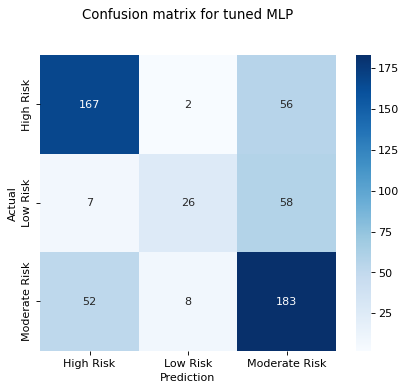

In [85]:
#Confusion matrix for tuned MLP
y_pred_mlptuned = mlp_tuned.predict(X_test_scaled)

from sklearn import metrics
knn_matrix = metrics.confusion_matrix(y_test, y_pred_mlptuned)
plt.figure(dpi=80)
sns.heatmap(knn_matrix, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
       xticklabels=["High Risk","Low Risk","Moderate Risk"],
       yticklabels=["High Risk","Low Risk","Moderate Risk"]);
plt.title('Confusion matrix for tuned MLP', y=1.1)
plt.xlabel('Prediction')
plt.ylabel('Actual')

               precision    recall  f1-score   support

    High Risk       0.74      0.74      0.74       225
     Low Risk       0.72      0.29      0.41        91
Moderate Risk       0.62      0.75      0.68       243

     accuracy                           0.67       559
    macro avg       0.69      0.59      0.61       559
 weighted avg       0.68      0.67      0.66       559



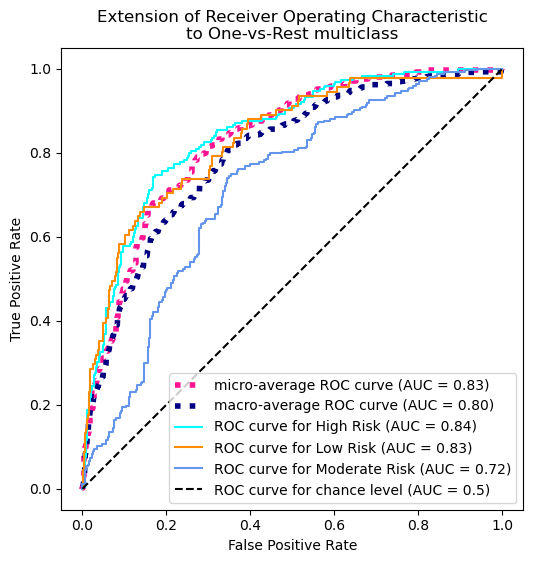

In [86]:
#MLP Scores
print(classification_report(y_test, y_pred_mlptuned))

from sklearn.metrics import RocCurveDisplay
y_score = mlp_tuned.predict_proba(X_test_scaled)

from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_onehot_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

n_classes = len(np.unique(y))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_onehot_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

from itertools import cycle
target_names = ['High Risk', 'Low Risk', 'Moderate Risk']

fig, ax = plt.subplots(figsize=(6, 6))

plt.plot(
    fpr["micro"],
    tpr["micro"],
    label=f"micro-average ROC curve (AUC = {roc_auc['micro']:.2f})",
    color="deeppink",
    linestyle=":",
    linewidth=4,
)

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        y_onehot_test[:, class_id],
        y_score[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()
